# Preliminaries

In [1]:
#import libraries
import pandas as pd
print('pandas: %s' % pd.__version__)

pd.options.display.max_columns = None
pd.set_option('display.max_rows', 150)

import numpy as np
print('geopandas: %s' % np.__version__)

# Tensorflow / Keras
import tensorflow as tf # used to access argmax function
from tensorflow import keras # for building Neural Networks
print('Tensorflow/Keras: %s' % keras.__version__) # print version
from keras import Sequential # for creating a linear stack of layers for our Neural Network
from keras import Input # for instantiating a keras tensor
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Input, Flatten,\
                                    Reshape, LeakyReLU as LR,\
                                    Activation, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping

# Data manipulation
import pandas as pd # for data manipulation
print('pandas: %s' % pd.__version__) # print version
import numpy as np # for data manipulation
print('numpy: %s' % np.__version__) # print version

import decimal
from decimal import Decimal

import keras 
import tensorflow as tf
from tensorflow.keras.layers import Dropout,BatchNormalization,Conv2D,MaxPooling2D,Dense,Flatten
from tensorflow.keras.datasets import cifar10
from tensorflow.keras import regularizers
from keras import callbacks
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
import matplotlib.pyplot as plt
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout,MaxPooling2D # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.models import Model, Sequential

from pathlib import Path  

from sklearn.model_selection import train_test_split # for splitting the data into train and test samples
from sklearn.metrics import classification_report # for model evaluation metrics
from sklearn.preprocessing import OrdinalEncoder # for encoding labels
from keras.models import load_model
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix

from tensorflow.keras.utils import plot_model

from sklearn.utils.class_weight import compute_sample_weight

pandas: 1.5.0
geopandas: 1.23.2
Tensorflow/Keras: 2.10.0
pandas: 1.5.0
numpy: 1.23.2


In [2]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, TimeDistributed, Conv1D, MaxPooling1D, Flatten, Bidirectional, Input, Flatten, Activation, Reshape, RepeatVector, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

In [3]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import io
#import imageio
from IPython.display import Image, display
from ipywidgets import widgets, Layout, HBox

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn import metrics

def plot_roc(pred,y):
    fpr, tpr, _ = roc_curve(y, pred)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.show()

In [5]:
def extract_images(df, variables, verbose=False):
    number_of_img, rows, cols = len(df.time.unique()), len(df.latitude.unique()), len(df.longitude.unique())
    images = np.zeros( (number_of_img, rows, cols, len(variables)) )
    
    df = df.sort_values(by=['time','latitude','longitude'])
    k=0
    
    for day in range(0,number_of_img):
        
        a=df.iloc[377*day:377*(day+1)]
        i=0
        for var in variables:
            images[day,:,:,i] = a.pivot(index='latitude', columns='longitude').sort_index(ascending=False)[var]
            i+=1
        k+=1
        if (k%100==0) & (verbose==True): print(k)
    return images

# Data

In [6]:
train = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/training_sets_withrealtom.csv')
val = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/validation_sets_withrealtom.csv')
test = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/test_sets_withrealtom.csv')
test = test.loc[test.time>='2016-04-01']

train['shear'] = train.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
val['shear'] = val.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
test['shear'] = test.apply(lambda x: np.sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)


In [5]:
### 
# 0_lag: "newlsm" 01-01 --> 01-01/02-01
# 1_lag: "Real_tom_target" 01-01 --> 02-01/03-01
# 2_lag: "Real_tom_target" 01-01 --> 03-01/04-01
#...
# 13_lag: "Real_tom_target" 01-01 --> 14-01/15-01

## Features

In [7]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

cols_to_std = [ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']
train_std,val_std,test_std = train,val,test

# apply standardization on numerical features
train_std[cols_to_std] = scaler.fit_transform(train[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])
val_std[cols_to_std] = scaler.transform(val[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])
test_std[cols_to_std] = scaler.transform(test[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']])


In [ ]:
#training set has 11323 days
variables = [ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']
train_img_std = extract_images(train_std, variables, verbose=True)
print(train_img_std.shape)

100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600


In [ ]:
val_img_std = extract_images(val_std, variables, verbose=False)
print(val_img_std.shape)

In [ ]:
test_img_std = extract_images(test_std, variables, verbose=False)
print(test_img_std.shape)

## Target of the current day: TC in the next 48 hours, with and without land

In [ ]:
train['target'] = train.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
test['target'] = test.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
val['target'] = val.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)

y_train = train.loc[:,['target','latitude','longitude','time']]
y_val = val.loc[:,['target','latitude','longitude','time']]
y_test = test.loc[:,['target','latitude','longitude','time']]

In [ ]:
variables = ['target']
y_train_img = extract_images(y_train, variables, verbose=True)
print(y_train_img.shape)

In [ ]:
variables = [ 'target']
y_val_img = extract_images(y_val, variables, verbose=False)
print(y_val_img.shape)


In [ ]:
variables = [ 'target']
y_test_img = extract_images(y_test, variables, verbose=False)
print(y_test_img.shape)


In [10]:
import pickle
with open('/Users/paolo/Desktop/TC_world/train_target_img.pkl', 'wb') as f:  
        pickle.dump(y_train_img, f)

In [11]:
with open('/Users/paolo/Desktop/TC_world/val_target_img.pkl', 'wb') as f:  
        pickle.dump(y_val_img, f)

In [12]:
with open('/Users/paolo/Desktop/TC_world/test_target_img.pkl', 'wb') as f:  
        pickle.dump(y_test_img, f)

# Models

## ConvLSTM

In [42]:
def extract_sequences(past_lag,future_lag,y):   

    inputs = np.zeros((y.shape[0]-past_lag-future_lag,past_lag,13,29,1))
    outputs = np.zeros((y.shape[0]-past_lag-future_lag,future_lag,13,29,1))

    for i in range(inputs.shape[0]):
        inputs[i] = y[i:past_lag+i]
        outputs[i] = y[past_lag+i:future_lag+past_lag+i]
    return inputs,outputs

In [52]:
train_inputs,train_outputs = extract_sequences(past_lag =3, future_lag = 3, y=y_train_img)
val_inputs,val_outputs = extract_sequences(past_lag =3, future_lag = 3, y=y_val_img)

In [68]:
test_inputs,test_outputs = extract_sequences(past_lag =3, future_lag = 3, y=y_test_img)

In [53]:
print(train_inputs.shape,train_outputs.shape)

(11317, 3, 13, 29, 1) (11317, 3, 13, 29, 1)


IndexError: index 3 is out of bounds for axis 0 with size 3

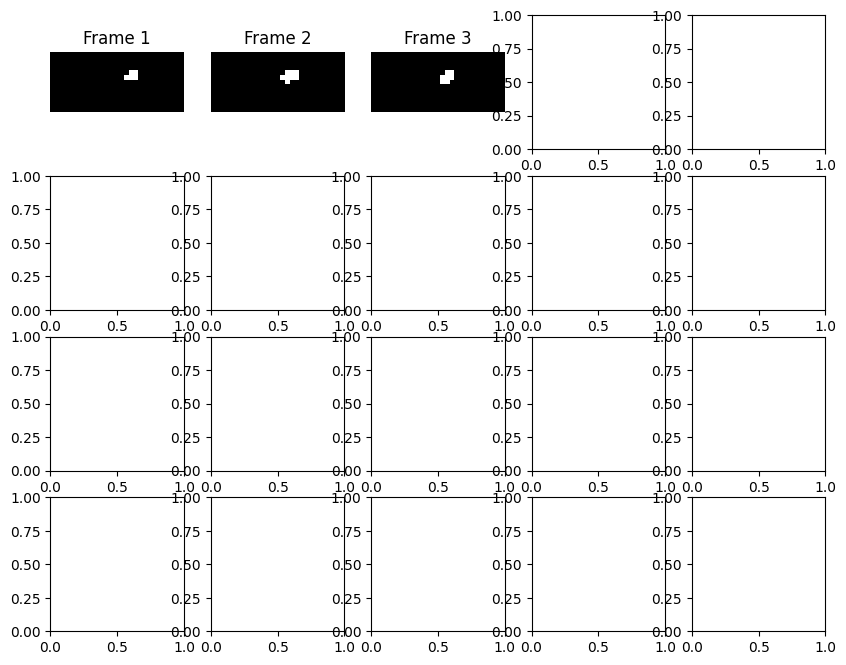

In [63]:
fig, axes = plt.subplots(4, 5, figsize=(10, 8))

# Plot each of the sequential images for one random data example.
data_choice = np.random.choice(range(10000), size=1)[0]
for idx, ax in enumerate(axes.flat):
    ax.imshow(np.squeeze(train_inputs[data_choice][idx]), cmap="gray")
    ax.set_title(f"Frame {idx + 1}")
    ax.axis("off")

# Print information and display the figure.
print(f"Displaying frames for example {data_choice}.")
plt.show()

In [66]:
# Construct the input layer with no definite frame size.
inp = layers.Input(shape=(None, *train_inputs.shape[2:]))

# We will construct 3 `ConvLSTM2D` layers with batch normalization,
# followed by a `Conv3D` layer for the spatiotemporal outputs.
x = layers.ConvLSTM2D(
    filters=8,
    kernel_size=(5,5),
    padding="same",
    return_sequences=True,
    activation="relu",
)(inp)
#x = layers.BatchNormalization()(x)
#x = layers.ConvLSTM2D(
#    filters=8,
#    kernel_size=(3, 3),
#    padding="same",
#    return_sequences=True,
#    activation="relu",
#)(x)
#x = layers.BatchNormalization()(x)
#x = layers.ConvLSTM2D(
#    filters=8,
#    kernel_size=(1, 1),
#    padding="same",
#    return_sequences=True,
#    activation="relu",
#)(x)
x = layers.Conv3D(
    filters=1, kernel_size=(3, 3, 3), activation="sigmoid", padding="same"
)(x)

# Next, we will build the complete model and compile it.
model = keras.models.Model(inp, x)
model.compile(
    loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.Adam(),
)
model.summary()

Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, None, 13, 29, 1)  0         
                             ]                                   
                                                                 
 conv_lstm2d_20 (ConvLSTM2D)  (None, None, 13, 29, 8)  7232      
                                                                 
 conv3d_7 (Conv3D)           (None, None, 13, 29, 1)   217       
                                                                 
Total params: 7,449
Trainable params: 7,449
Non-trainable params: 0
_________________________________________________________________


In [67]:
# Define some callbacks to improve training.
early_stopping = keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience=5)

# Define modifiable training hyperparameters.
epochs = 100
batch_size = 256

# Fit the model to the training data.
model.fit(
    train_inputs,
    train_outputs,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(val_inputs, val_outputs),
    callbacks=[early_stopping, reduce_lr],
)

Epoch 1/100


2023-04-08 17:47:42.496838: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.6319

2023-04-08 17:47:51.417091: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 10s 185ms/step - loss: 0.6319 - val_loss: 0.4564 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 8s 175ms/step - loss: 0.2202 - val_loss: 0.1206 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 8s 175ms/step - loss: 0.1069 - val_loss: 0.0828 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 8s 175ms/step - loss: 0.0673 - val_loss: 0.0483 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 8s 177ms/step - loss: 0.0385 - val_loss: 0.0274 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 8s 177ms/step - loss: 0.0264 - val_loss: 0.0233 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 8s 175ms/step - loss: 0.0241 - val_loss: 0.0221 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 8s 175ms/step - loss: 0.0233 - val_loss: 0.0214 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 8s 174ms/step - loss: 0.0228 - val_loss: 0.020

In [16]:
def evaluate_perf(test_inputs,test_outputs,day=0):
    t = model.predict(test_inputs)
    one_day_t = t[:,day,:,:,:]
    one_day_y = test_outputs[:,day,:,:,:]
    
    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in one_day_t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
    # confusion matrix with threshold on 0.1, otherwise always 0 
        ConfusionMatrixDisplay(confusion_matrix(one_day_y.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(one_day_y.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    plot_roc(one_day_t.reshape(-1,1),one_day_y.reshape(-1,1))
    
    display = CalibrationDisplay.from_predictions(one_day_y.reshape(-1,1), one_day_t.reshape(-1,1), n_bins=10)

    print(f'All zeros Brier score: {brier_score_loss(one_day_y.reshape(-1,1), np.zeros(len(one_day_y.reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(one_day_y.reshape(-1,1), one_day_t.reshape(-1,1))}')
    

77/77 [==============================] - 1s 12ms/step


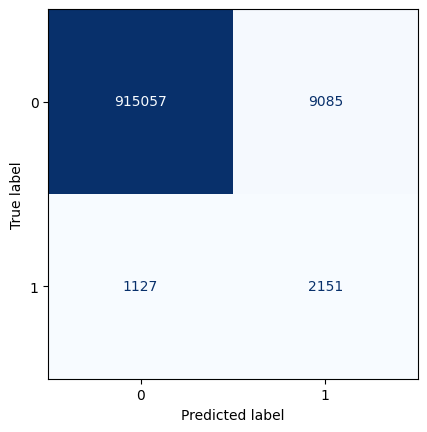

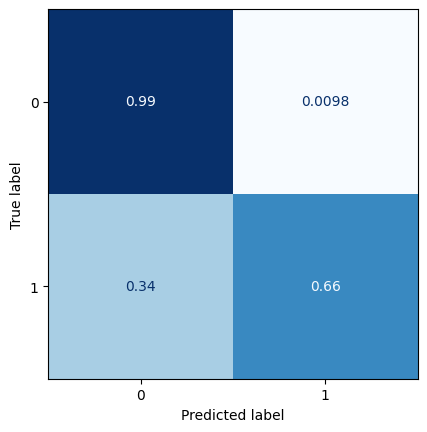

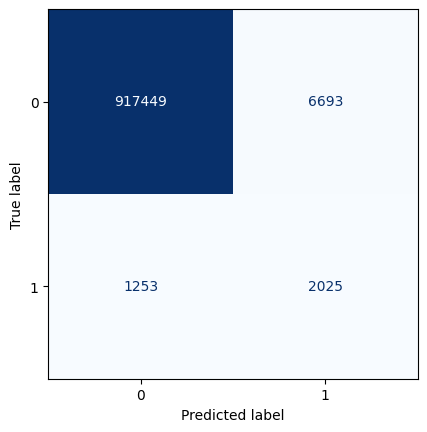

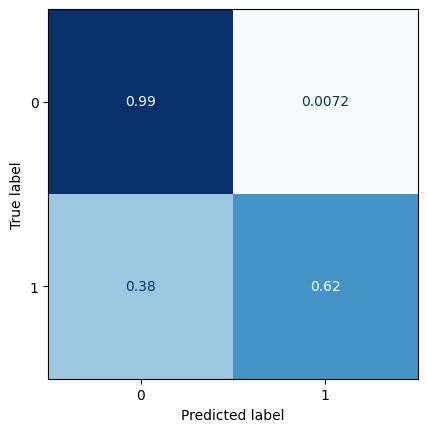

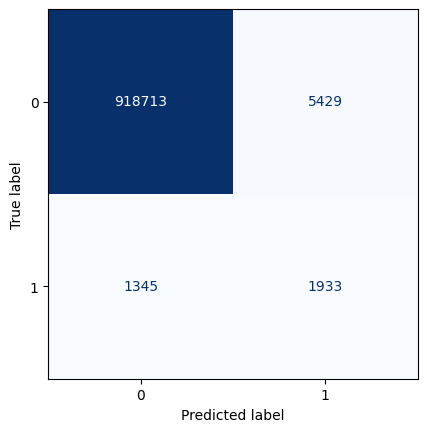

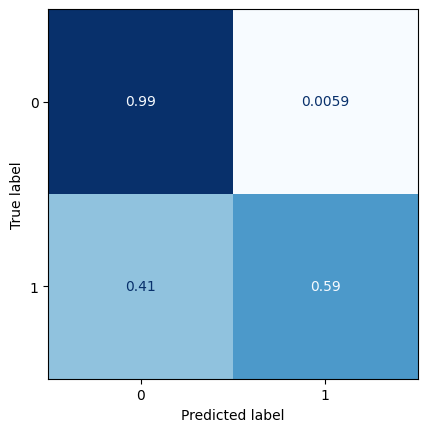

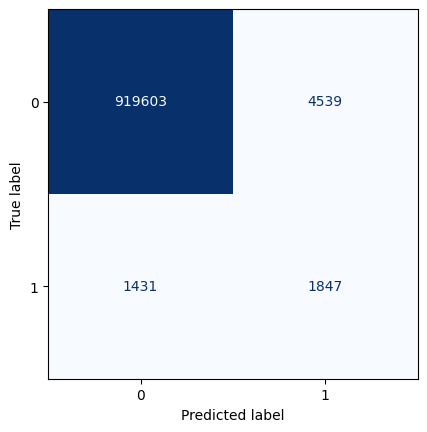

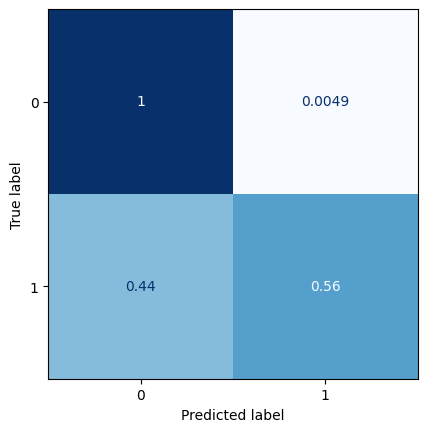

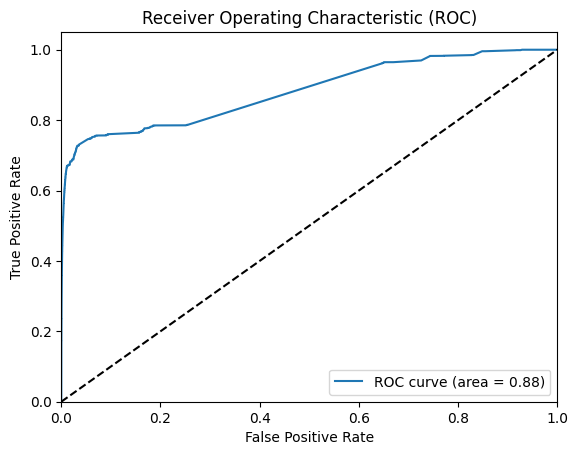

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.002686570556475484


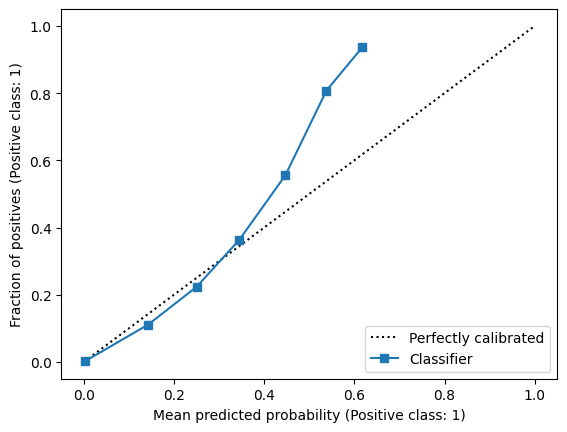

In [80]:
evaluate_perf(test_inputs,test_outputs,day=0)

77/77 [==============================] - 1s 12ms/step


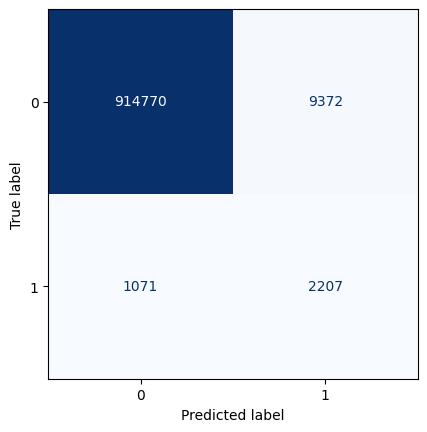

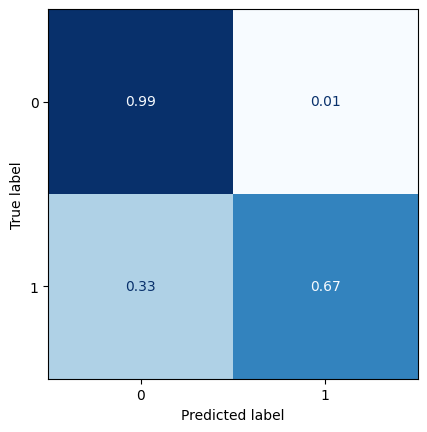

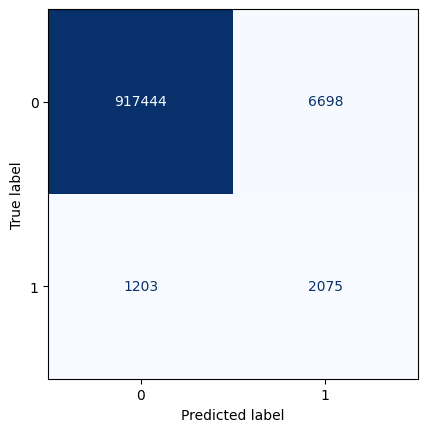

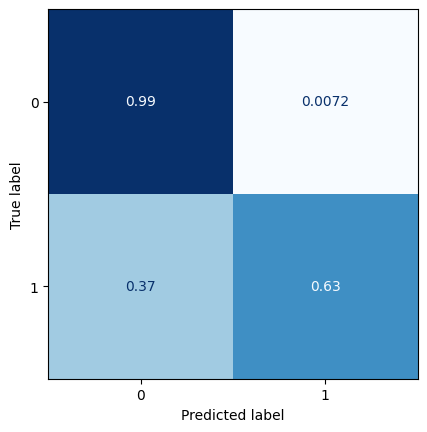

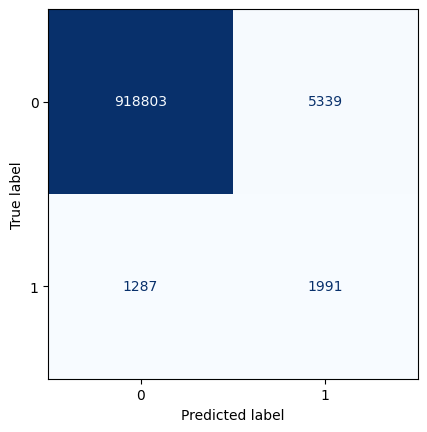

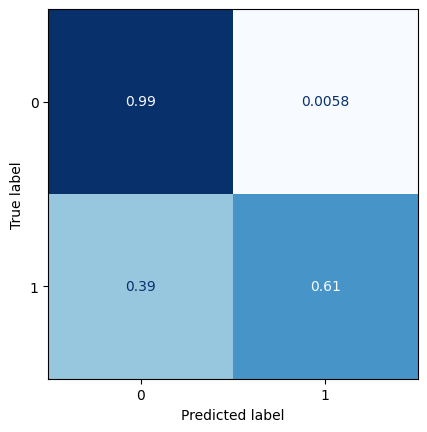

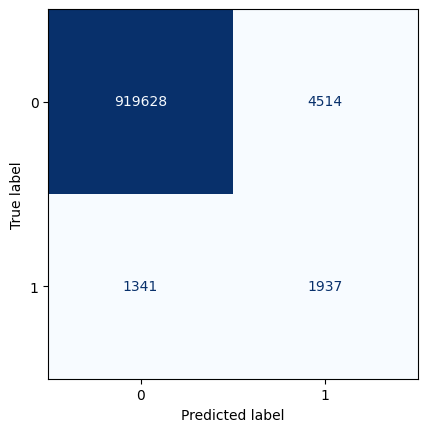

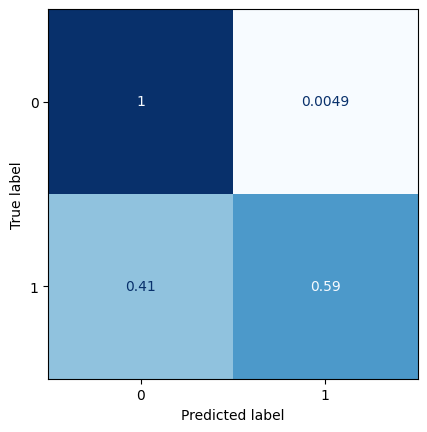

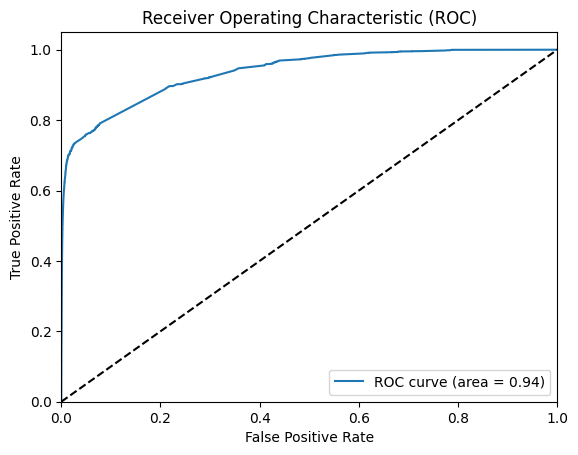

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.0026706950644550804


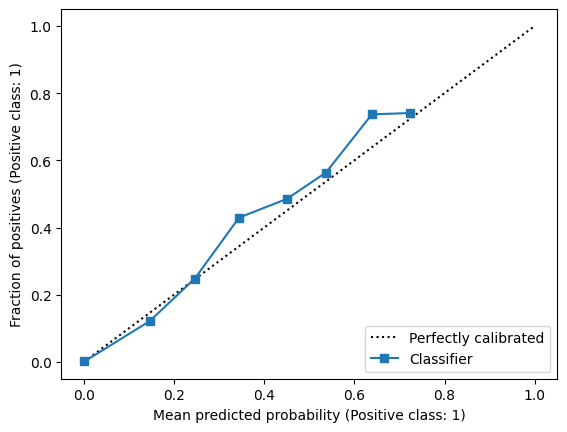

In [81]:
evaluate_perf(test_inputs,test_outputs,day=1)

77/77 [==============================] - 1s 12ms/step


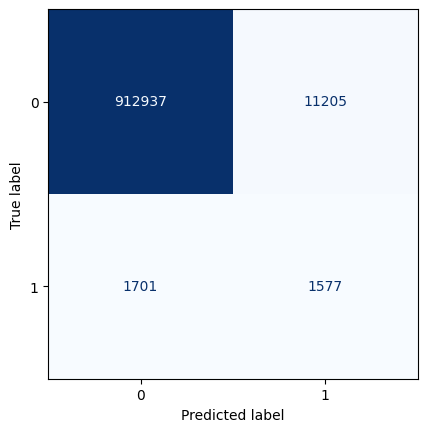

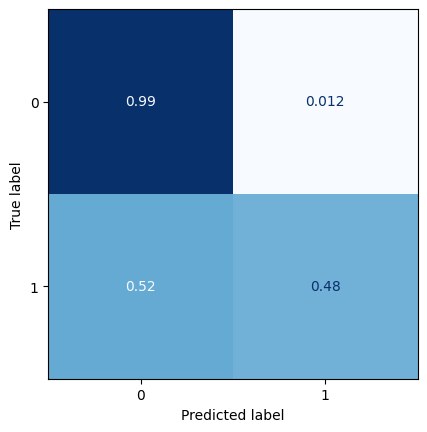

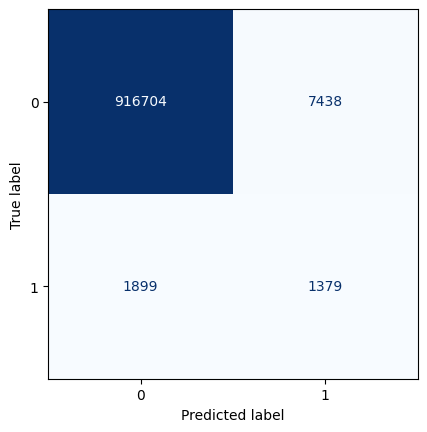

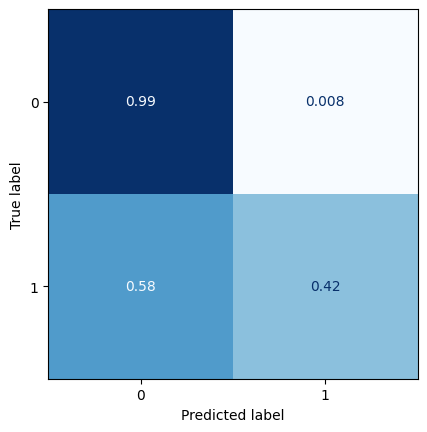

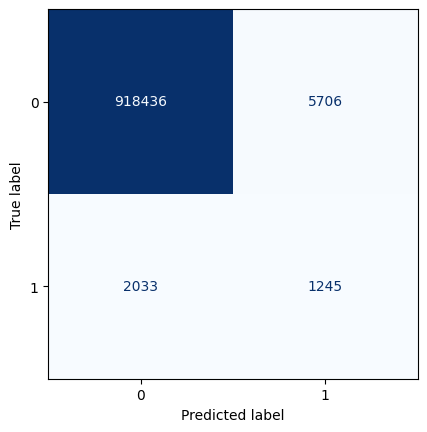

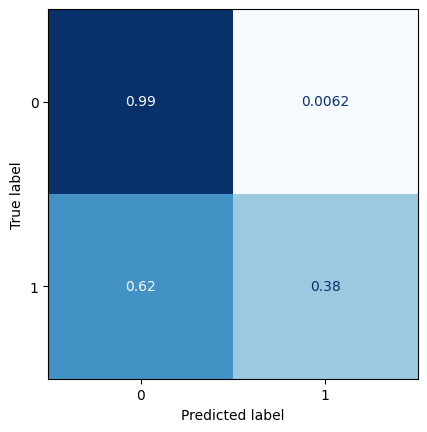

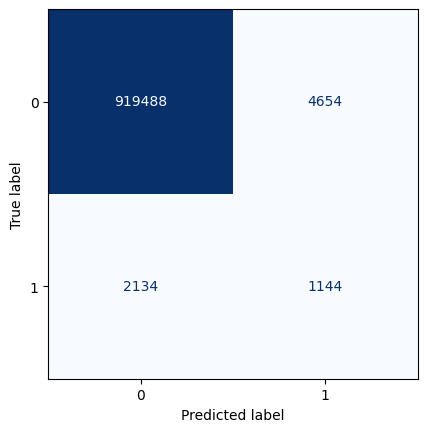

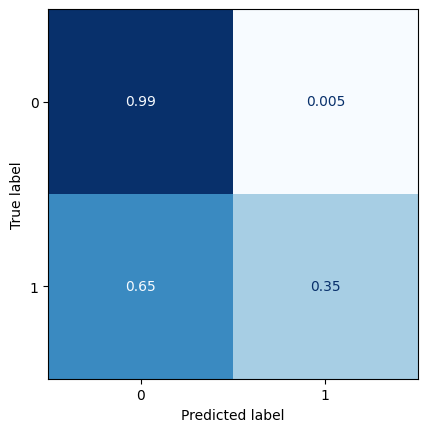

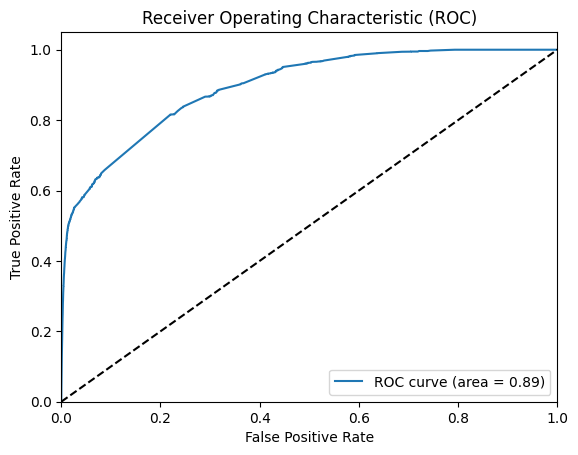

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.0032344095920056664


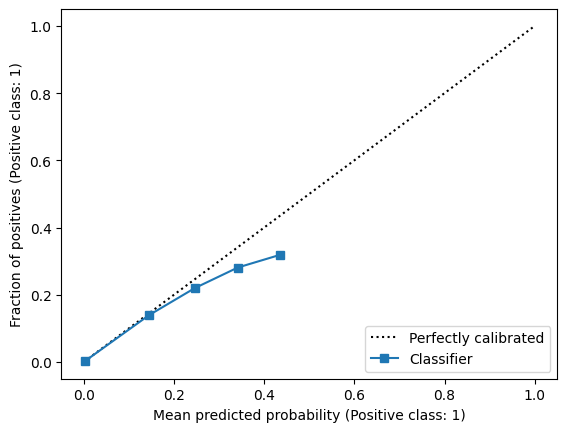

In [82]:
evaluate_perf(test_inputs,test_outputs,day=2)

## WITH FEATURES

In [17]:
def extract_sequences_features(past_lag,future_lag,x,y):   

    inputs = np.zeros((x.shape[0]-past_lag-future_lag,past_lag,13,29,9))
    outputs = np.zeros((y.shape[0]-past_lag-future_lag,future_lag,13,29,1))

    for i in range(inputs.shape[0]):
        inputs[i] = x[i:past_lag+i]
        outputs[i] = y[past_lag+i:future_lag+past_lag+i]
    return inputs,outputs

In [19]:
train_inputs,train_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=train_img_std, y=y_train_img)
val_inputs,val_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=val_img_std, y=y_val_img)
test_inputs,test_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=test_img_std, y=y_test_img)
    

Model: "model_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_18 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_32 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_17 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:09:45.259424: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.4717

2023-04-08 23:09:50.028967: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 7s 100ms/step - loss: 0.4717 - val_loss: 0.1480 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 3s 75ms/step - loss: 0.0784 - val_loss: 0.0391 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 3s 73ms/step - loss: 0.0376 - val_loss: 0.0263 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 3s 71ms/step - loss: 0.0281 - val_loss: 0.0210 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 3s 71ms/step - loss: 0.0237 - val_loss: 0.0189 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 3s 71ms/step - loss: 0.0216 - val_loss: 0.0178 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 3s 71ms/step - loss: 0.0204 - val_loss: 0.0170 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 3s 75ms/step - loss: 0.0195 - val_loss: 0.0165 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 3s 72ms/step - loss: 0.0189 - val_loss: 0.0160 - lr: 0

2023-04-08 23:13:21.600555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 8ms/step


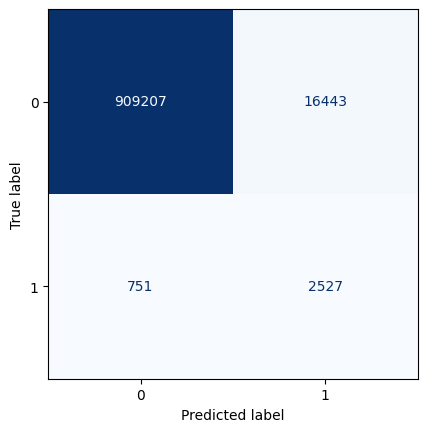

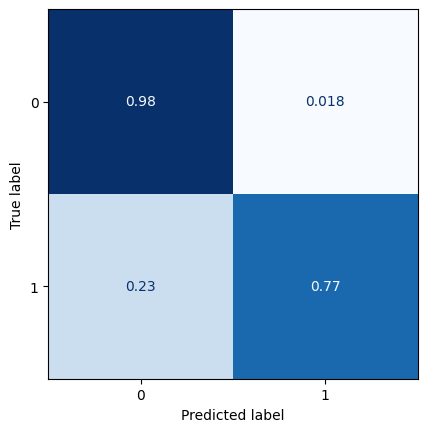

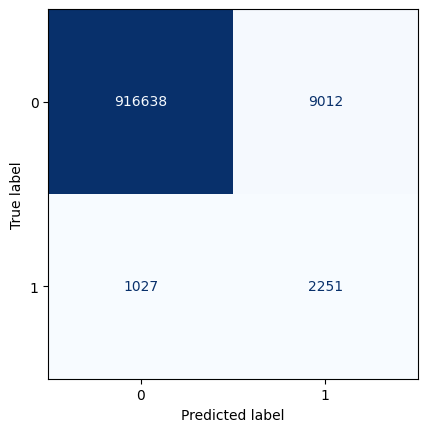

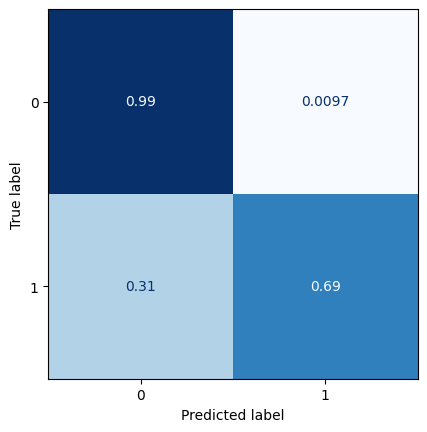

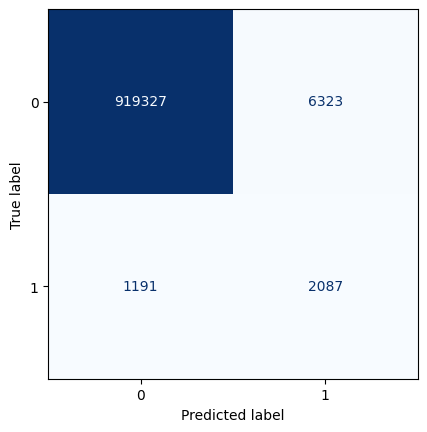

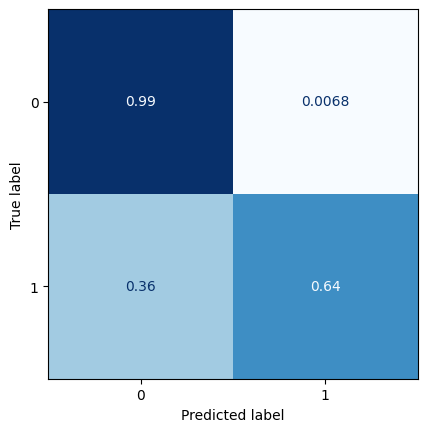

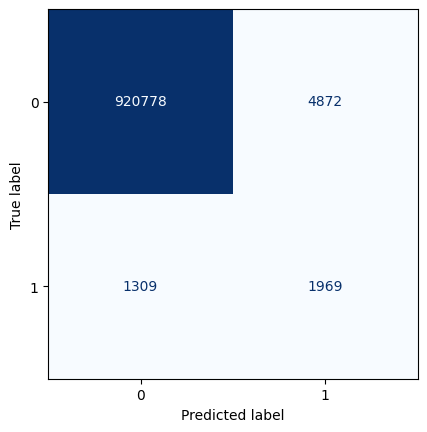

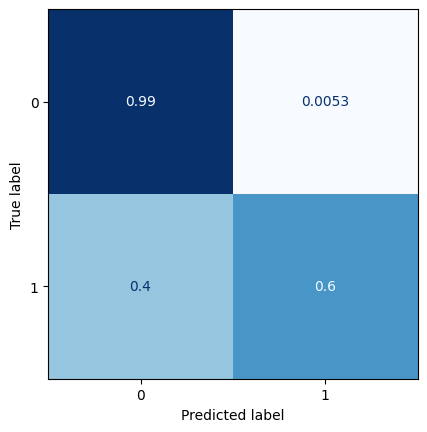

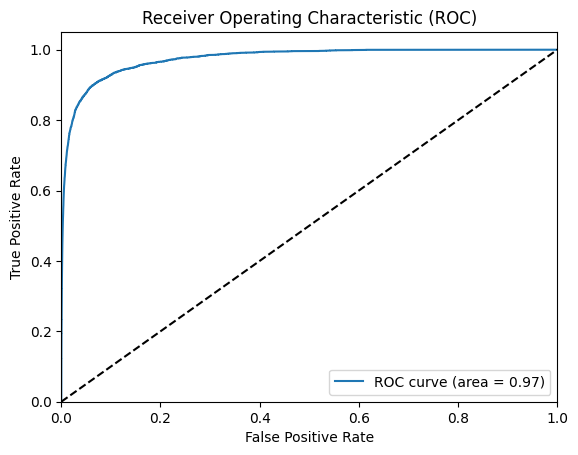

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.002732978664770724
Model: "model_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_19 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_33 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_18 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:13:35.287337: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2617

2023-04-08 23:13:43.308949: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 9s 169ms/step - loss: 0.2617 - val_loss: 0.0486 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 6s 141ms/step - loss: 0.0378 - val_loss: 0.0257 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 6s 139ms/step - loss: 0.0269 - val_loss: 0.0216 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 6s 143ms/step - loss: 0.0232 - val_loss: 0.0198 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 6s 141ms/step - loss: 0.0212 - val_loss: 0.0183 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 6s 139ms/step - loss: 0.0199 - val_loss: 0.0175 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 6s 143ms/step - loss: 0.0190 - val_loss: 0.0169 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 7s 155ms/step - loss: 0.0182 - val_loss: 0.0164 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 6s 144ms/step - loss: 0.0176 - val_loss: 0.0163

2023-04-08 23:18:41.111802: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 14ms/step


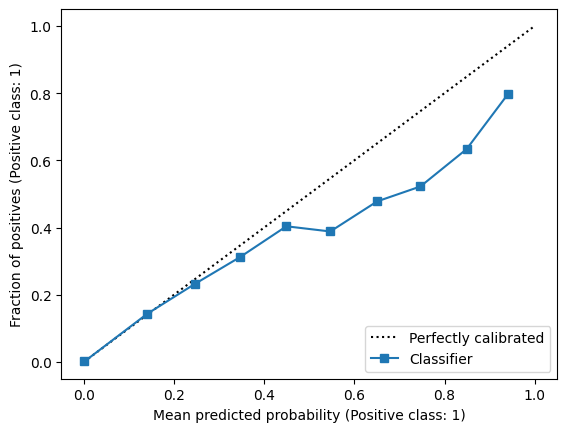

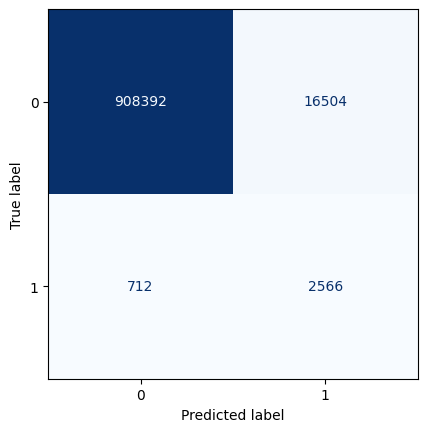

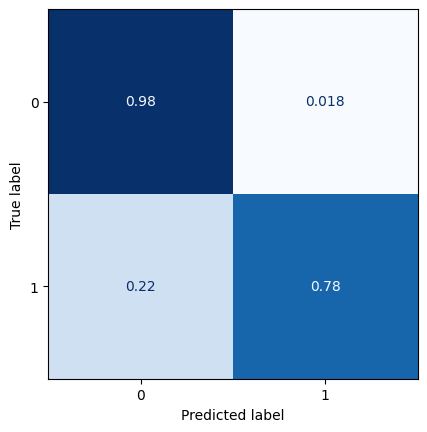

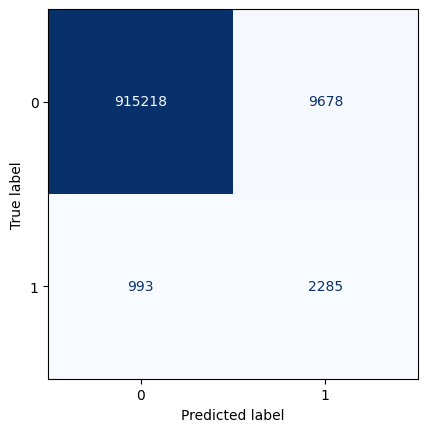

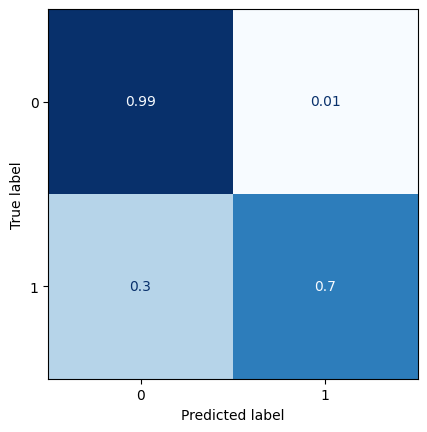

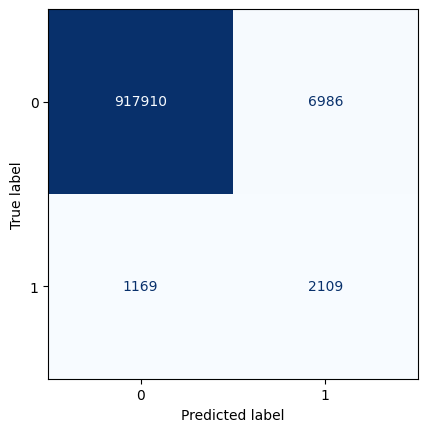

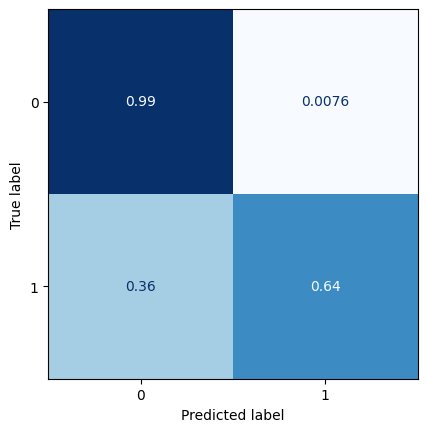

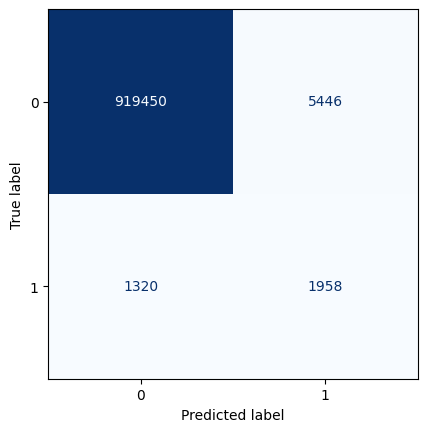

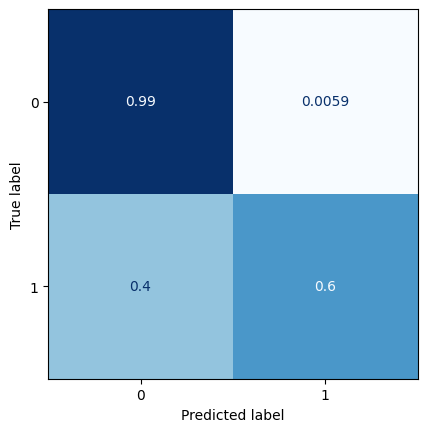

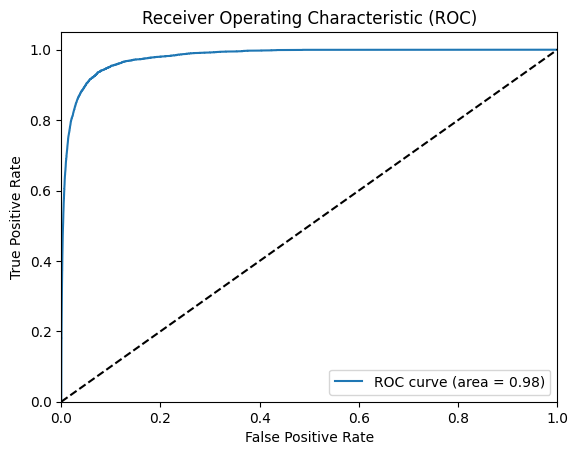

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.00278873704192316
77/77 [==============================] - 1s 13ms/step


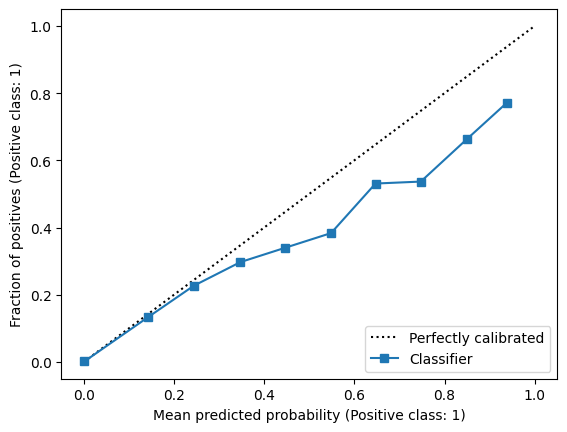

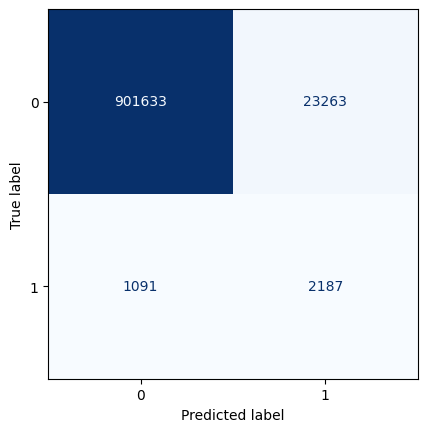

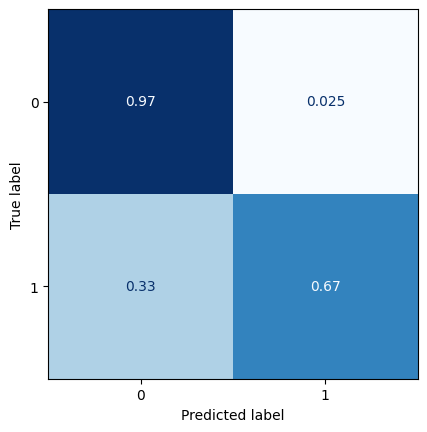

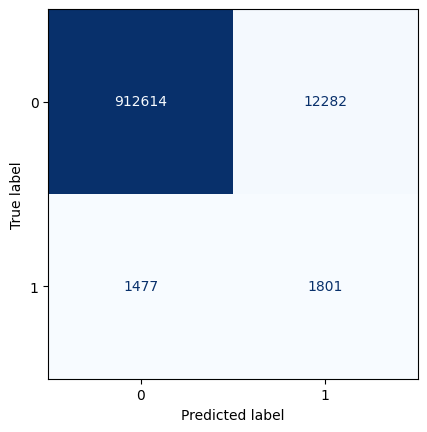

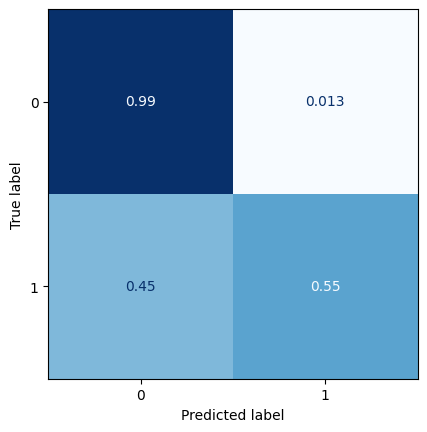

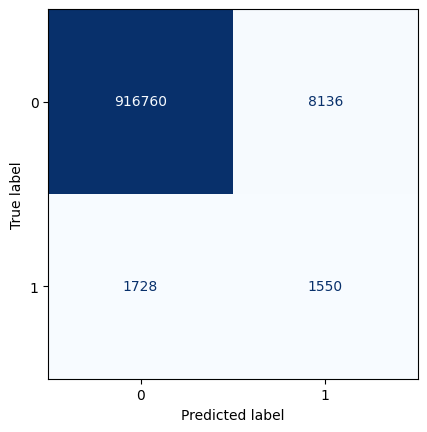

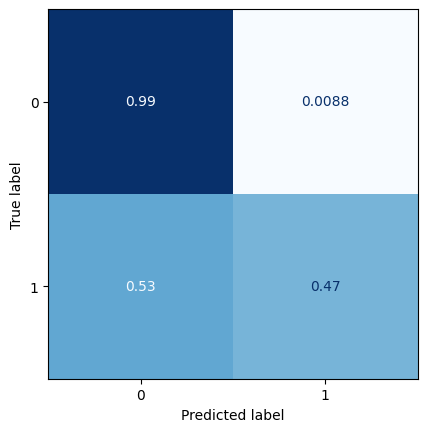

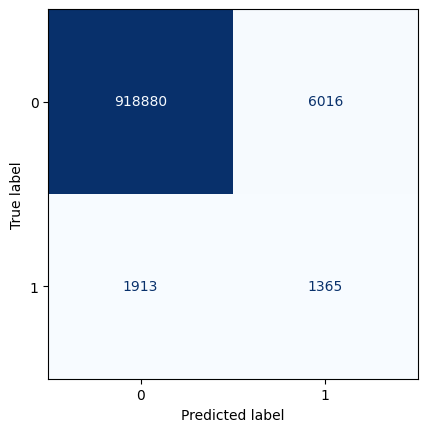

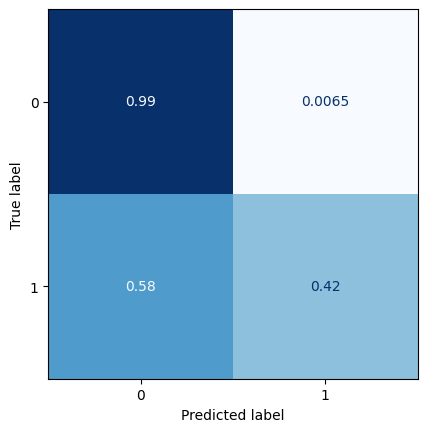

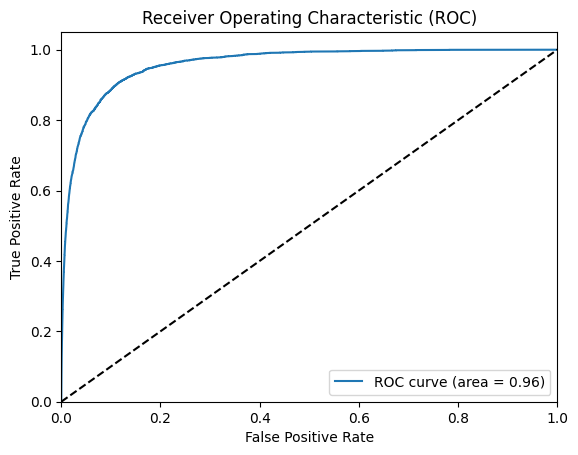

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.0031910978168812817
Model: "model_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_20 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_34 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_19 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:19:04.294387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2894

2023-04-08 23:19:18.284999: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 16s 296ms/step - loss: 0.2894 - val_loss: 0.0505 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 11s 232ms/step - loss: 0.0416 - val_loss: 0.0291 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 10s 215ms/step - loss: 0.0291 - val_loss: 0.0233 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 10s 222ms/step - loss: 0.0246 - val_loss: 0.0206 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 12s 262ms/step - loss: 0.0224 - val_loss: 0.0195 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 11s 247ms/step - loss: 0.0212 - val_loss: 0.0195 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 10s 215ms/step - loss: 0.0204 - val_loss: 0.0186 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 10s 216ms/step - loss: 0.0198 - val_loss: 0.0185 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 10s 221ms/step - loss: 0.0194 - val_los

2023-04-08 23:28:33.632403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 3s 19ms/step


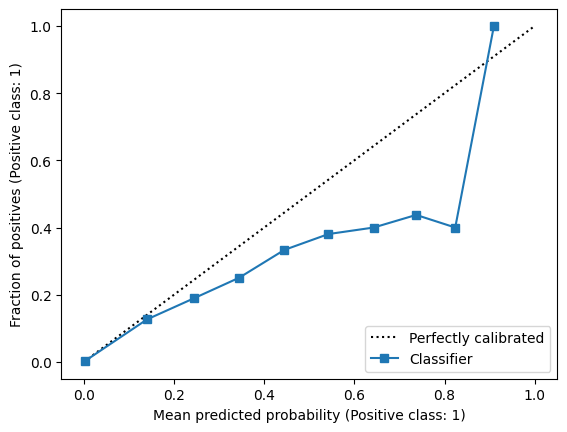

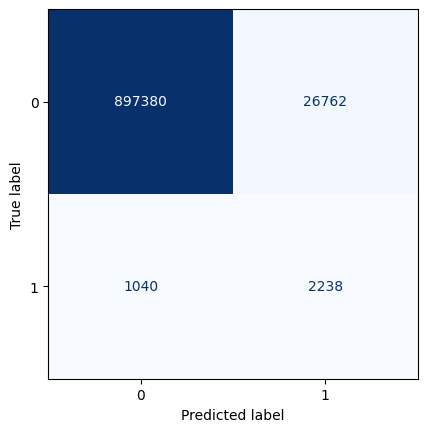

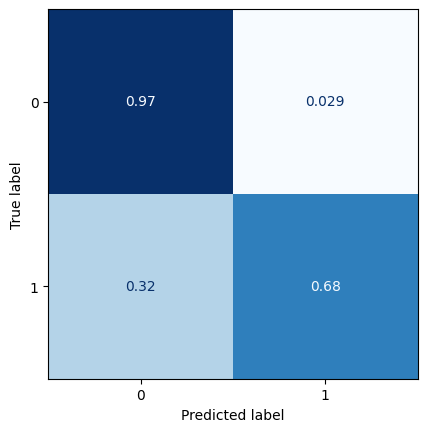

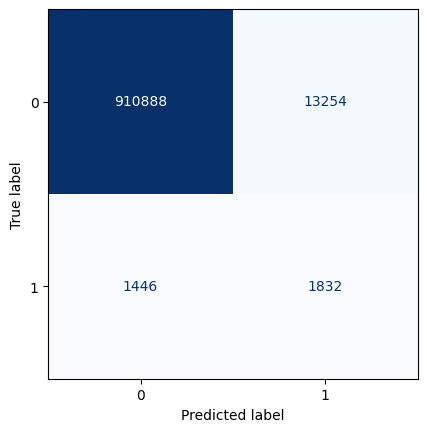

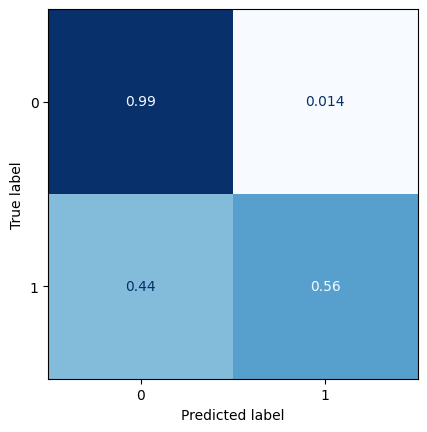

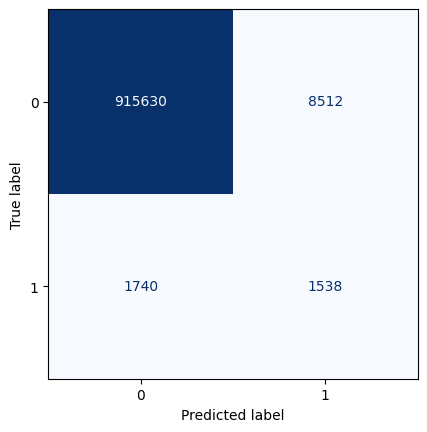

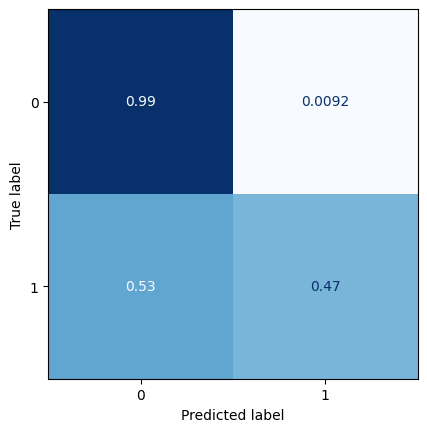

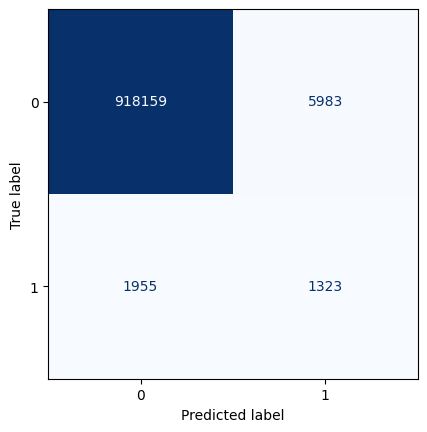

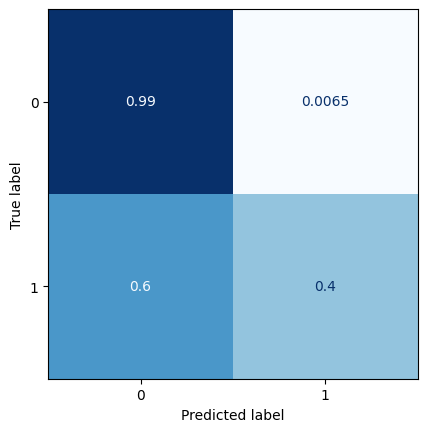

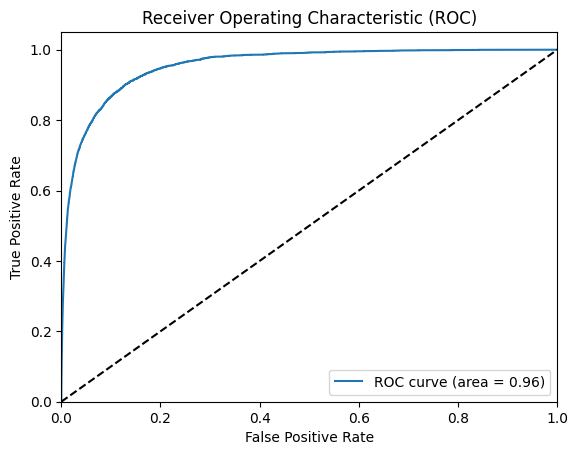

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003178713373527999
77/77 [==============================] - 1s 15ms/step


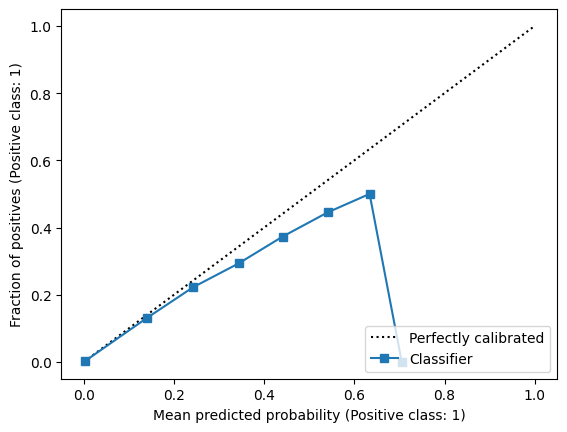

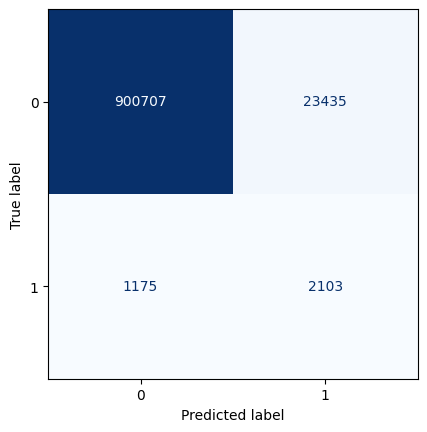

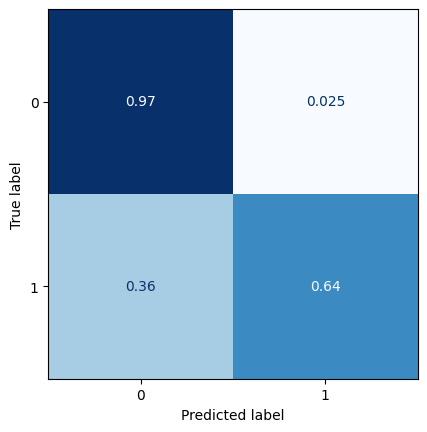

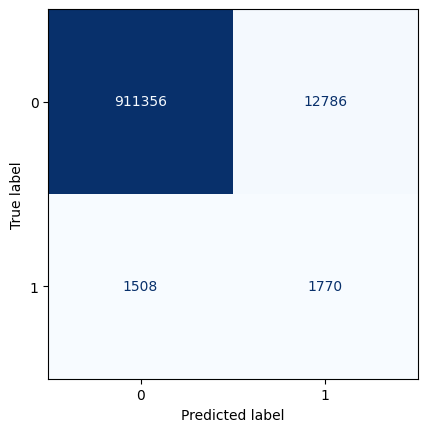

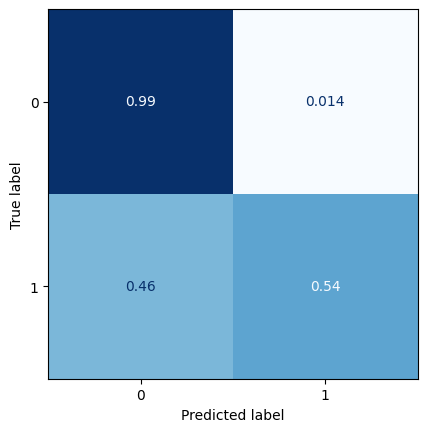

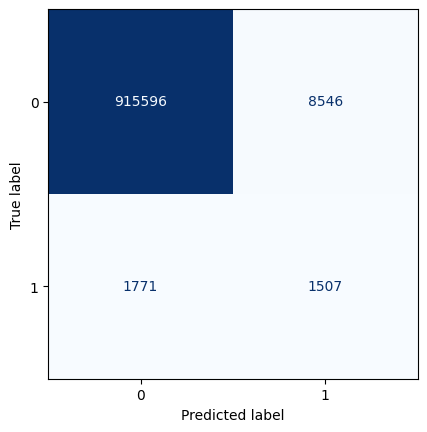

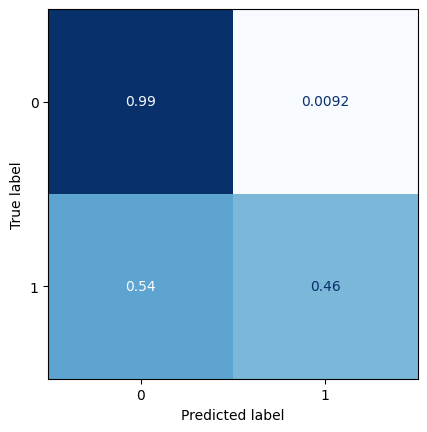

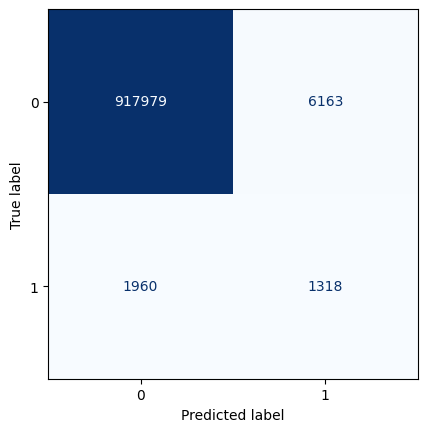

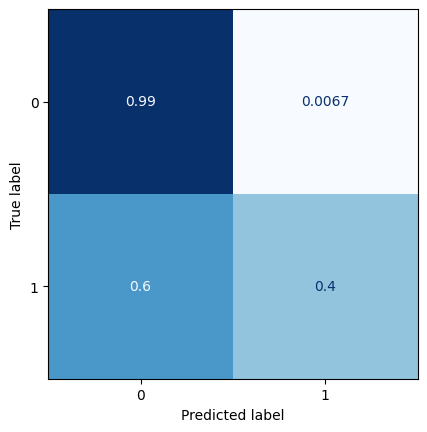

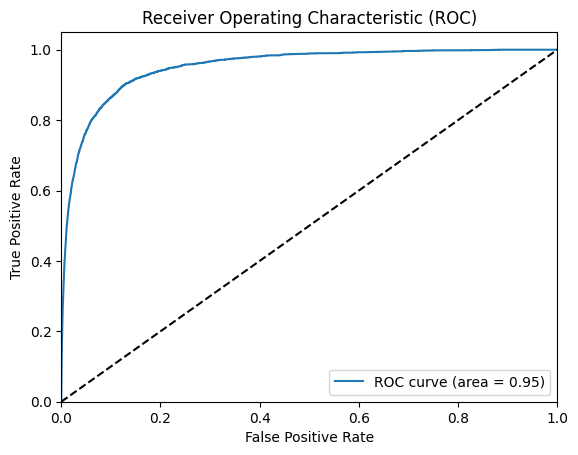

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.0031812227427115134
77/77 [==============================] - 1s 16ms/step


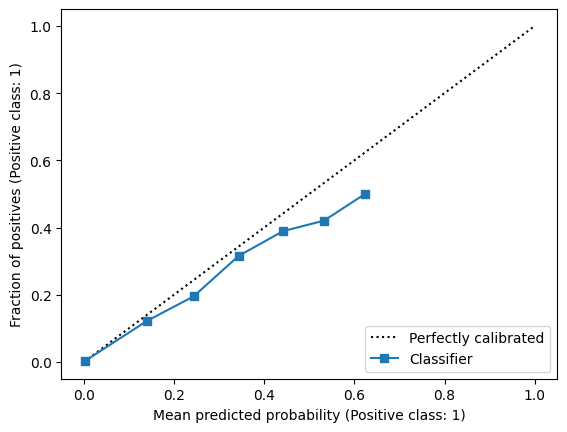

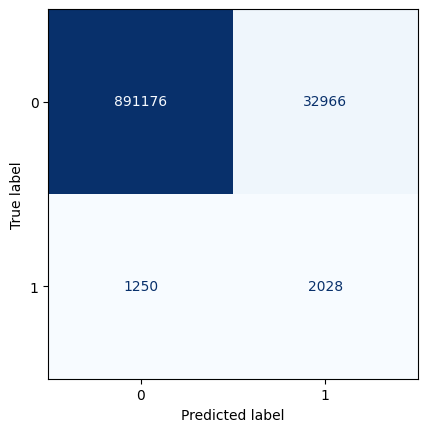

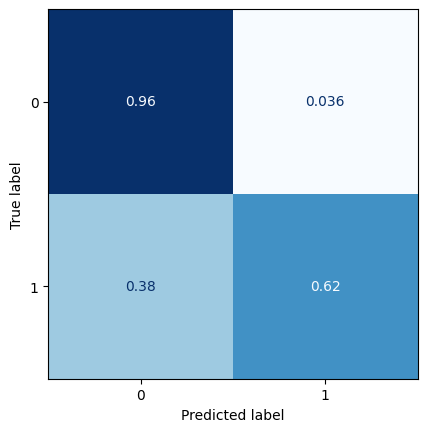

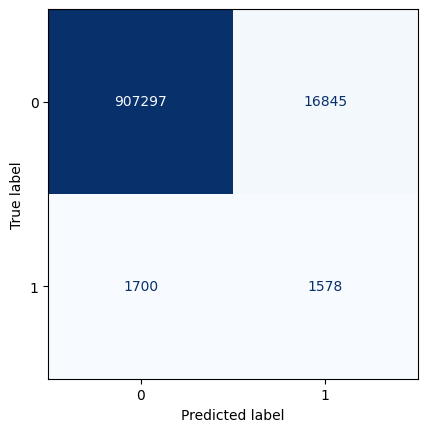

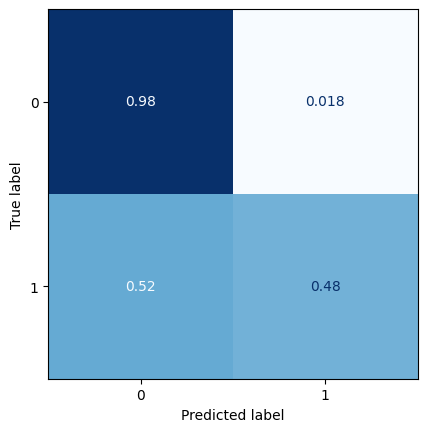

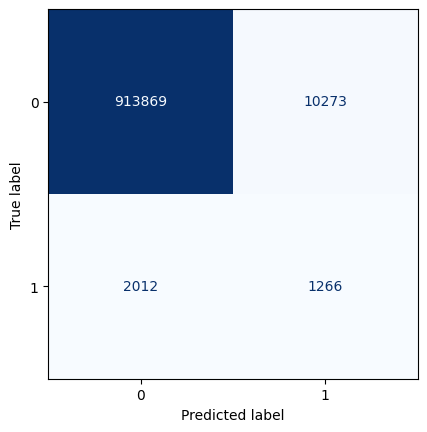

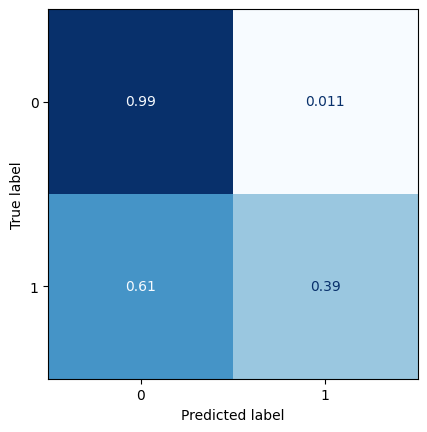

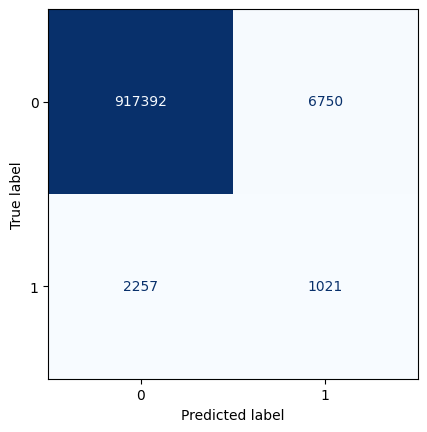

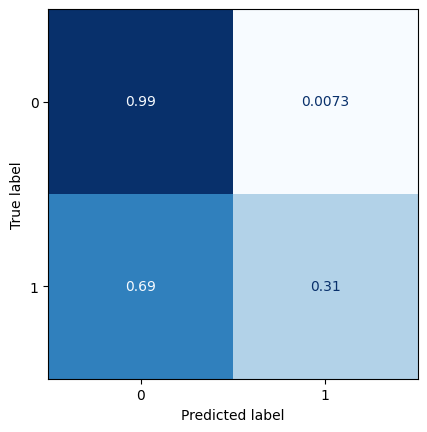

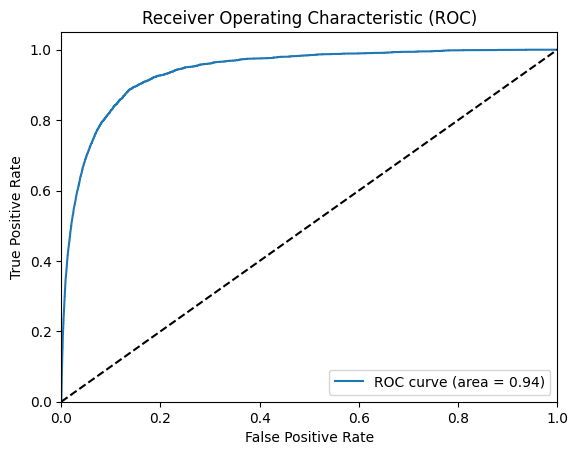

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.0033504255441815195
Model: "model_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_21 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_35 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_20 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:29:17.111472: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2675

2023-04-08 23:29:40.033853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 26s 482ms/step - loss: 0.2675 - val_loss: 0.0494 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 16s 335ms/step - loss: 0.0404 - val_loss: 0.0288 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 14s 320ms/step - loss: 0.0296 - val_loss: 0.0241 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 15s 342ms/step - loss: 0.0260 - val_loss: 0.0221 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 15s 334ms/step - loss: 0.0241 - val_loss: 0.0213 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 21s 475ms/step - loss: 0.0230 - val_loss: 0.0207 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 14s 308ms/step - loss: 0.0223 - val_loss: 0.0203 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 19s 426ms/step - loss: 0.0217 - val_loss: 0.0198 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 13s 298ms/step - loss: 0.0213 - val_los

2023-04-08 23:39:57.108710: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 2s 22ms/step


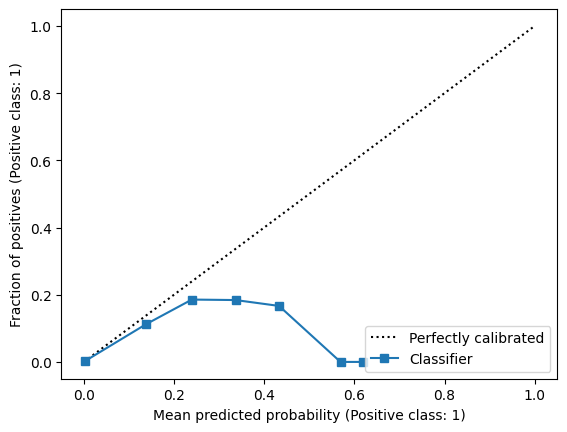

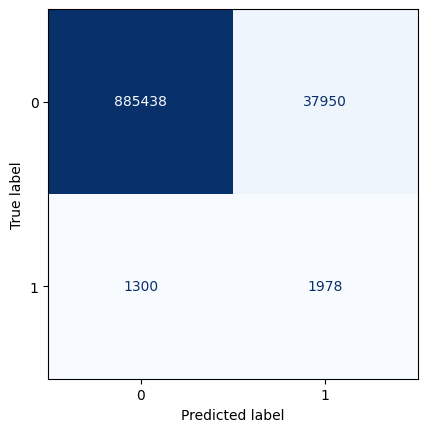

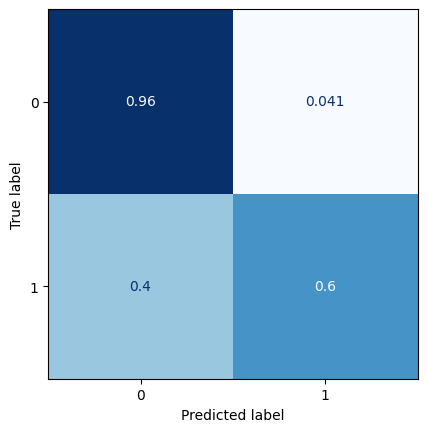

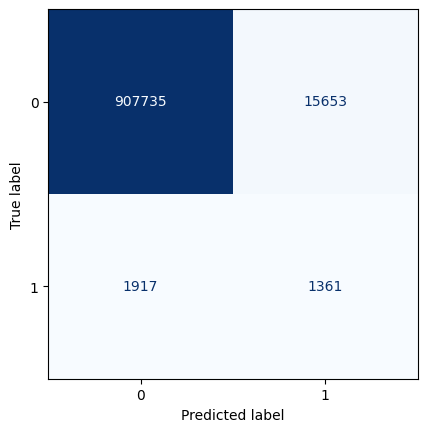

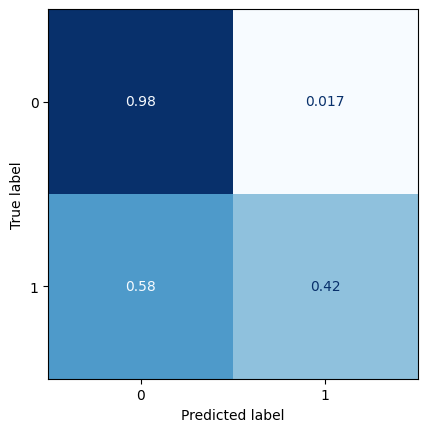

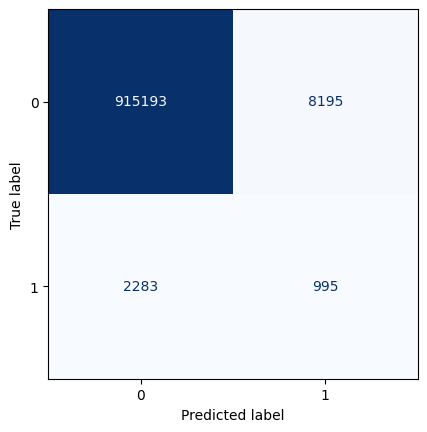

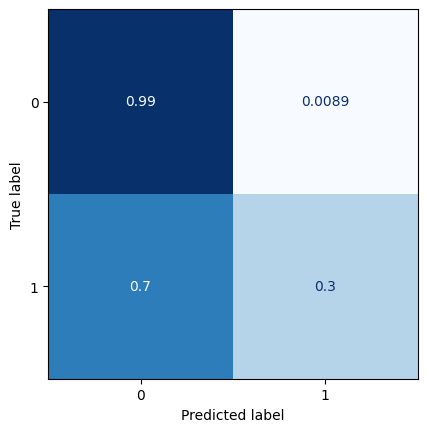

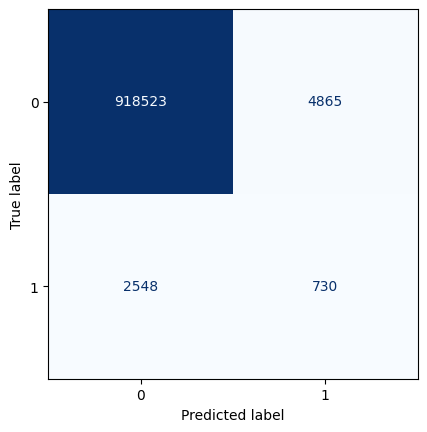

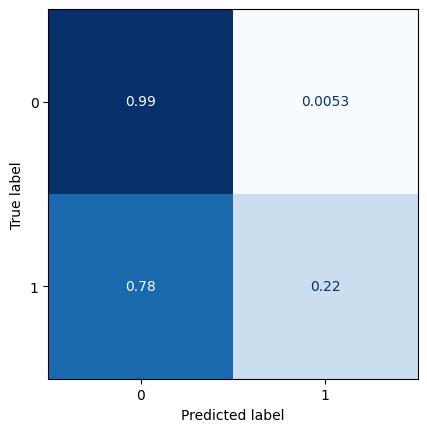

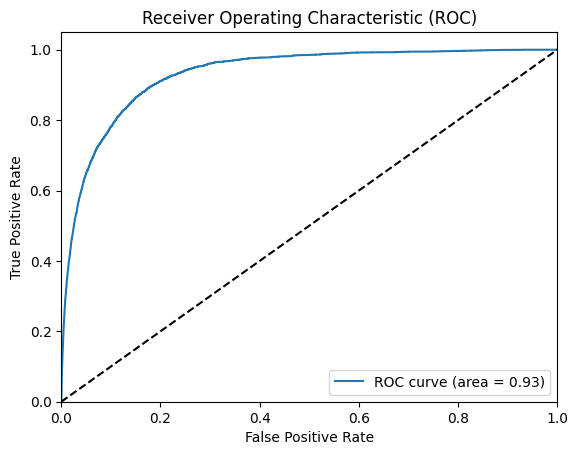

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0033759489774592994
77/77 [==============================] - 1s 18ms/step


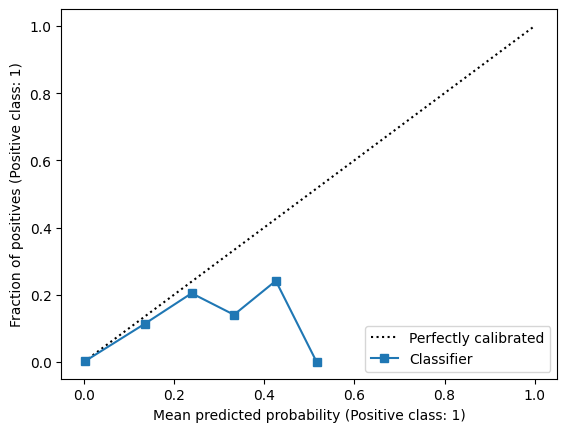

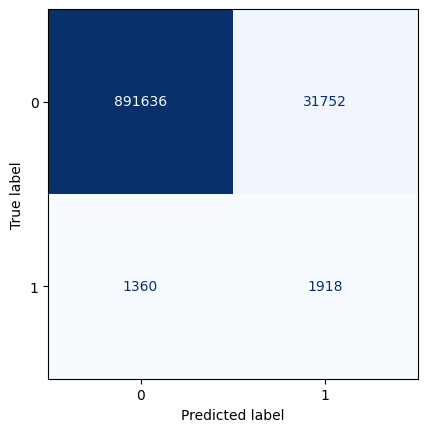

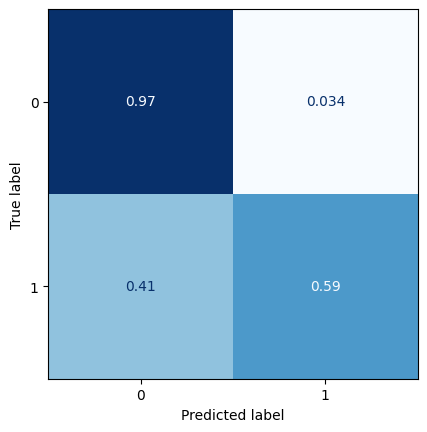

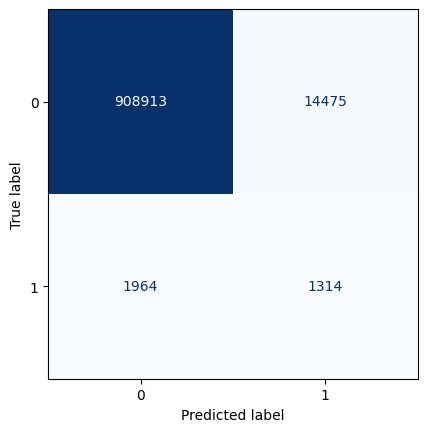

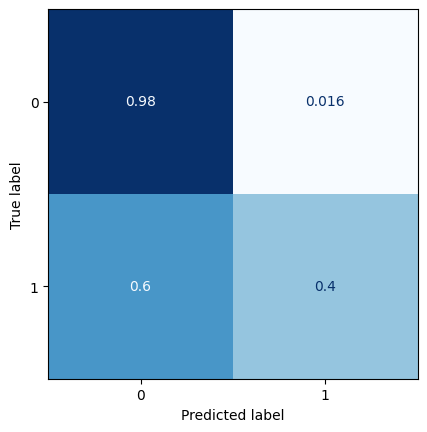

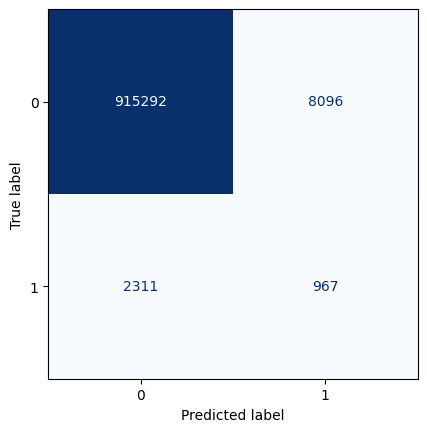

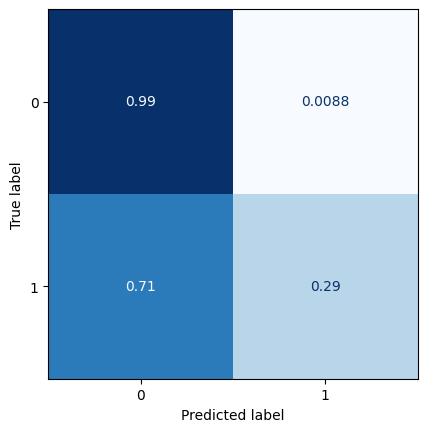

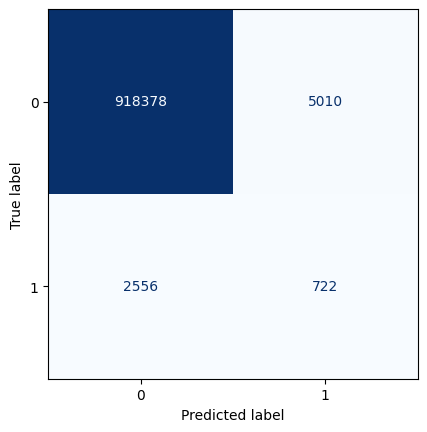

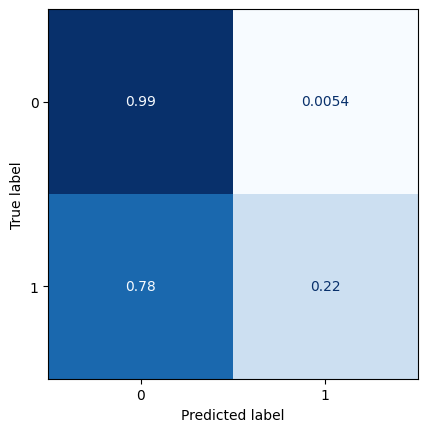

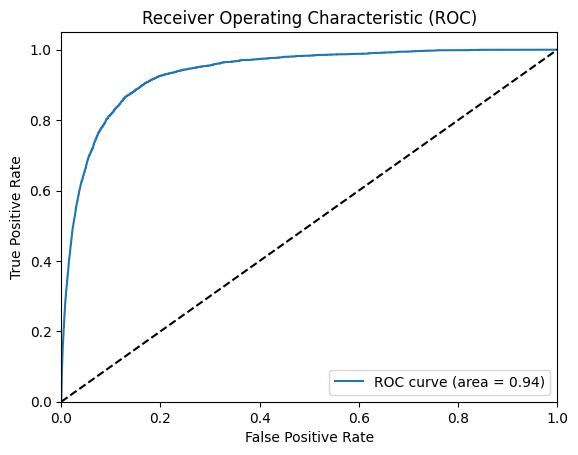

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0033717800354316437
77/77 [==============================] - 1s 16ms/step


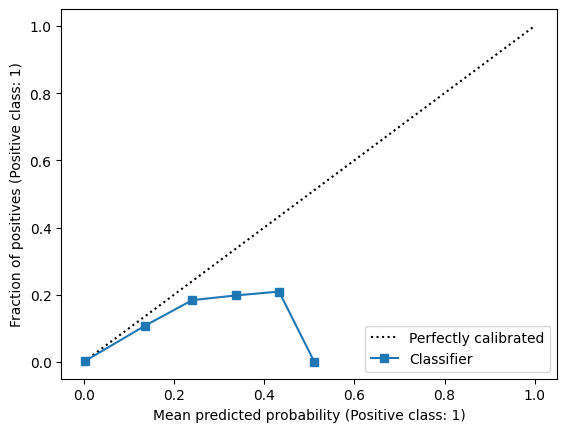

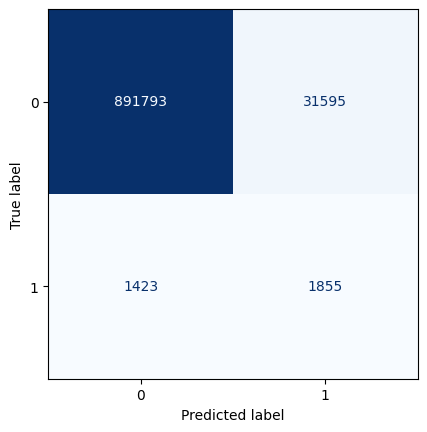

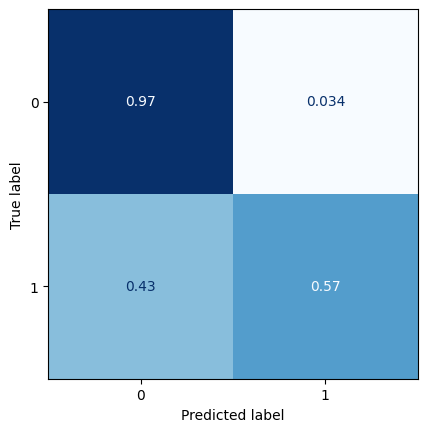

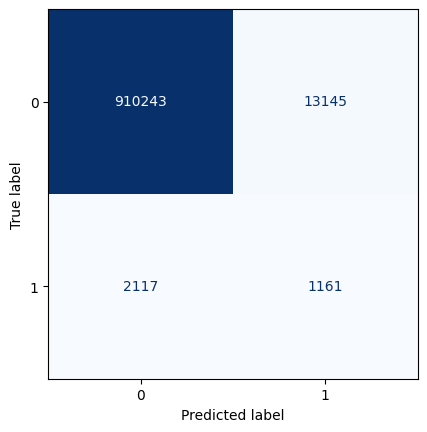

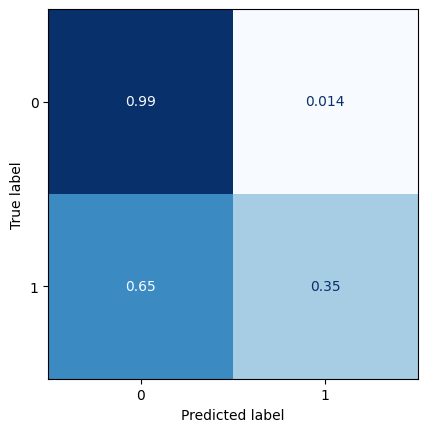

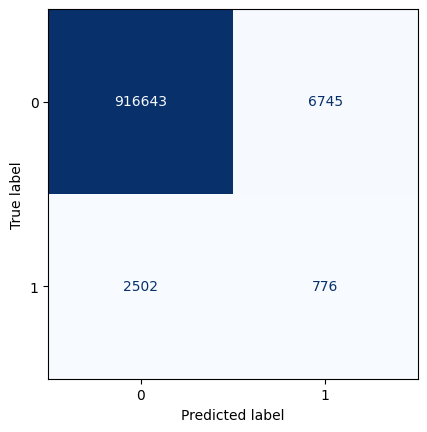

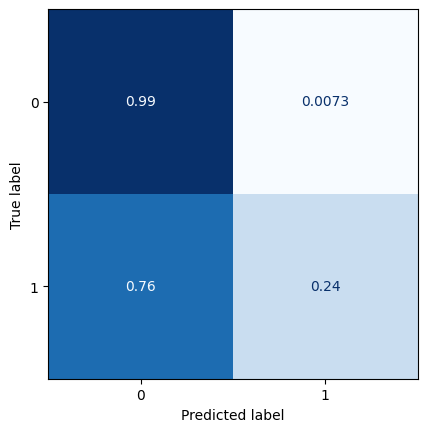

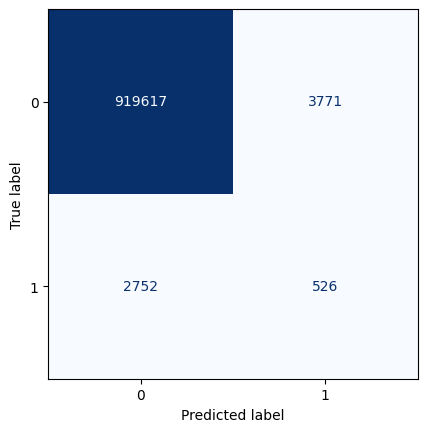

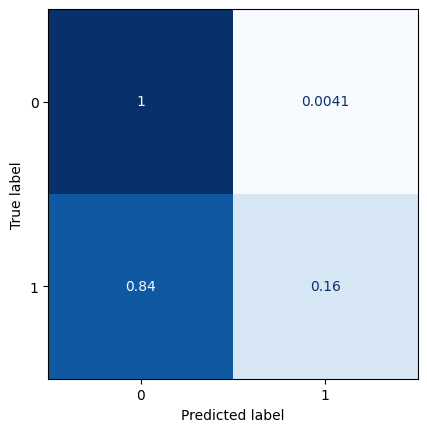

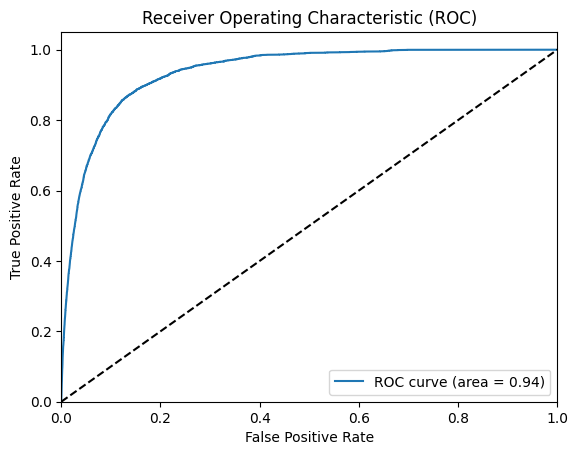

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0033860721551582968
77/77 [==============================] - 1s 17ms/step


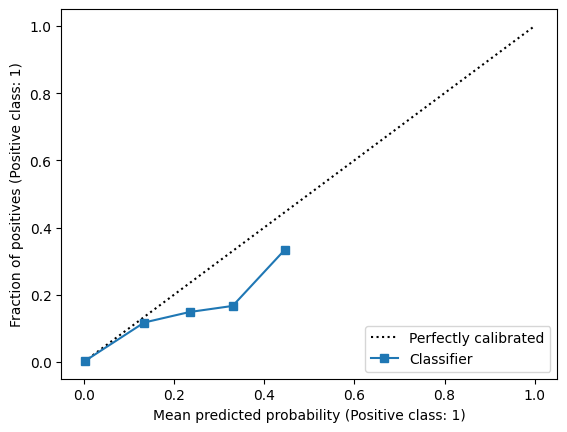

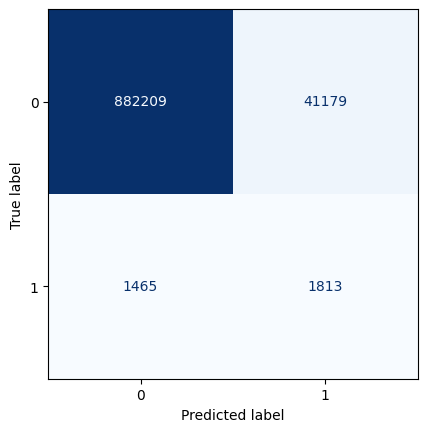

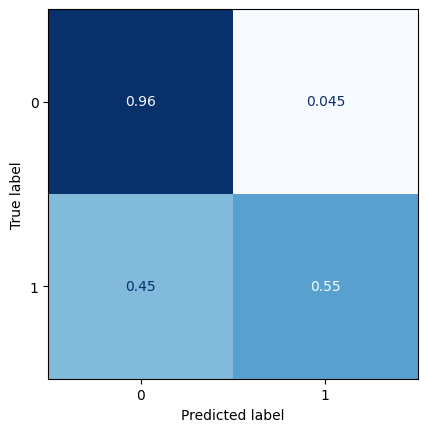

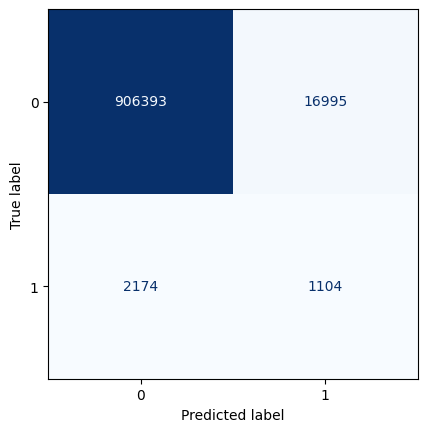

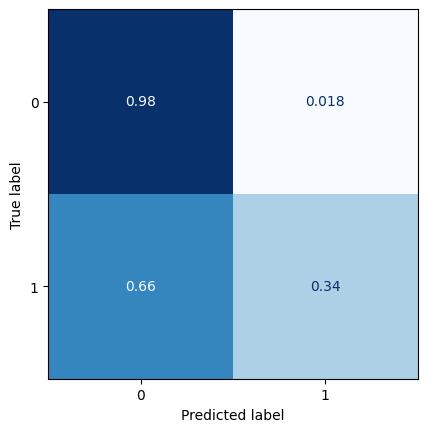

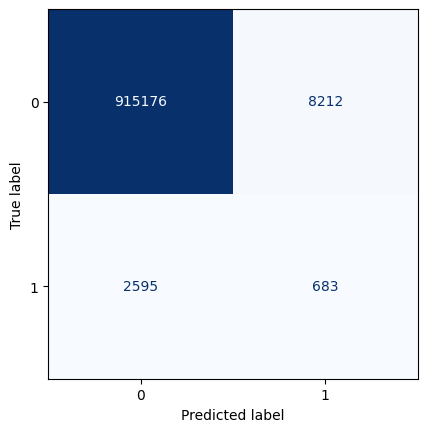

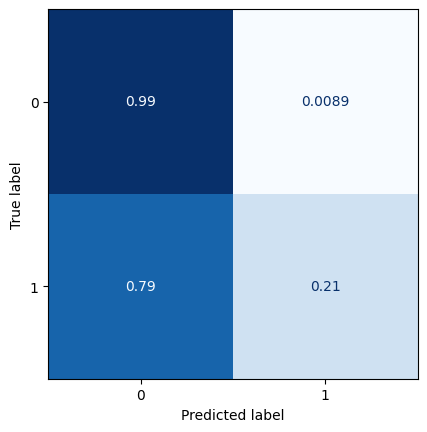

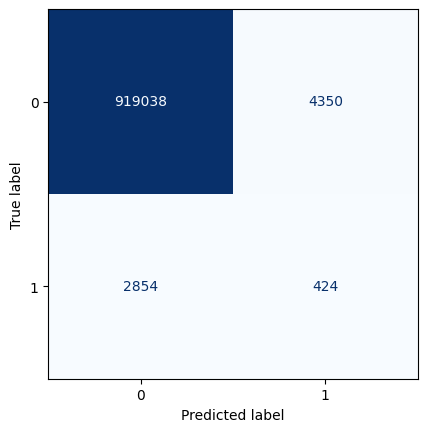

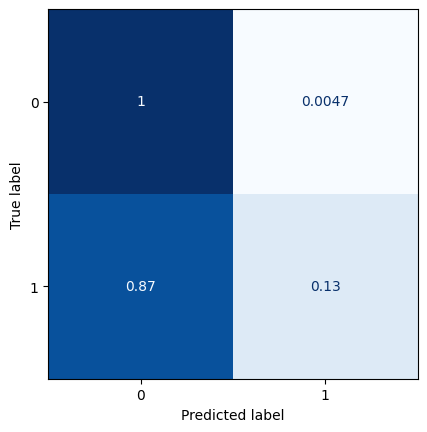

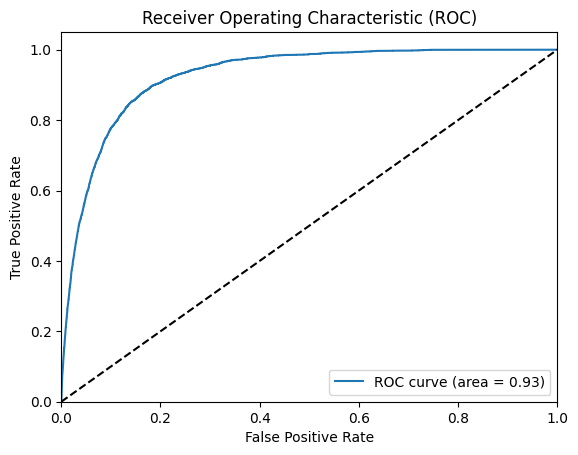

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0034437965367244165
Model: "model_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_36 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_21 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:40:51.238209: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2653

2023-04-08 23:41:17.894192: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 30s 592ms/step - loss: 0.2653 - val_loss: 0.0444 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 30s 669ms/step - loss: 0.0378 - val_loss: 0.0281 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 22s 485ms/step - loss: 0.0294 - val_loss: 0.0249 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 19s 407ms/step - loss: 0.0266 - val_loss: 0.0231 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 17s 385ms/step - loss: 0.0249 - val_loss: 0.0221 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 20s 436ms/step - loss: 0.0237 - val_loss: 0.0215 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 21s 458ms/step - loss: 0.0229 - val_loss: 0.0206 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 19s 414ms/step - loss: 0.0224 - val_loss: 0.0203 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 19s 413ms/step - loss: 0.0219 - val_los

2023-04-08 23:52:44.129822: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 3s 19ms/step


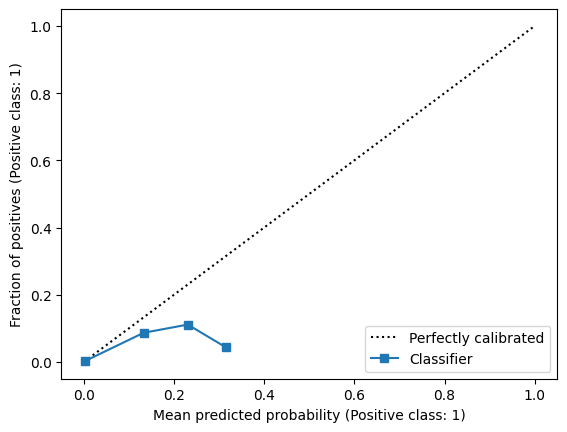

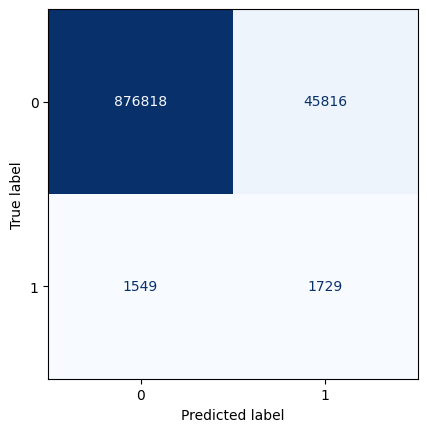

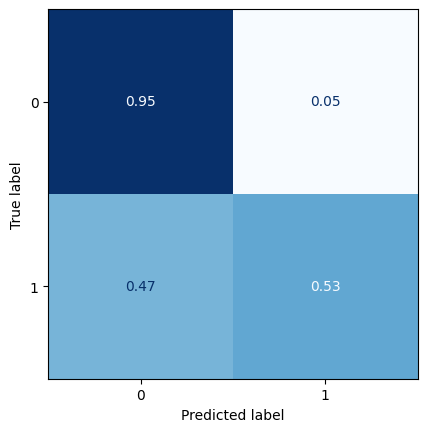

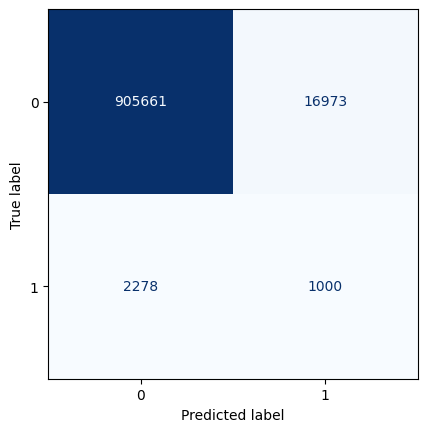

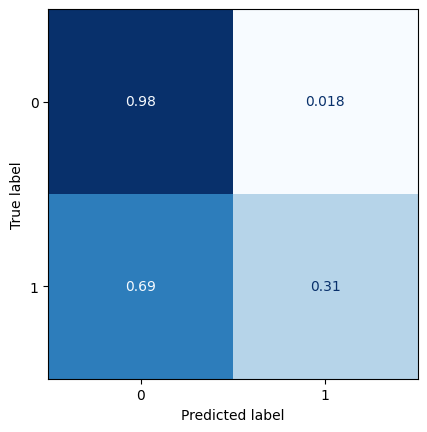

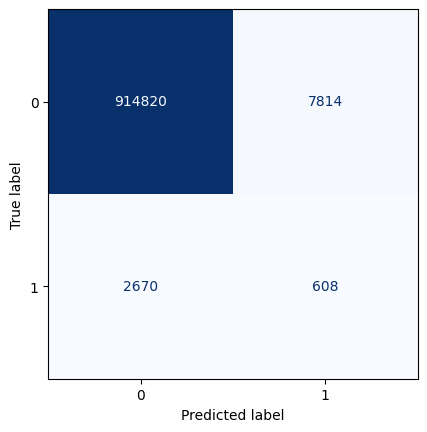

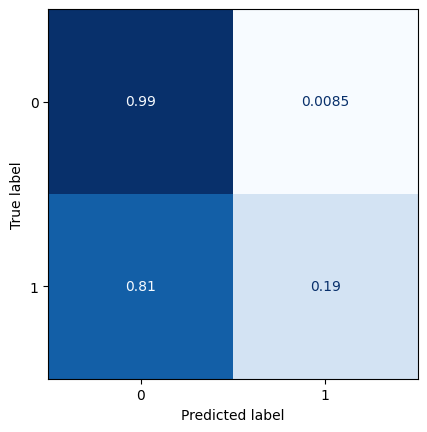

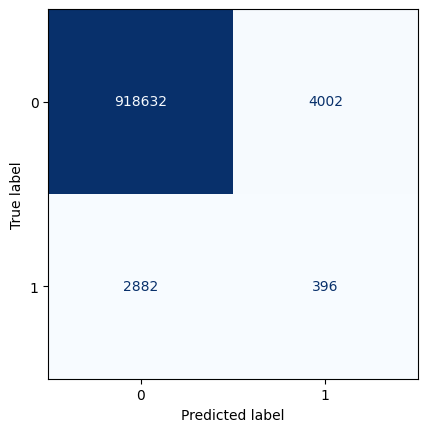

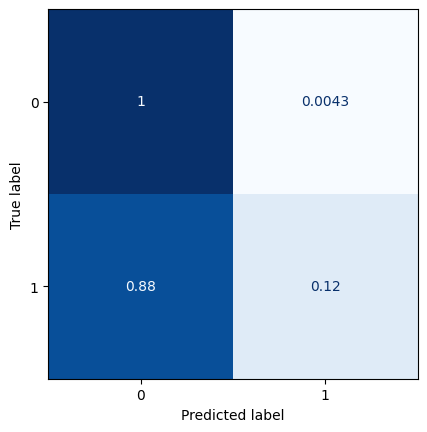

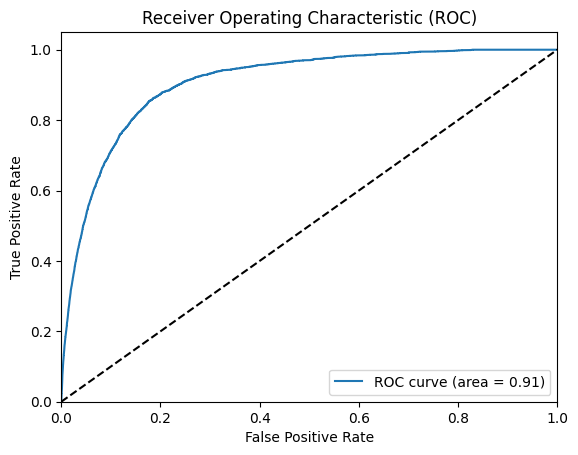

All zeros Brier score: 0.00354029324601042
Model Brier score: 0.0034701150595645284
77/77 [==============================] - 1s 19ms/step


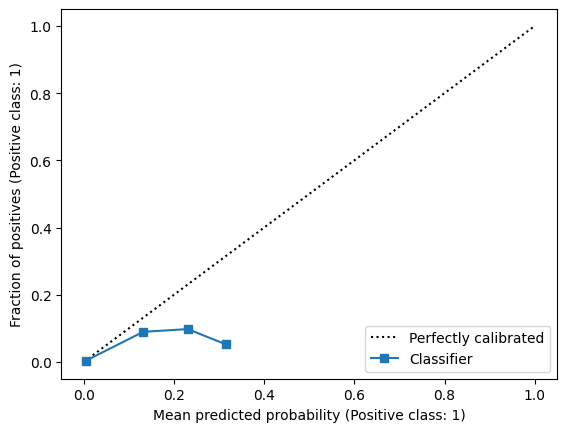

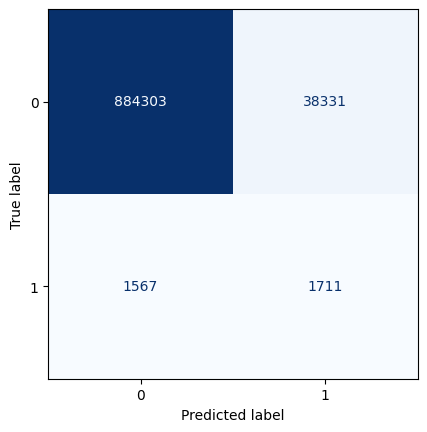

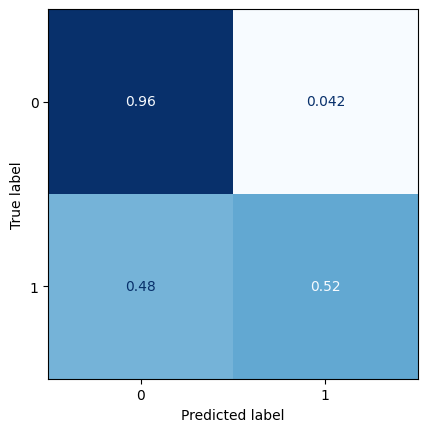

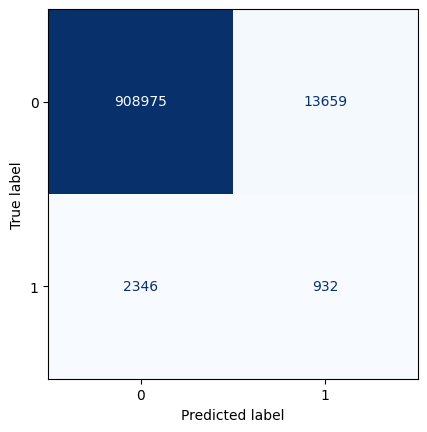

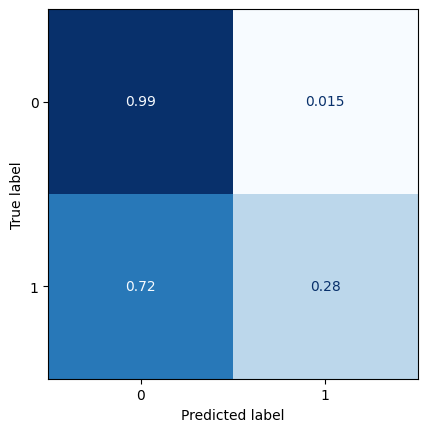

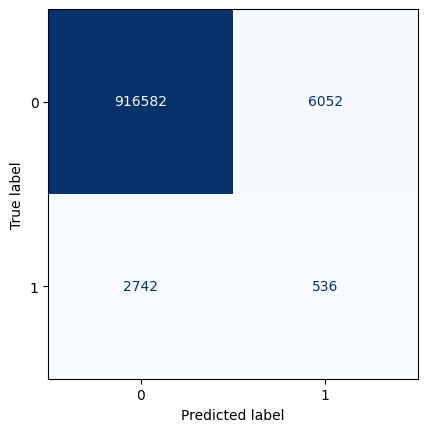

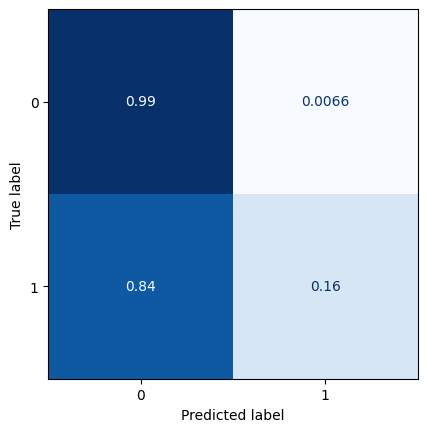

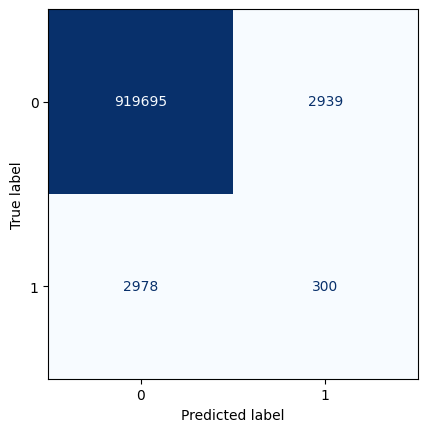

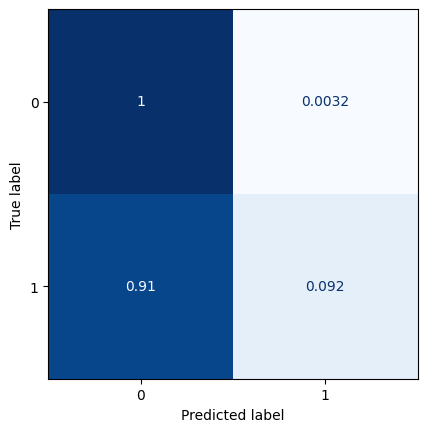

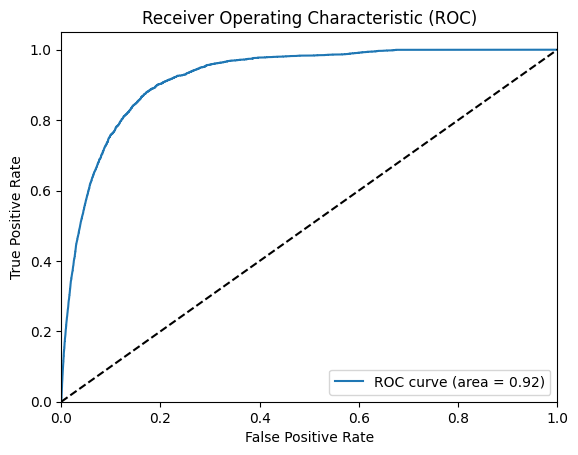

All zeros Brier score: 0.00354029324601042
Model Brier score: 0.0034430352515563375
77/77 [==============================] - 2s 21ms/step


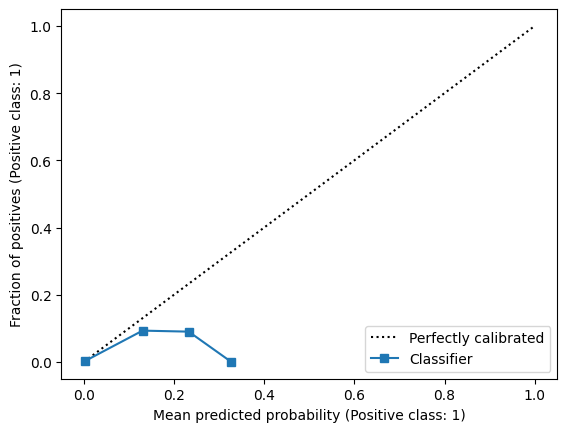

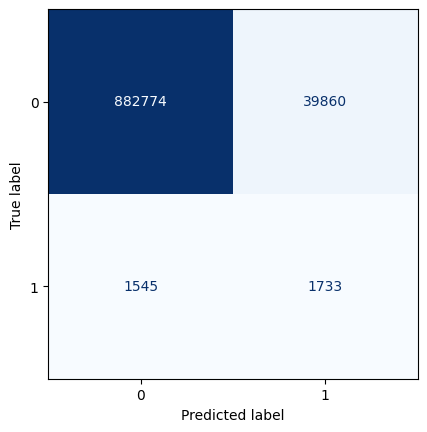

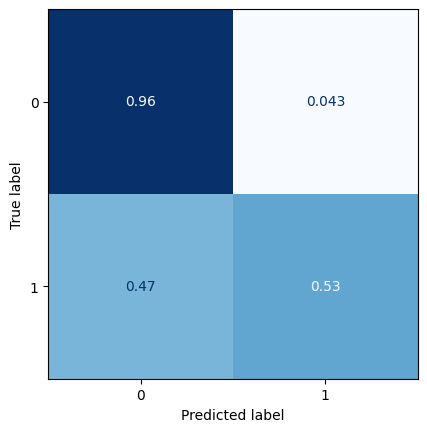

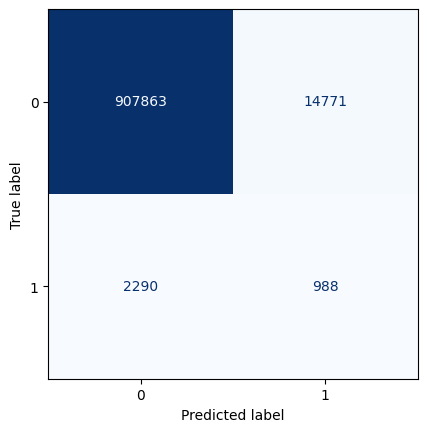

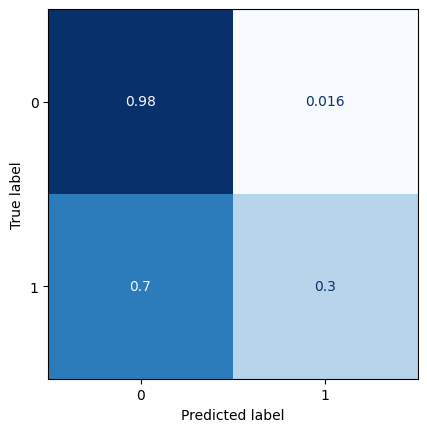

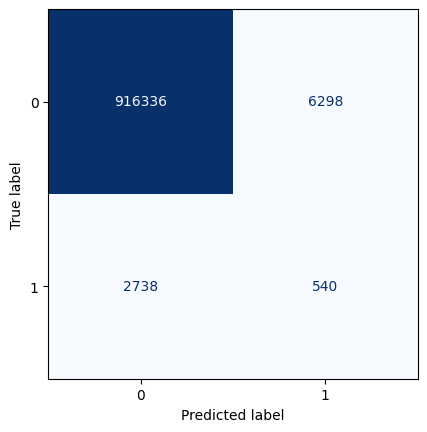

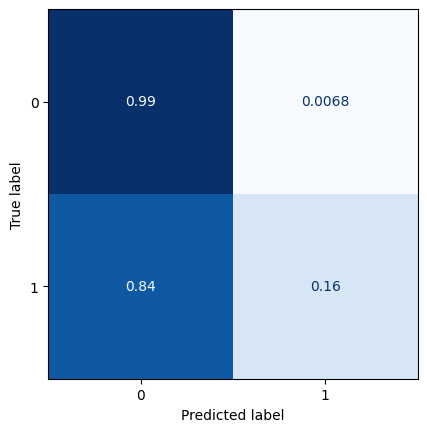

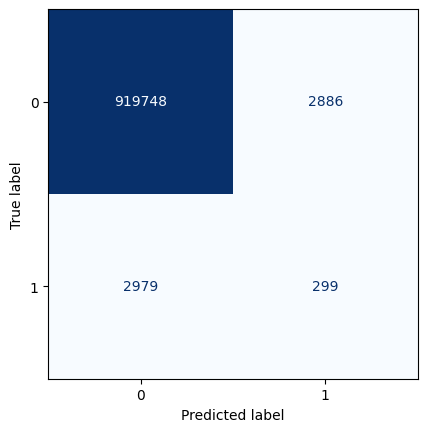

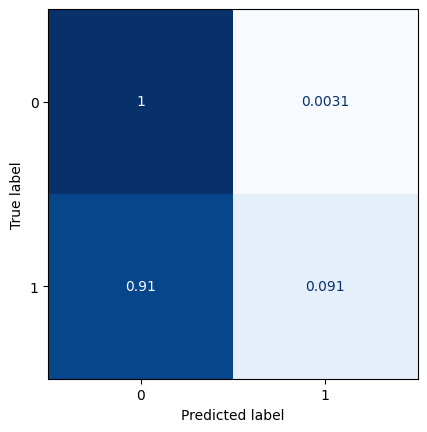

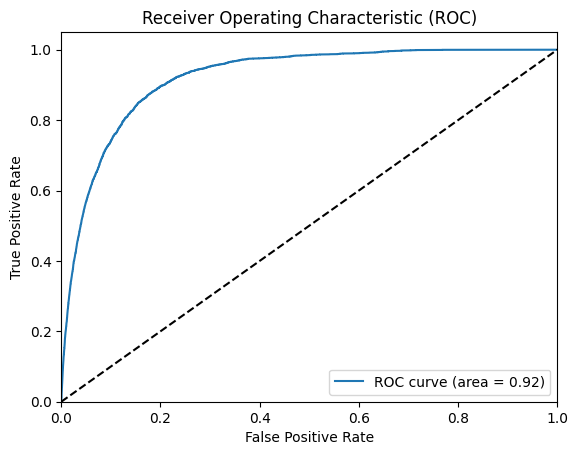

All zeros Brier score: 0.00354029324601042
Model Brier score: 0.003442545356590767
77/77 [==============================] - 2s 19ms/step


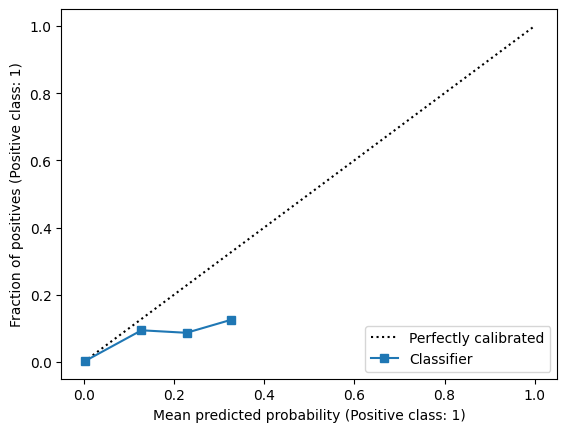

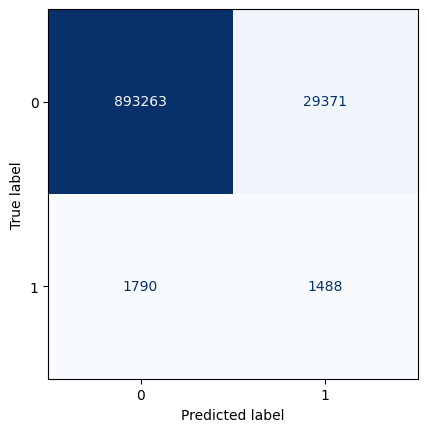

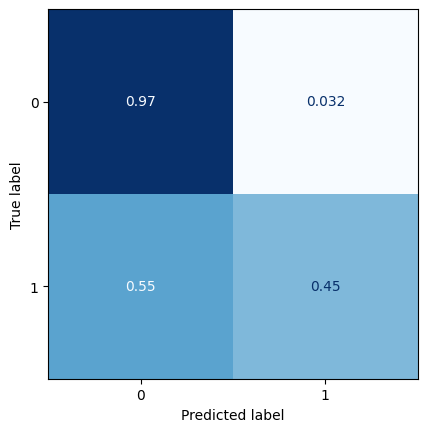

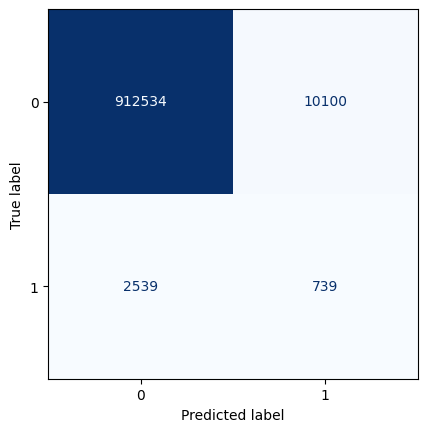

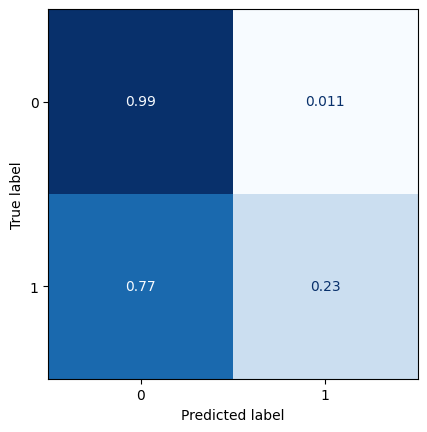

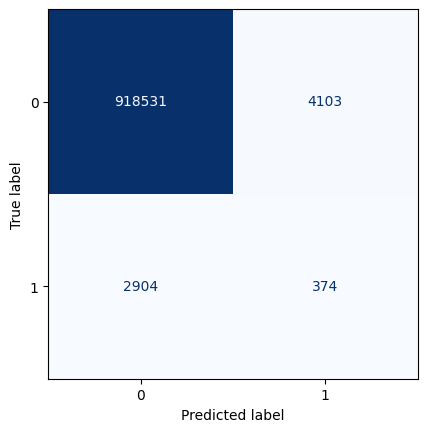

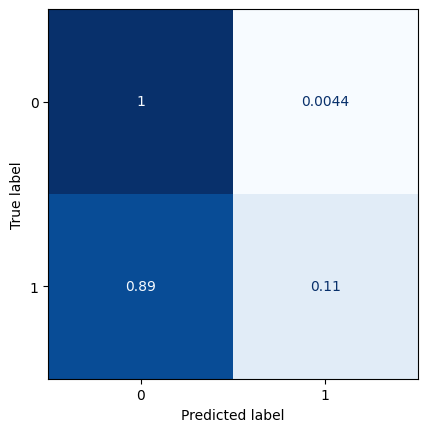

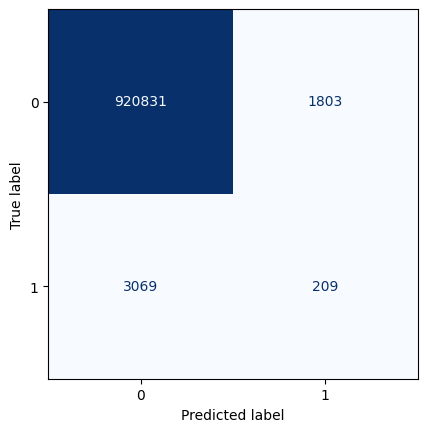

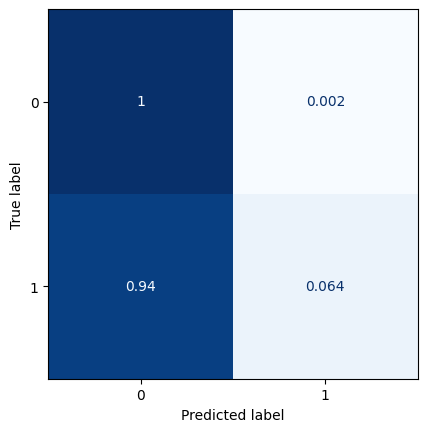

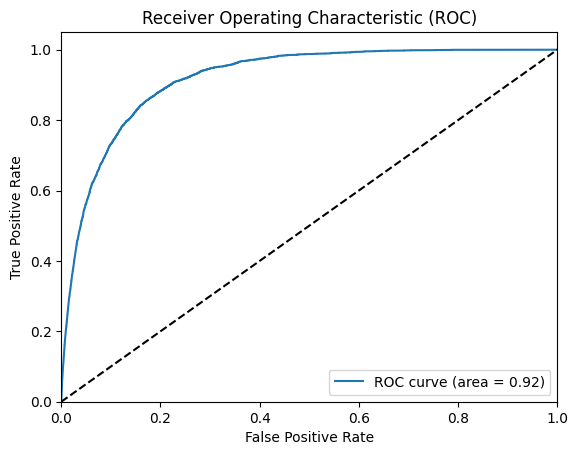

All zeros Brier score: 0.00354029324601042
Model Brier score: 0.003435820055646646
77/77 [==============================] - 2s 20ms/step


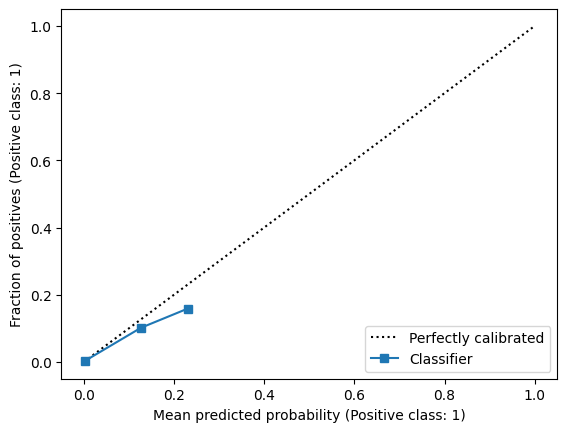

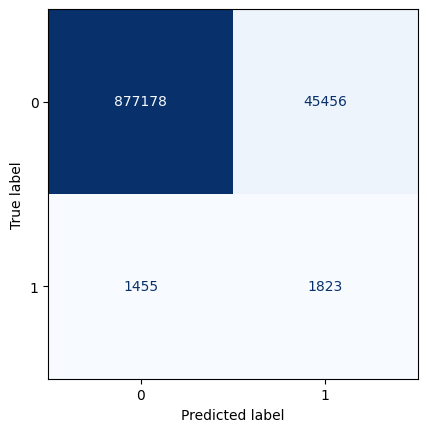

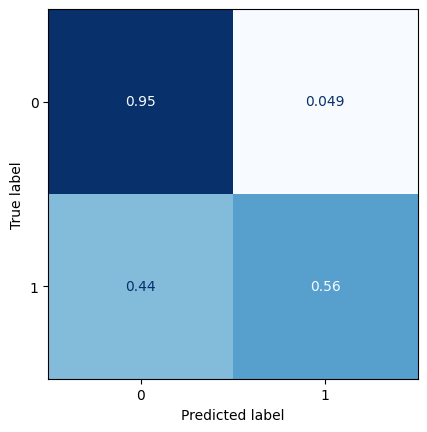

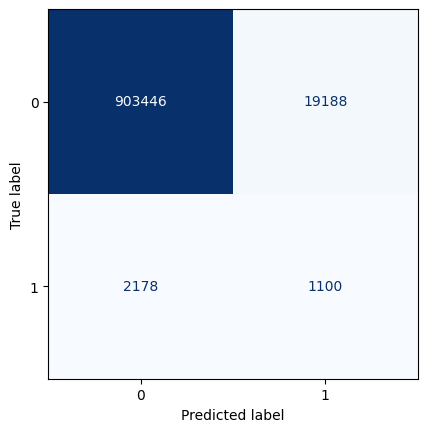

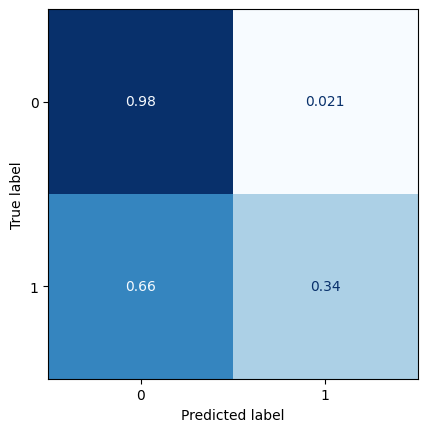

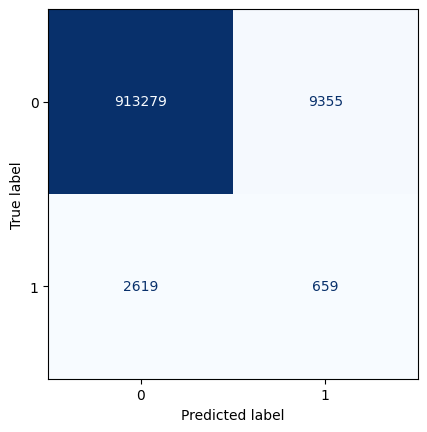

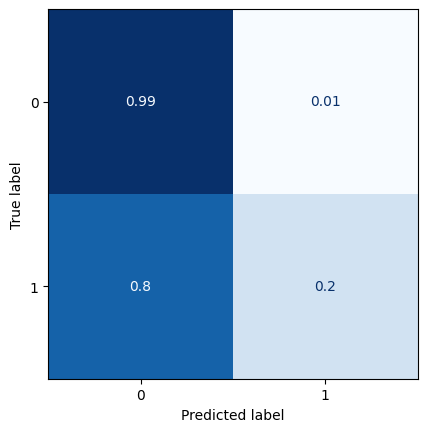

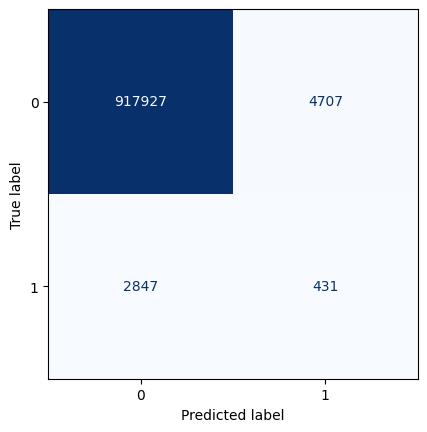

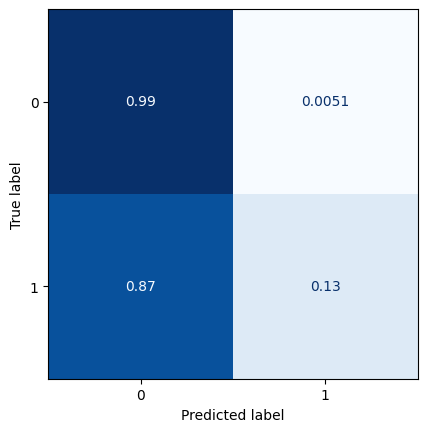

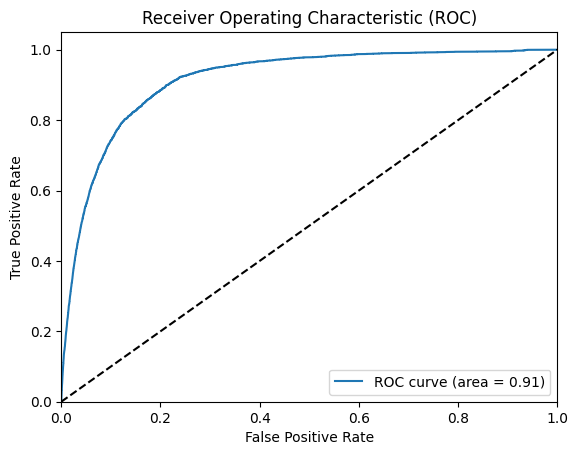

All zeros Brier score: 0.00354029324601042
Model Brier score: 0.003470346870619687
Model: "model_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_23 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_37 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_22 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-08 23:54:03.865402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2117

2023-04-08 23:54:34.750696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 35s 664ms/step - loss: 0.2117 - val_loss: 0.0458 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 29s 645ms/step - loss: 0.0396 - val_loss: 0.0302 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 30s 656ms/step - loss: 0.0310 - val_loss: 0.0252 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 29s 628ms/step - loss: 0.0275 - val_loss: 0.0236 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 32s 698ms/step - loss: 0.0259 - val_loss: 0.0227 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 26s 555ms/step - loss: 0.0249 - val_loss: 0.0222 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 26s 582ms/step - loss: 0.0242 - val_loss: 0.0218 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 24s 522ms/step - loss: 0.0237 - val_loss: 0.0215 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 26s 575ms/step - loss: 0.0233 - val_los

2023-04-09 00:08:11.204324: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 4s 25ms/step


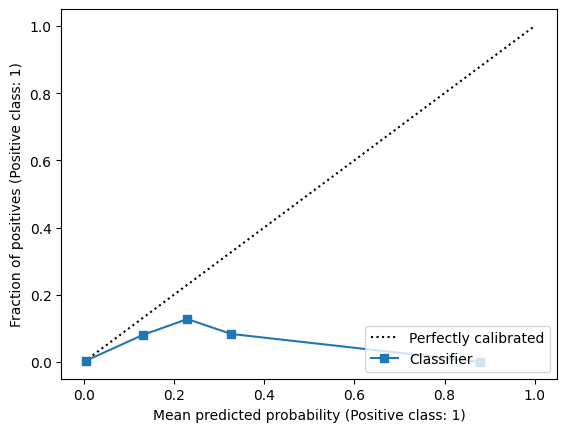

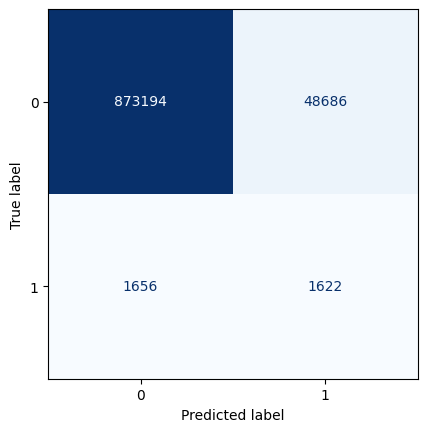

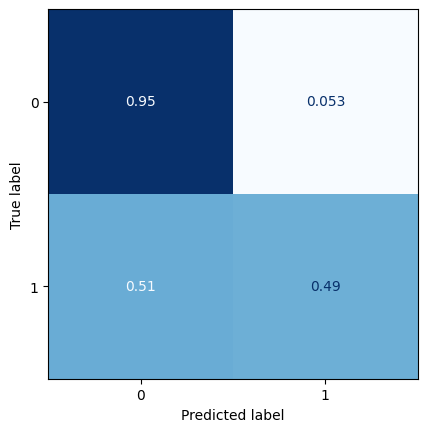

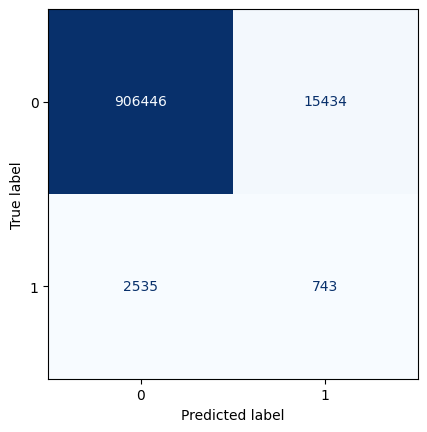

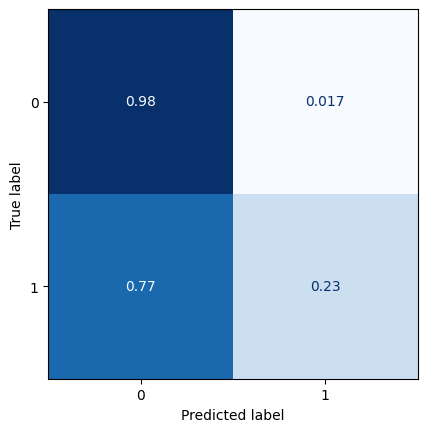

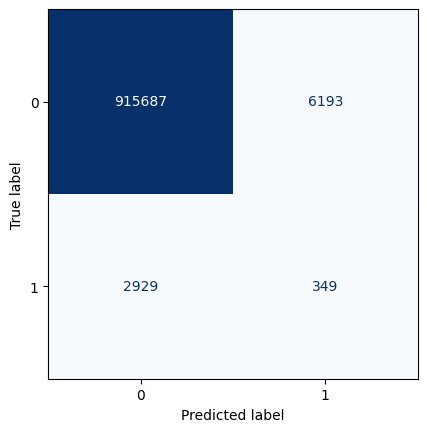

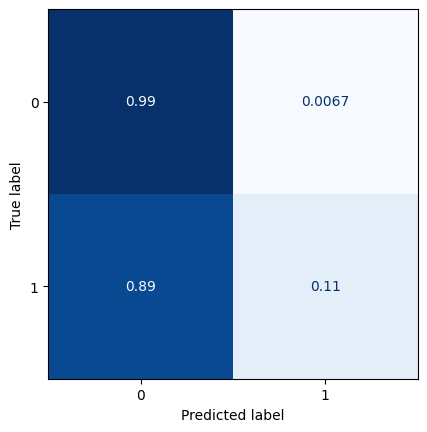

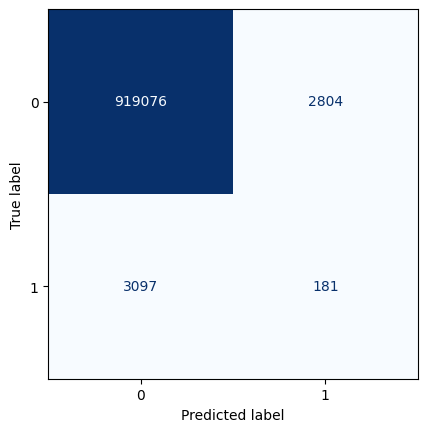

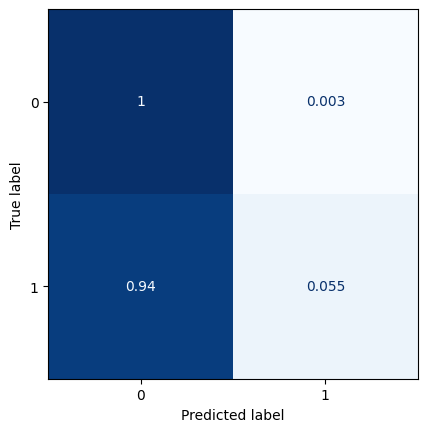

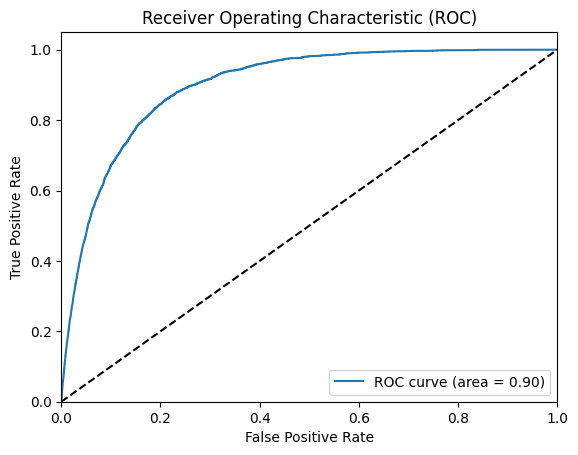

All zeros Brier score: 0.0035431785705792957
Model Brier score: 0.003506257870489199
77/77 [==============================] - 2s 23ms/step


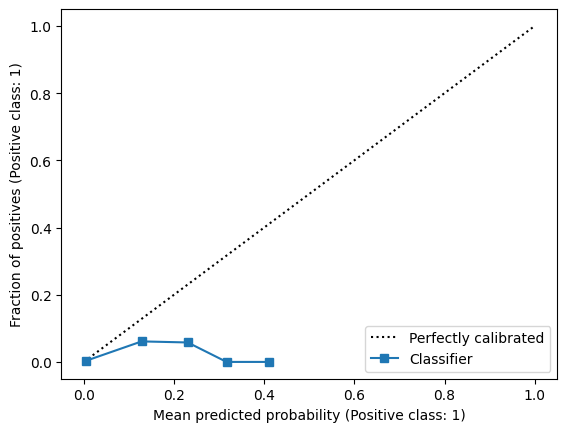

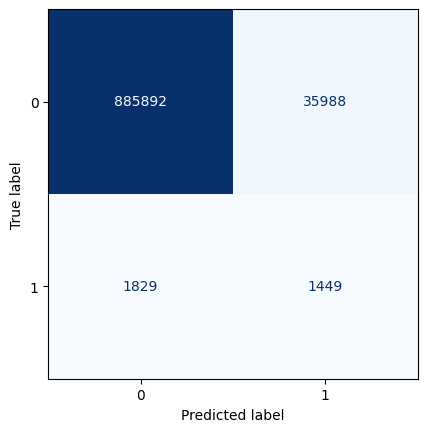

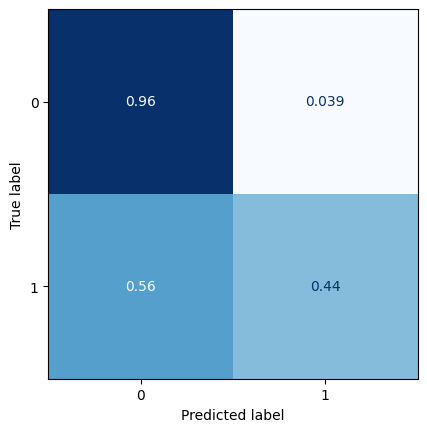

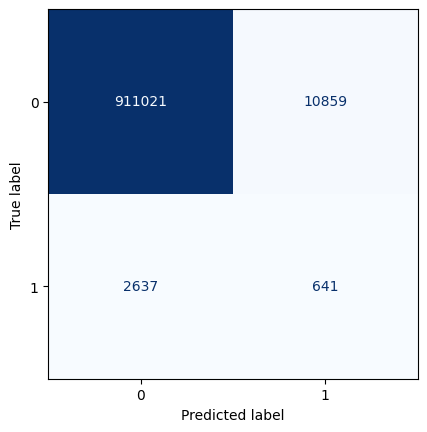

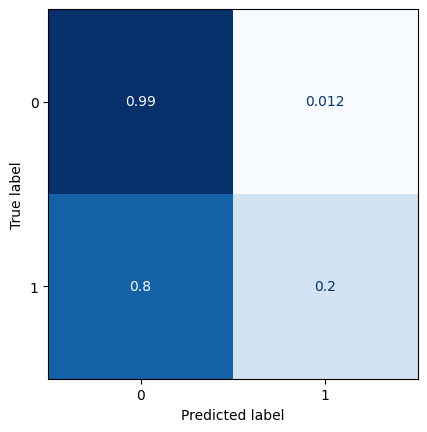

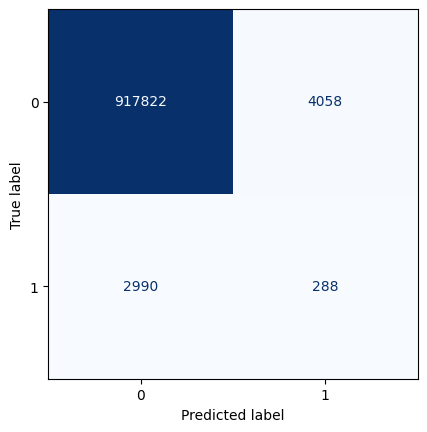

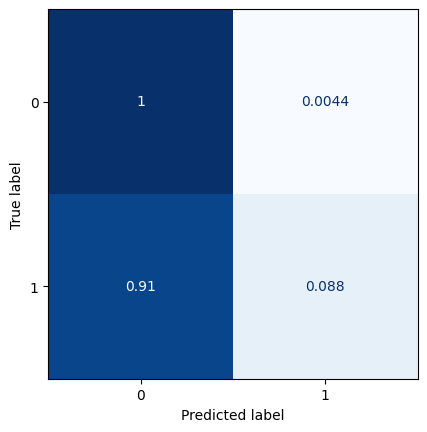

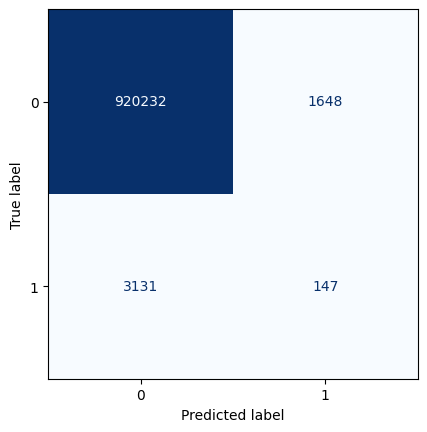

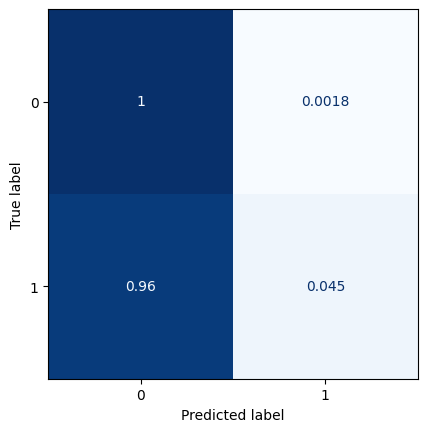

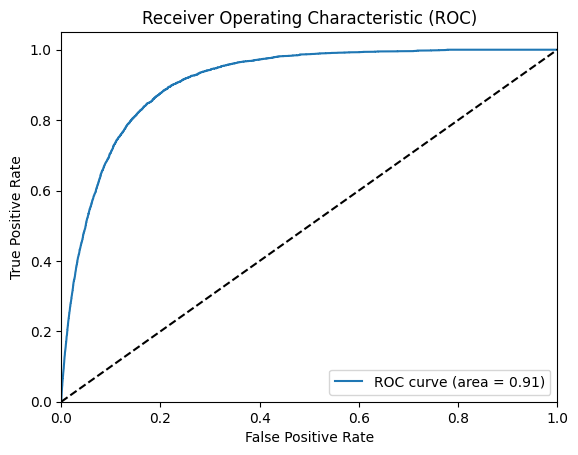

All zeros Brier score: 0.0035431785705792957
Model Brier score: 0.003464648697455716
77/77 [==============================] - 2s 20ms/step


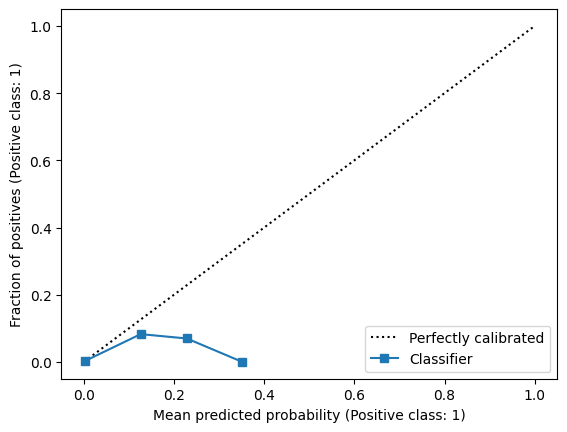

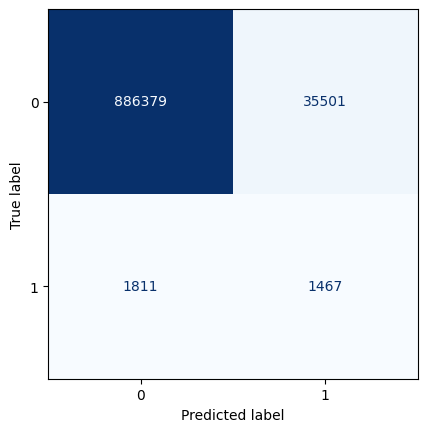

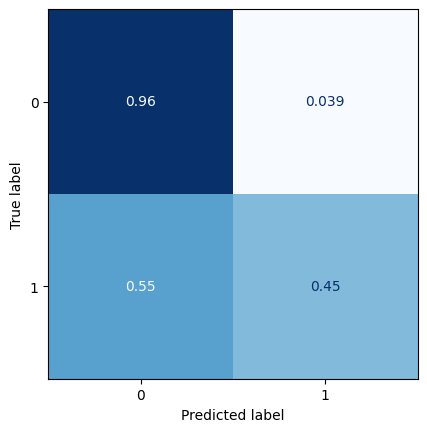

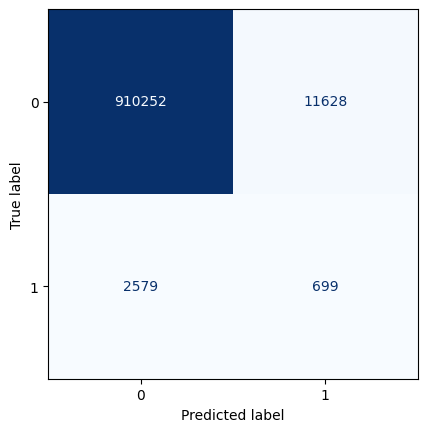

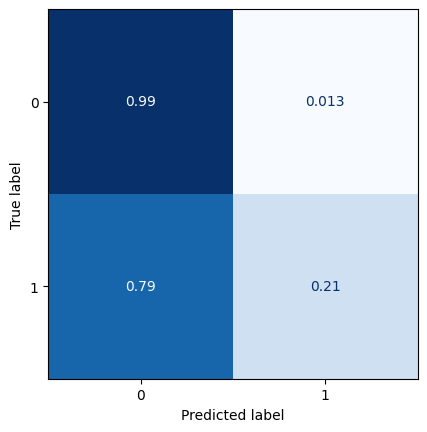

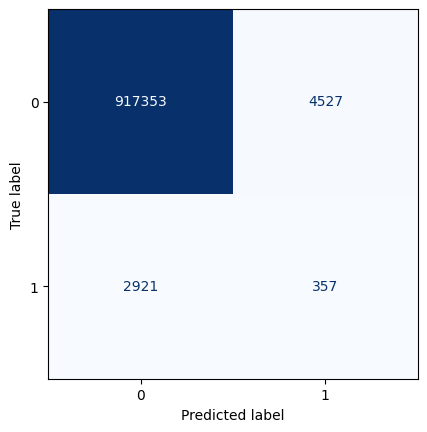

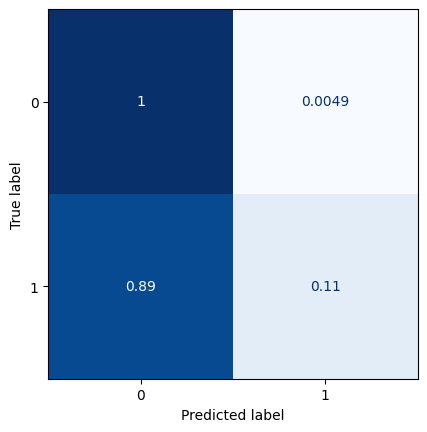

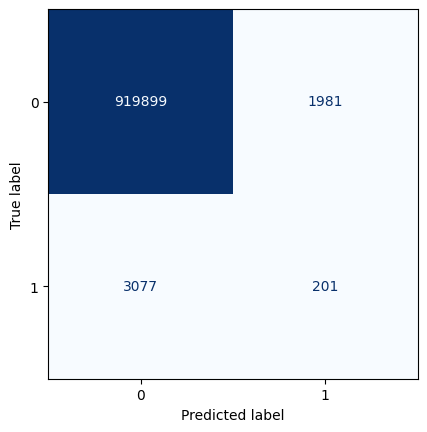

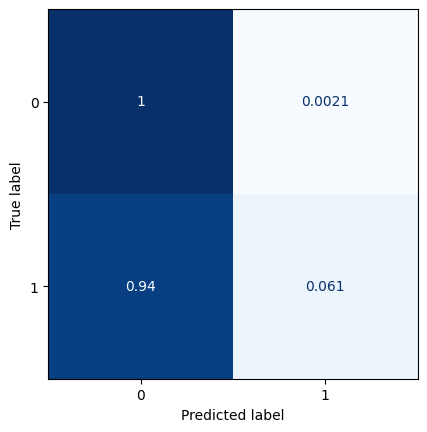

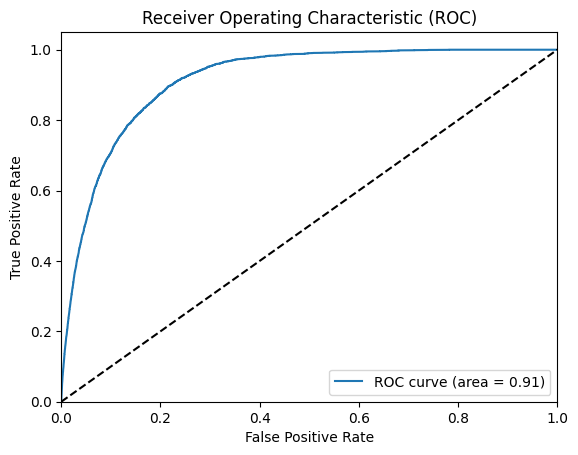

All zeros Brier score: 0.0035431785705792957
Model Brier score: 0.003459583644550435
77/77 [==============================] - 2s 17ms/step


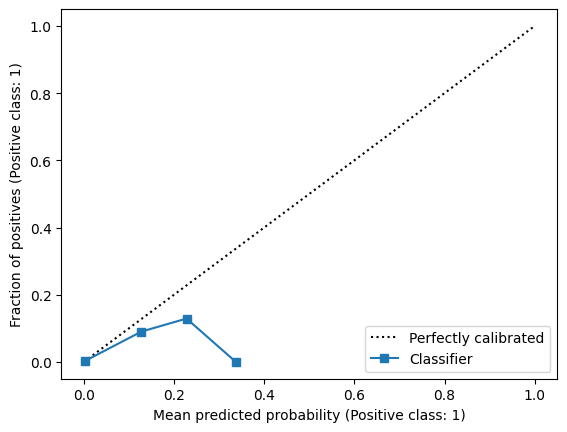

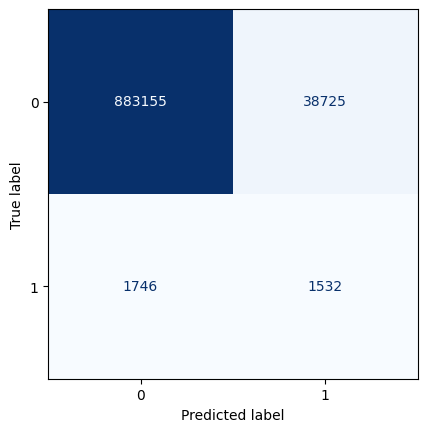

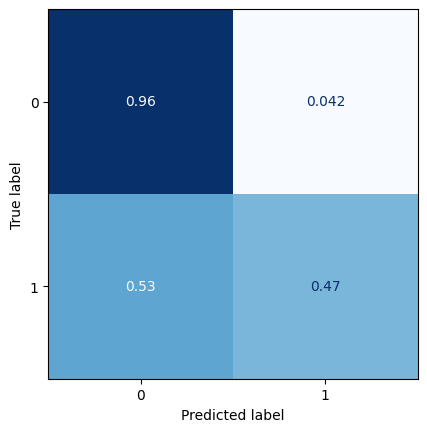

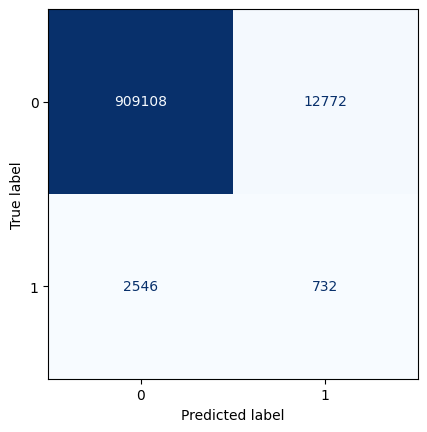

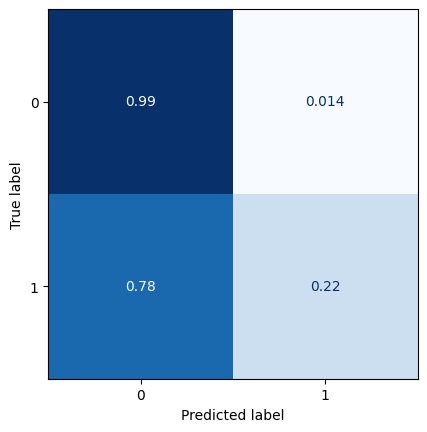

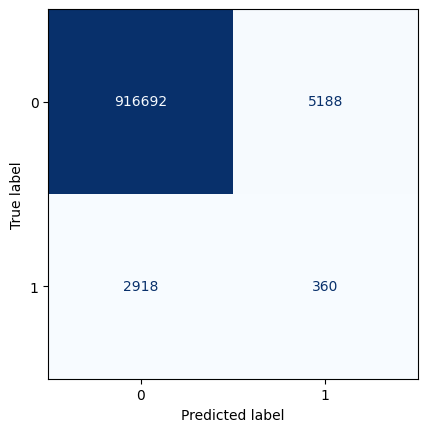

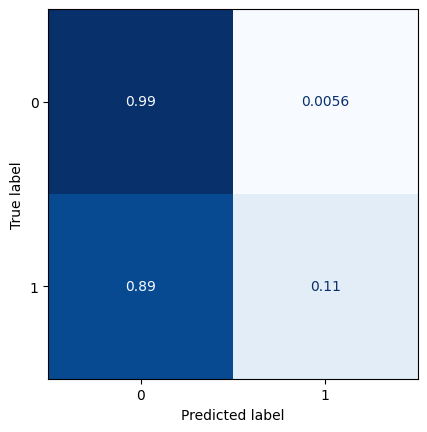

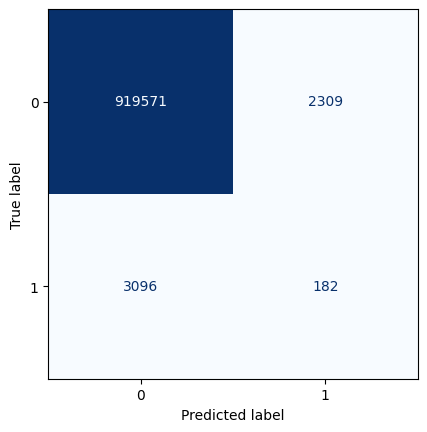

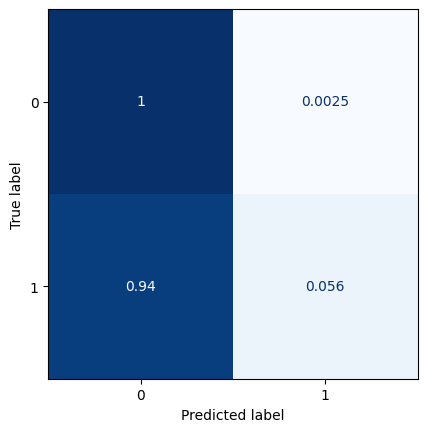

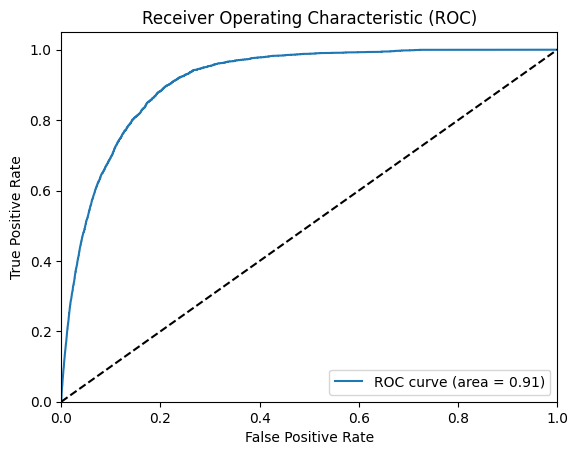

All zeros Brier score: 0.0035431785705792957
Model Brier score: 0.0034736374610095603
77/77 [==============================] - 2s 22ms/step


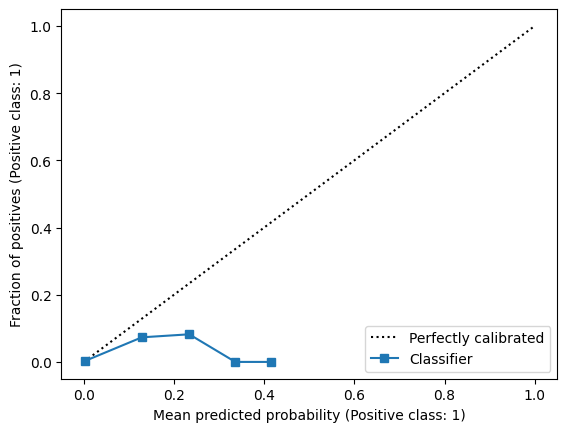

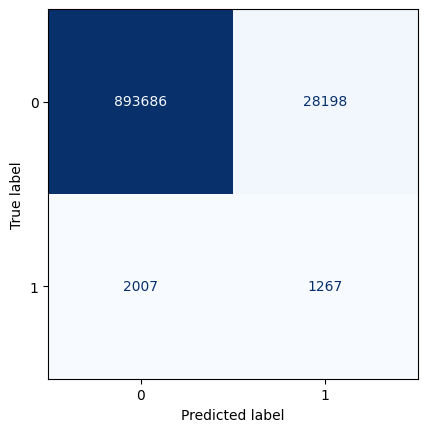

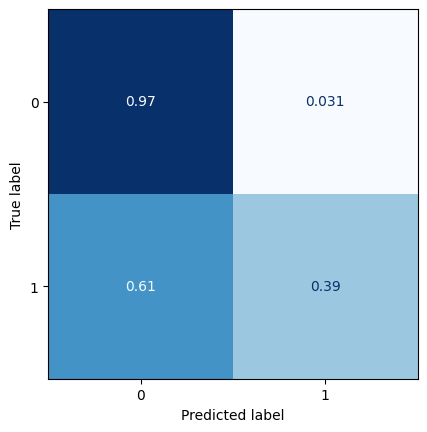

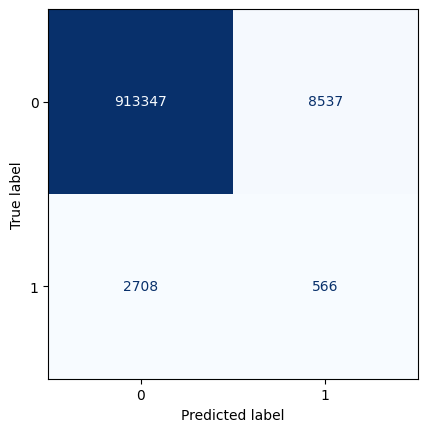

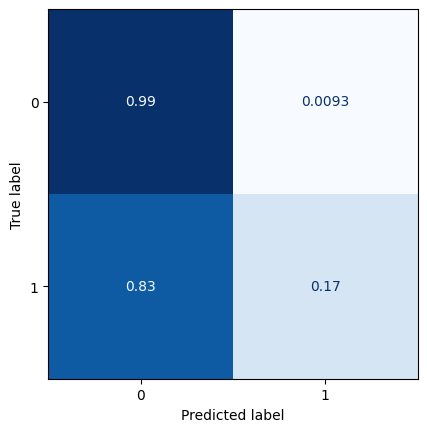

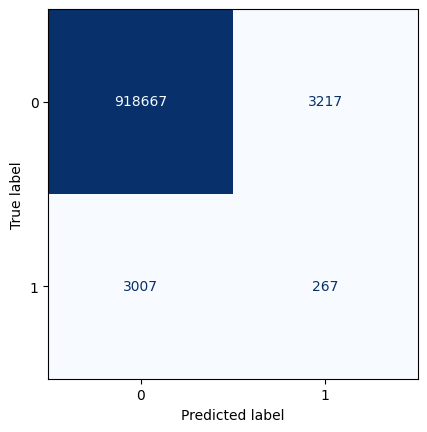

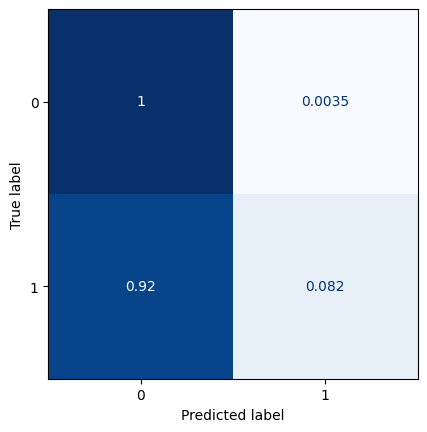

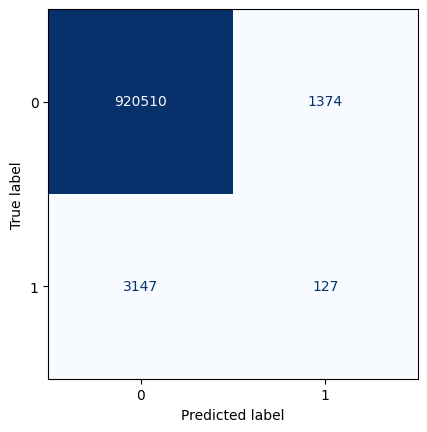

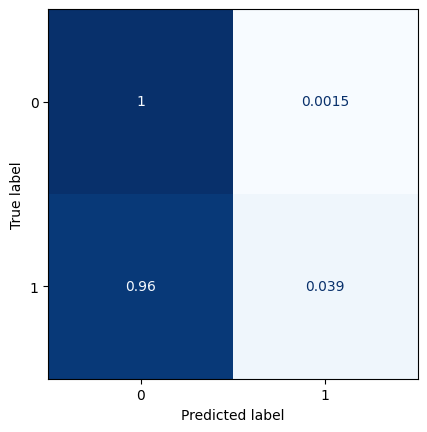

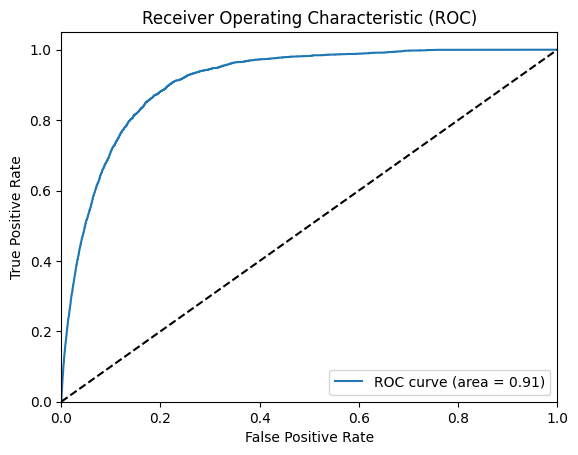

All zeros Brier score: 0.003538854984770169
Model Brier score: 0.003456687064582202
77/77 [==============================] - 2s 22ms/step


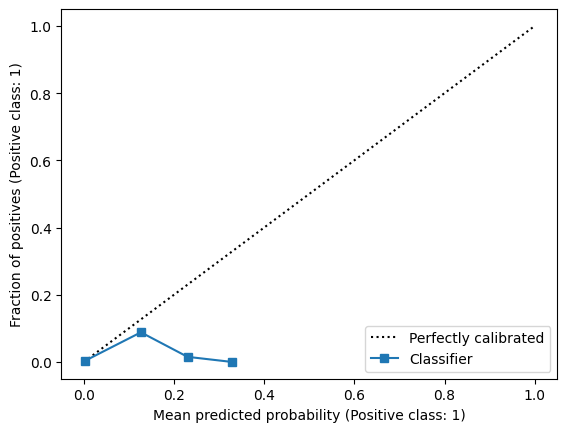

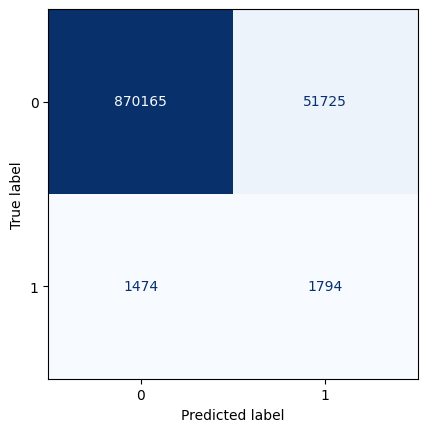

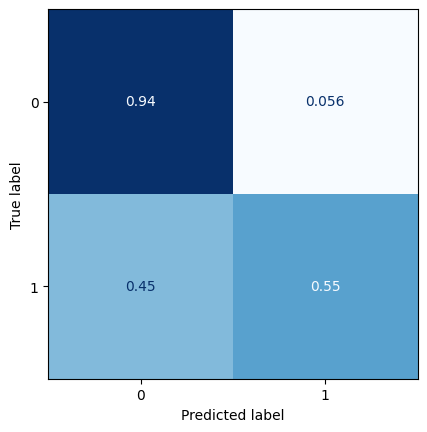

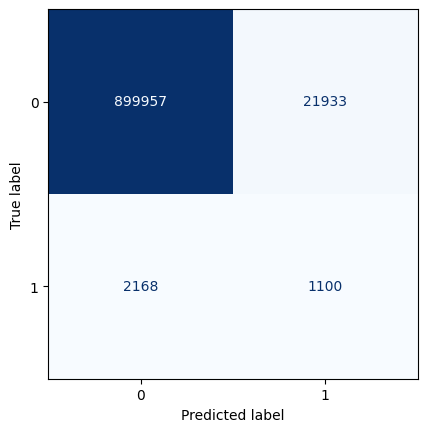

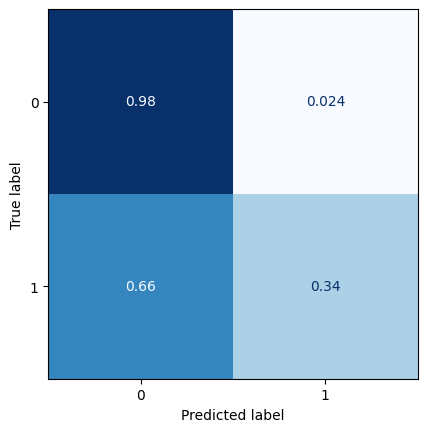

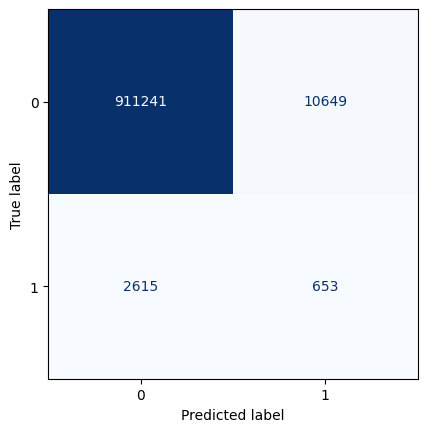

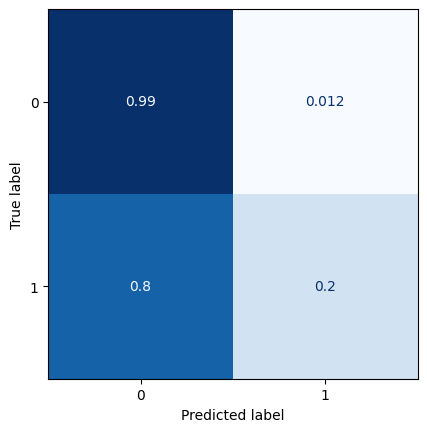

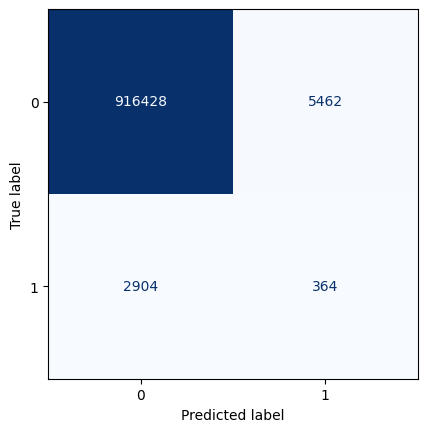

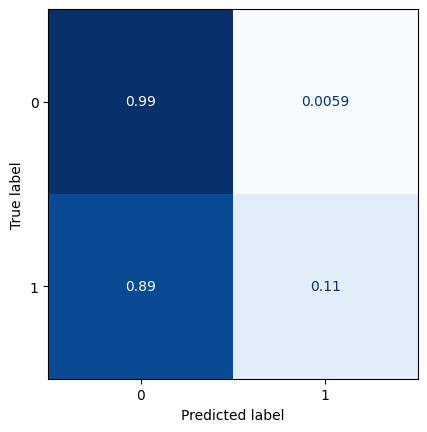

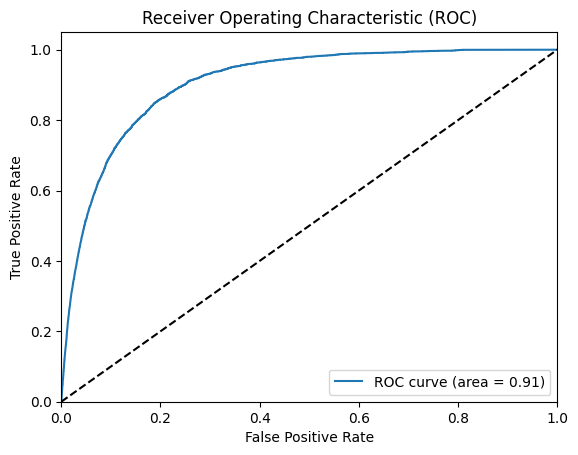

All zeros Brier score: 0.003532369606056479
Model Brier score: 0.0035151264130792365
Model: "model_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_24 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_38 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_23 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 00:09:58.157604: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.2206

2023-04-09 00:10:40.606119: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 47s 918ms/step - loss: 0.2206 - val_loss: 0.0525 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 38s 807ms/step - loss: 0.0411 - val_loss: 0.0295 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 37s 802ms/step - loss: 0.0305 - val_loss: 0.0259 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 31s 693ms/step - loss: 0.0275 - val_loss: 0.0240 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 32s 710ms/step - loss: 0.0257 - val_loss: 0.0231 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 33s 725ms/step - loss: 0.0246 - val_loss: 0.0223 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 27s 585ms/step - loss: 0.0239 - val_loss: 0.0217 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 28s 615ms/step - loss: 0.0233 - val_loss: 0.0212 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 27s 580ms/step - loss: 0.0229 - val_los

2023-04-09 00:30:29.046655: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 3s 24ms/step


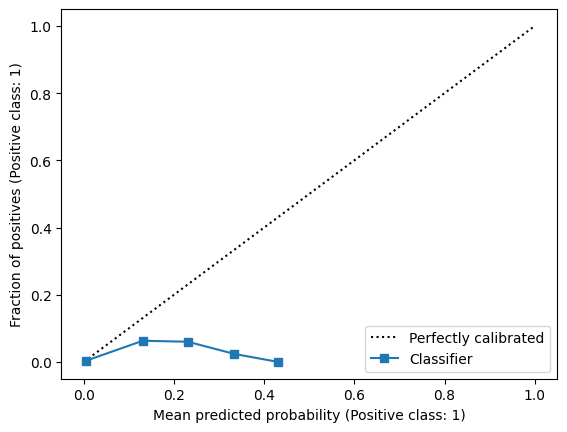

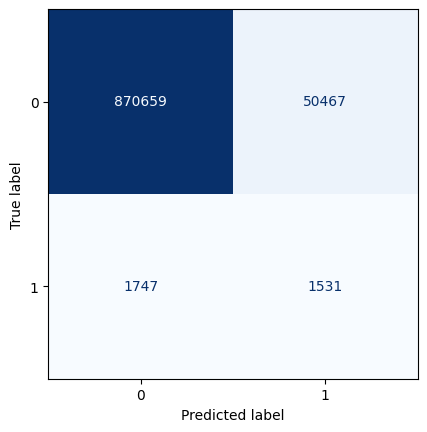

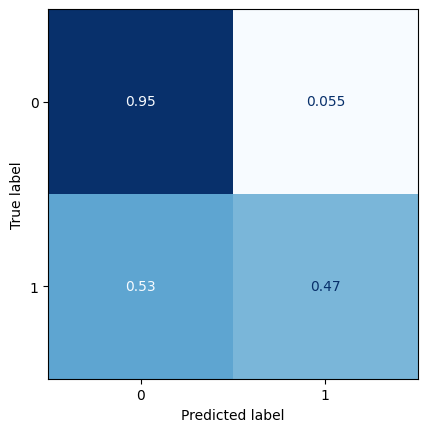

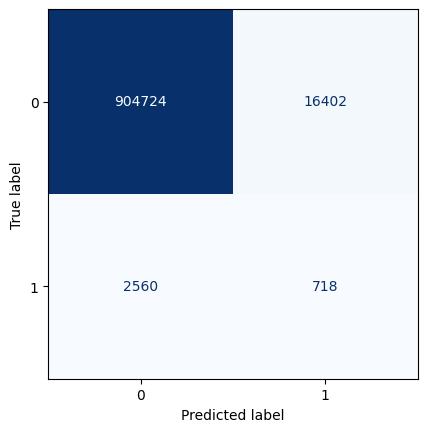

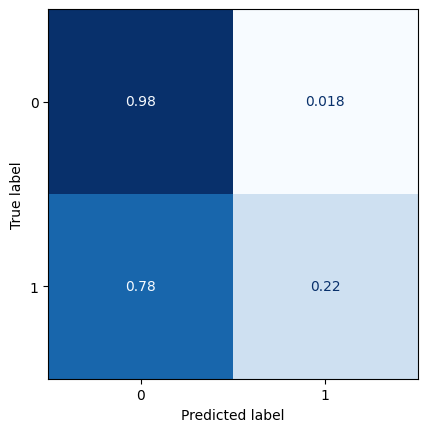

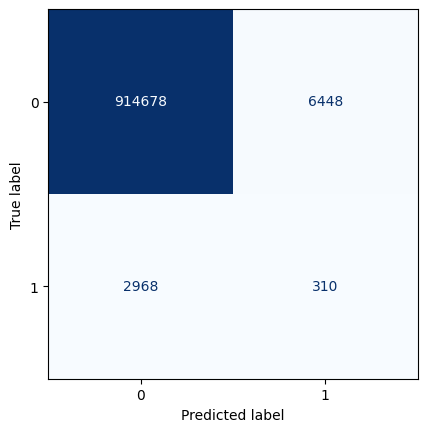

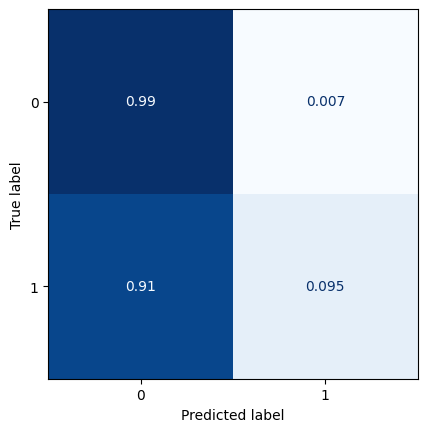

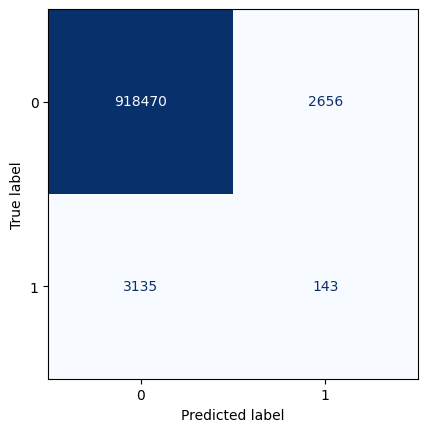

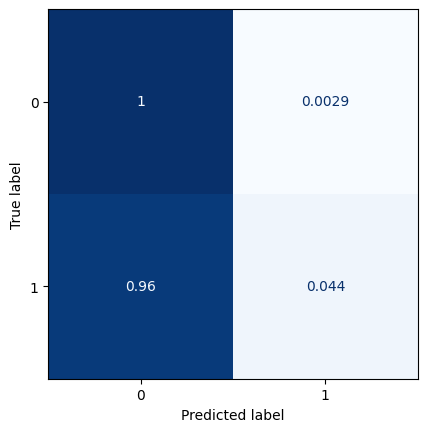

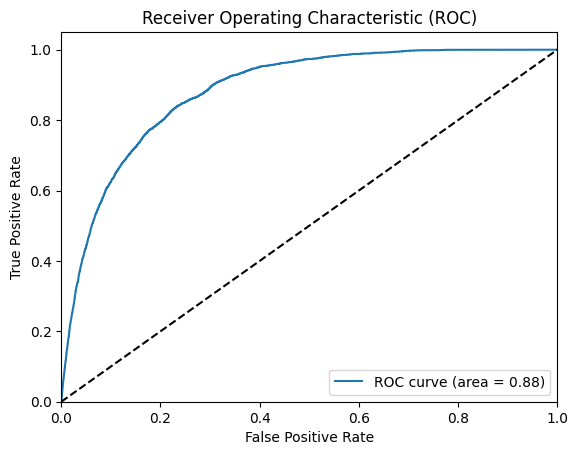

All zeros Brier score: 0.0035460686020398007
Model Brier score: 0.0035244345558091946
77/77 [==============================] - 2s 21ms/step


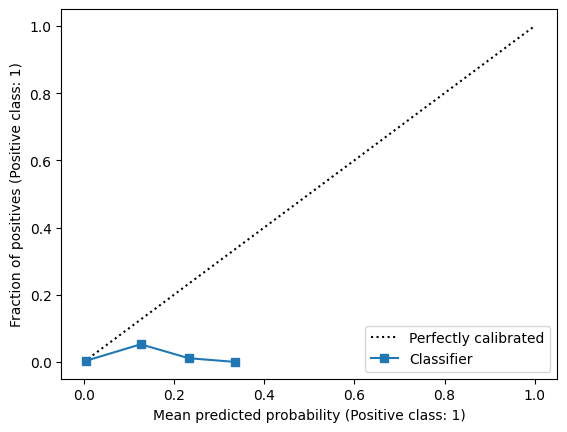

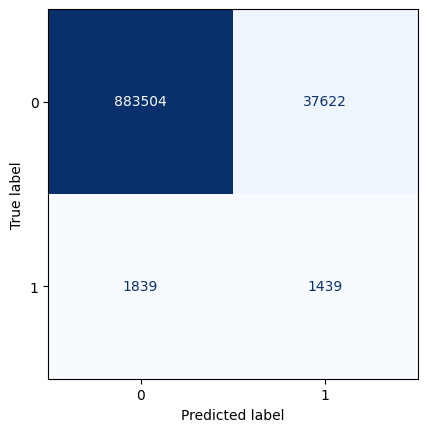

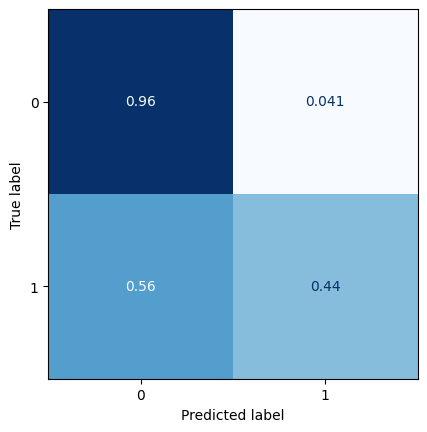

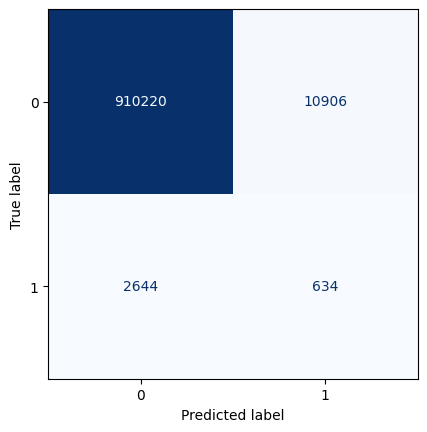

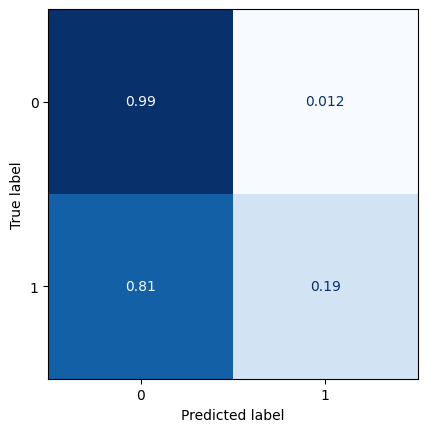

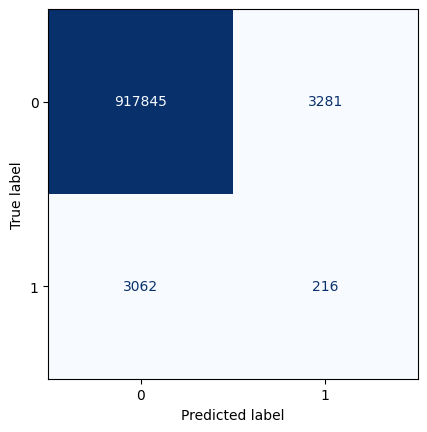

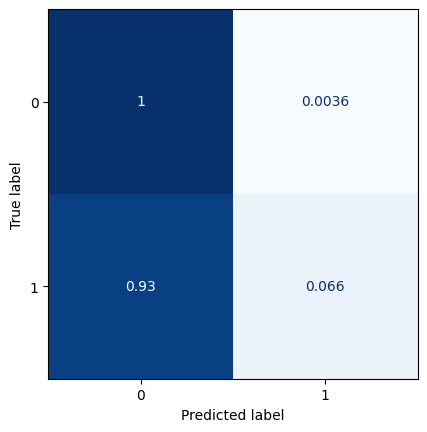

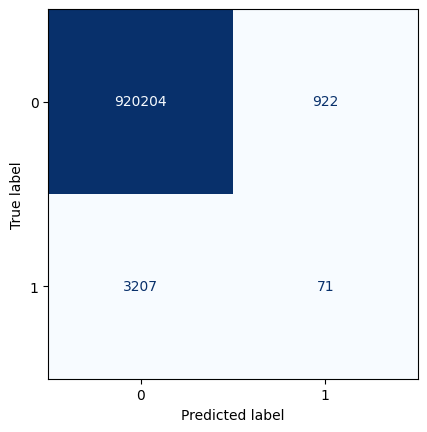

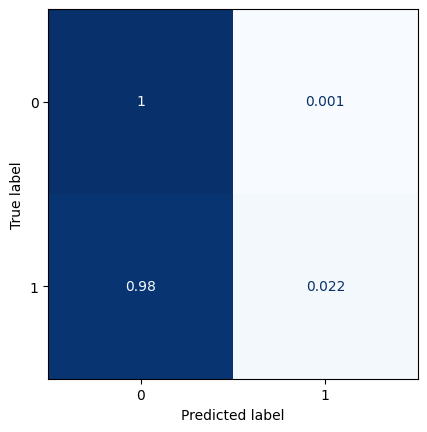

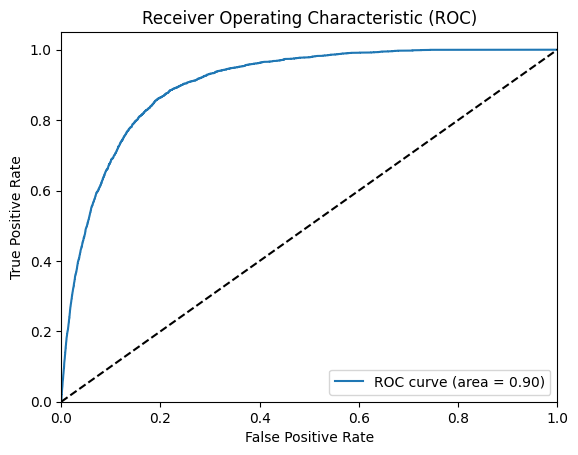

All zeros Brier score: 0.0035460686020398007
Model Brier score: 0.0034700061943231347
77/77 [==============================] - 2s 22ms/step


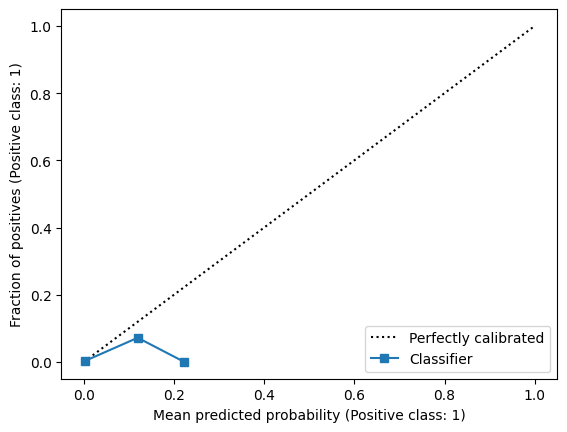

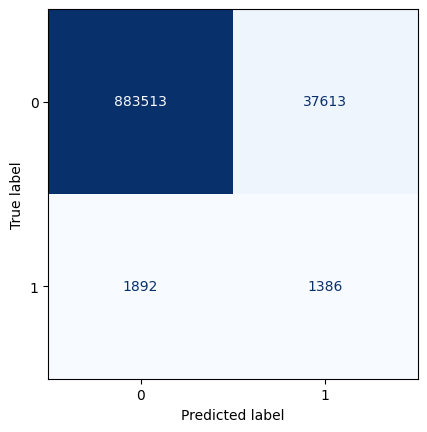

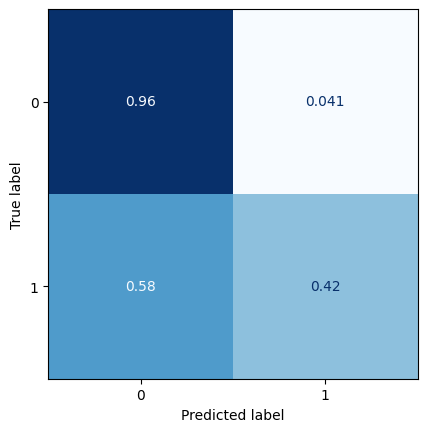

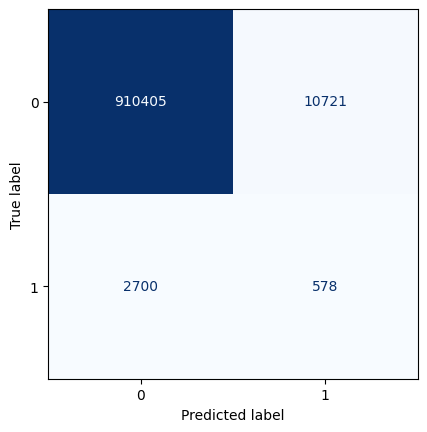

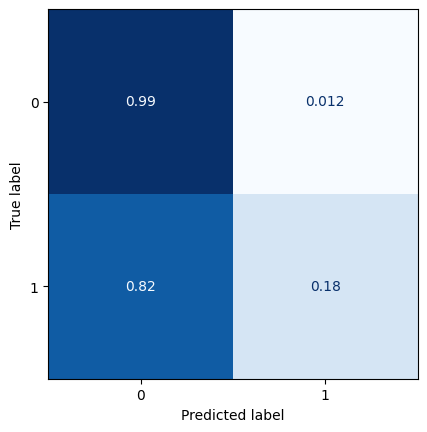

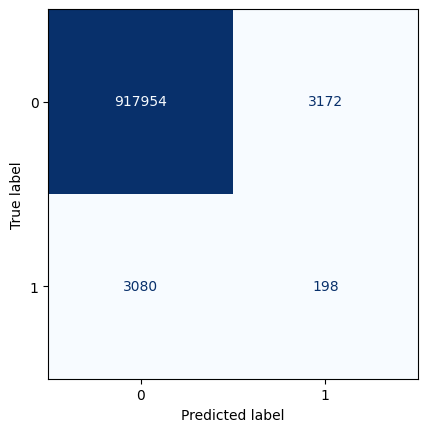

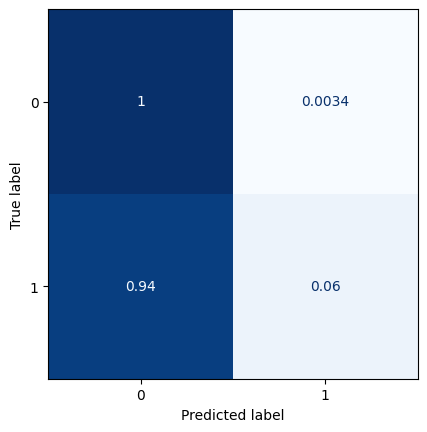

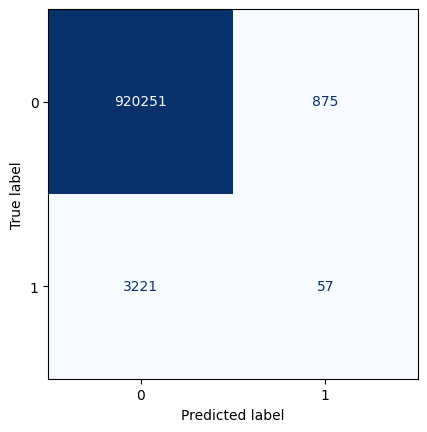

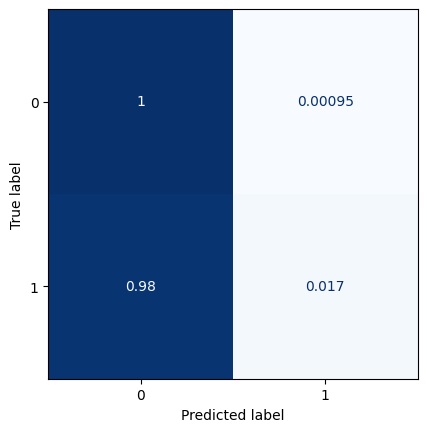

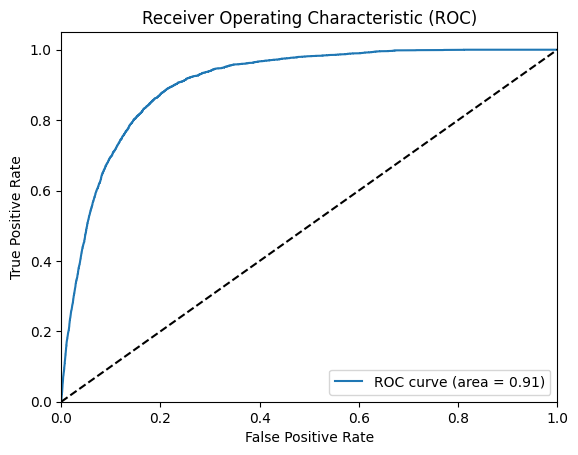

All zeros Brier score: 0.0035460686020398007
Model Brier score: 0.00347613239106102
77/77 [==============================] - 2s 21ms/step


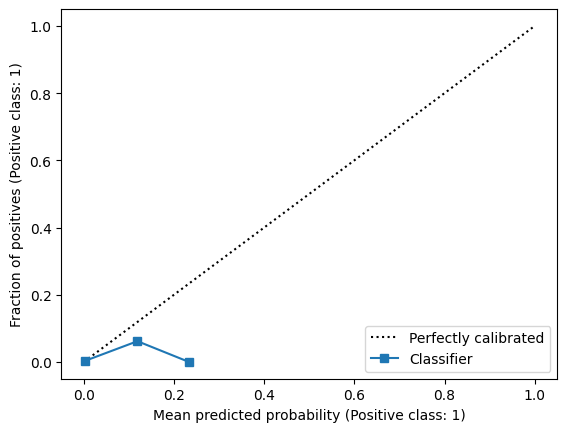

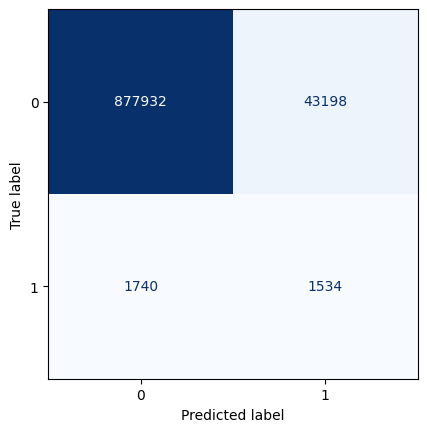

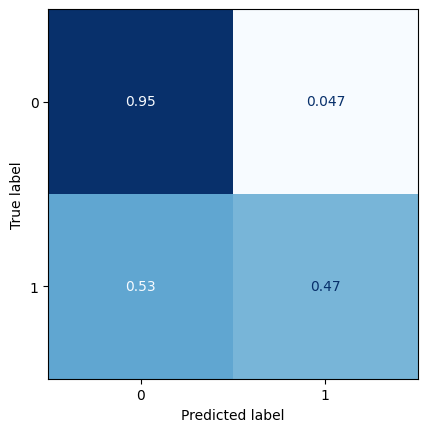

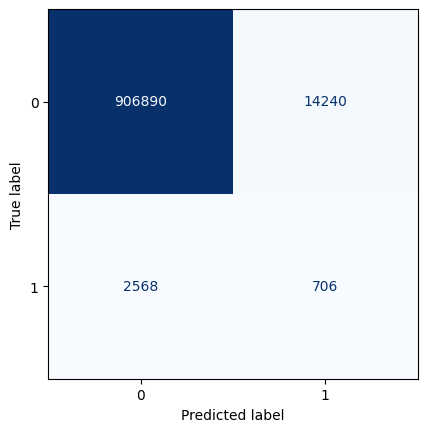

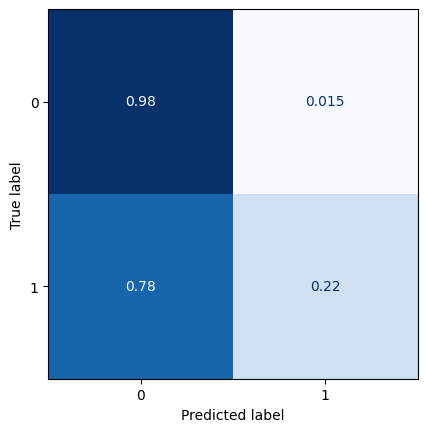

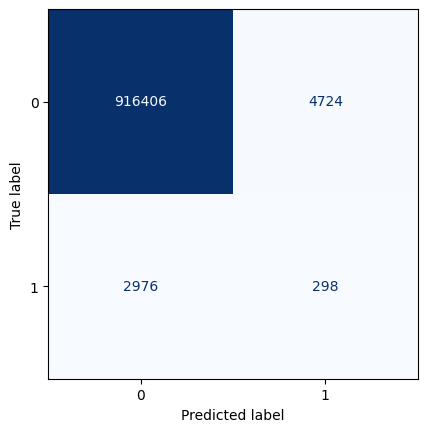

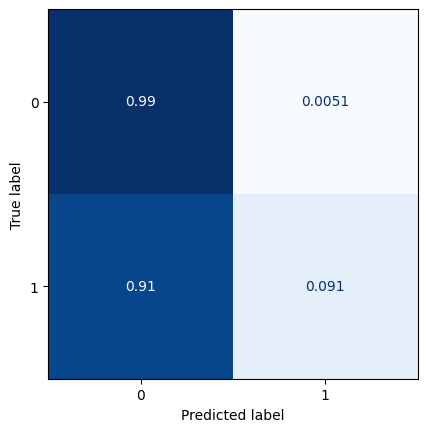

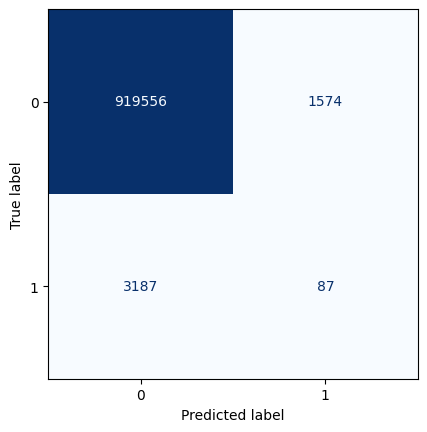

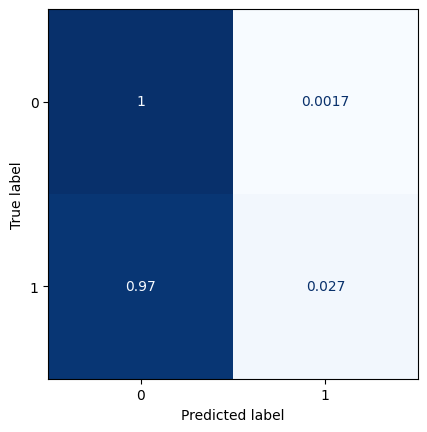

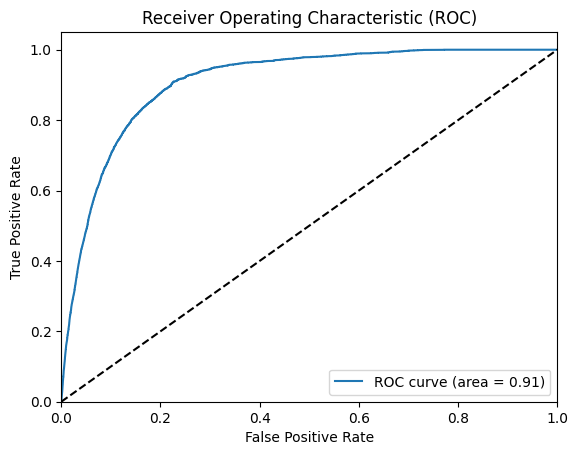

All zeros Brier score: 0.003541741489651711
Model Brier score: 0.003476685662919874
77/77 [==============================] - 2s 20ms/step


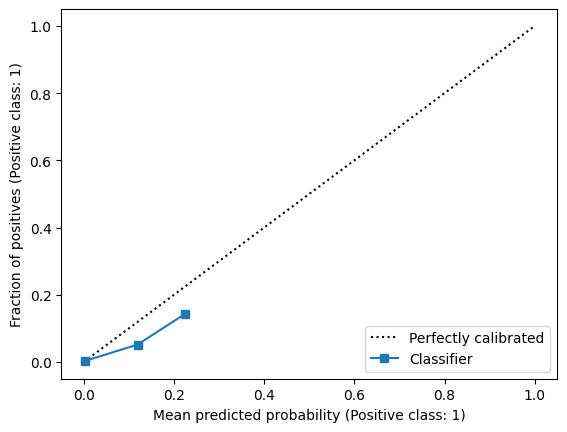

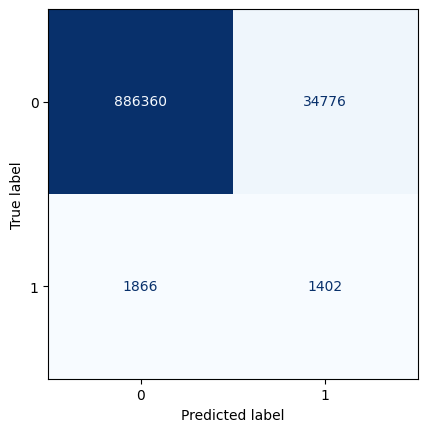

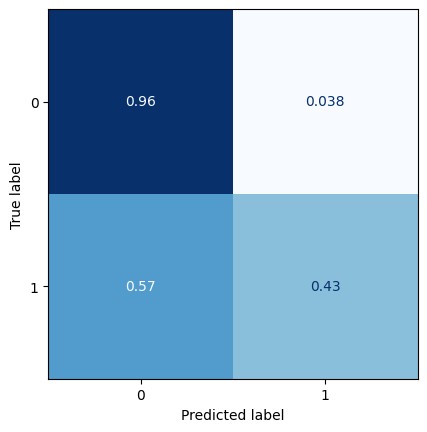

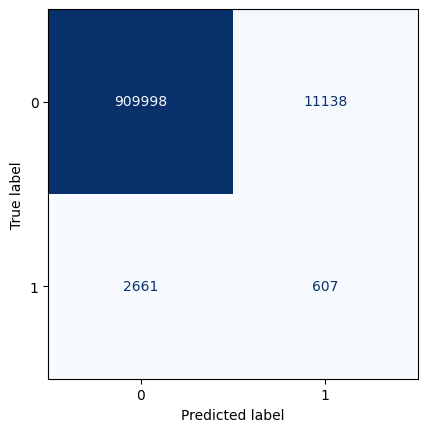

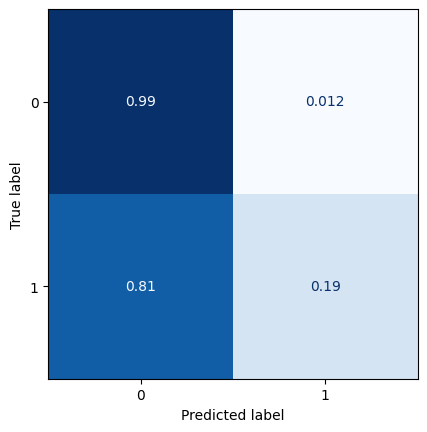

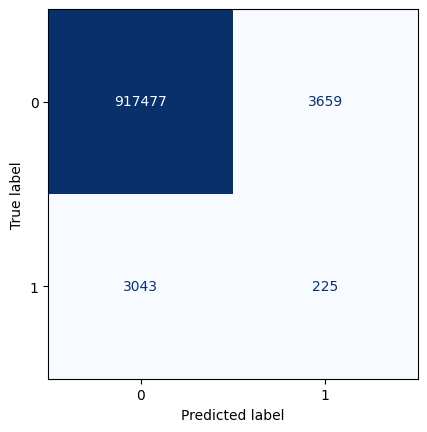

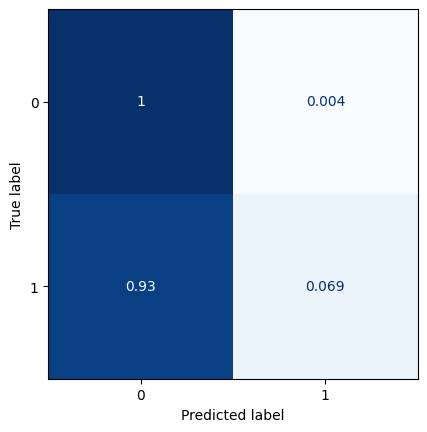

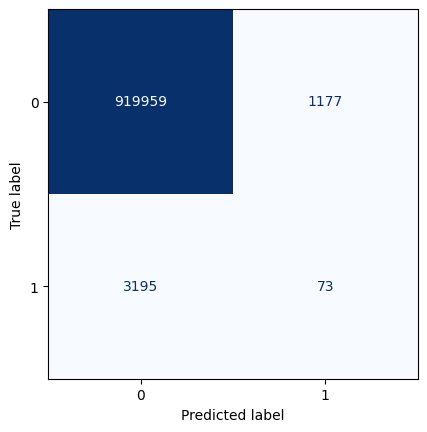

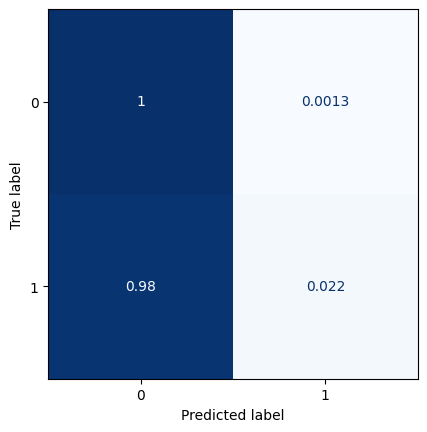

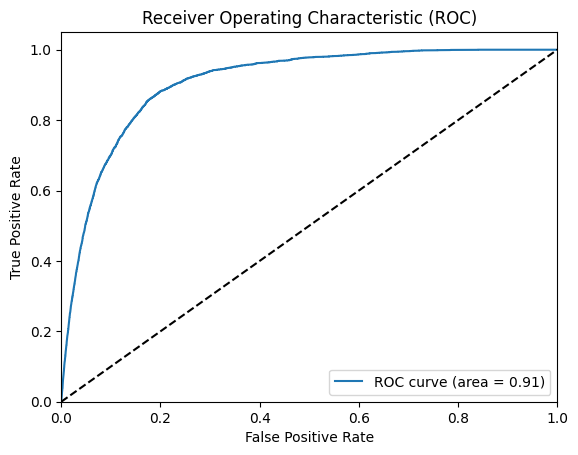

All zeros Brier score: 0.003535250821069576
Model Brier score: 0.0034615310263438124
77/77 [==============================] - 2s 21ms/step


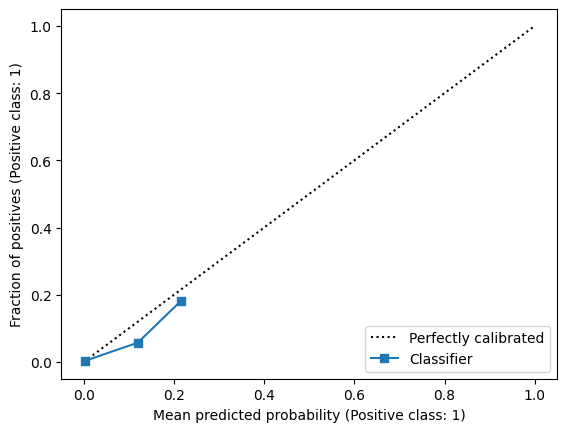

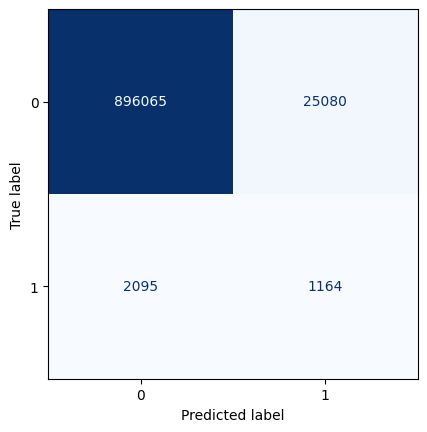

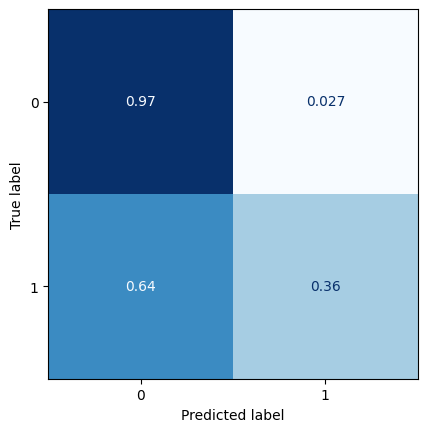

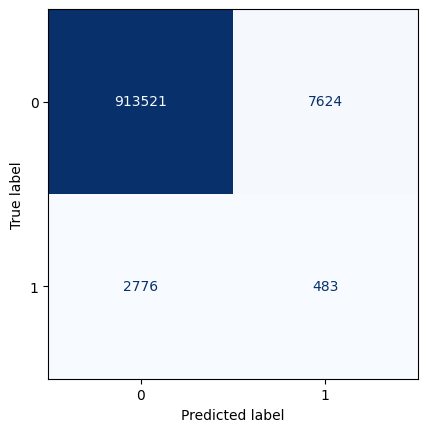

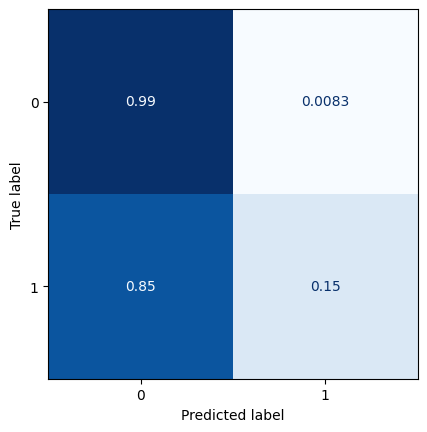

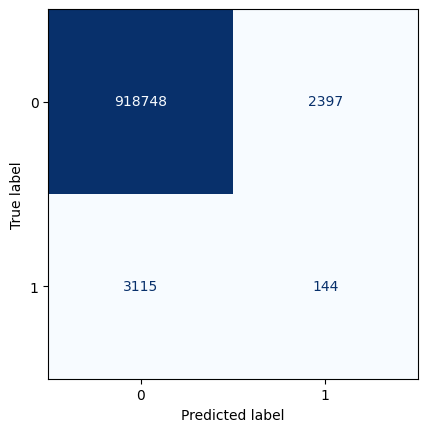

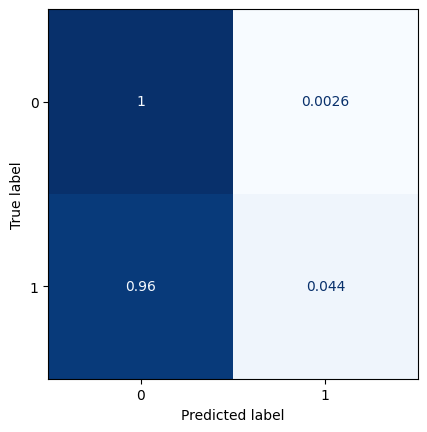

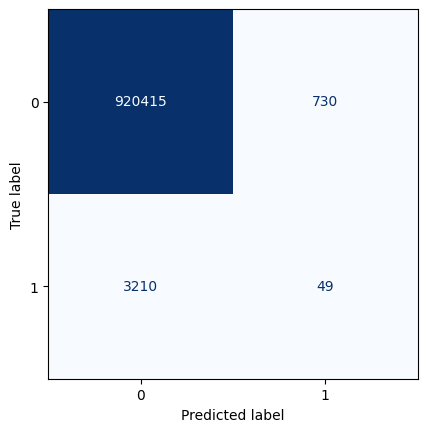

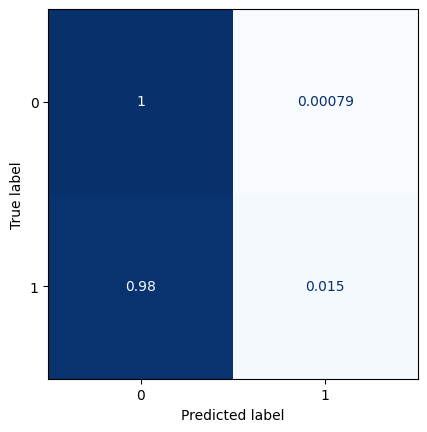

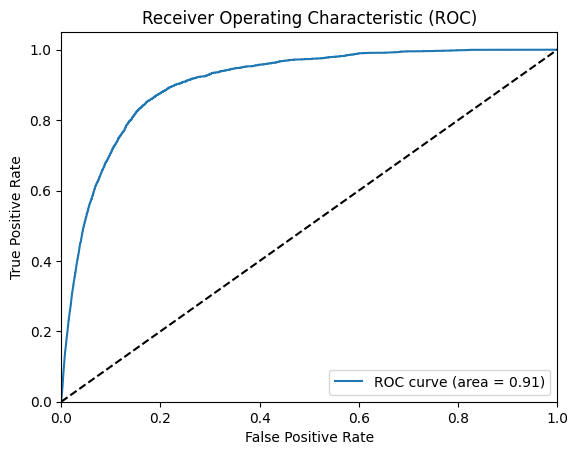

All zeros Brier score: 0.003525514818196373
Model Brier score: 0.003446107001387304
77/77 [==============================] - 2s 21ms/step


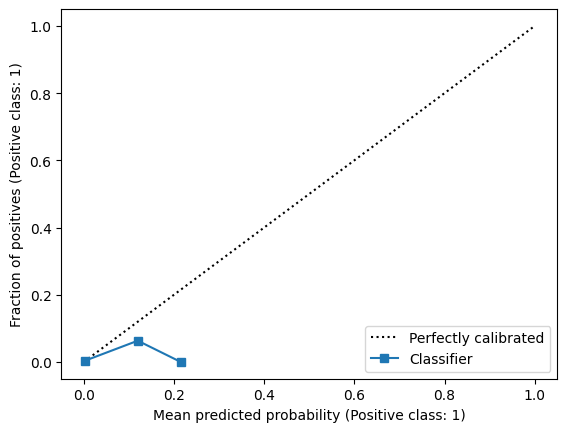

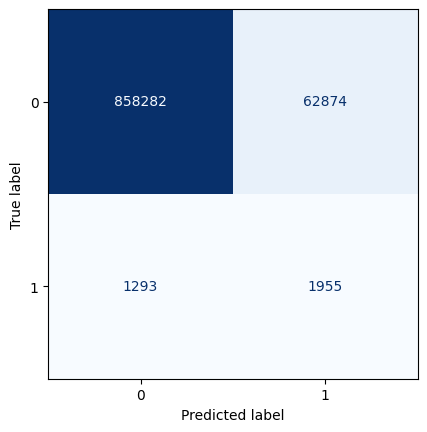

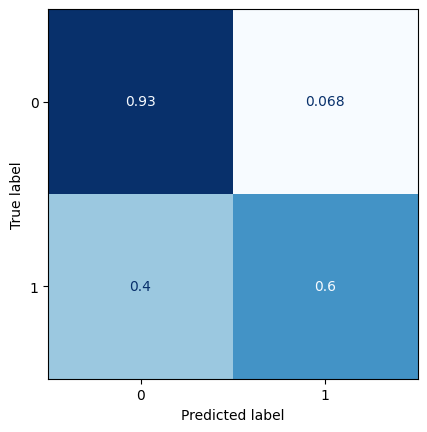

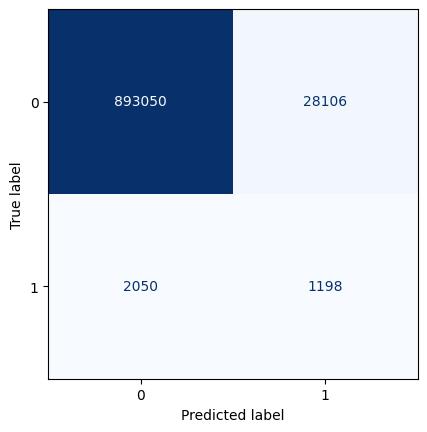

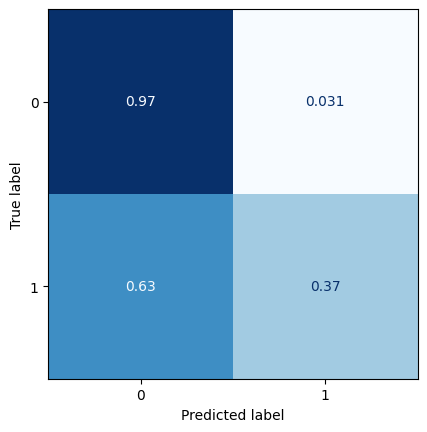

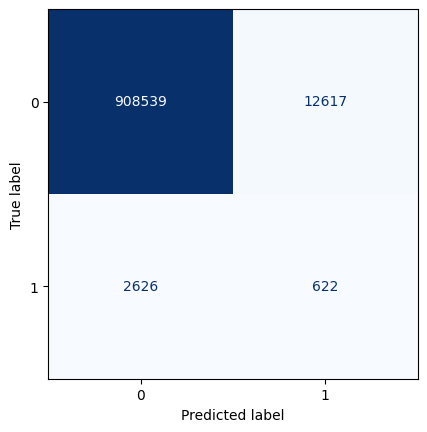

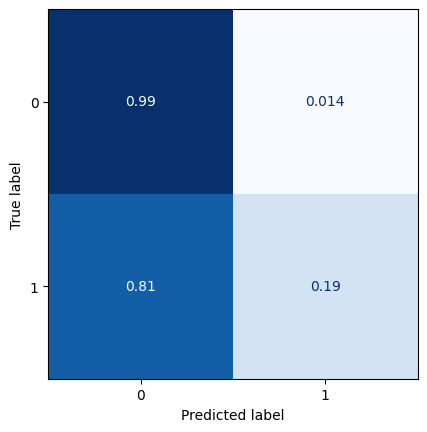

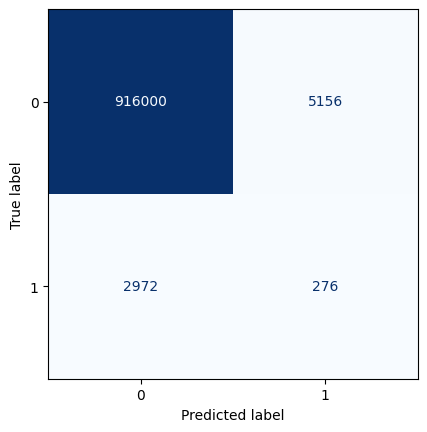

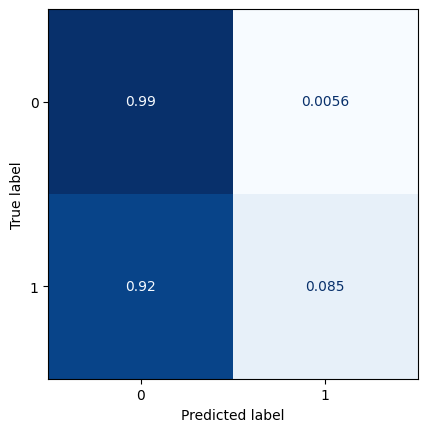

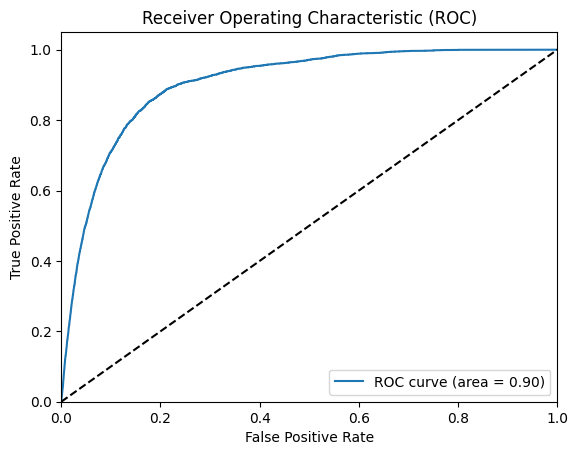

All zeros Brier score: 0.003513615259129125
Model Brier score: 0.0035038746210800304
Model: "model_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_25 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_39 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_24 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 00:32:17.812548: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.1487

2023-04-09 00:33:19.800082: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 67s 1s/step - loss: 0.1487 - val_loss: 0.0414 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 60s 1s/step - loss: 0.0380 - val_loss: 0.0300 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 40s 875ms/step - loss: 0.0307 - val_loss: 0.0266 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 47s 1s/step - loss: 0.0278 - val_loss: 0.0250 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 37s 816ms/step - loss: 0.0261 - val_loss: 0.0240 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 33s 739ms/step - loss: 0.0251 - val_loss: 0.0232 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 34s 748ms/step - loss: 0.0244 - val_loss: 0.0227 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 33s 719ms/step - loss: 0.0238 - val_loss: 0.0223 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 32s 697ms/step - loss: 0.0234 - val_loss: 0.0219

2023-04-09 01:04:09.133752: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 4s 28ms/step


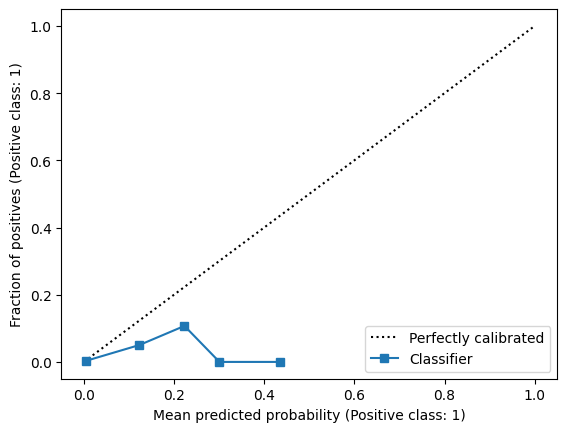

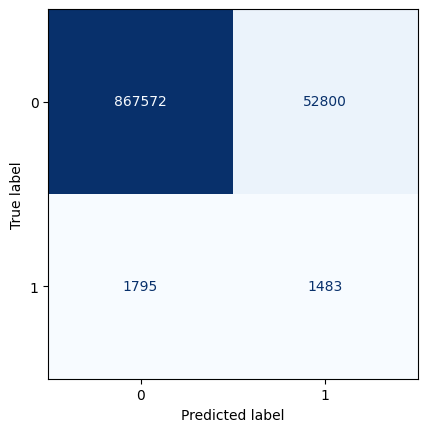

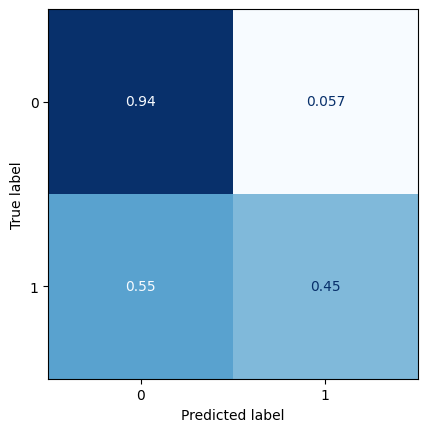

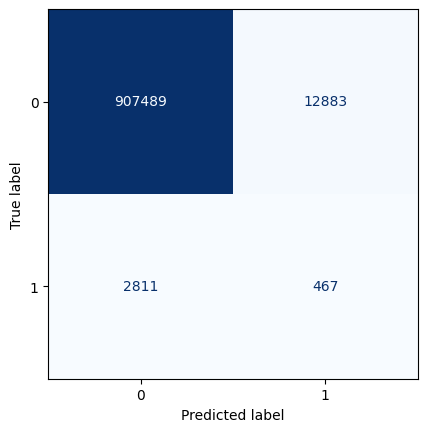

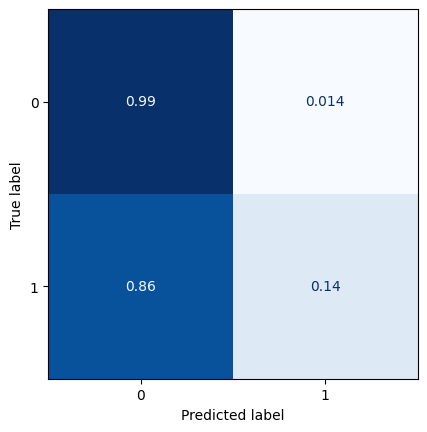

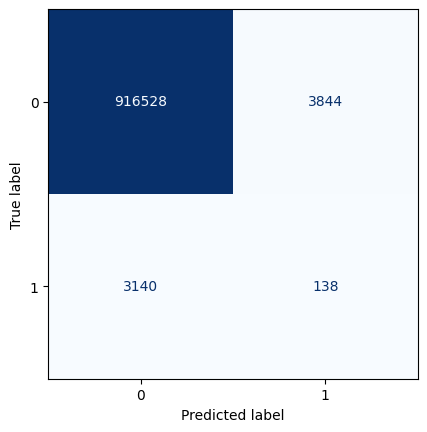

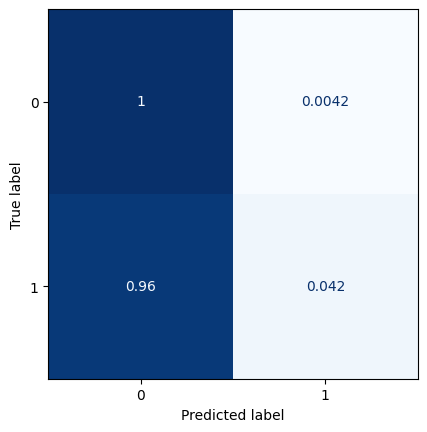

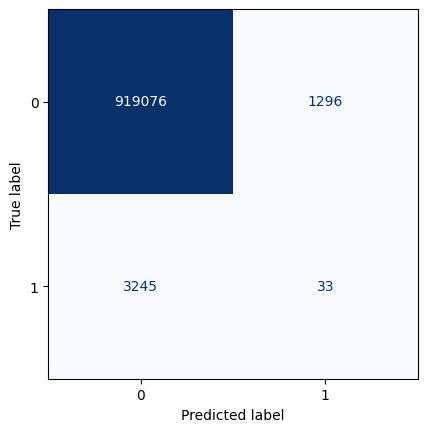

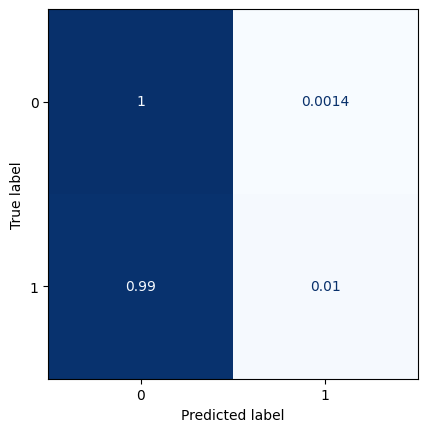

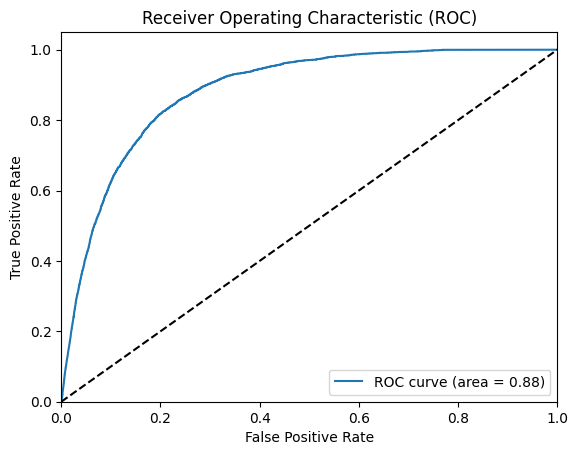

All zeros Brier score: 0.003548963351919017
Model Brier score: 0.003522220540297916
77/77 [==============================] - 2s 26ms/step


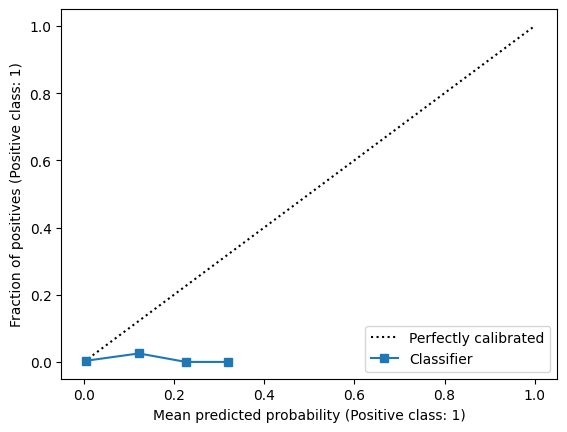

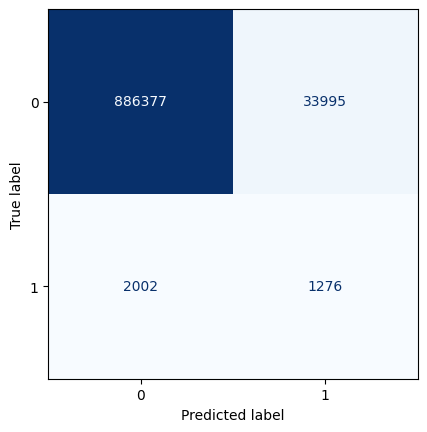

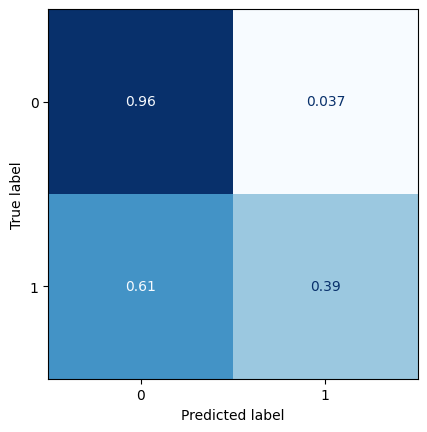

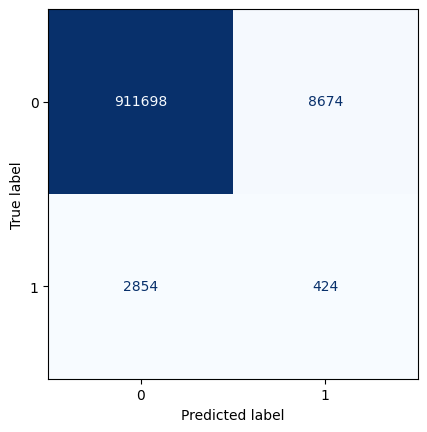

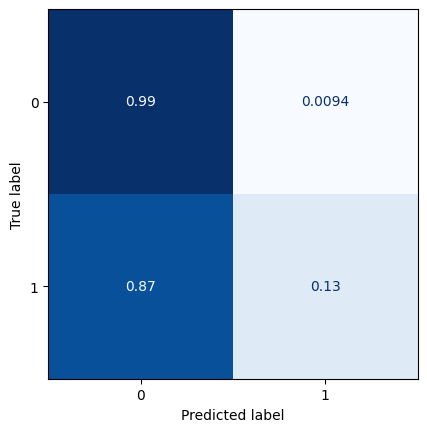

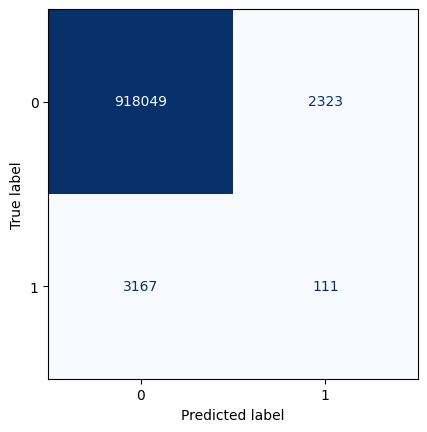

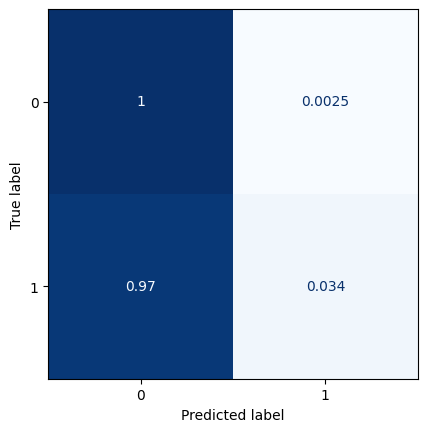

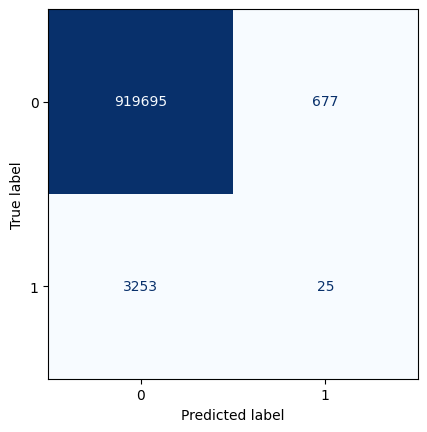

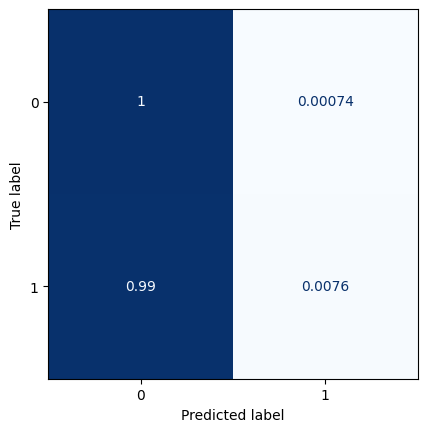

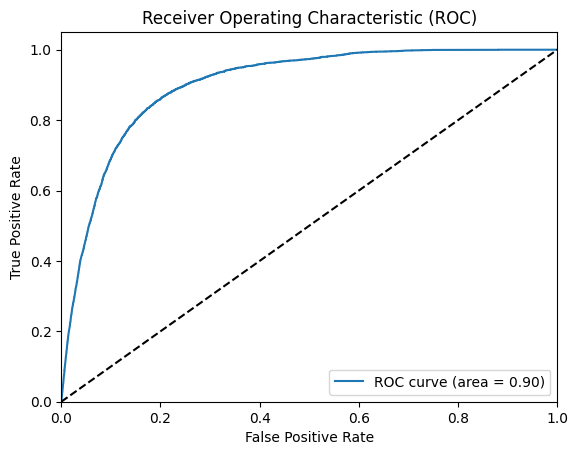

All zeros Brier score: 0.003548963351919017
Model Brier score: 0.0034845230069331084
77/77 [==============================] - 2s 25ms/step


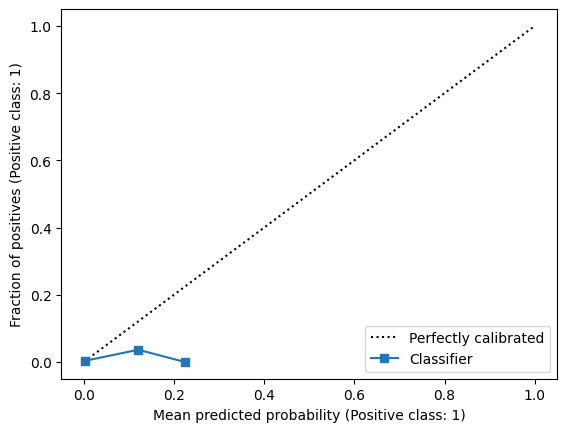

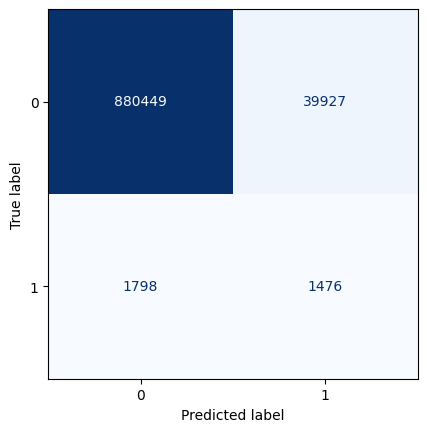

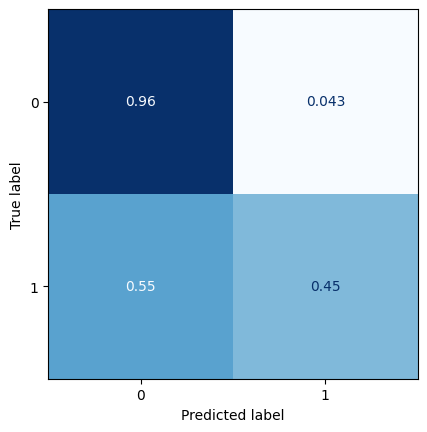

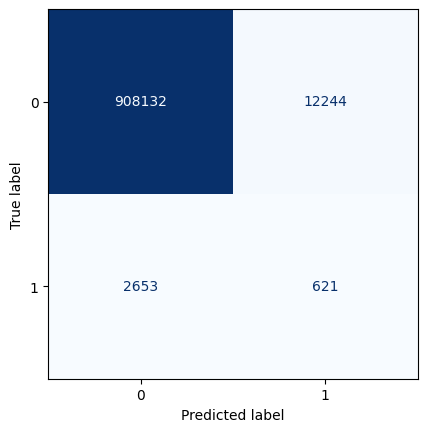

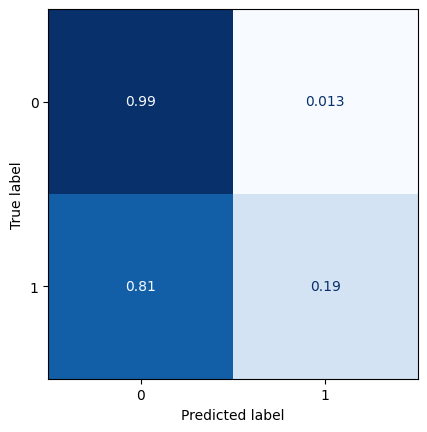

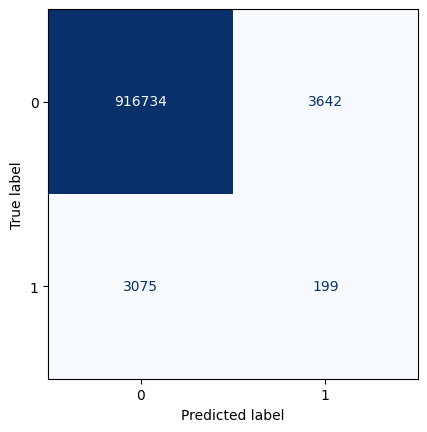

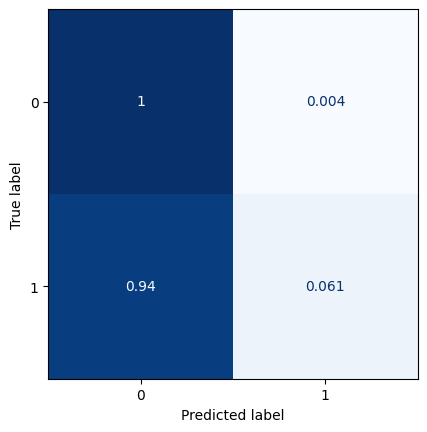

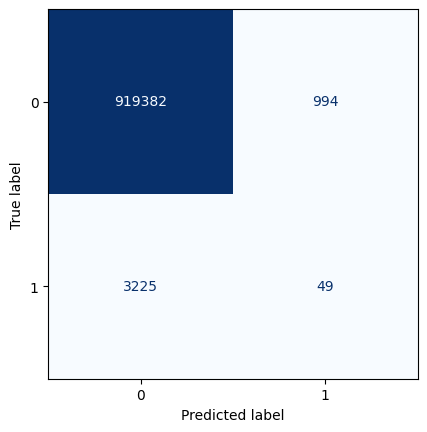

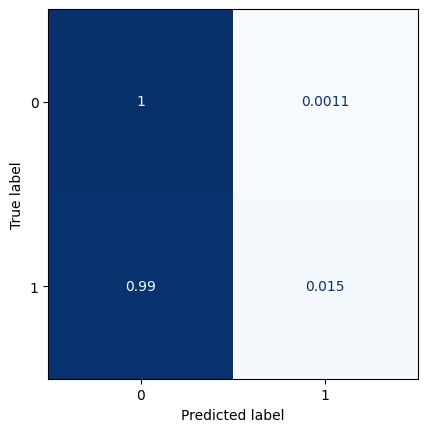

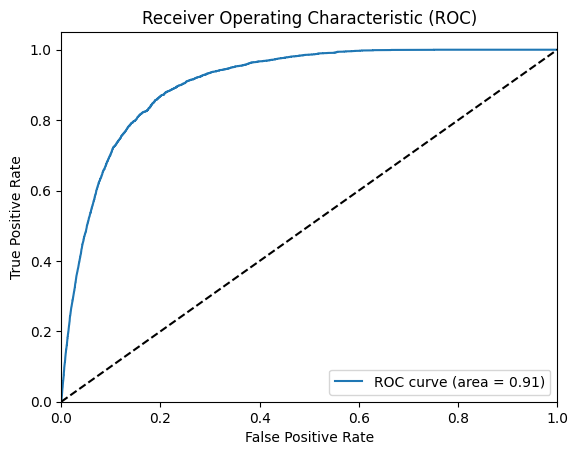

All zeros Brier score: 0.0035446327071942834
Model Brier score: 0.00347725108021286
77/77 [==============================] - 2s 26ms/step


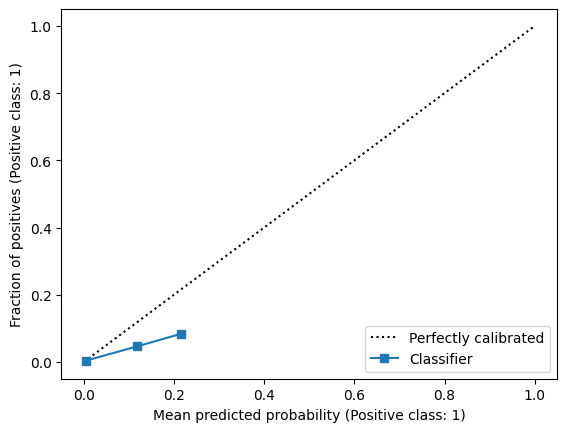

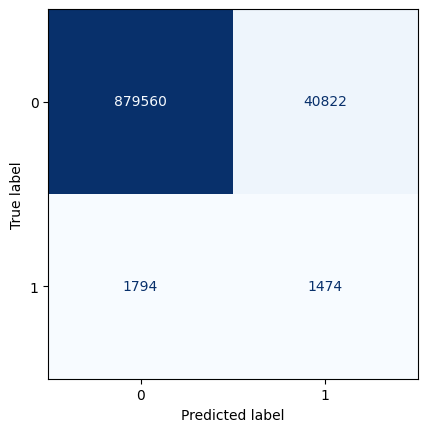

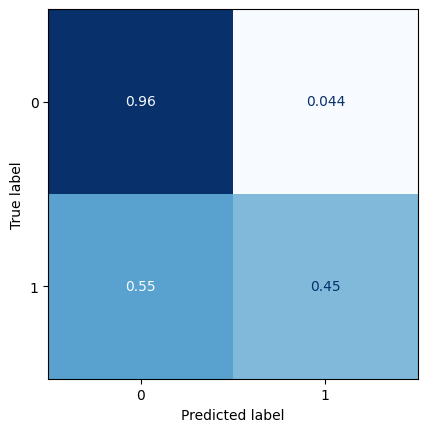

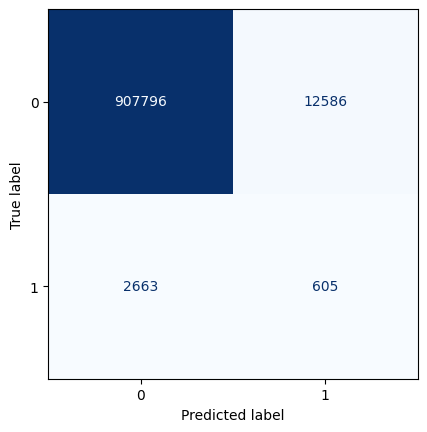

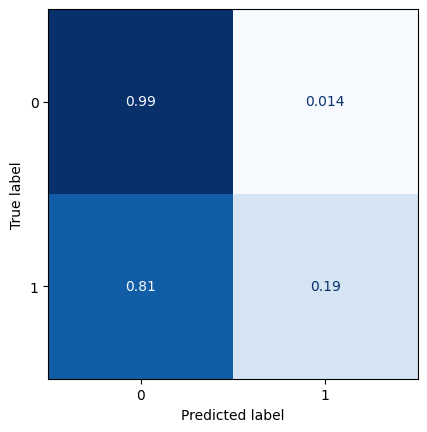

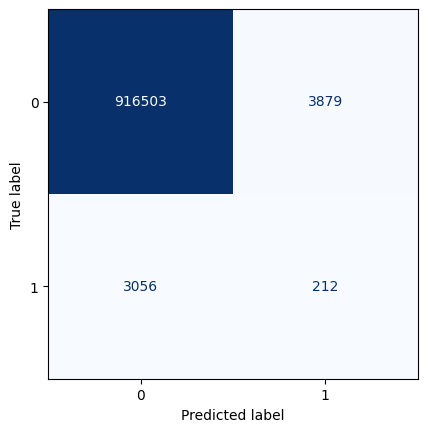

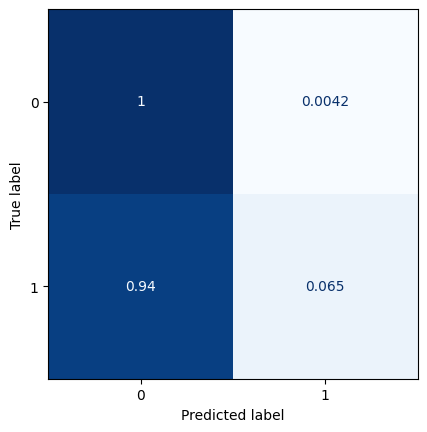

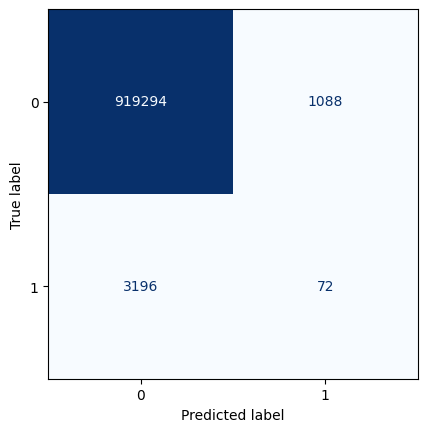

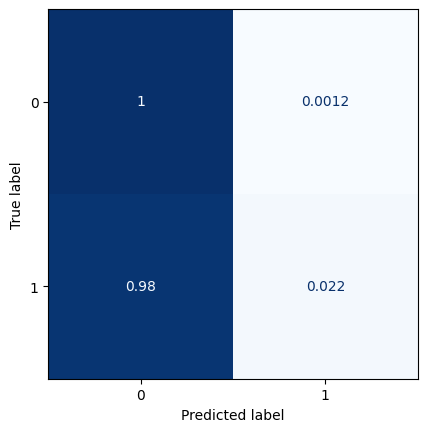

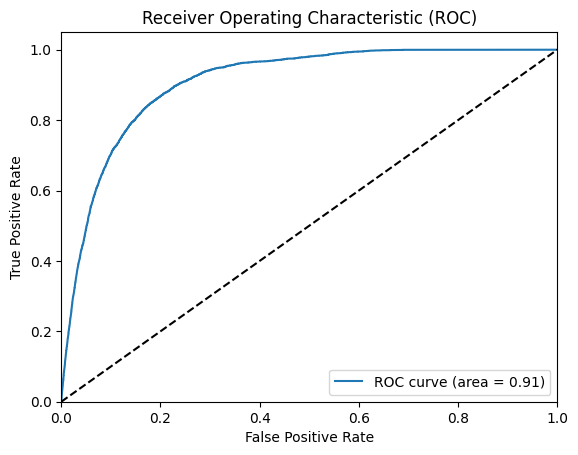

All zeros Brier score: 0.0035381367401071833
Model Brier score: 0.0034715654836780137
77/77 [==============================] - 2s 28ms/step


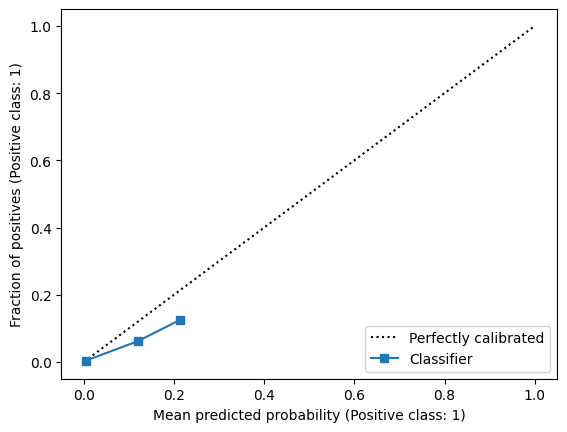

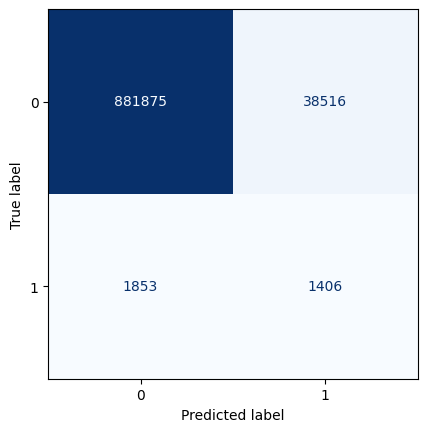

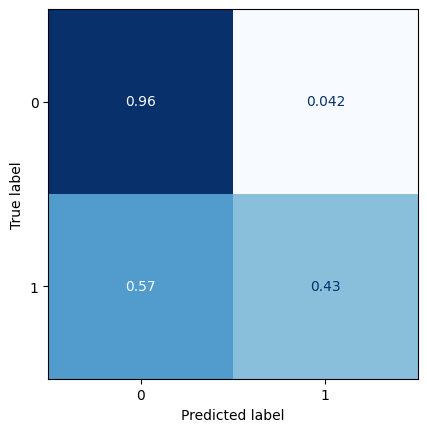

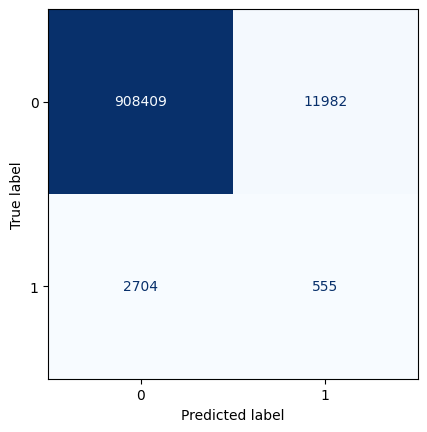

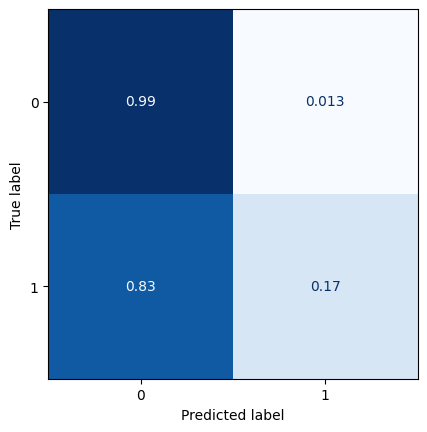

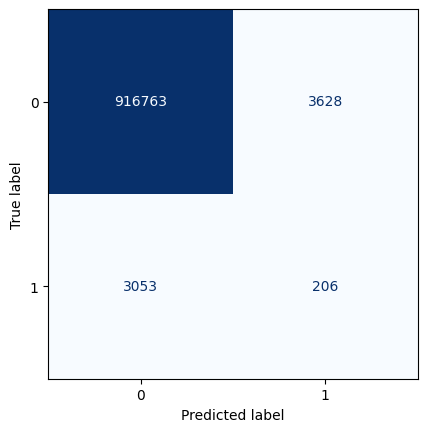

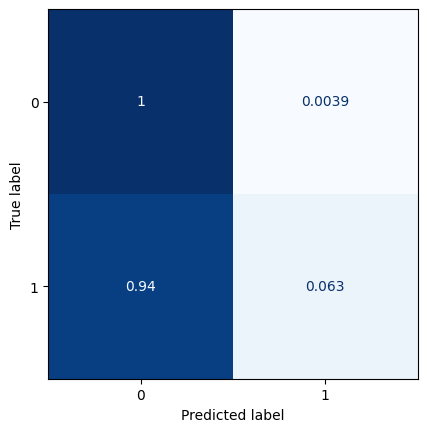

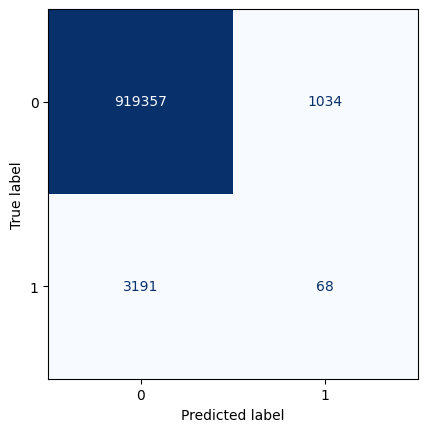

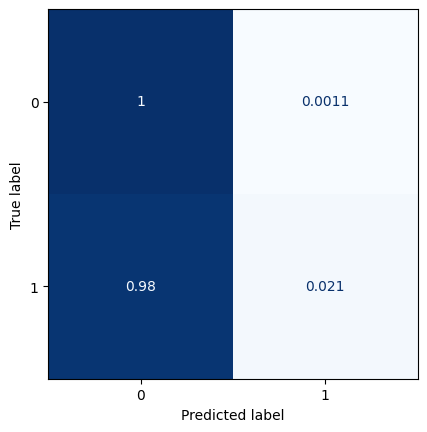

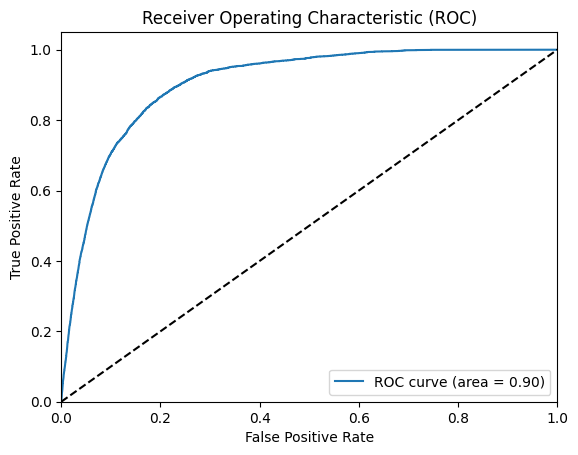

All zeros Brier score: 0.003528392789476533
Model Brier score: 0.003464404250816062
77/77 [==============================] - 2s 27ms/step


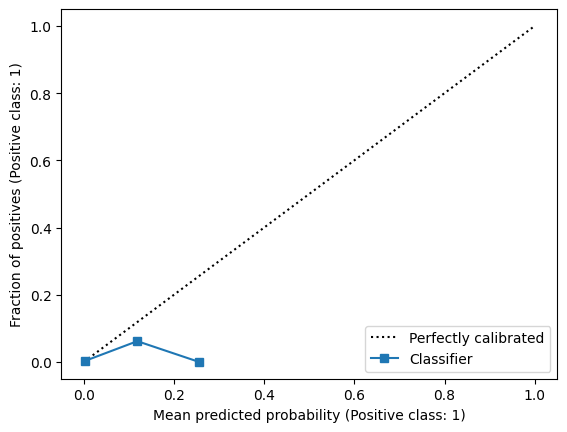

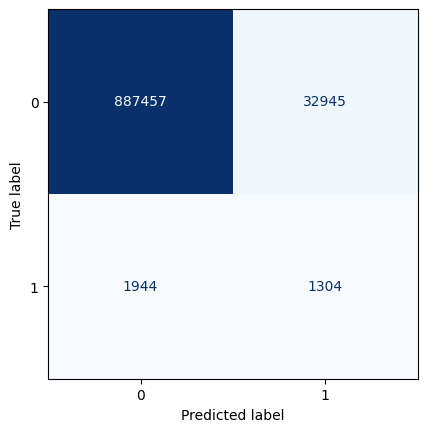

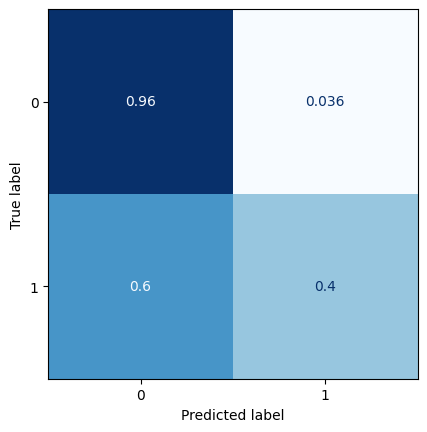

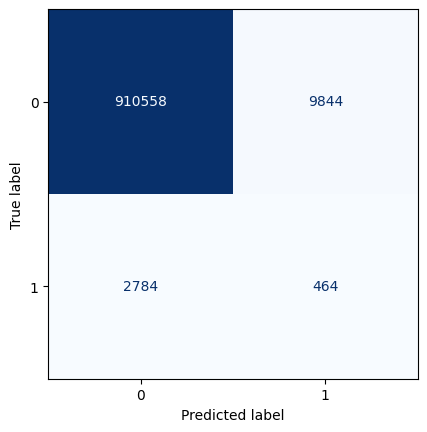

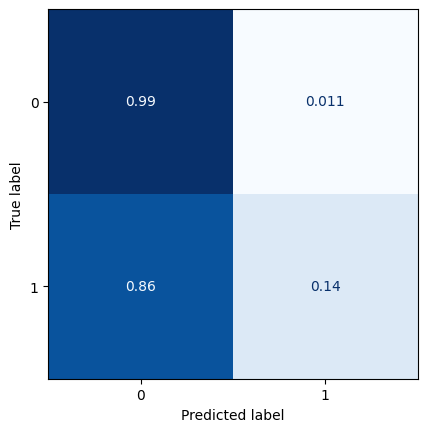

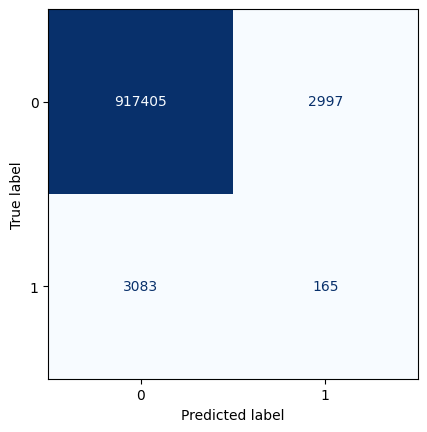

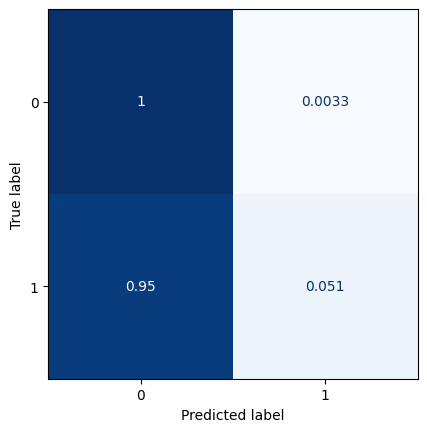

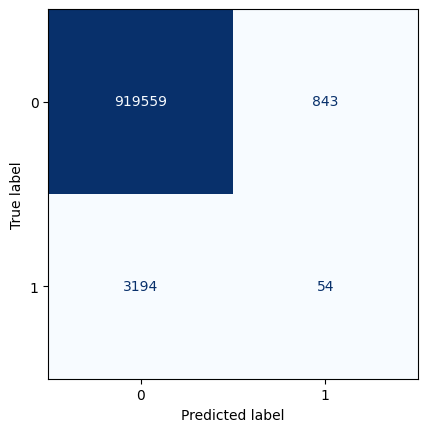

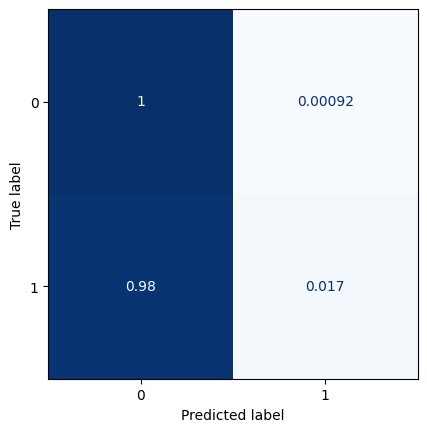

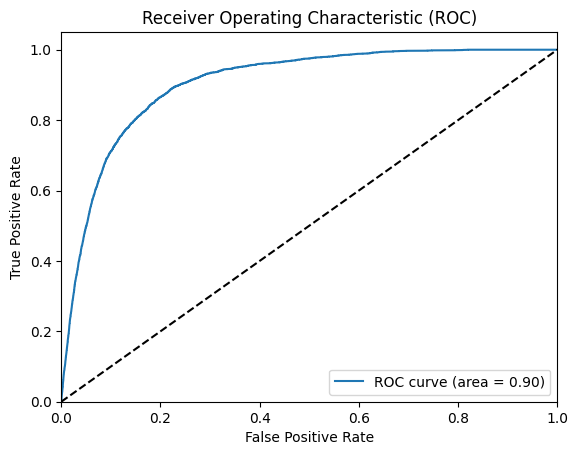

All zeros Brier score: 0.0035164835164835165
Model Brier score: 0.0034480053615869887
77/77 [==============================] - 2s 29ms/step


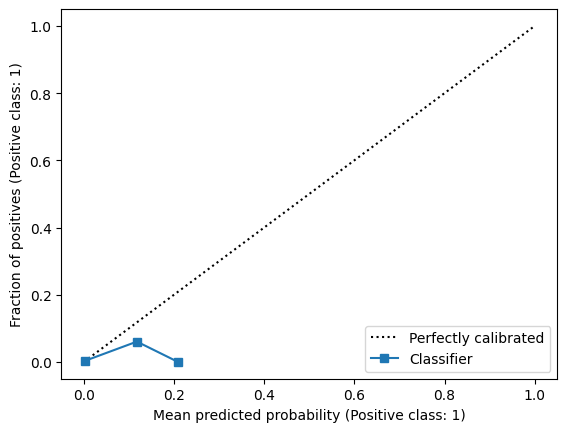

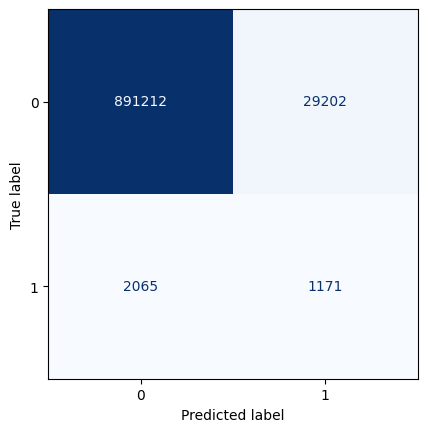

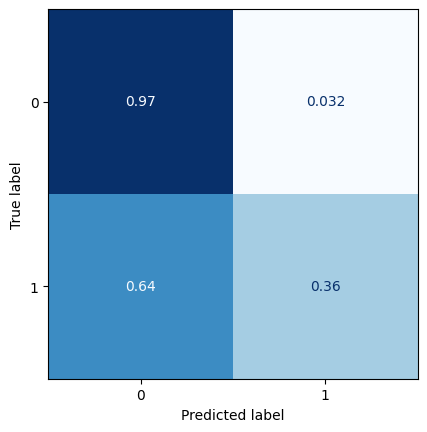

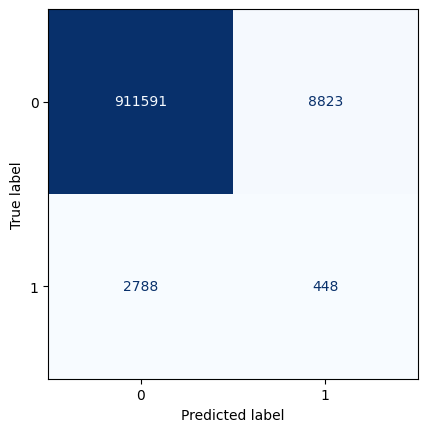

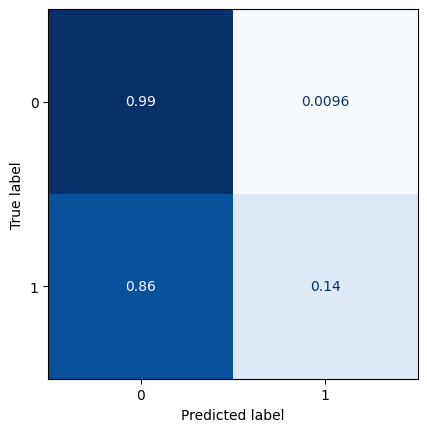

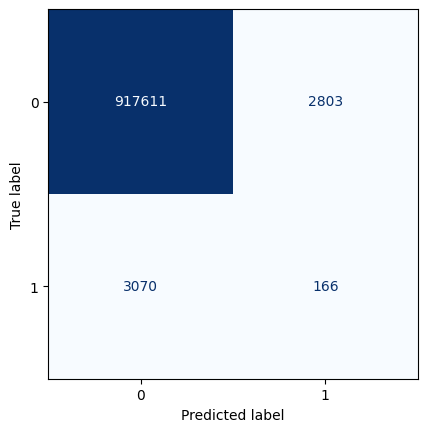

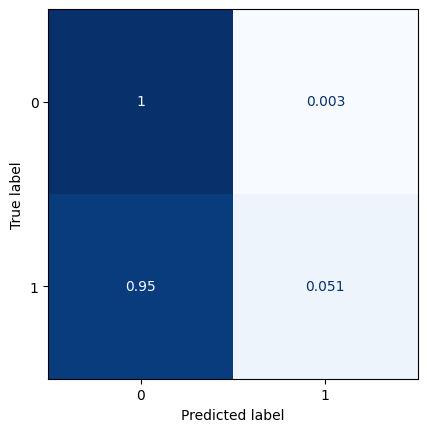

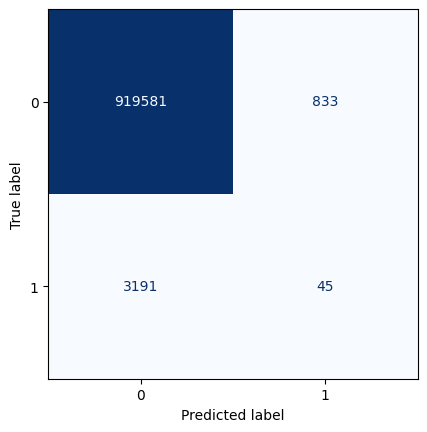

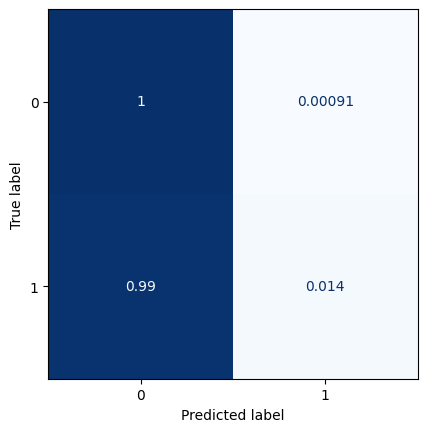

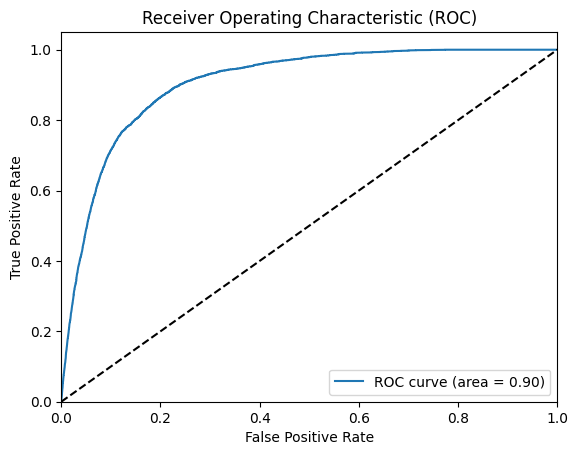

All zeros Brier score: 0.0035034915823093163
Model Brier score: 0.003436665394243146
77/77 [==============================] - 2s 25ms/step


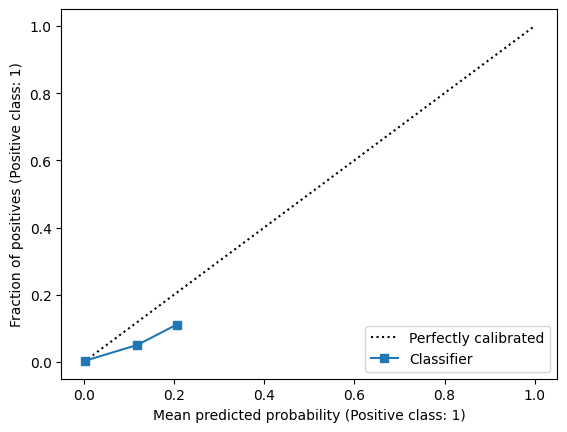

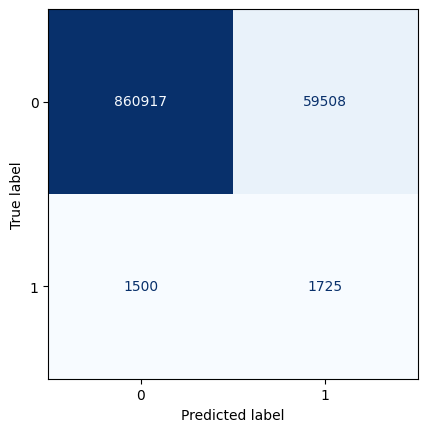

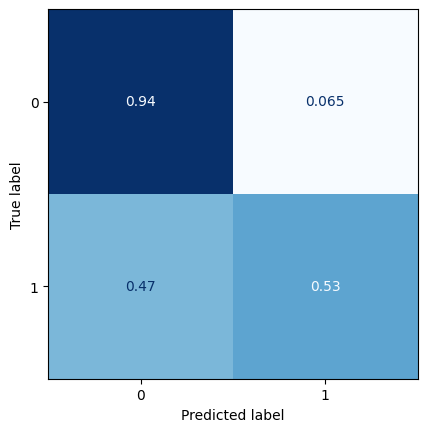

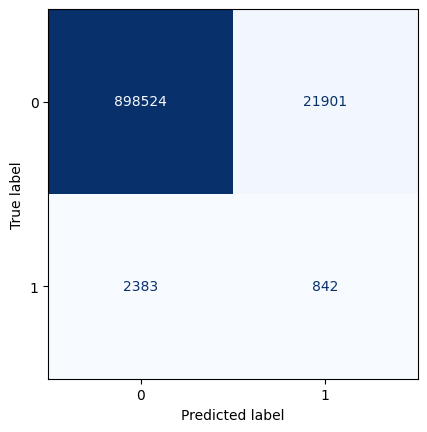

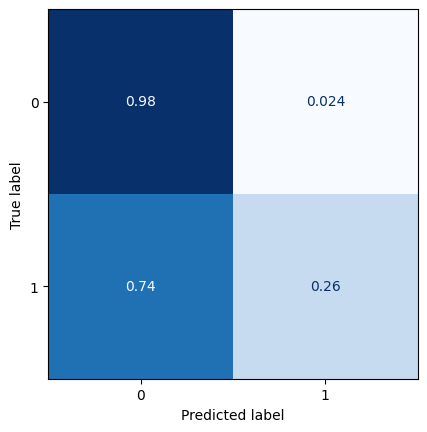

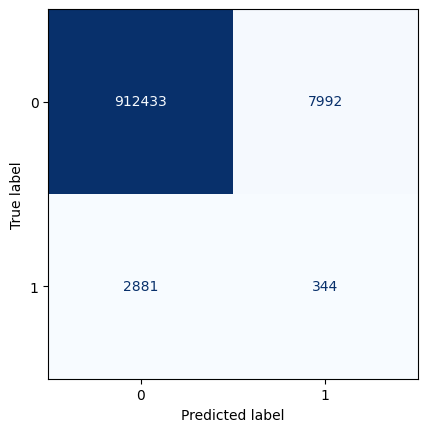

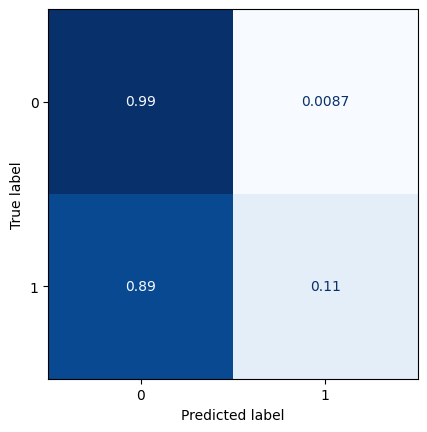

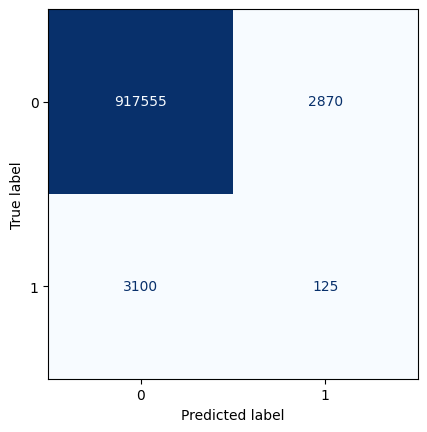

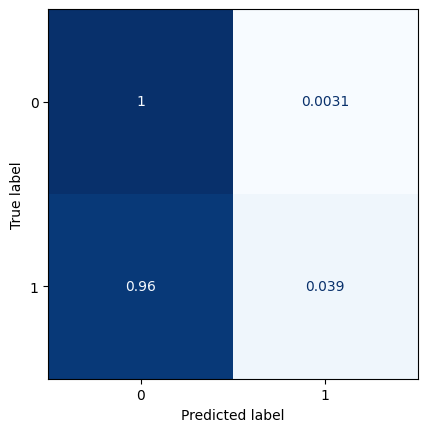

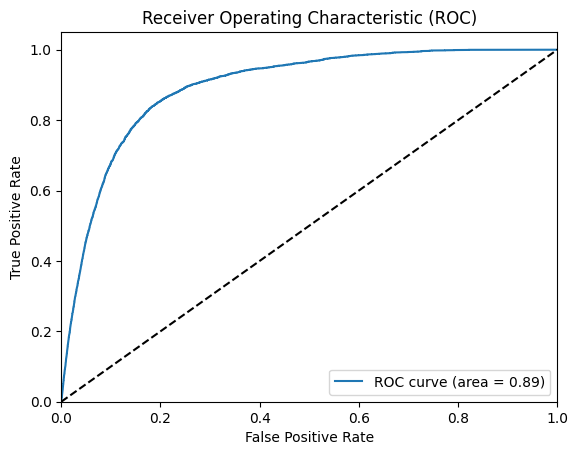

All zeros Brier score: 0.0034915823093162996
Model Brier score: 0.00347660672029188
Model: "model_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_26 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_40 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_25 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 01:06:38.988280: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.1654

2023-04-09 01:07:43.447748: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 68s 1s/step - loss: 0.1654 - val_loss: 0.0445 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 43s 951ms/step - loss: 0.0386 - val_loss: 0.0305 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 36s 806ms/step - loss: 0.0306 - val_loss: 0.0267 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 60s 1s/step - loss: 0.0276 - val_loss: 0.0249 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 60s 1s/step - loss: 0.0259 - val_loss: 0.0237 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 56s 1s/step - loss: 0.0248 - val_loss: 0.0230 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 44s 986ms/step - loss: 0.0241 - val_loss: 0.0225 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 54s 1s/step - loss: 0.0235 - val_loss: 0.0220 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 48s 1s/step - loss: 0.0231 - val_loss: 0.0218 - lr: 0.

2023-04-09 01:39:41.159312: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 4s 33ms/step


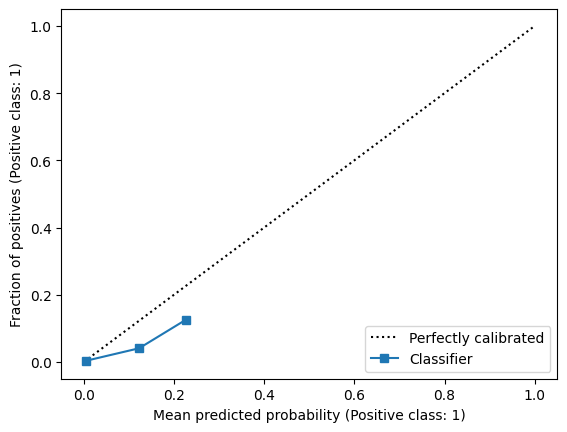

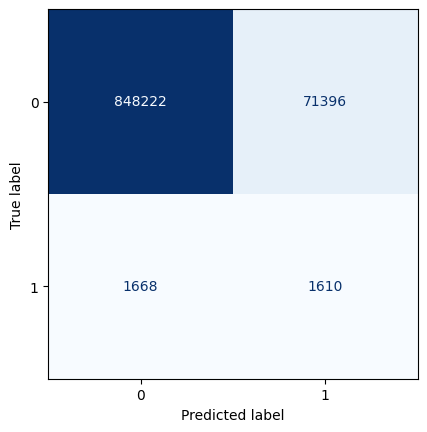

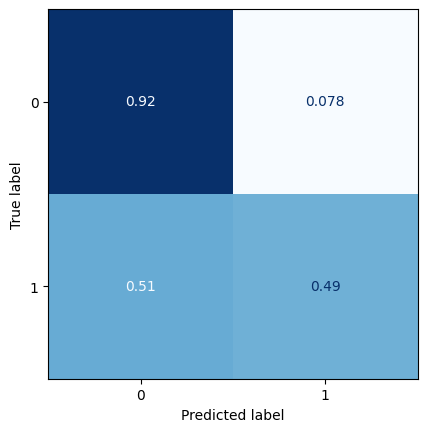

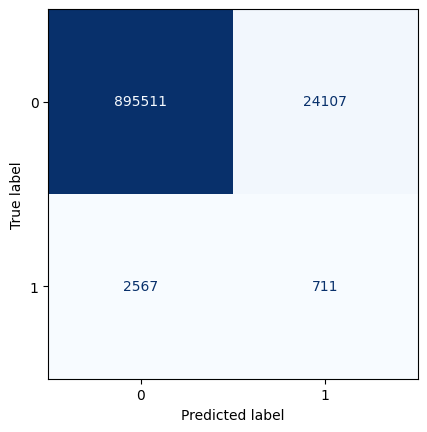

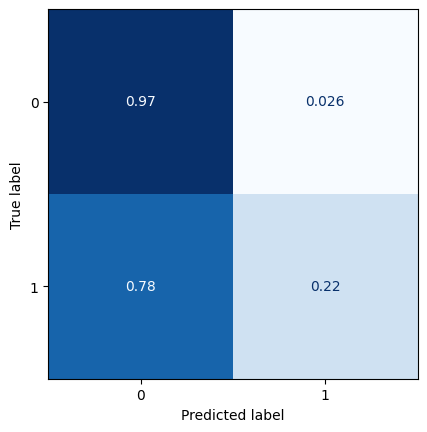

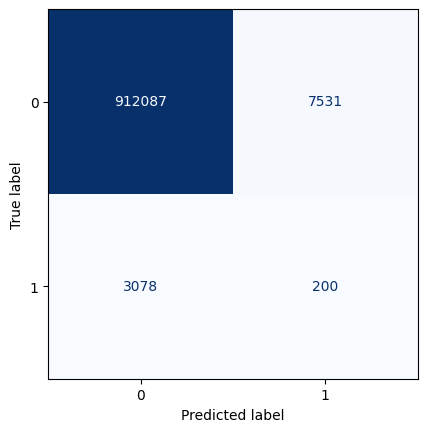

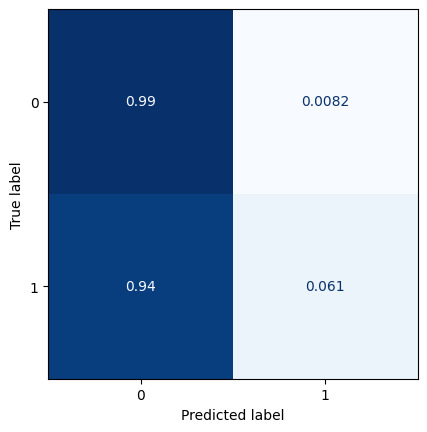

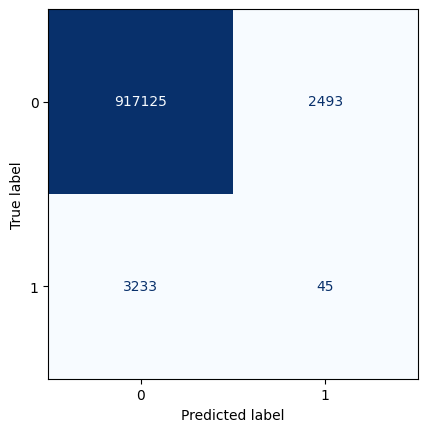

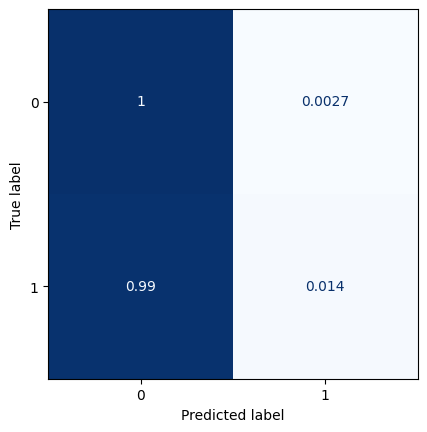

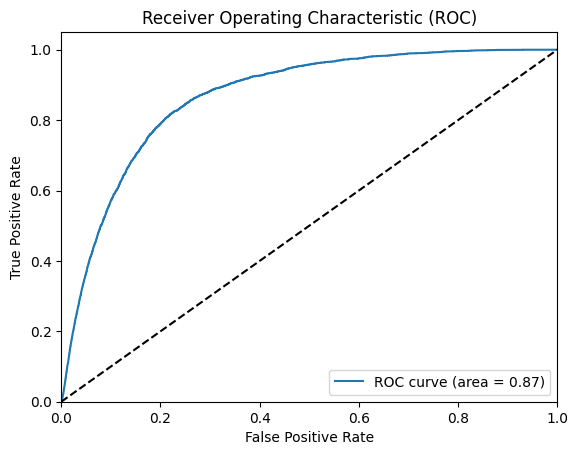

All zeros Brier score: 0.003551862831781696
Model Brier score: 0.003588224766562077
77/77 [==============================] - 2s 26ms/step


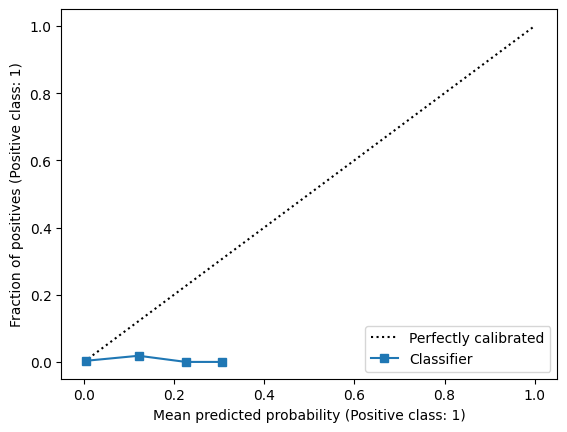

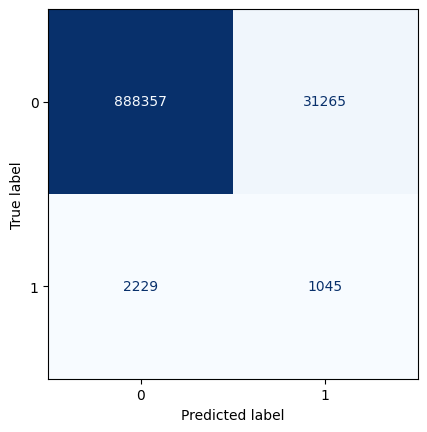

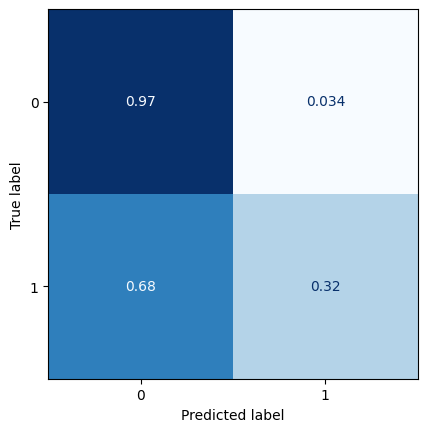

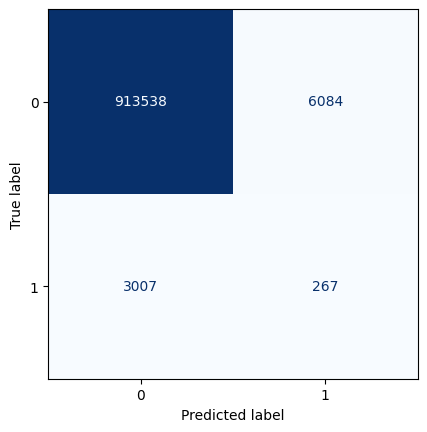

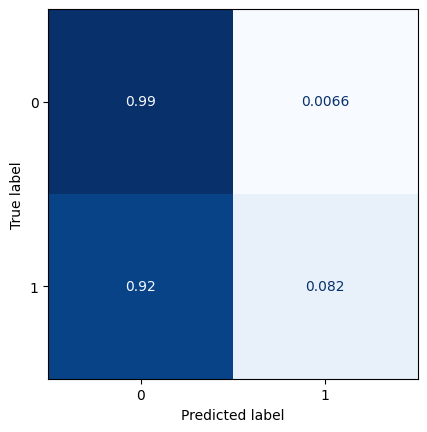

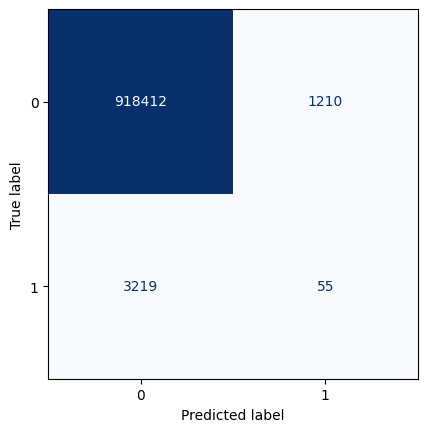

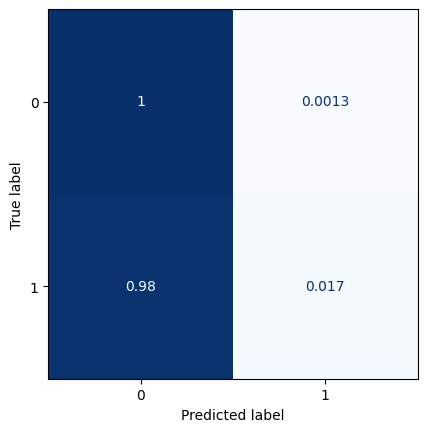

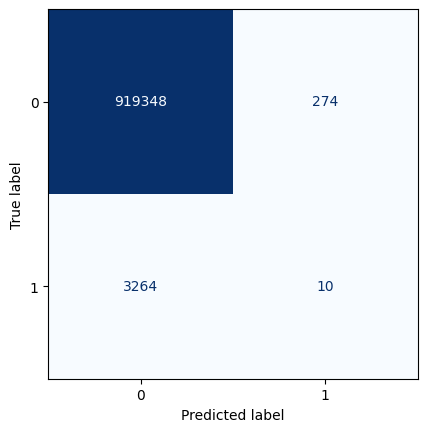

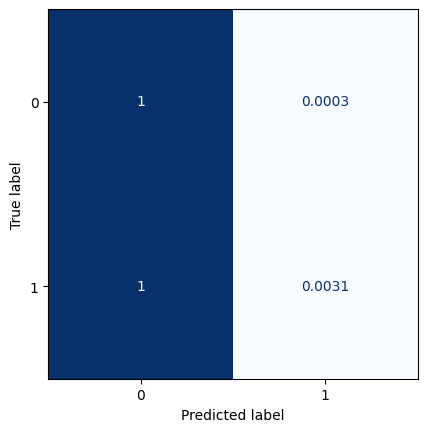

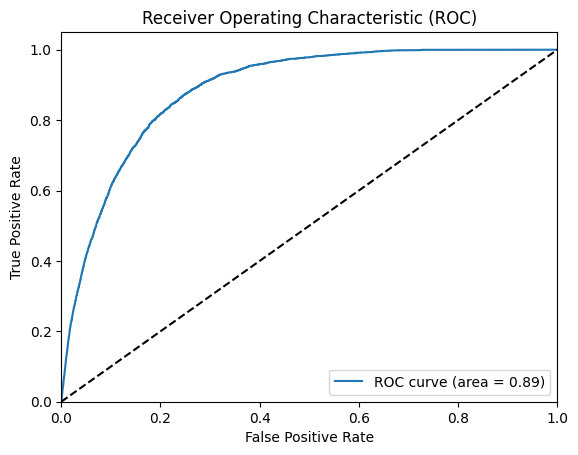

All zeros Brier score: 0.003547528648948527
Model Brier score: 0.0034913365045570782
77/77 [==============================] - 2s 26ms/step


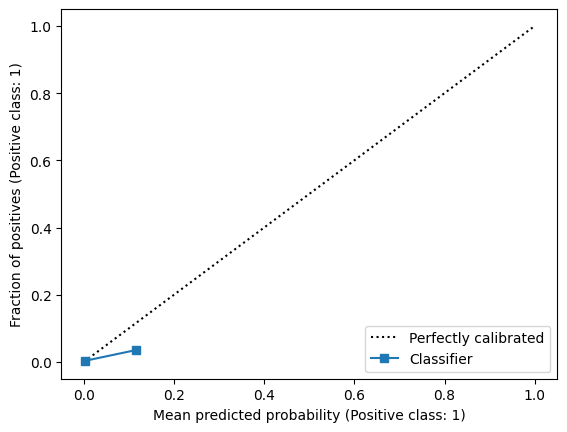

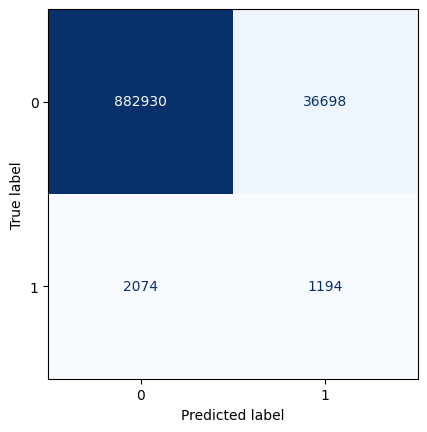

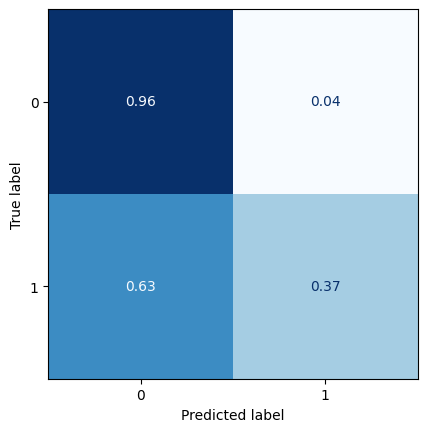

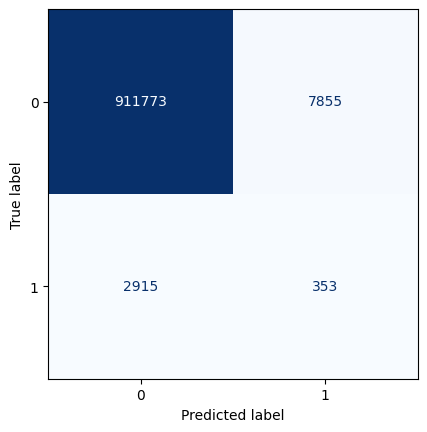

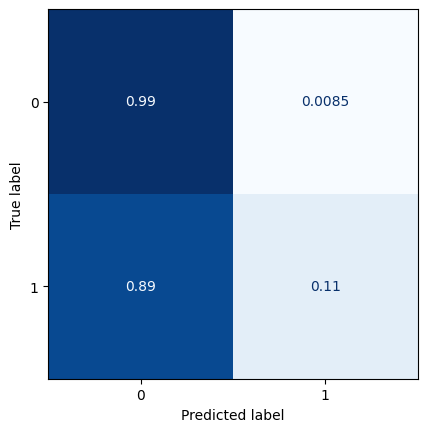

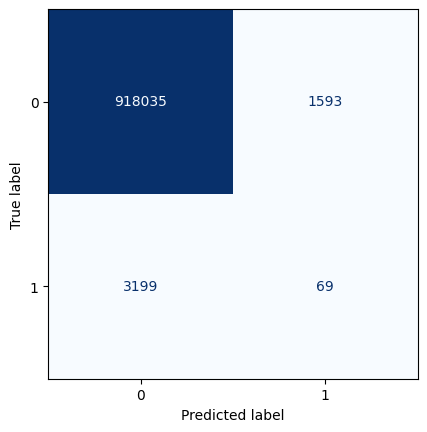

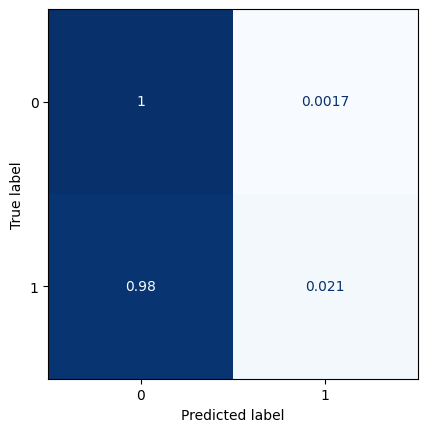

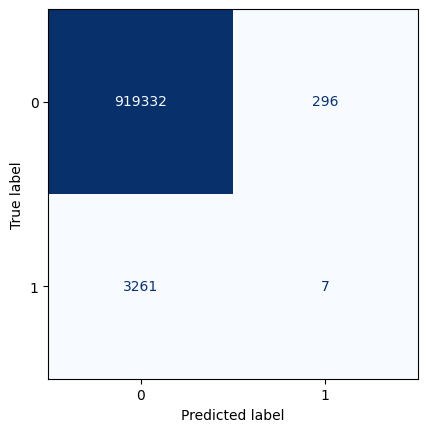

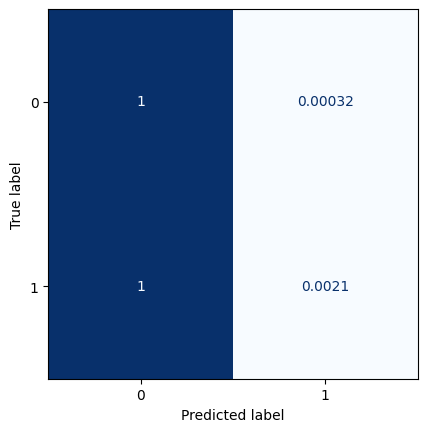

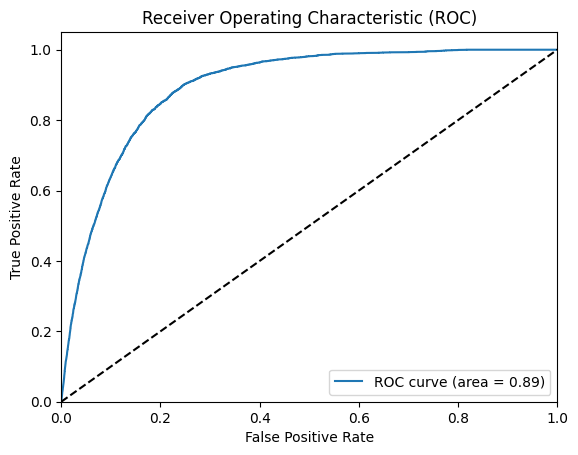

All zeros Brier score: 0.003541027374698774
Model Brier score: 0.0034844718753706725
77/77 [==============================] - 2s 26ms/step


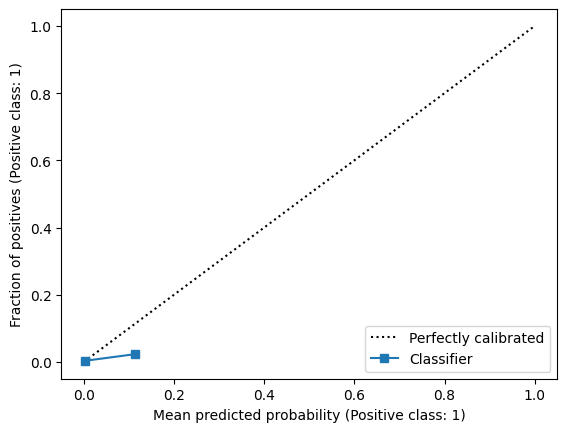

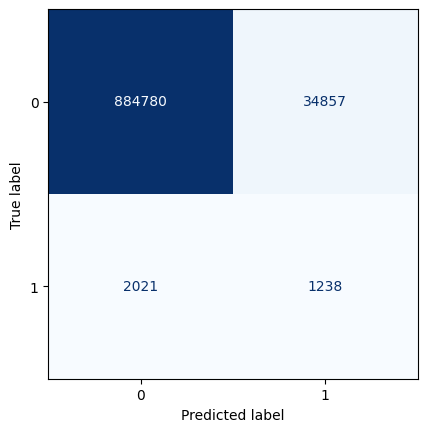

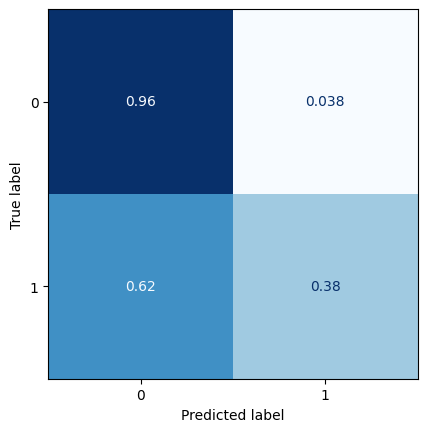

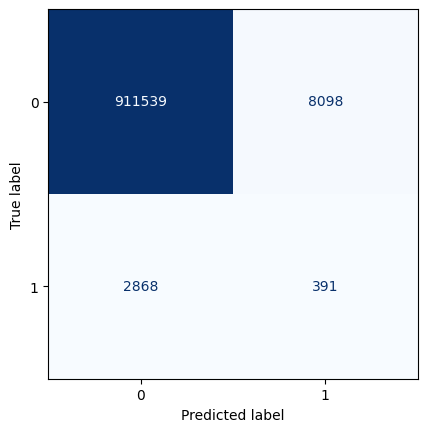

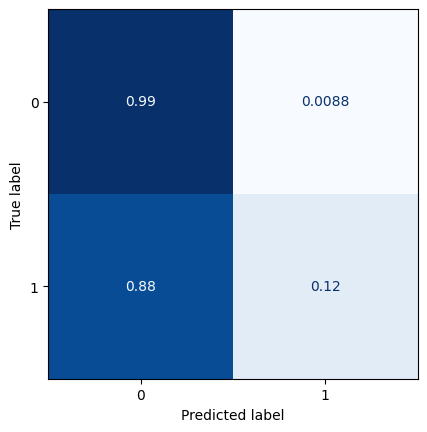

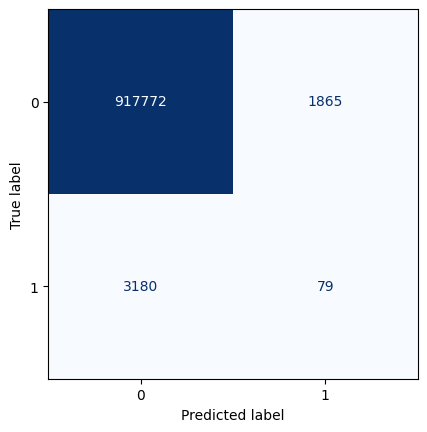

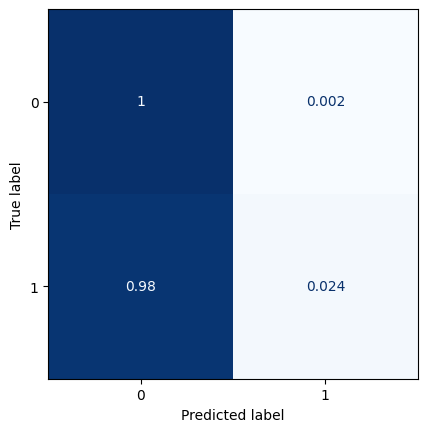

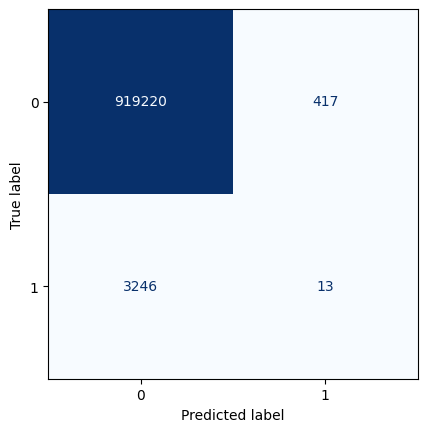

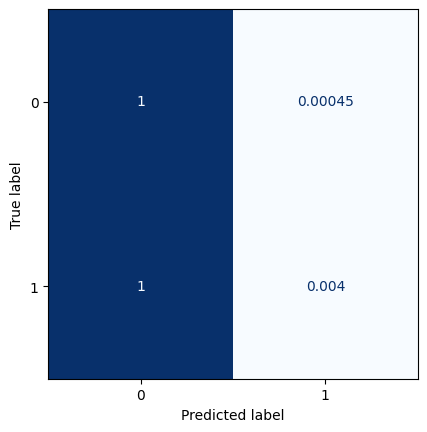

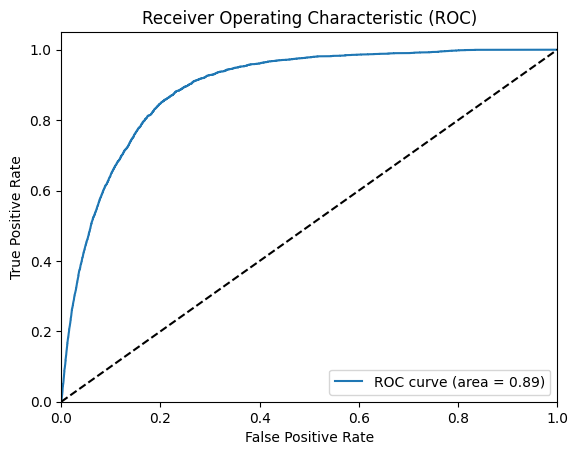

All zeros Brier score: 0.003531275463324145
Model Brier score: 0.0034700006246641494
77/77 [==============================] - 2s 31ms/step


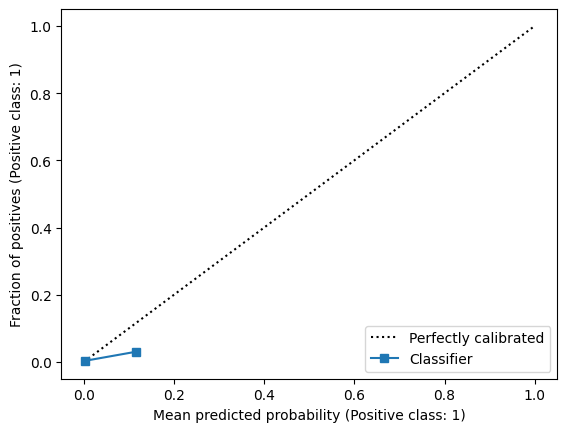

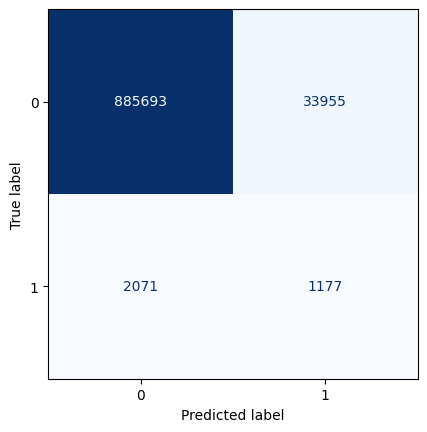

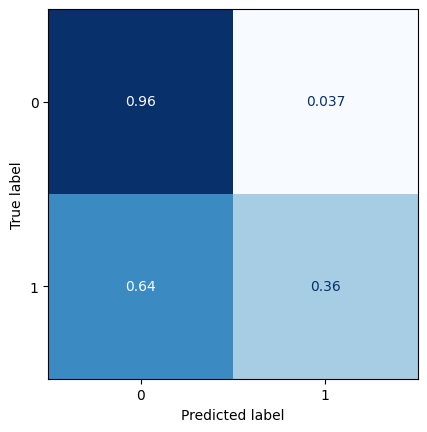

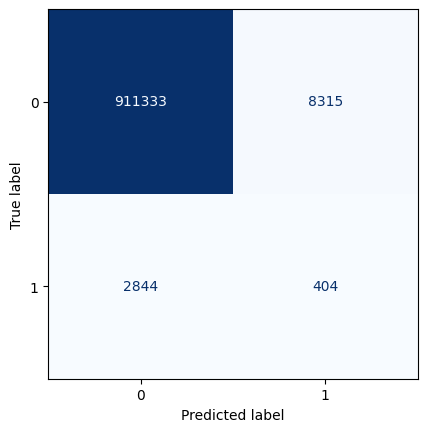

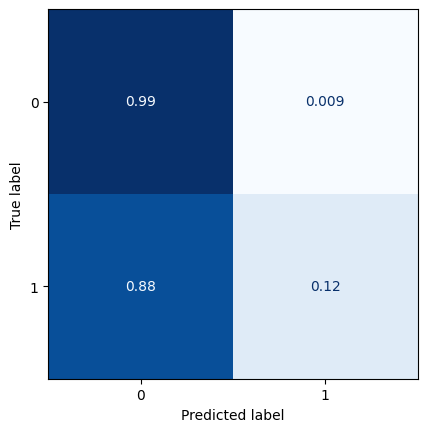

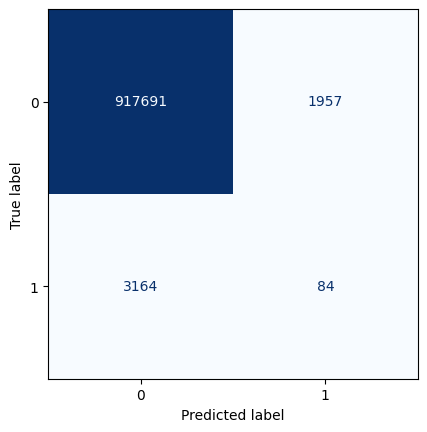

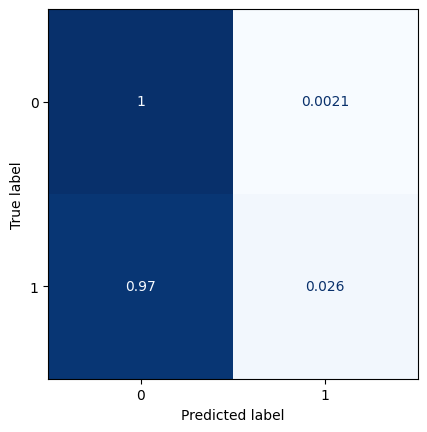

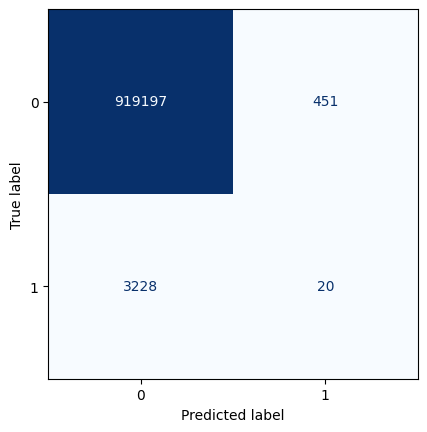

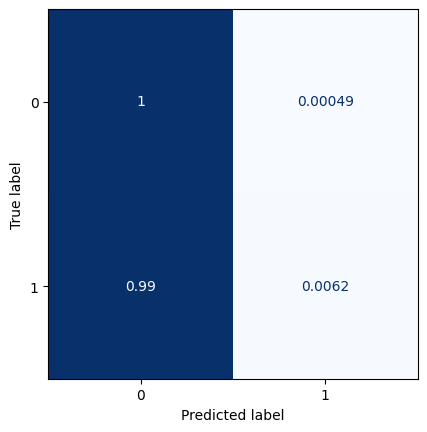

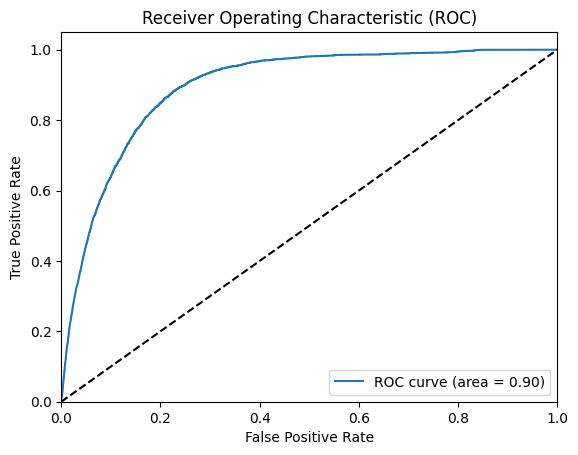

All zeros Brier score: 0.003519356460532931
Model Brier score: 0.003459877190030585
77/77 [==============================] - 2s 27ms/step


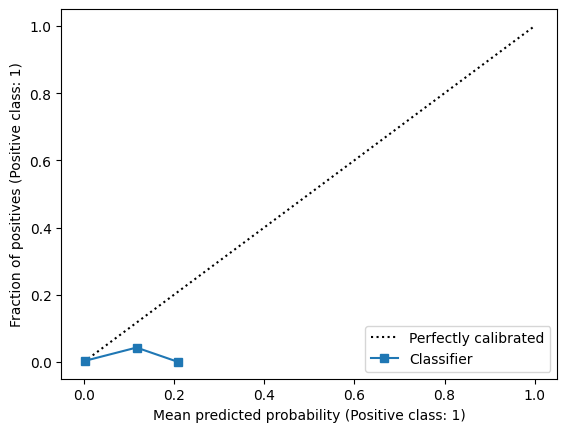

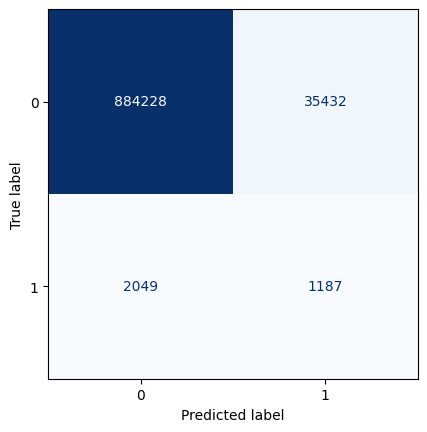

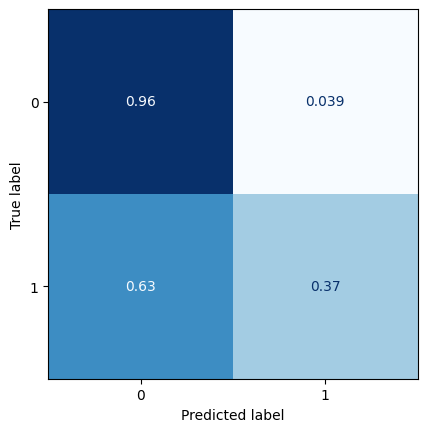

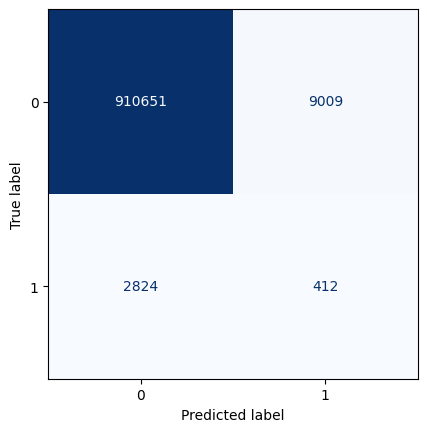

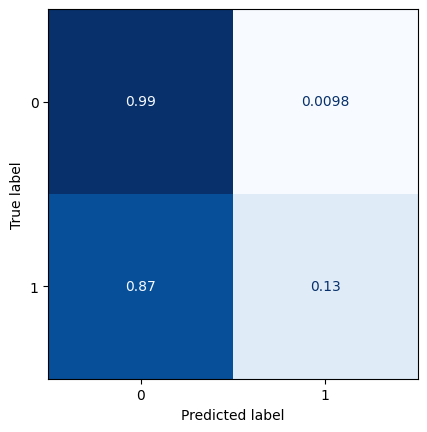

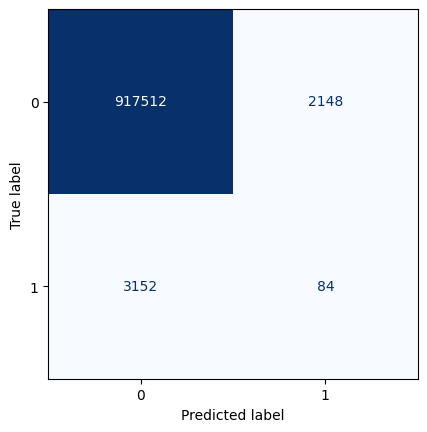

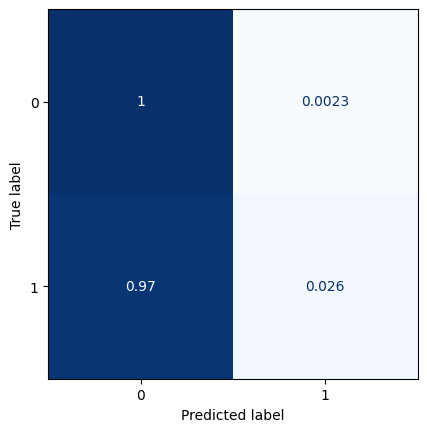

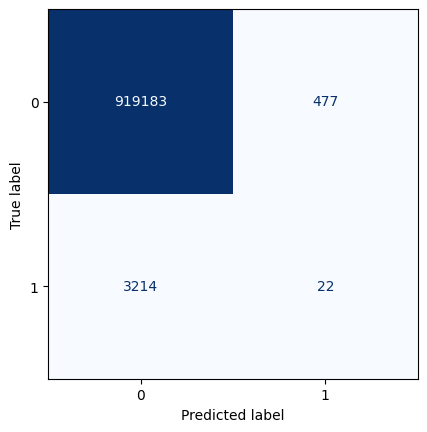

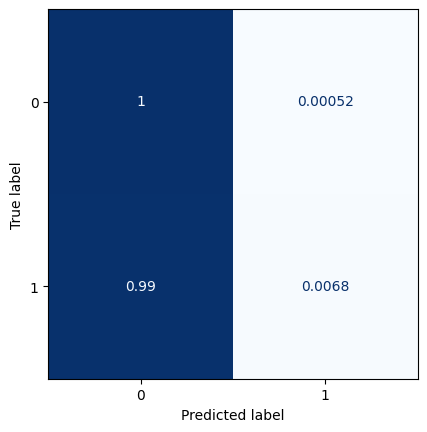

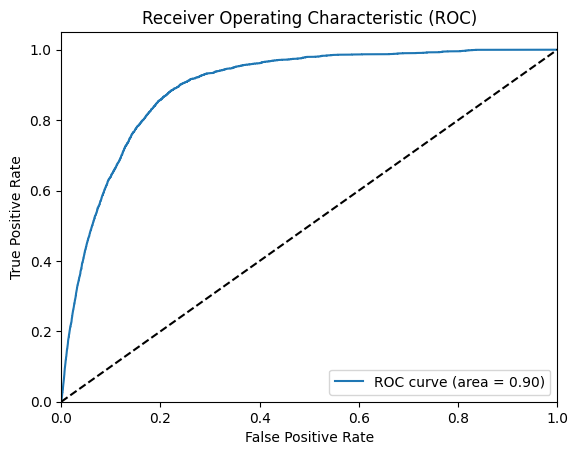

All zeros Brier score: 0.003506353912033425
Model Brier score: 0.003451491968795753
77/77 [==============================] - 2s 26ms/step


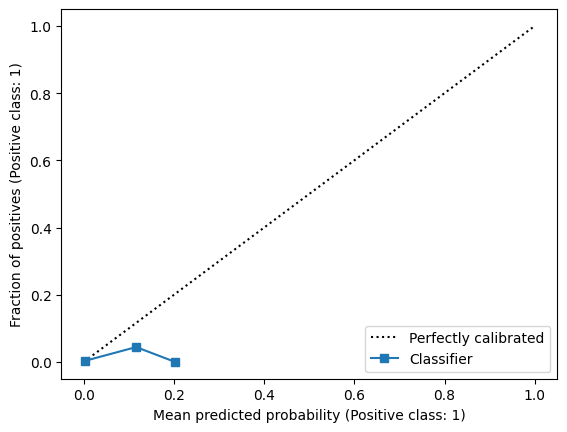

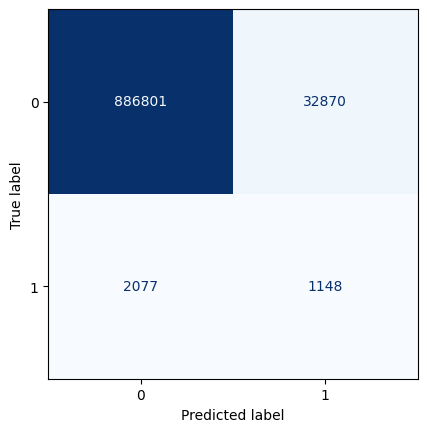

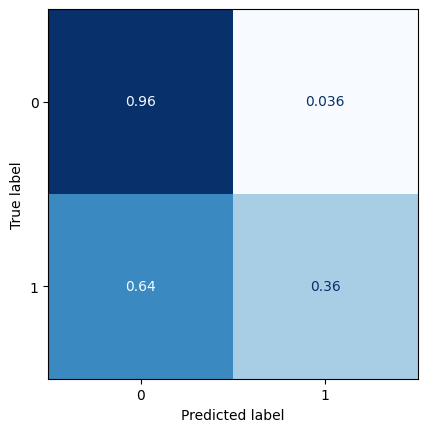

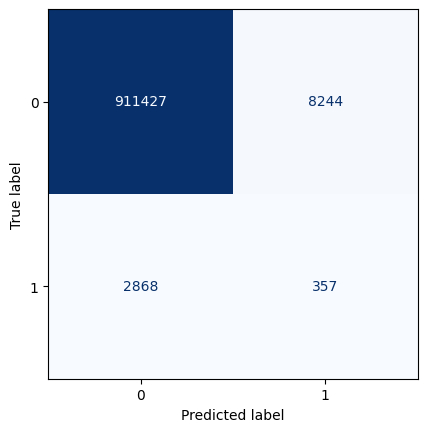

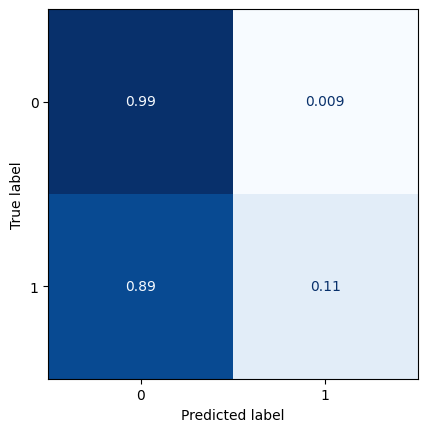

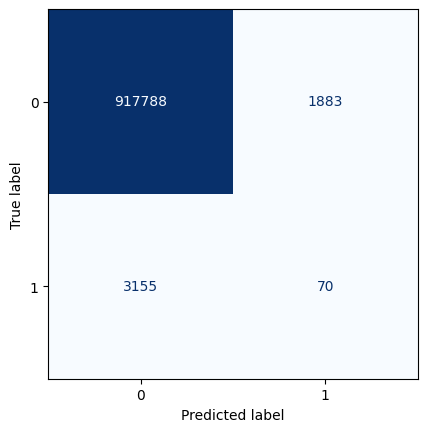

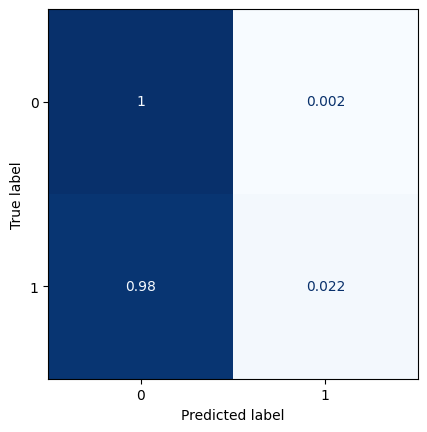

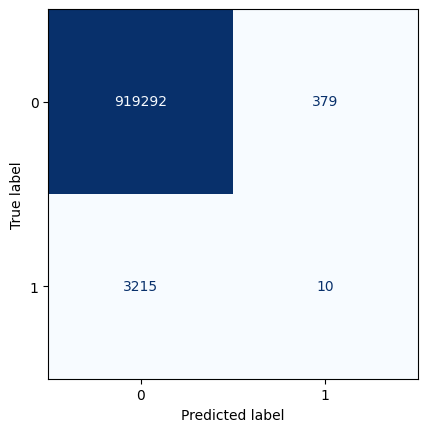

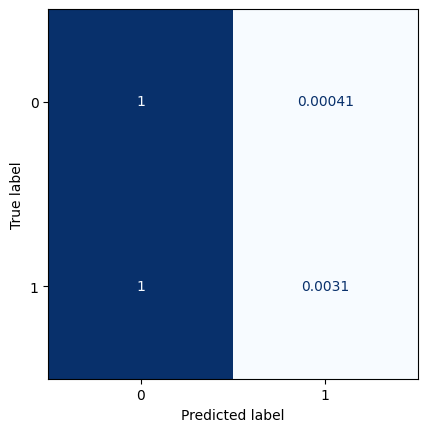

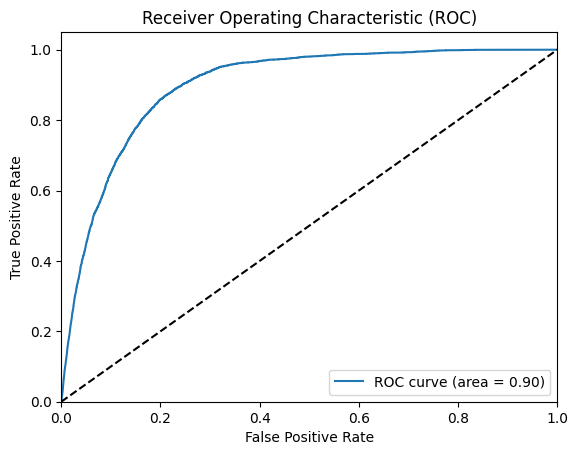

All zeros Brier score: 0.0034944349092422113
Model Brier score: 0.003437879317535895
77/77 [==============================] - 2s 26ms/step


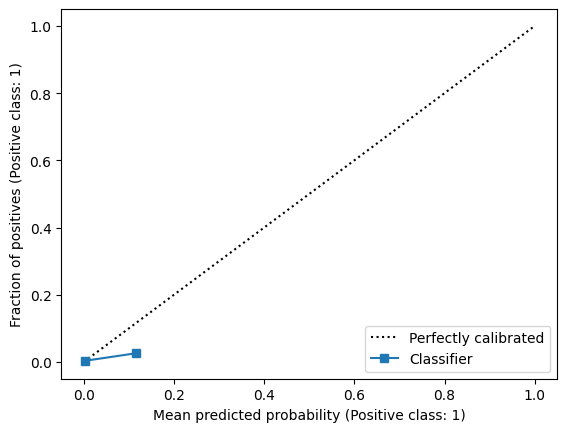

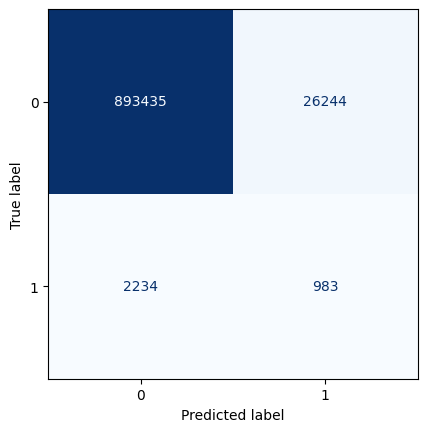

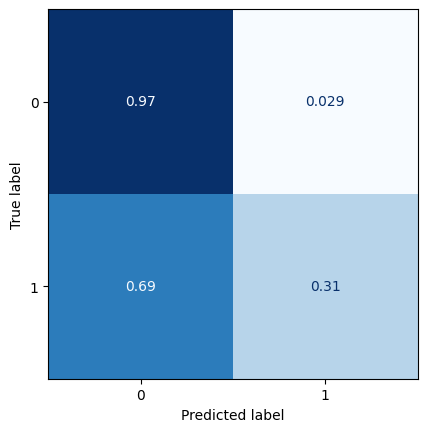

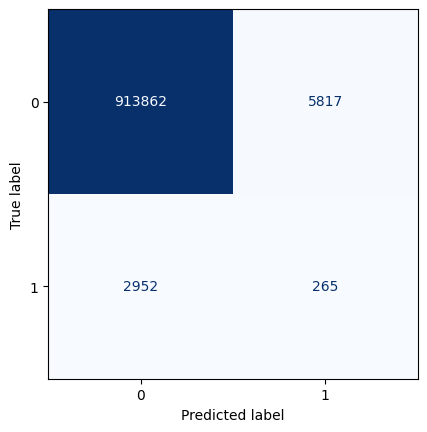

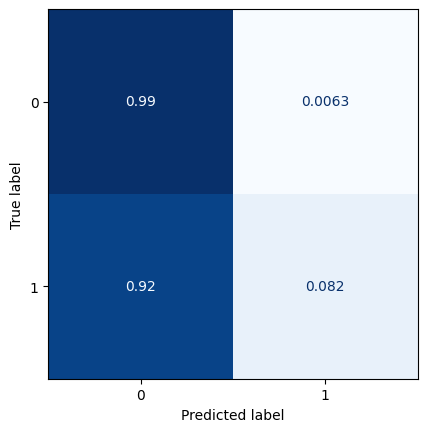

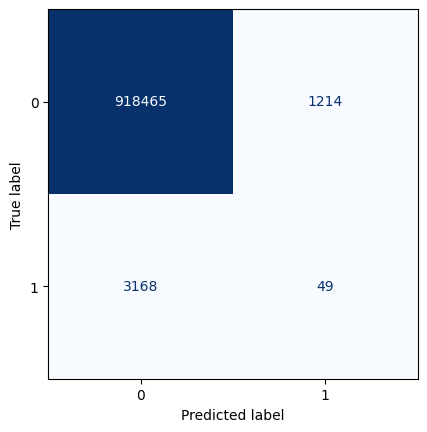

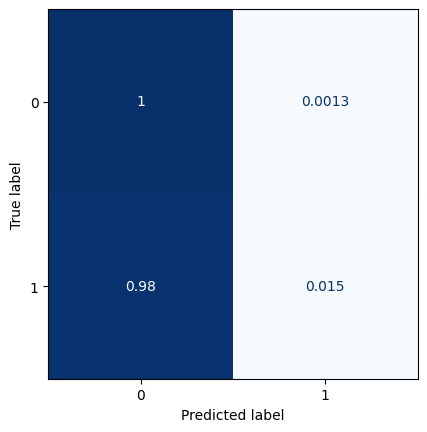

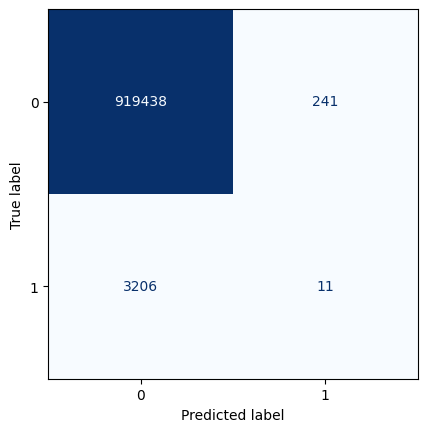

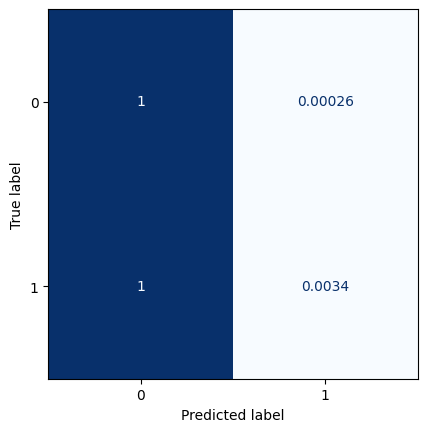

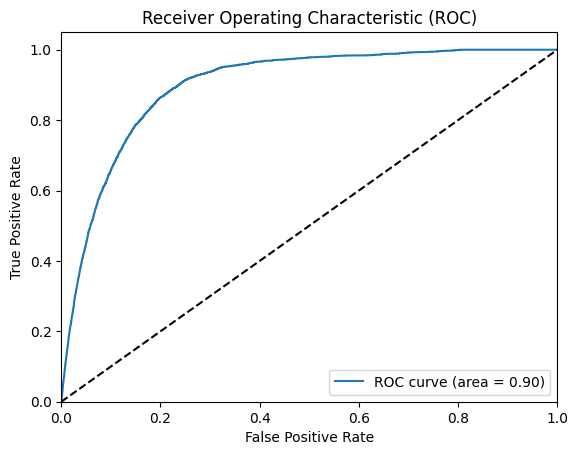

All zeros Brier score: 0.0034857665435758744
Model Brier score: 0.003425655015933261
77/77 [==============================] - 2s 27ms/step


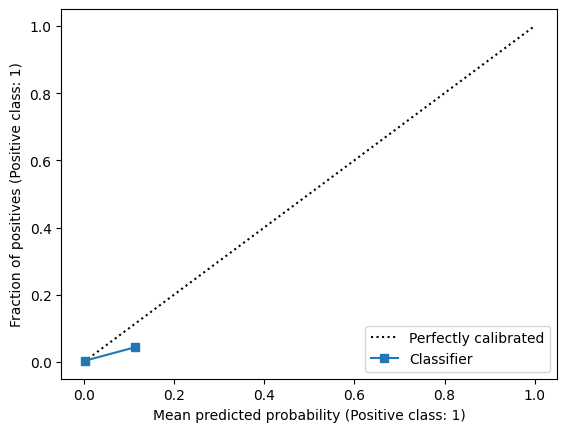

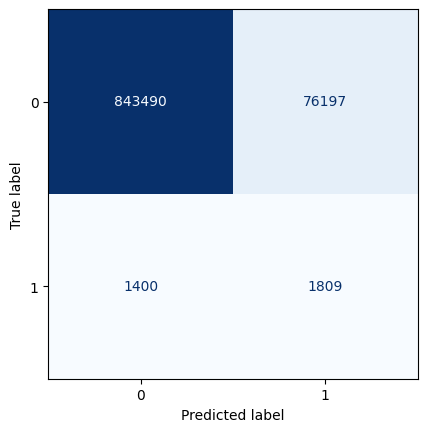

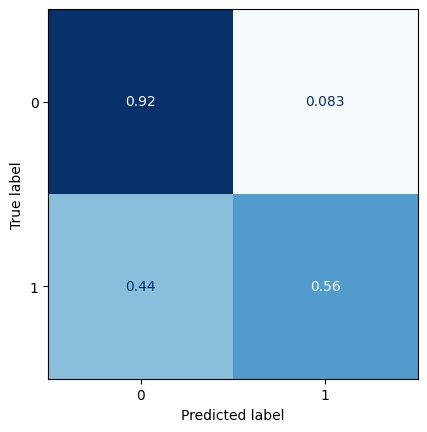

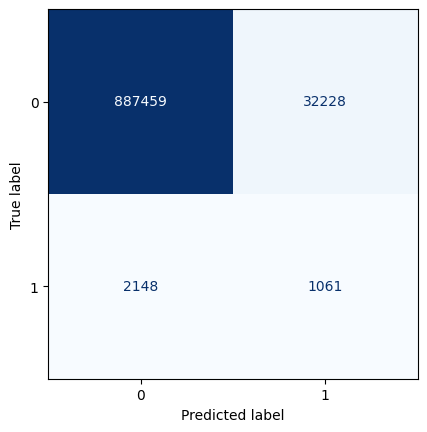

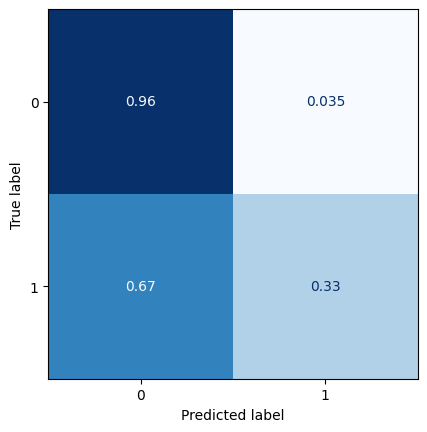

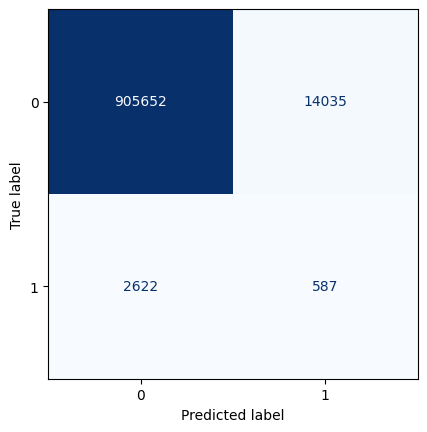

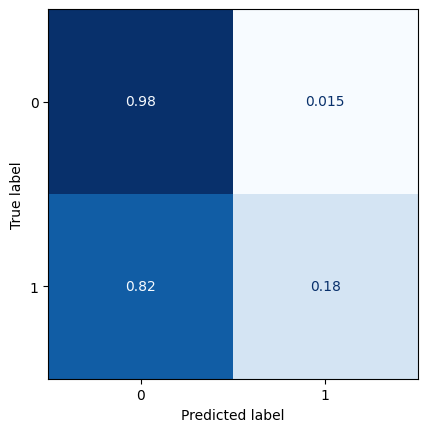

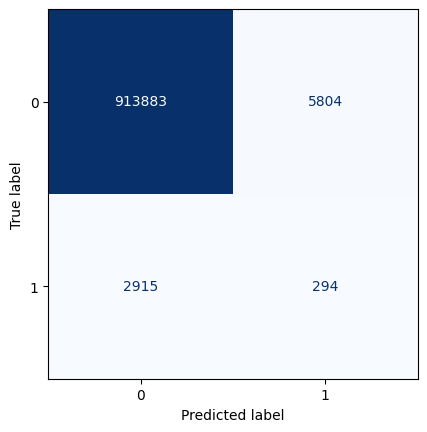

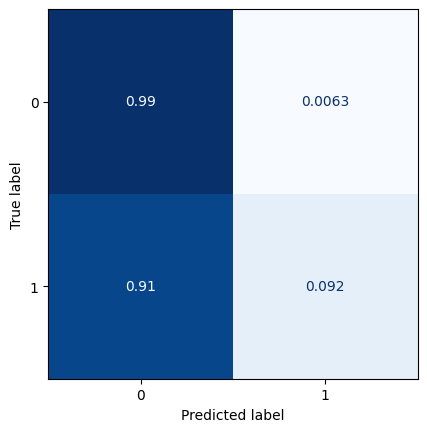

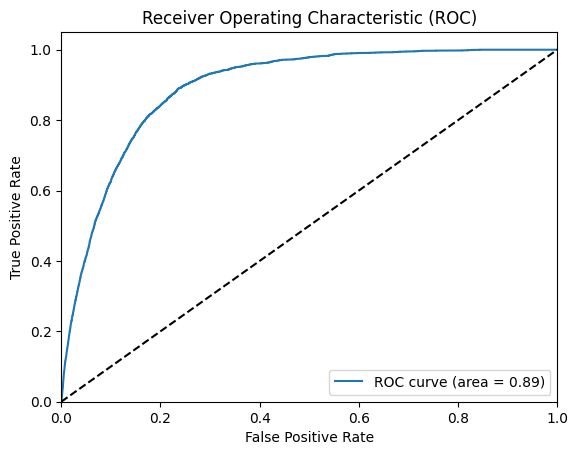

All zeros Brier score: 0.003477098177909537
Model Brier score: 0.0035311073871659693
Model: "model_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_27 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_41 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_26 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 01:42:19.969340: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.1471

2023-04-09 01:43:40.992026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 86s 2s/step - loss: 0.1471 - val_loss: 0.0364 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 62s 1s/step - loss: 0.0338 - val_loss: 0.0284 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 53s 1s/step - loss: 0.0289 - val_loss: 0.0262 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 47s 1s/step - loss: 0.0269 - val_loss: 0.0250 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 48s 1s/step - loss: 0.0257 - val_loss: 0.0240 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 51s 1s/step - loss: 0.0249 - val_loss: 0.0233 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 46s 1s/step - loss: 0.0242 - val_loss: 0.0229 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 47s 1s/step - loss: 0.0238 - val_loss: 0.0224 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 50s 1s/step - loss: 0.0234 - val_loss: 0.0225 - lr: 0.0010
Epoc

2023-04-09 02:17:40.795100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 5s 34ms/step


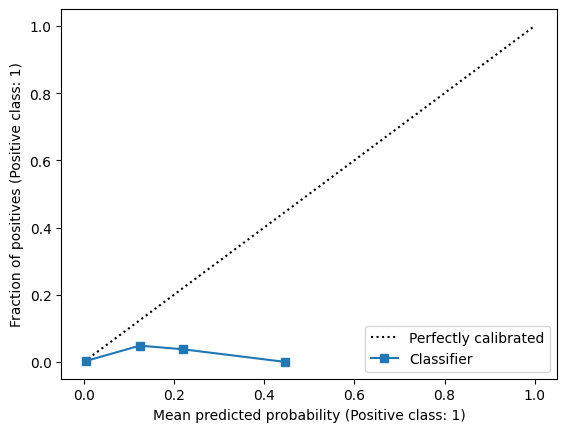

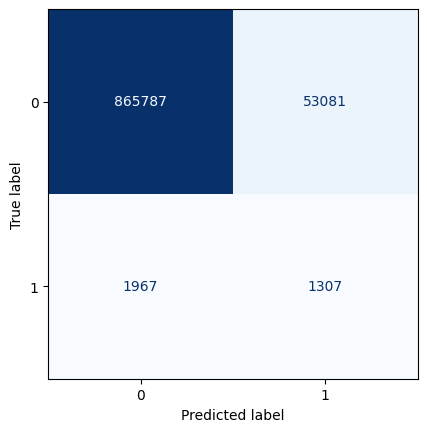

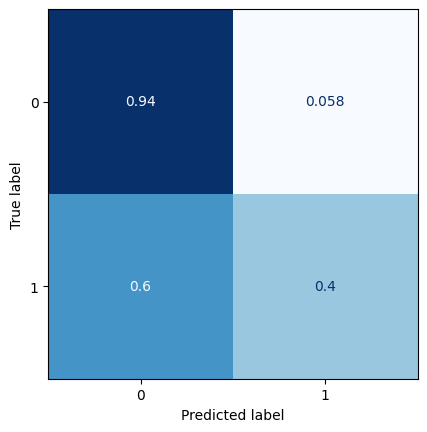

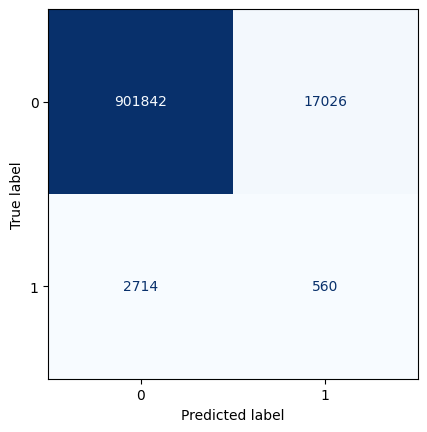

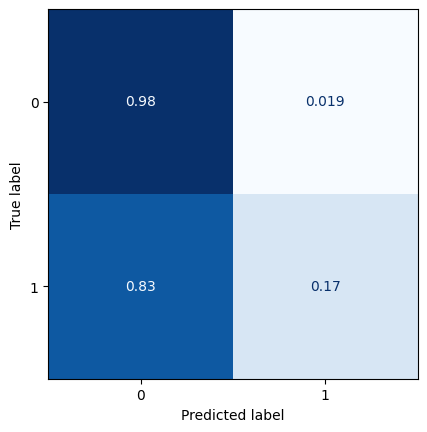

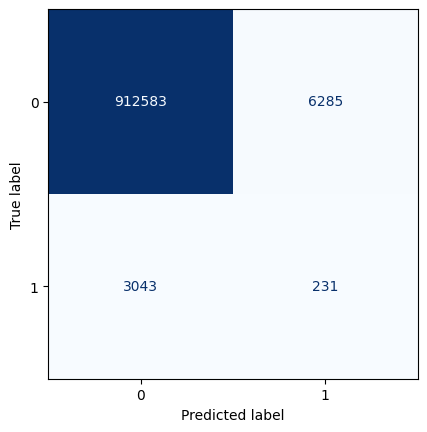

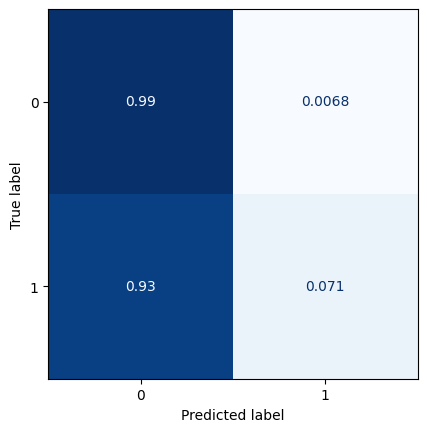

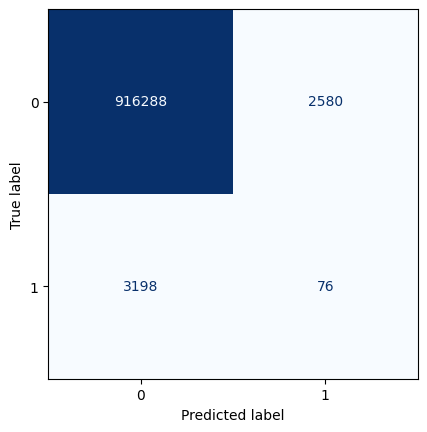

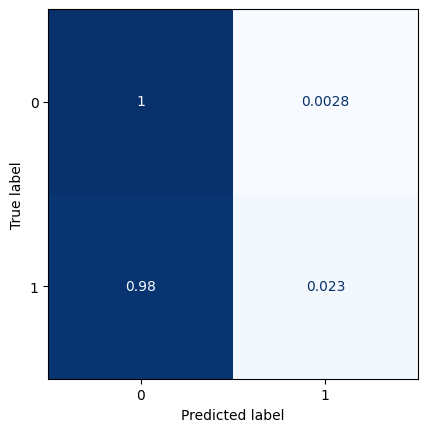

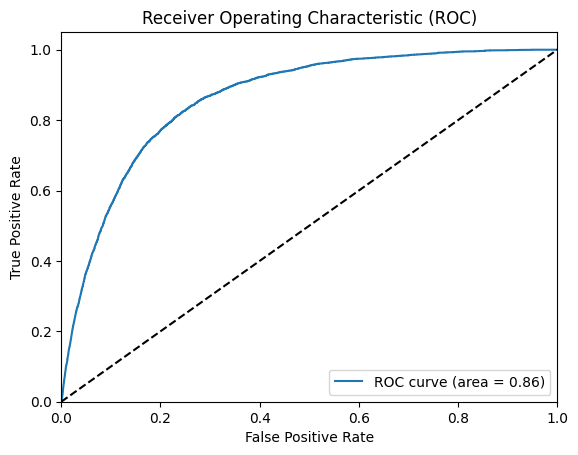

All zeros Brier score: 0.00355042932650286
Model Brier score: 0.003564321730357855
77/77 [==============================] - 3s 33ms/step


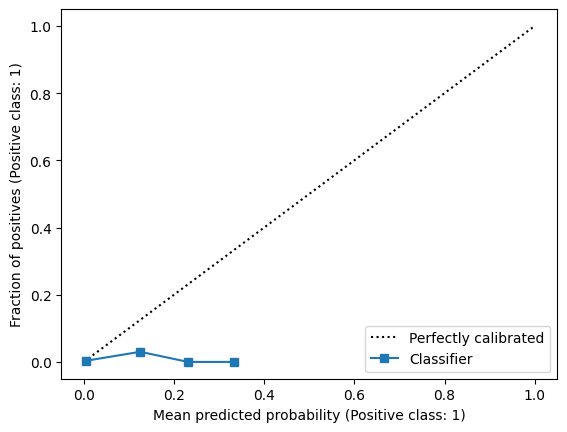

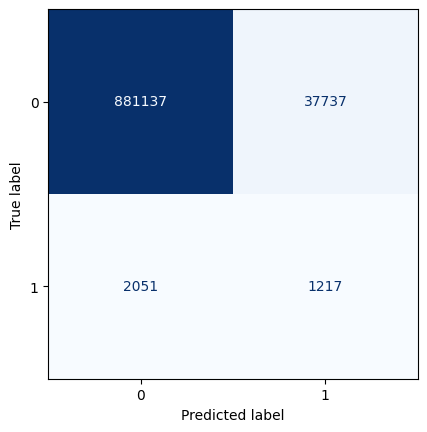

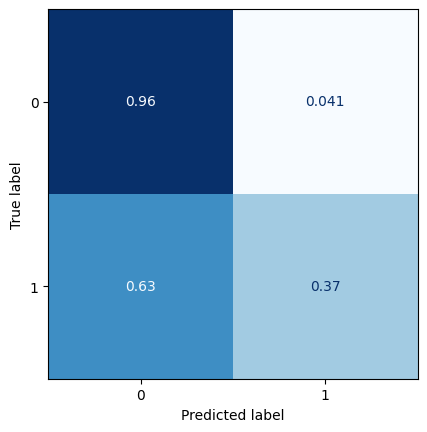

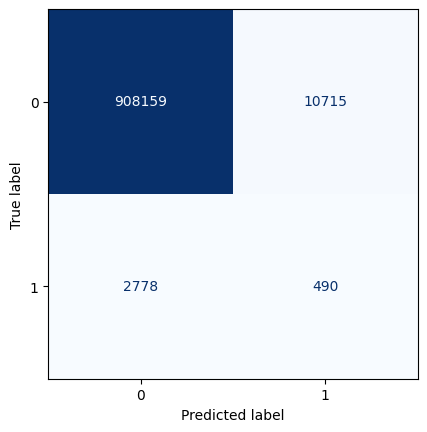

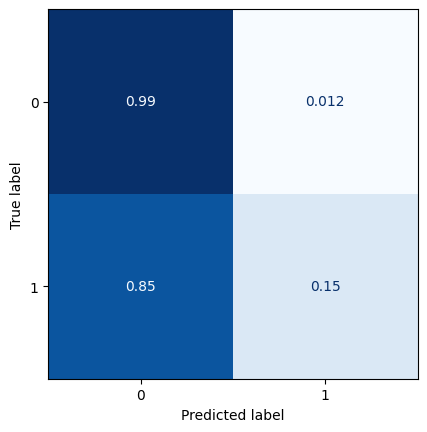

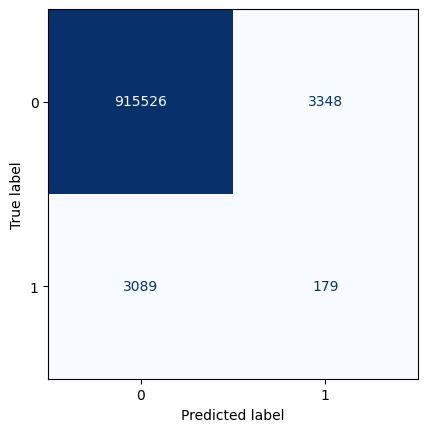

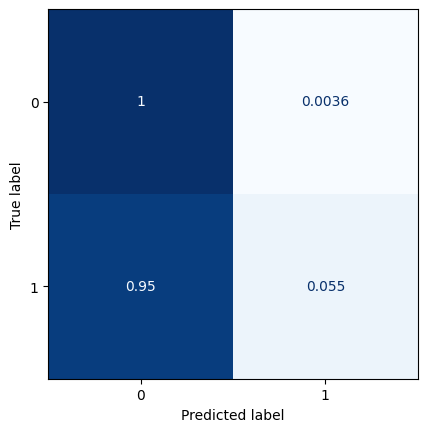

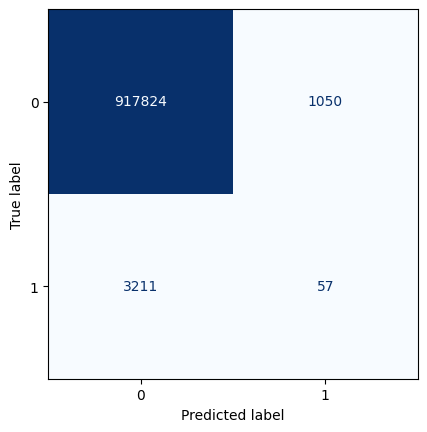

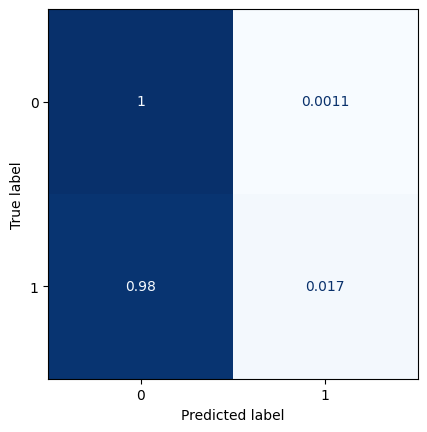

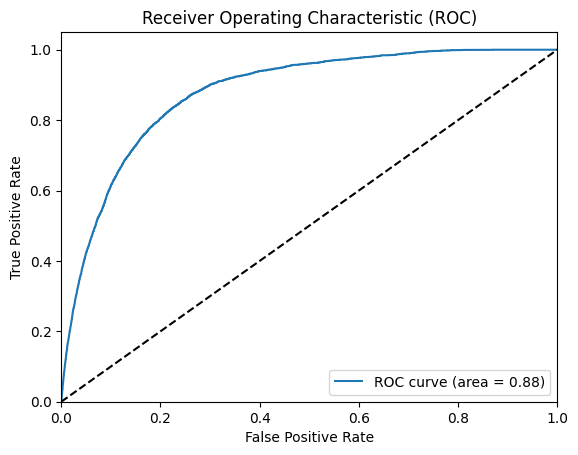

All zeros Brier score: 0.0035439227364115287
Model Brier score: 0.0034975783978659276
77/77 [==============================] - 3s 31ms/step


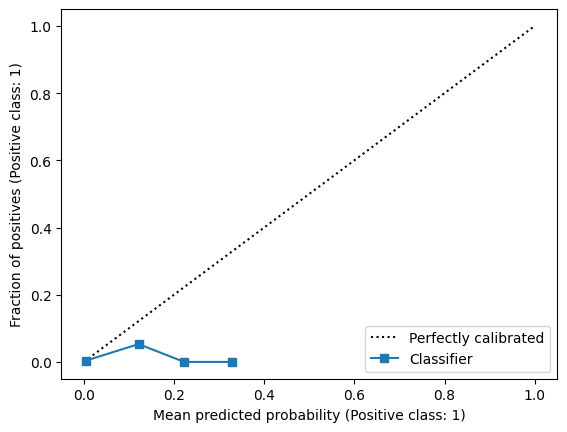

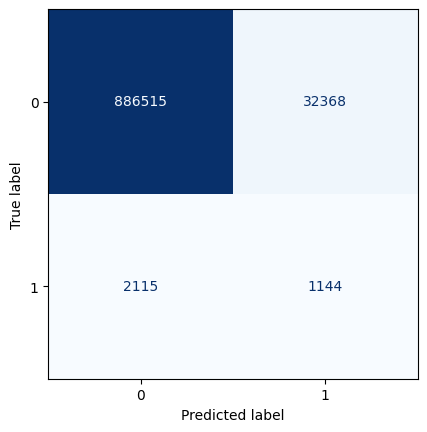

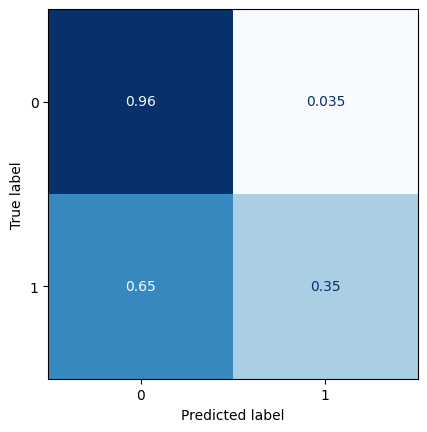

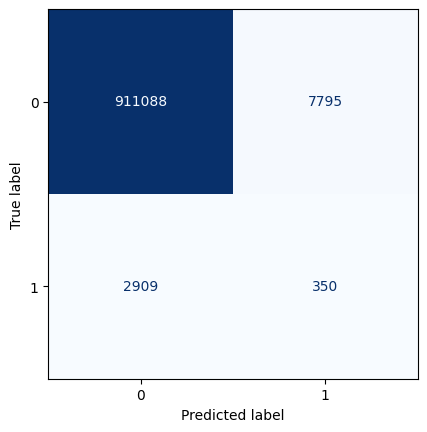

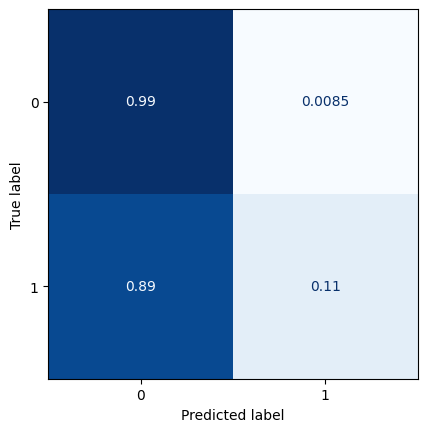

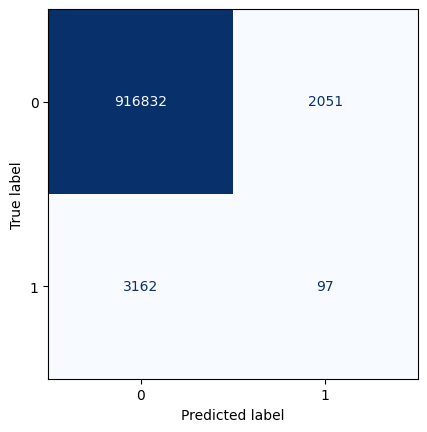

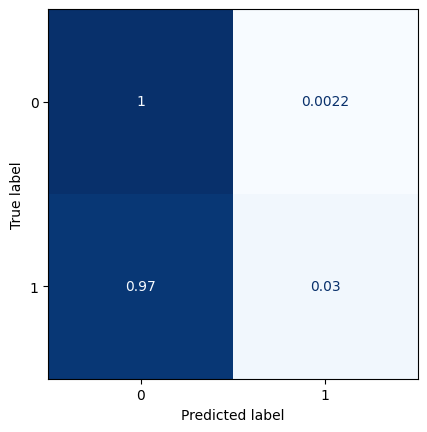

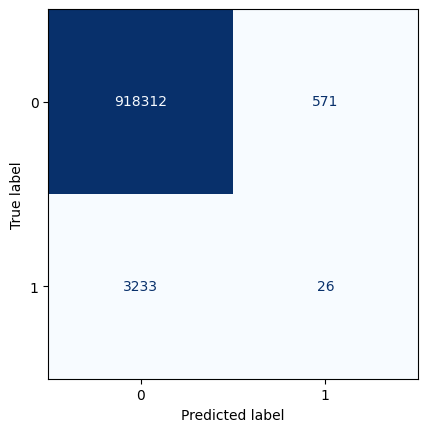

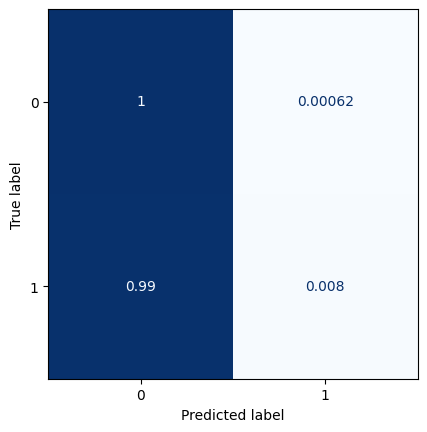

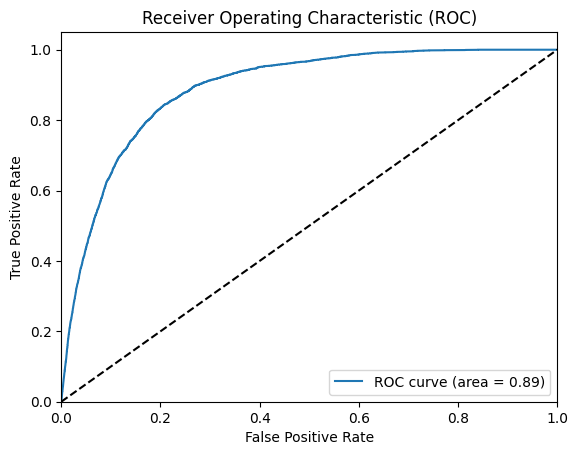

All zeros Brier score: 0.0035341628512745326
Model Brier score: 0.0034766640255677337
77/77 [==============================] - 3s 34ms/step


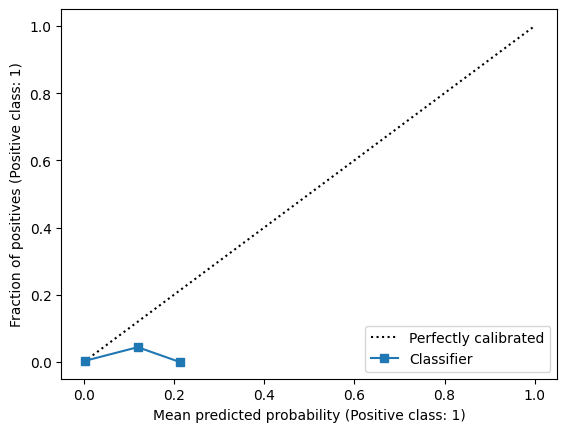

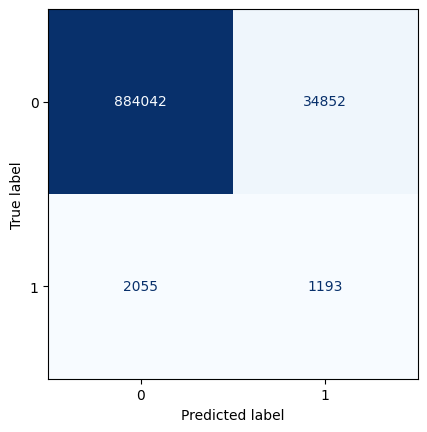

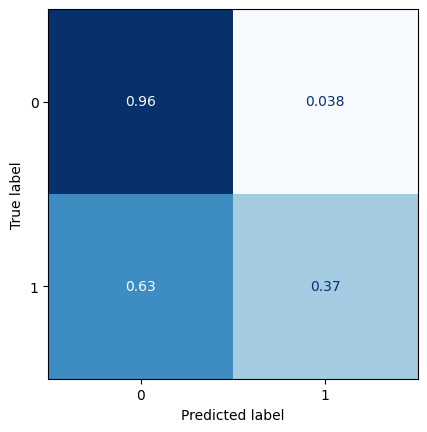

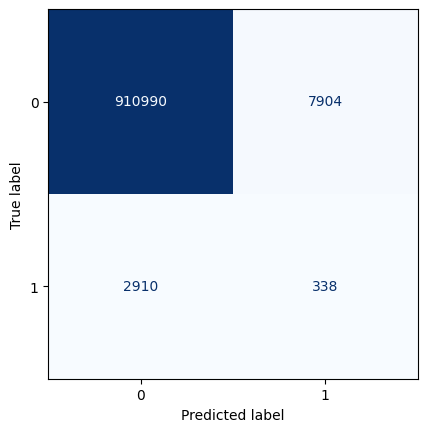

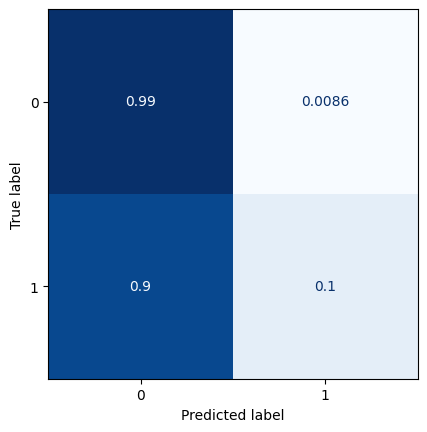

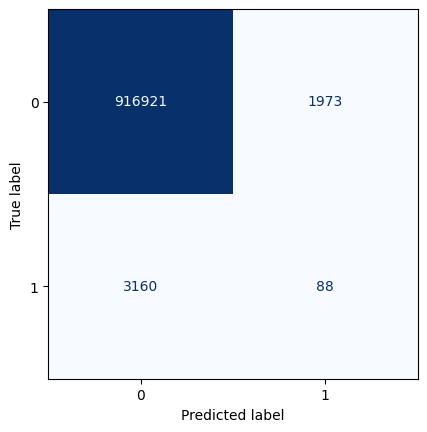

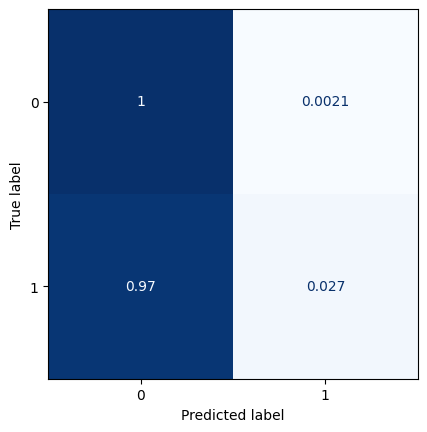

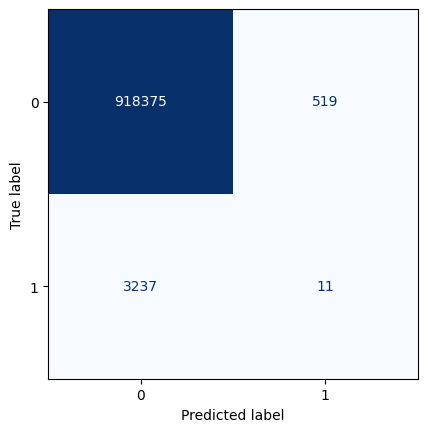

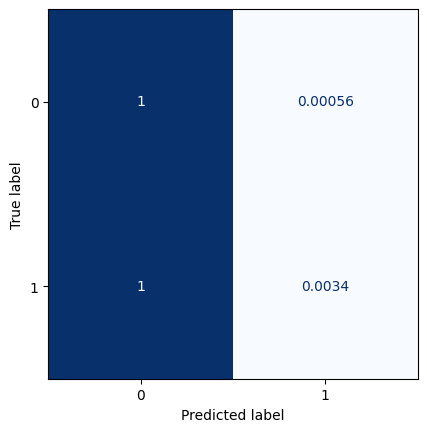

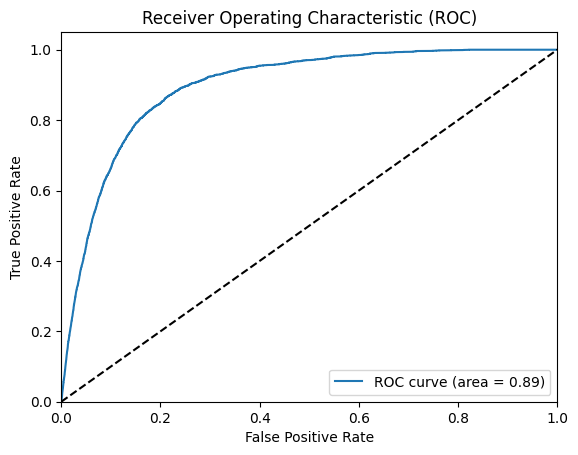

All zeros Brier score: 0.0035222341027737595
Model Brier score: 0.0034649722035168277
77/77 [==============================] - 2s 31ms/step


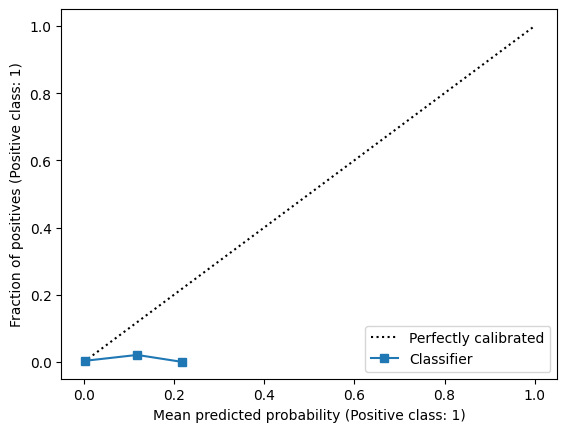

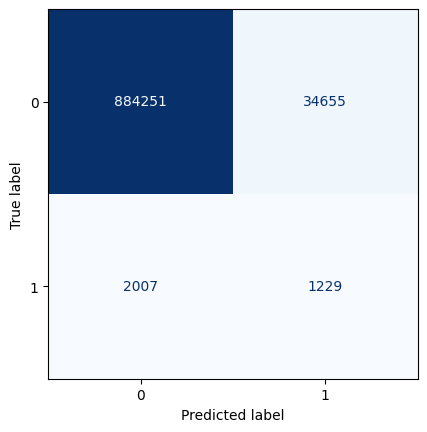

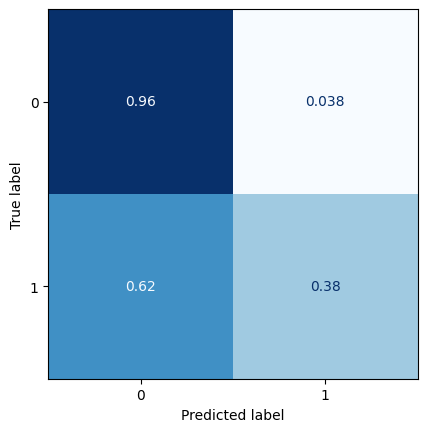

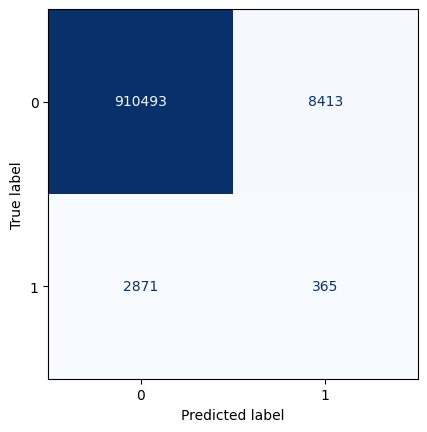

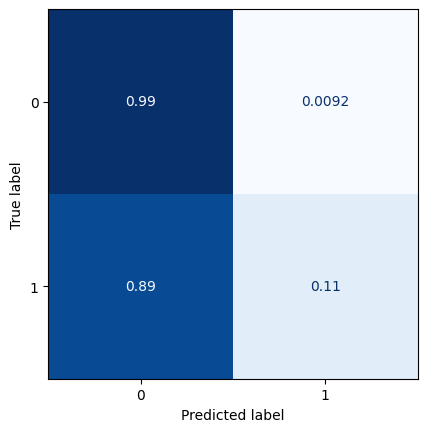

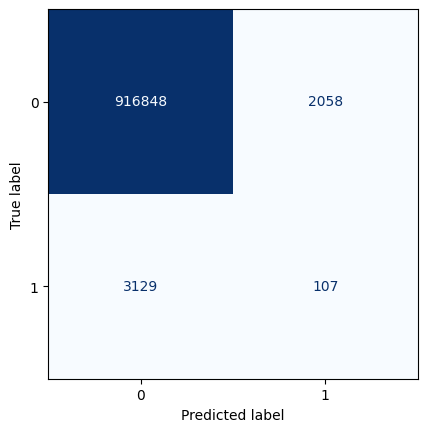

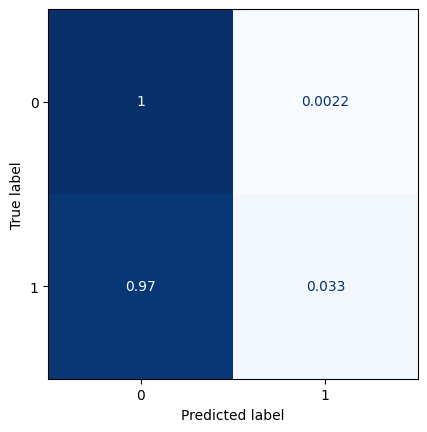

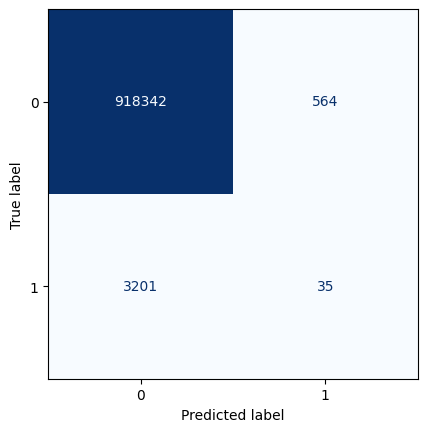

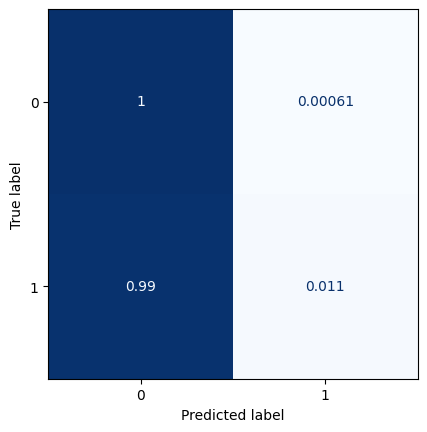

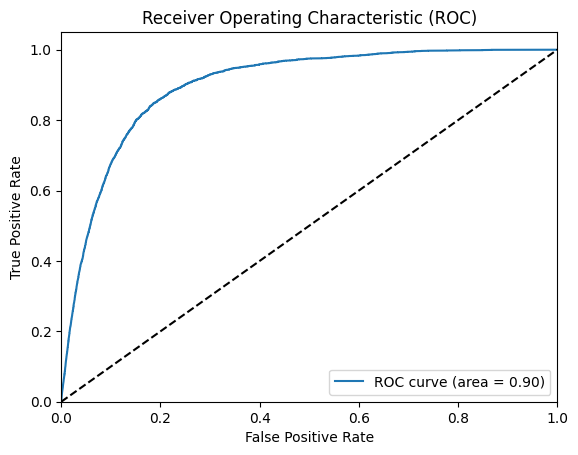

All zeros Brier score: 0.0035092209225910977
Model Brier score: 0.0034487882914945337
77/77 [==============================] - 2s 32ms/step


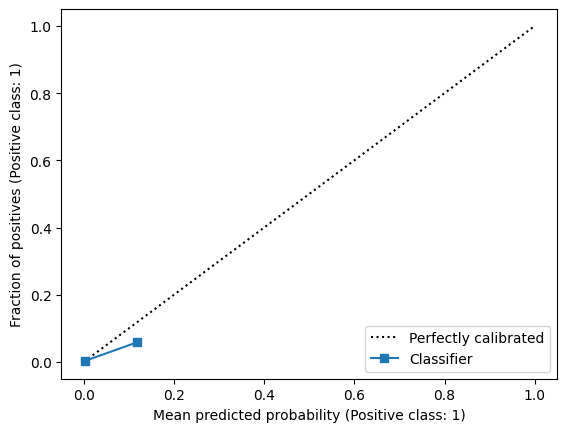

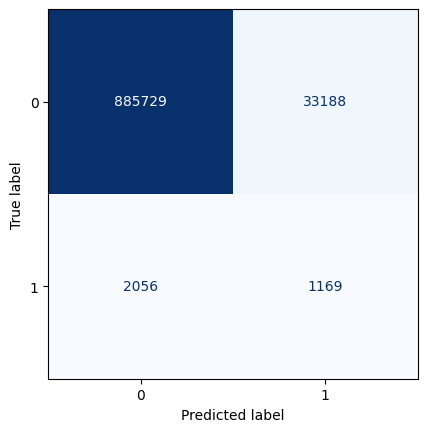

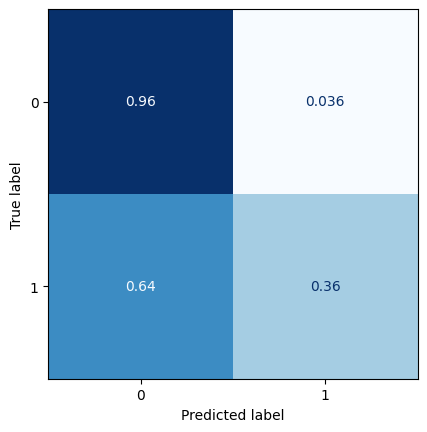

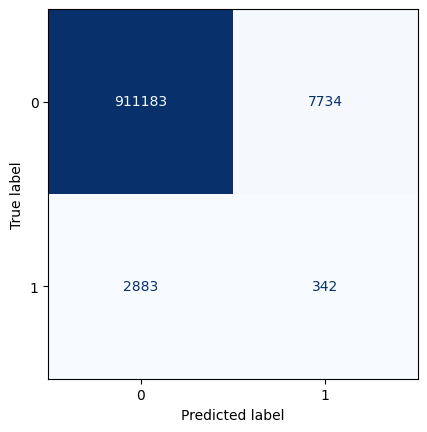

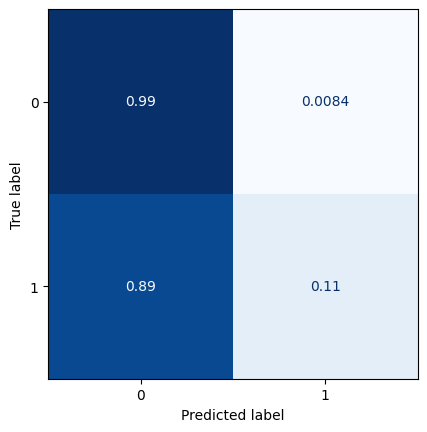

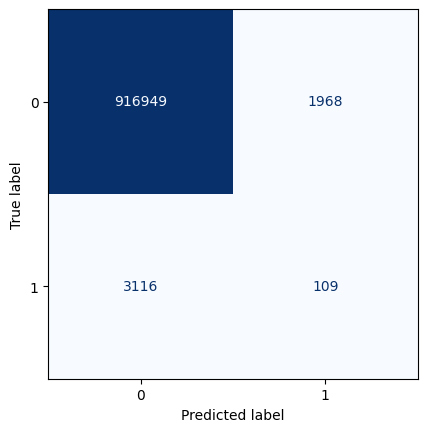

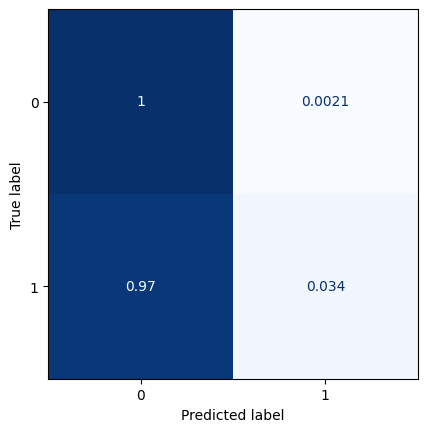

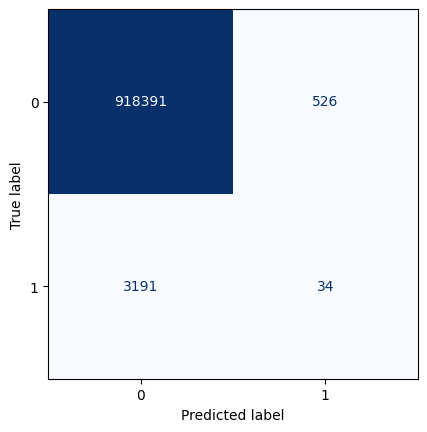

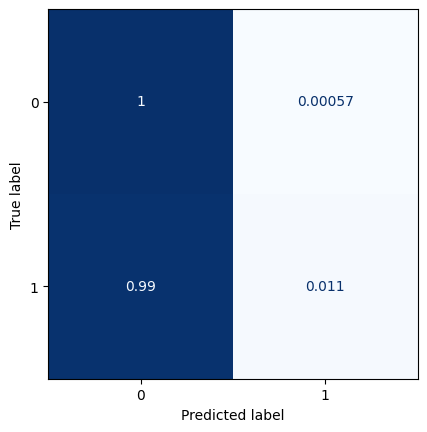

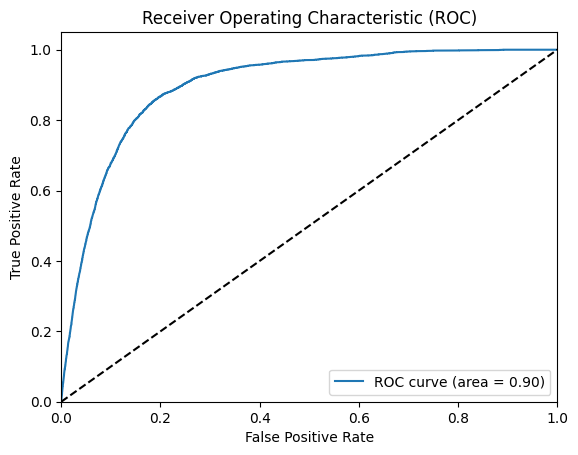

All zeros Brier score: 0.0034972921740903246
Model Brier score: 0.003435691060239519
77/77 [==============================] - 2s 28ms/step


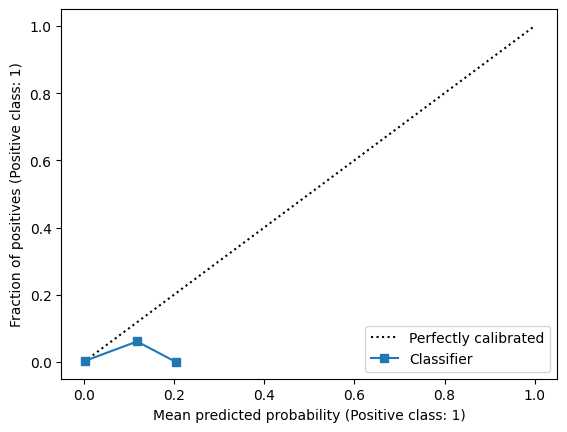

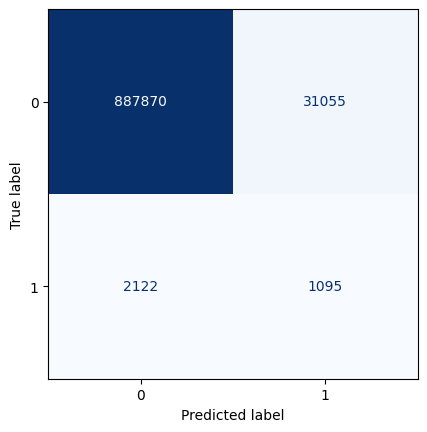

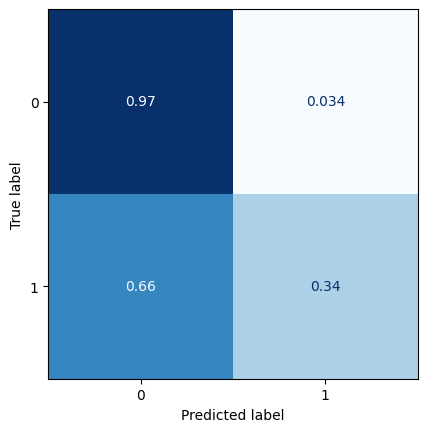

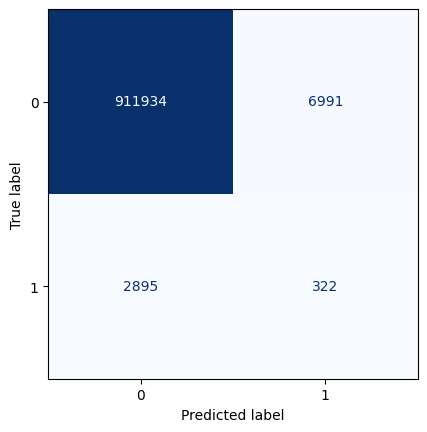

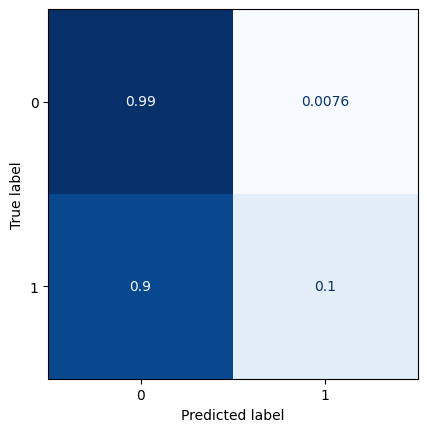

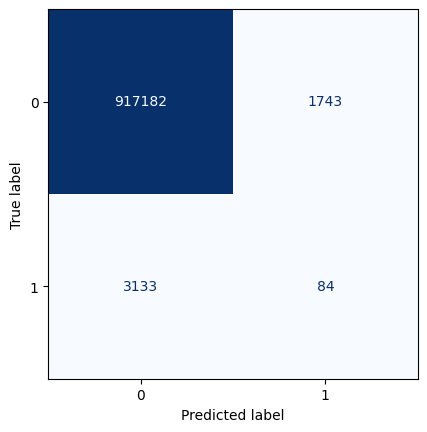

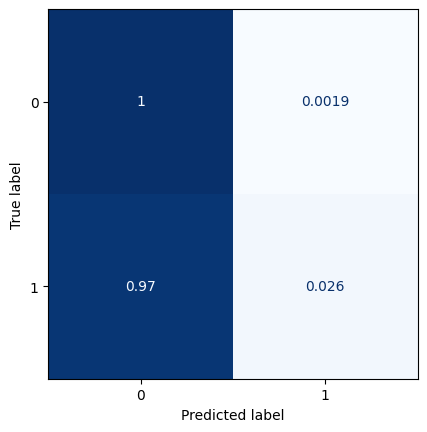

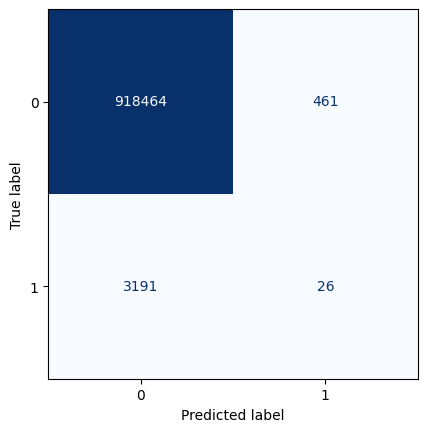

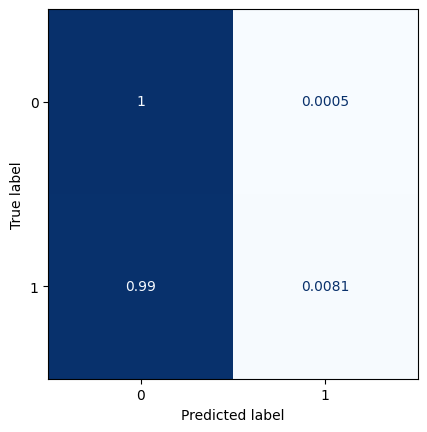

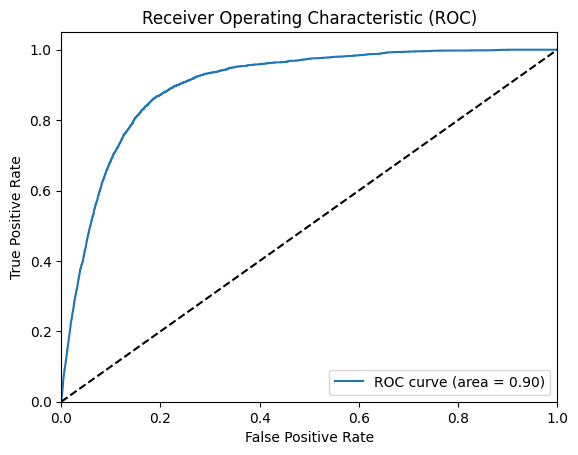

All zeros Brier score: 0.003488616720635217
Model Brier score: 0.0034260663752493513
77/77 [==============================] - 2s 31ms/step


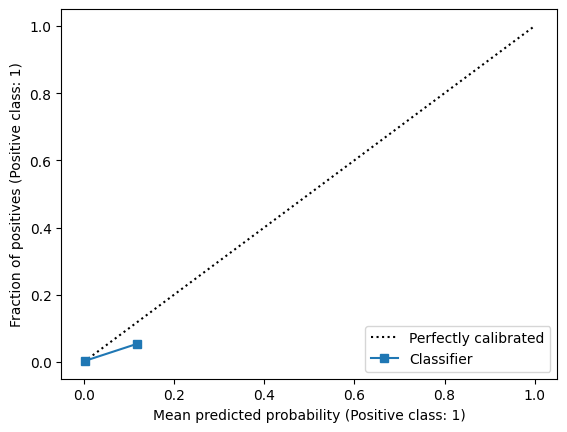

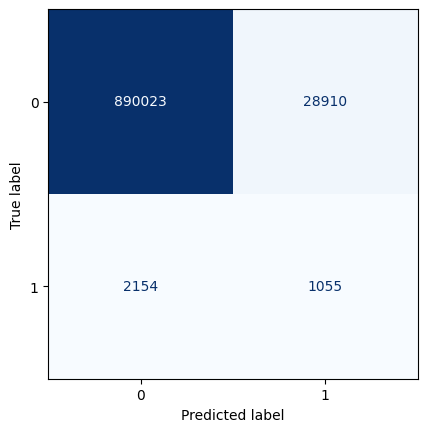

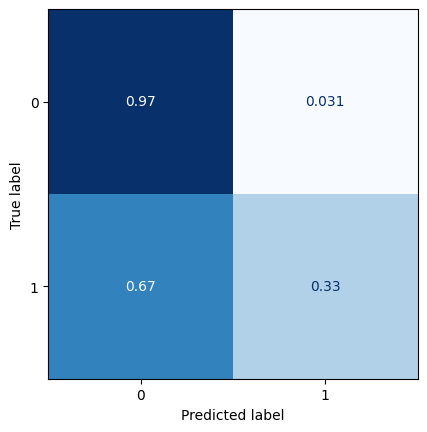

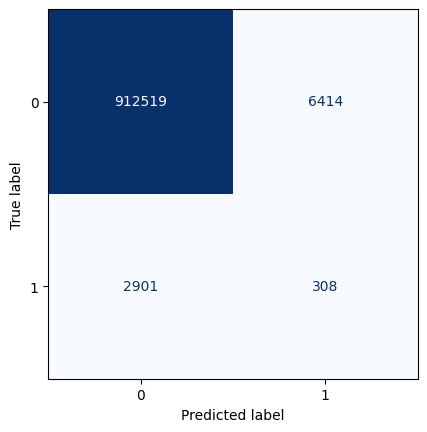

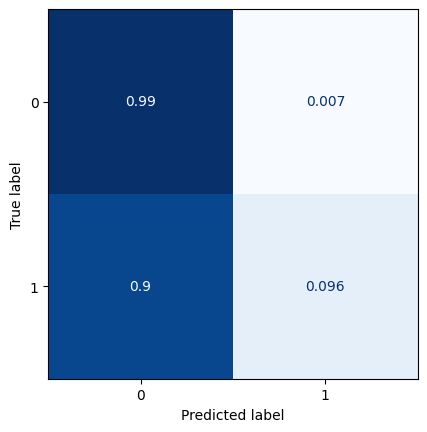

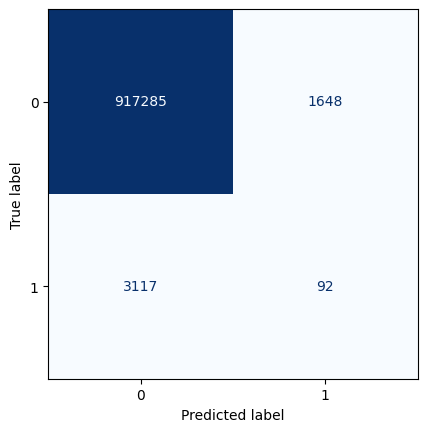

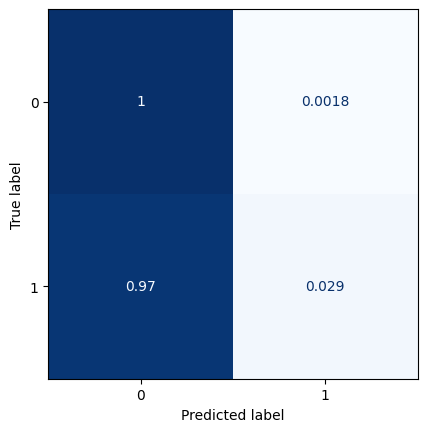

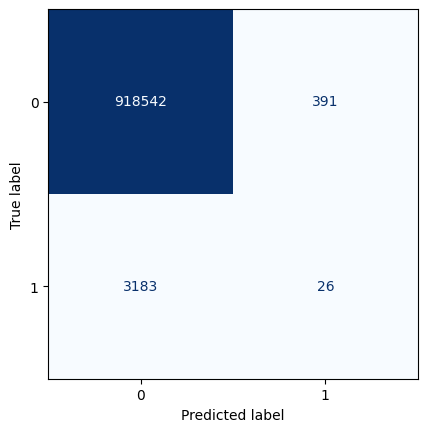

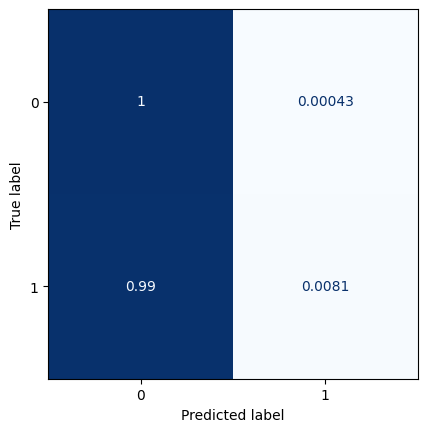

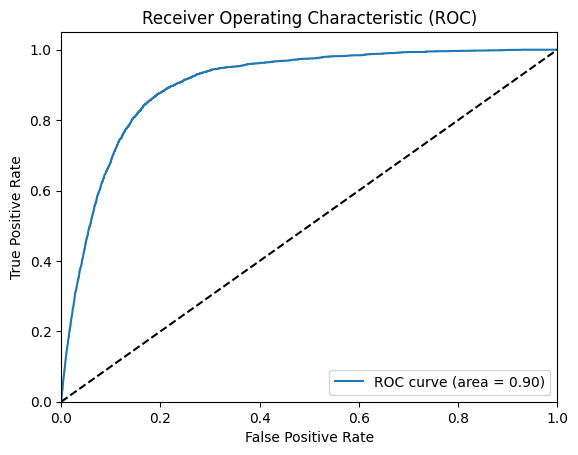

All zeros Brier score: 0.003479941267180109
Model Brier score: 0.003414662102328848
77/77 [==============================] - 2s 30ms/step


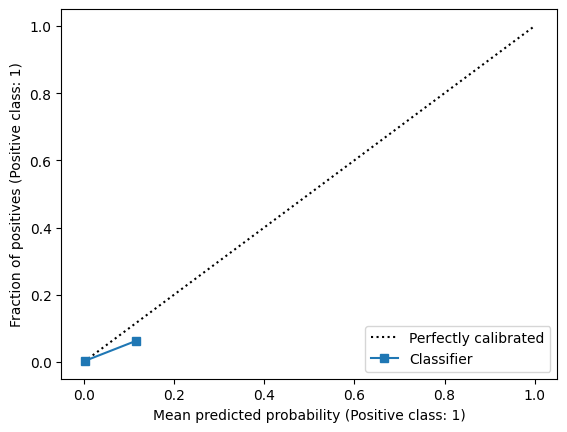

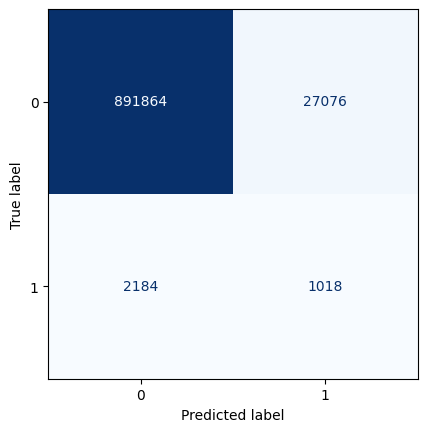

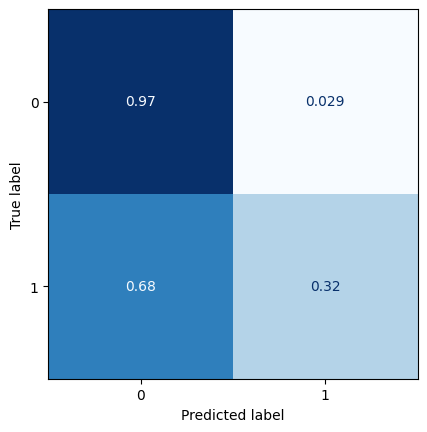

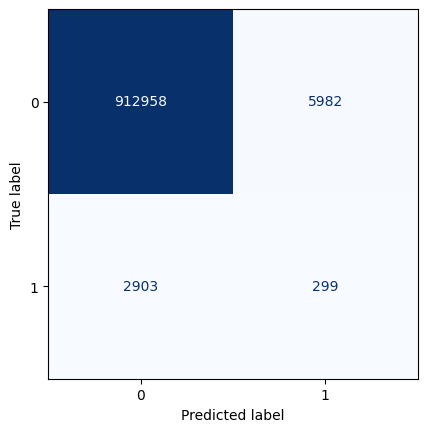

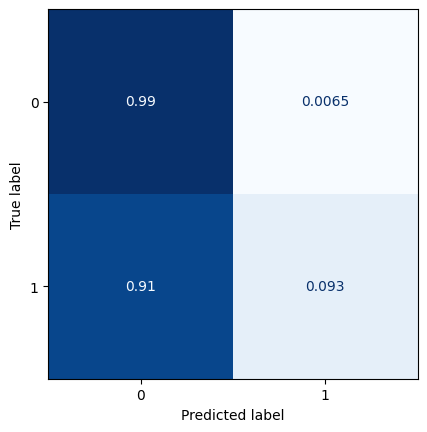

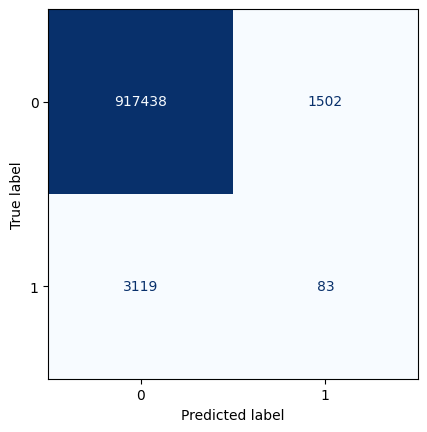

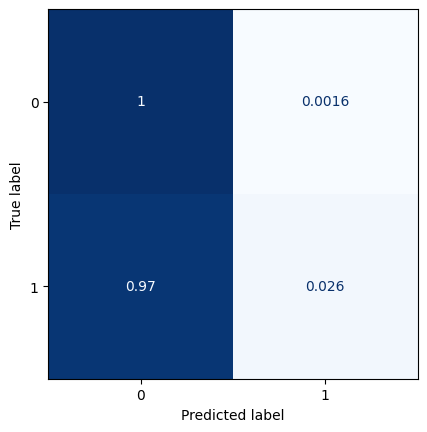

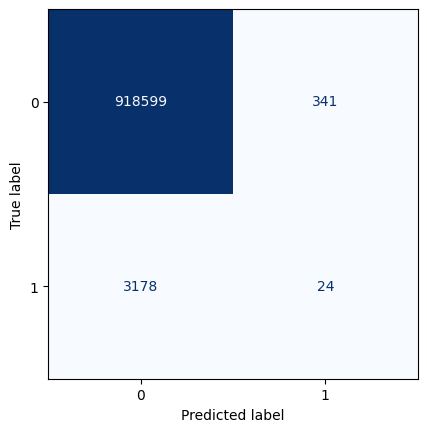

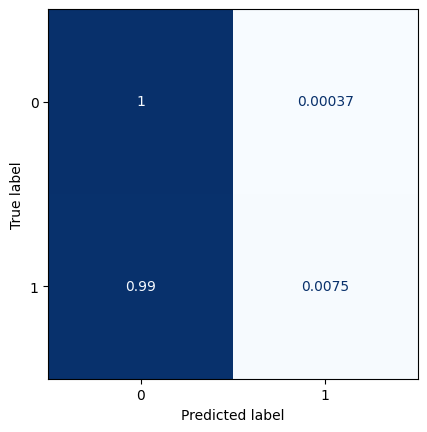

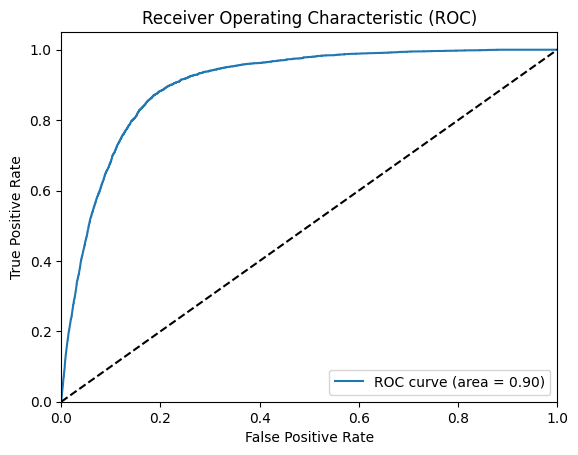

All zeros Brier score: 0.0034723502454068896
Model Brier score: 0.0034053075295141237
77/77 [==============================] - 2s 30ms/step


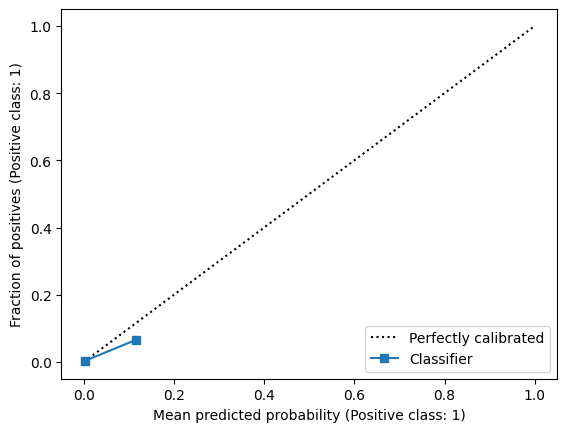

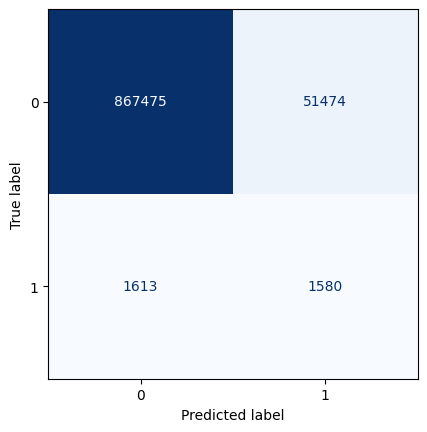

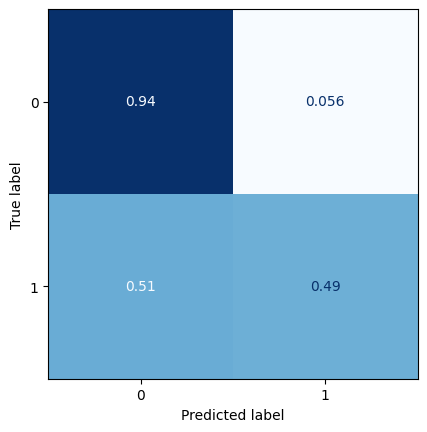

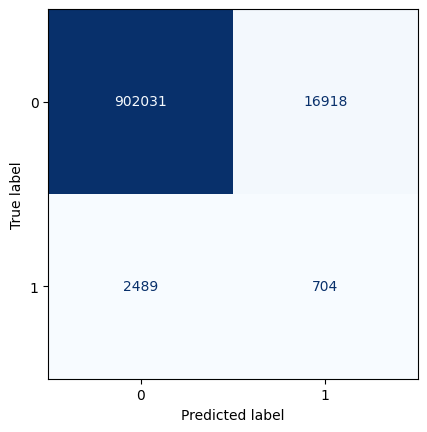

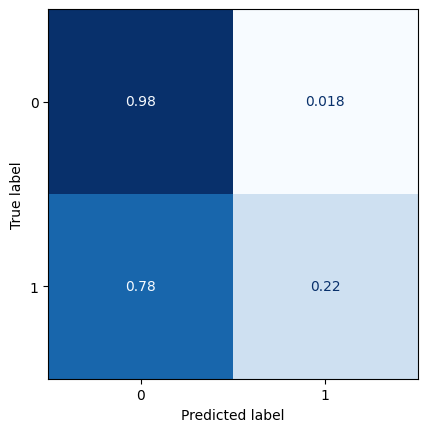

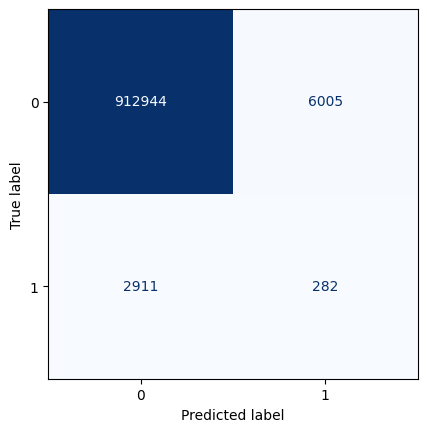

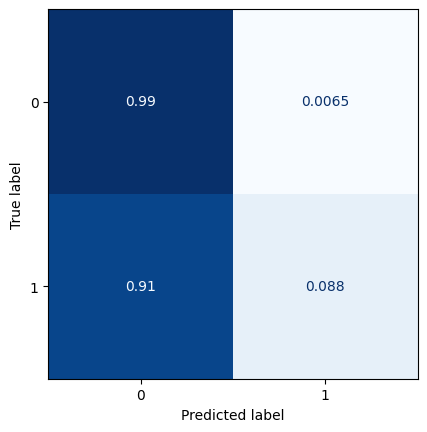

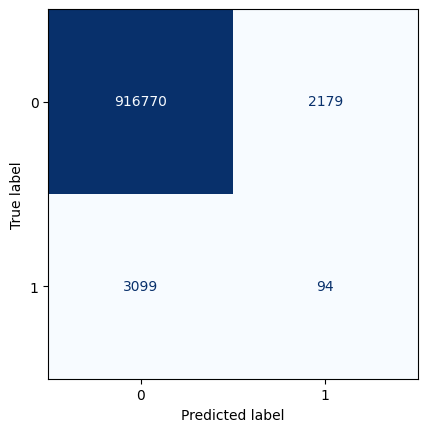

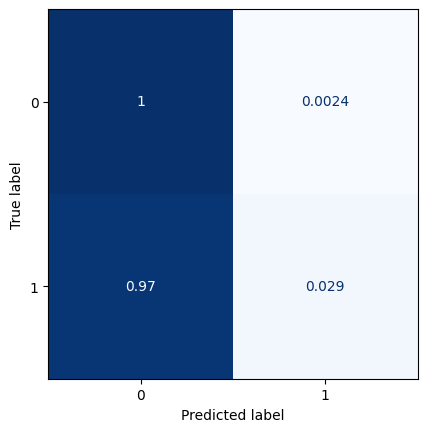

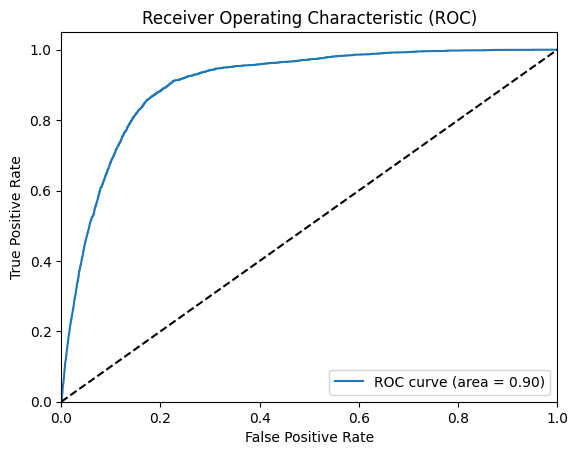

All zeros Brier score: 0.0034625903602698935
Model Brier score: 0.0034317907085503474
Model: "model_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_28 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_42 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_27 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 02:24:16.703061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.1701

2023-04-09 02:25:46.776403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 95s 2s/step - loss: 0.1701 - val_loss: 0.0394 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 67s 1s/step - loss: 0.0355 - val_loss: 0.0301 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 70s 2s/step - loss: 0.0297 - val_loss: 0.0269 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 56s 1s/step - loss: 0.0272 - val_loss: 0.0250 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 74s 2s/step - loss: 0.0257 - val_loss: 0.0239 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 69s 2s/step - loss: 0.0247 - val_loss: 0.0232 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 63s 1s/step - loss: 0.0240 - val_loss: 0.0224 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 60s 1s/step - loss: 0.0235 - val_loss: 0.0222 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 56s 1s/step - loss: 0.0232 - val_loss: 0.0217 - lr: 0.0010
Epoc

2023-04-09 03:10:41.615470: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 5s 38ms/step


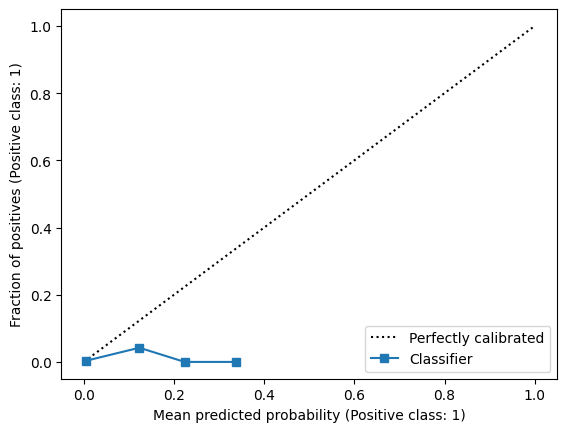

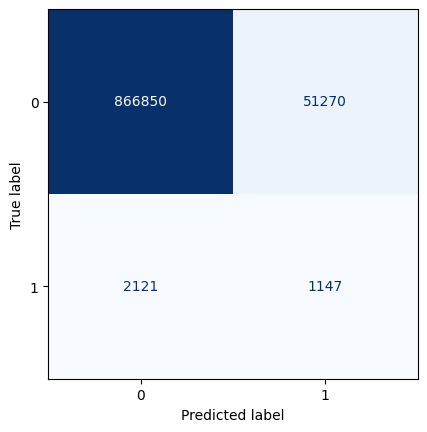

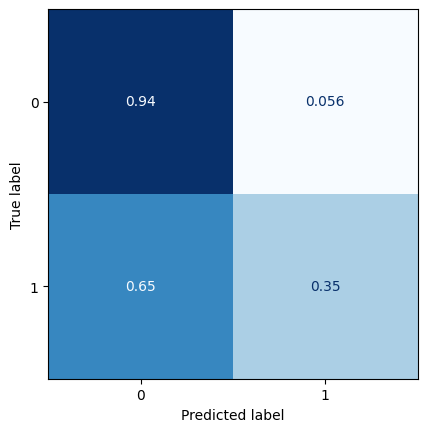

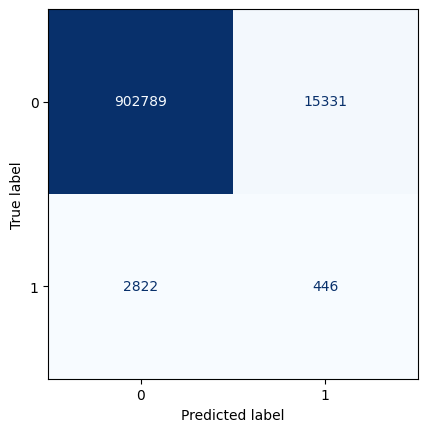

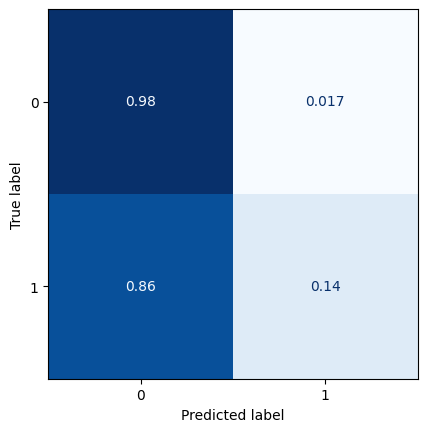

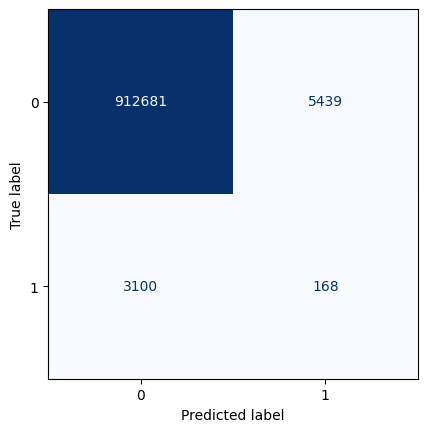

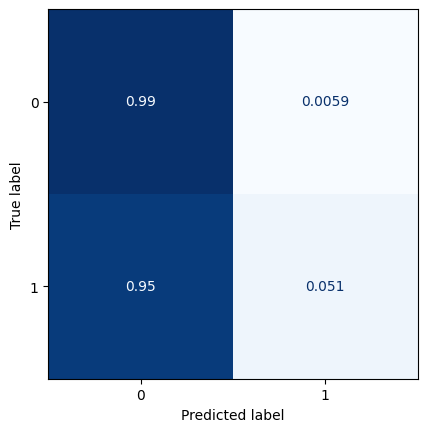

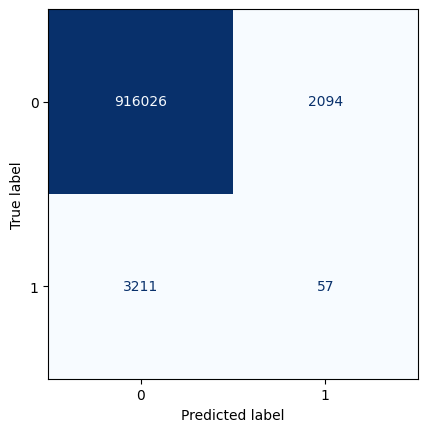

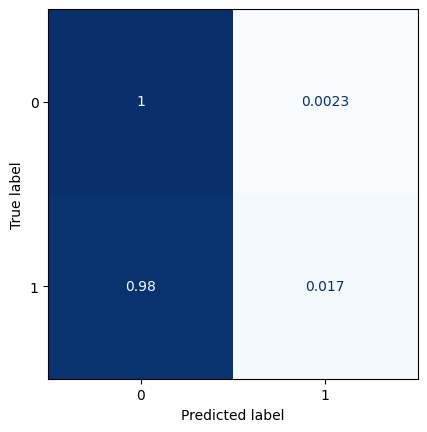

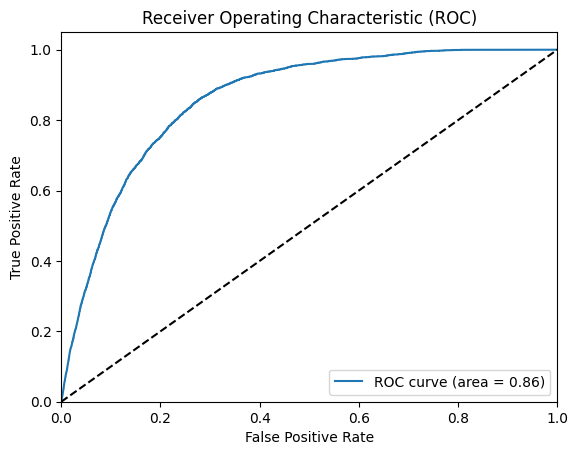

All zeros Brier score: 0.0035468228368504906
Model Brier score: 0.003561573231485428
77/77 [==============================] - 3s 34ms/step


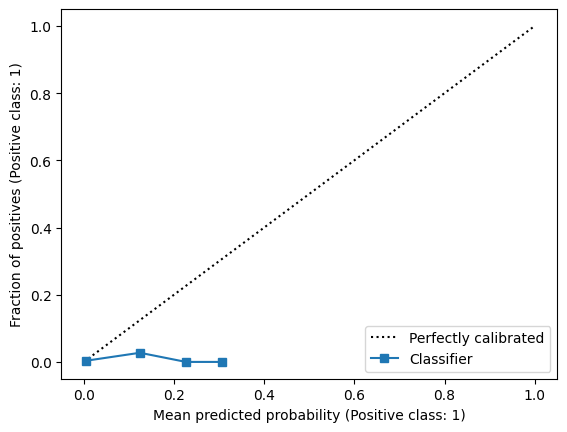

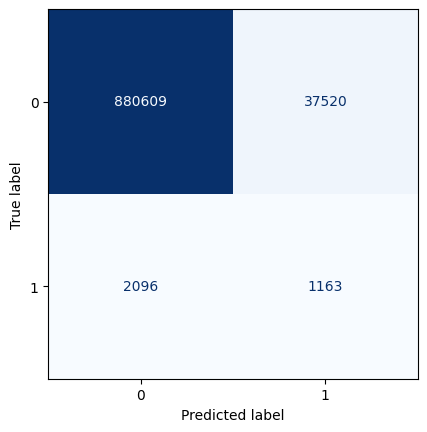

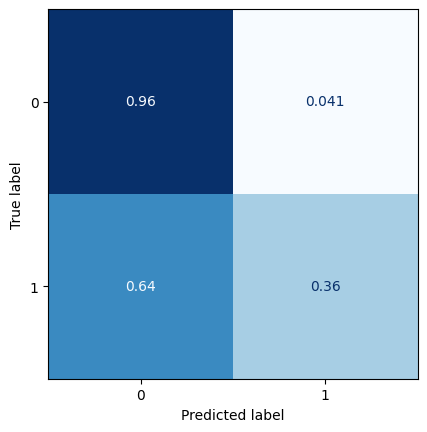

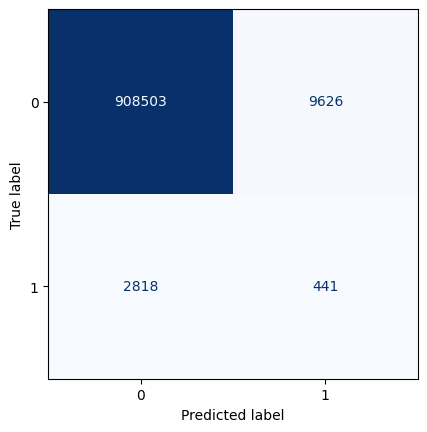

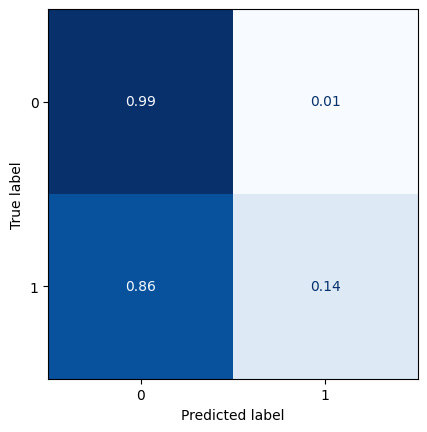

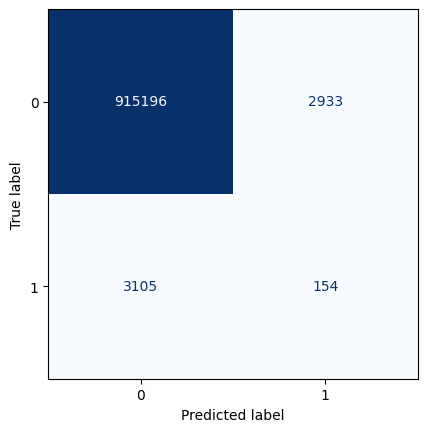

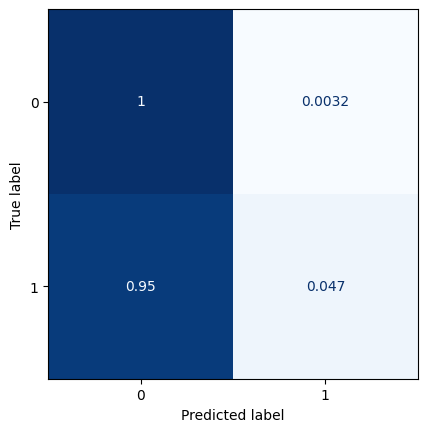

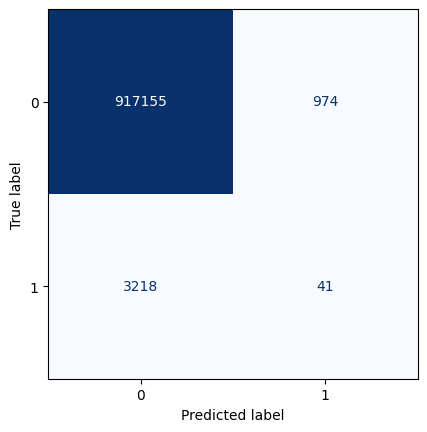

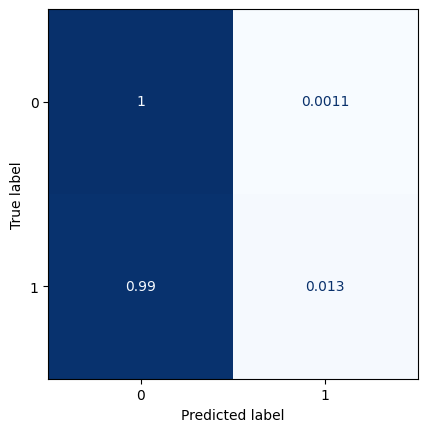

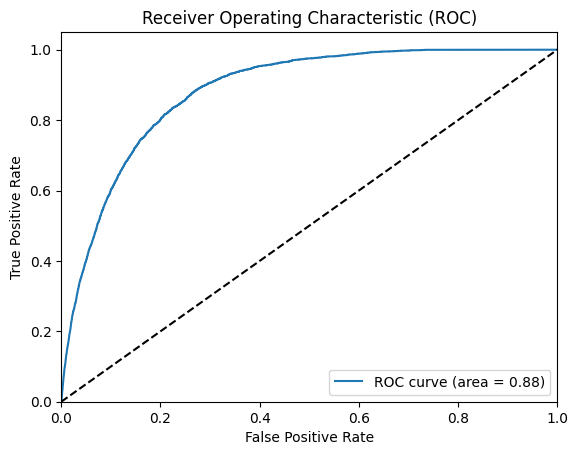

All zeros Brier score: 0.00353705496490078
Model Brier score: 0.00349286053720078
77/77 [==============================] - 3s 40ms/step


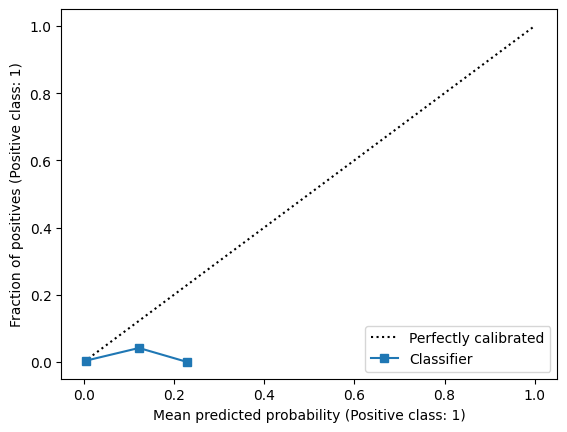

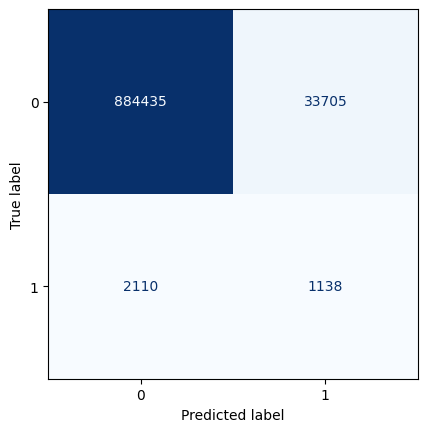

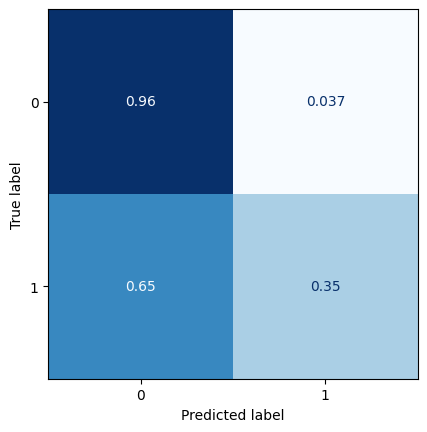

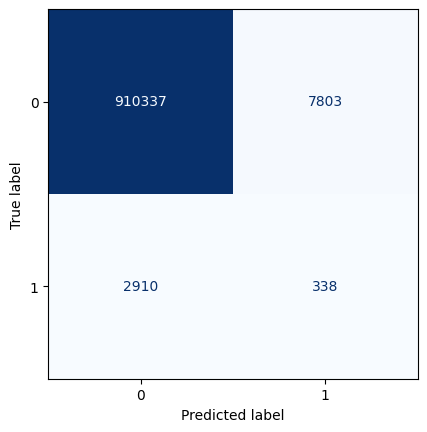

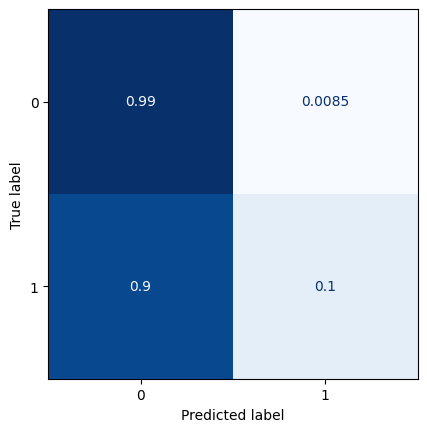

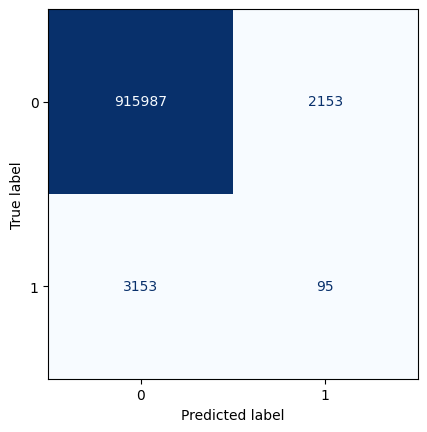

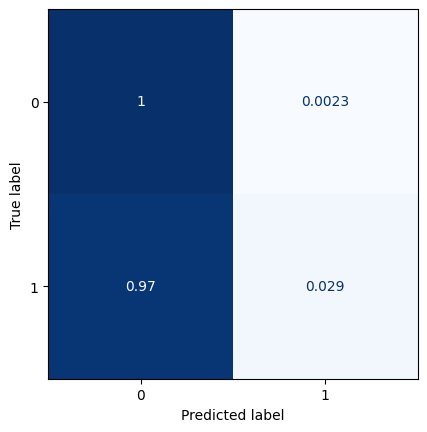

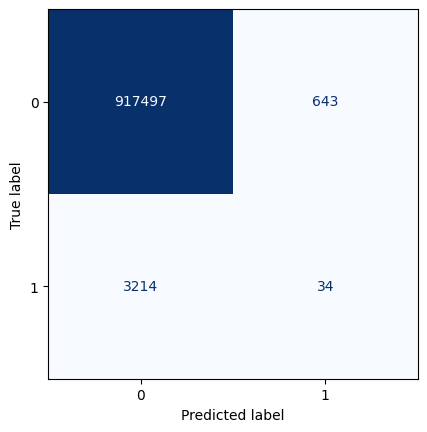

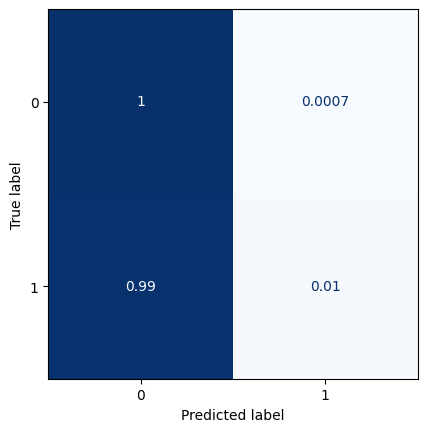

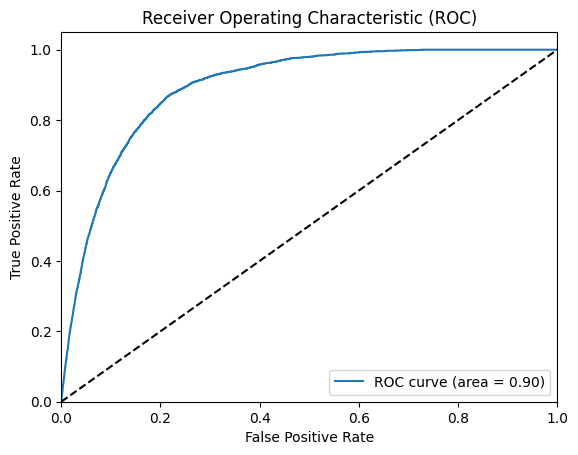

All zeros Brier score: 0.0035251164547400226
Model Brier score: 0.0034694872188291695
77/77 [==============================] - 3s 34ms/step


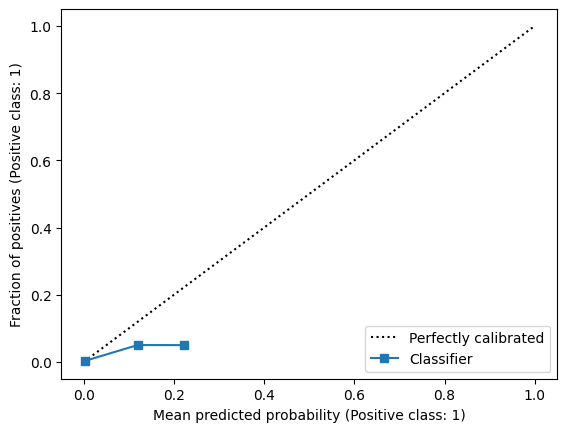

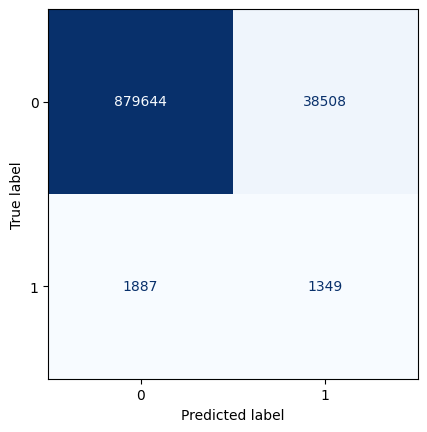

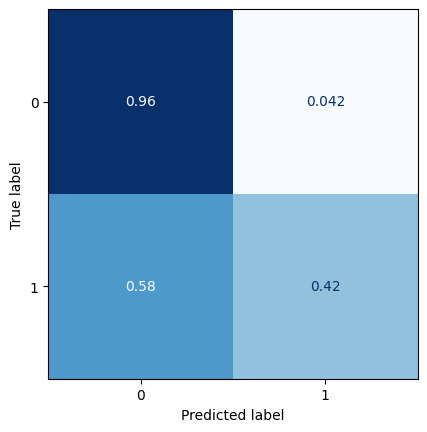

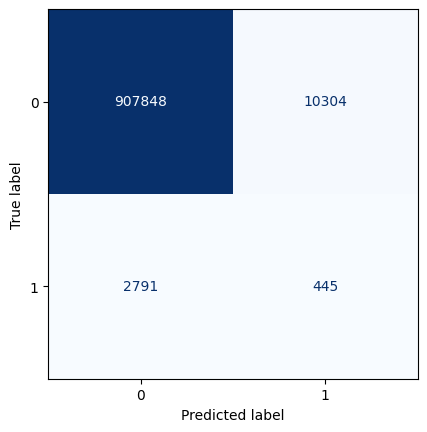

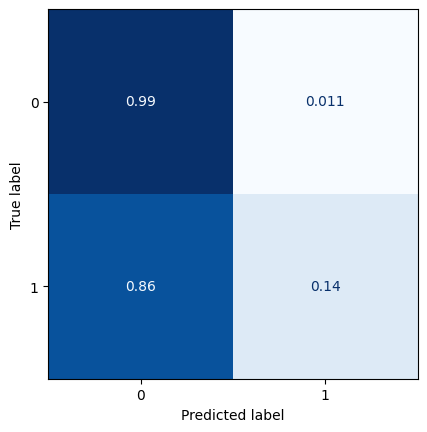

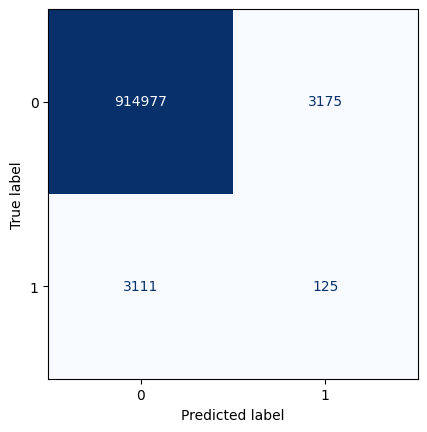

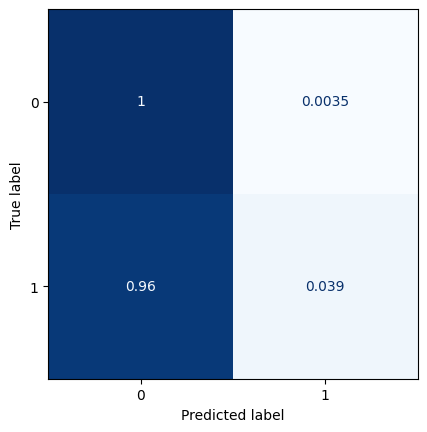

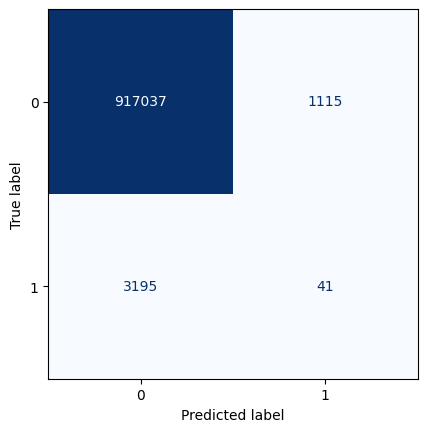

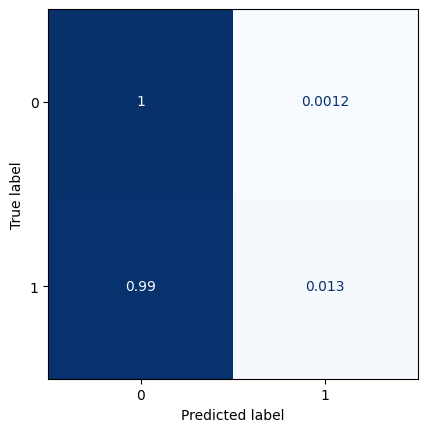

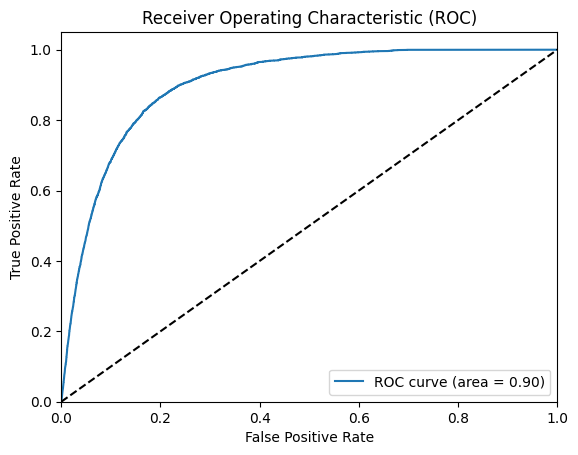

All zeros Brier score: 0.003512092625473742
Model Brier score: 0.003458612524189016
77/77 [==============================] - 3s 35ms/step


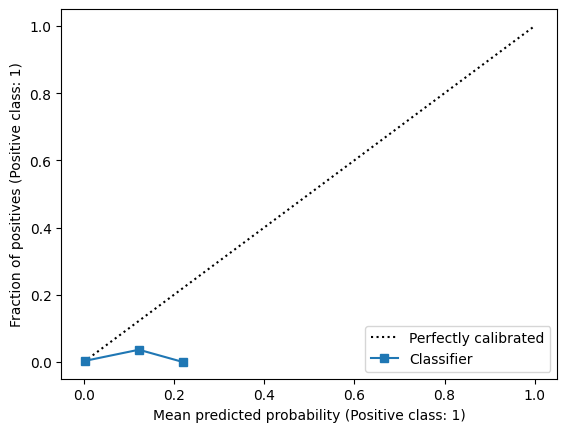

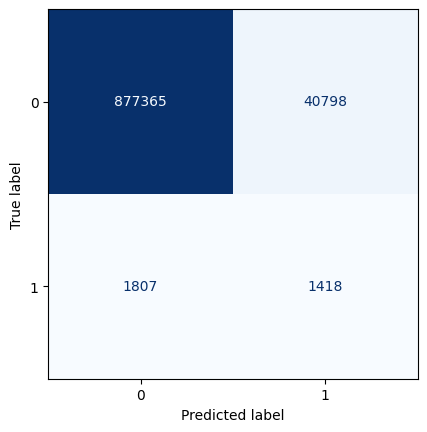

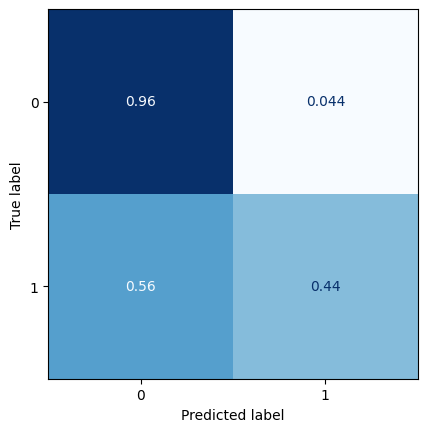

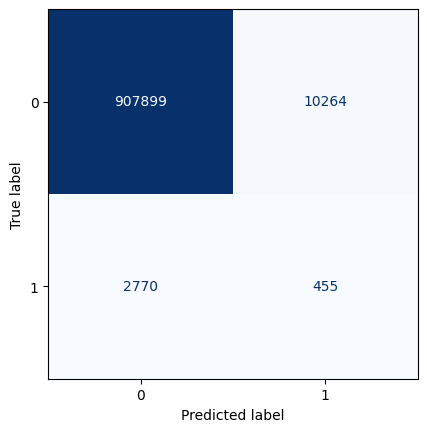

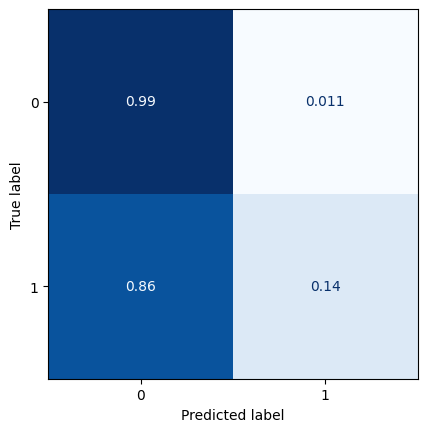

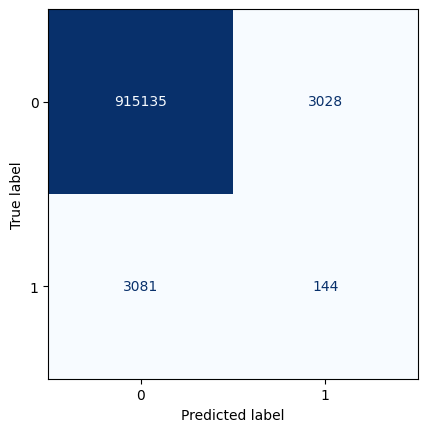

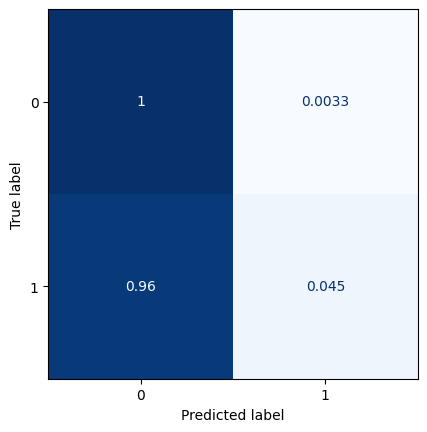

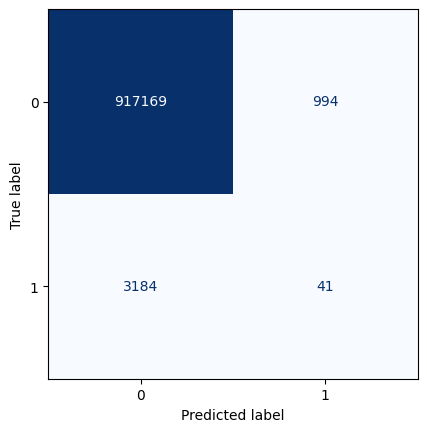

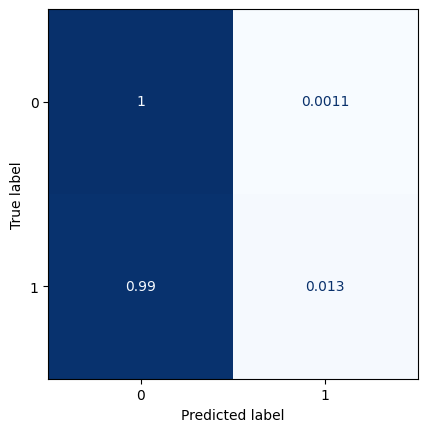

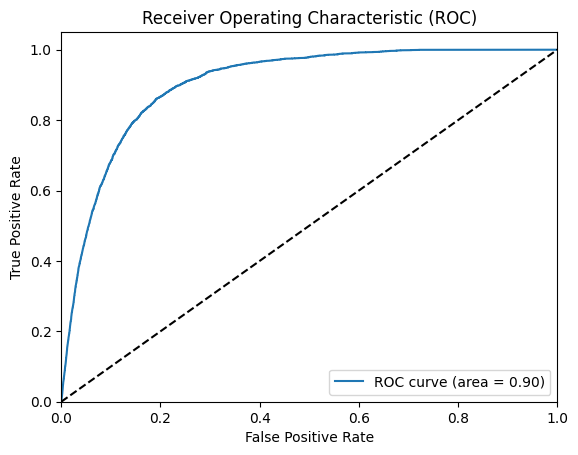

All zeros Brier score: 0.0035001541153129845
Model Brier score: 0.0034439238768172752
77/77 [==============================] - 3s 32ms/step


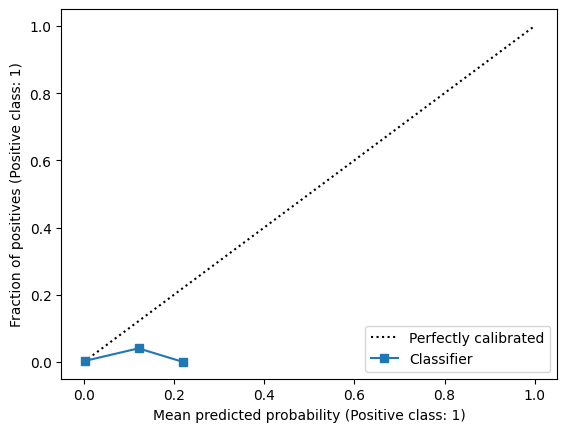

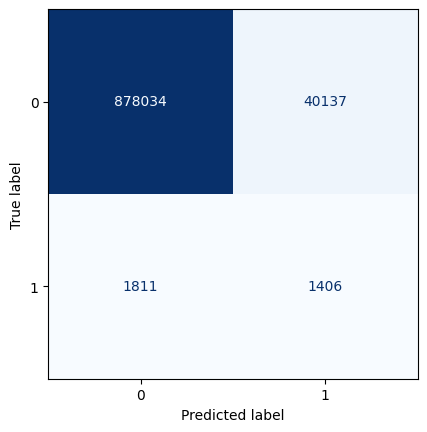

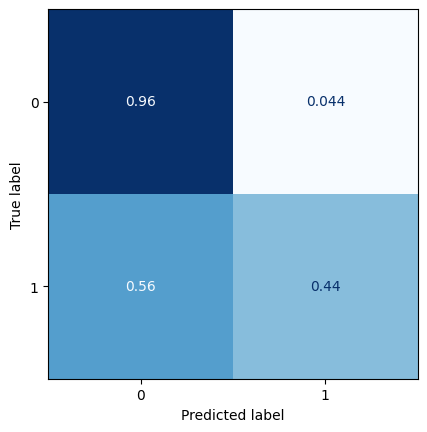

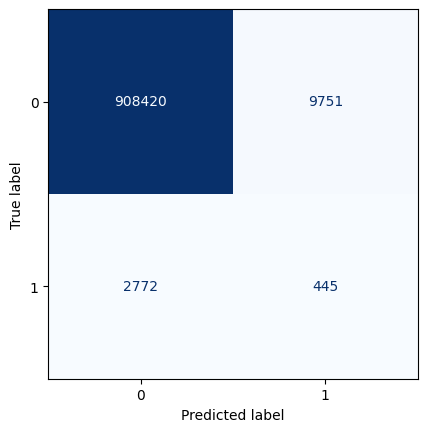

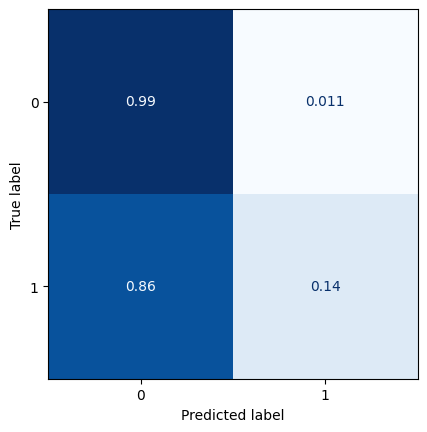

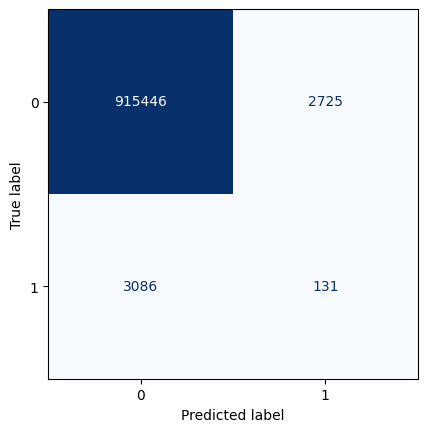

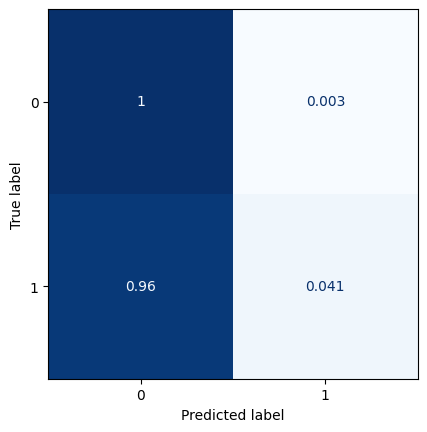

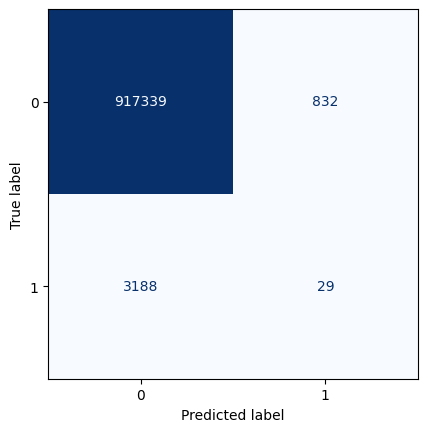

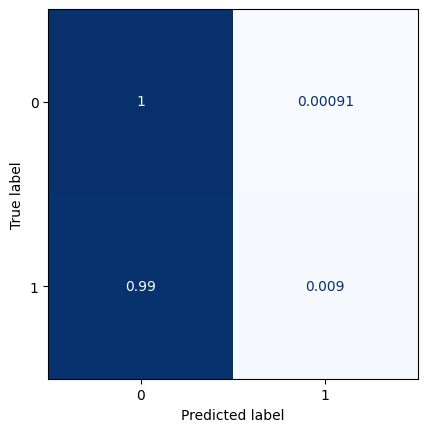

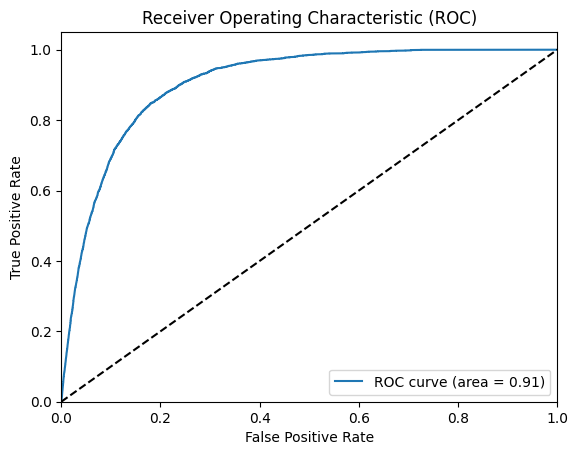

All zeros Brier score: 0.003491471562468797
Model Brier score: 0.0034319734379077175
77/77 [==============================] - 3s 32ms/step


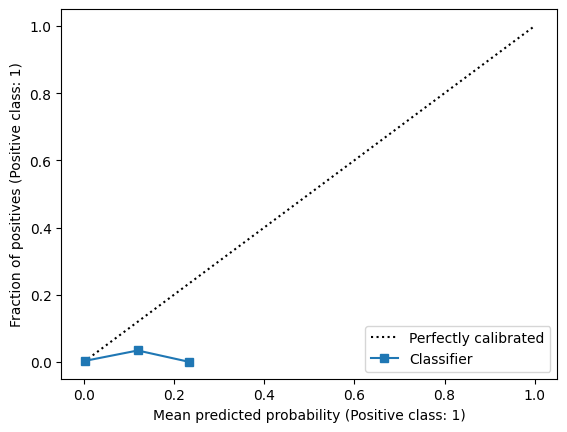

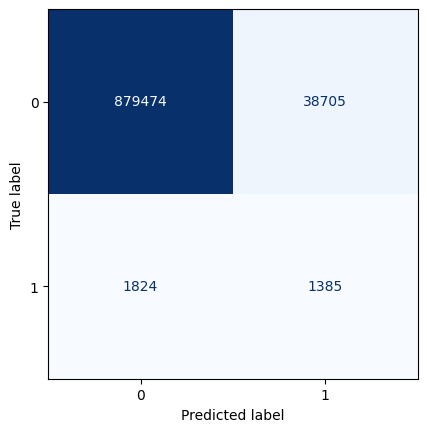

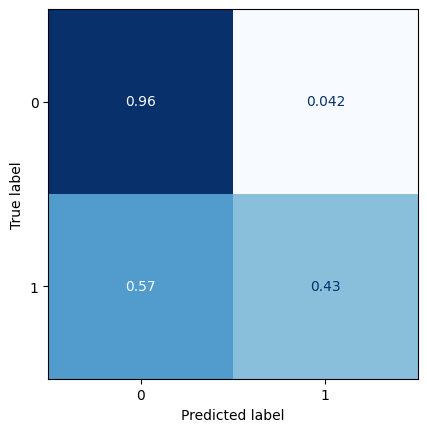

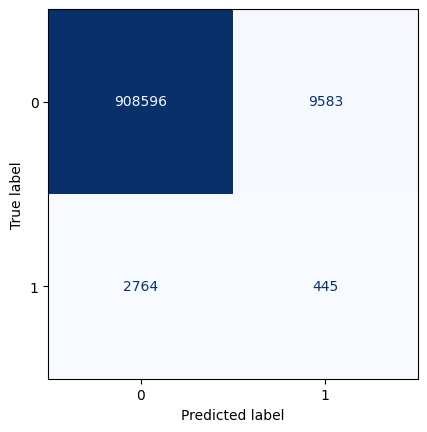

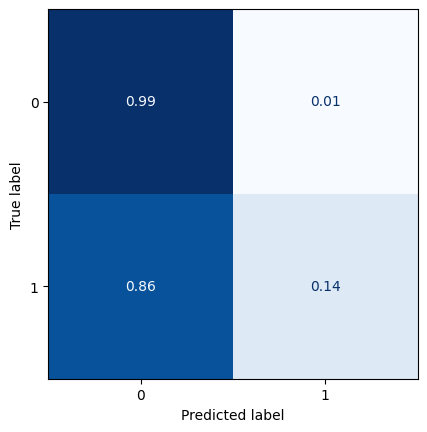

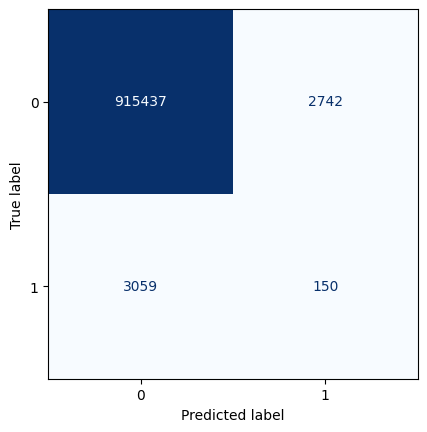

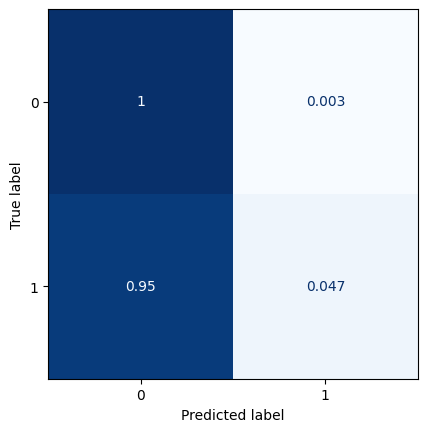

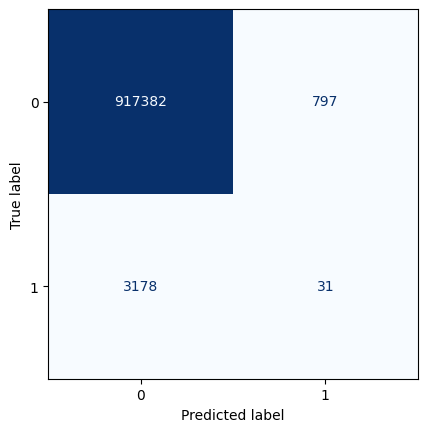

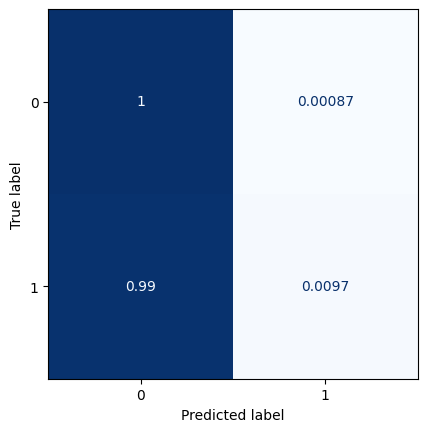

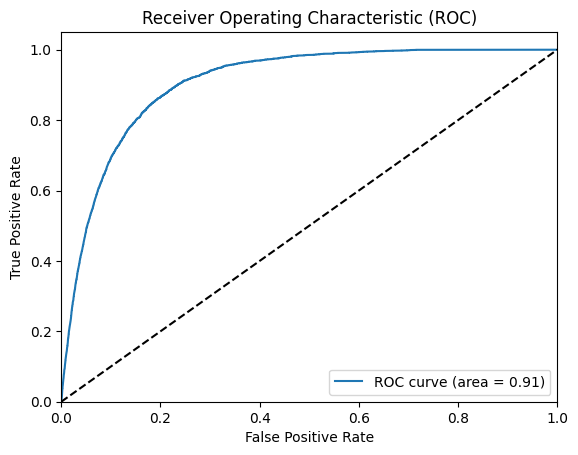

All zeros Brier score: 0.0034827890096246097
Model Brier score: 0.003420662506089013
77/77 [==============================] - 2s 31ms/step


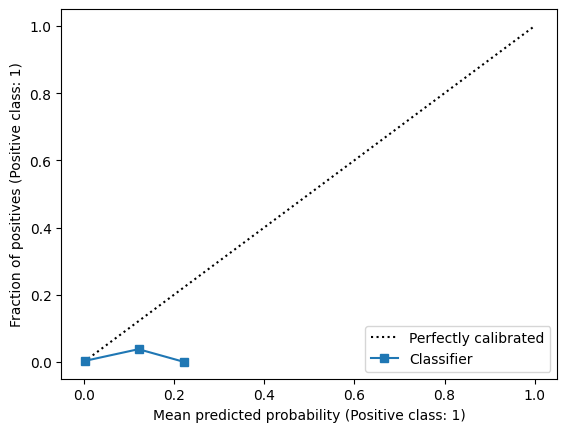

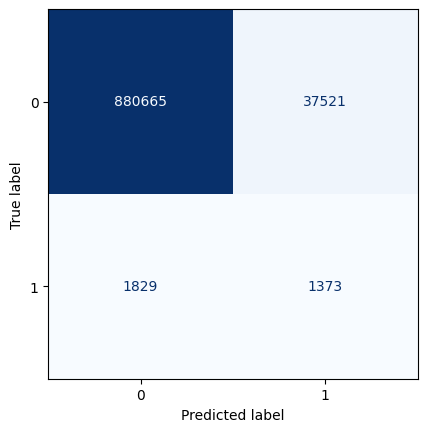

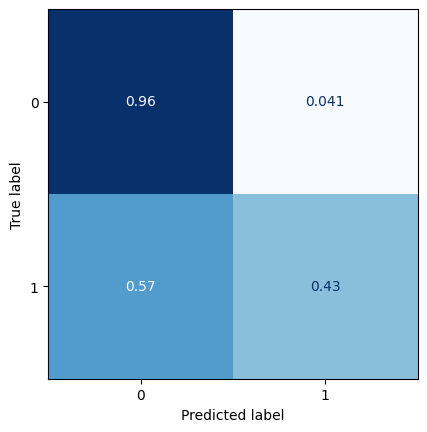

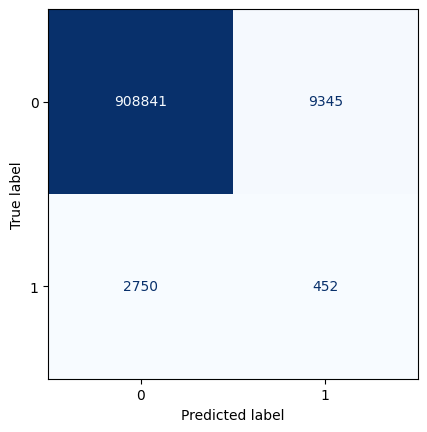

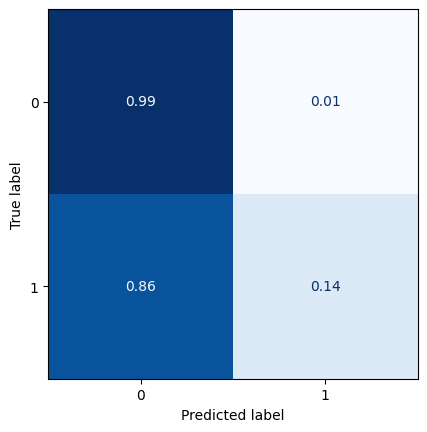

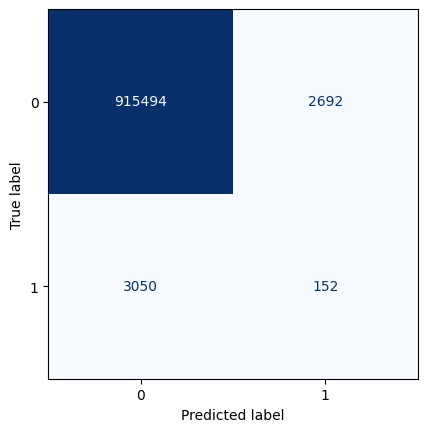

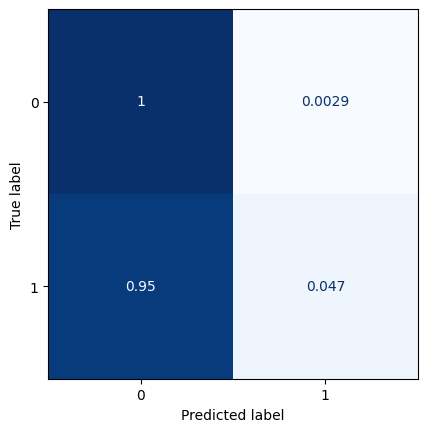

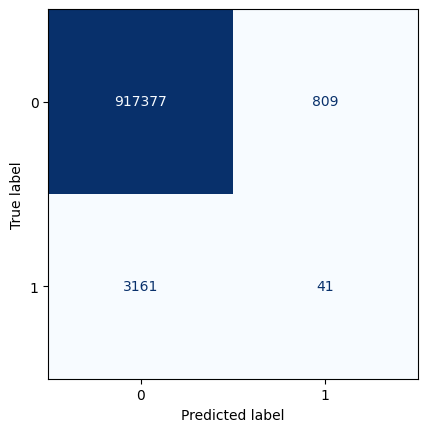

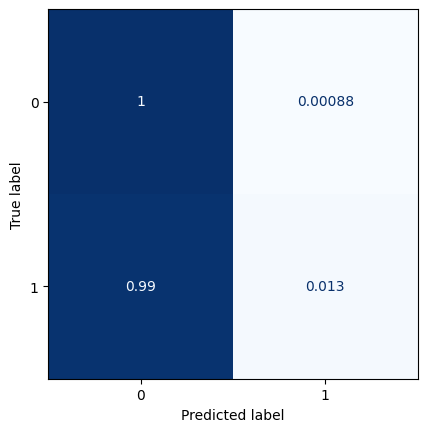

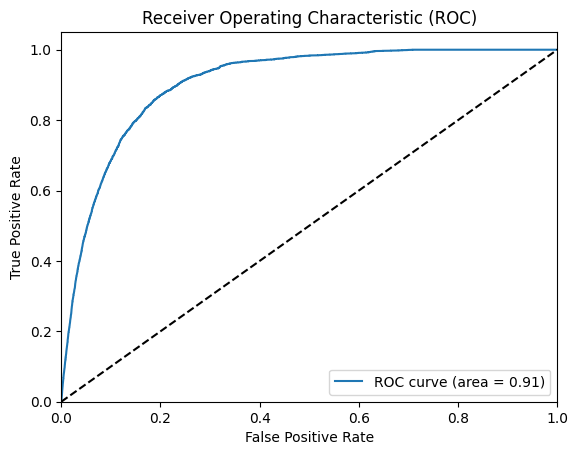

All zeros Brier score: 0.003475191775885946
Model Brier score: 0.0034110815933335033
77/77 [==============================] - 3s 31ms/step


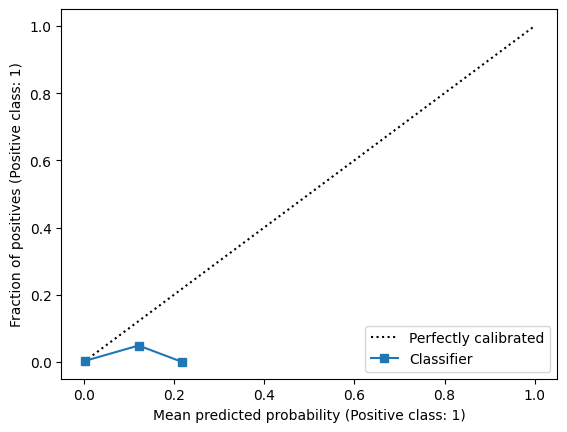

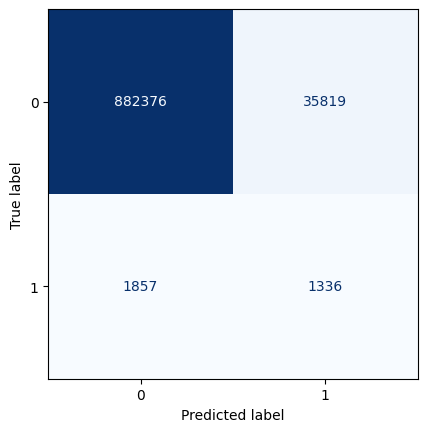

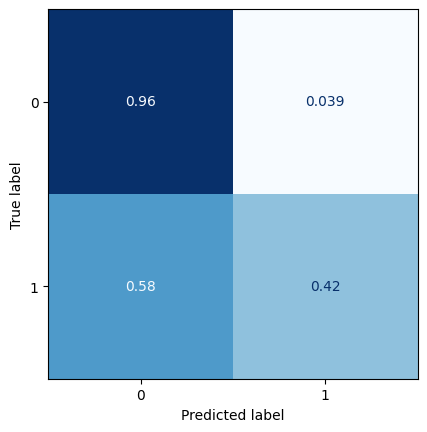

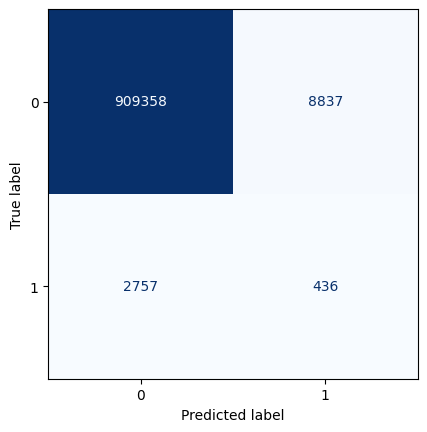

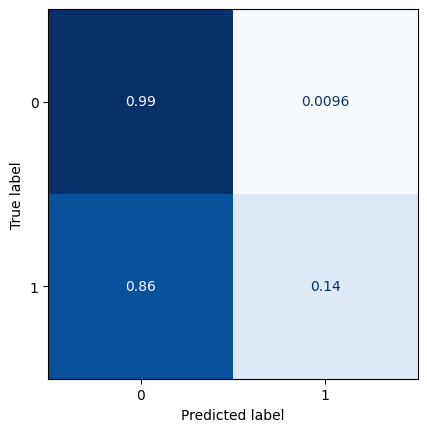

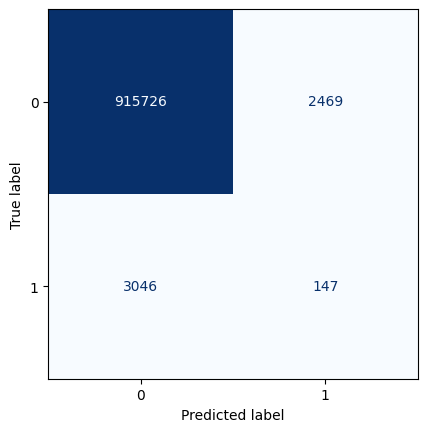

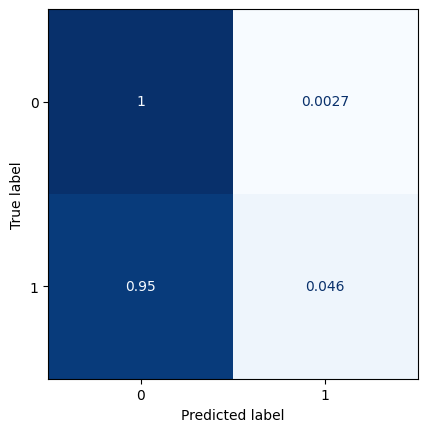

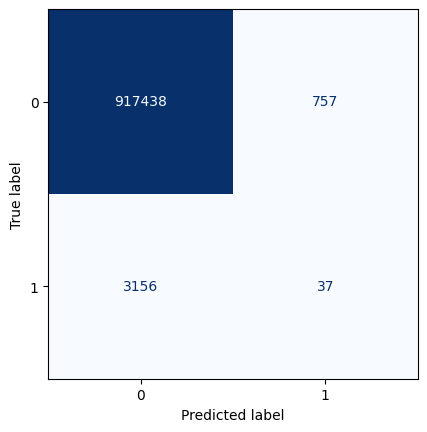

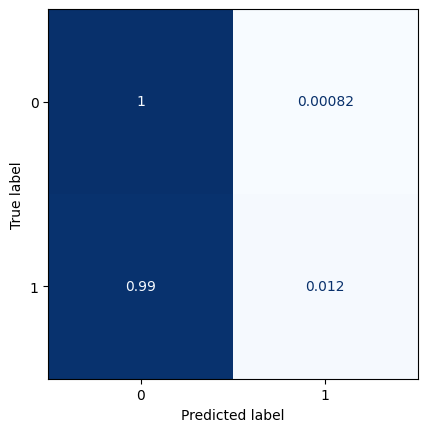

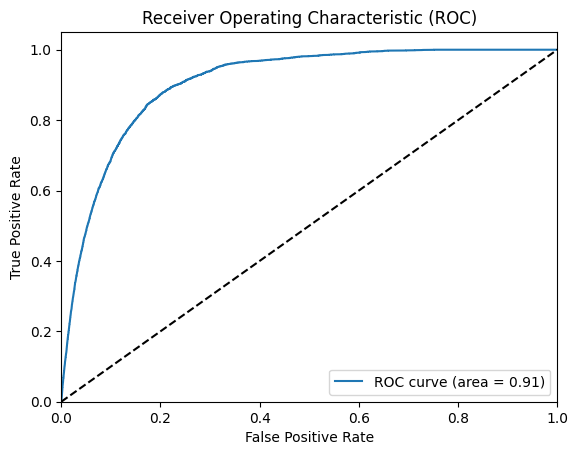

All zeros Brier score: 0.0034654239039362354
Model Brier score: 0.003399965424147091
77/77 [==============================] - 3s 33ms/step


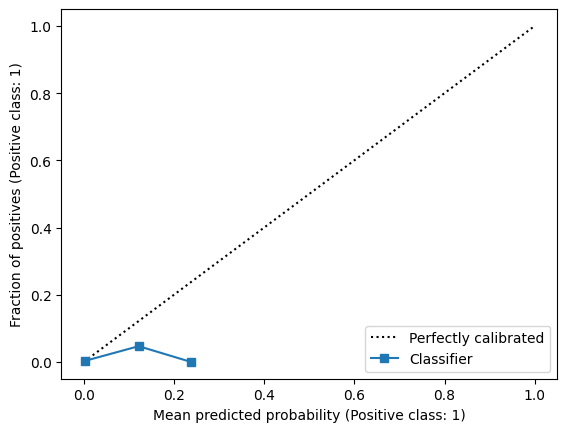

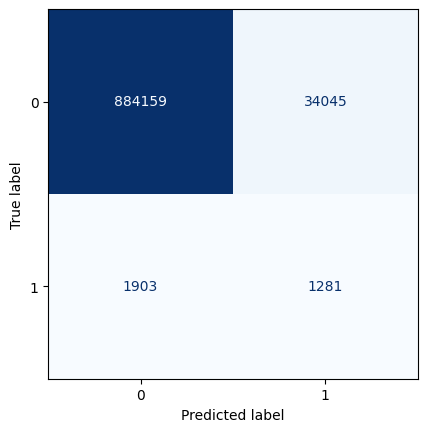

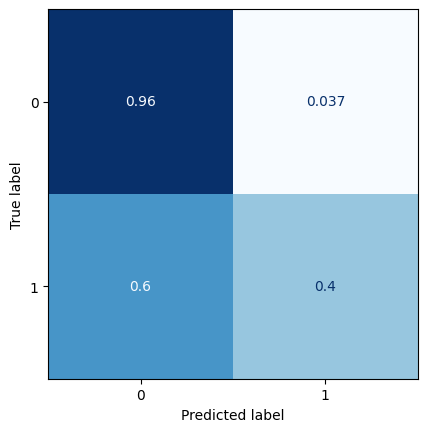

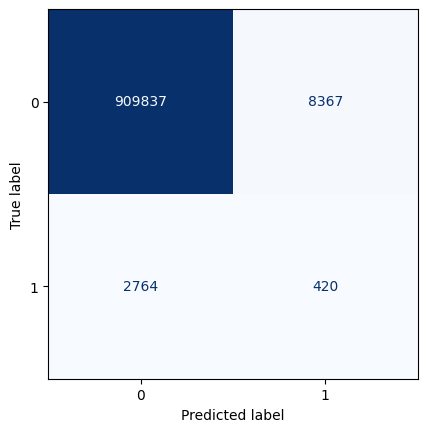

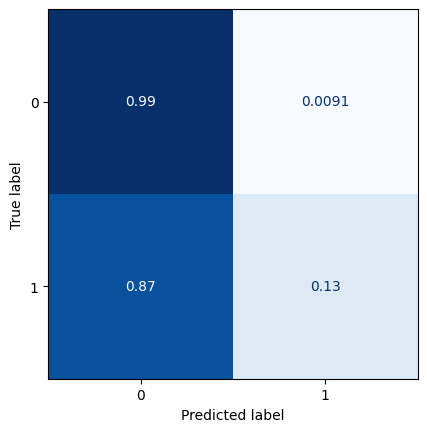

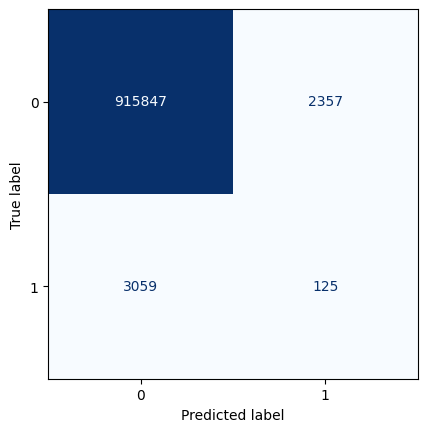

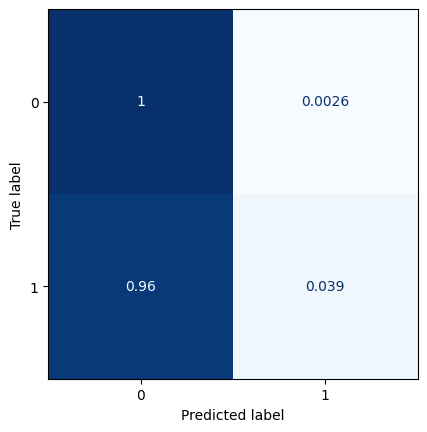

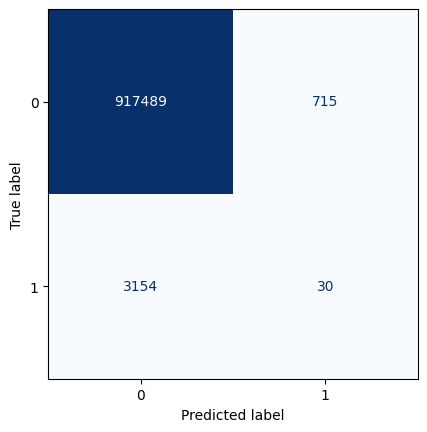

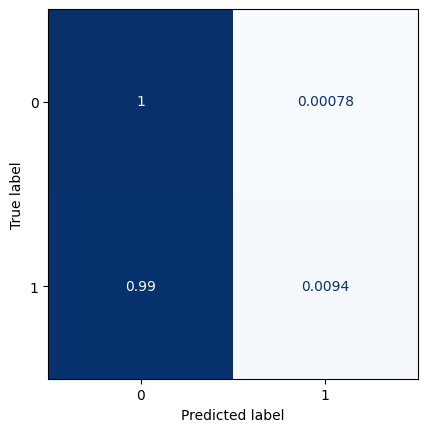

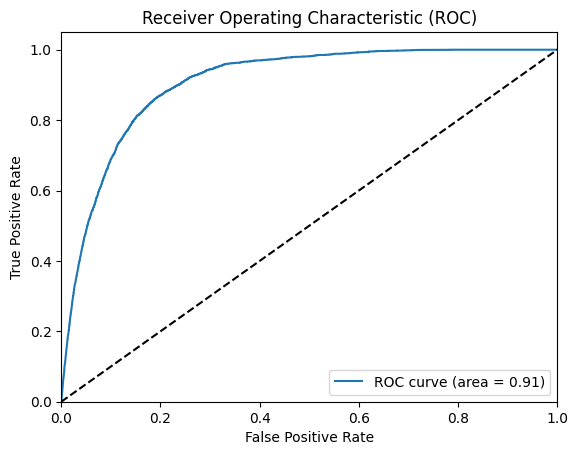

All zeros Brier score: 0.0034556560319865246
Model Brier score: 0.0033907058890636863
77/77 [==============================] - 3s 36ms/step


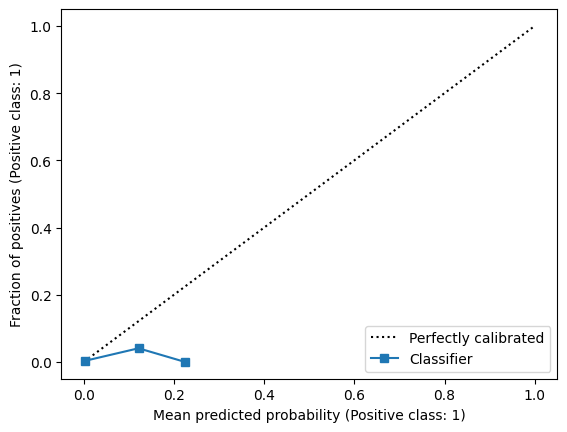

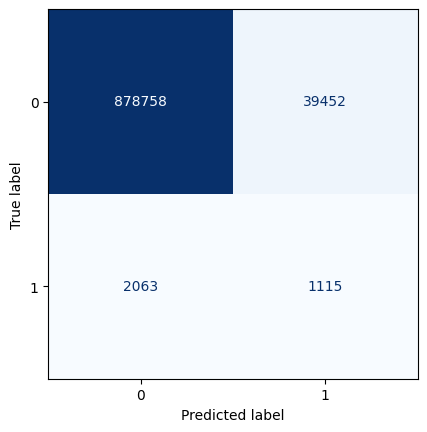

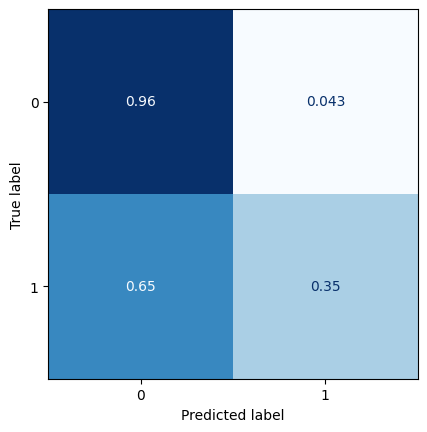

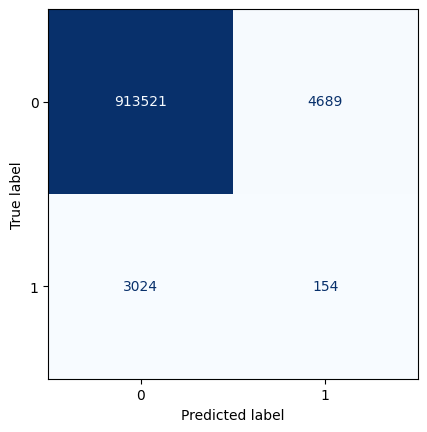

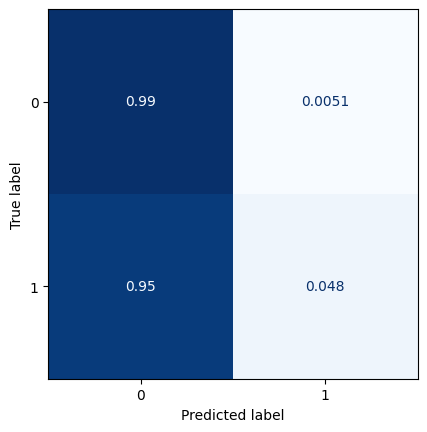

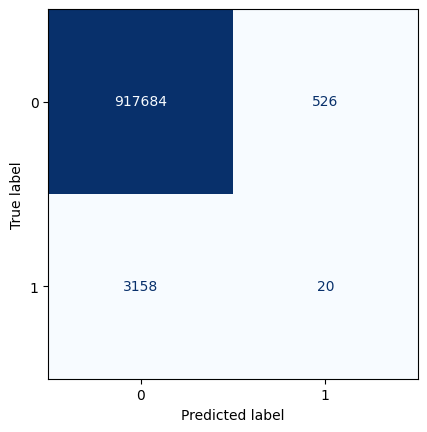

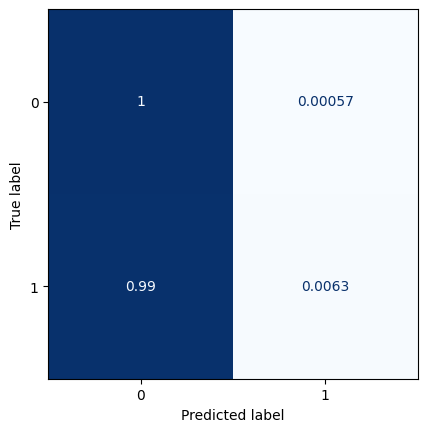

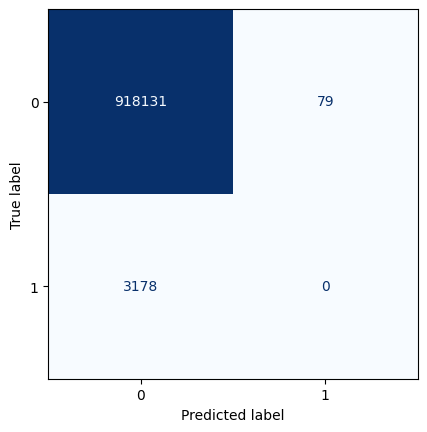

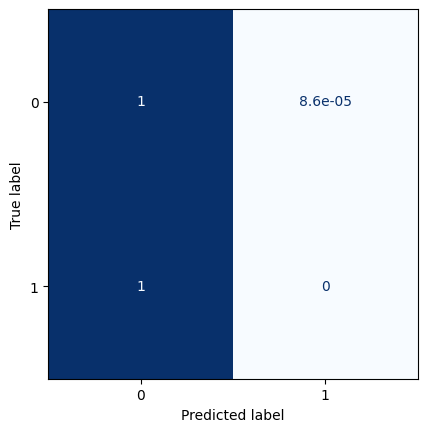

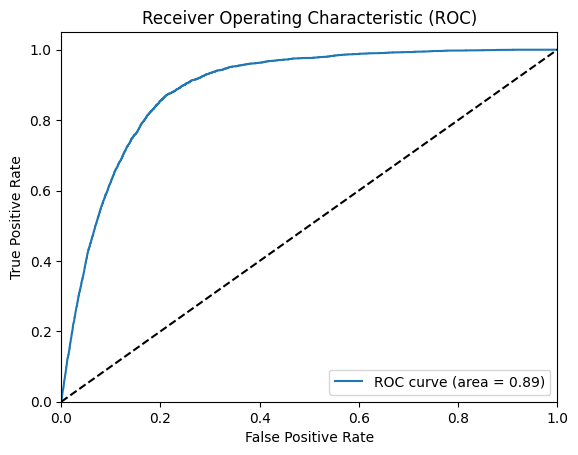

All zeros Brier score: 0.0034491441173533843
Model Brier score: 0.0033995653902783854
Model: "model_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_43 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_28 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 03:32:37.055659: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.1360

2023-04-09 03:34:24.691709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 113s 2s/step - loss: 0.1360 - val_loss: 0.0375 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 72s 2s/step - loss: 0.0333 - val_loss: 0.0284 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 69s 2s/step - loss: 0.0281 - val_loss: 0.0259 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 69s 2s/step - loss: 0.0263 - val_loss: 0.0246 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 73s 2s/step - loss: 0.0252 - val_loss: 0.0239 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 89s 2s/step - loss: 0.0245 - val_loss: 0.0233 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 72s 2s/step - loss: 0.0240 - val_loss: 0.0229 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 74s 2s/step - loss: 0.0236 - val_loss: 0.0227 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 65s 1s/step - loss: 0.0232 - val_loss: 0.0222 - lr: 0.0010
Epo

2023-04-09 04:22:38.278373: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 5s 45ms/step


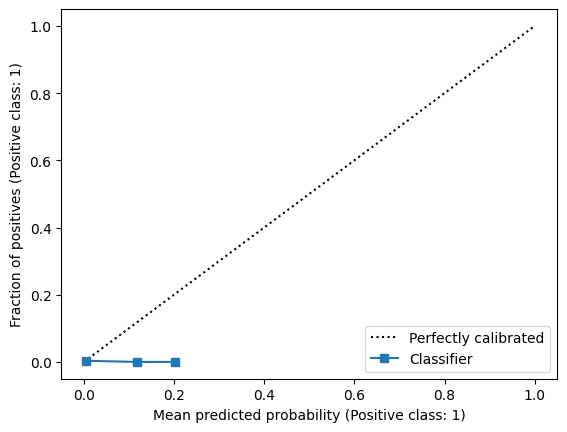

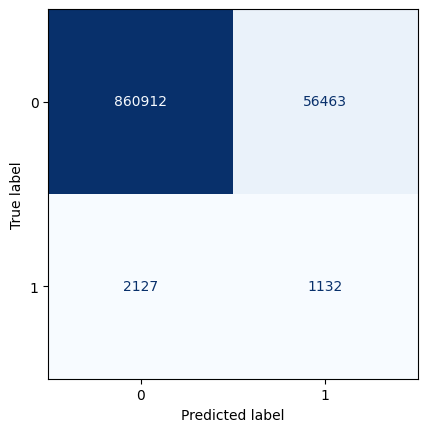

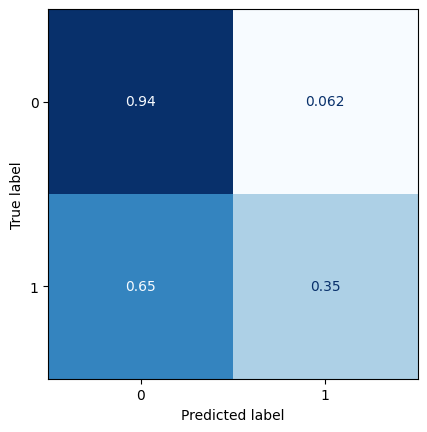

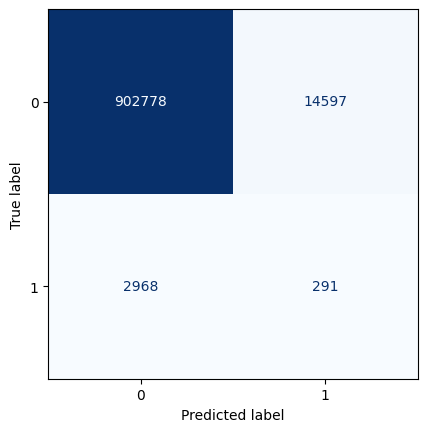

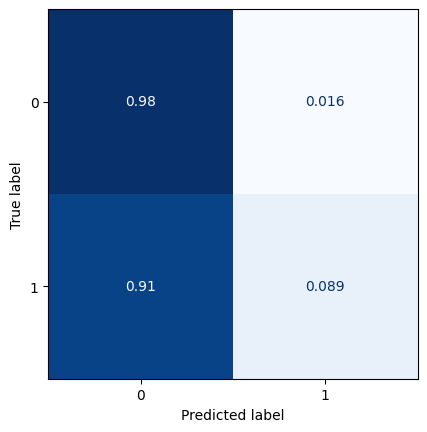

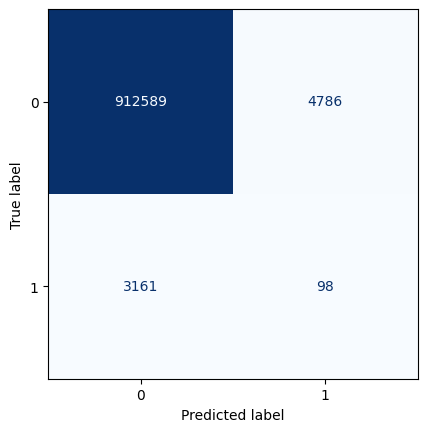

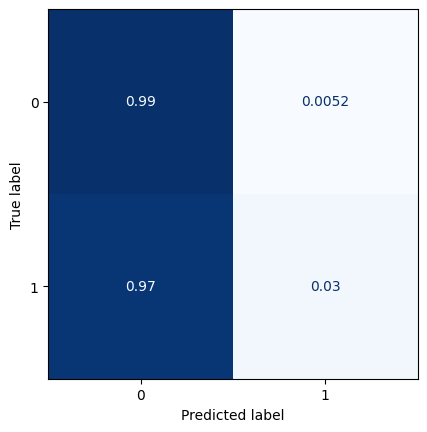

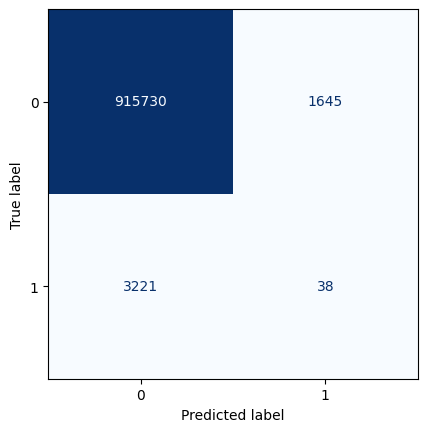

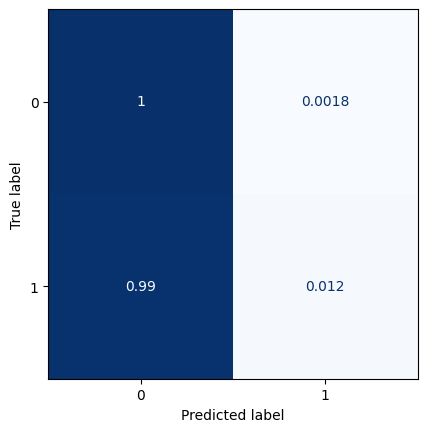

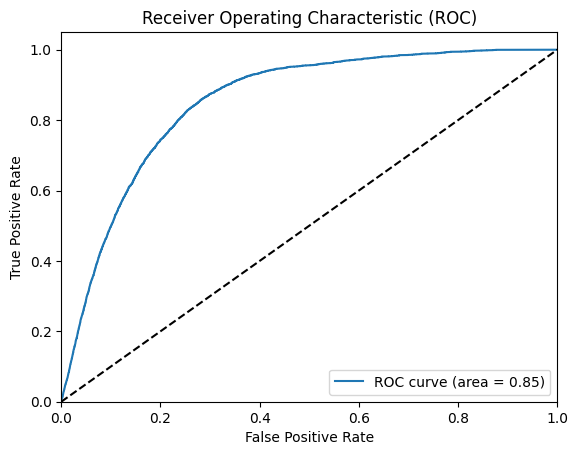

All zeros Brier score: 0.0035399518158138847
Model Brier score: 0.0035644353568325296
77/77 [==============================] - 3s 41ms/step


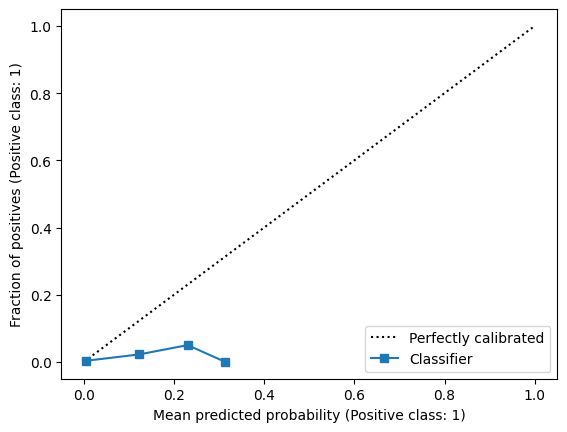

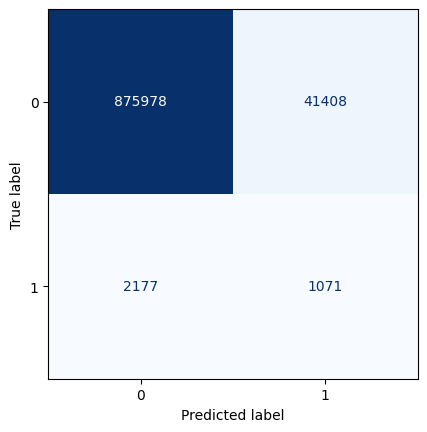

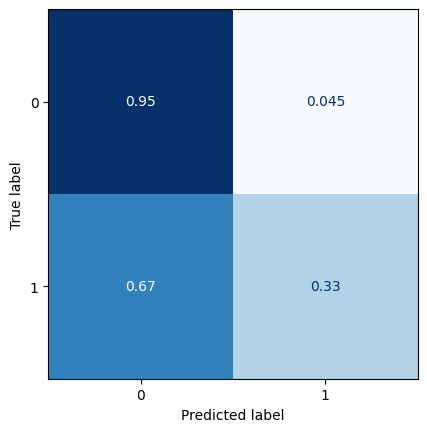

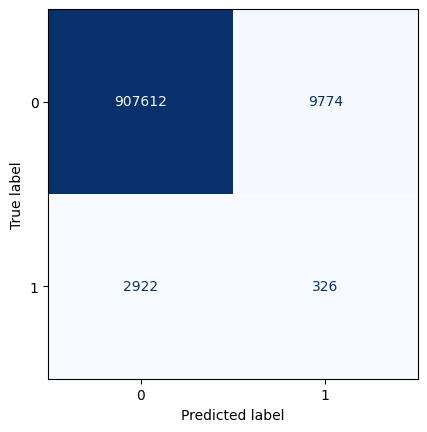

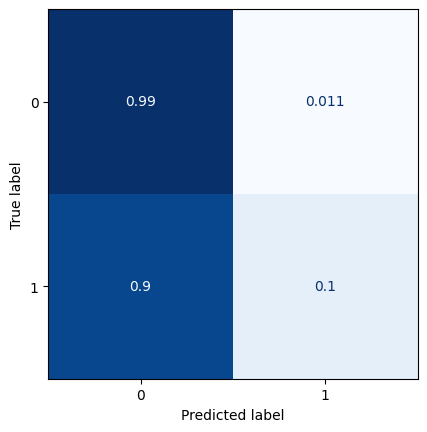

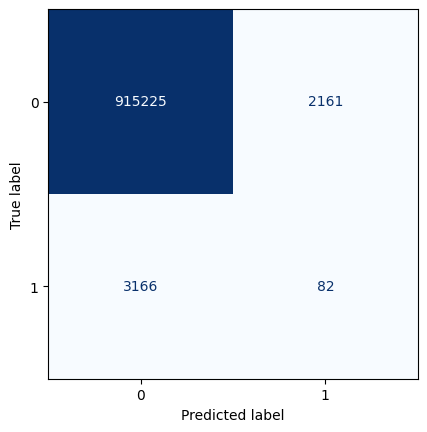

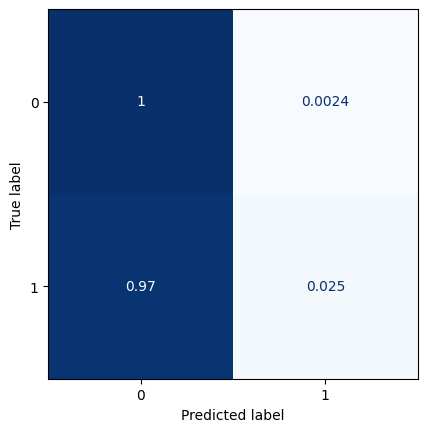

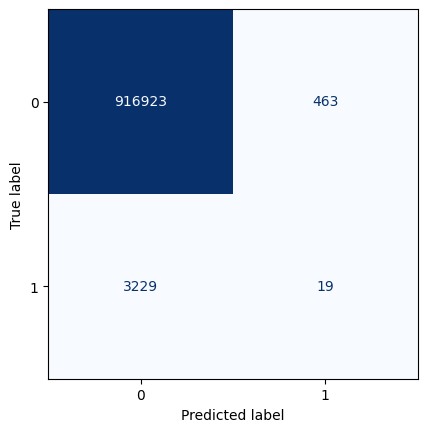

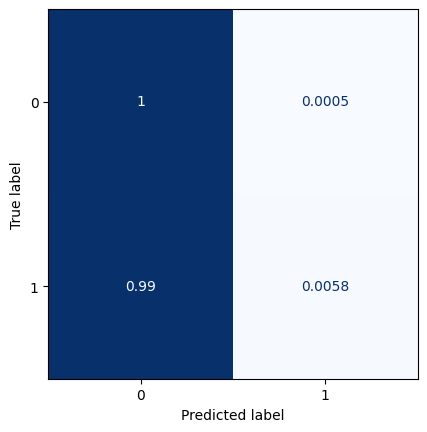

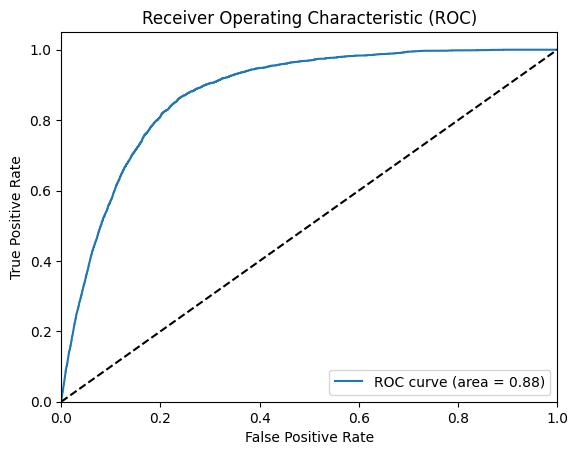

All zeros Brier score: 0.003528003528003528
Model Brier score: 0.0034965822979685893
77/77 [==============================] - 3s 37ms/step


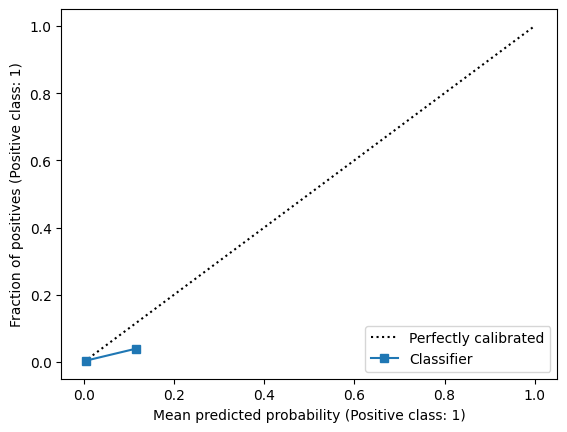

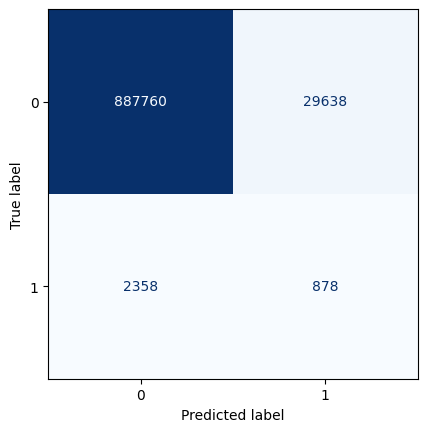

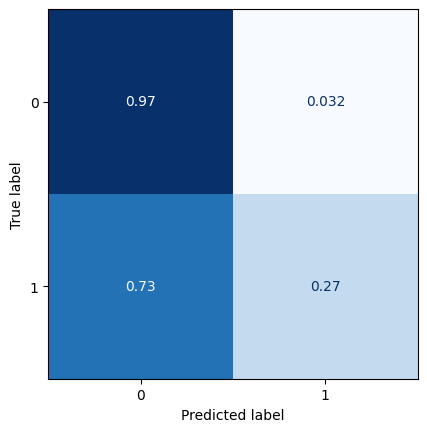

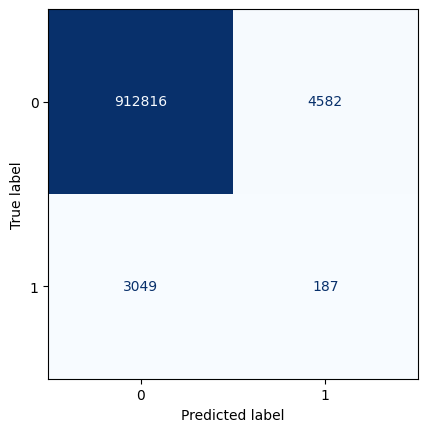

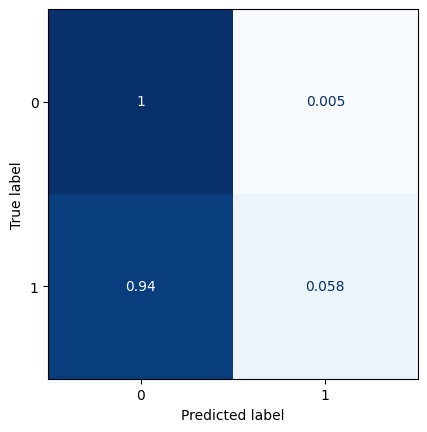

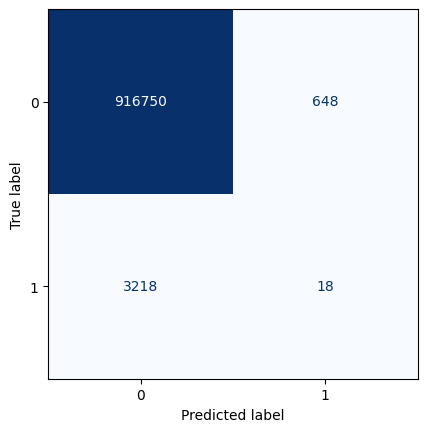

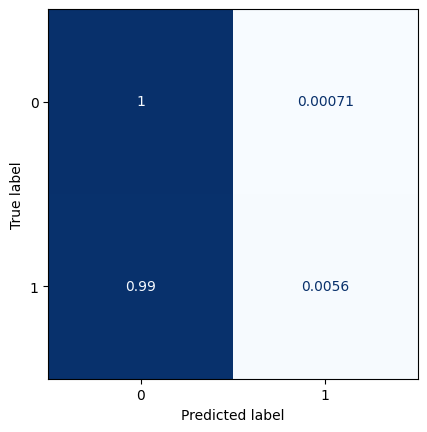

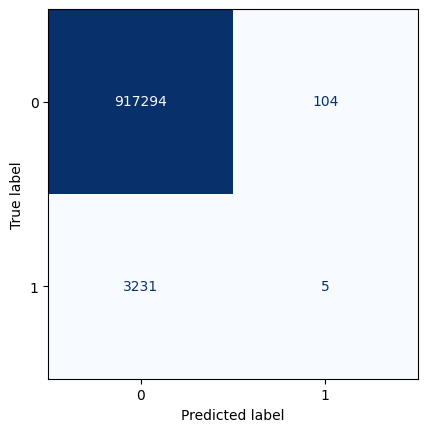

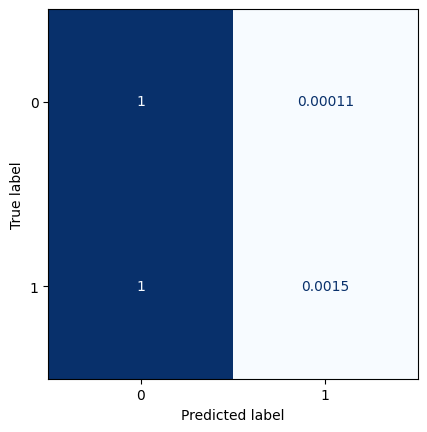

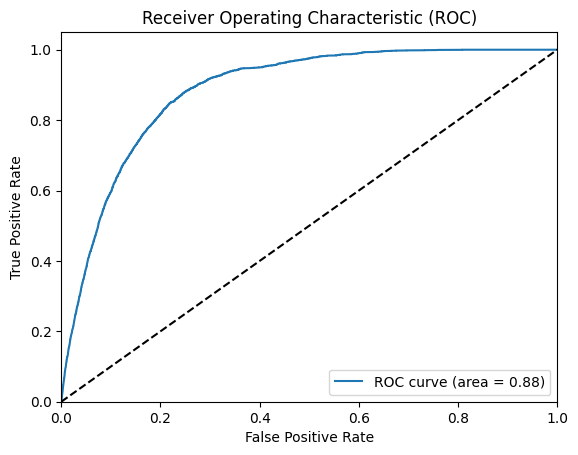

All zeros Brier score: 0.0035149690322104116
Model Brier score: 0.003465004729409023
77/77 [==============================] - 3s 37ms/step


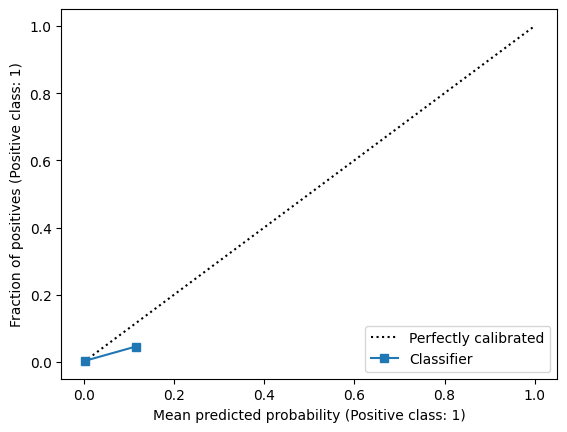

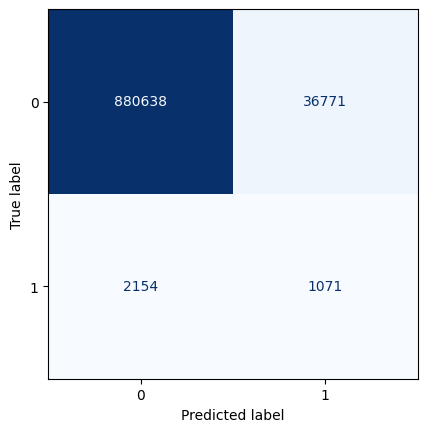

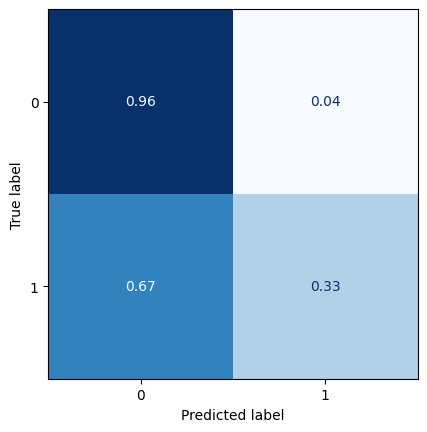

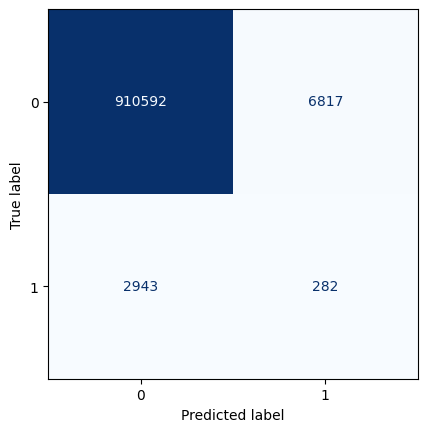

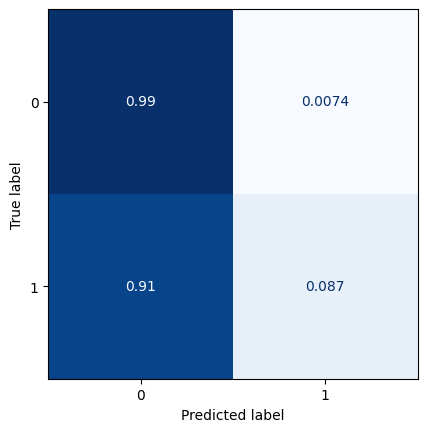

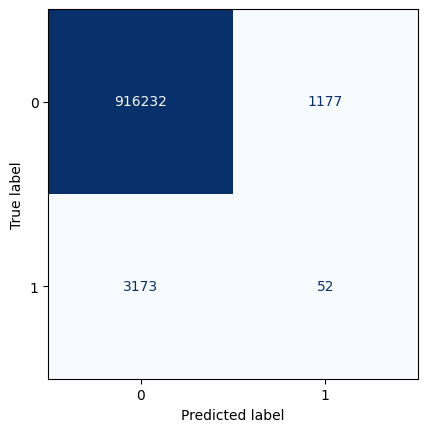

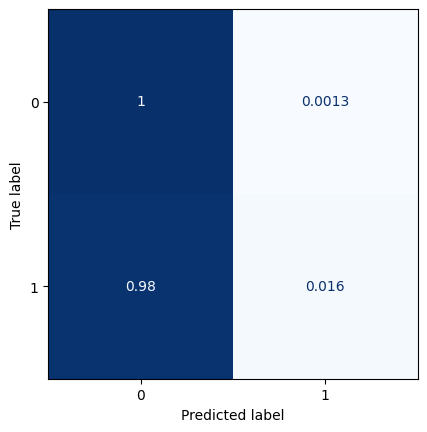

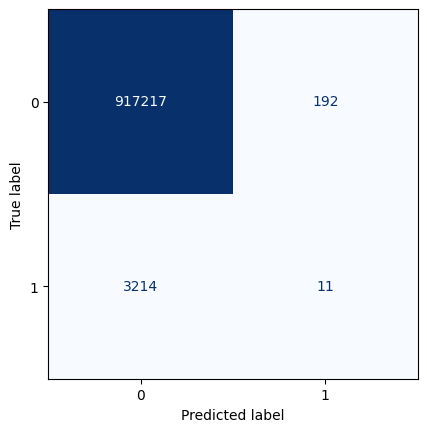

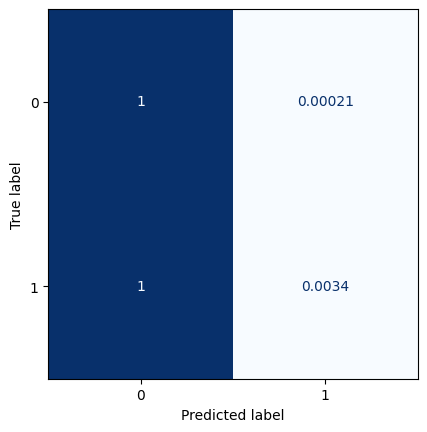

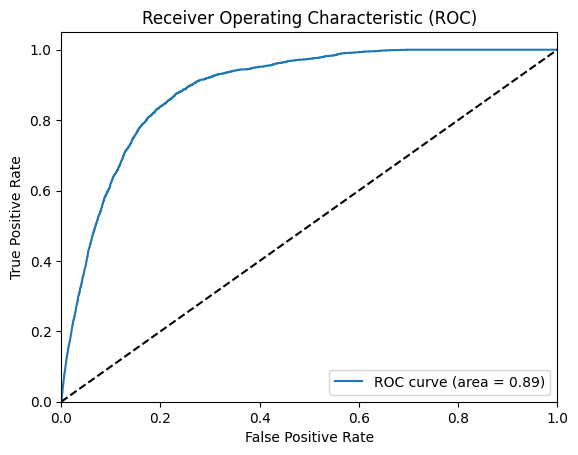

All zeros Brier score: 0.0035030207444000545
Model Brier score: 0.003452165793931891
77/77 [==============================] - 4s 45ms/step


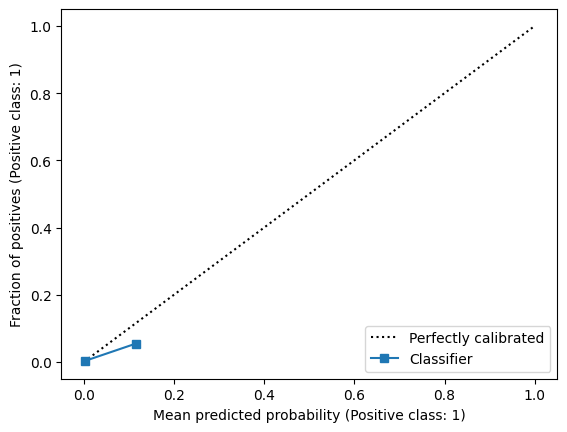

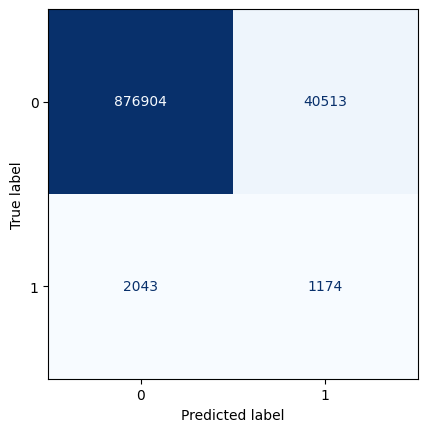

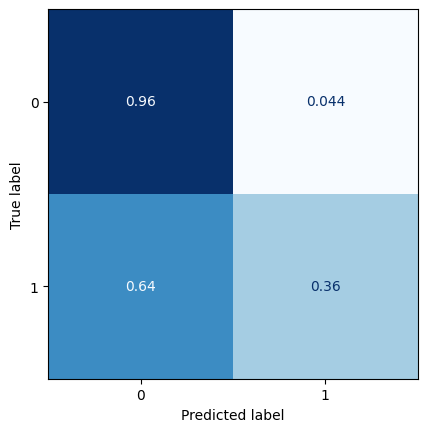

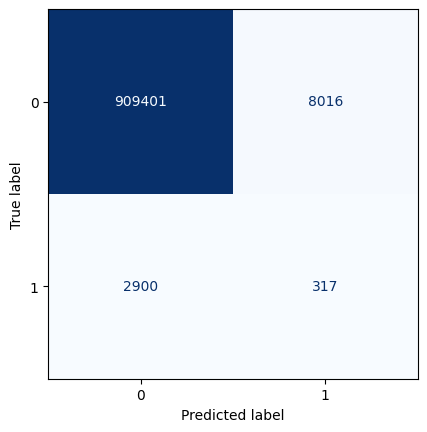

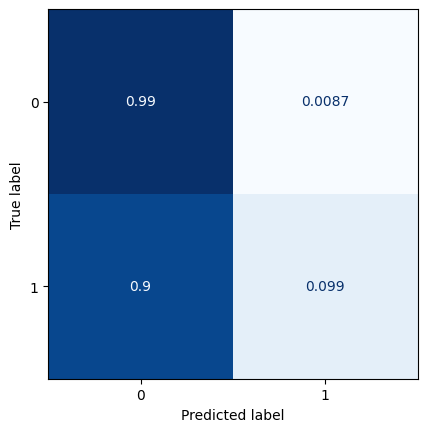

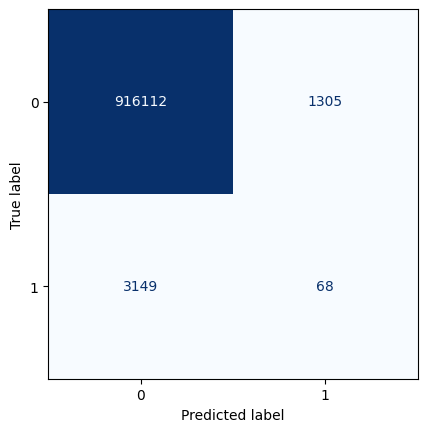

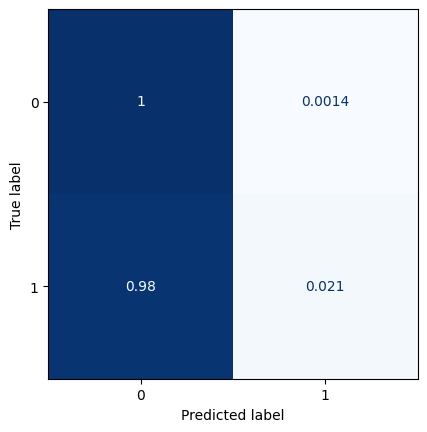

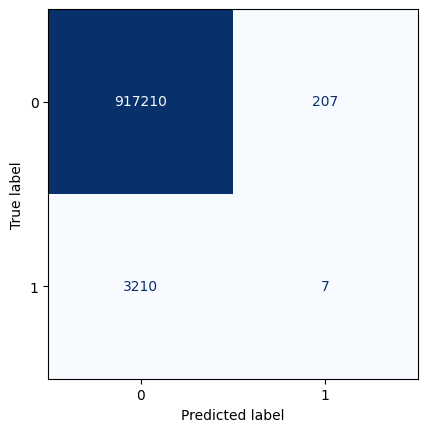

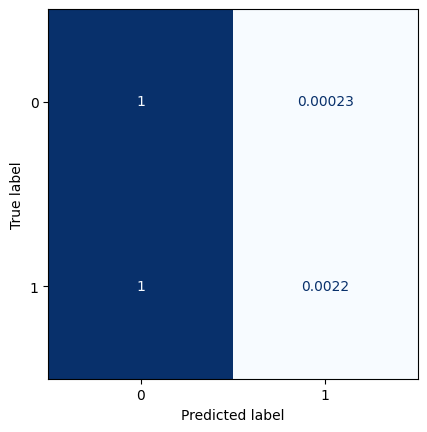

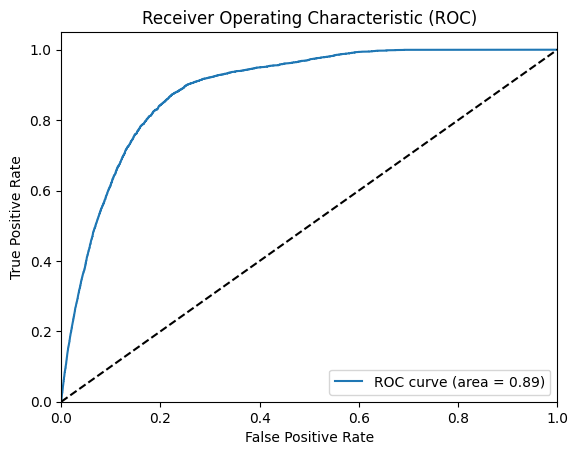

All zeros Brier score: 0.003494331080537977
Model Brier score: 0.0034448187450756714
77/77 [==============================] - 3s 37ms/step


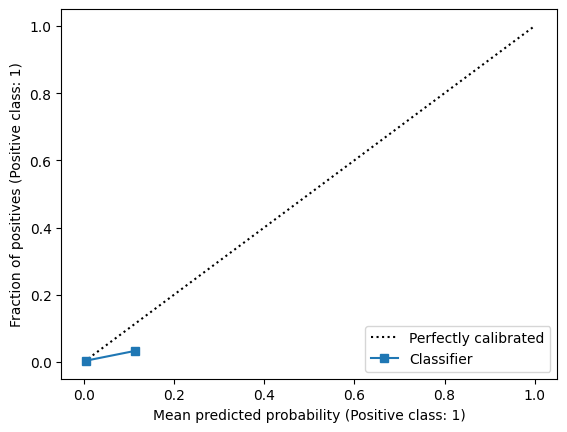

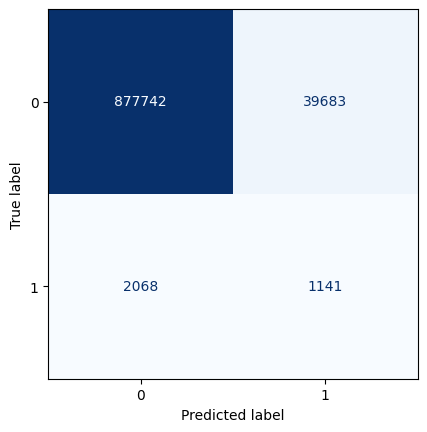

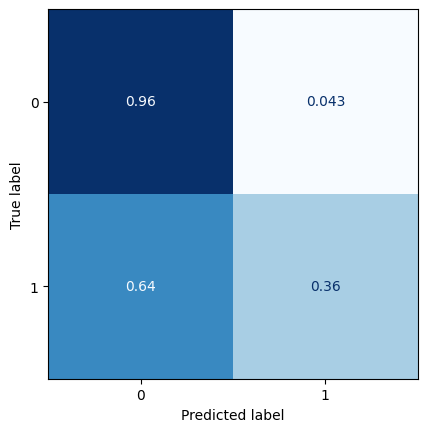

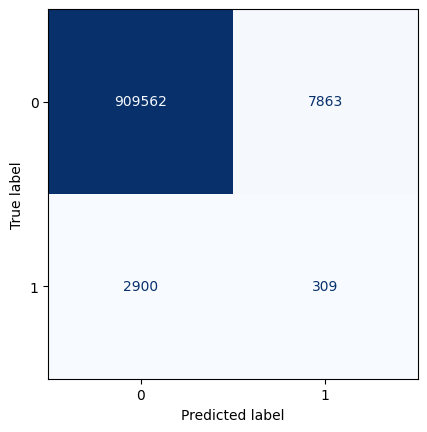

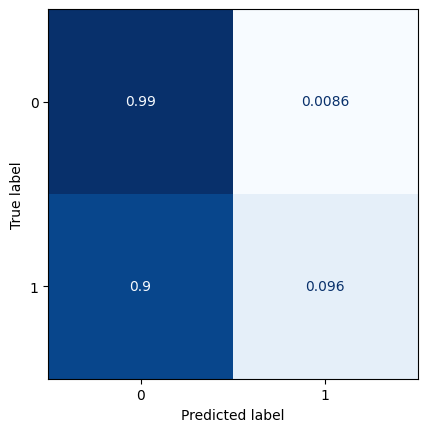

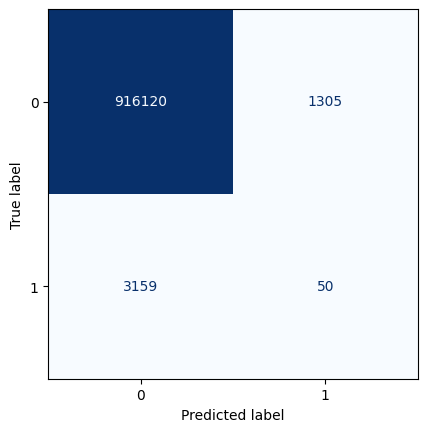

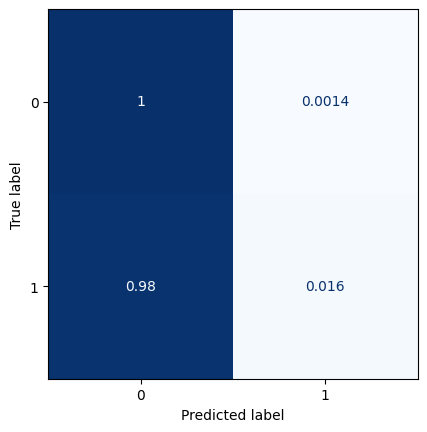

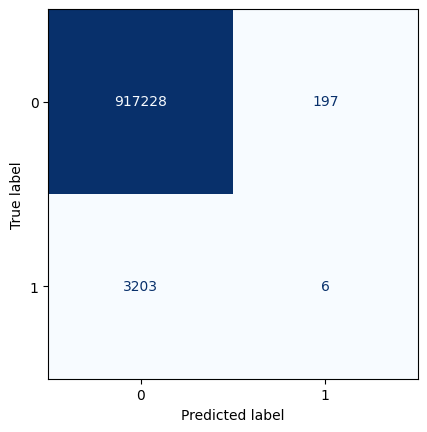

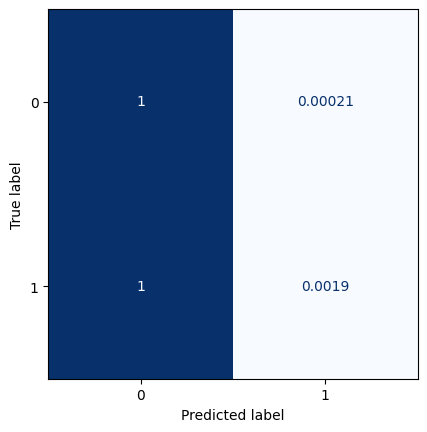

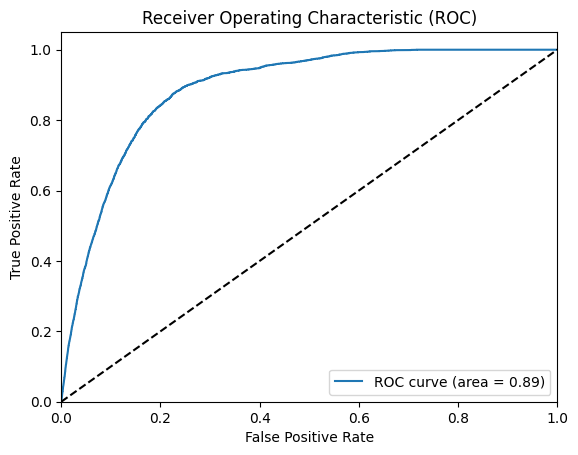

All zeros Brier score: 0.0034856414166758993
Model Brier score: 0.003438639015672596
77/77 [==============================] - 3s 38ms/step


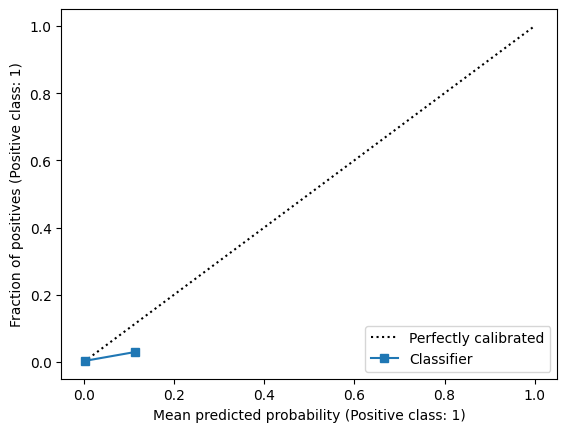

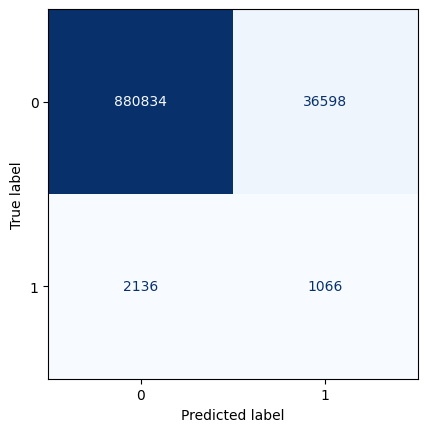

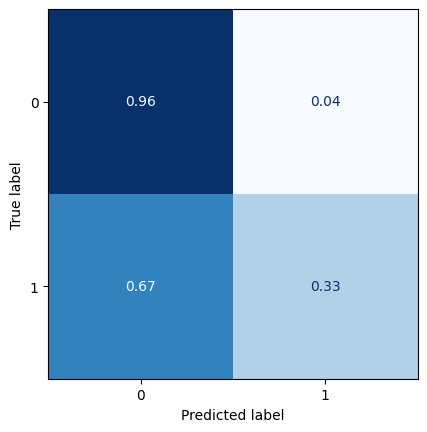

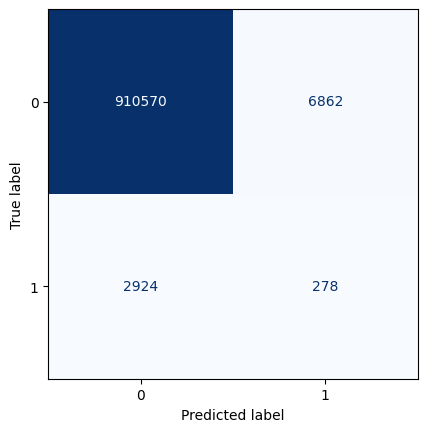

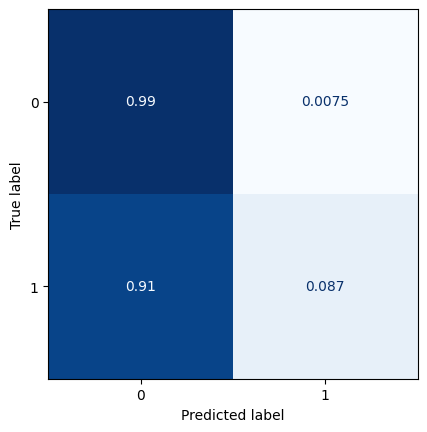

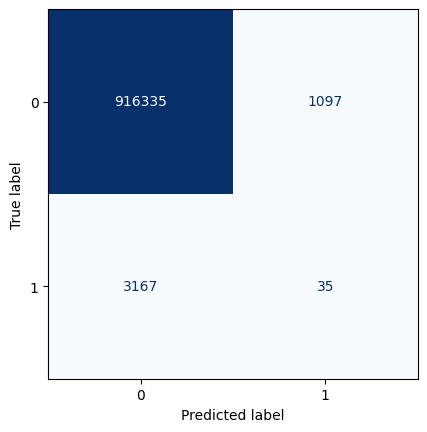

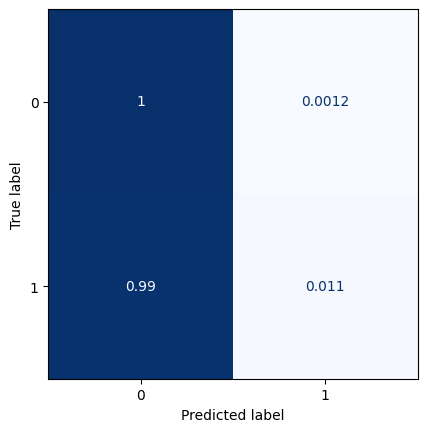

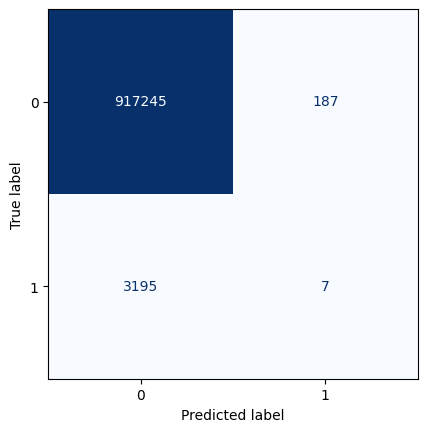

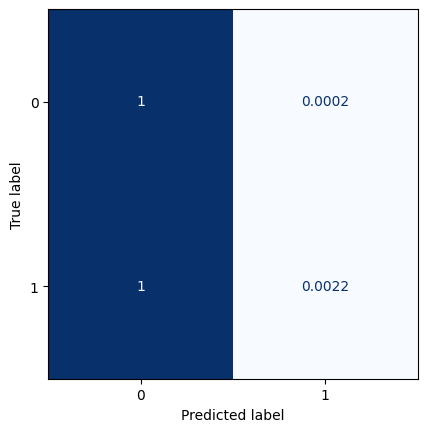

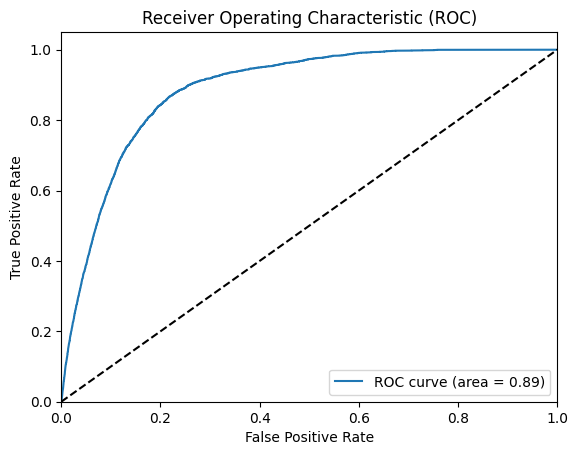

All zeros Brier score: 0.0034780379607965814
Model Brier score: 0.0034293969154250634
77/77 [==============================] - 3s 39ms/step


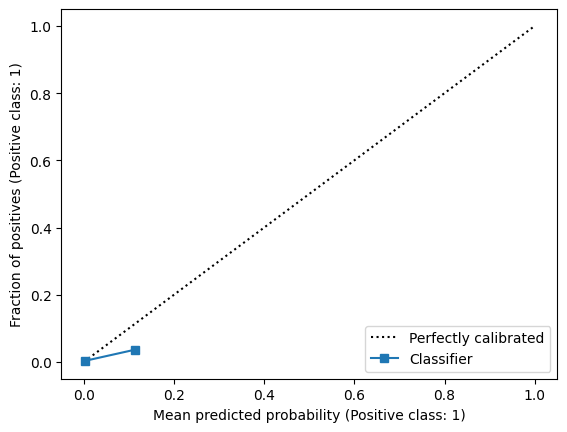

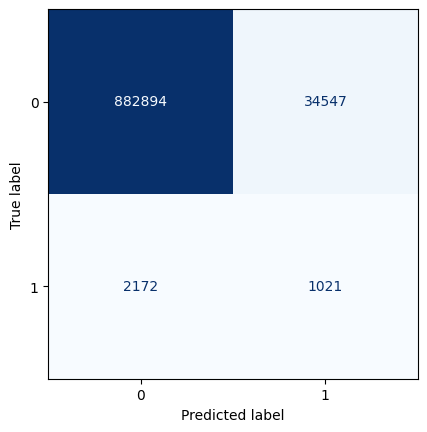

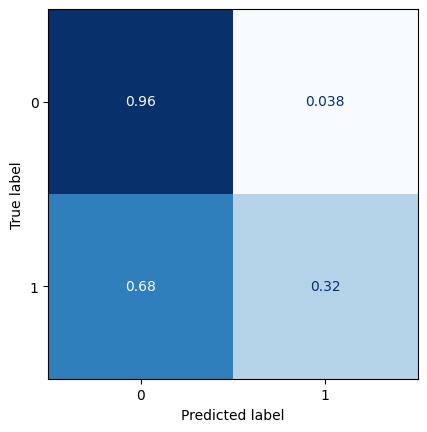

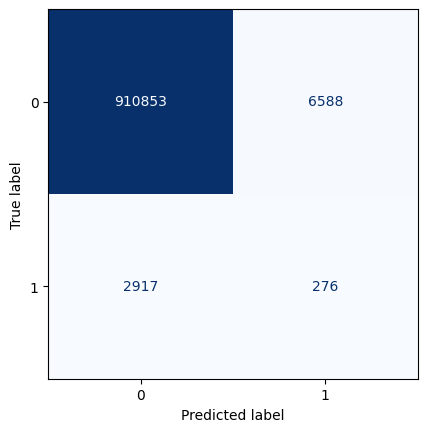

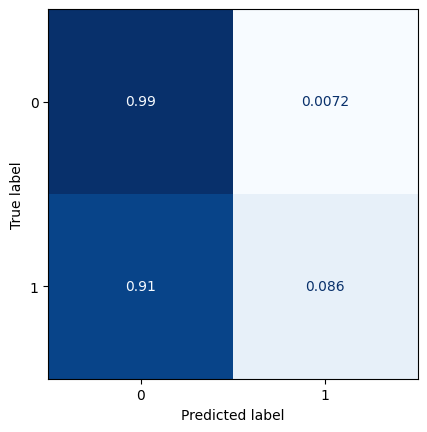

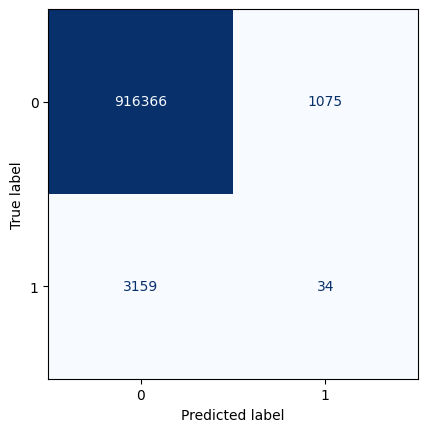

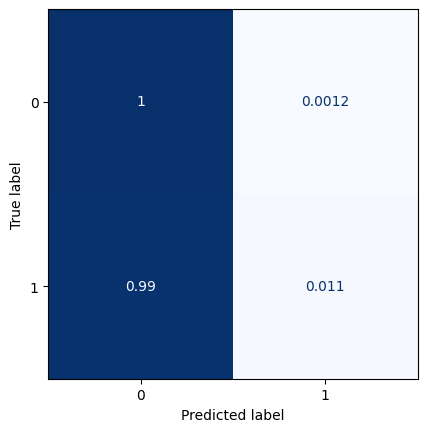

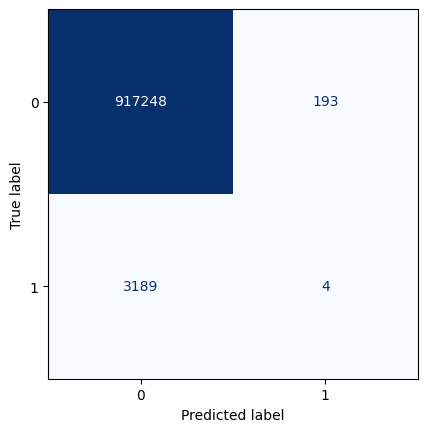

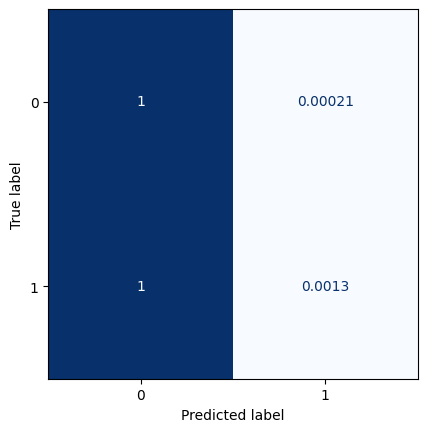

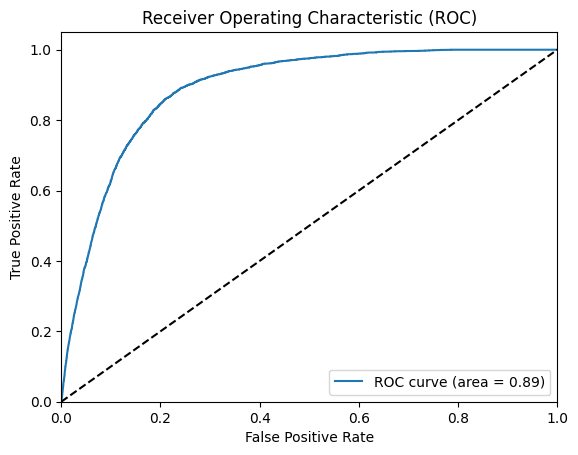

All zeros Brier score: 0.003468262088951744
Model Brier score: 0.0034181443578308176
77/77 [==============================] - 3s 37ms/step


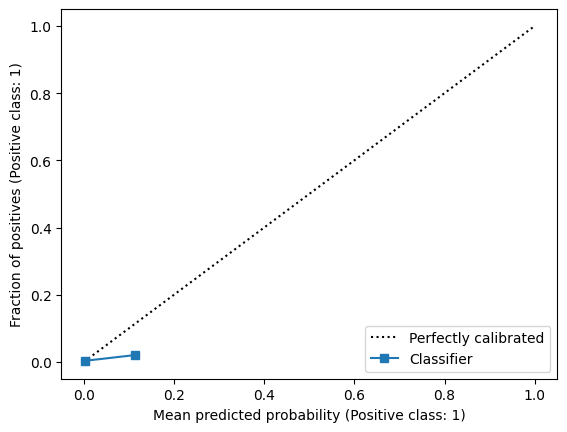

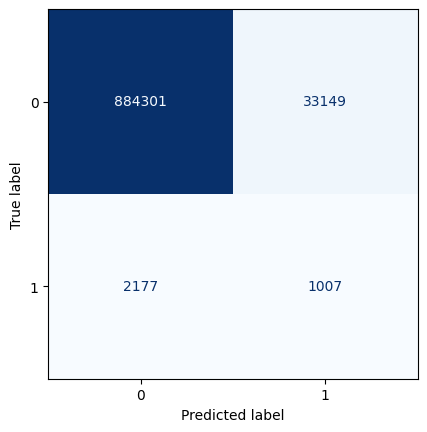

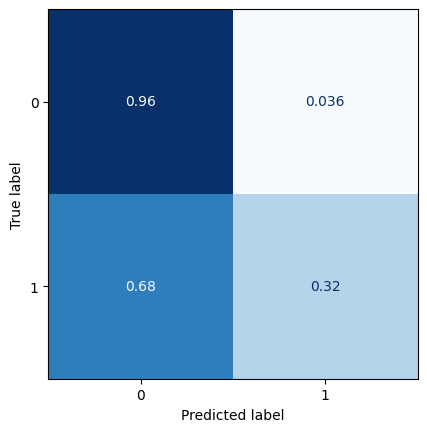

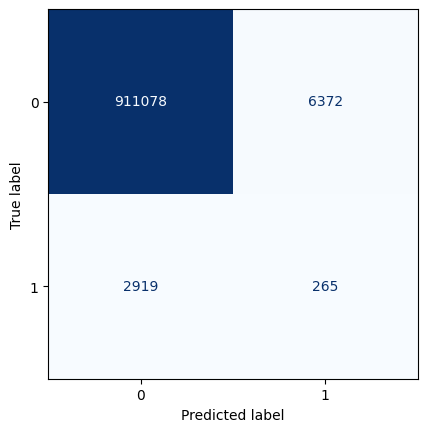

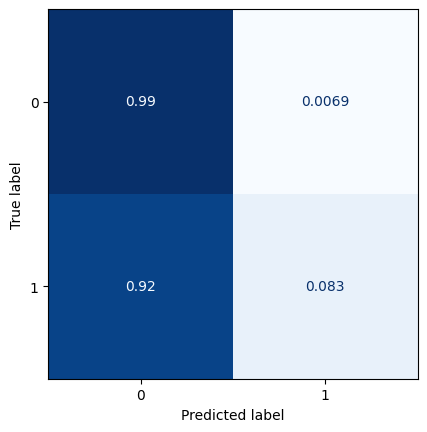

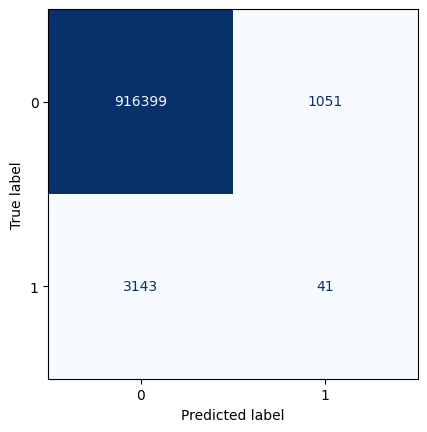

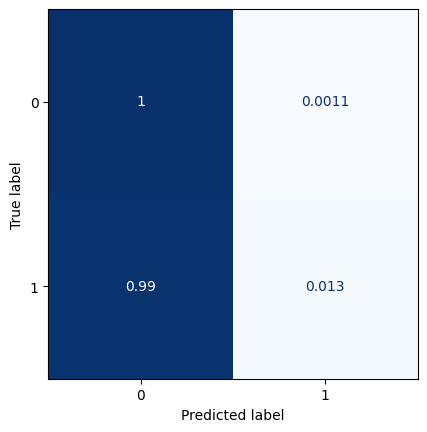

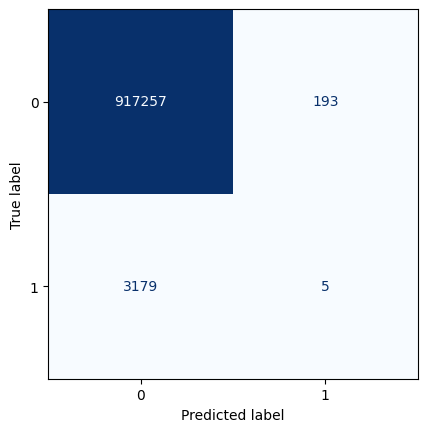

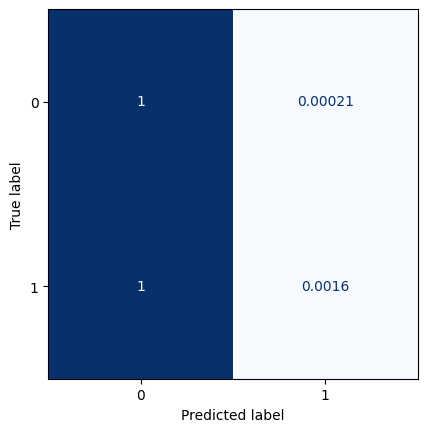

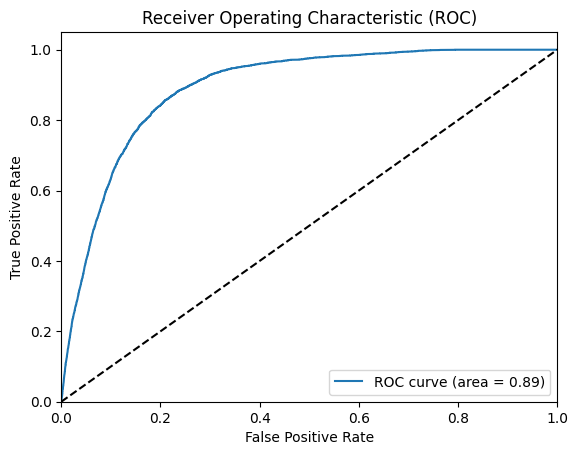

All zeros Brier score: 0.003458486217106907
Model Brier score: 0.003407214769604626
77/77 [==============================] - 3s 34ms/step


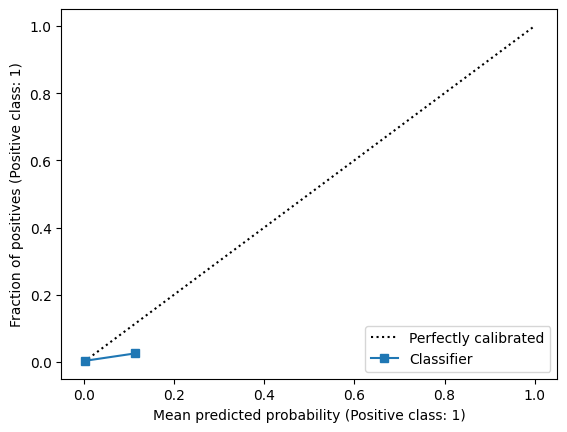

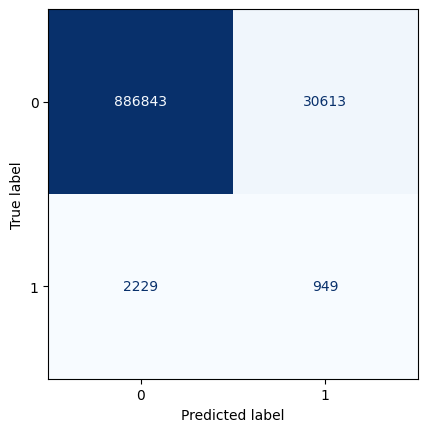

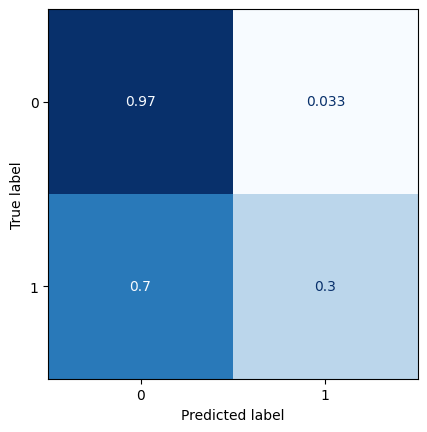

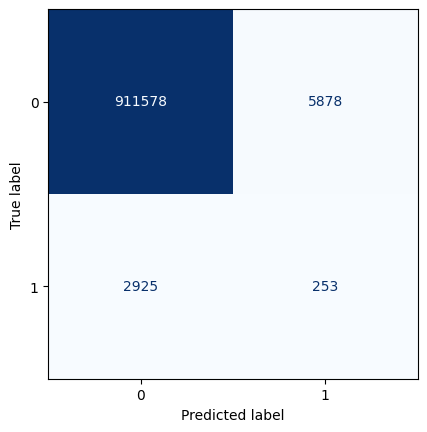

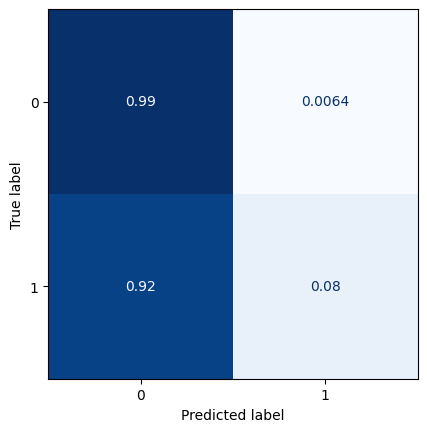

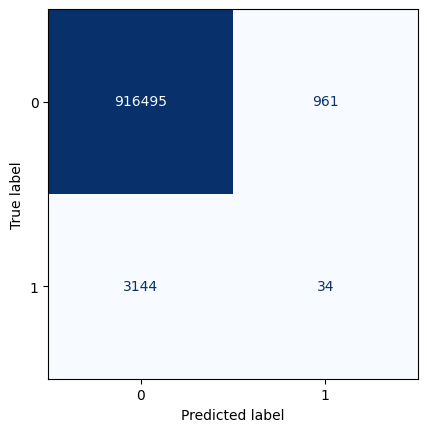

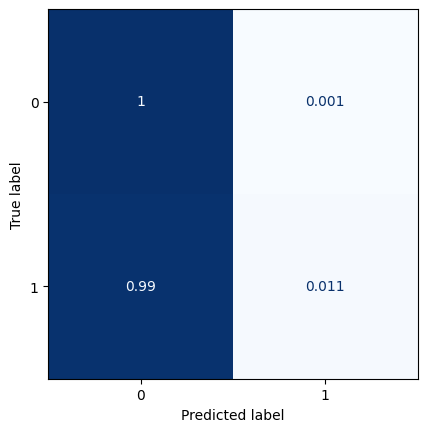

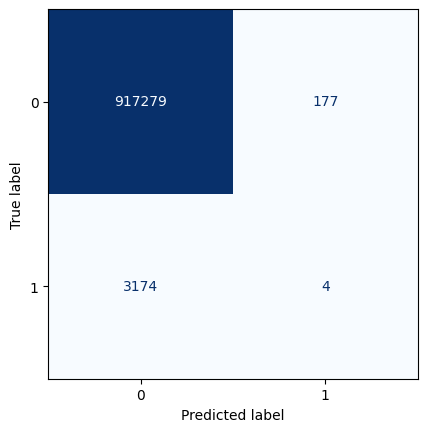

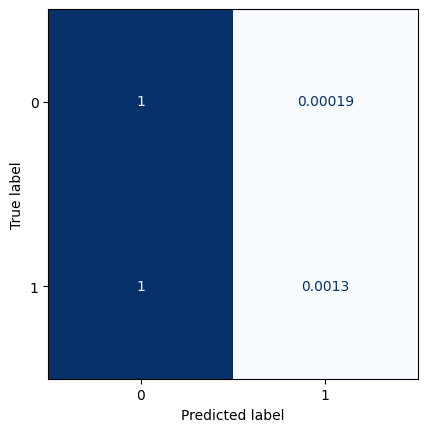

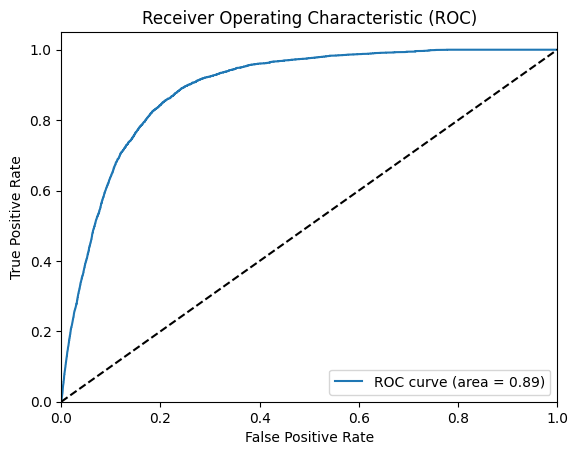

All zeros Brier score: 0.0034519689692103484
Model Brier score: 0.0034004752934580448
77/77 [==============================] - 3s 34ms/step


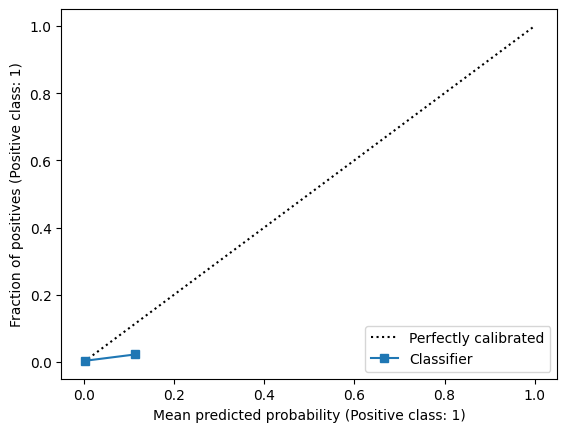

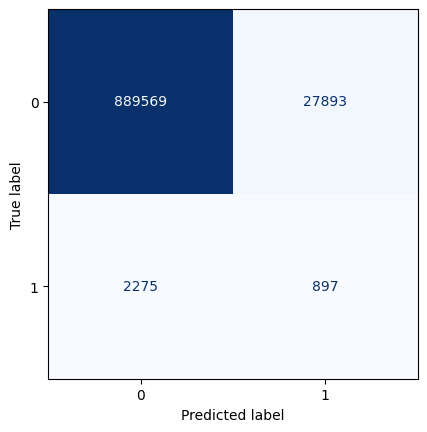

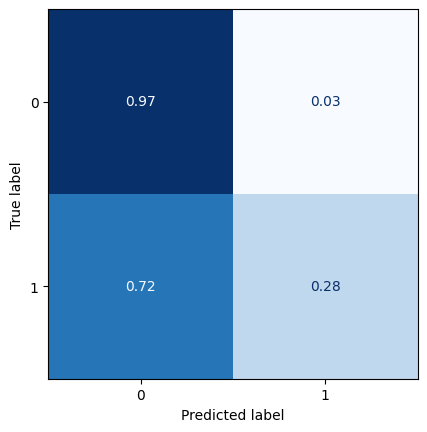

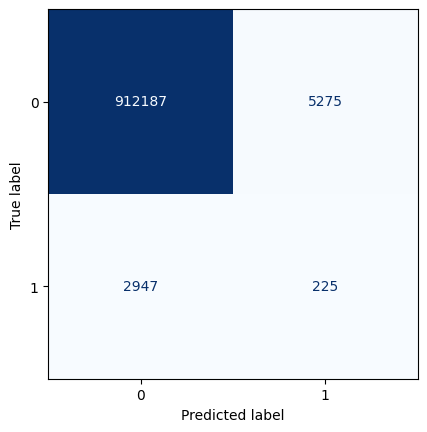

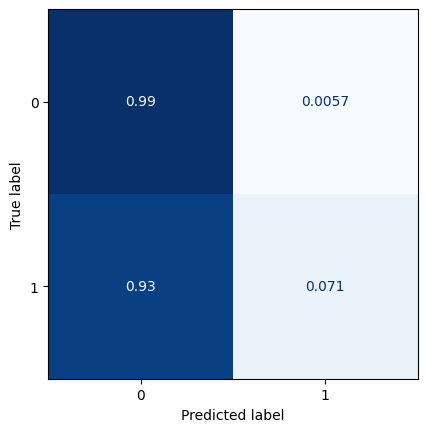

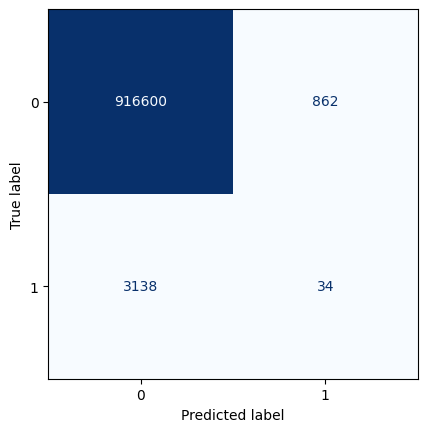

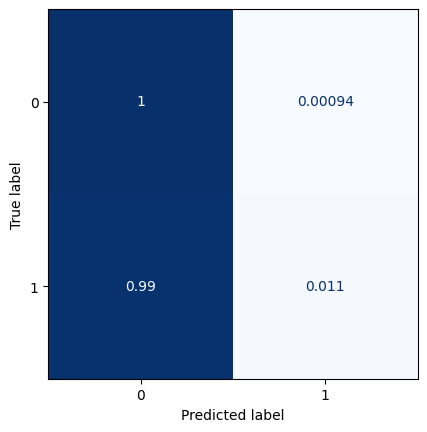

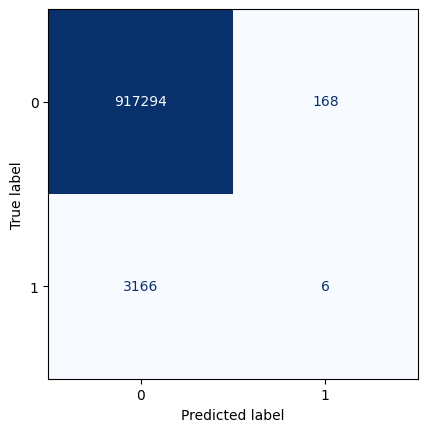

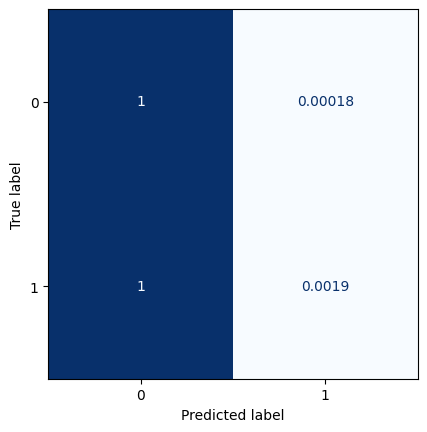

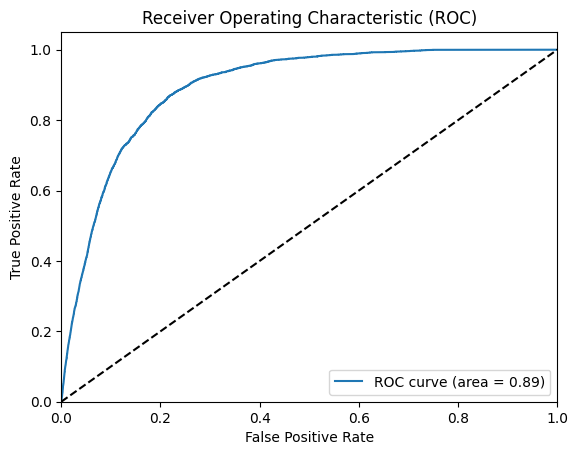

All zeros Brier score: 0.0034454517213137904
Model Brier score: 0.0033928999648155838
77/77 [==============================] - 3s 38ms/step


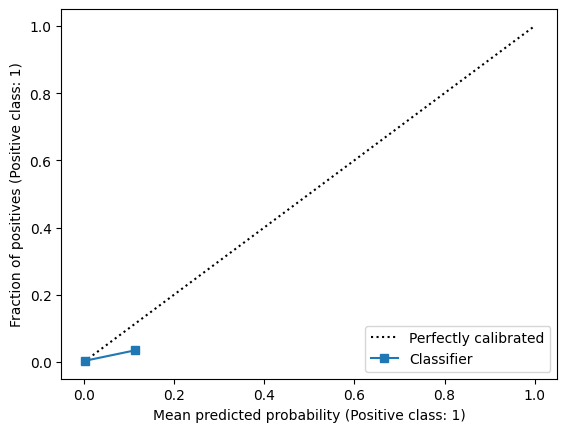

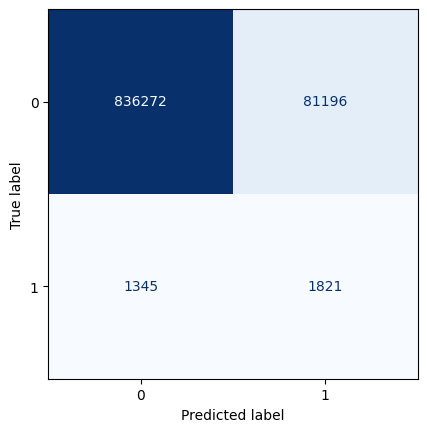

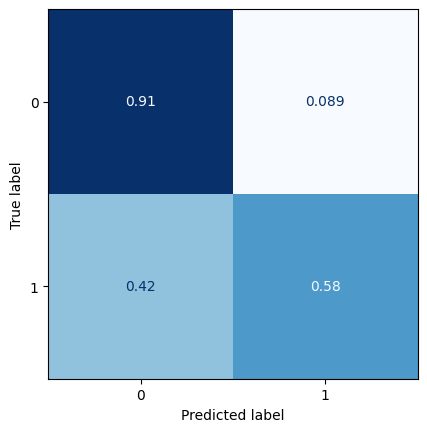

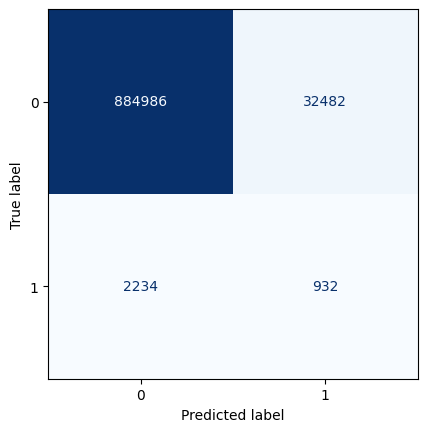

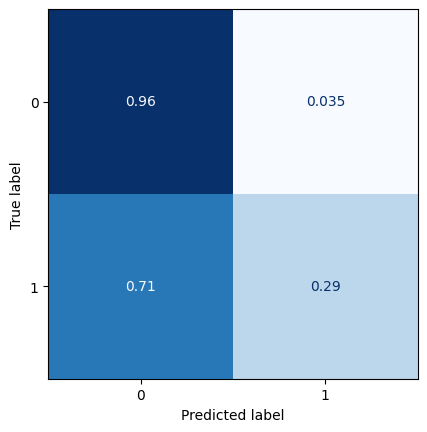

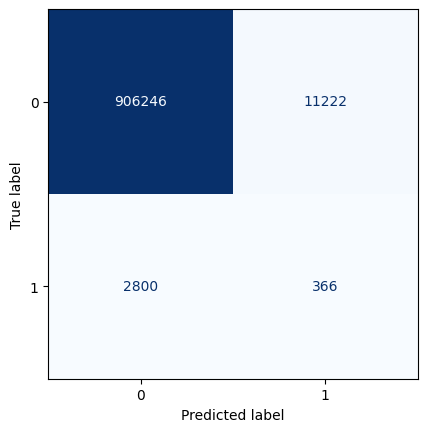

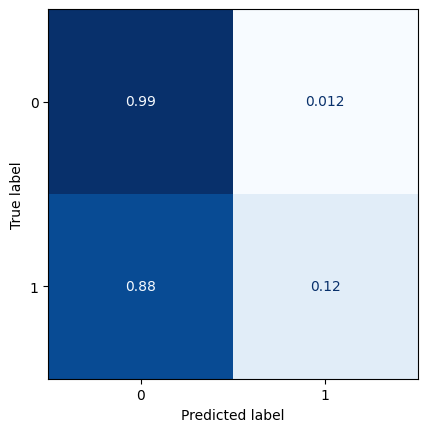

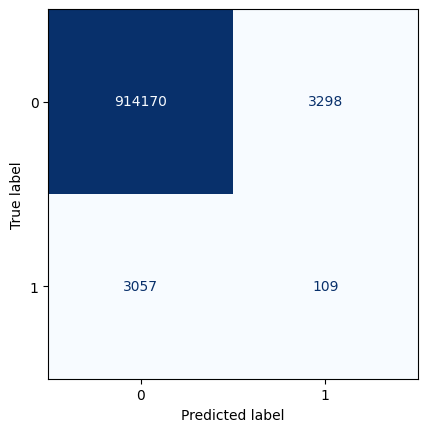

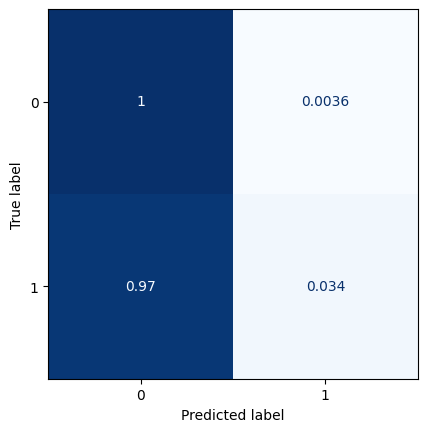

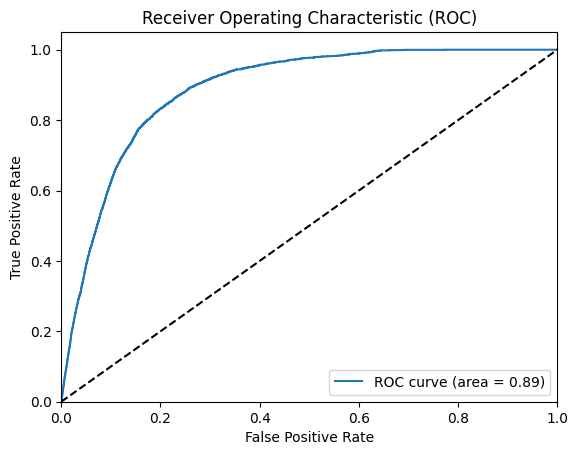

All zeros Brier score: 0.003438934473417232
Model Brier score: 0.003493042607432813
Model: "model_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_30 (InputLayer)       [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_44 (ConvLSTM2D)  (None, None, 13, 29, 8)  13632     
                                                                 
 conv3d_29 (Conv3D)          (None, None, 13, 29, 1)   217       
                                                                 
Total params: 13,849
Trainable params: 13,849
Non-trainable params: 0
_________________________________________________________________


In [ ]:
for lag in range(13):    
    train_inputs,train_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=train_img_std, y=y_train_img)
    val_inputs,val_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=val_img_std, y=y_val_img)
    test_inputs,test_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=test_img_std, y=y_test_img)
    
    # Construct the input layer with no definite frame size.
    inp = layers.Input(shape=(None, *train_inputs.shape[2:]))
    
    # We will construct 3 `ConvLSTM2D` layers with batch normalization,
    # followed by a `Conv3D` layer for the spatiotemporal outputs.
    x = layers.ConvLSTM2D(
        filters=8,
        kernel_size=(5,5),
        padding="same",
        return_sequences=True,
        activation="relu",
    )(inp)
    ##x = layers.BatchNormalization()(x)
    #x = layers.ConvLSTM2D(
    #    filters=8,
    #    kernel_size=(3, 3),
    #    padding="same",
    #    return_sequences=True,
    #    activation="relu",
    #)(x)
    ##x = layers.BatchNormalization()(x)
    #x = layers.ConvLSTM2D(
    #    filters=8,
    #    kernel_size=(1, 1),
    #    padding="same",
    #    return_sequences=True,
    #    activation="relu",
    #)(x)
    x = layers.Conv3D(
        filters=1, kernel_size=(3, 3, 3), activation="sigmoid", padding="same"
    )(x)
    
    # Next, we will build the complete model and compile it.
    model = keras.models.Model(inp, x)
    model.compile(
        loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.Adam(),
    )
    model.summary()
    
    # Define some callbacks to improve training.
    early_stopping = keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience=5)
    
    # Define modifiable training hyperparameters.
    epochs = 100
    batch_size = 256
    
    # Fit the model to the training data.
    model.fit(
        train_inputs,
        train_outputs,
        batch_size=batch_size,
        epochs=epochs,
        validation_data=(val_inputs, val_outputs),
        callbacks=[early_stopping, reduce_lr],
    )
    
    for i in range(lag+1):
        evaluate_perf(test_inputs,test_outputs,day=i)
    

In [ ]:
0.002732978664770724
0.00278873704192316     0.0031910978168812817
0.003178713373527999    0.0031812227427115134     0.0033504255441815195
0.0033759489774592994   0.0033717800354316437     0.0034437965367244165
0.0034701150595645284   0.0034430352515563375     0.003442545356590767      0.003435820055646646


0.002736149079277809   0.0031380999744746304      0.003340098371057907      0.003369550319754776

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, None, 13, 29, 9)  0         
                             ]                                   
                                                                 
 conv_lstm2d_3 (ConvLSTM2D)  (None, None, 13, 29, 3)   3612      
                                                                 
 conv3d_3 (Conv3D)           (None, None, 13, 29, 1)   82        
                                                                 
Total params: 3,694
Trainable params: 3,694
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100


2023-04-09 11:35:47.158578: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - ETA: 0s - loss: 0.5718

2023-04-09 11:35:51.717607: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


45/45 [==============================] - 5s 85ms/step - loss: 0.5718 - val_loss: 0.4108 - lr: 0.0010
Epoch 2/100
45/45 [==============================] - 3s 67ms/step - loss: 0.3643 - val_loss: 0.3154 - lr: 0.0010
Epoch 3/100
45/45 [==============================] - 3s 67ms/step - loss: 0.3072 - val_loss: 0.2766 - lr: 0.0010
Epoch 4/100
45/45 [==============================] - 3s 67ms/step - loss: 0.2753 - val_loss: 0.2488 - lr: 0.0010
Epoch 5/100
45/45 [==============================] - 3s 71ms/step - loss: 0.2406 - val_loss: 0.1682 - lr: 0.0010
Epoch 6/100
45/45 [==============================] - 3s 67ms/step - loss: 0.1054 - val_loss: 0.0566 - lr: 0.0010
Epoch 7/100
45/45 [==============================] - 3s 69ms/step - loss: 0.0522 - val_loss: 0.0357 - lr: 0.0010
Epoch 8/100
45/45 [==============================] - 3s 75ms/step - loss: 0.0388 - val_loss: 0.0287 - lr: 0.0010
Epoch 9/100
45/45 [==============================] - 3s 73ms/step - loss: 0.0333 - val_loss: 0.0254 - lr: 0.

2023-04-09 11:39:17.201872: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 1s 7ms/step


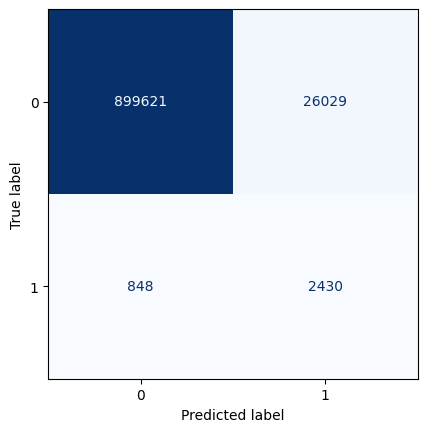

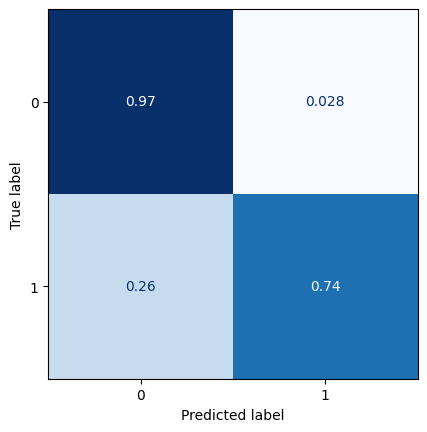

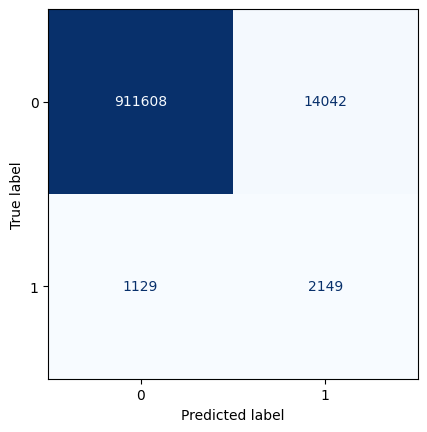

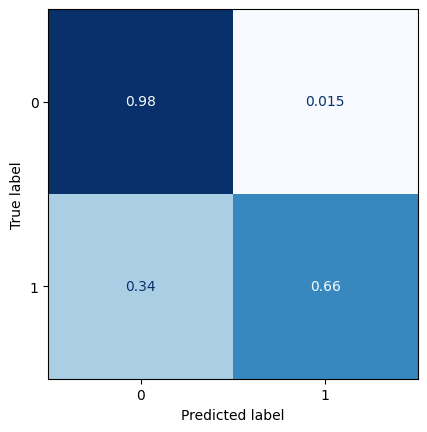

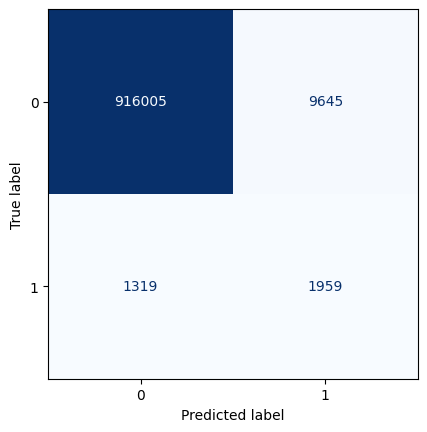

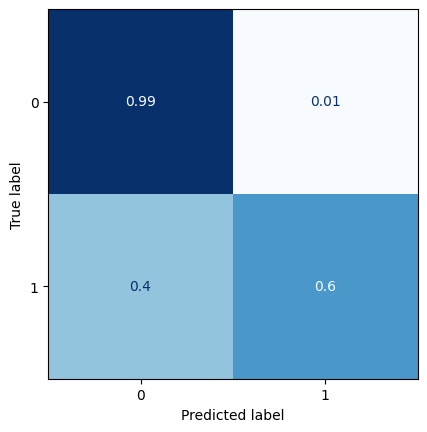

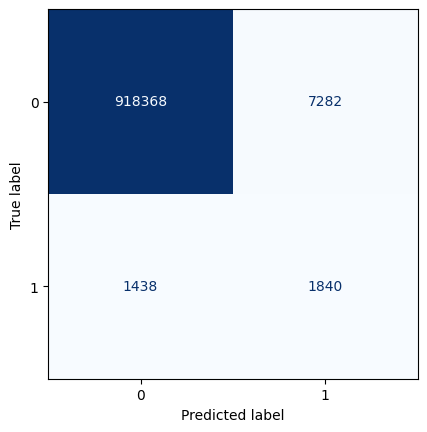

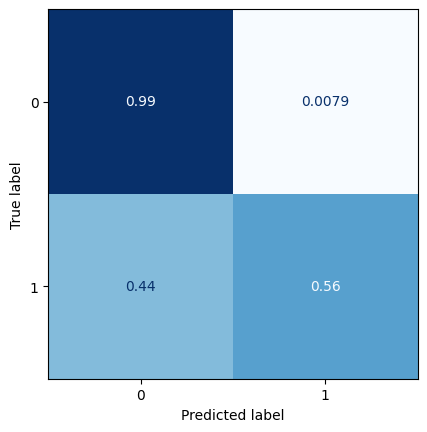

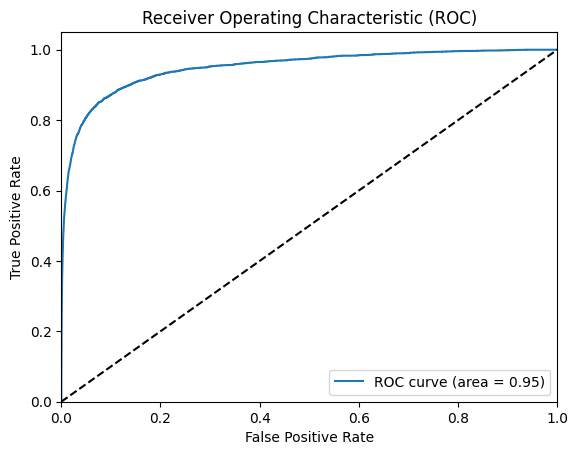

NameError: name 'CalibrationDisplay' is not defined

In [23]:
for lag in range(13):    
    train_inputs,train_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=train_img_std, y=y_train_img)
    val_inputs,val_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=val_img_std, y=y_val_img)
    test_inputs,test_outputs = extract_sequences_features(past_lag =lag+1, future_lag = lag+1, x=test_img_std, y=y_test_img)
    
    # Construct the input layer with no definite frame size.
    inp = layers.Input(shape=(None, *train_inputs.shape[2:]))
    
    # We will construct 3 `ConvLSTM2D` layers with batch normalization,
    # followed by a `Conv3D` layer for the spatiotemporal outputs.
    x = layers.ConvLSTM2D(
        filters=3,
        kernel_size=(5,5),
        padding="same",
        return_sequences=True,
        activation="relu",
    )(inp)
    ##x = layers.BatchNormalization()(x)
    #x = layers.ConvLSTM2D(
    #    filters=8,
    #    kernel_size=(3, 3),
    #    padding="same",
    #    return_sequences=True,
    #    activation="relu",
    #)(x)
    ##x = layers.BatchNormalization()(x)
    #x = layers.ConvLSTM2D(
    #    filters=8,
    #    kernel_size=(1, 1),
    #    padding="same",
    #    return_sequences=True,
    #    activation="relu",
    #)(x)
    x = layers.Conv3D(
        filters=1, kernel_size=(3, 3, 3), activation="sigmoid", padding="same"
    )(x)
    
    # Next, we will build the complete model and compile it.
    model = keras.models.Model(inp, x)
    model.compile(
        loss=keras.losses.binary_crossentropy, optimizer=keras.optimizers.Adam(),
    )
    model.summary()
    
    # Define some callbacks to improve training.
    early_stopping = keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)
    reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience=5)
    
    # Define modifiable training hyperparameters.
    epochs = 100
    batch_size = 256
    
    # Fit the model to the training data.
    model.fit(
        train_inputs,
        train_outputs,
        batch_size=batch_size,
        epochs=epochs,
        validation_data=(val_inputs, val_outputs),
        callbacks=[early_stopping, reduce_lr],
    )
    
    for i in range(lag+1):
        evaluate_perf(test_inputs,test_outputs,day=i)
    

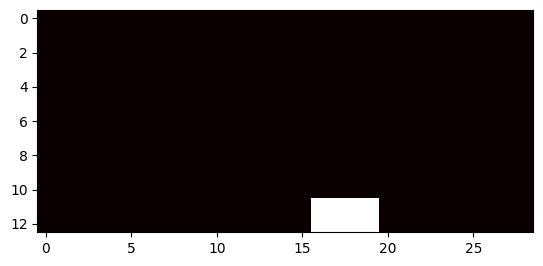

In [27]:
plt.imshow(train_inputs[35,1,:,:,:], cmap='hot', interpolation='nearest')

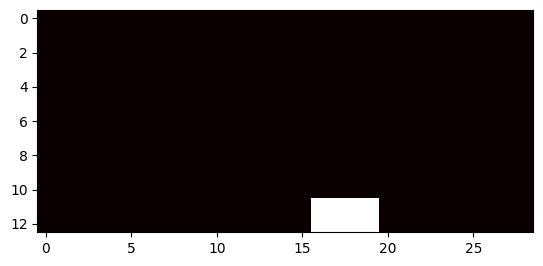

In [25]:
plt.imshow(train_outputs[34,0,:,:,:], cmap='hot', interpolation='nearest')

### Model training

In [14]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 9)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


Metal device set to: Apple M1
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 7, 15, 8)         0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d (UpSampling2D  (None, 14, 30, 8)        0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 14, 30, 1)         73        
                                                                 
 cropping2d (Cropping2D)  

2023-03-28 10:55:23.598744: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-03-28 10:55:23.600195: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [15]:
model.fit(train_img_std, y_train_img, validation_data=(val_img_std,y_val_img),
        callbacks=[monitor],epochs=100)

Epoch 1/100


2023-03-28 10:55:24.050658: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


  1/354 [..............................] - ETA: 2:35 - loss: 1.5771

2023-03-28 10:55:24.329571: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.1023

2023-03-28 10:55:27.079770: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1023 - val_loss: 0.0223
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0217 - val_loss: 0.0150
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0150 - val_loss: 0.0106
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0128 - val_loss: 0.0102
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0120 - val_loss: 0.0093
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0115 - val_loss: 0.0092
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0110 - val_loss: 0.0090
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0107 - val_loss: 0.0086
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0104 - val_loss: 0.0086
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0103 - val_loss: 0.0083
E

### Full test evaluation

68/78 [=========================>....] - ETA: 0s

2023-03-28 10:58:49.465689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 2ms/step


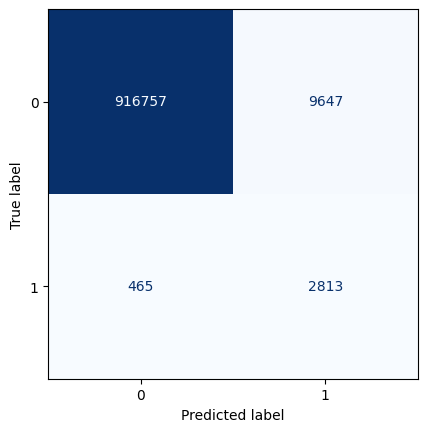

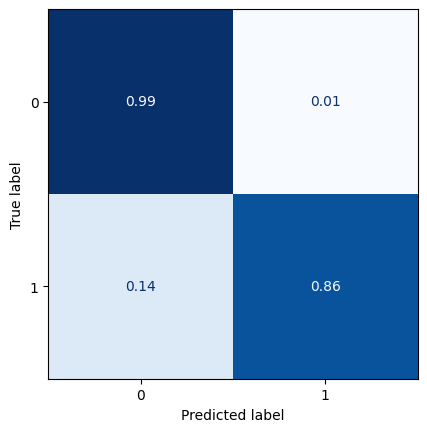

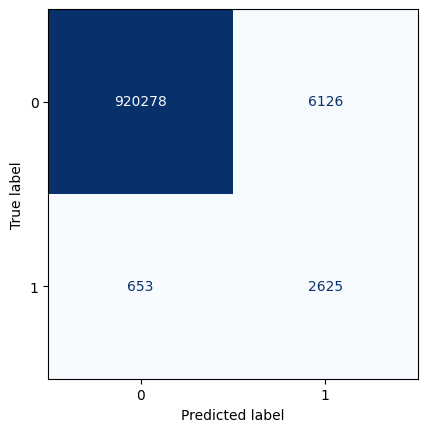

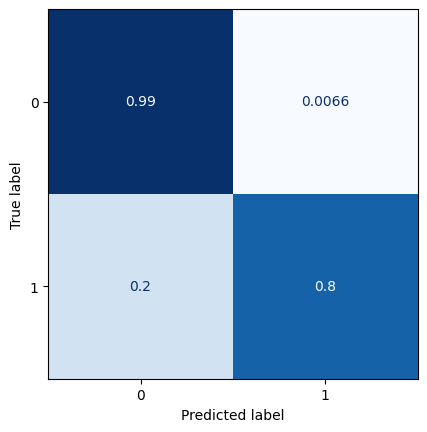

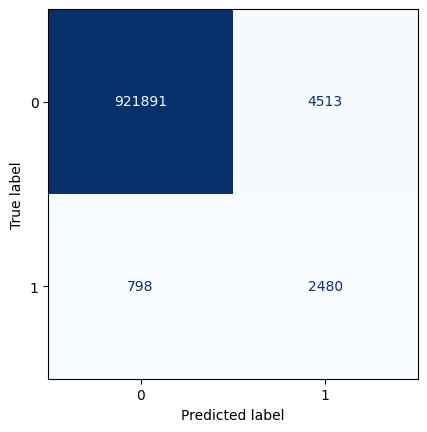

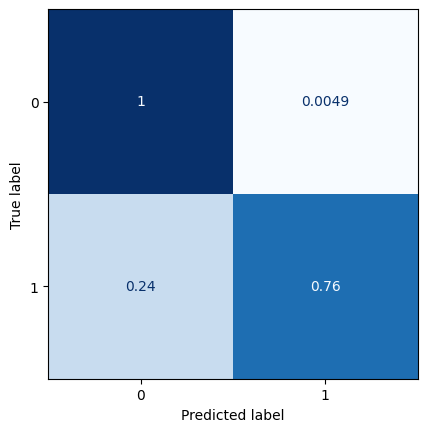

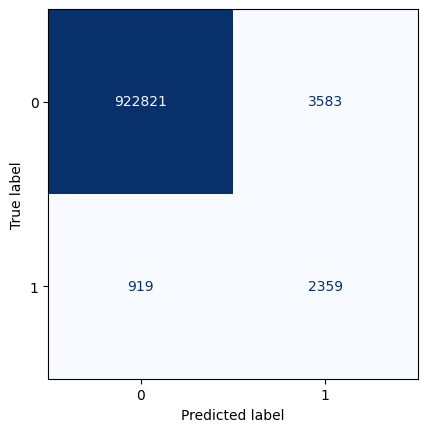

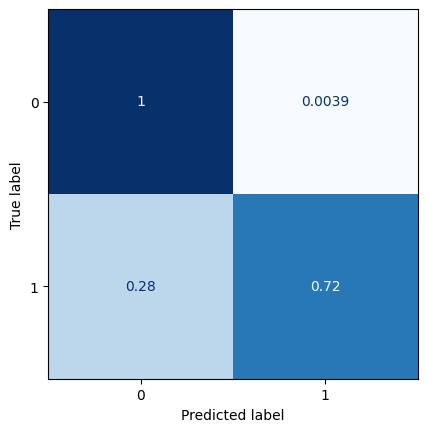

In [16]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

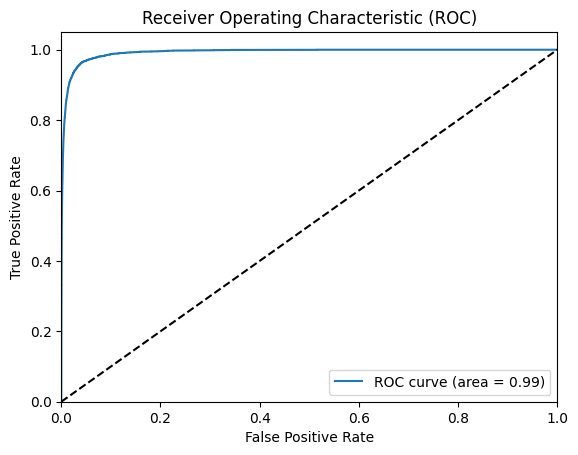

In [17]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

9


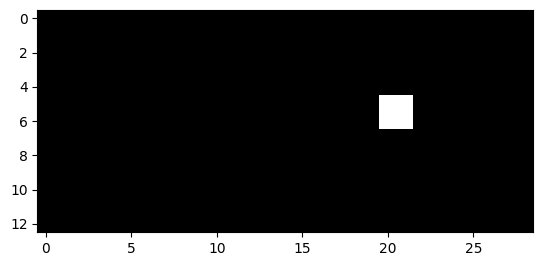

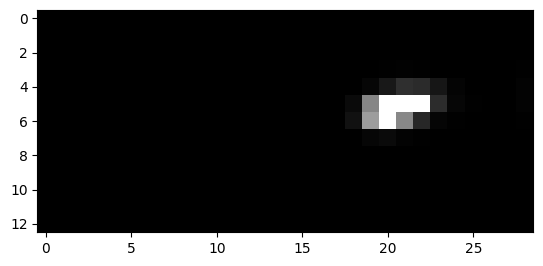

10


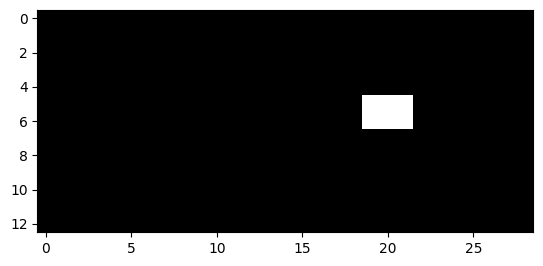

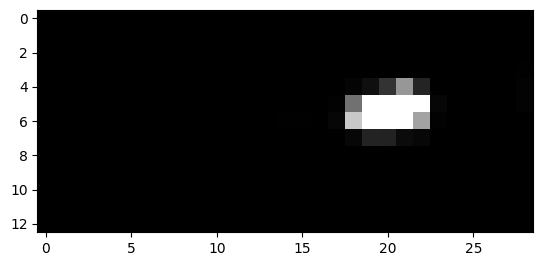

11


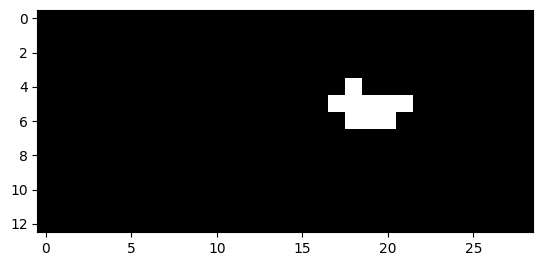

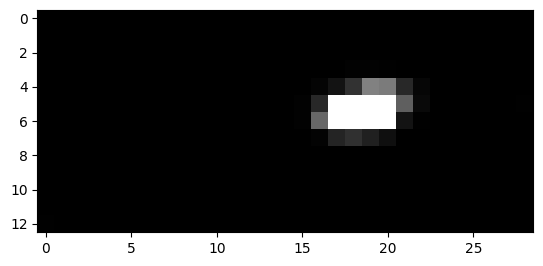

12


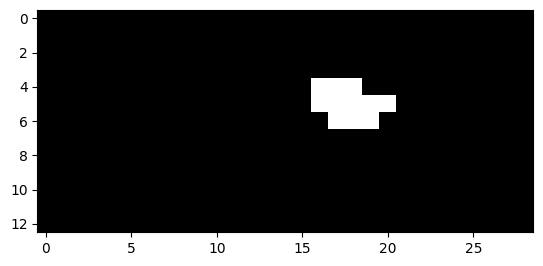

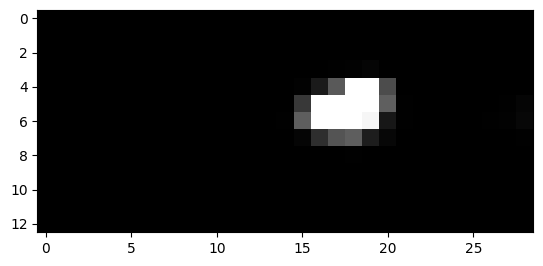

13


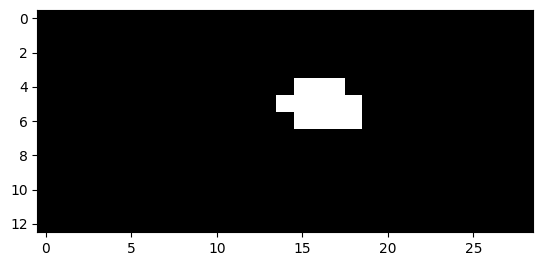

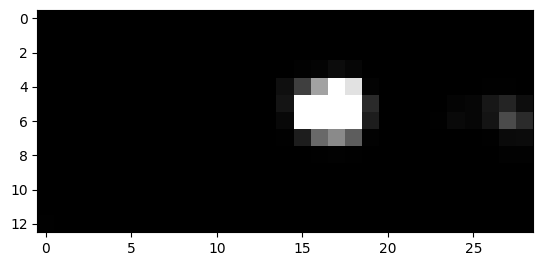

14


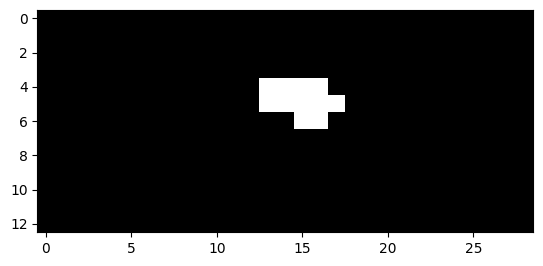

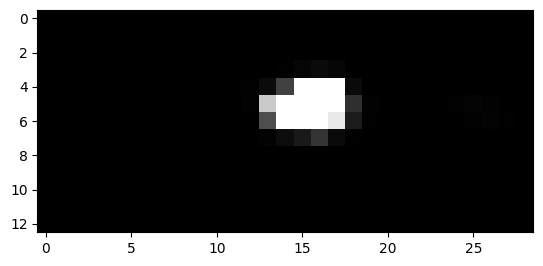

15


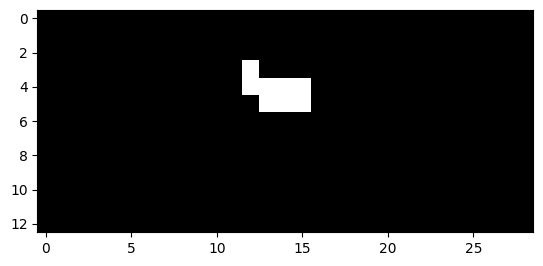

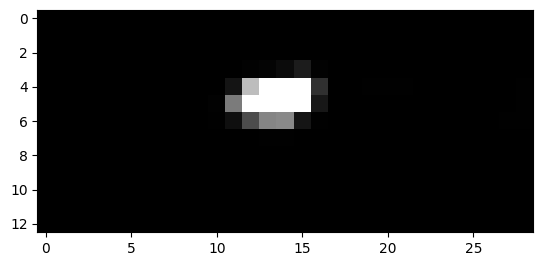

16


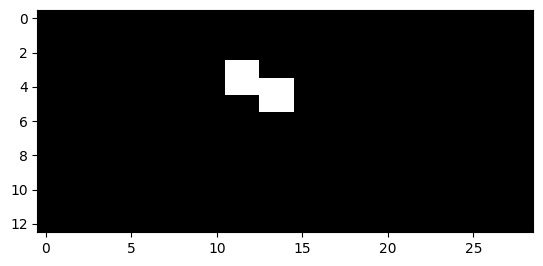

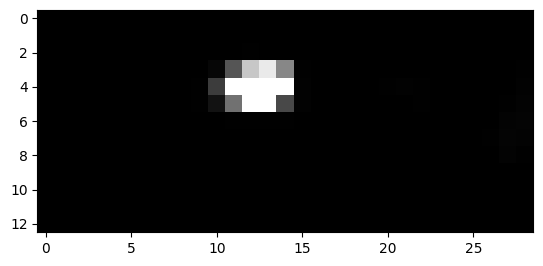

17


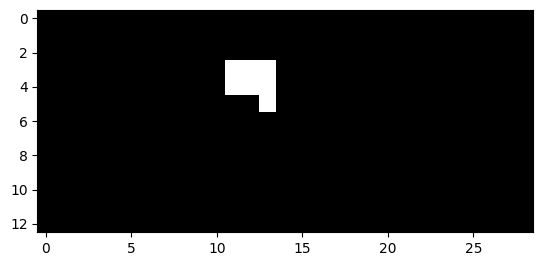

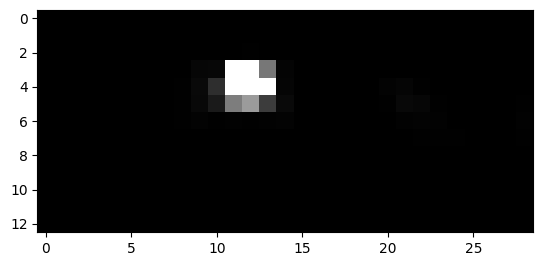

18


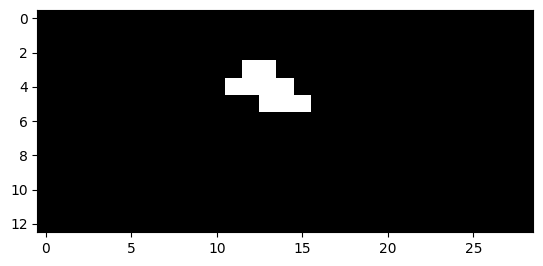

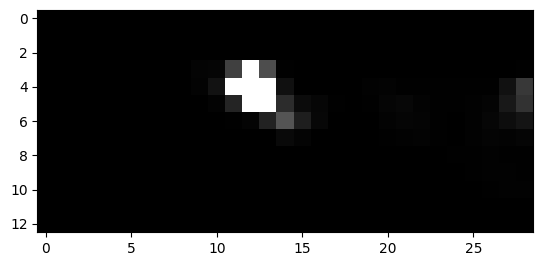

19


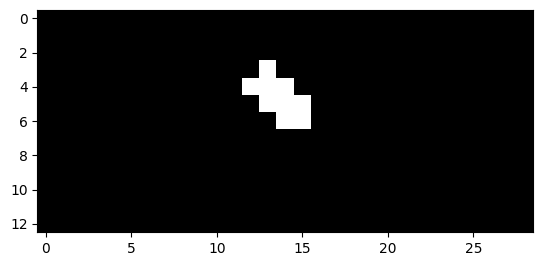

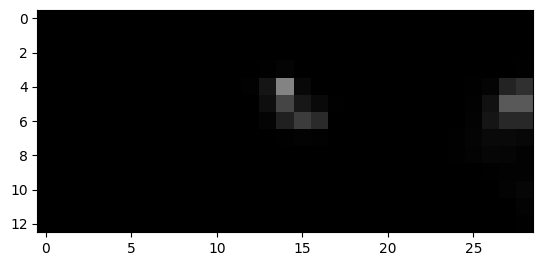

20


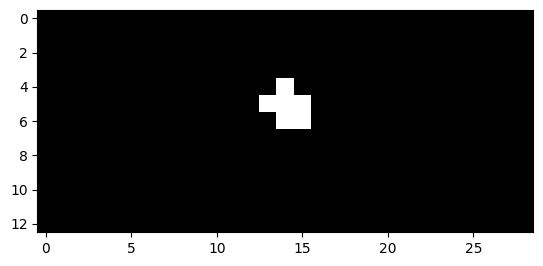

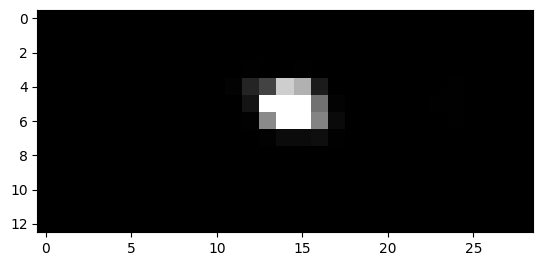

21


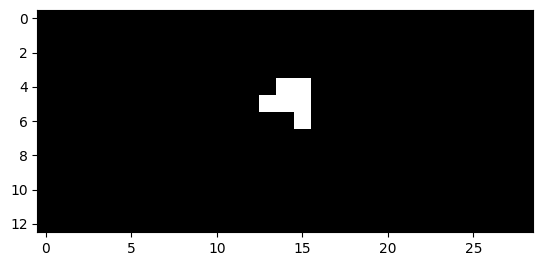

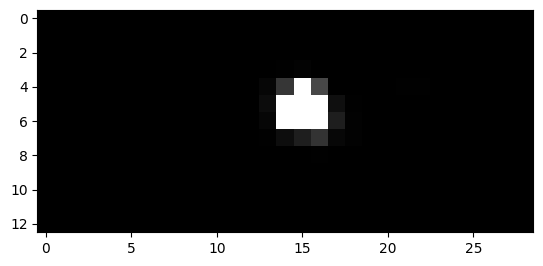

22


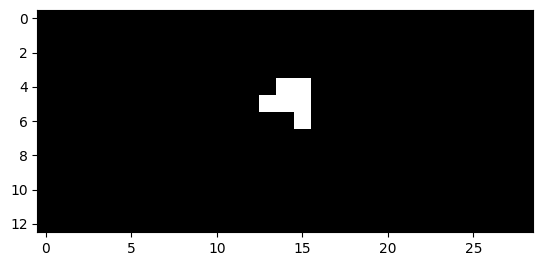

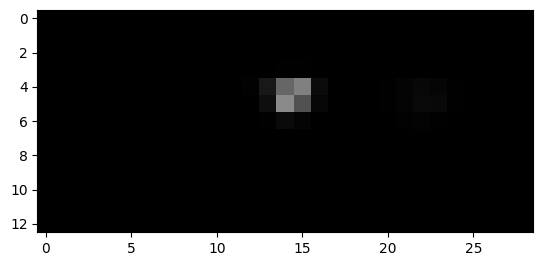

105


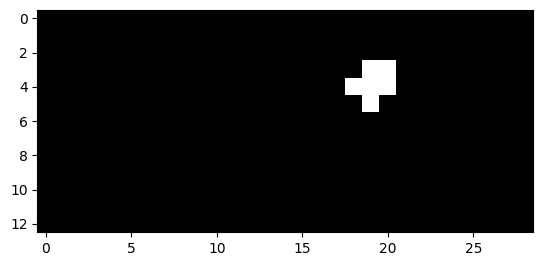

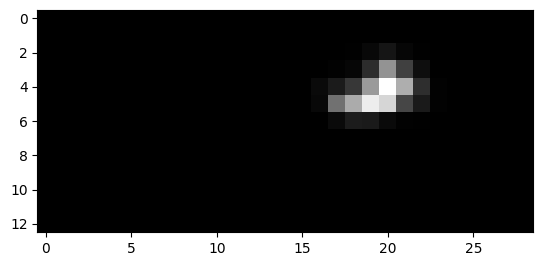

106


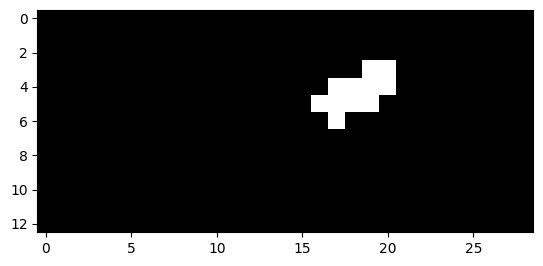

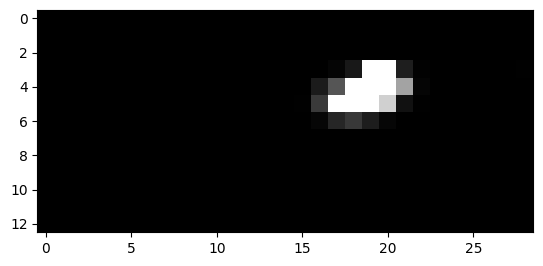

107


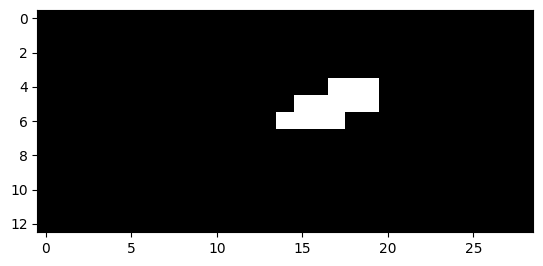

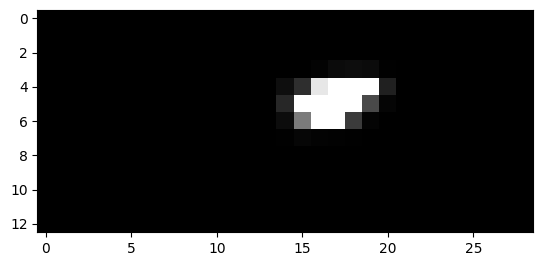

108


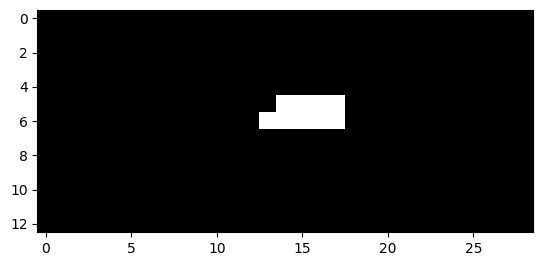

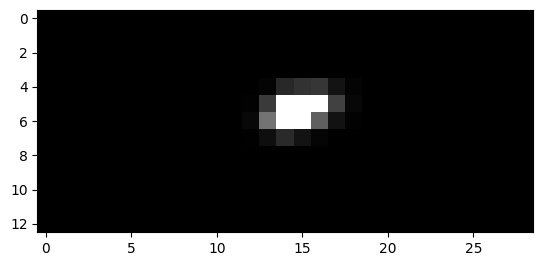

109


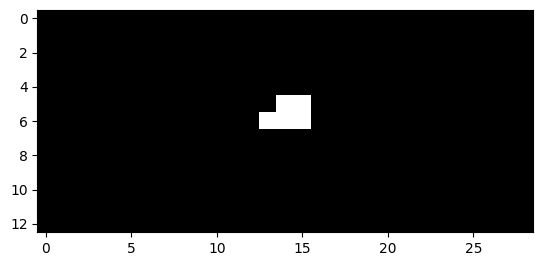

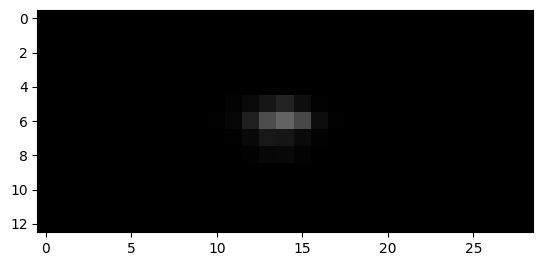

184


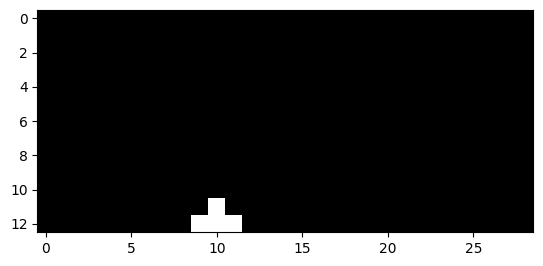

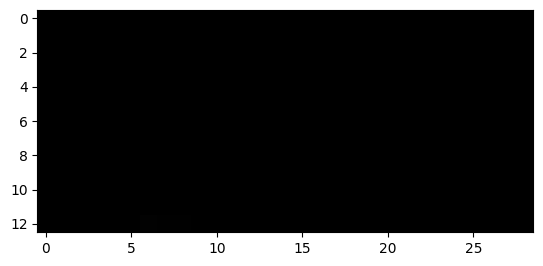

185


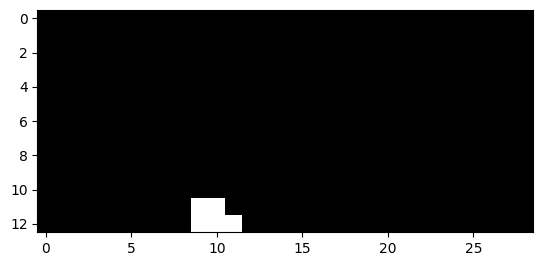

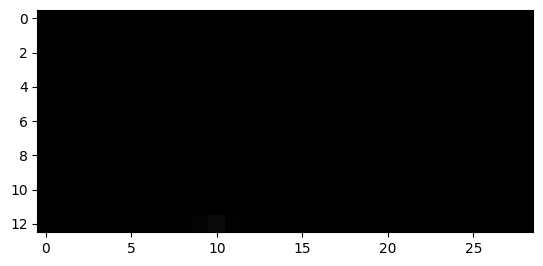

186


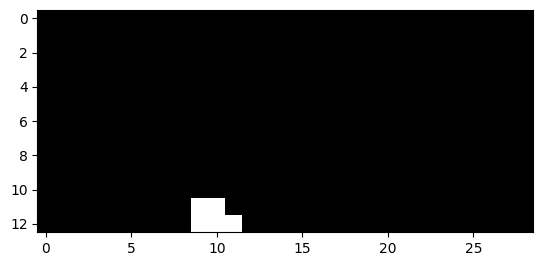

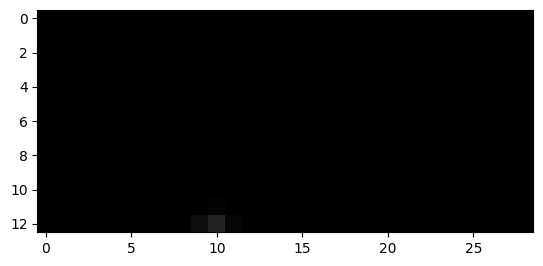

187


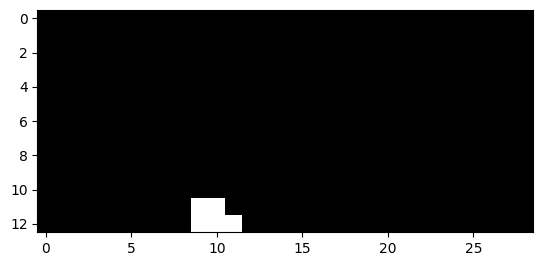

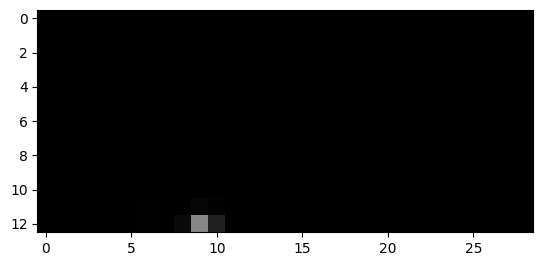

188


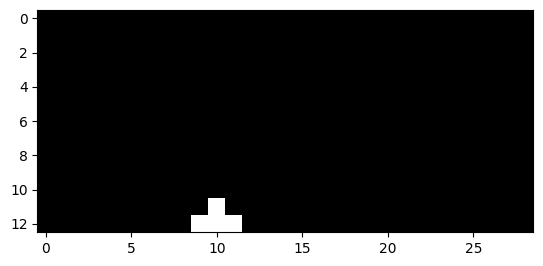

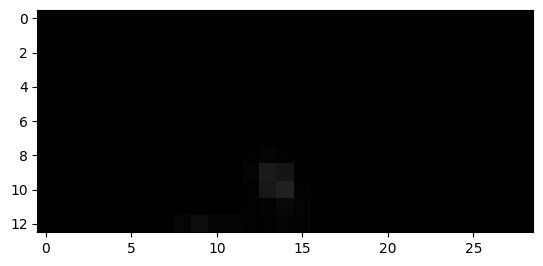

308


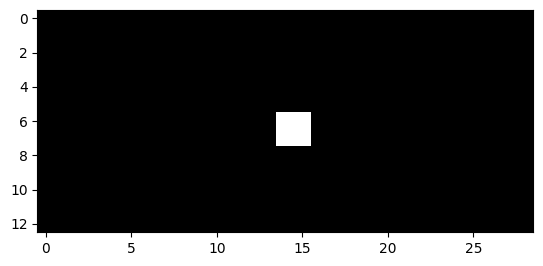

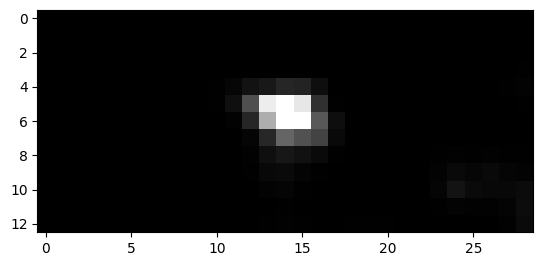

309


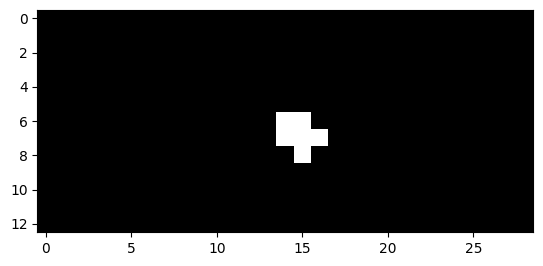

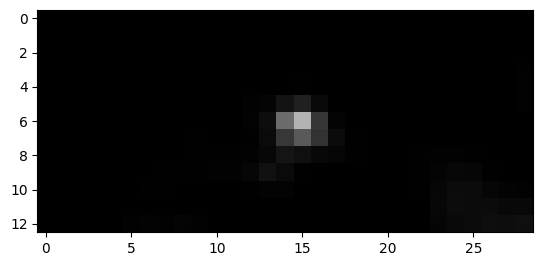

310


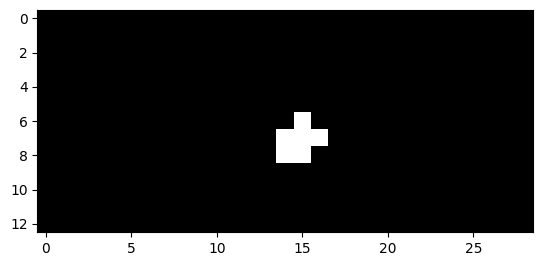

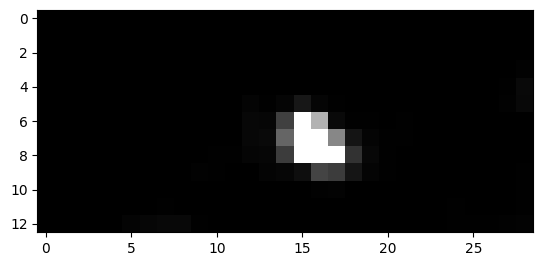

311


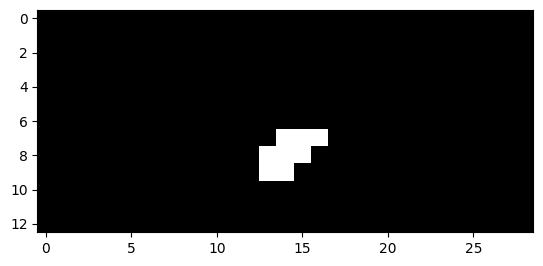

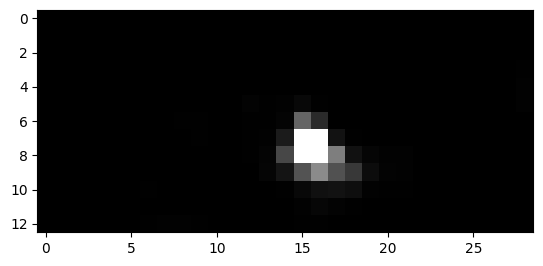

312


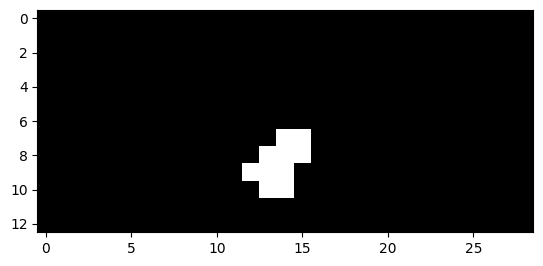

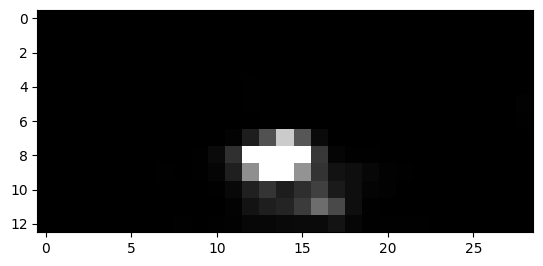

313


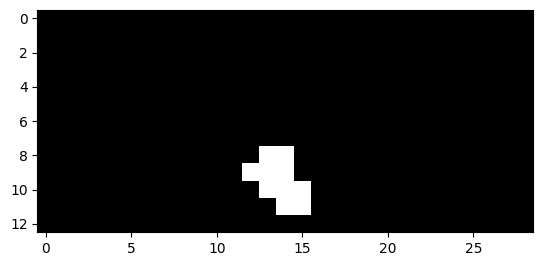

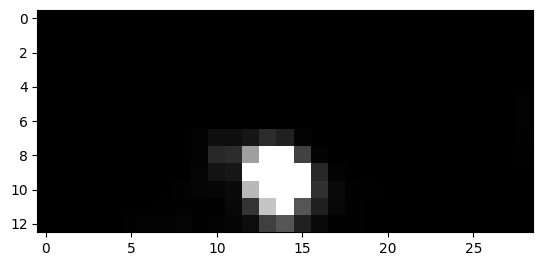

314


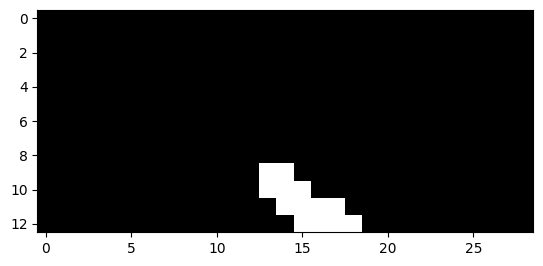

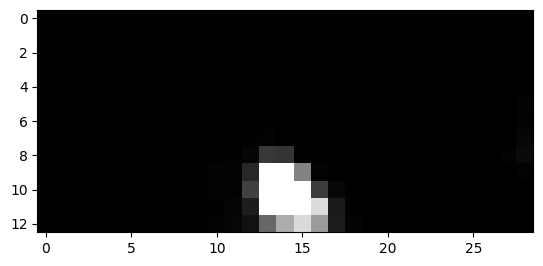

315


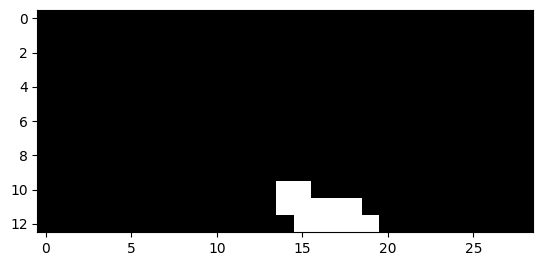

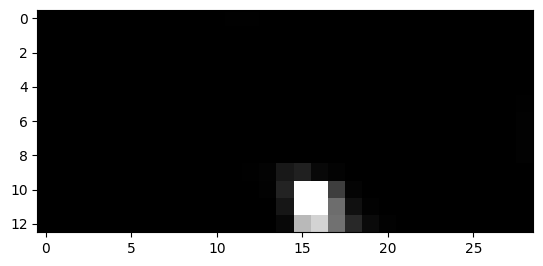

316


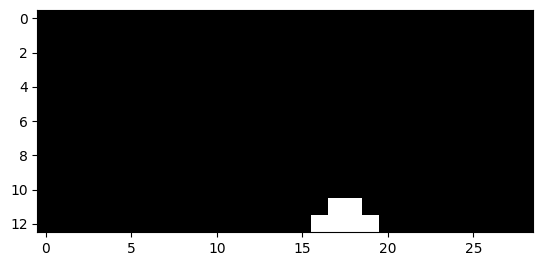

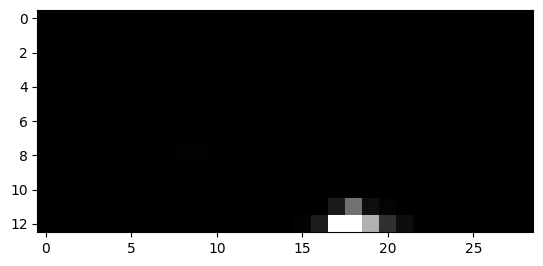

317


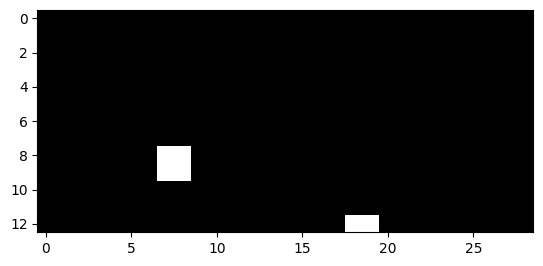

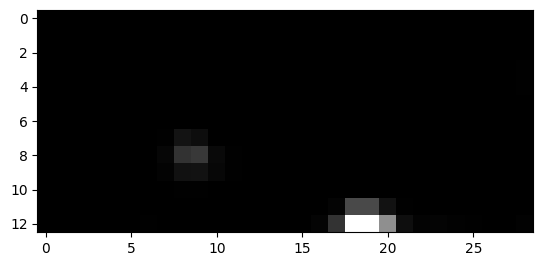

318


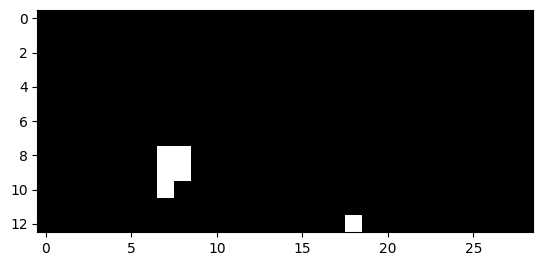

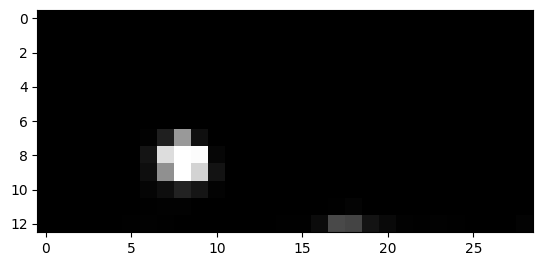

319


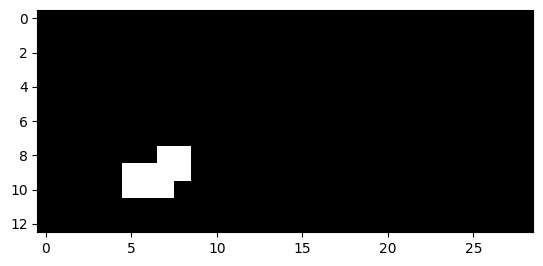

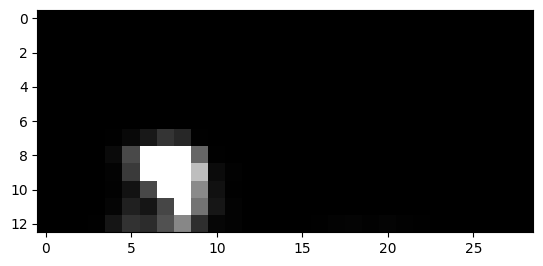

320


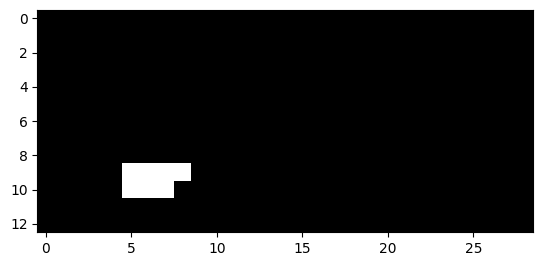

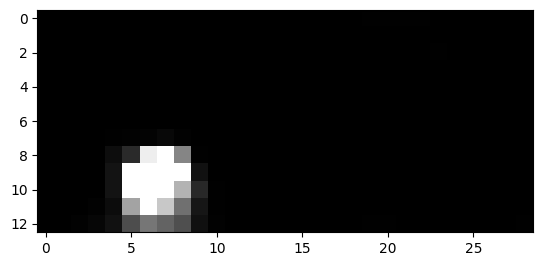

321


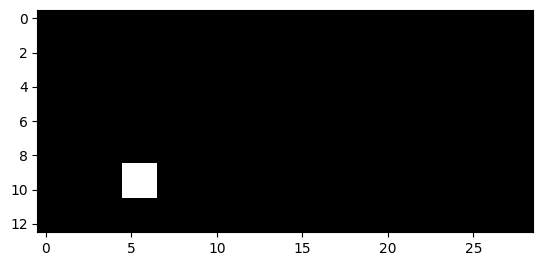

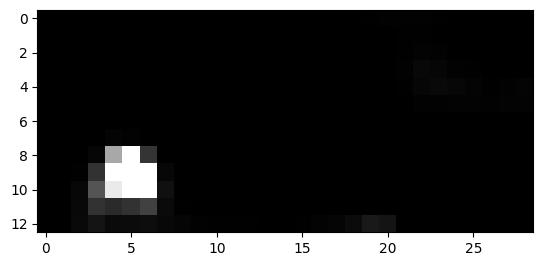

335


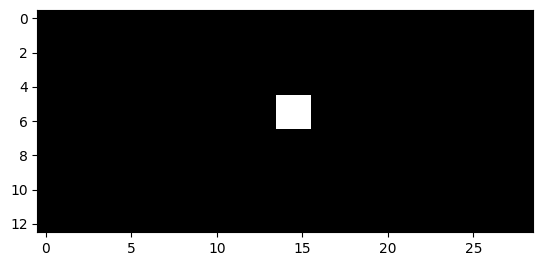

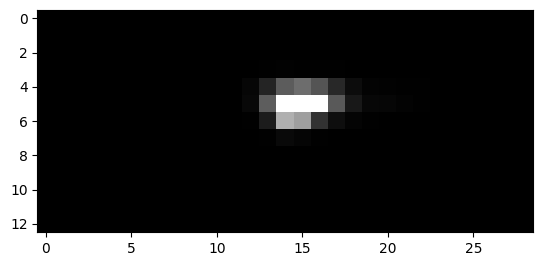

336


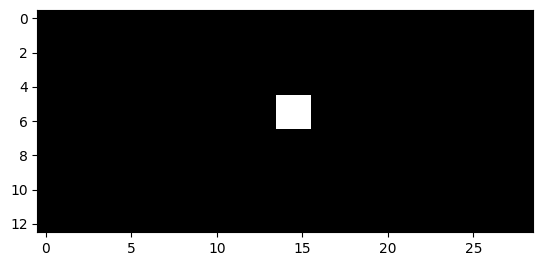

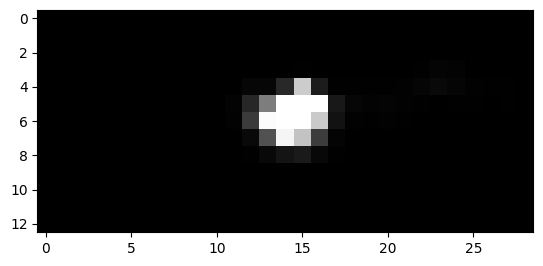

337


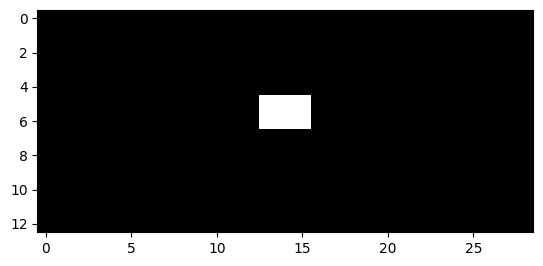

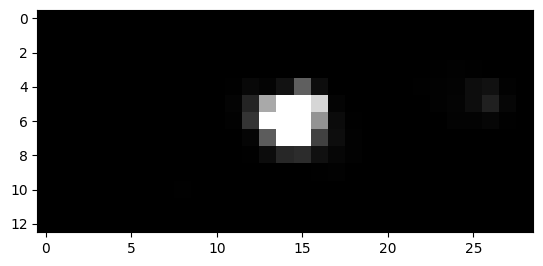

338


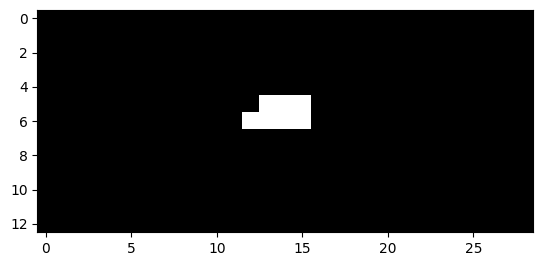

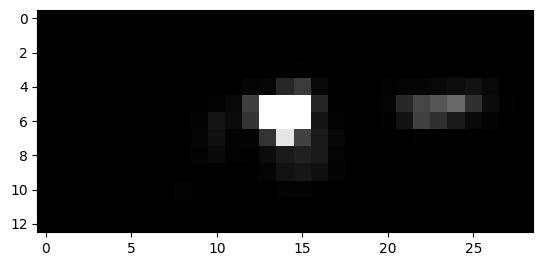

339


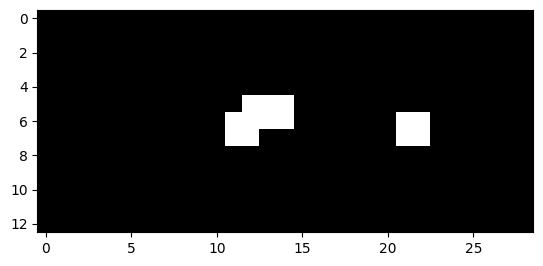

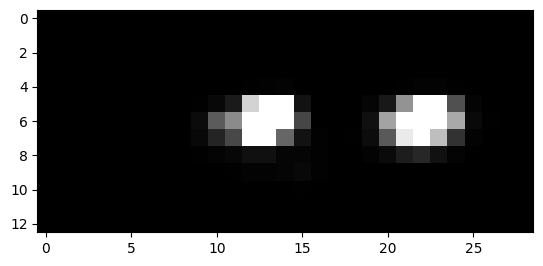

340


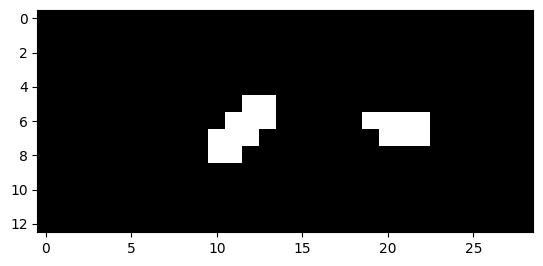

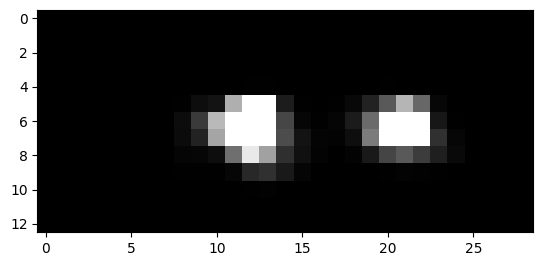

341


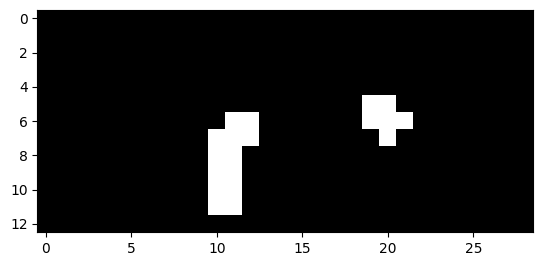

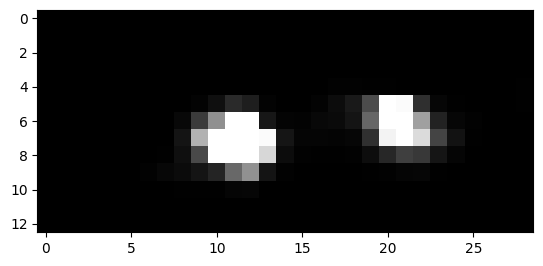

342


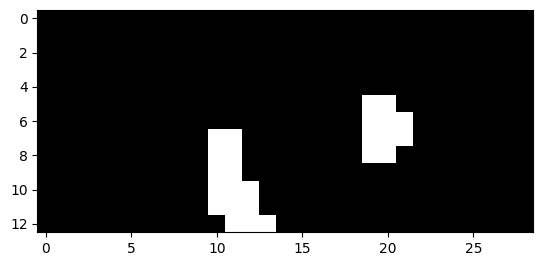

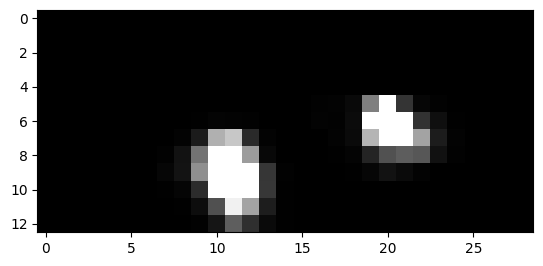

343


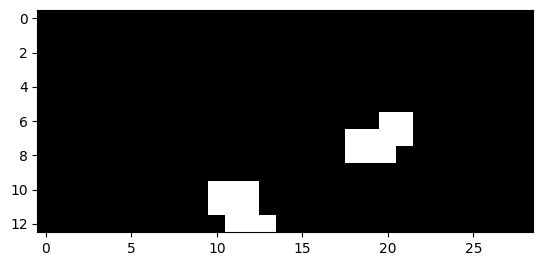

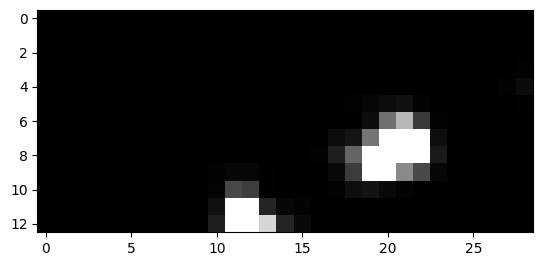

344


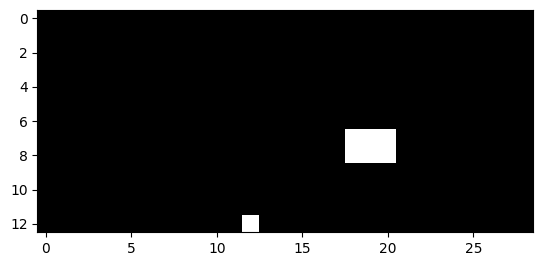

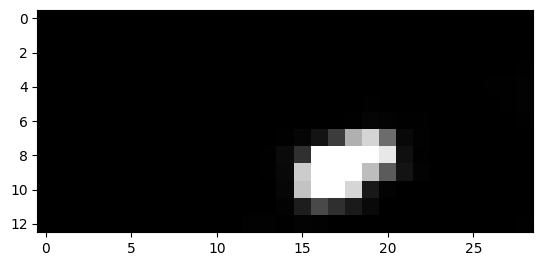

346


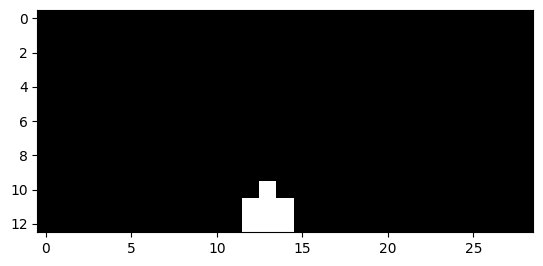

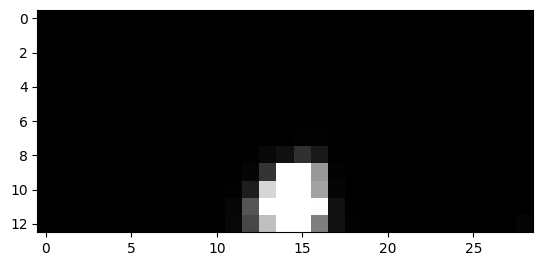

347


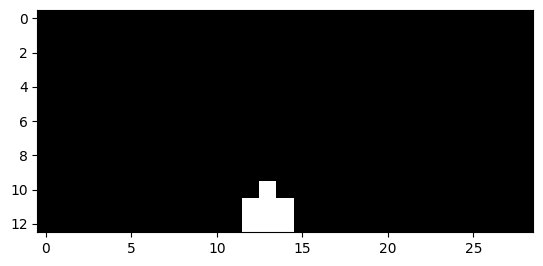

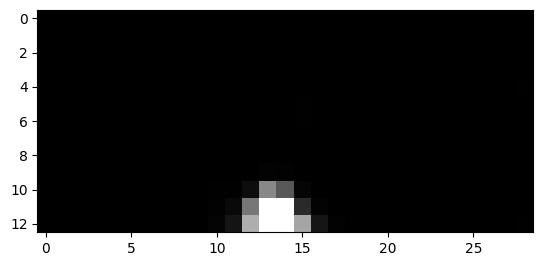

348


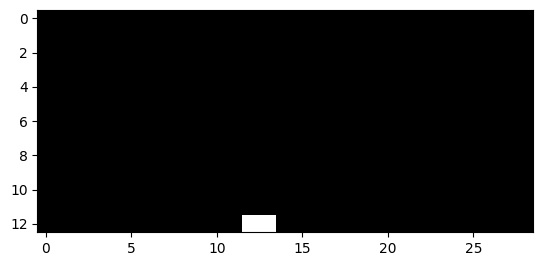

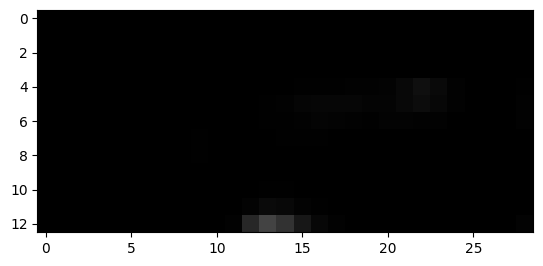

640


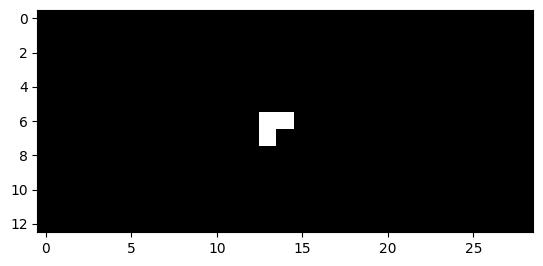

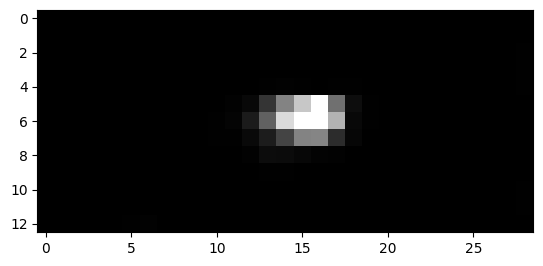

641


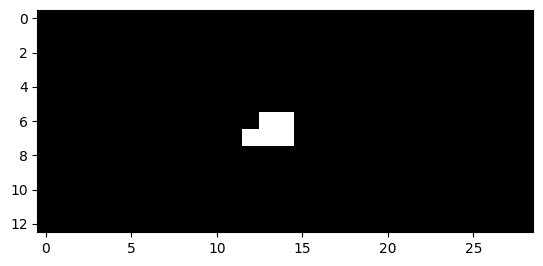

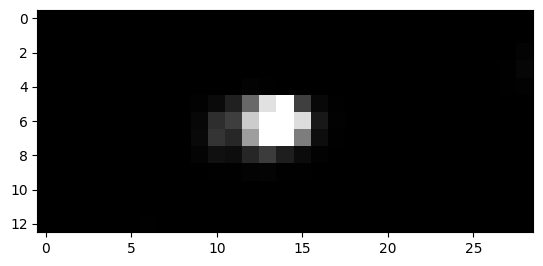

642


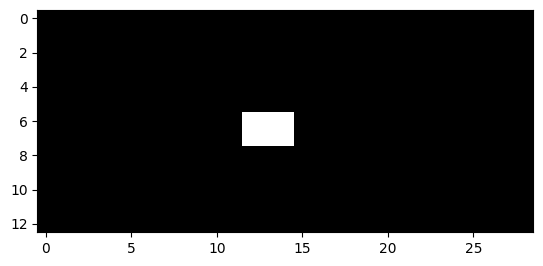

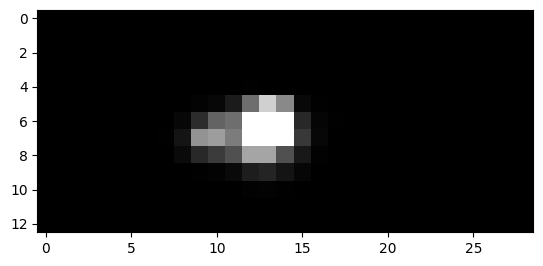

643


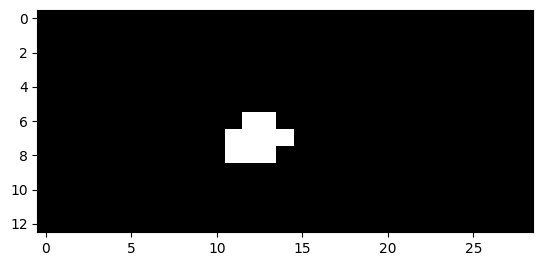

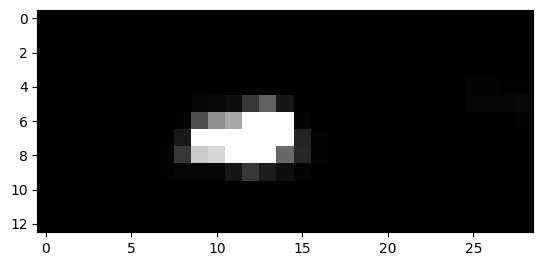

644


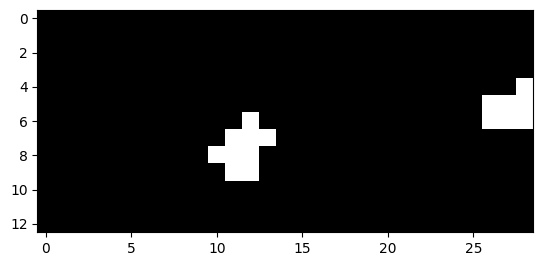

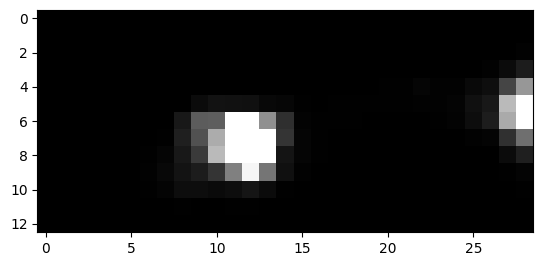

645


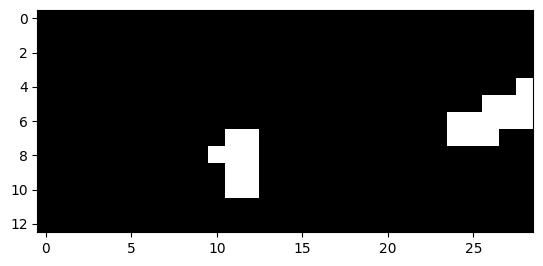

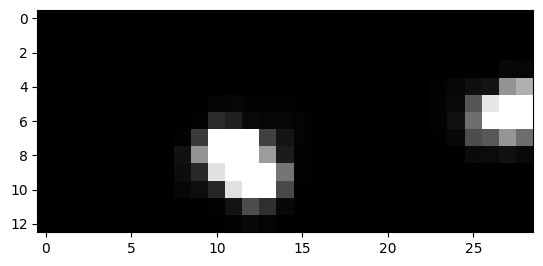

646


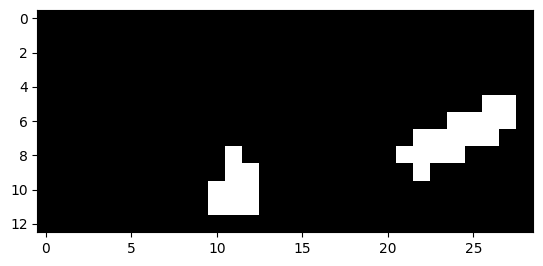

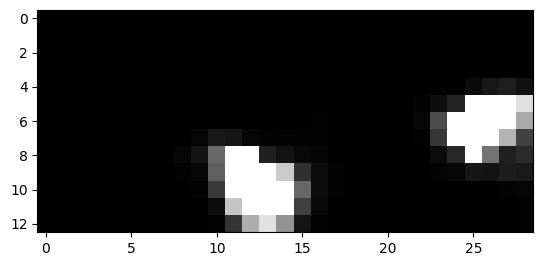

647


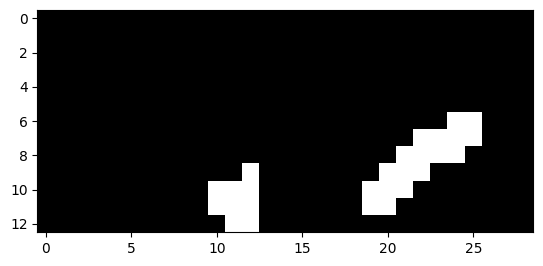

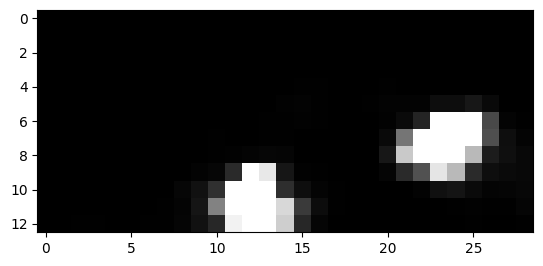

648


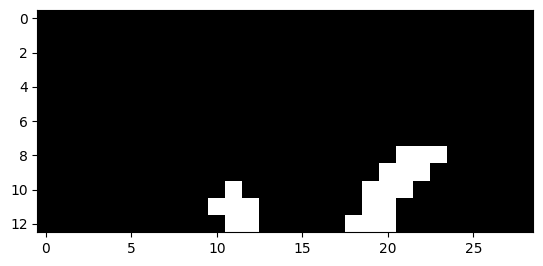

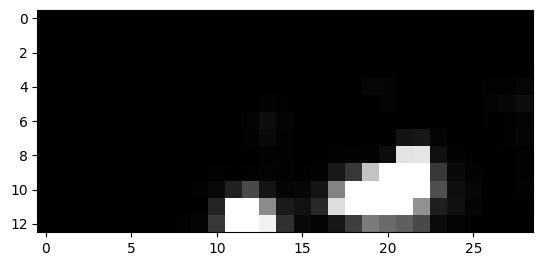

649


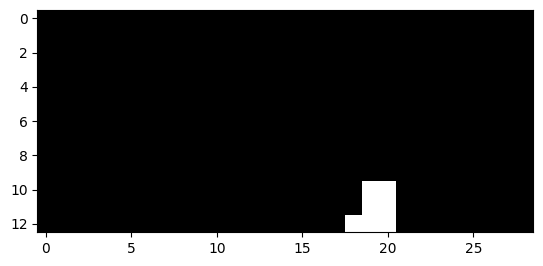

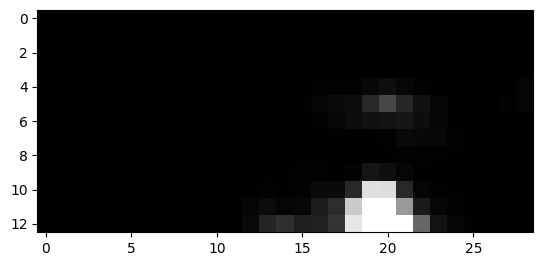

651


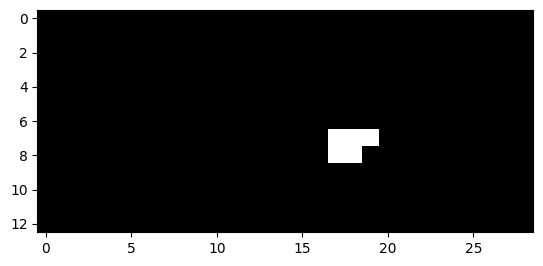

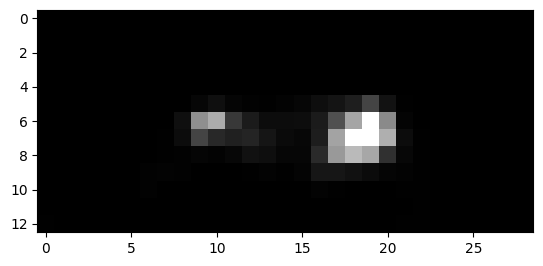

652


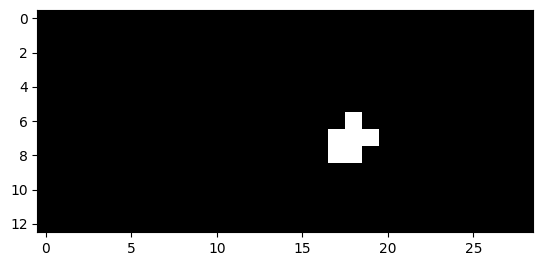

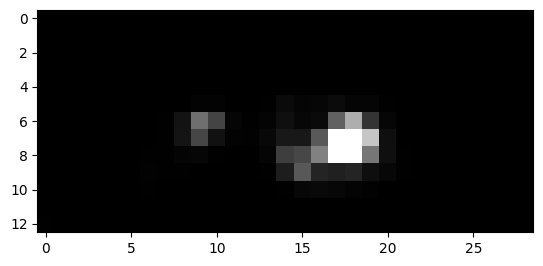

653


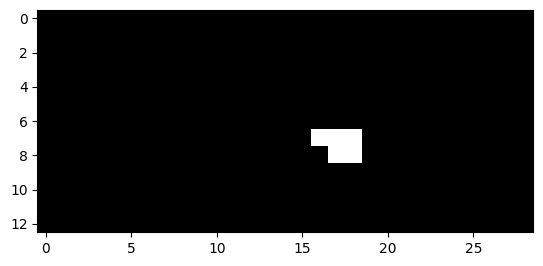

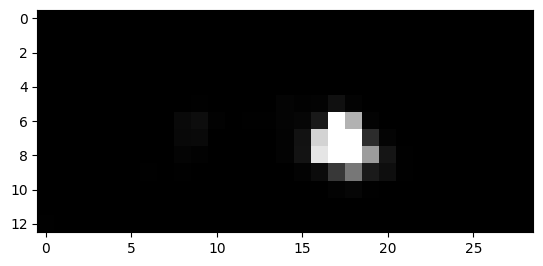

654


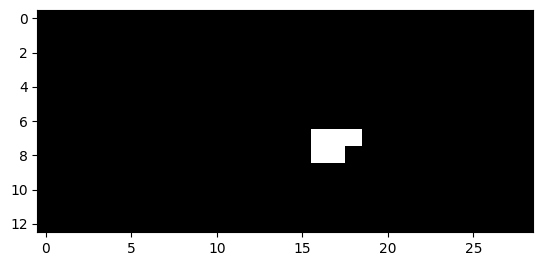

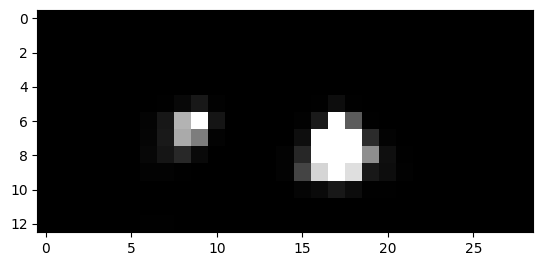

655


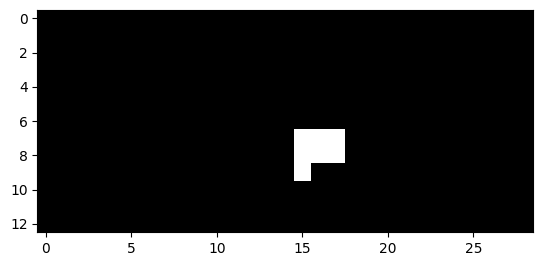

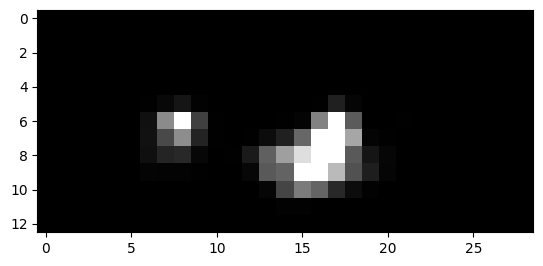

656


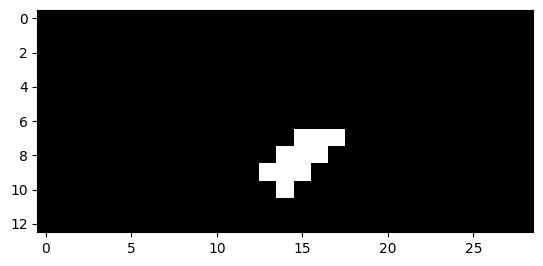

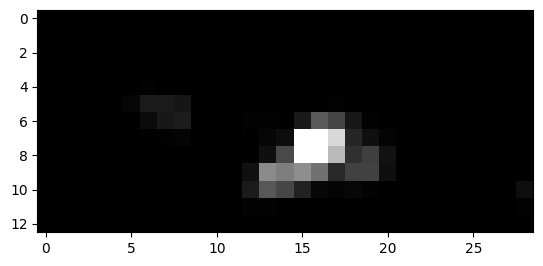

657


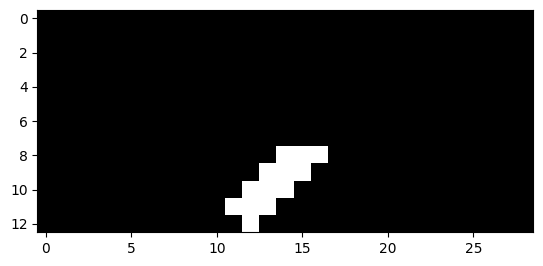

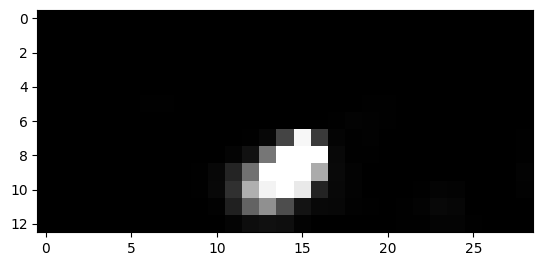

658


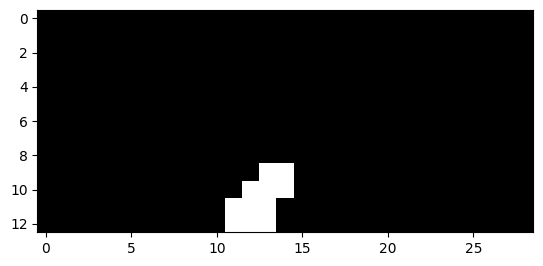

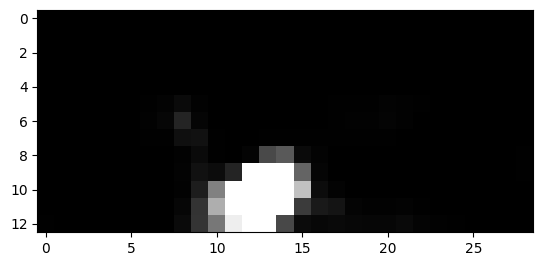

659


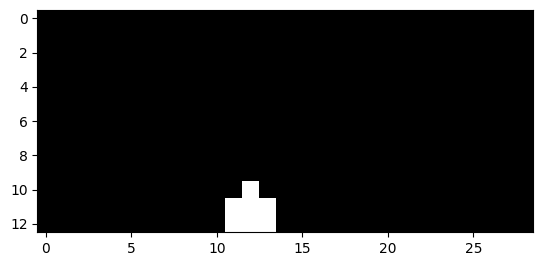

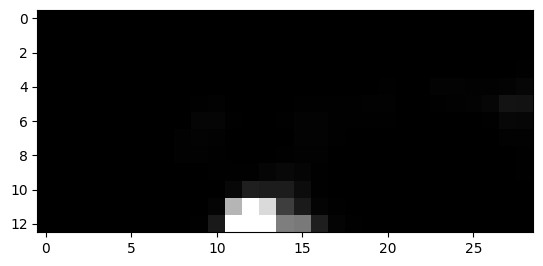

665


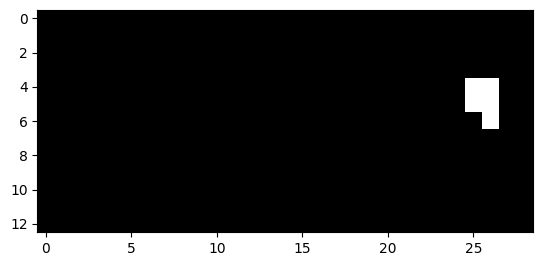

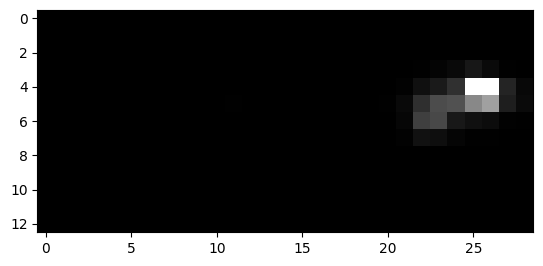

666


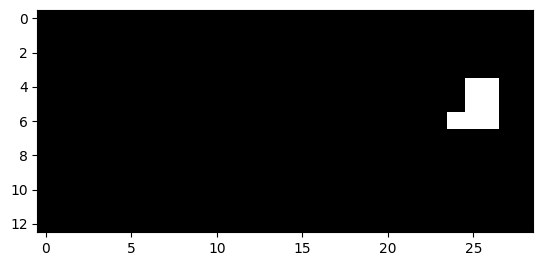

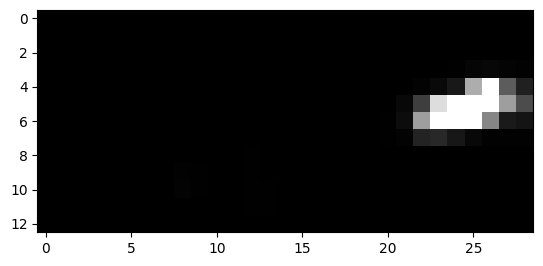

667


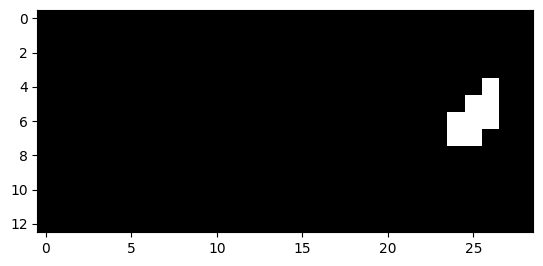

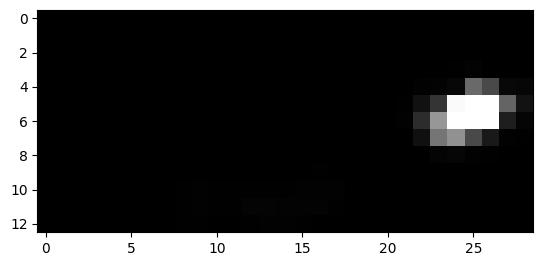

668


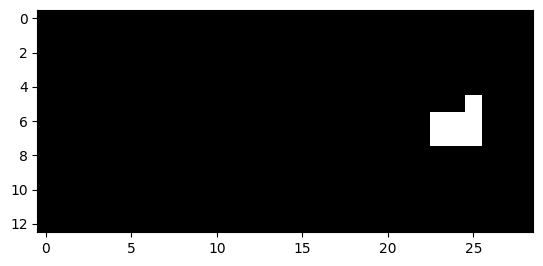

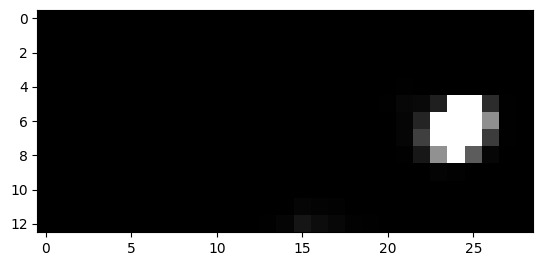

669


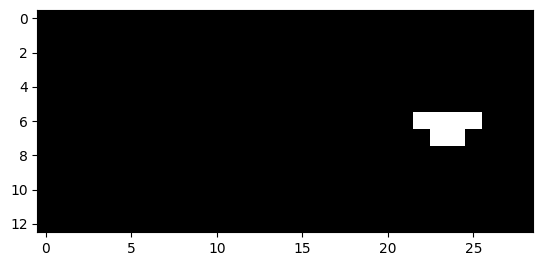

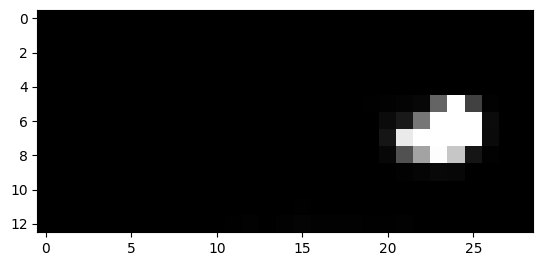

670


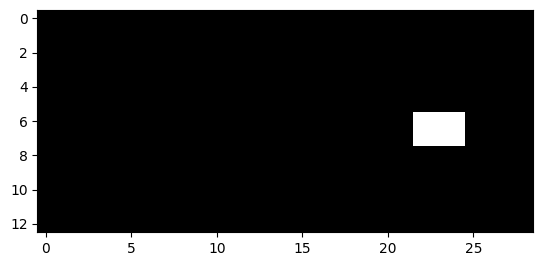

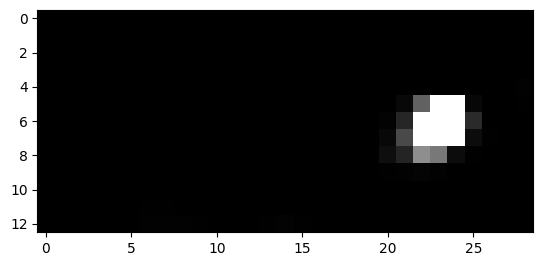

671


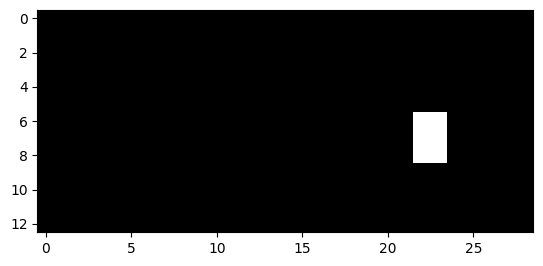

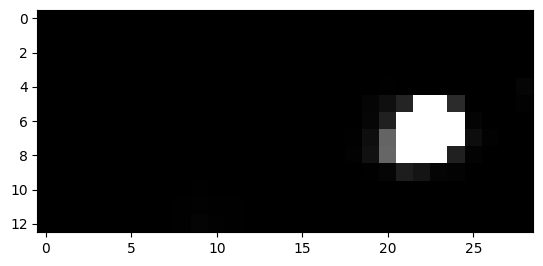

672


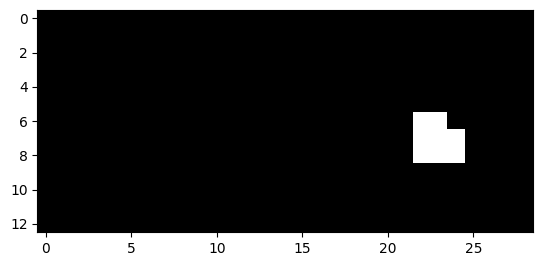

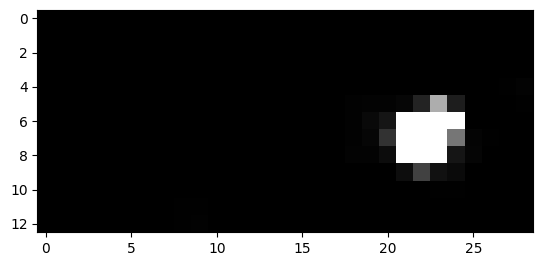

673


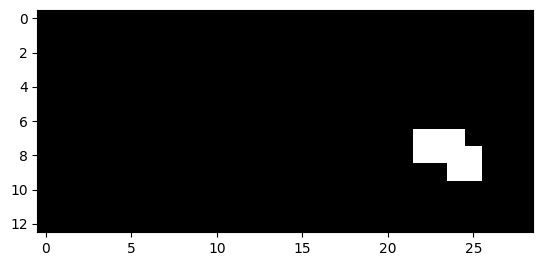

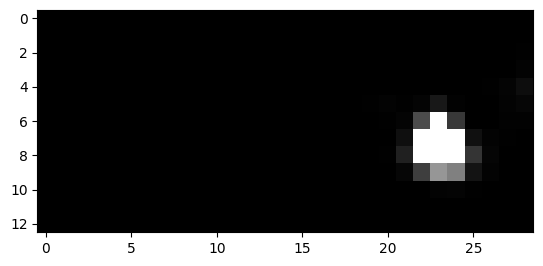

674


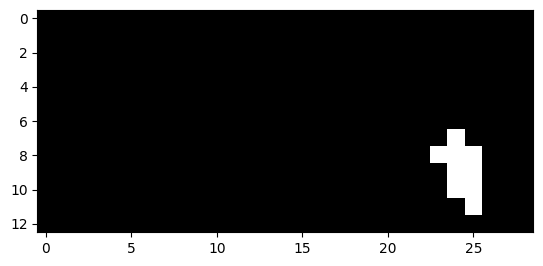

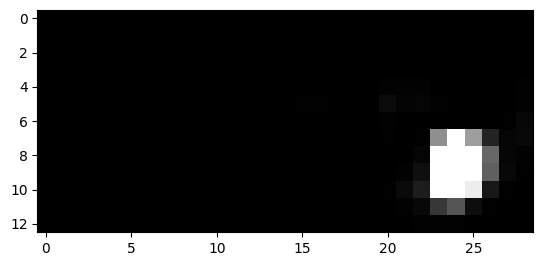

675


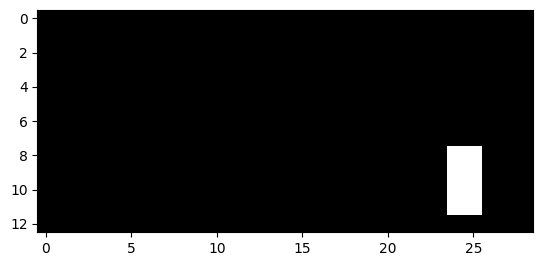

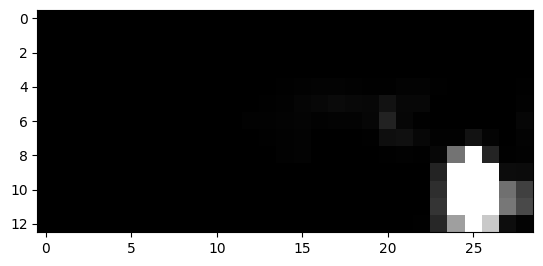

676


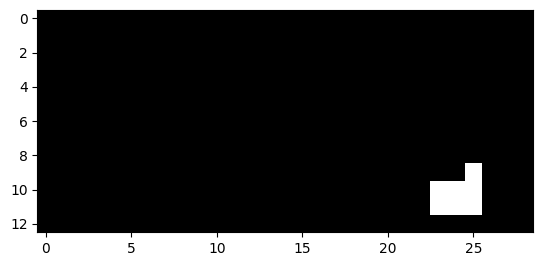

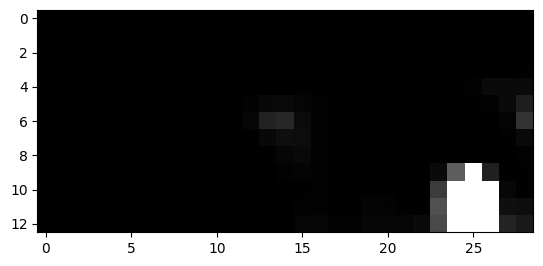

677


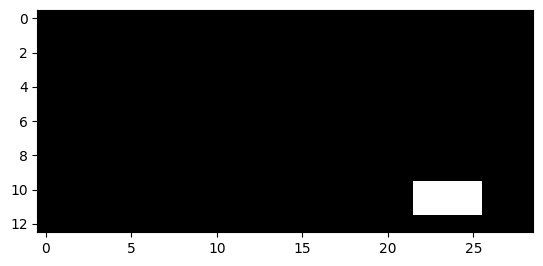

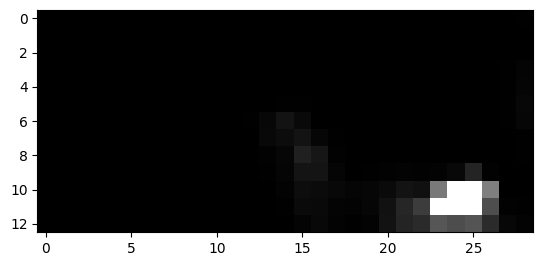

678


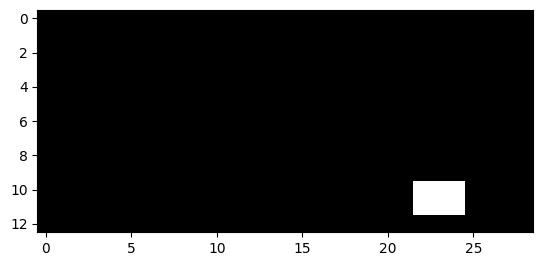

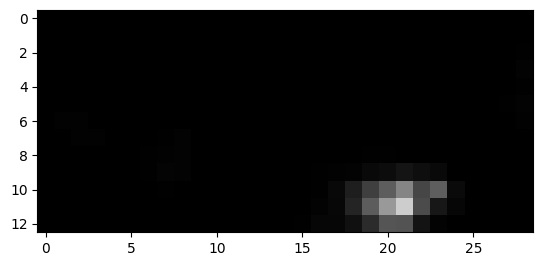

699


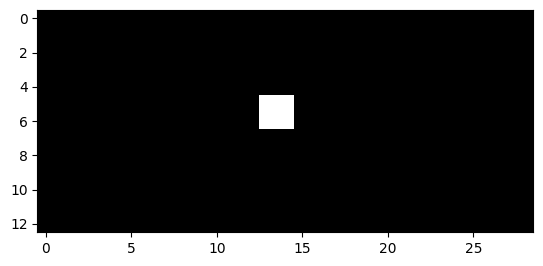

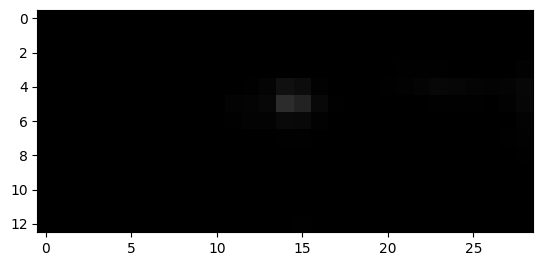

700


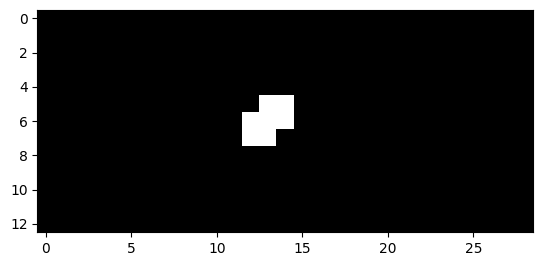

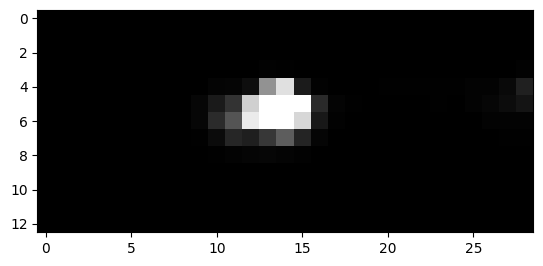

701


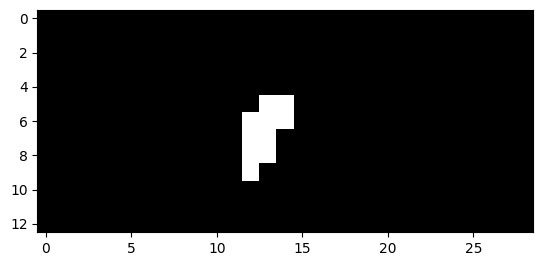

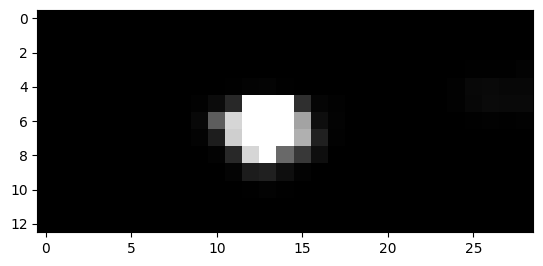

702


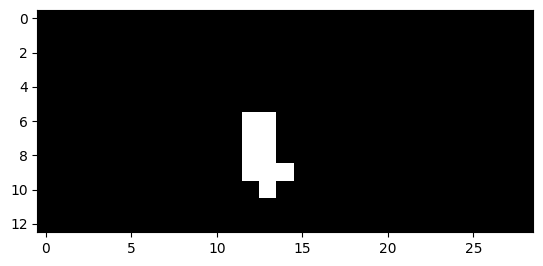

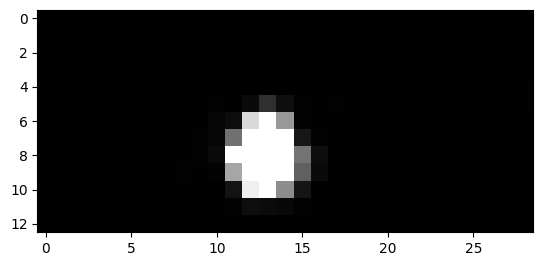

703


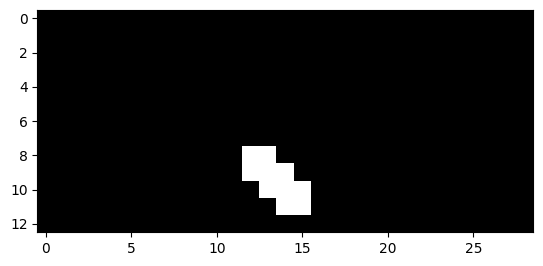

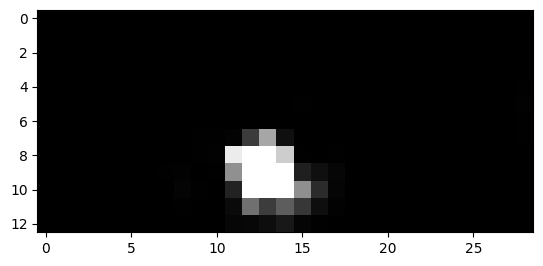

704


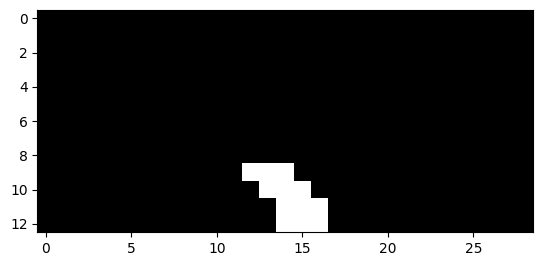

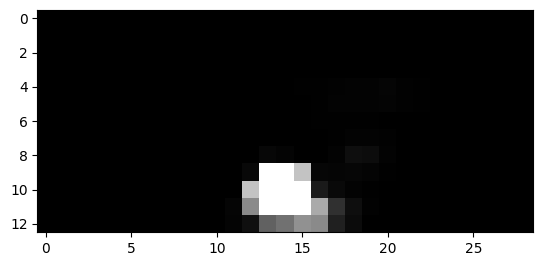

705


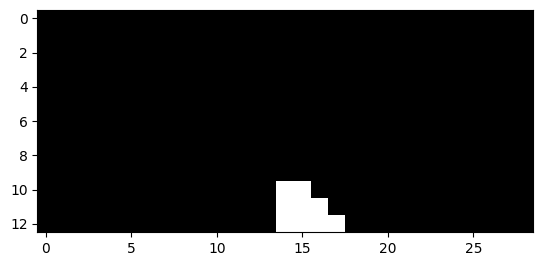

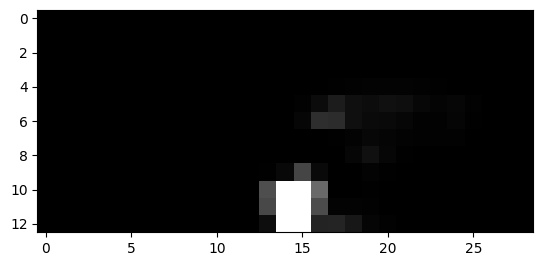

706


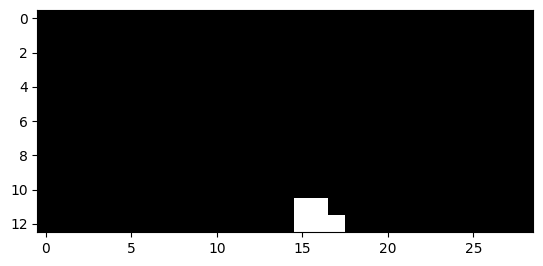

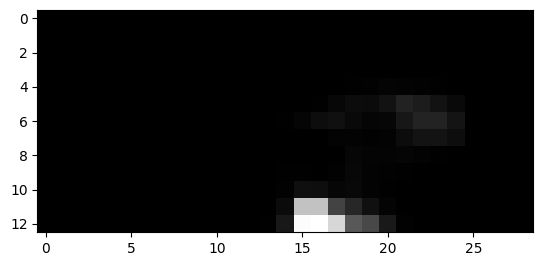

711


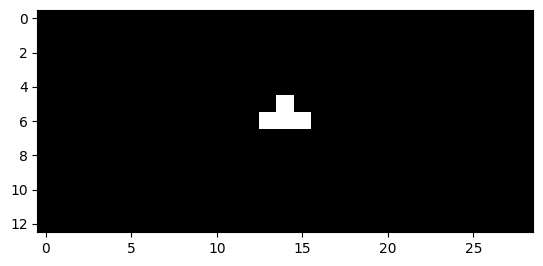

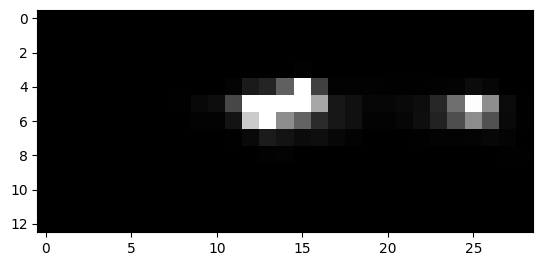

712


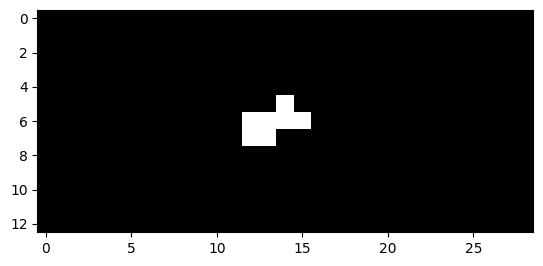

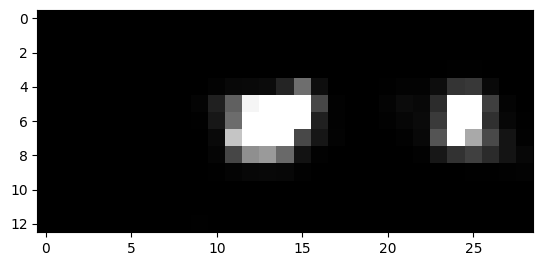

713


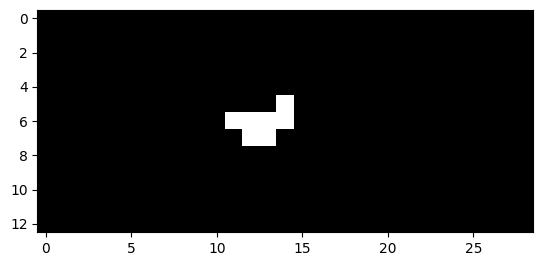

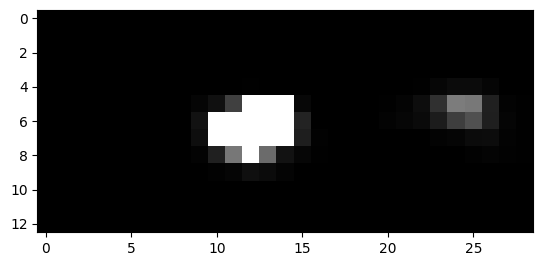

714


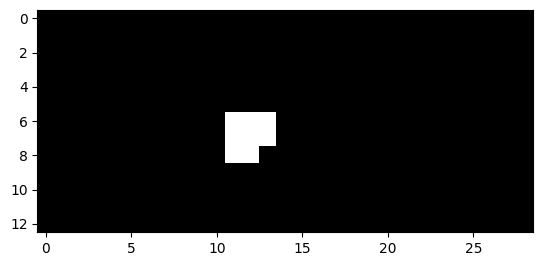

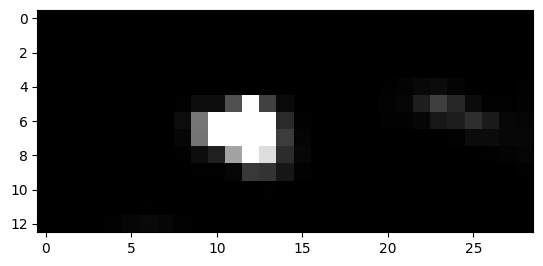

715


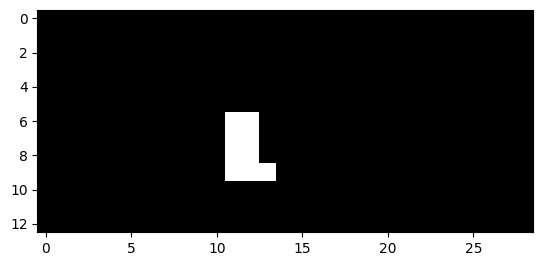

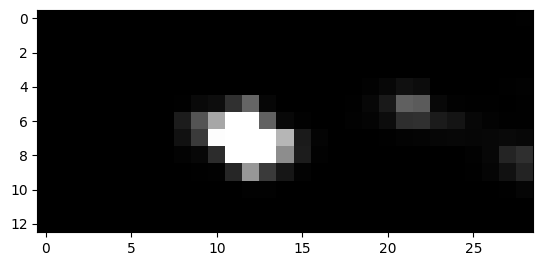

716


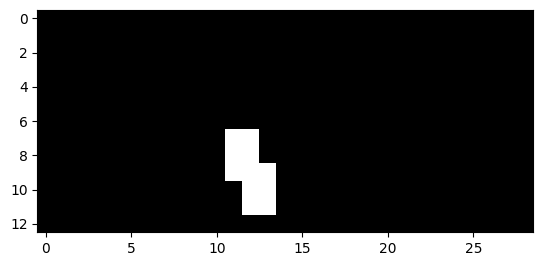

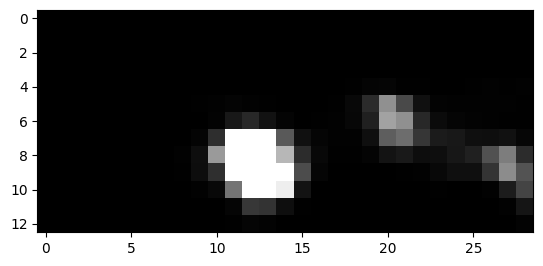

717


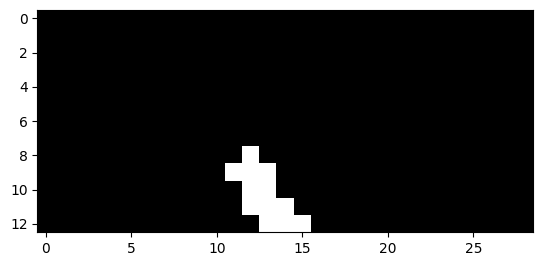

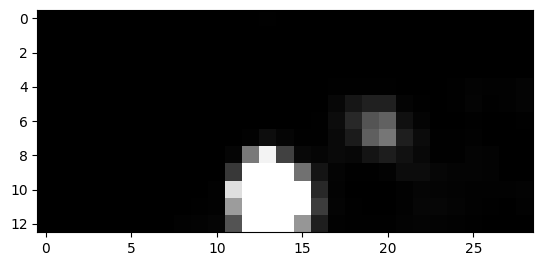

718


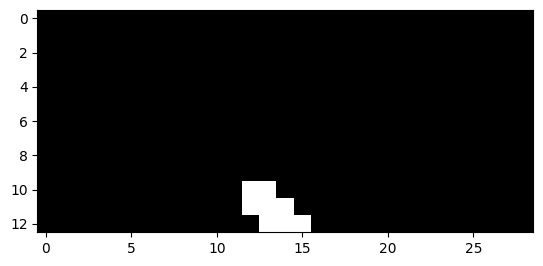

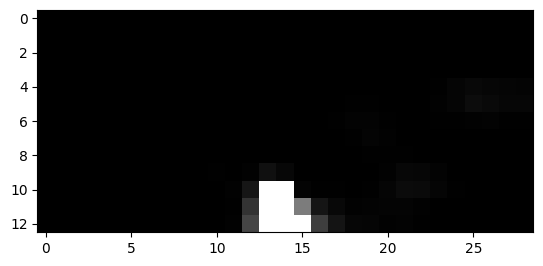

719


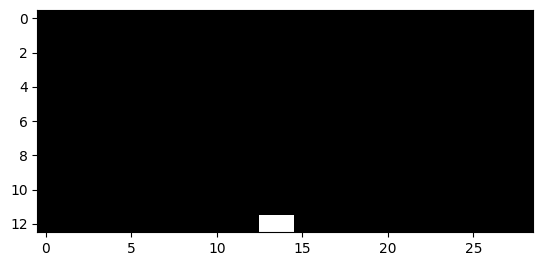

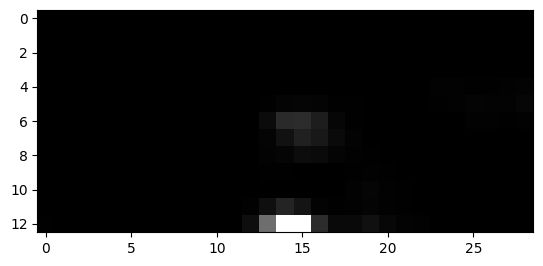

751


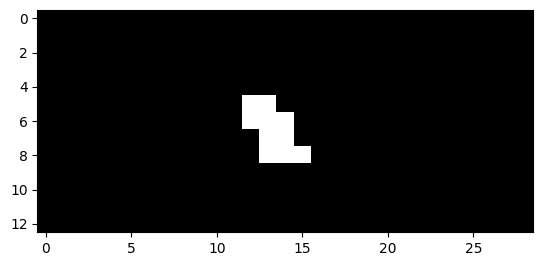

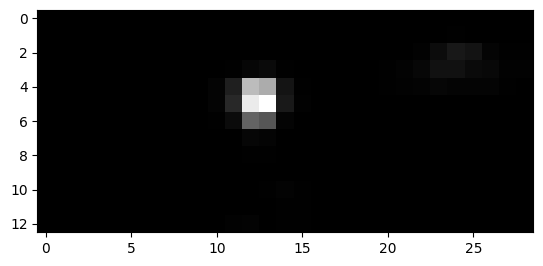

752


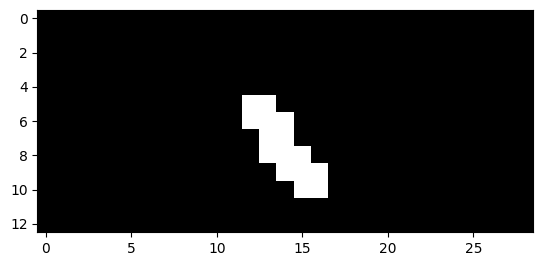

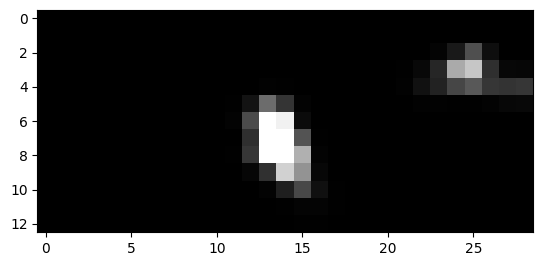

753


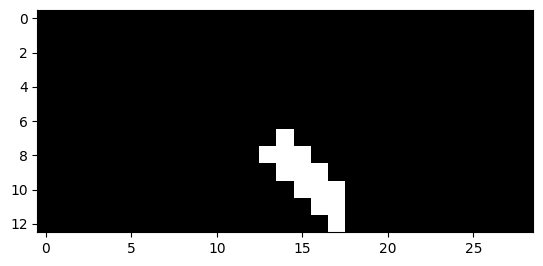

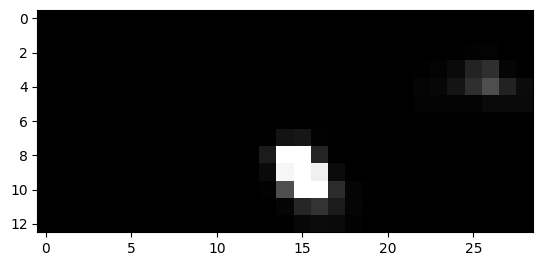

754


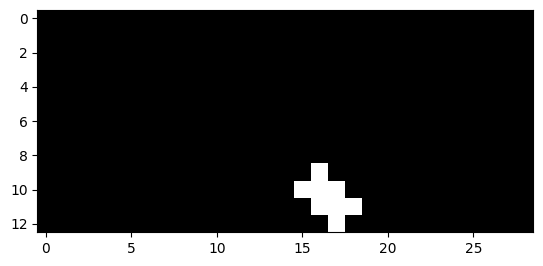

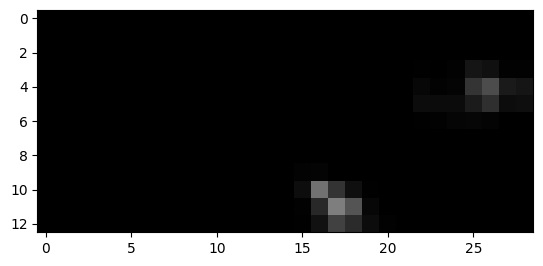

755


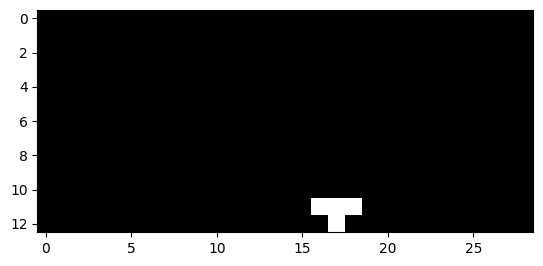

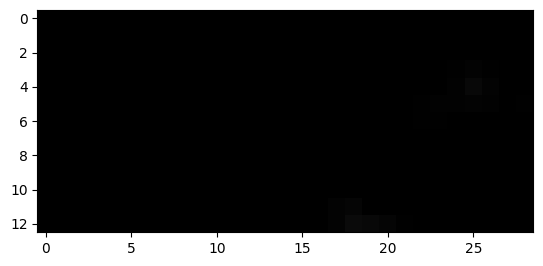

756


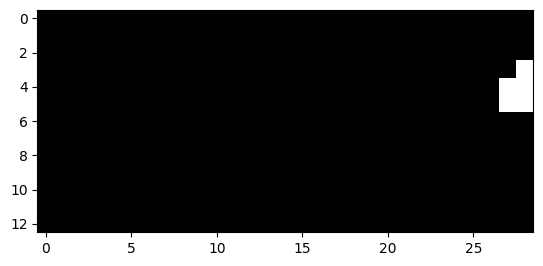

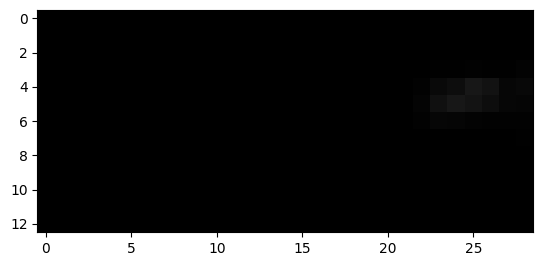

757


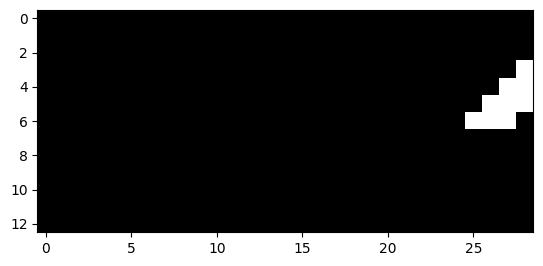

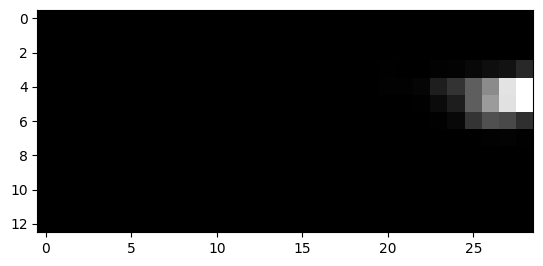

758


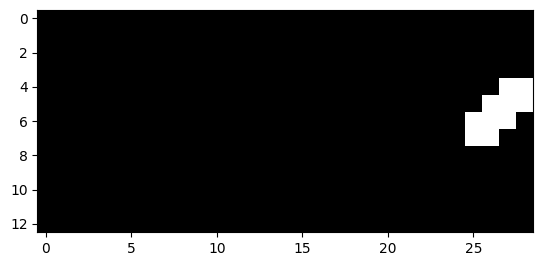

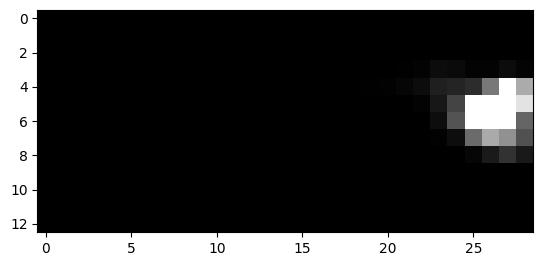

759


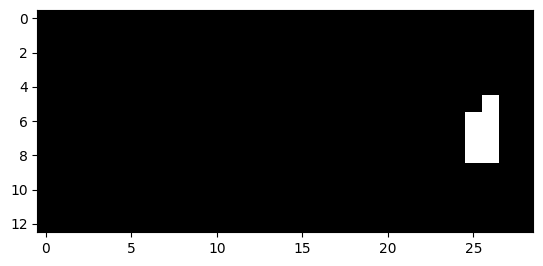

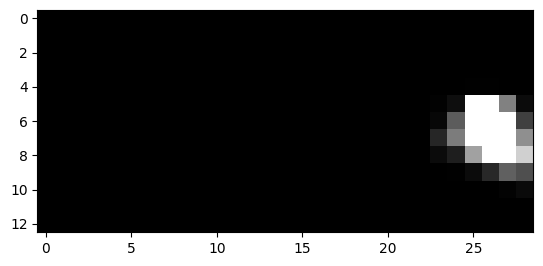

760


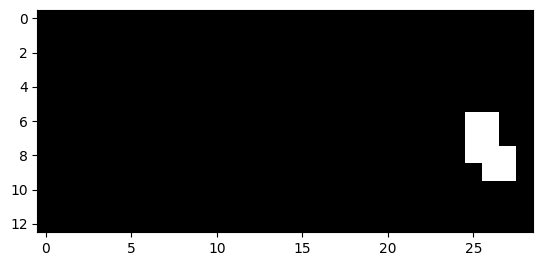

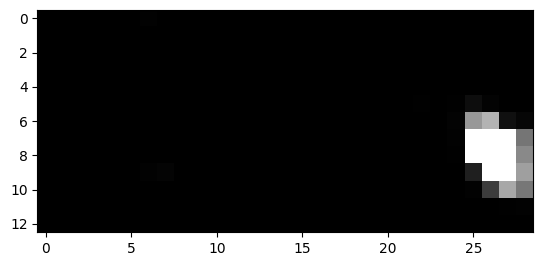

761


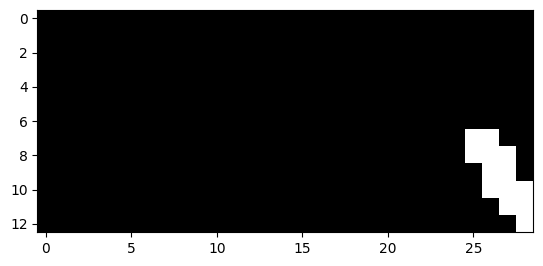

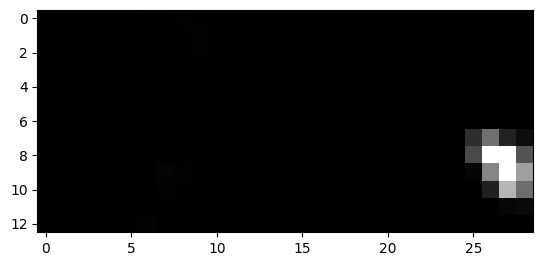

762


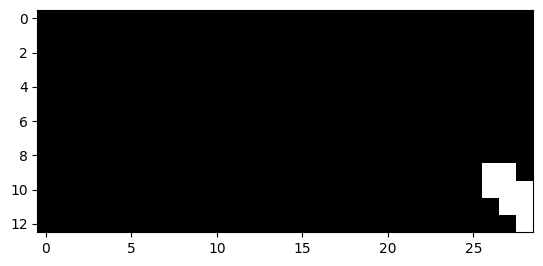

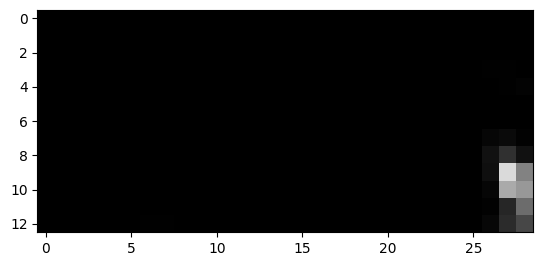

763


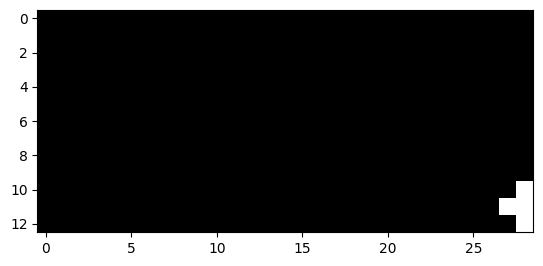

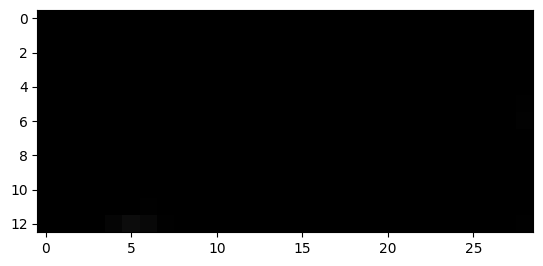

896


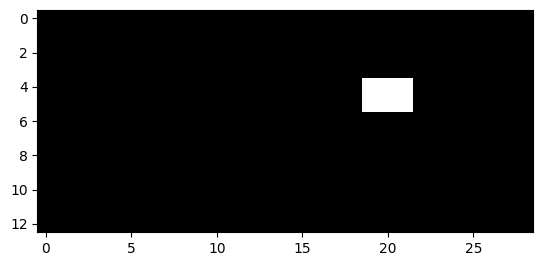

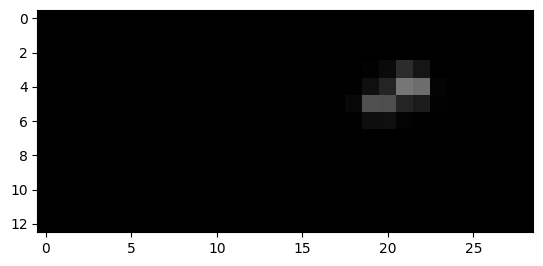

897


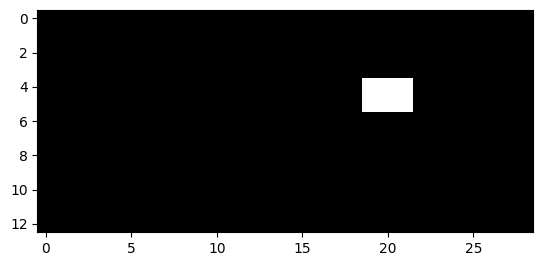

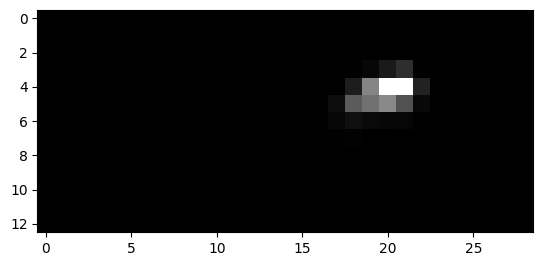

948


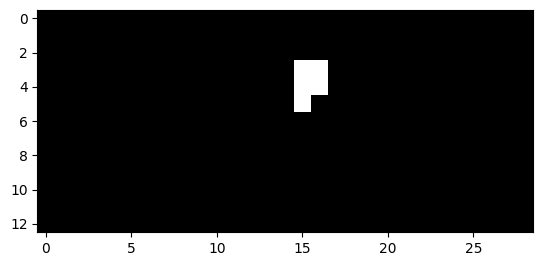

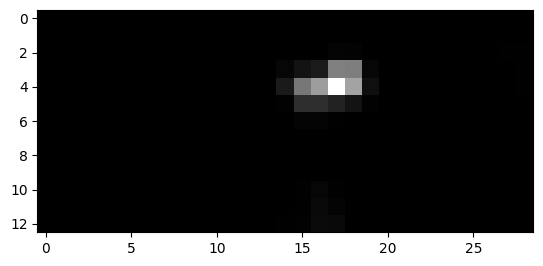

949


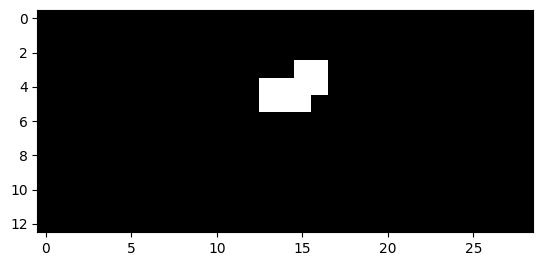

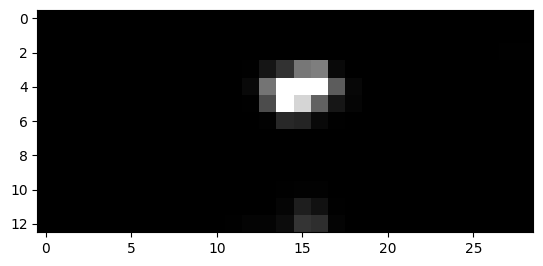

950


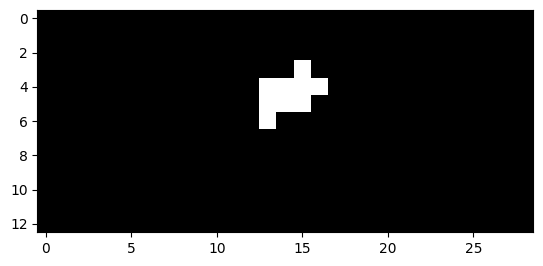

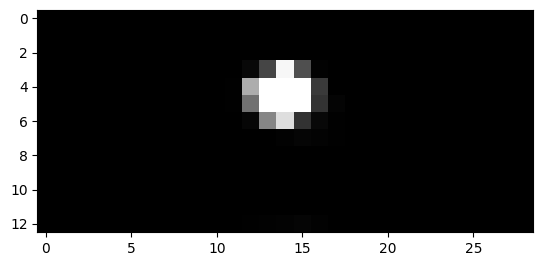

951


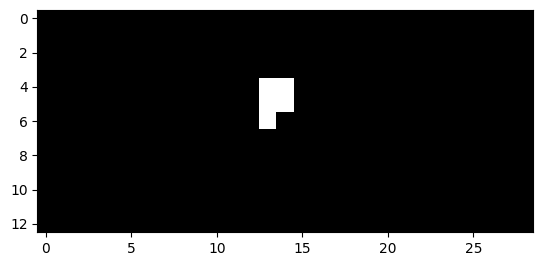

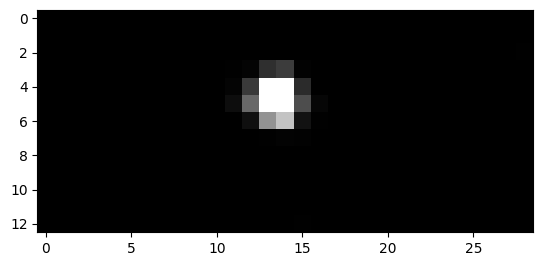

952


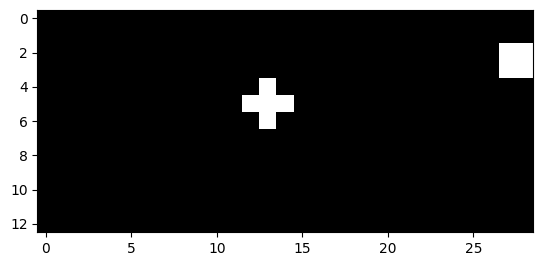

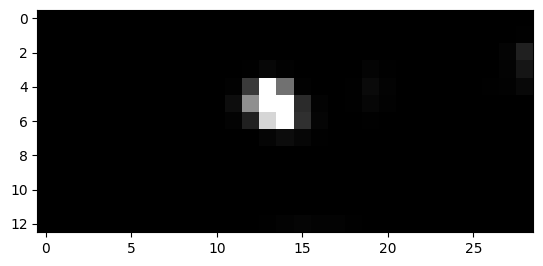

953


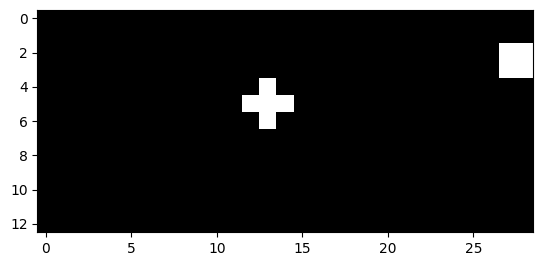

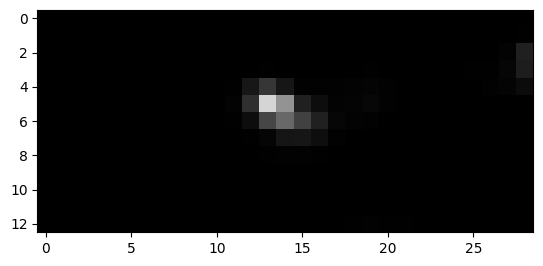

954


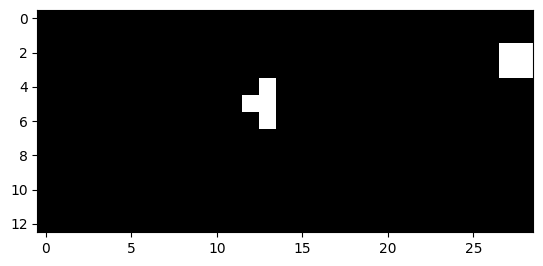

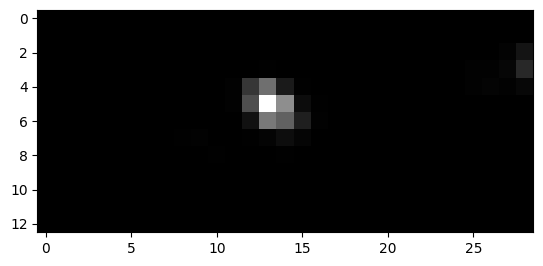

955


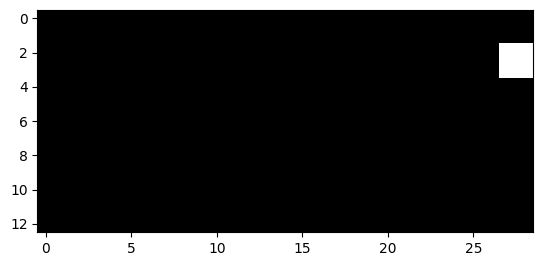

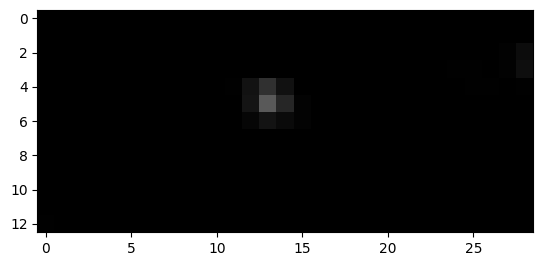

959


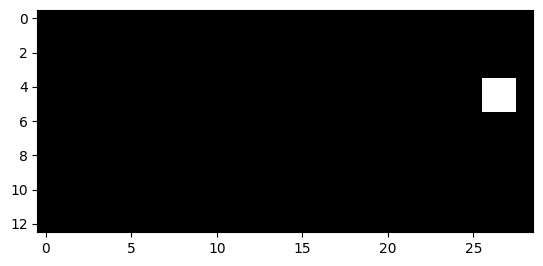

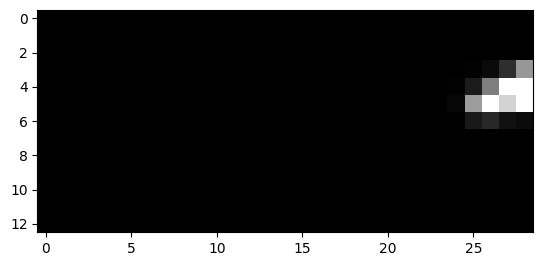

960


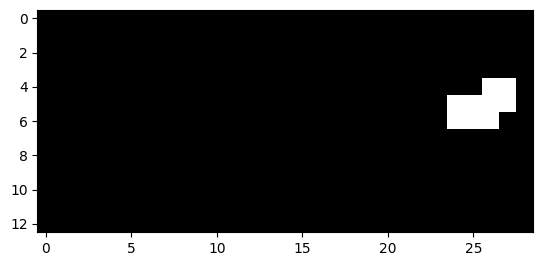

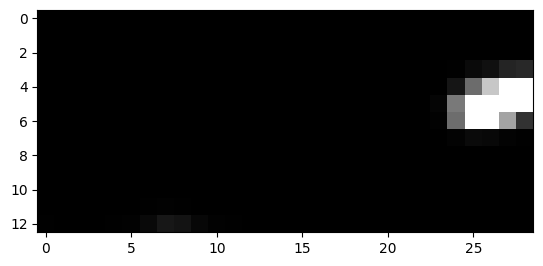

961


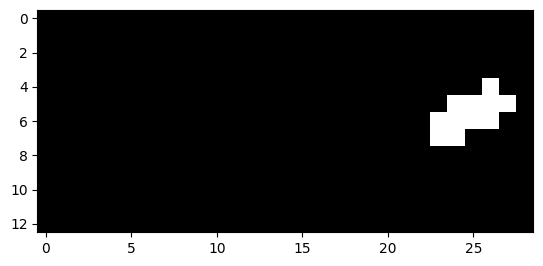

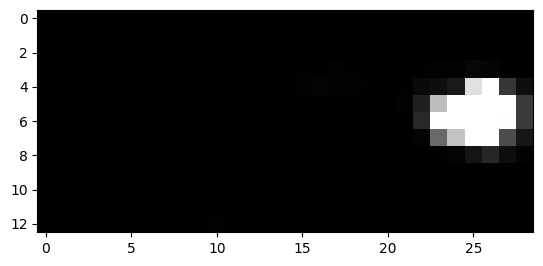

962


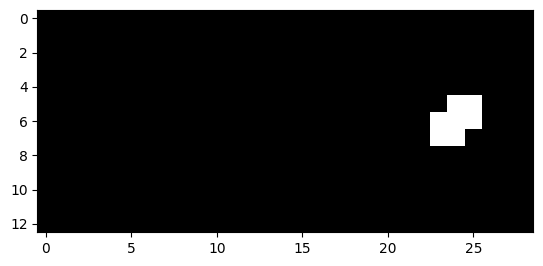

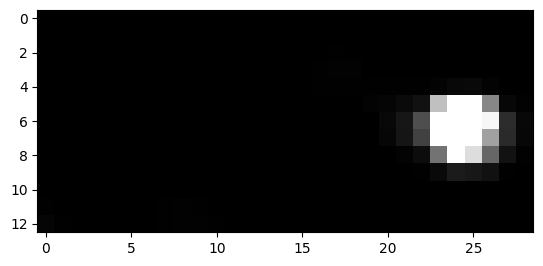

987


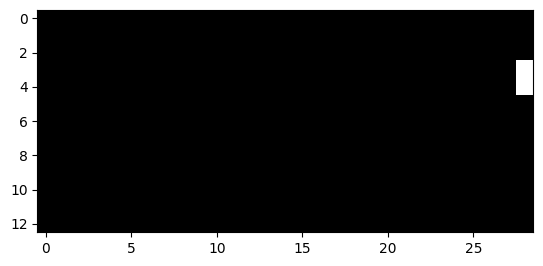

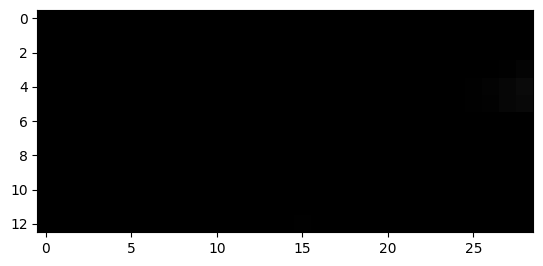

988


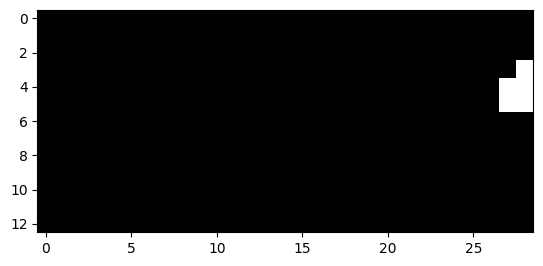

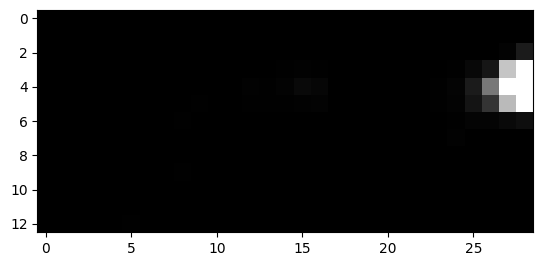

989


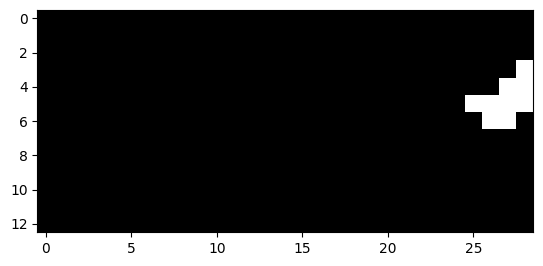

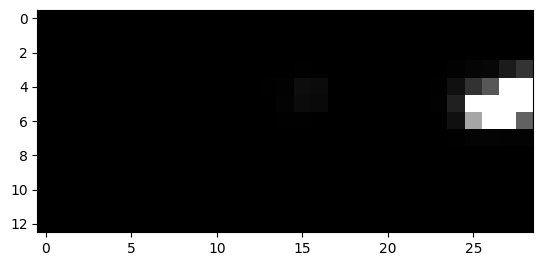

990


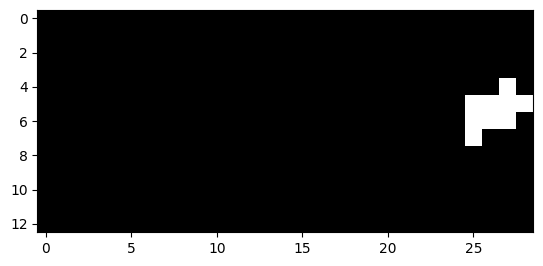

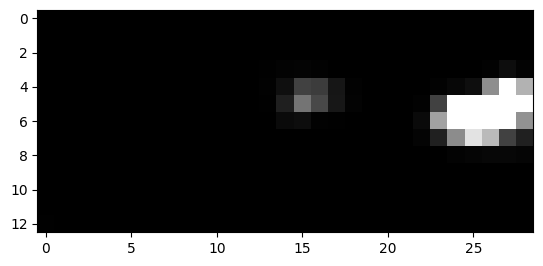

991


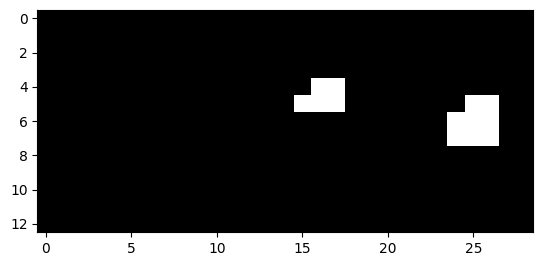

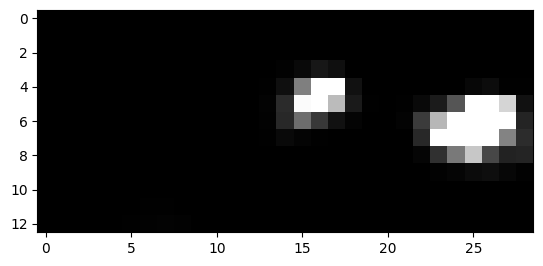

992


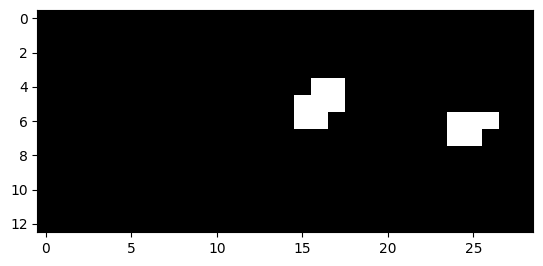

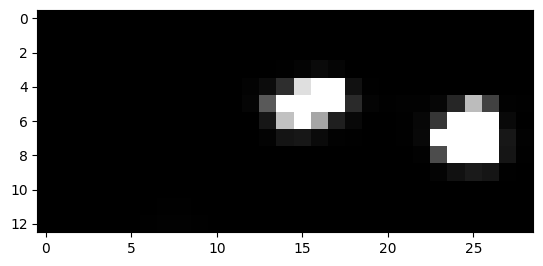

993


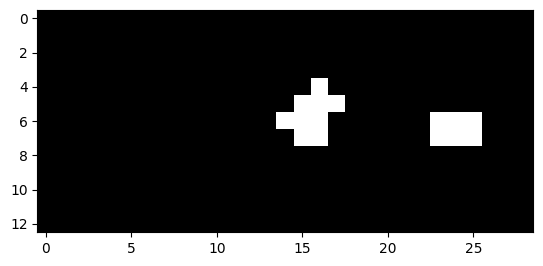

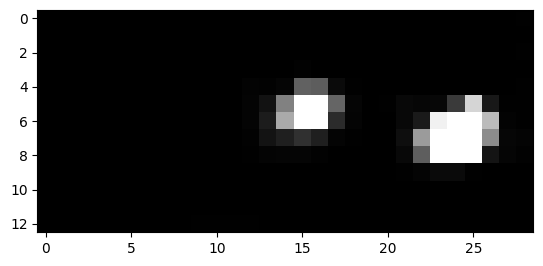

994


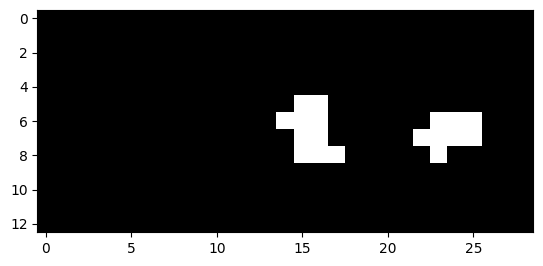

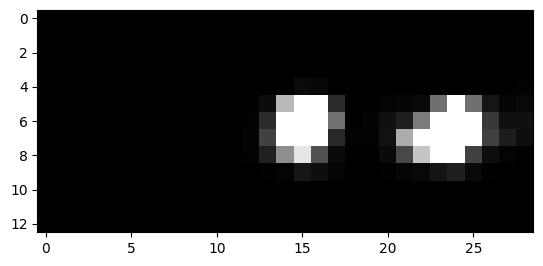

995


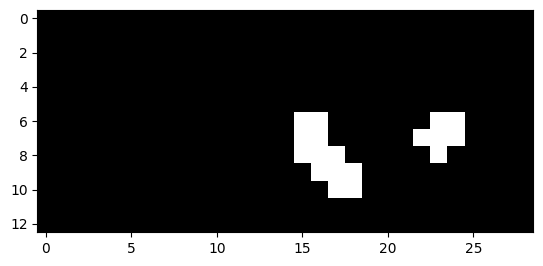

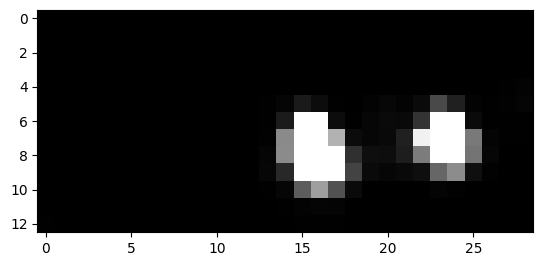

996


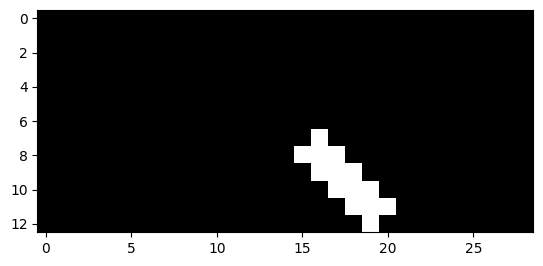

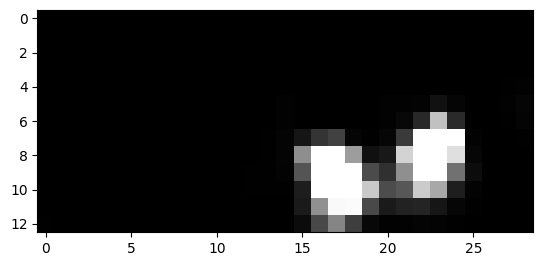

997


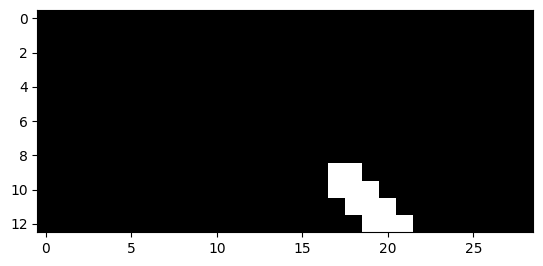

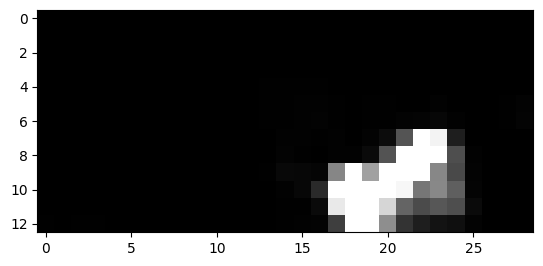

998


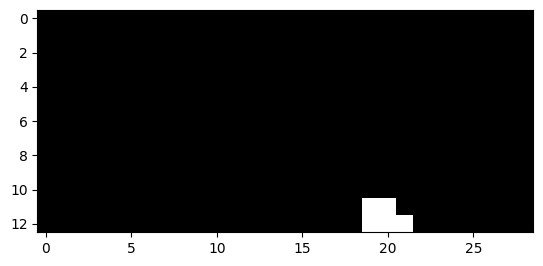

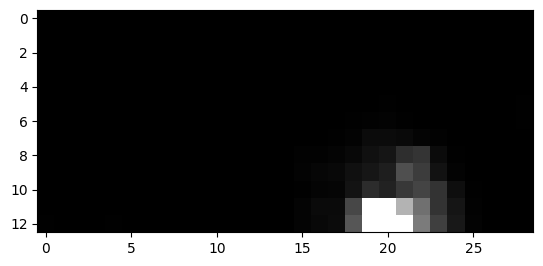

1023


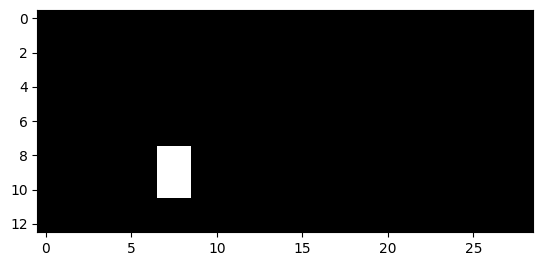

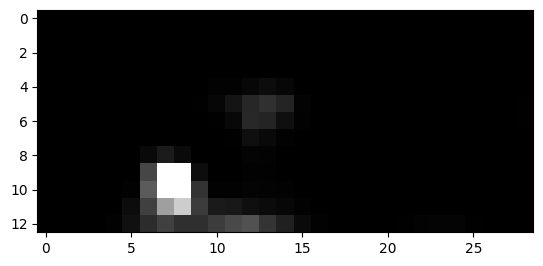

1024


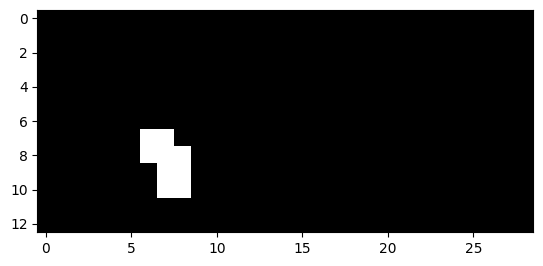

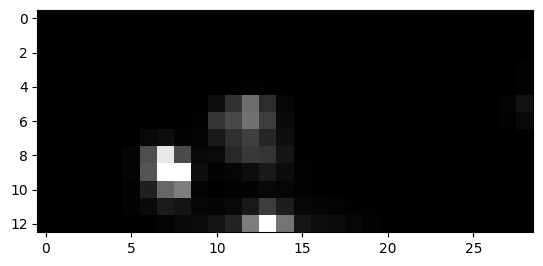

1025


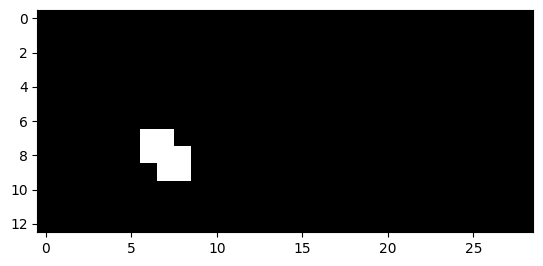

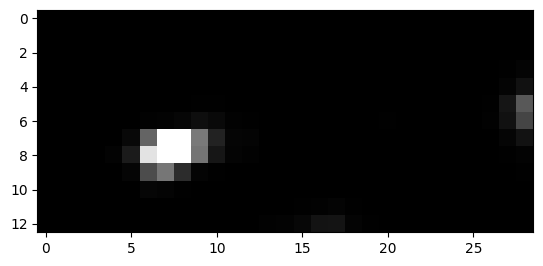

1027


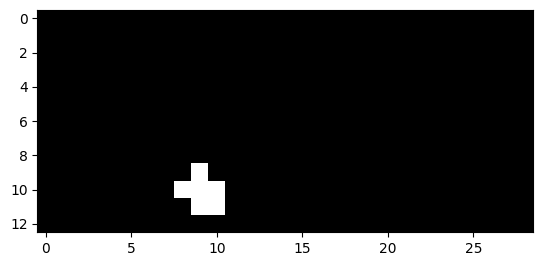

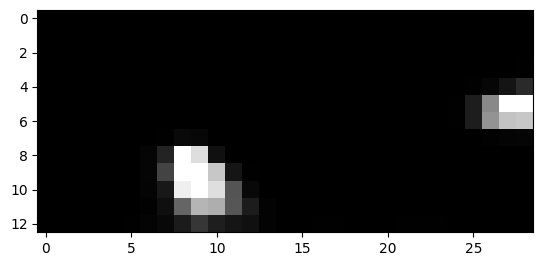

1028


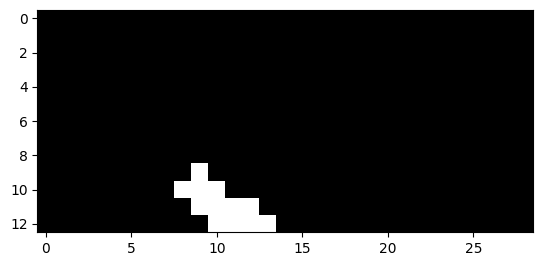

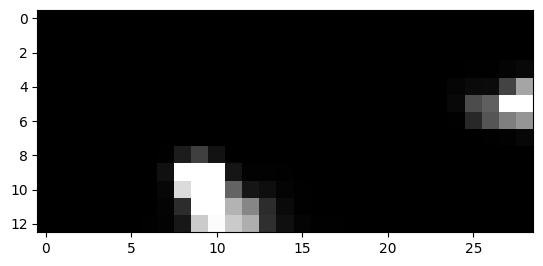

1029


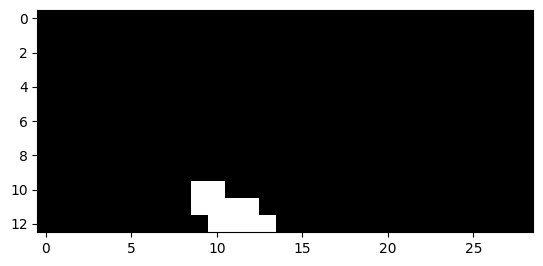

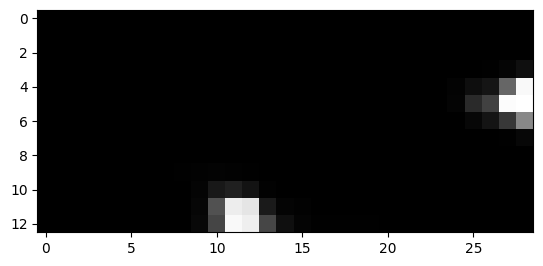

1039


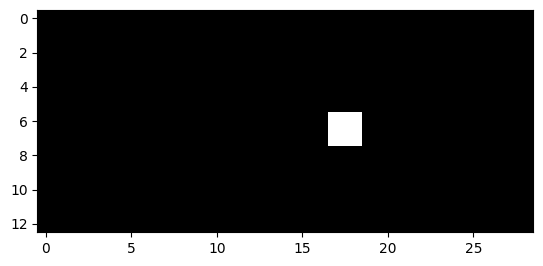

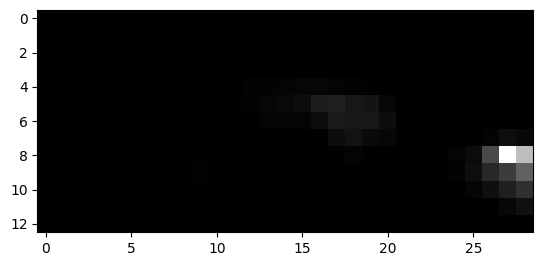

1040


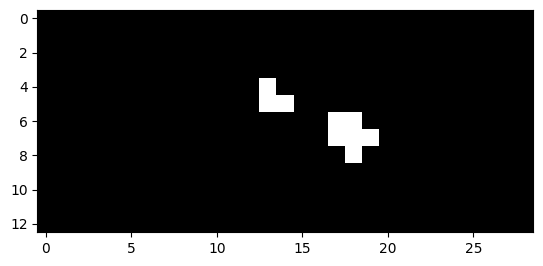

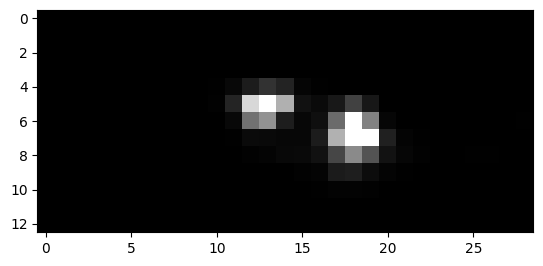

1041


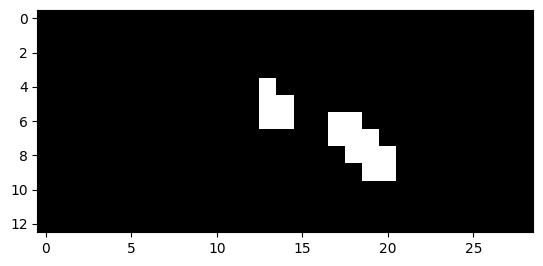

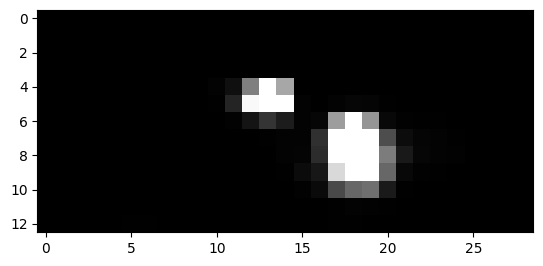

1042


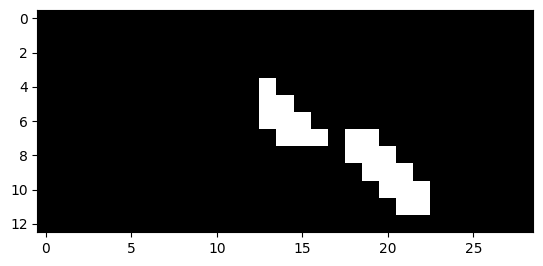

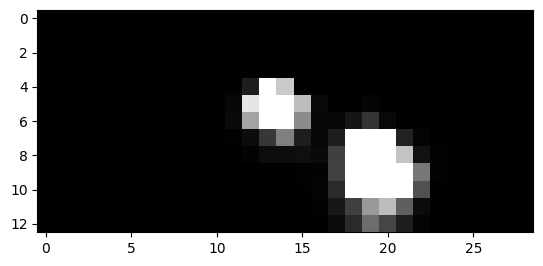

1043


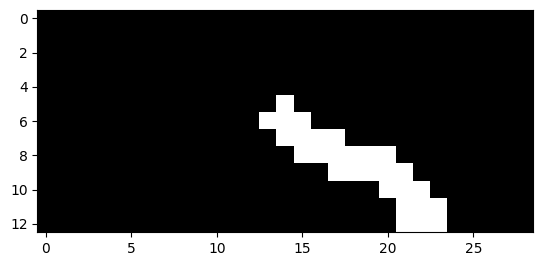

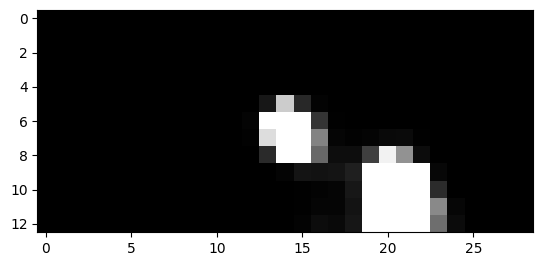

1044


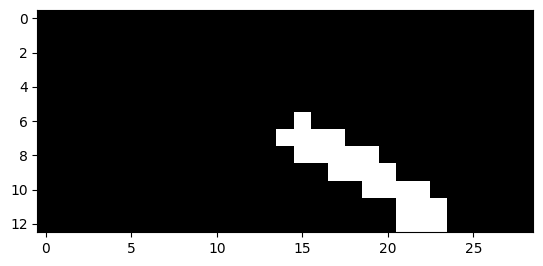

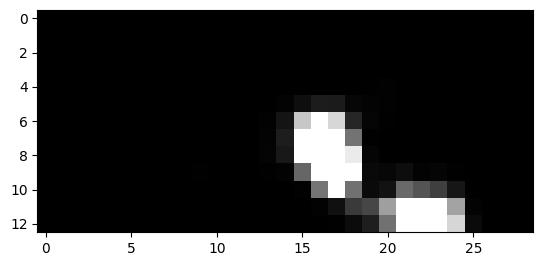

1045


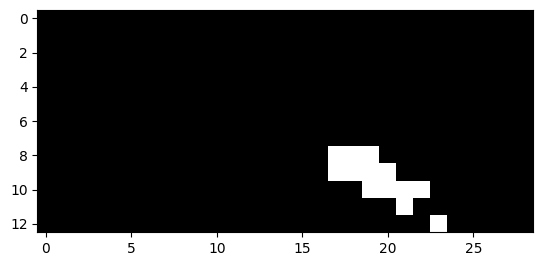

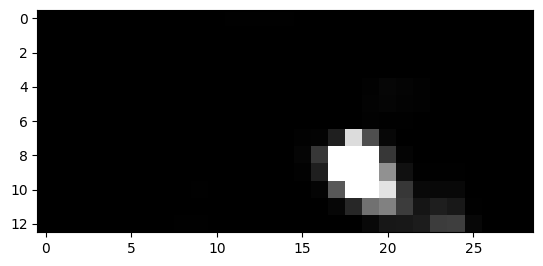

1046


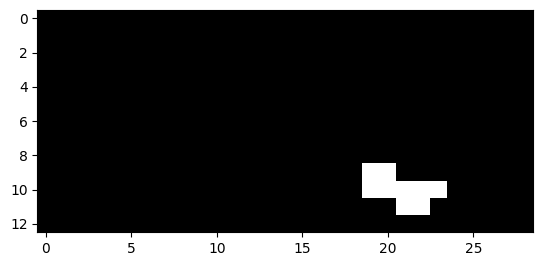

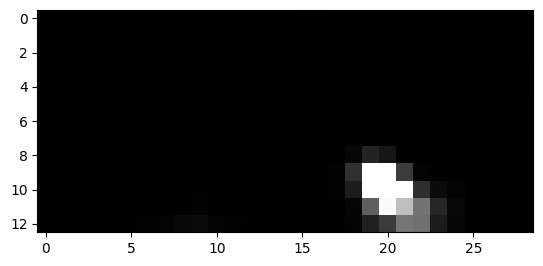

1047


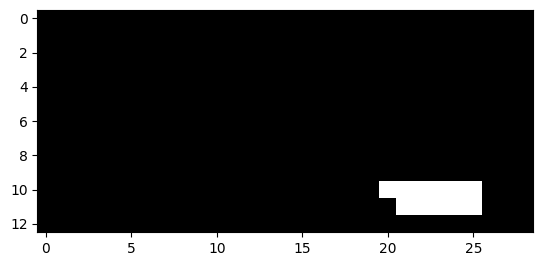

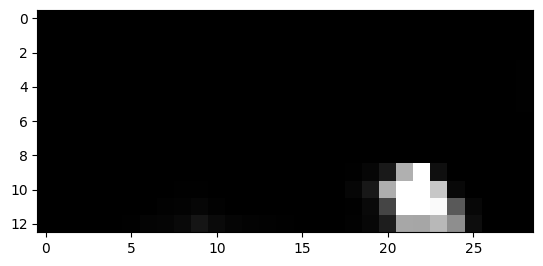

1048


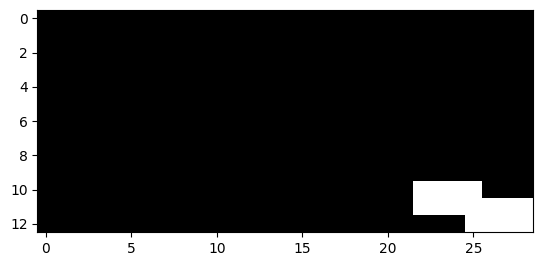

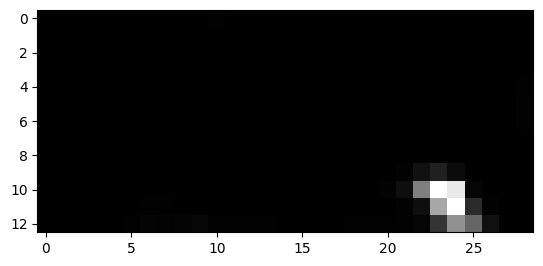

1049


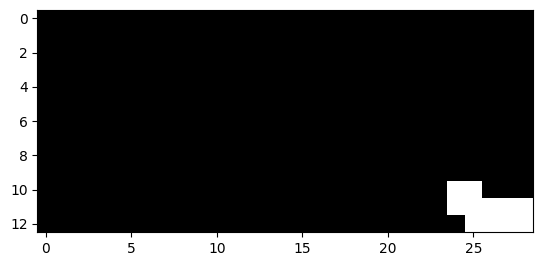

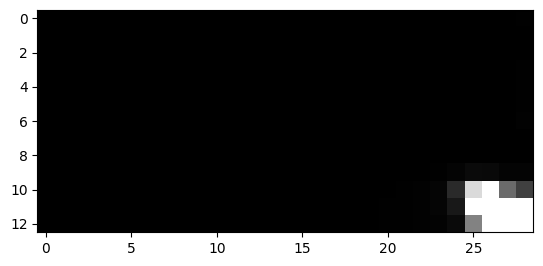

1050


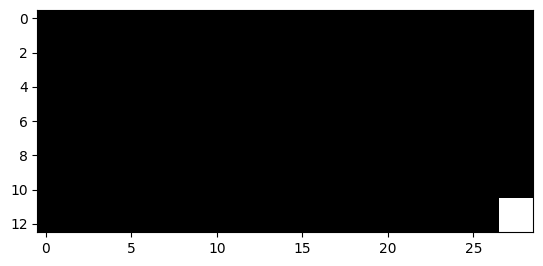

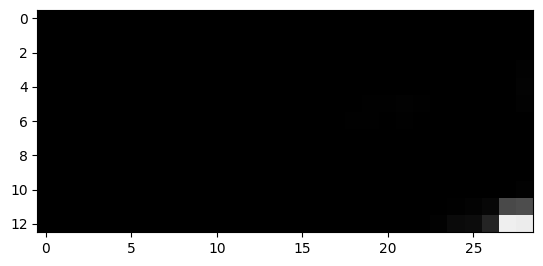

1064


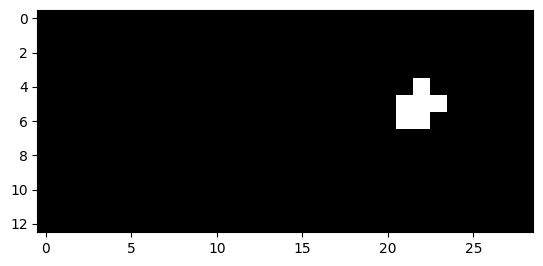

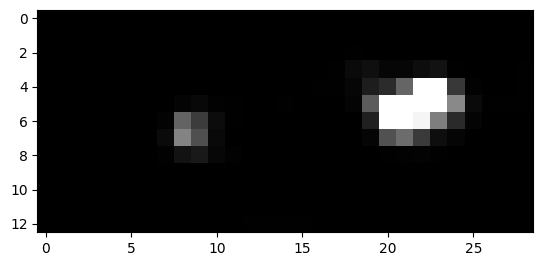

1065


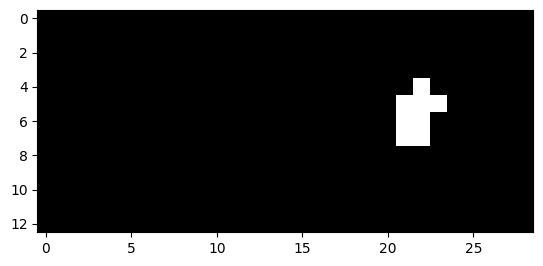

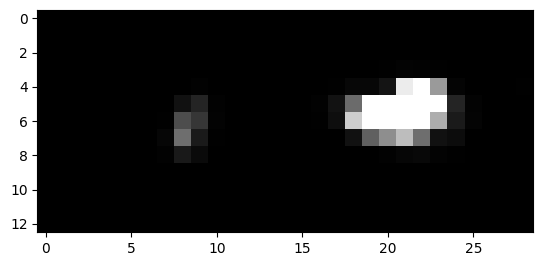

1066


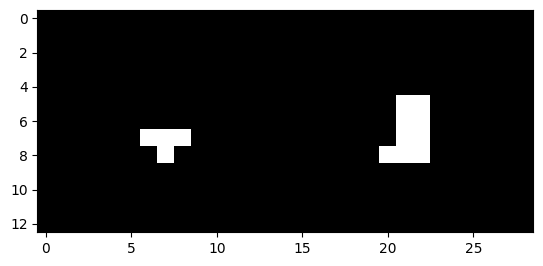

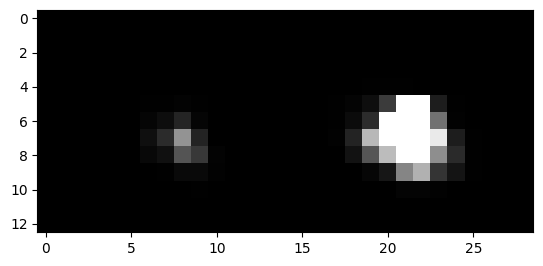

1067


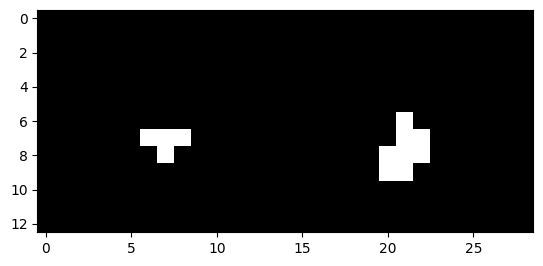

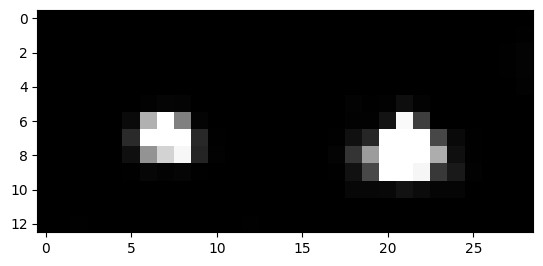

1068


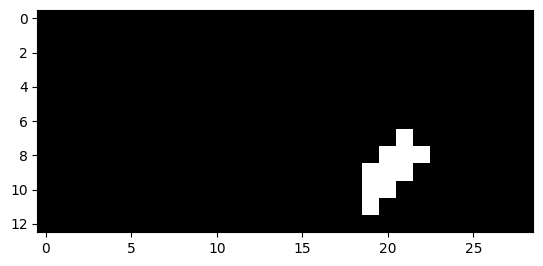

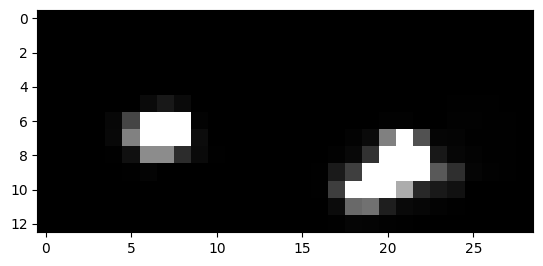

1069


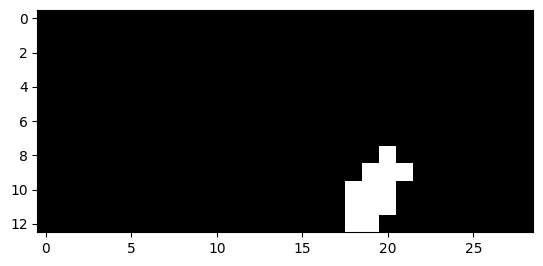

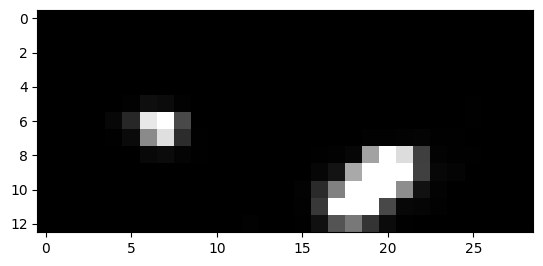

1070


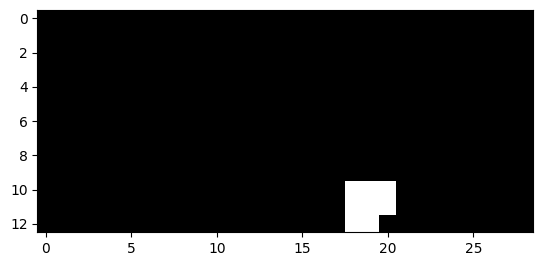

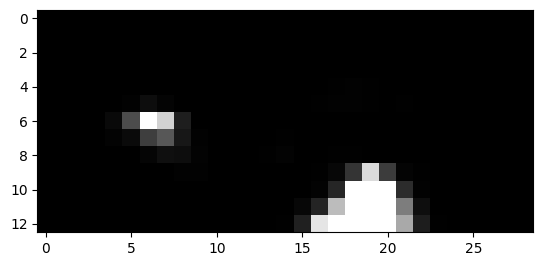

1071


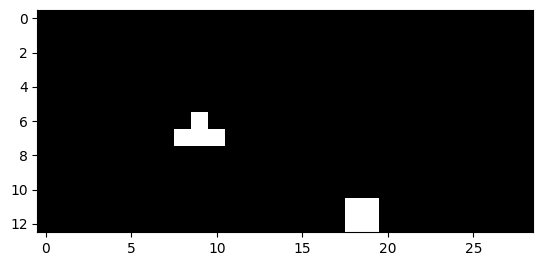

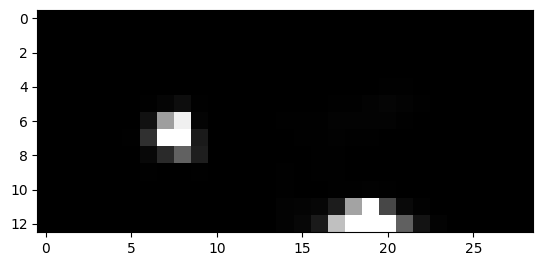

1072


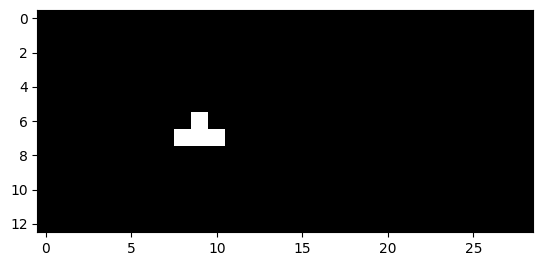

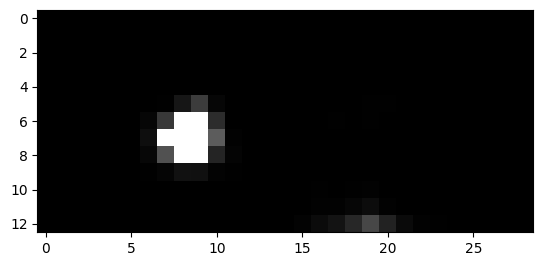

1073


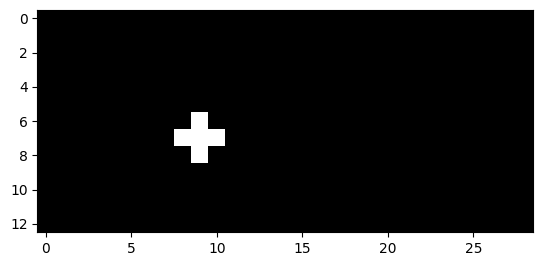

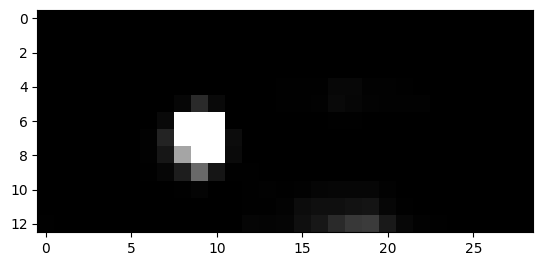

1074


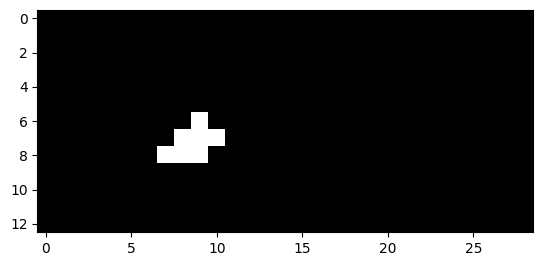

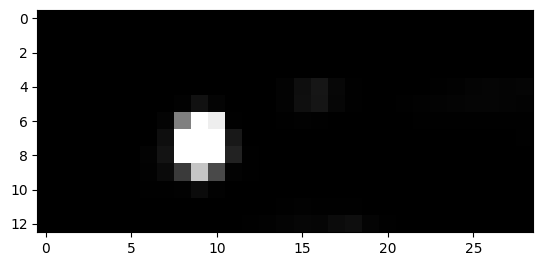

1075


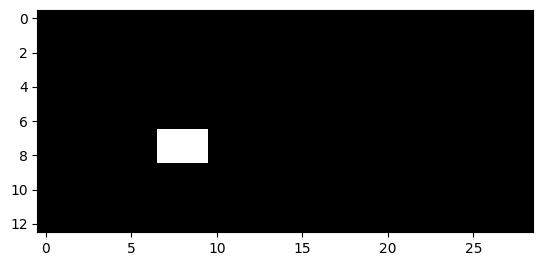

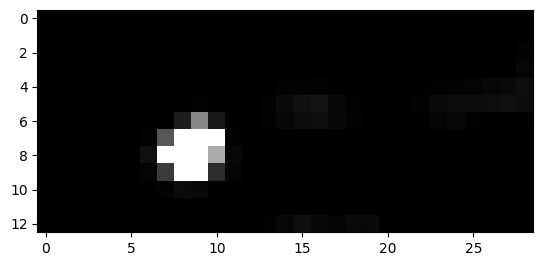

1076


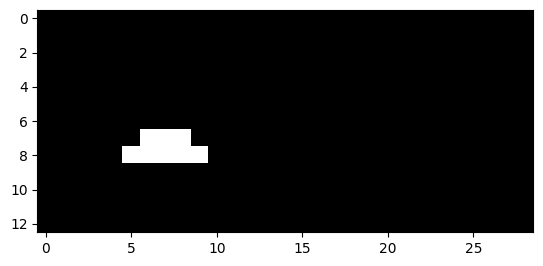

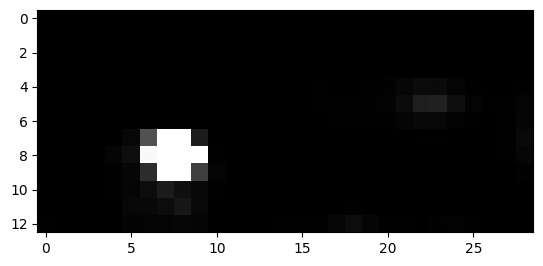

1077


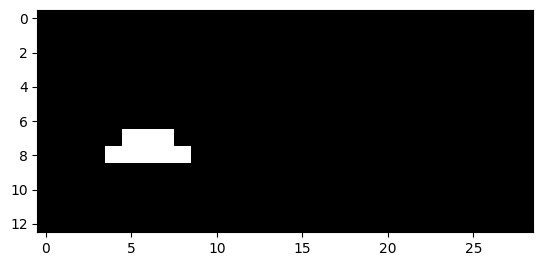

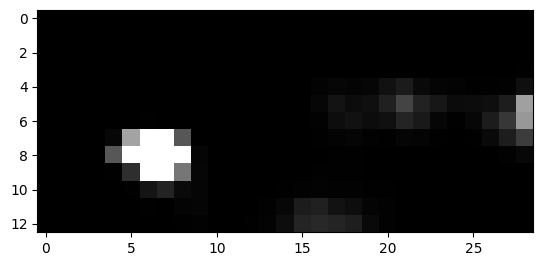

1078


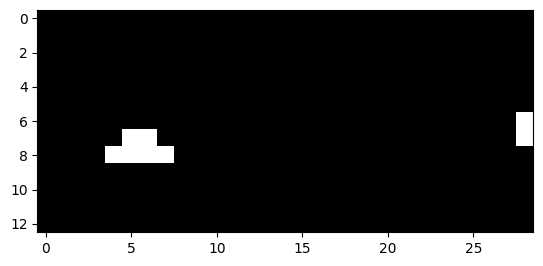

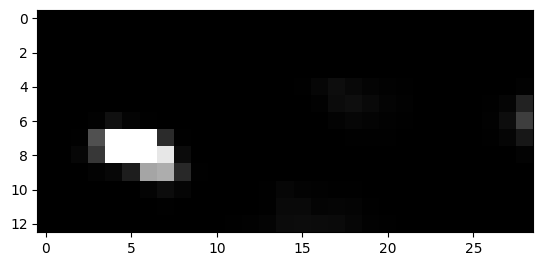

1079


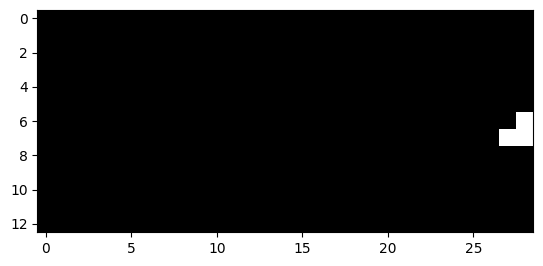

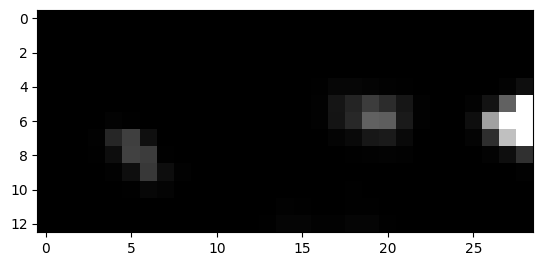

1080


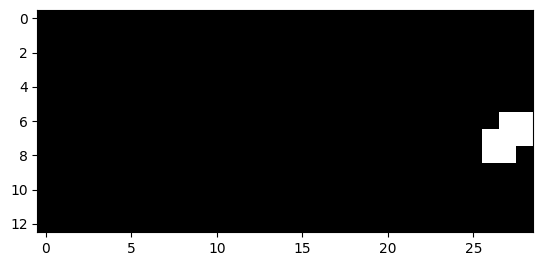

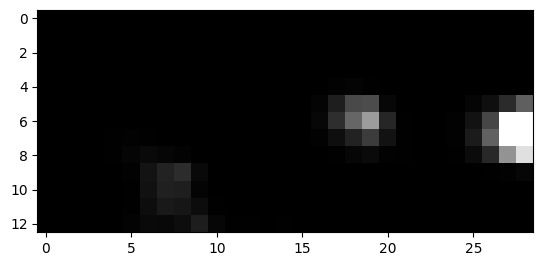

1081


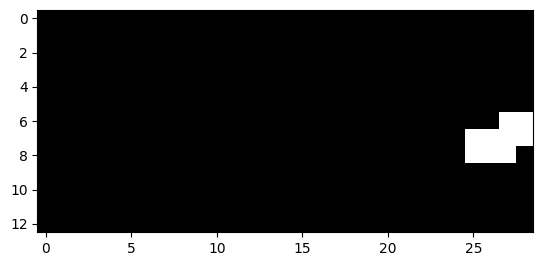

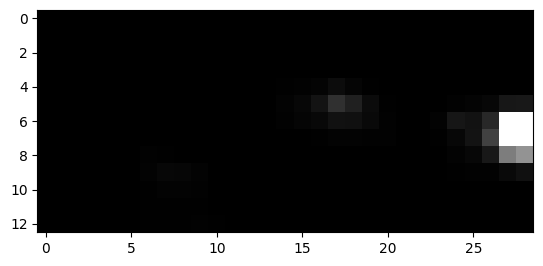

1082


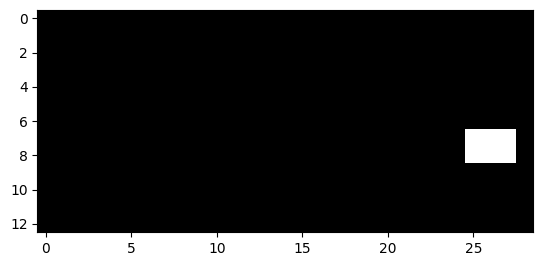

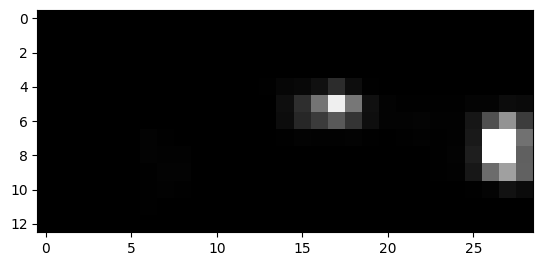

1083


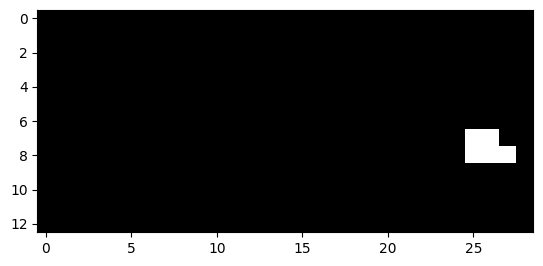

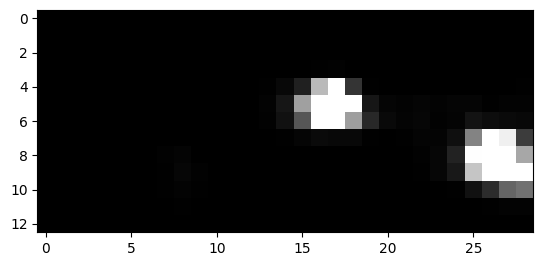

1084


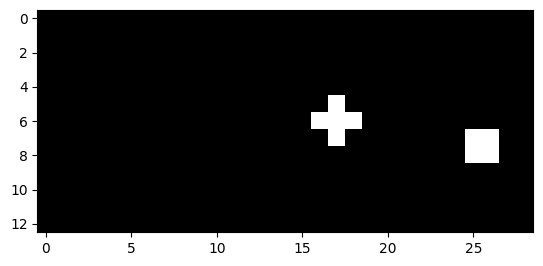

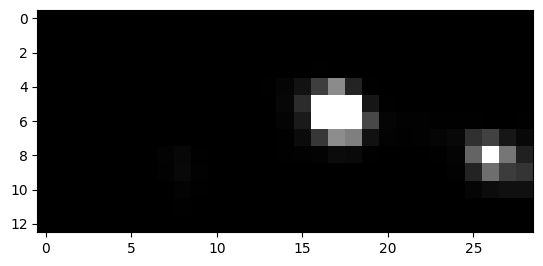

1085


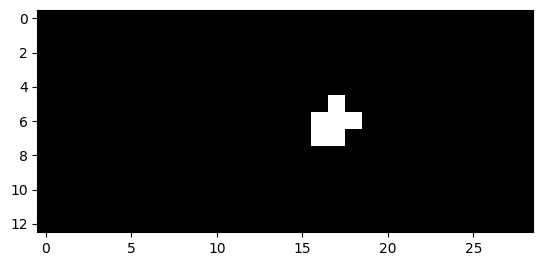

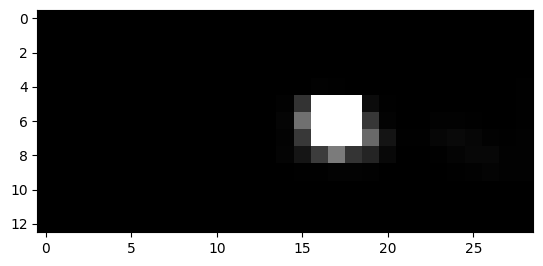

1086


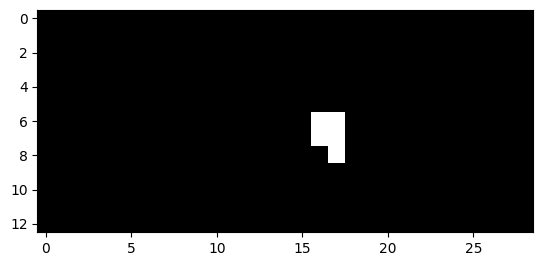

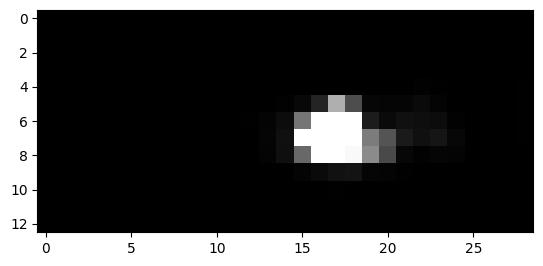

1087


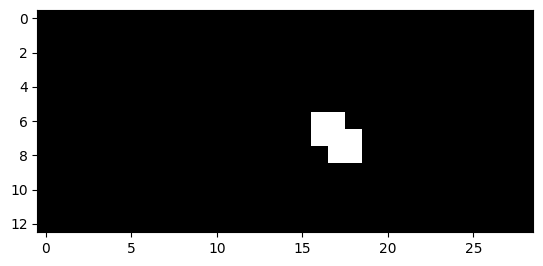

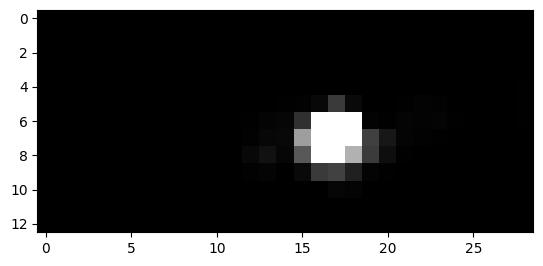

1088


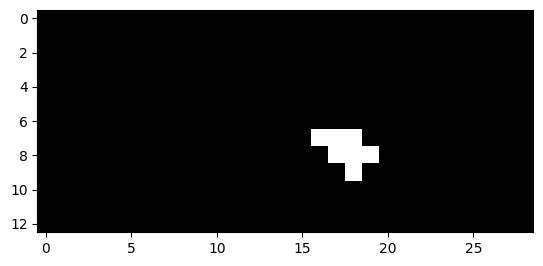

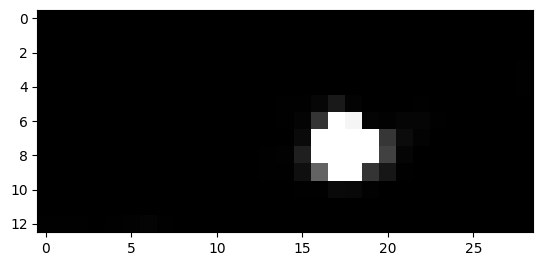

1089


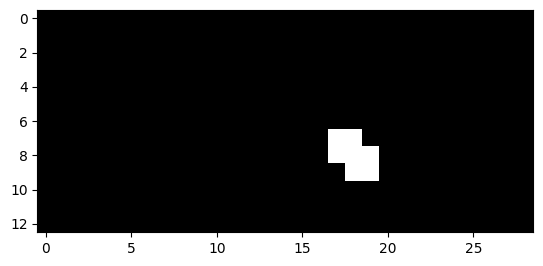

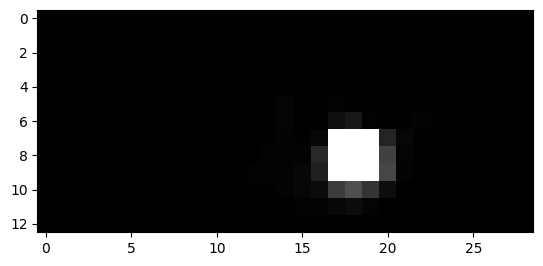

1090


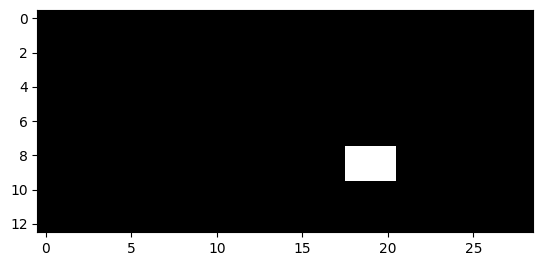

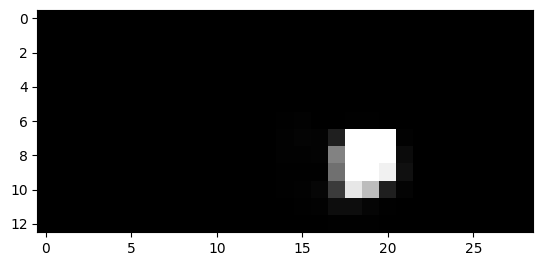

1091


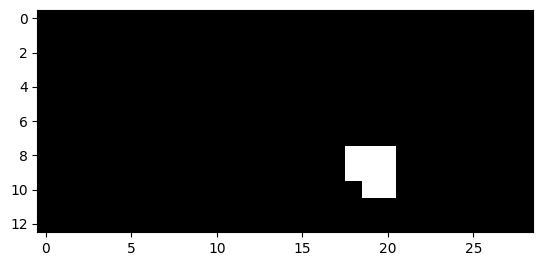

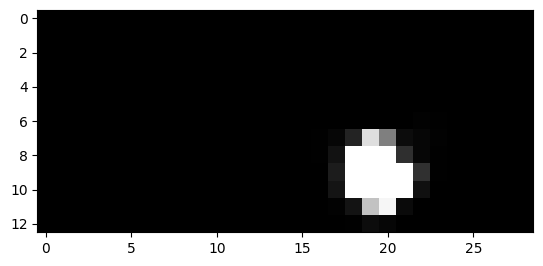

1092


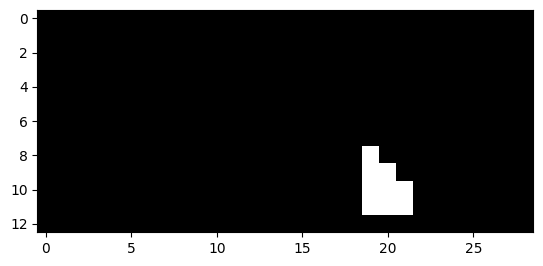

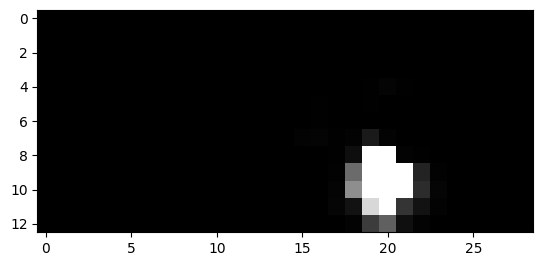

1093


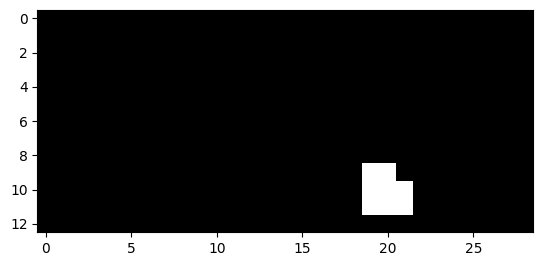

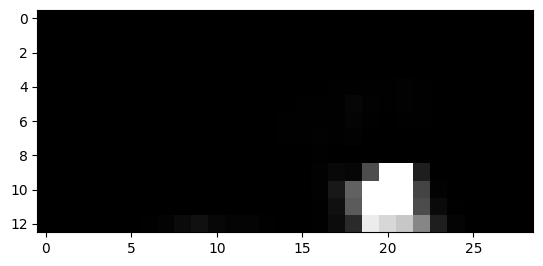

1094


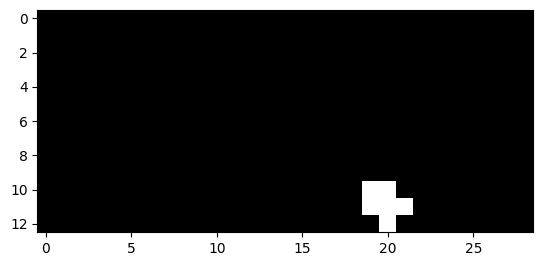

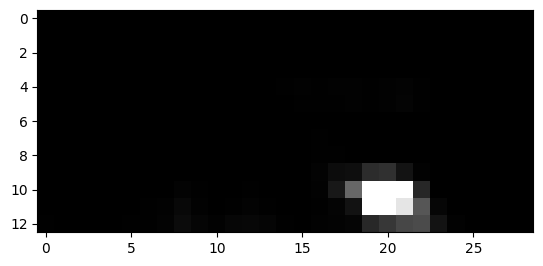

1095


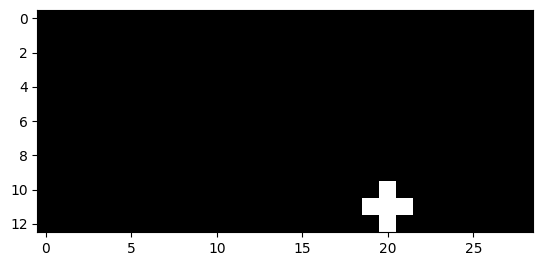

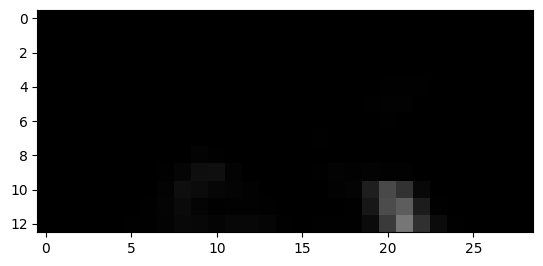

1116


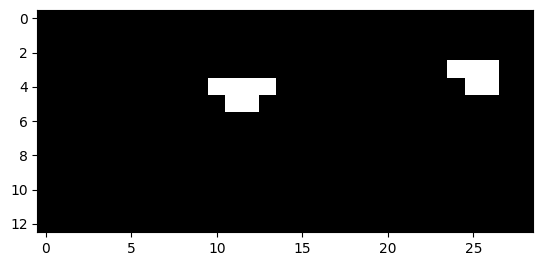

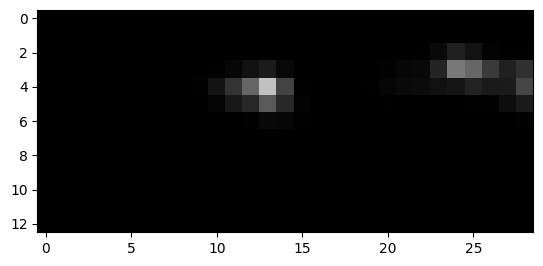

1117


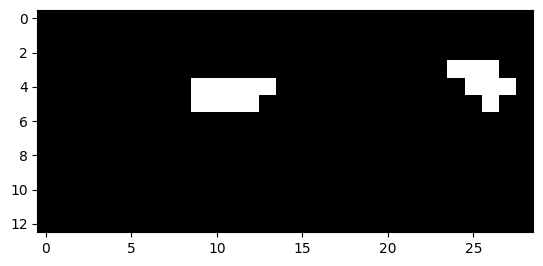

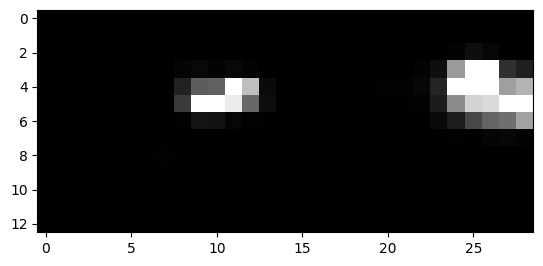

1118


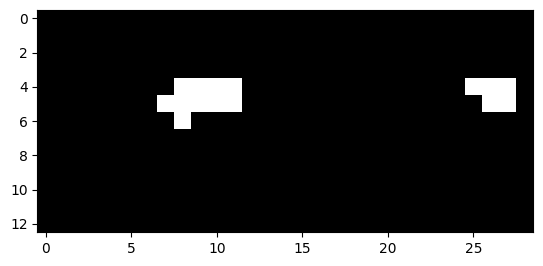

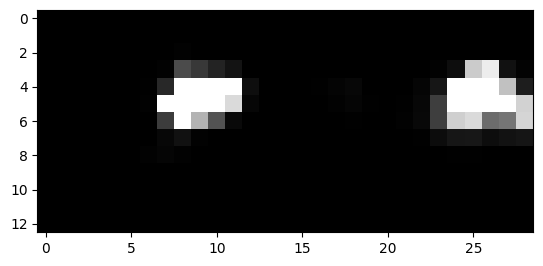

1119


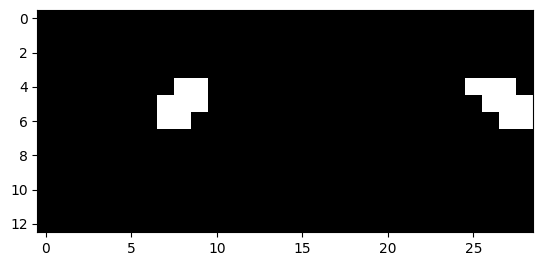

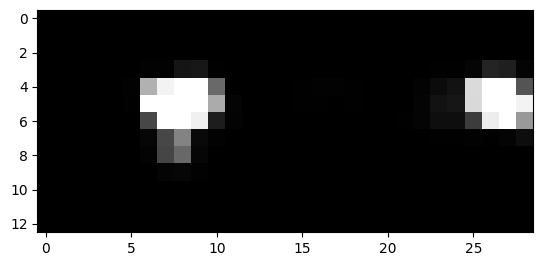

1120


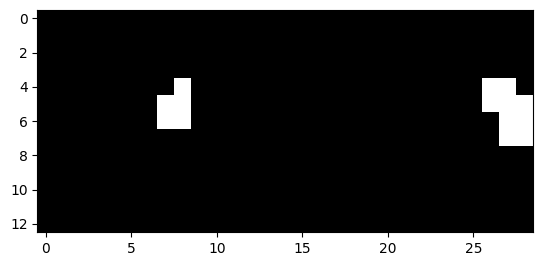

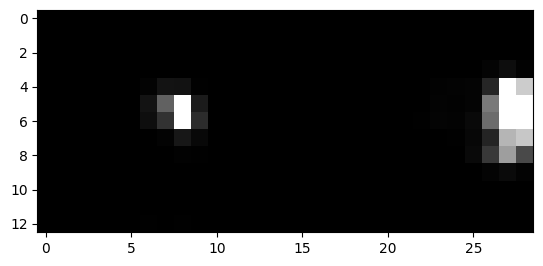

1121


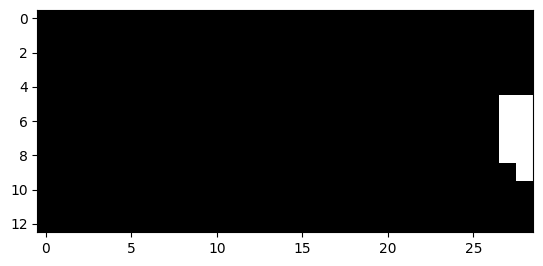

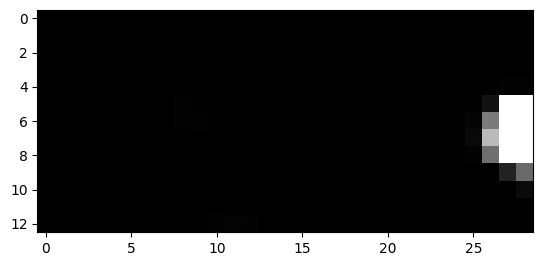

1122


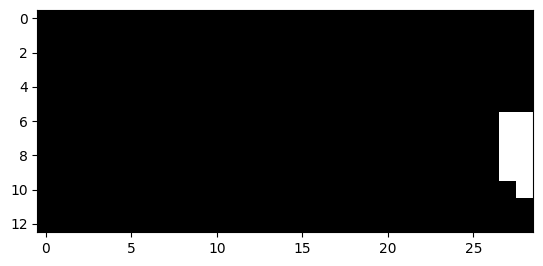

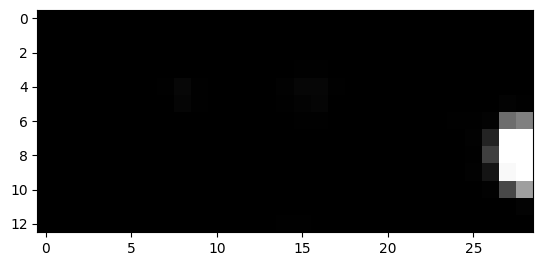

1123


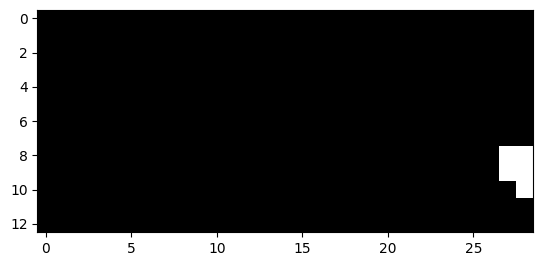

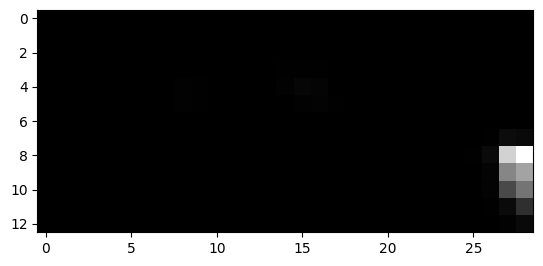

1341


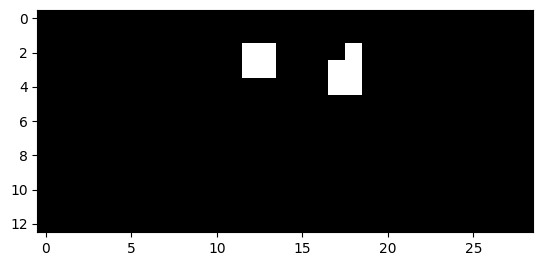

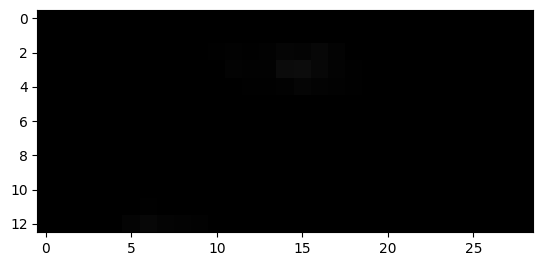

1342


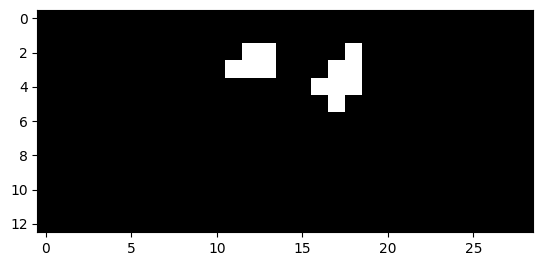

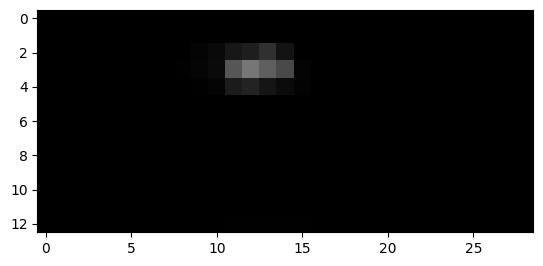

1343


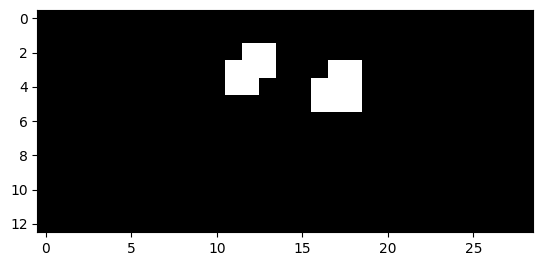

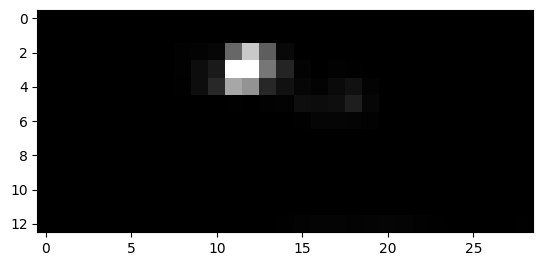

1344


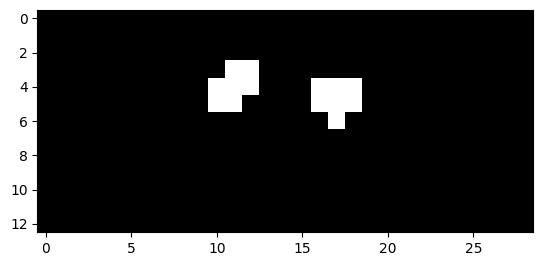

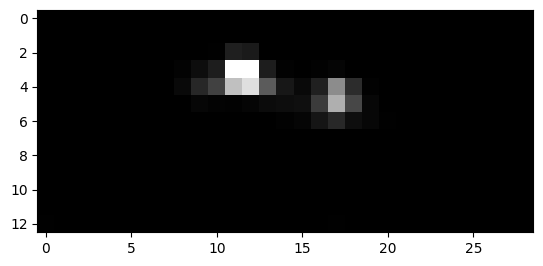

1345


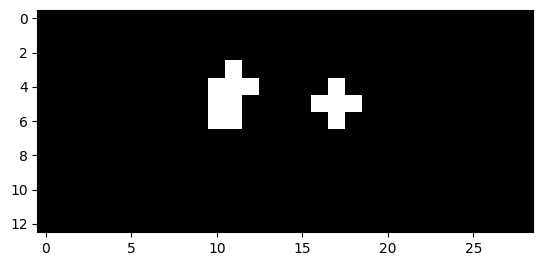

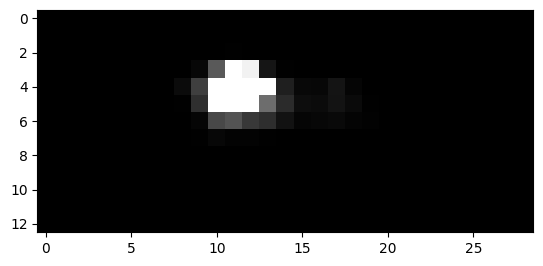

1346


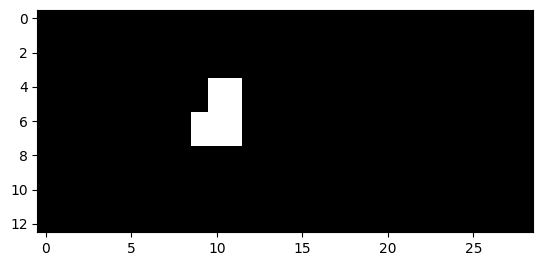

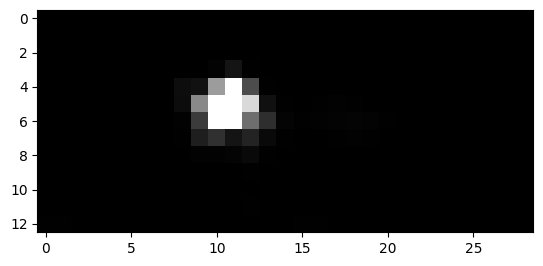

1347


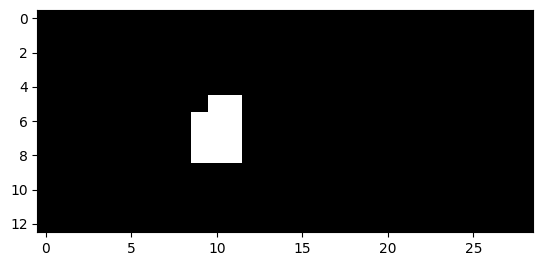

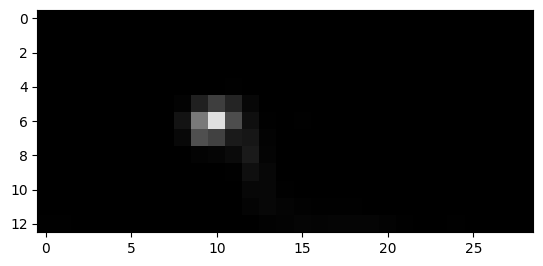

1348


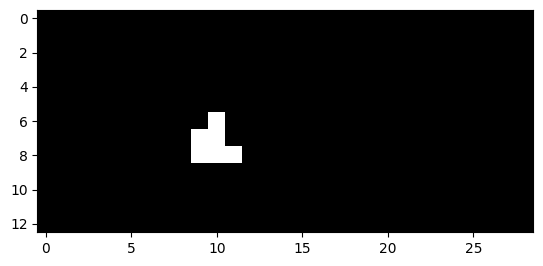

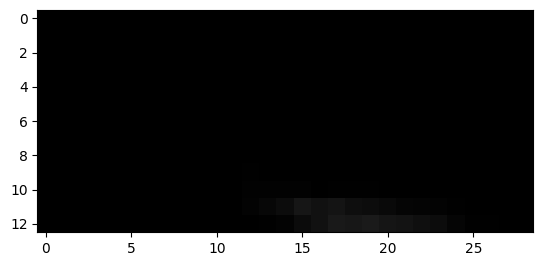

1366


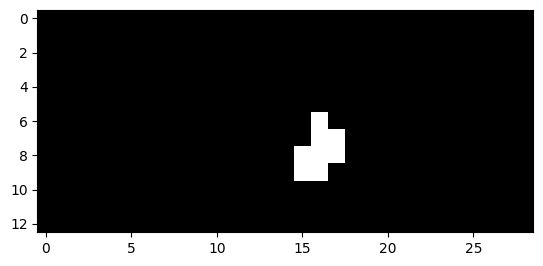

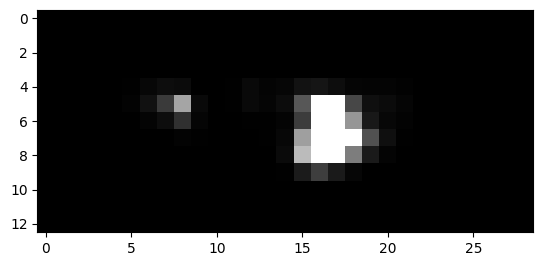

1367


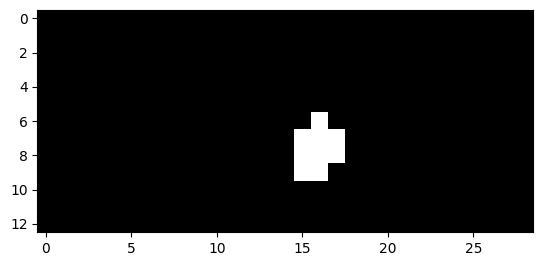

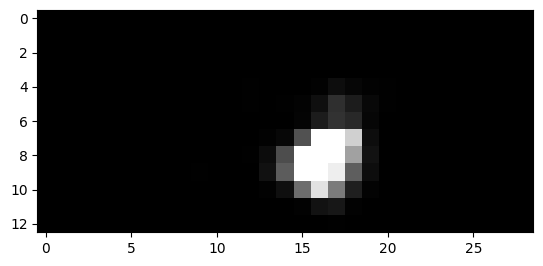

1368


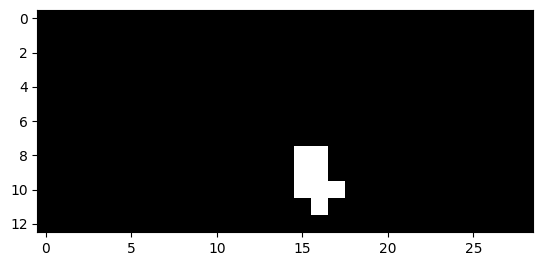

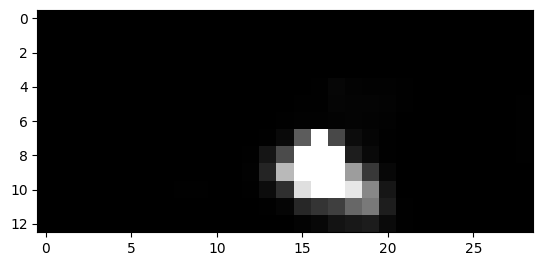

1369


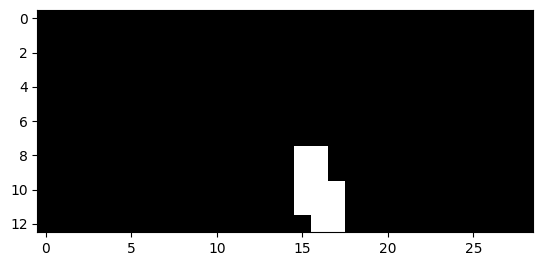

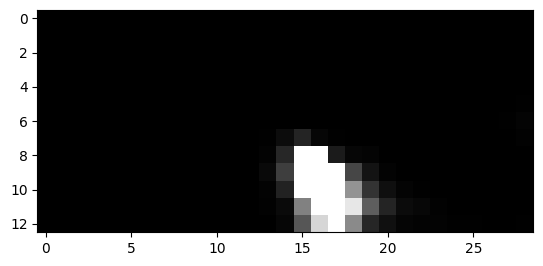

1370


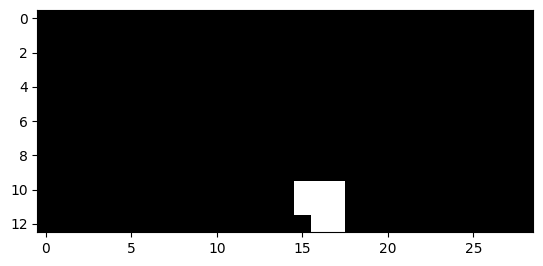

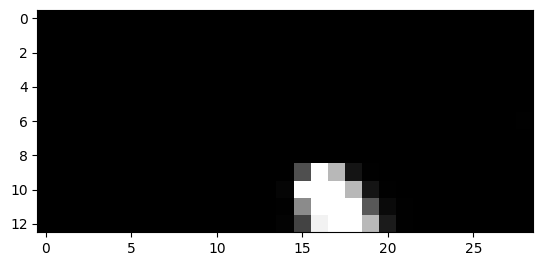

1371


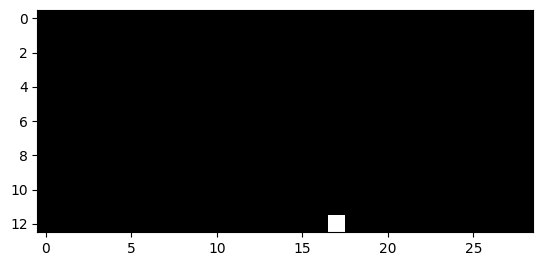

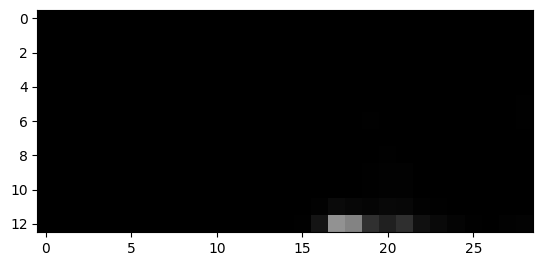

1389


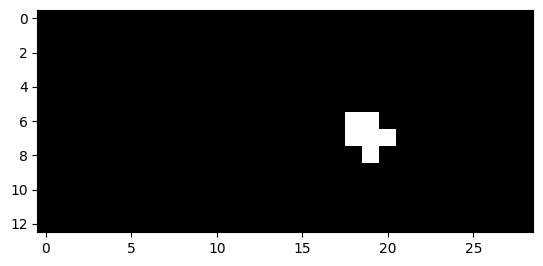

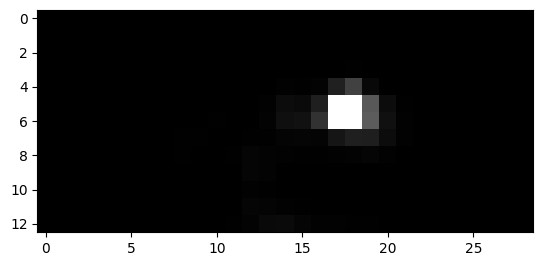

1390


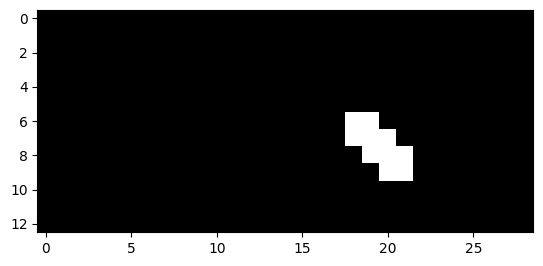

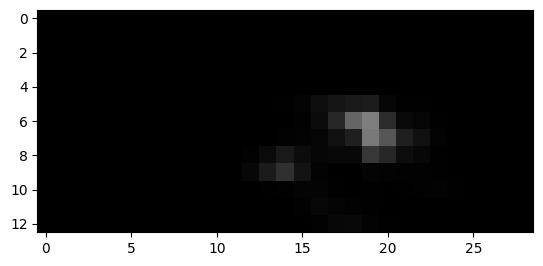

1391


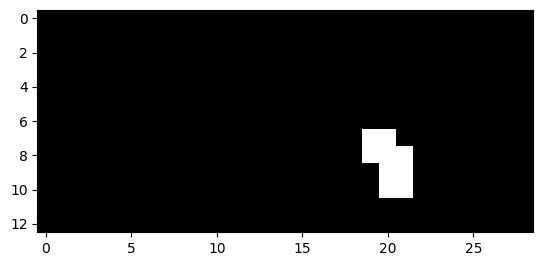

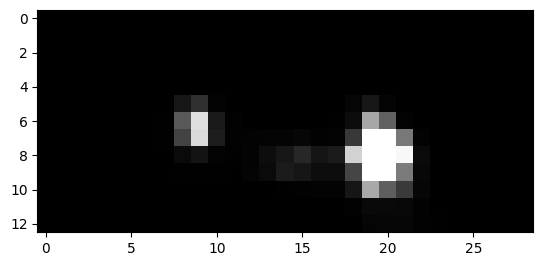

1392


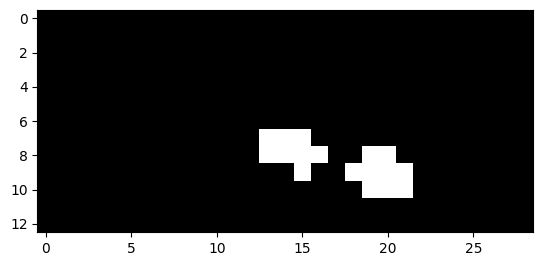

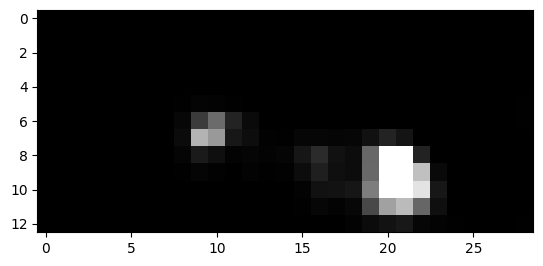

1393


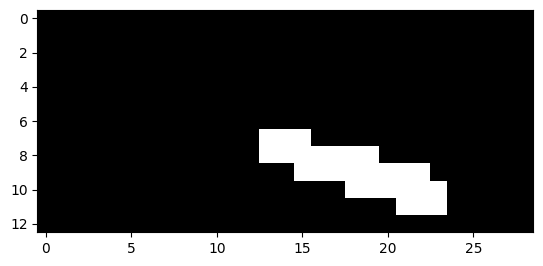

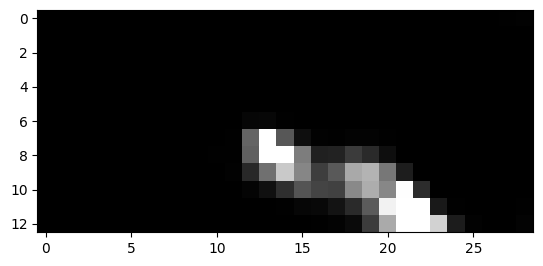

1394


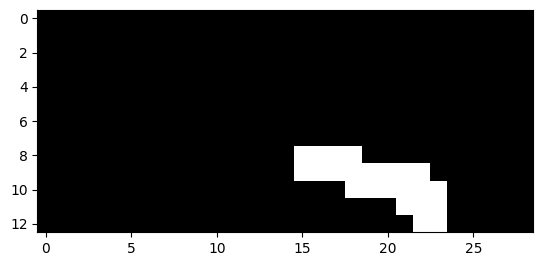

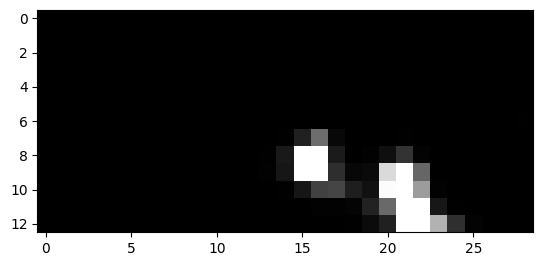

1395


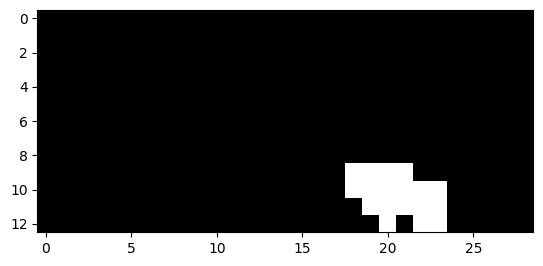

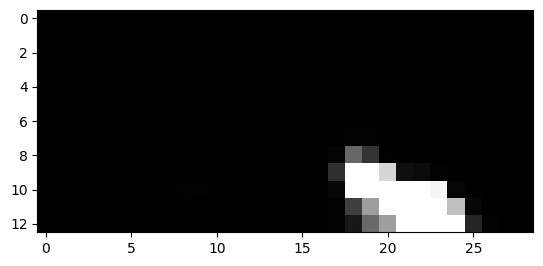

1396


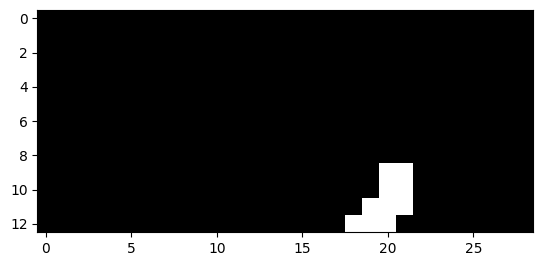

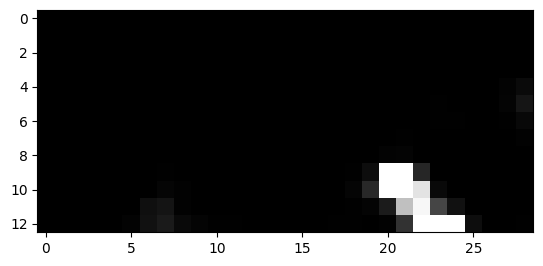

1397


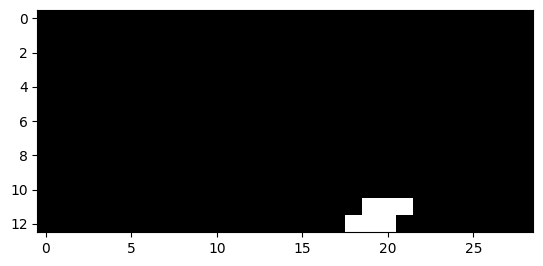

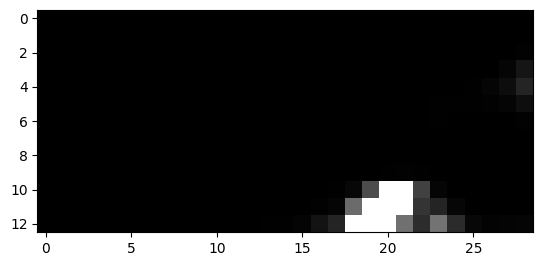

1398


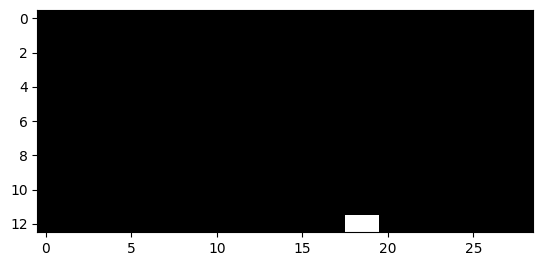

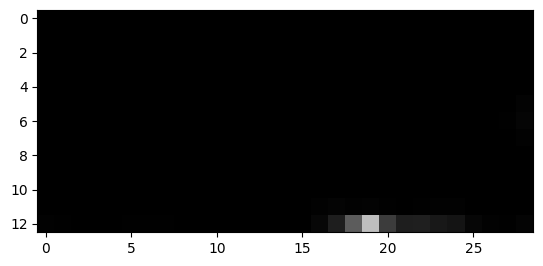

1403


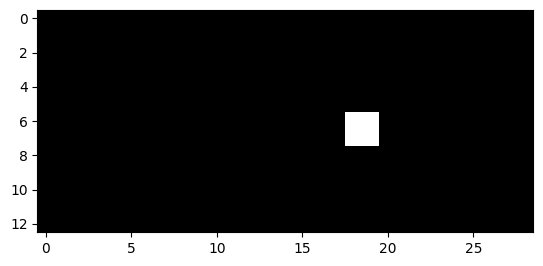

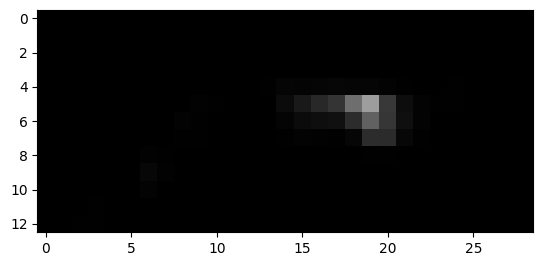

1404


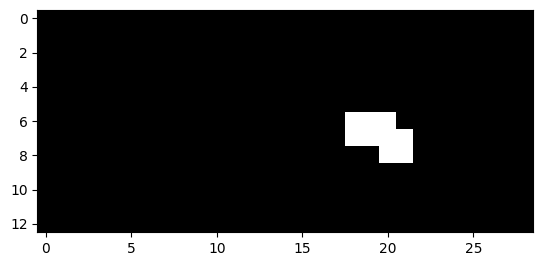

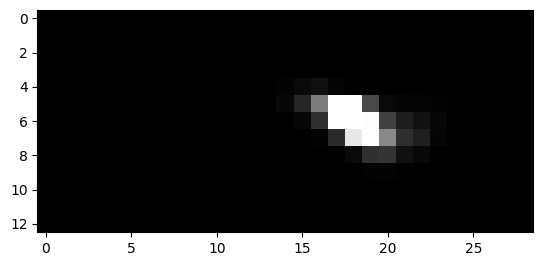

1405


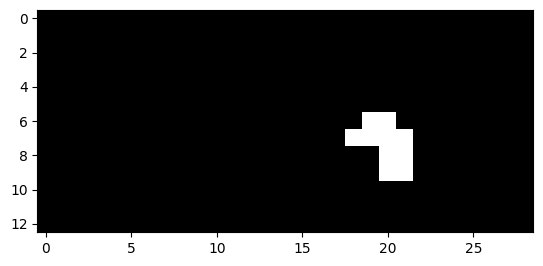

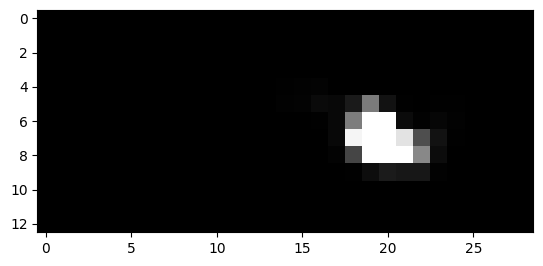

1406


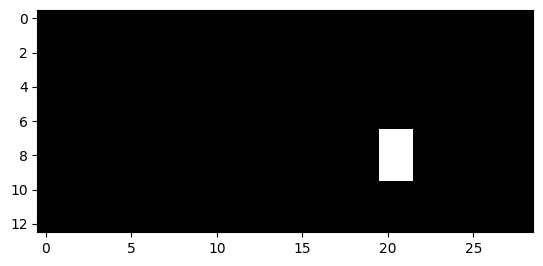

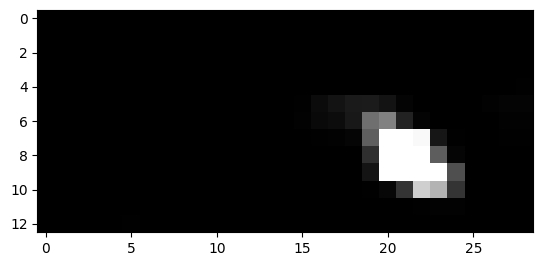

1407


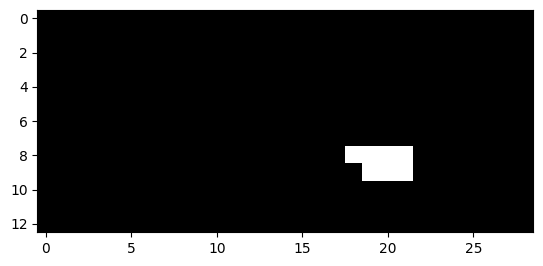

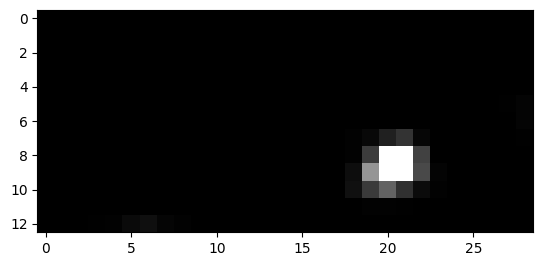

1408


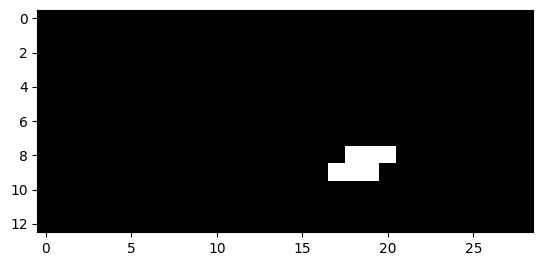

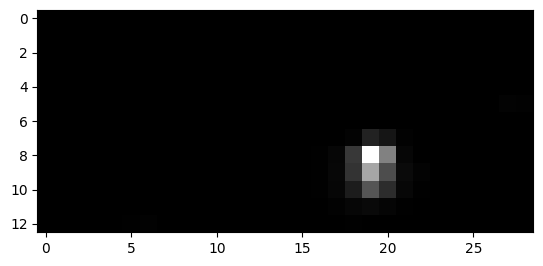

1409


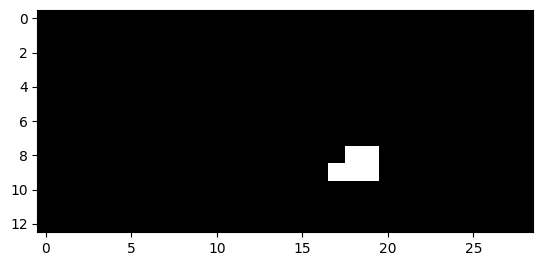

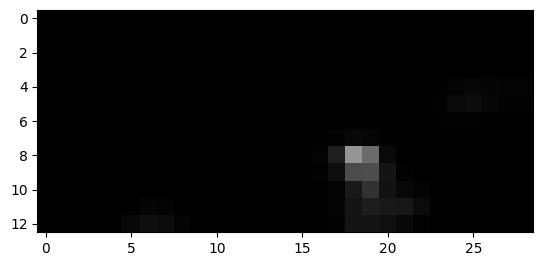

1412


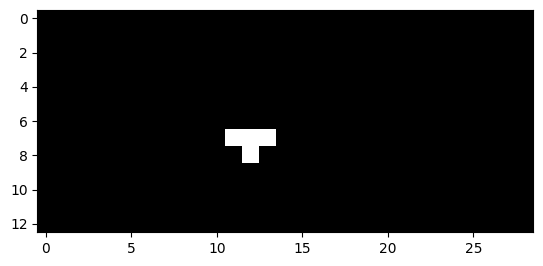

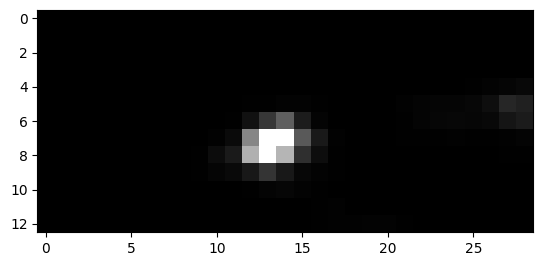

1413


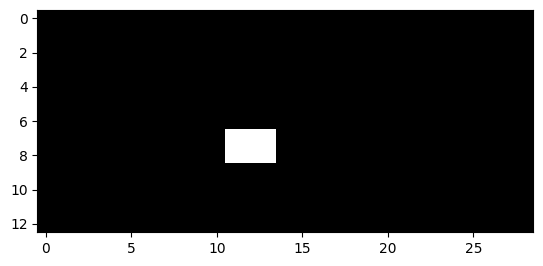

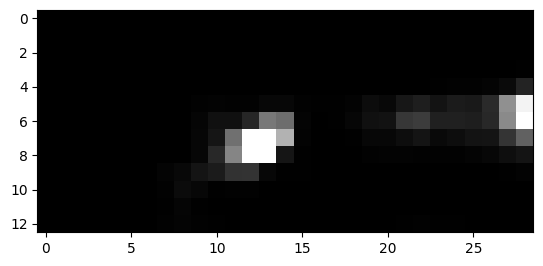

1414


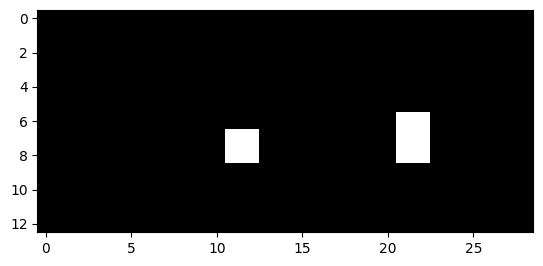

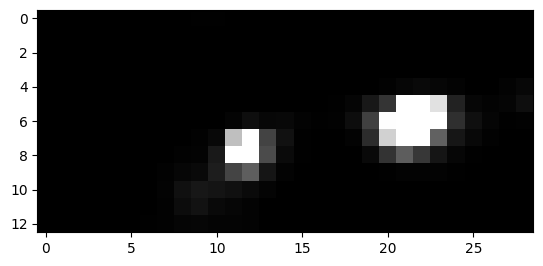

1415


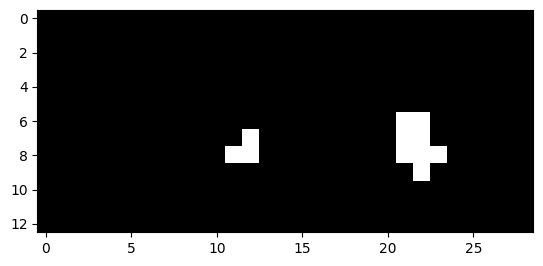

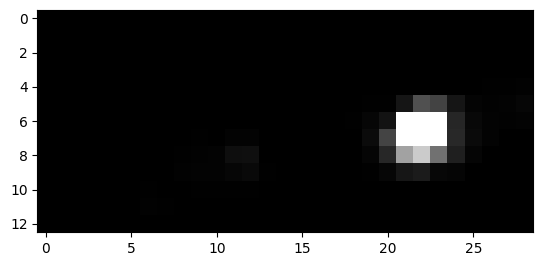

1416


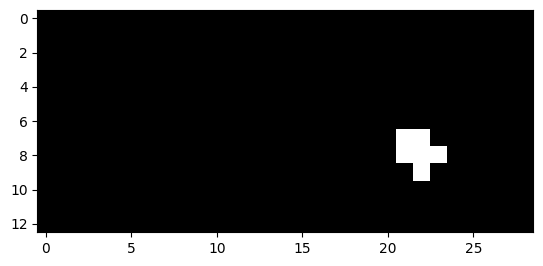

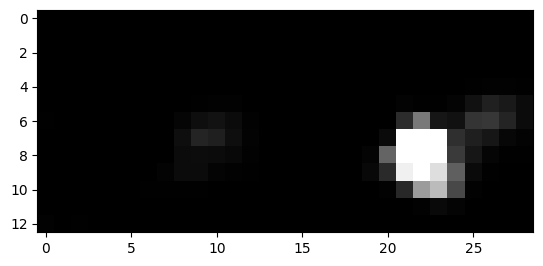

1417


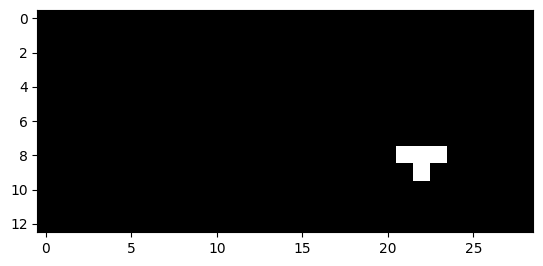

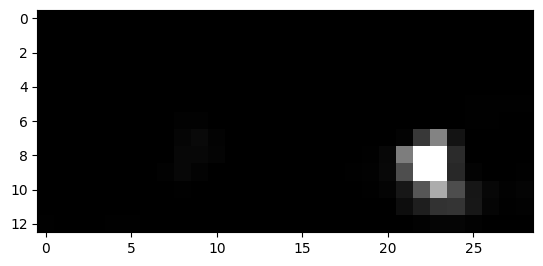

1419


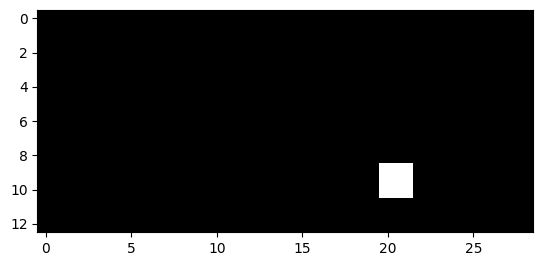

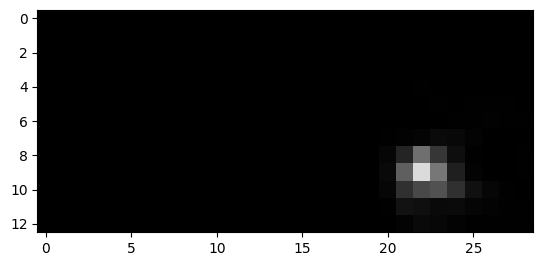

1420


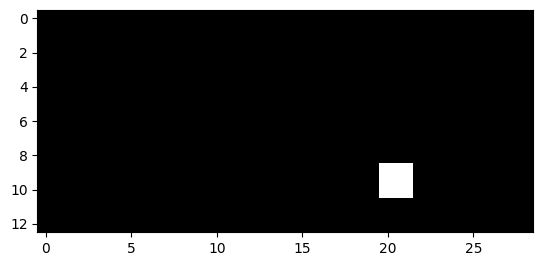

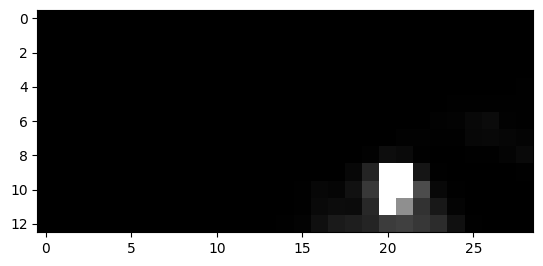

1441


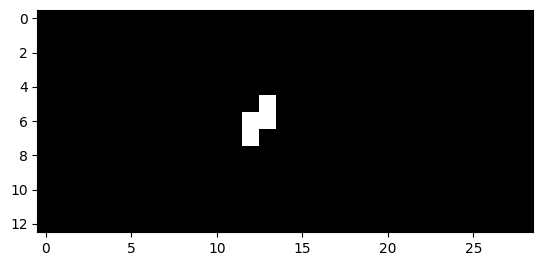

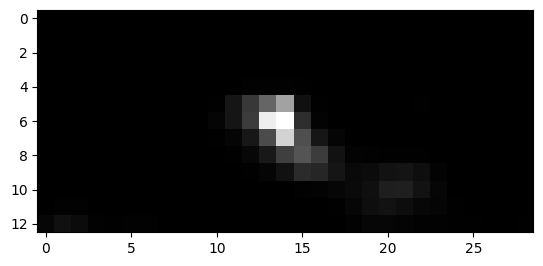

1442


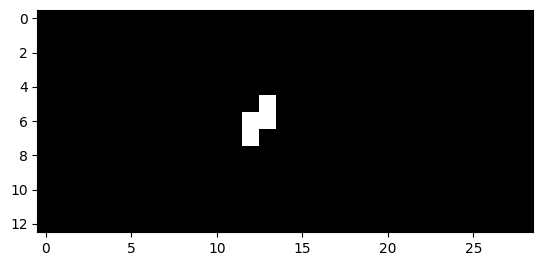

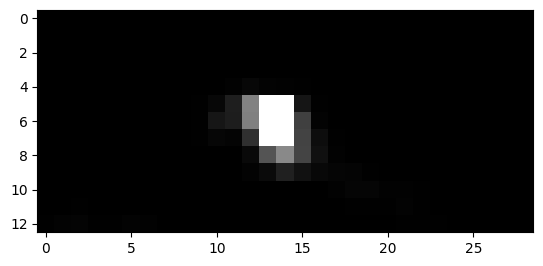

1443


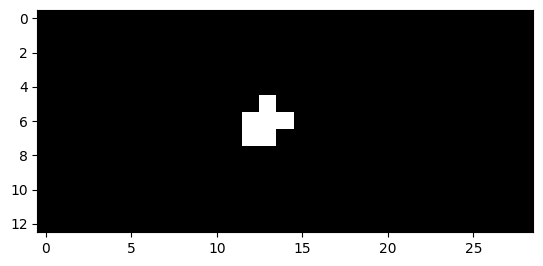

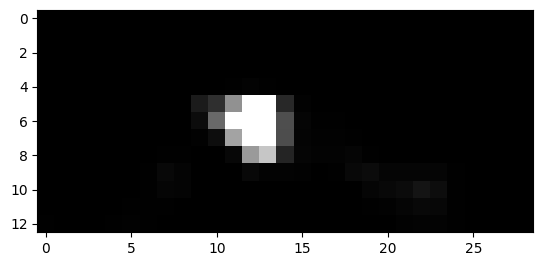

1444


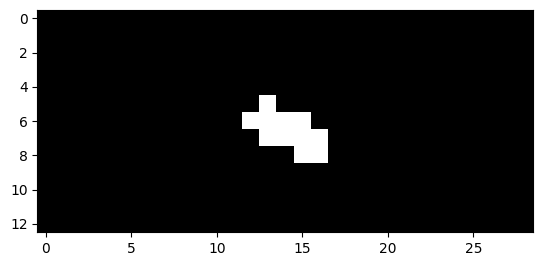

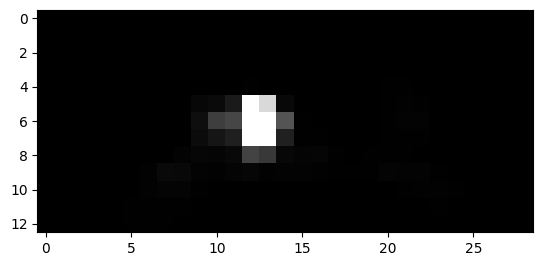

1445


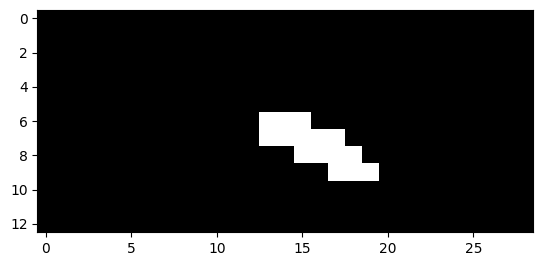

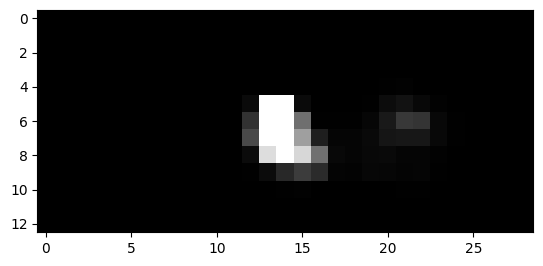

1446


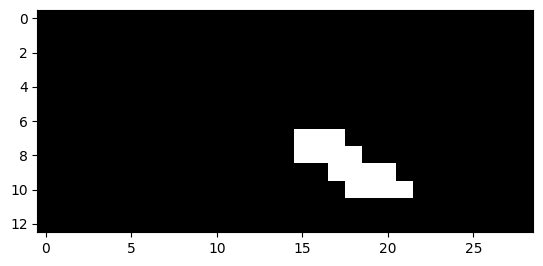

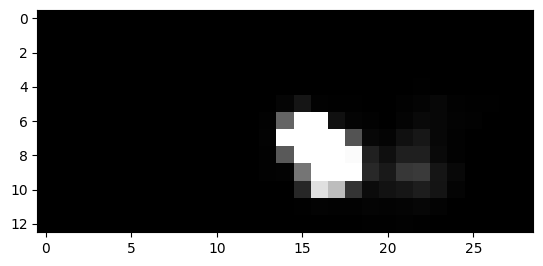

1447


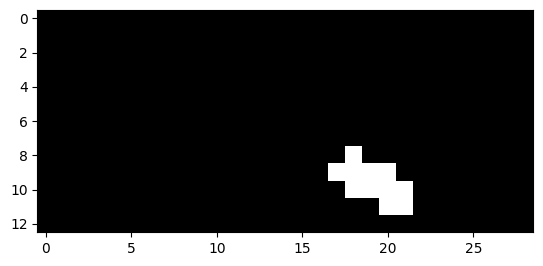

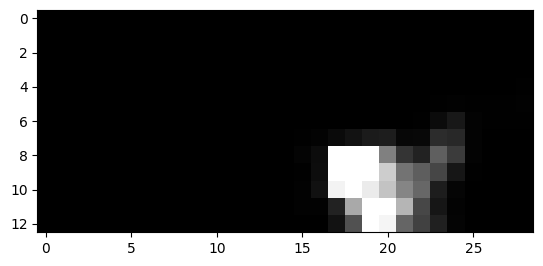

1448


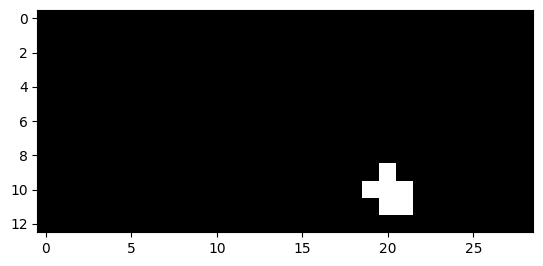

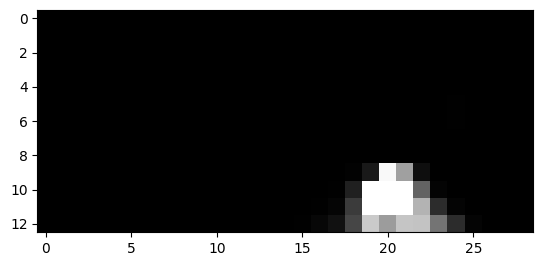

1460


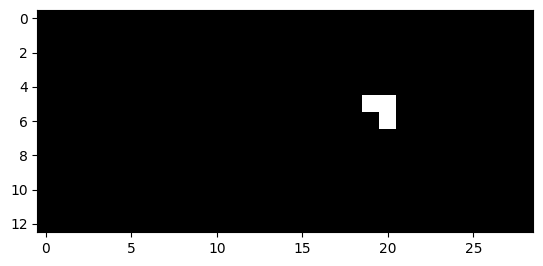

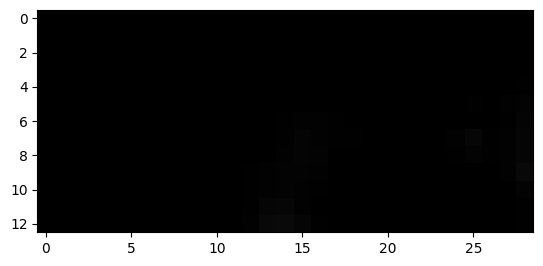

1461


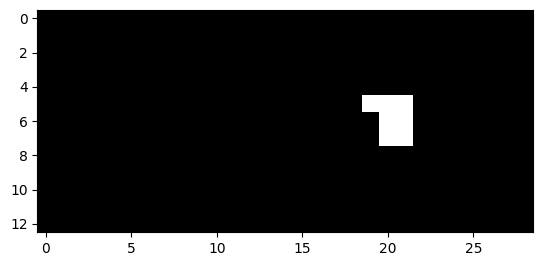

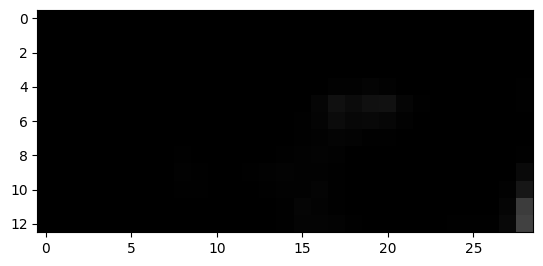

1462


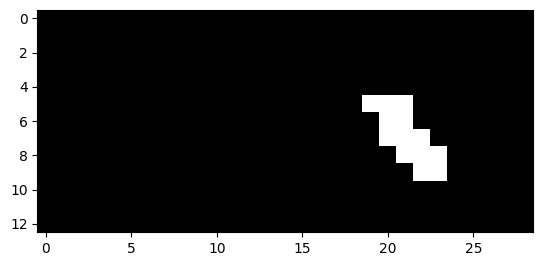

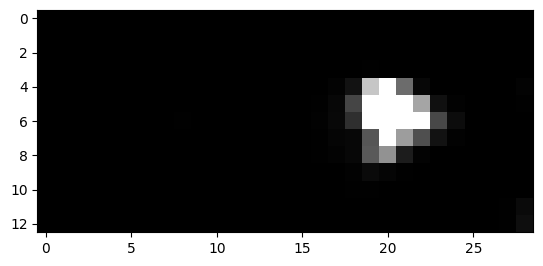

1463


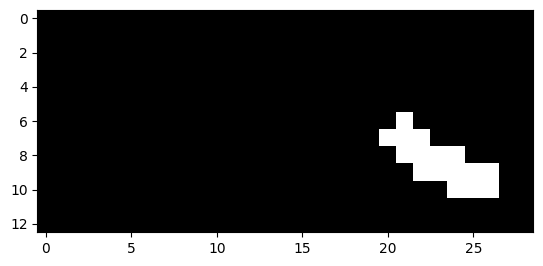

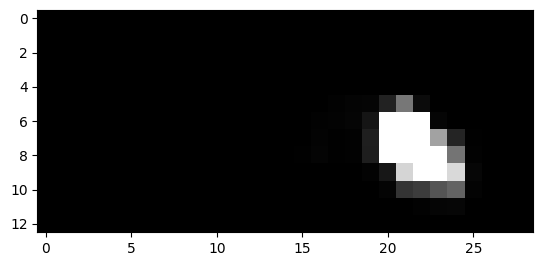

1464


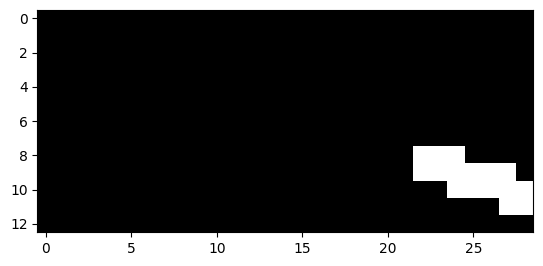

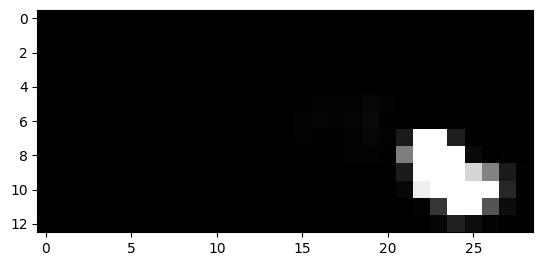

1465


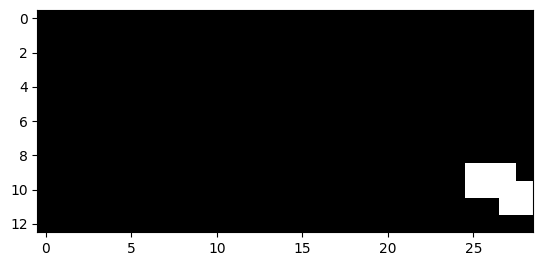

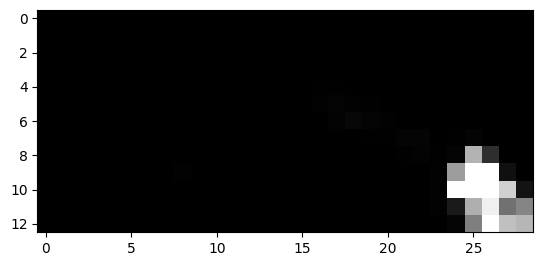

1466


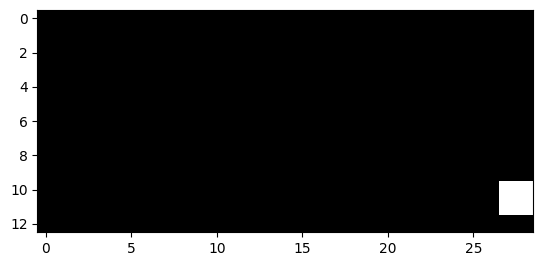

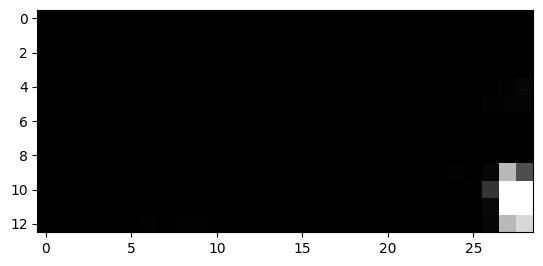

1473


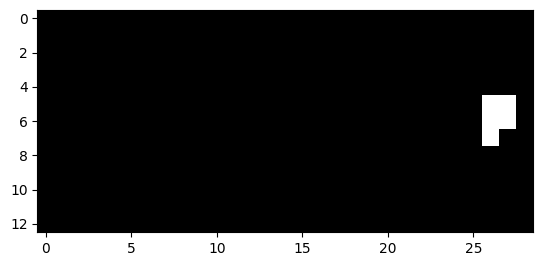

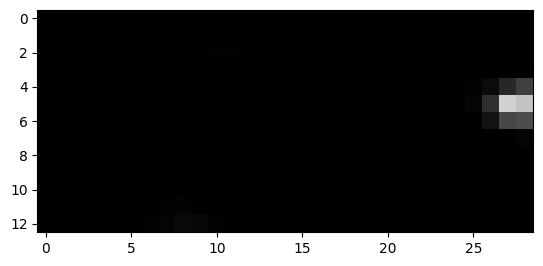

1474


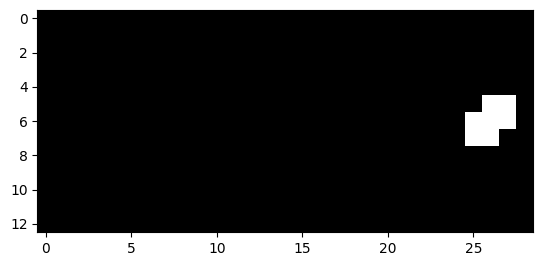

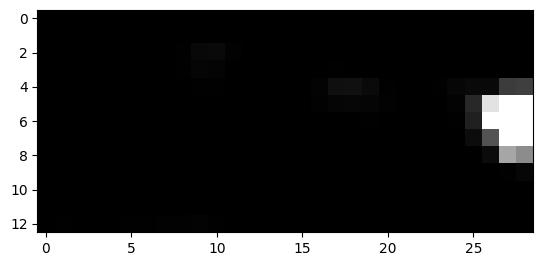

1475


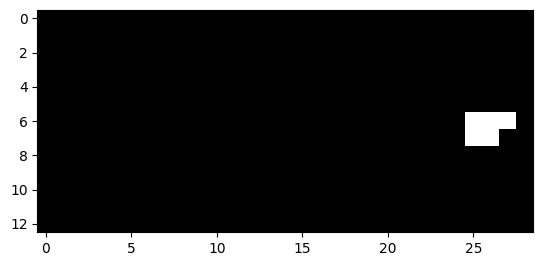

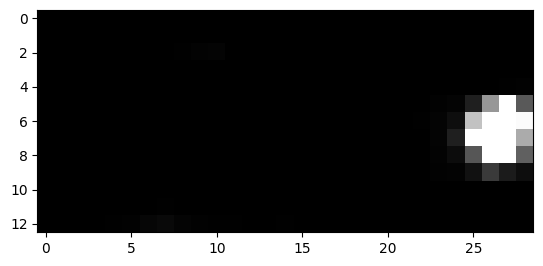

1509


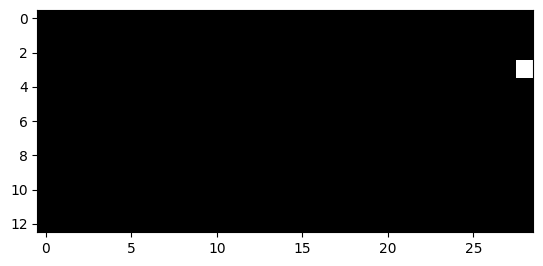

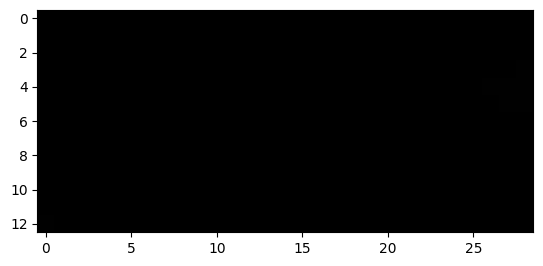

1510


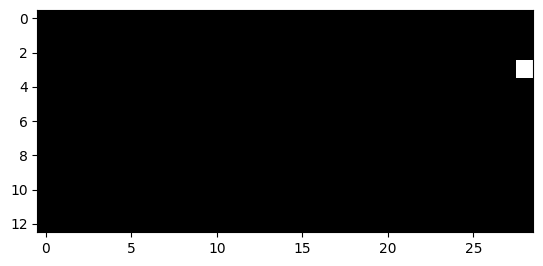

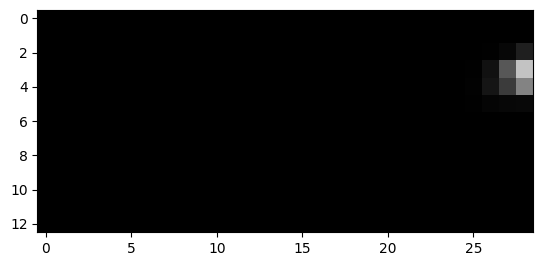

1511


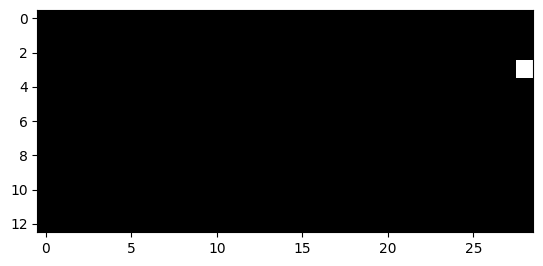

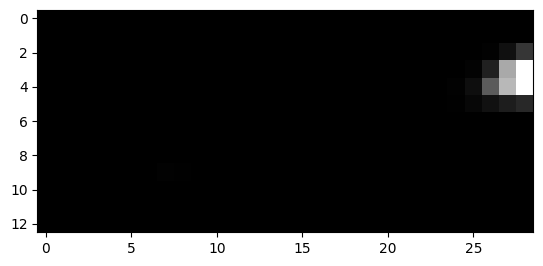

1687


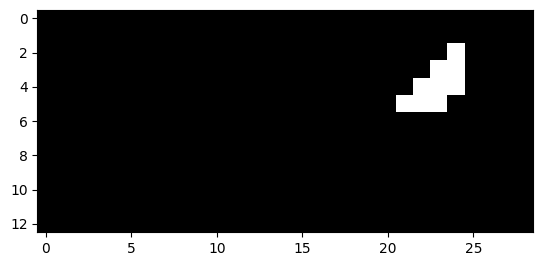

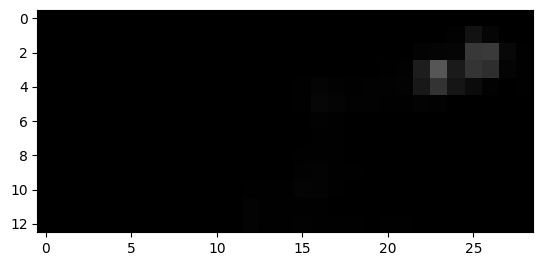

1688


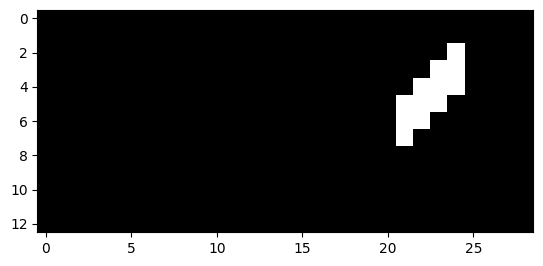

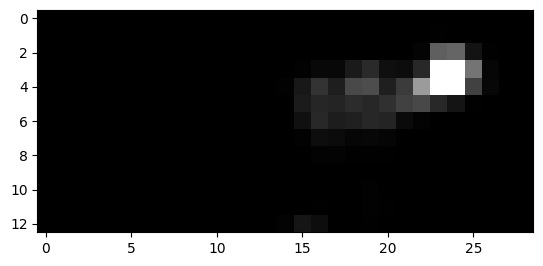

1689


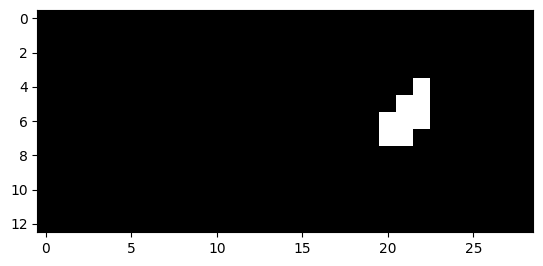

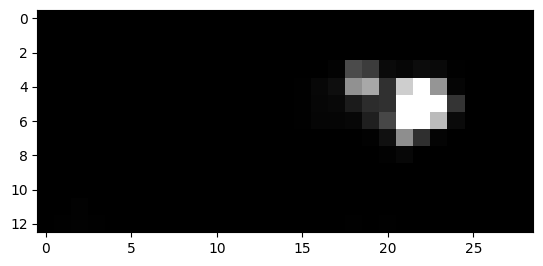

1690


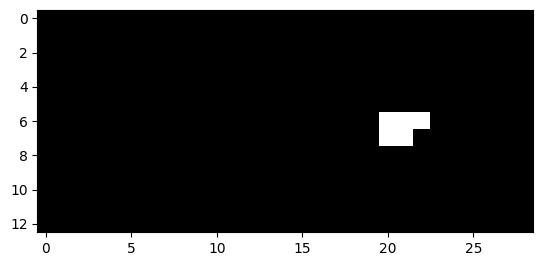

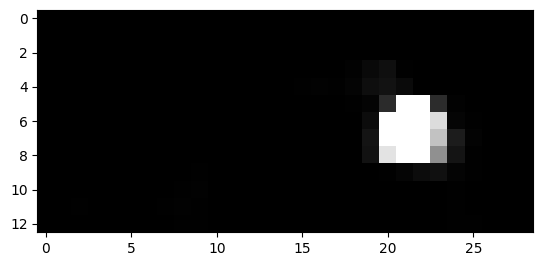

1691


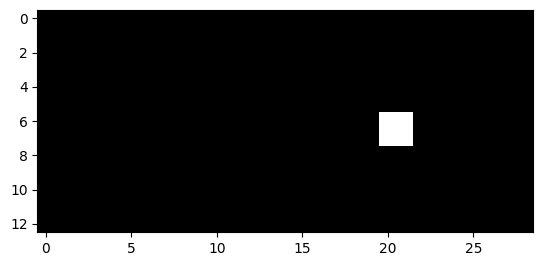

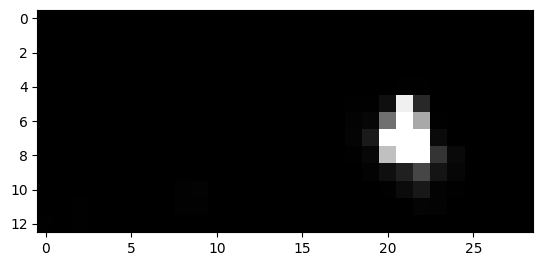

1710


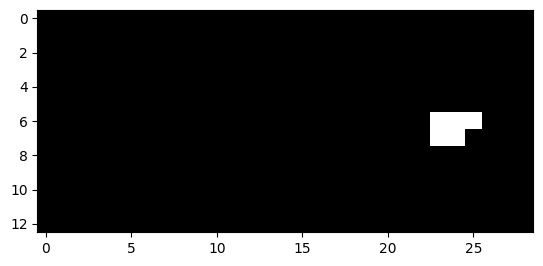

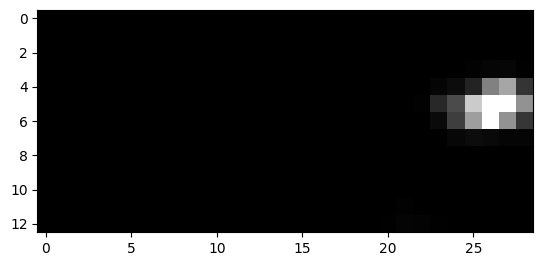

1711


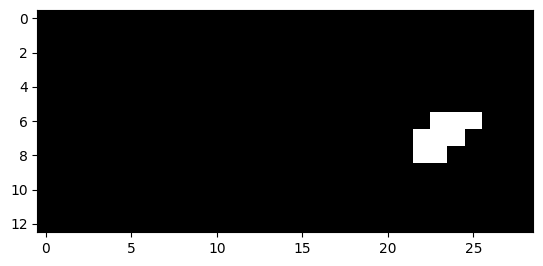

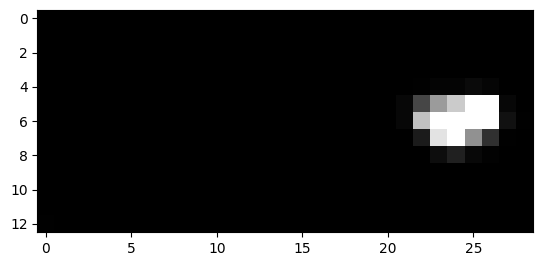

1712


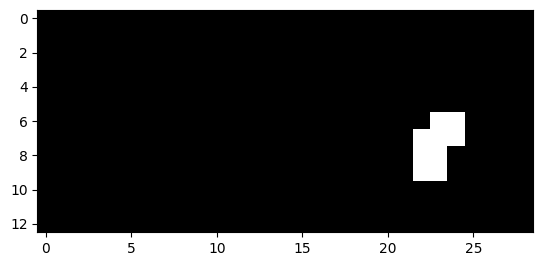

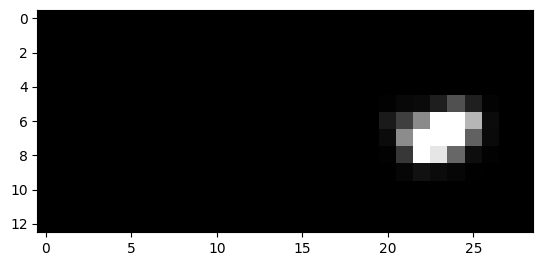

1713


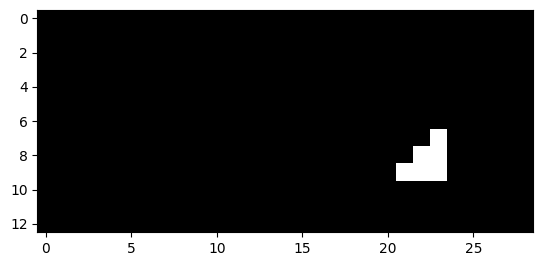

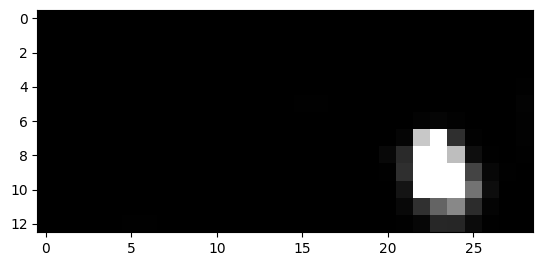

1714


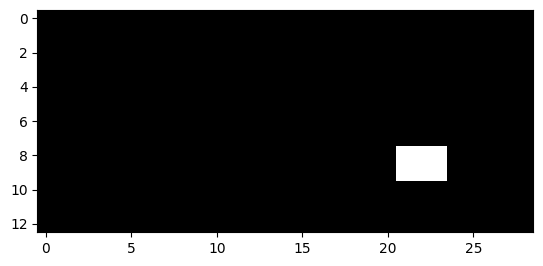

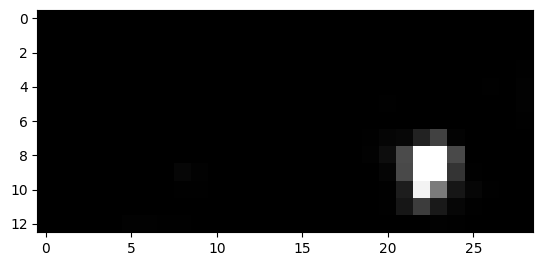

1715


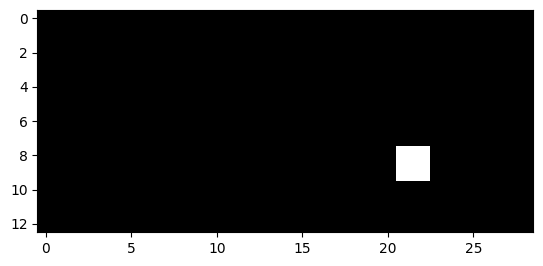

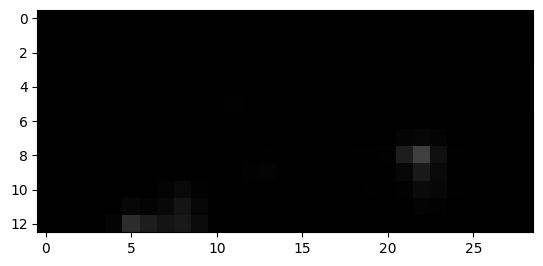

1728


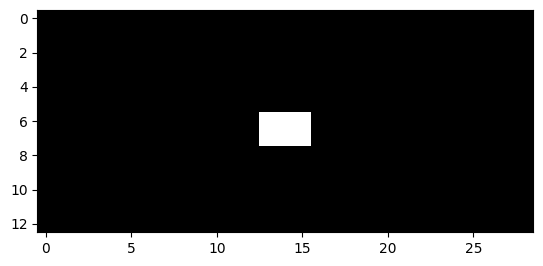

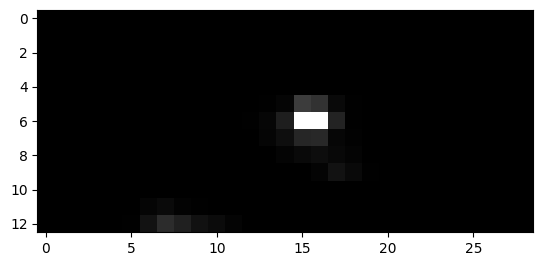

1729


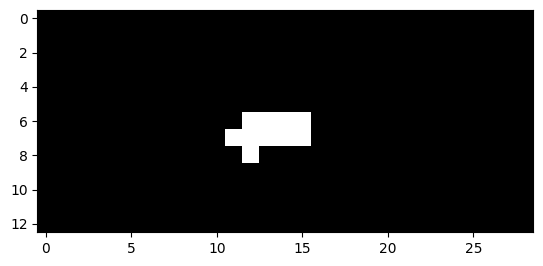

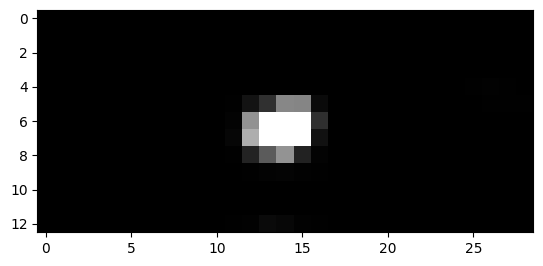

1730


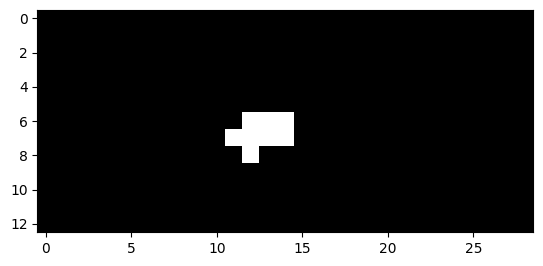

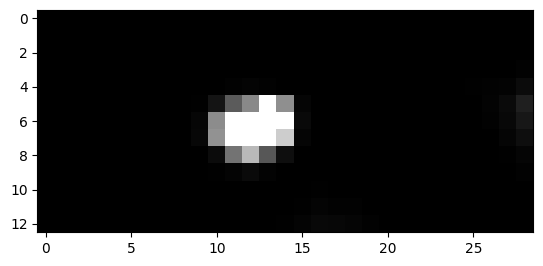

1731


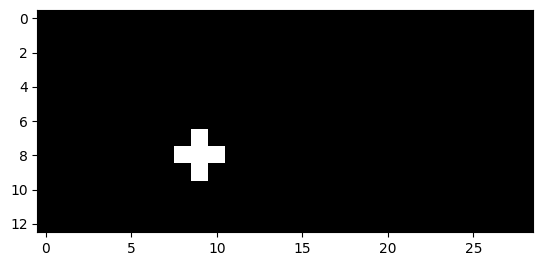

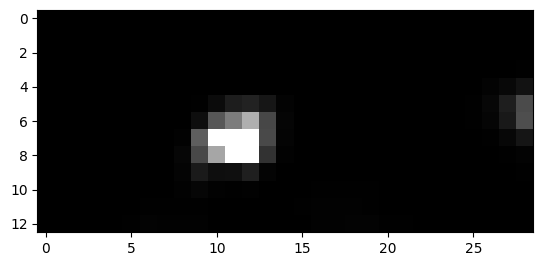

1732


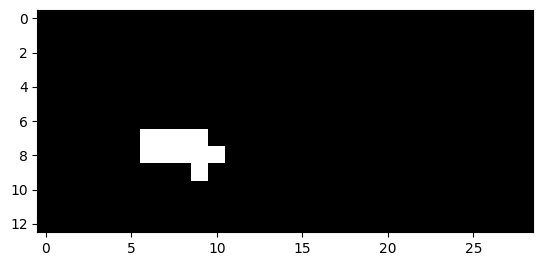

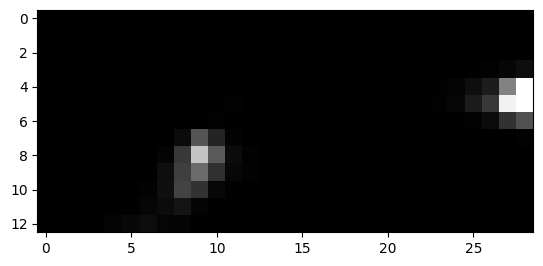

1733


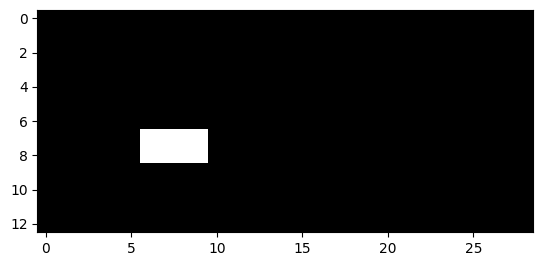

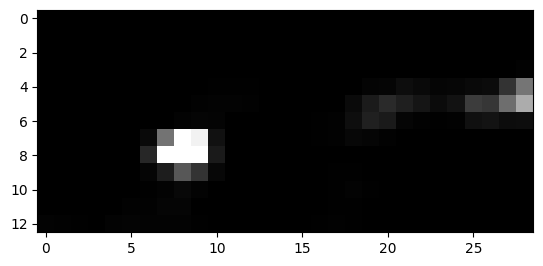

1735


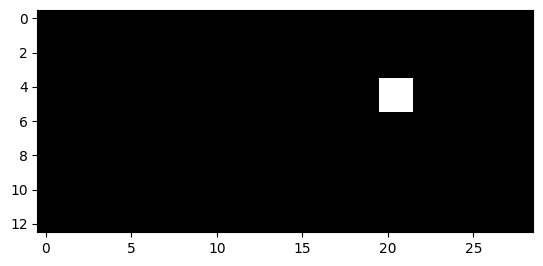

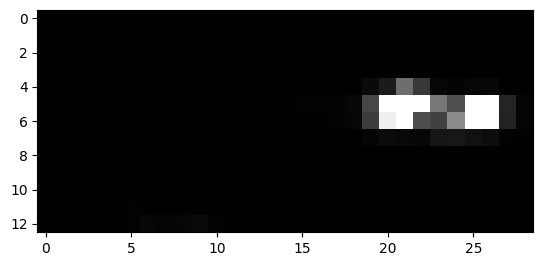

1736


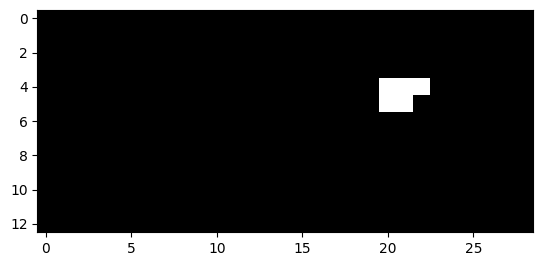

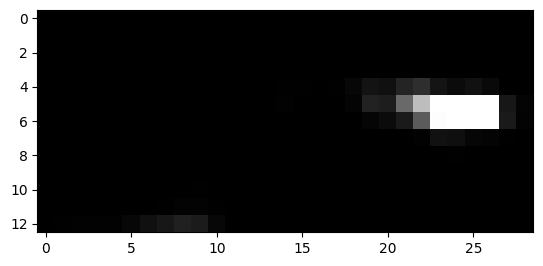

1737


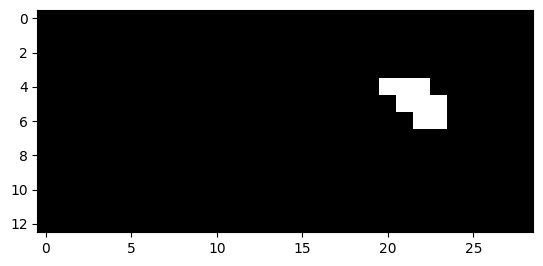

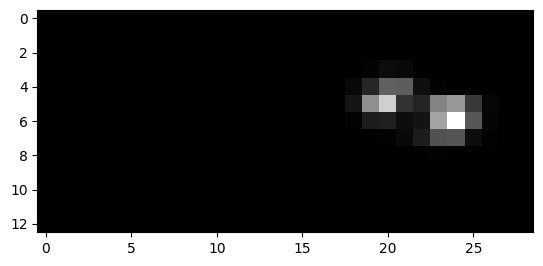

1738


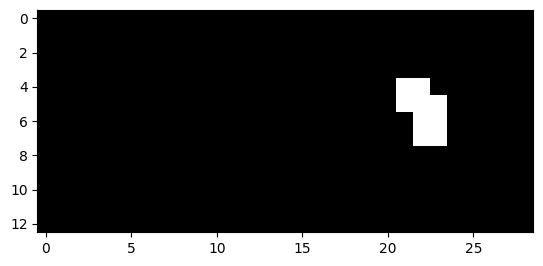

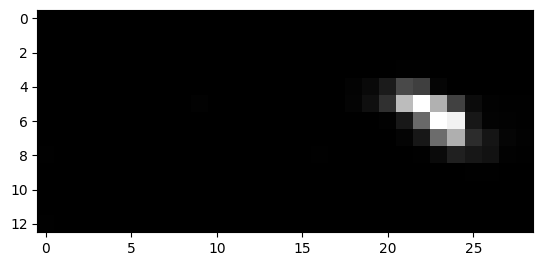

1739


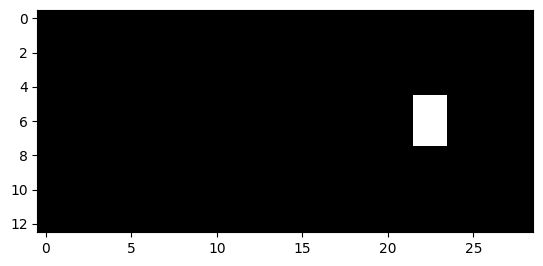

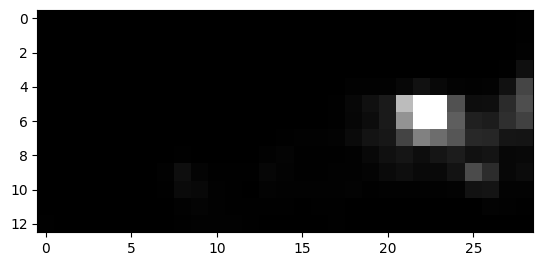

1740


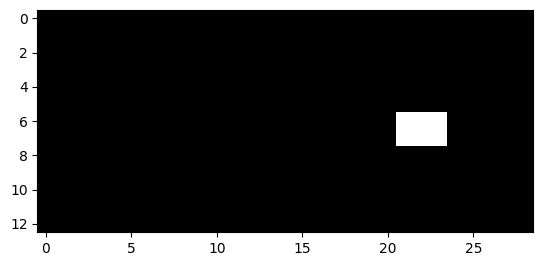

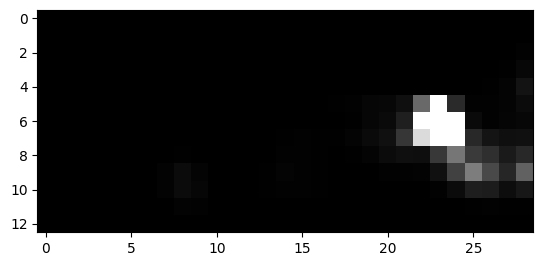

1741


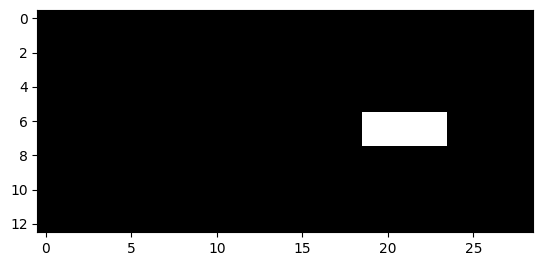

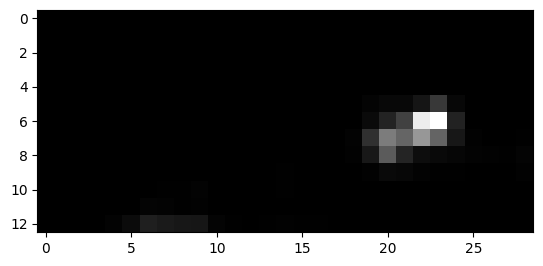

1742


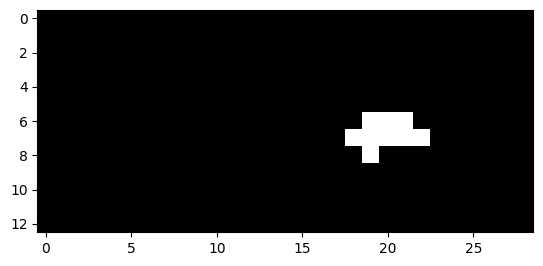

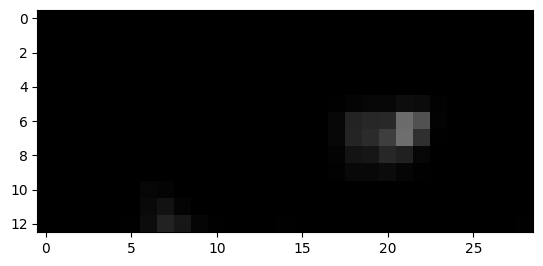

1743


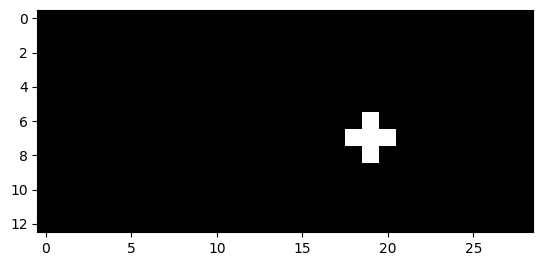

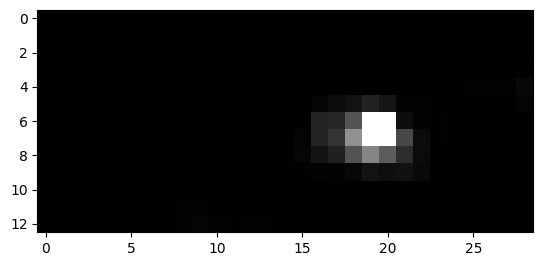

1750


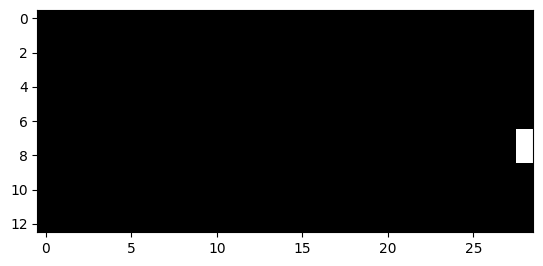

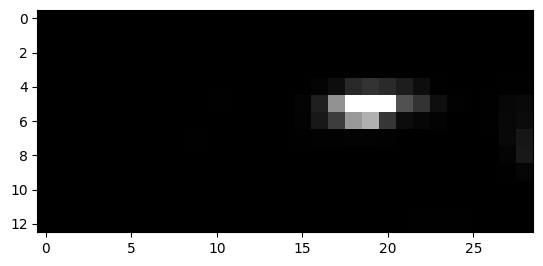

1751


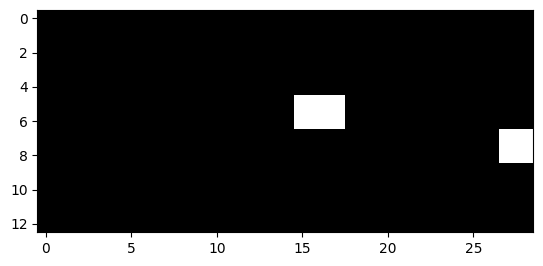

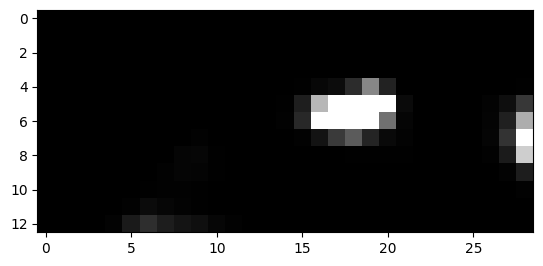

1752


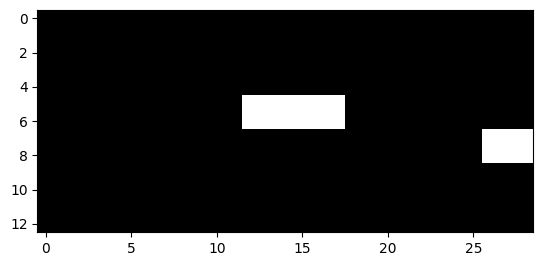

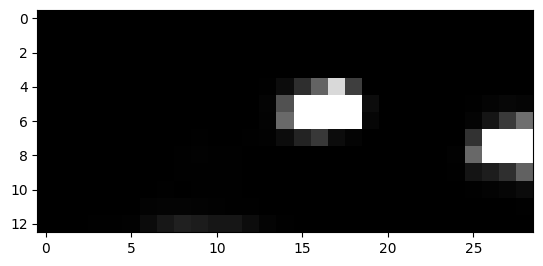

1753


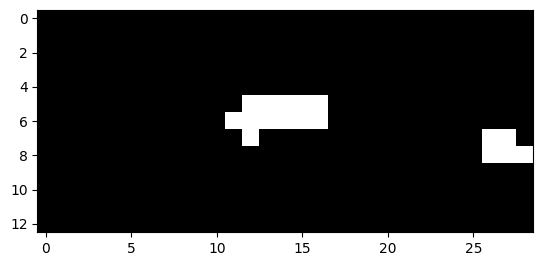

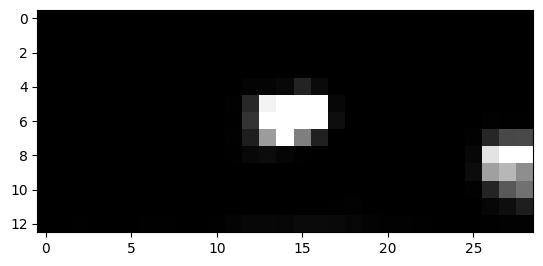

1754


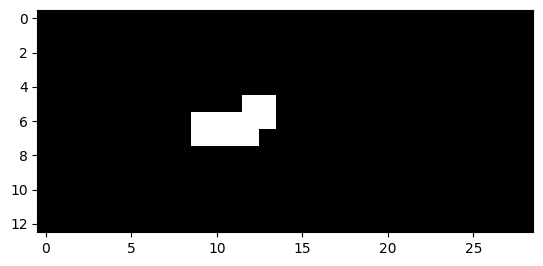

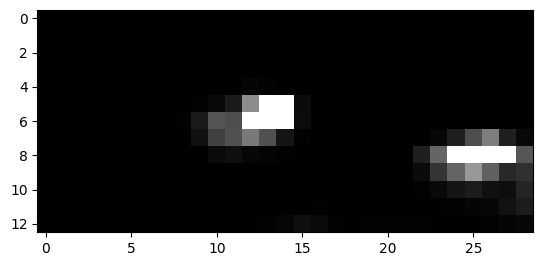

1755


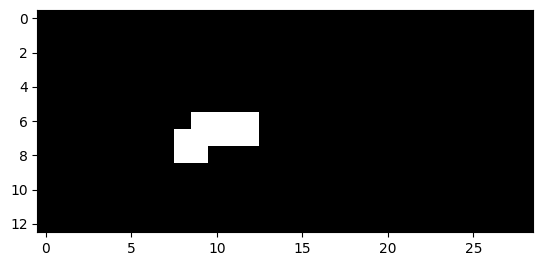

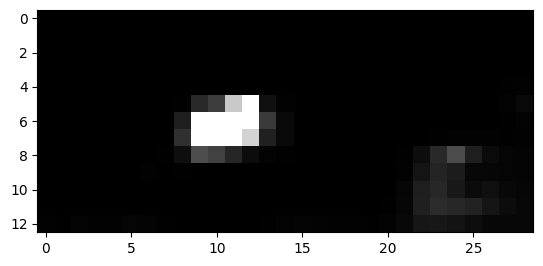

1756


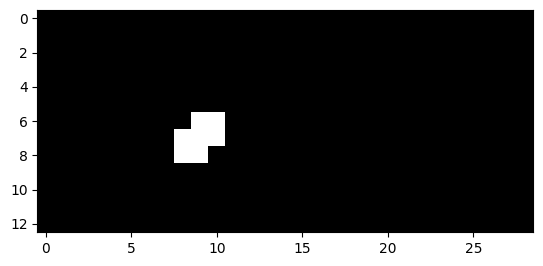

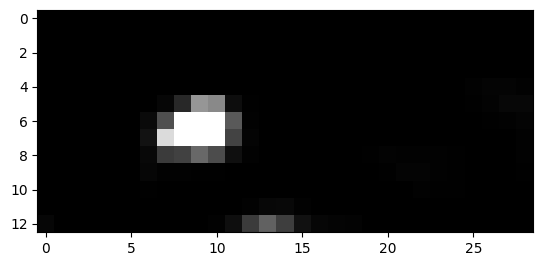

1760


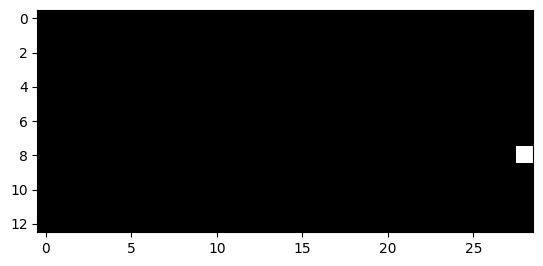

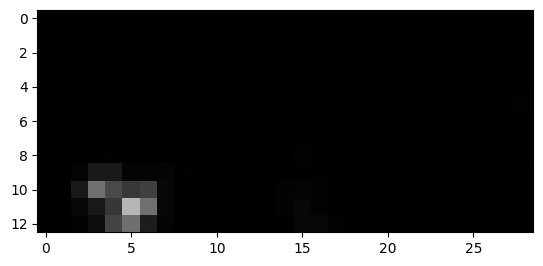

1761


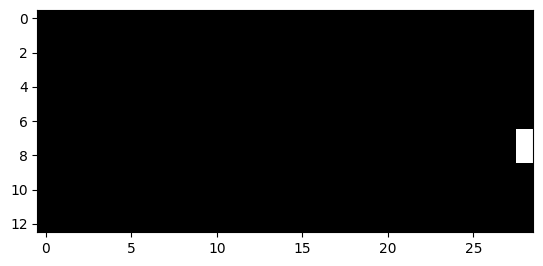

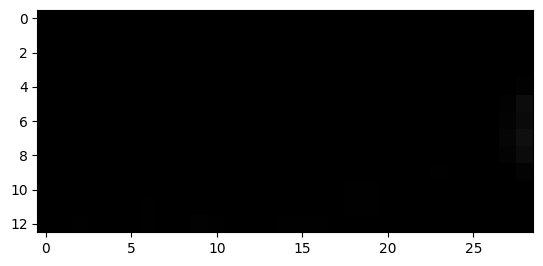

1762


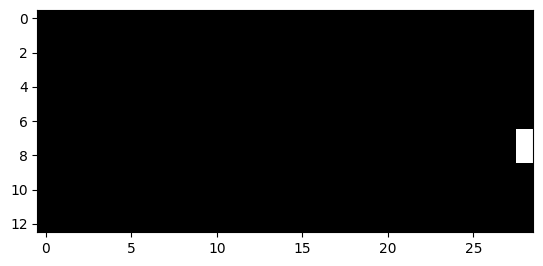

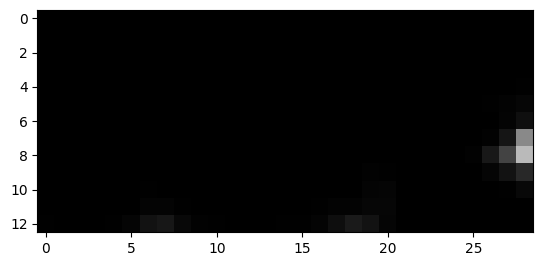

1770


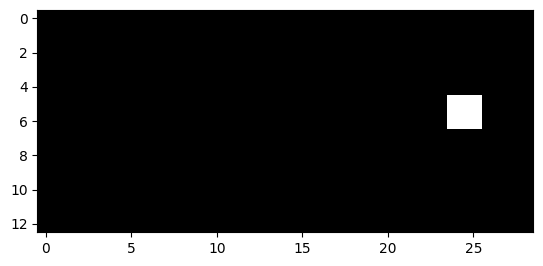

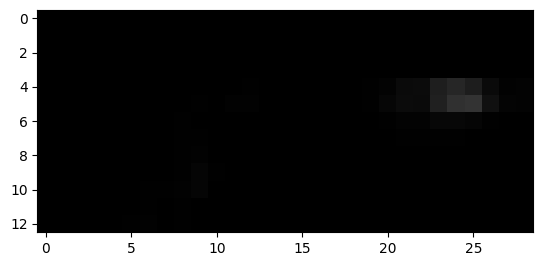

1771


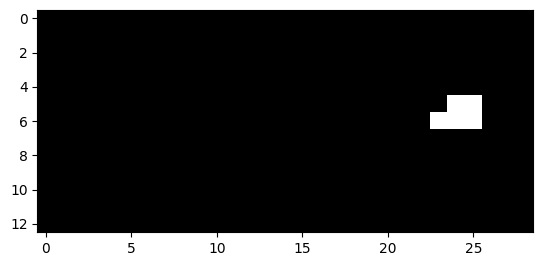

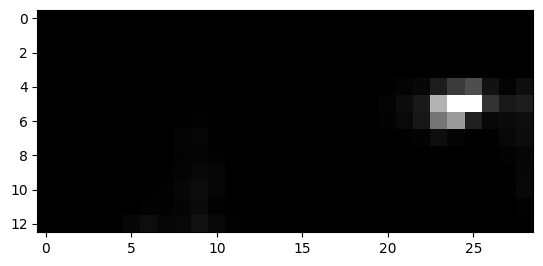

1772


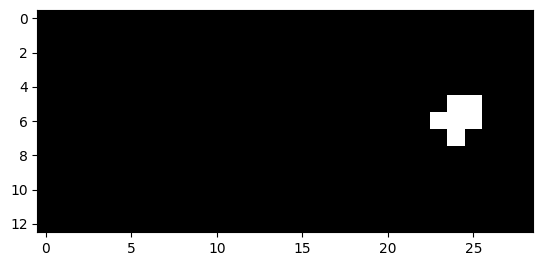

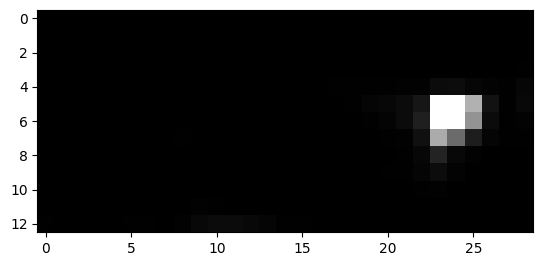

1773


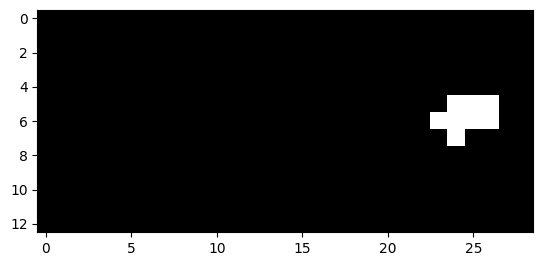

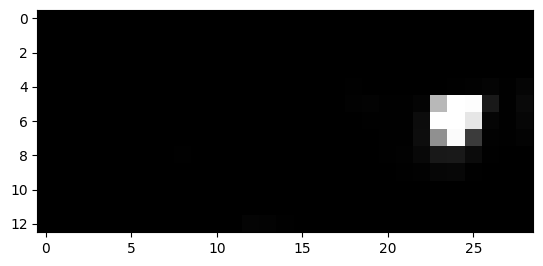

1774


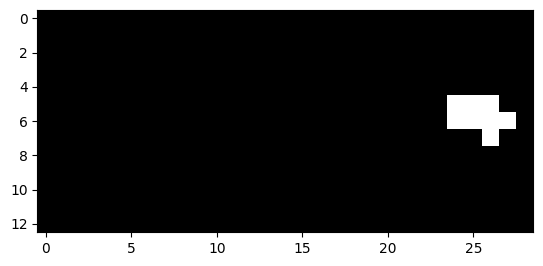

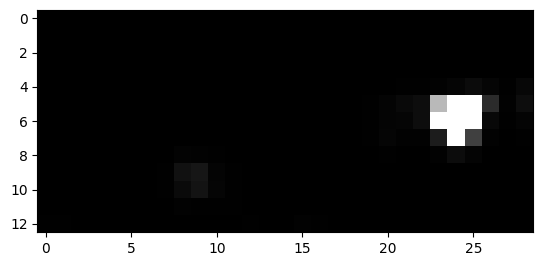

1775


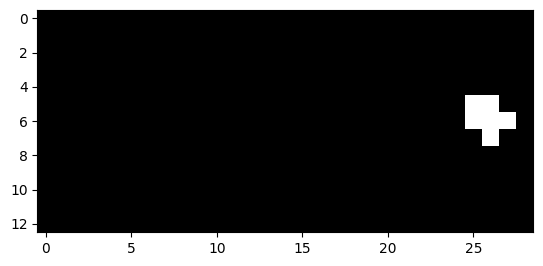

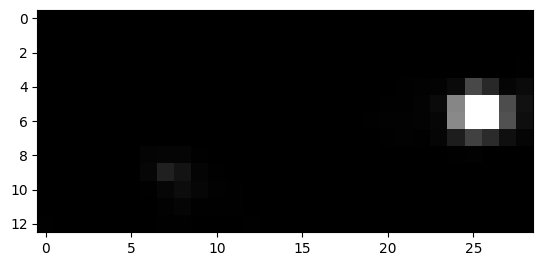

1776


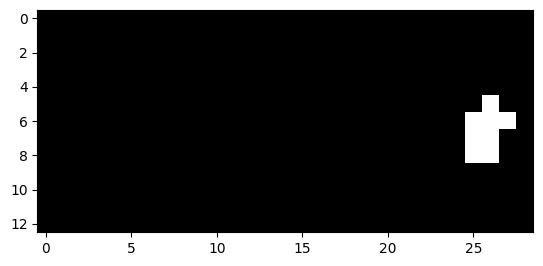

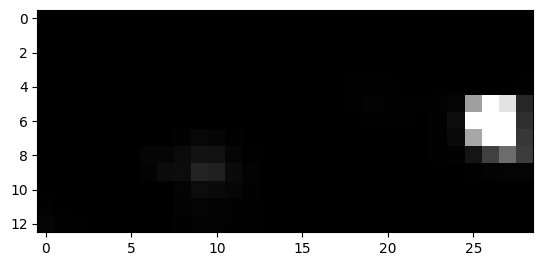

1777


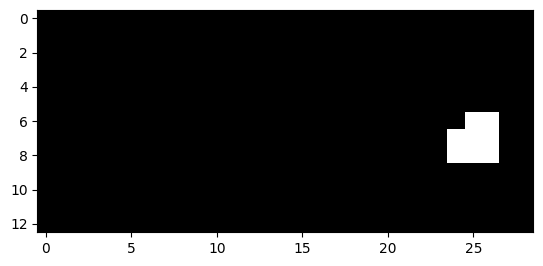

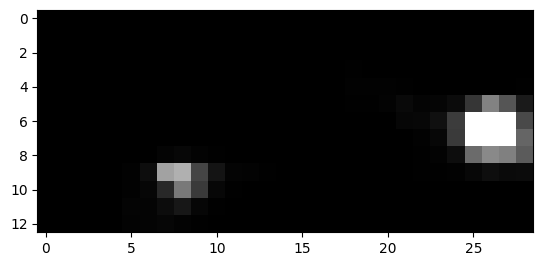

1778


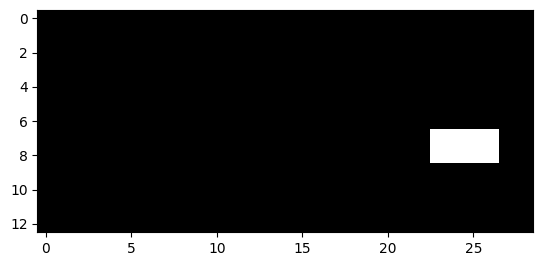

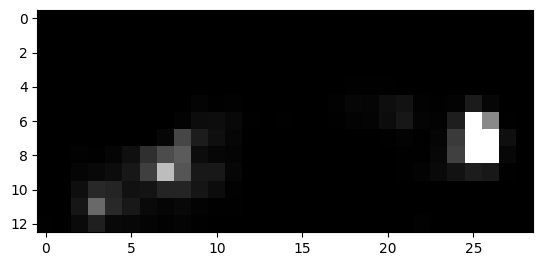

1779


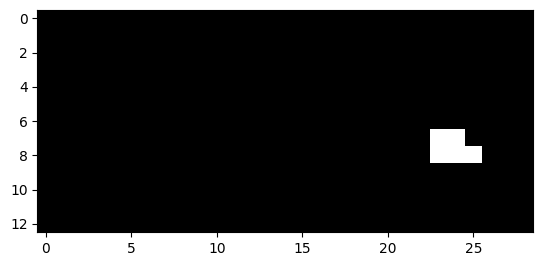

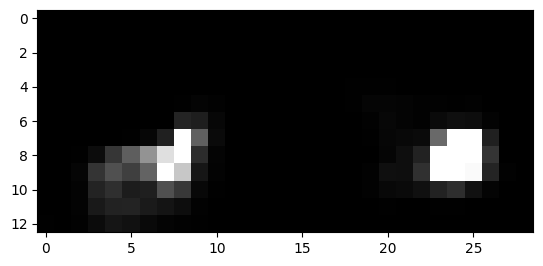

1786


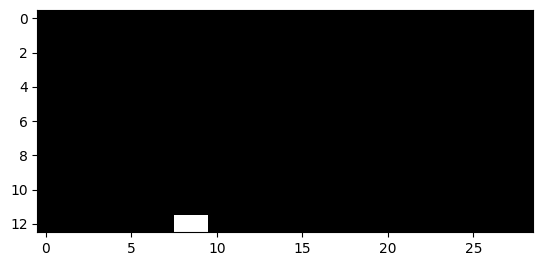

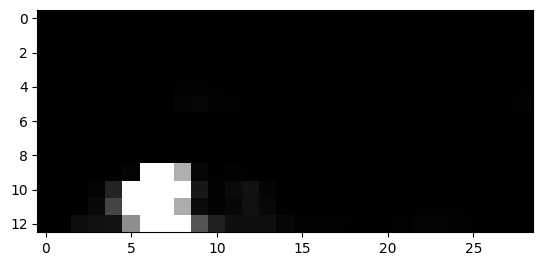

1787


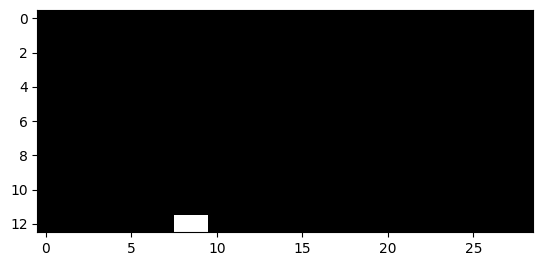

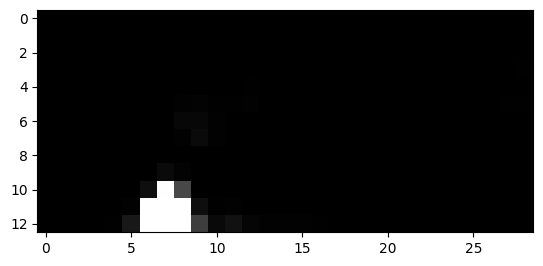

1792


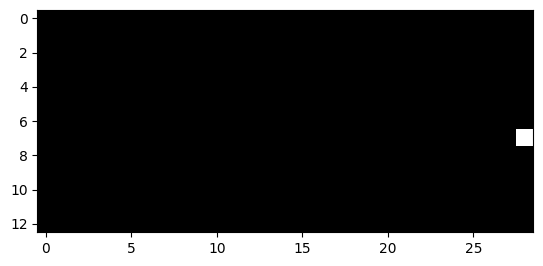

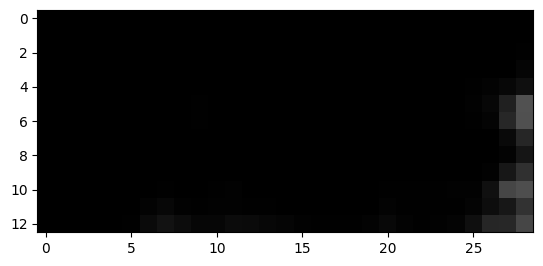

1793


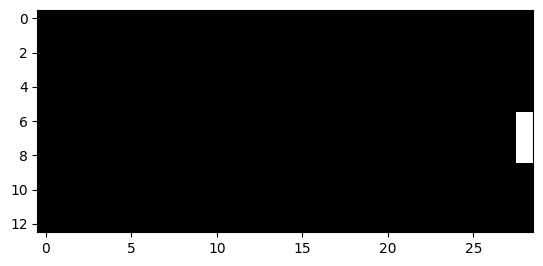

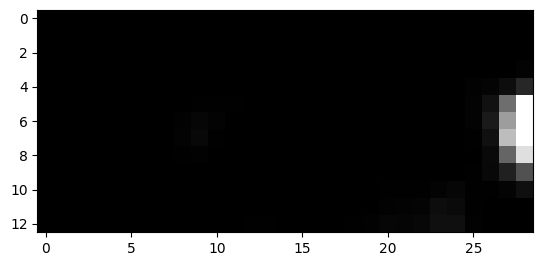

1794


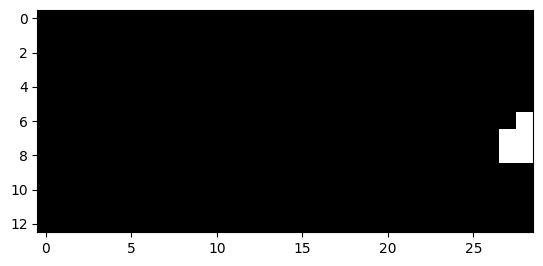

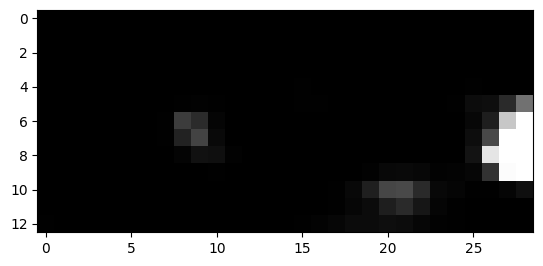

1795


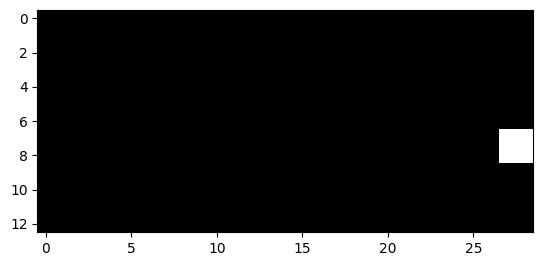

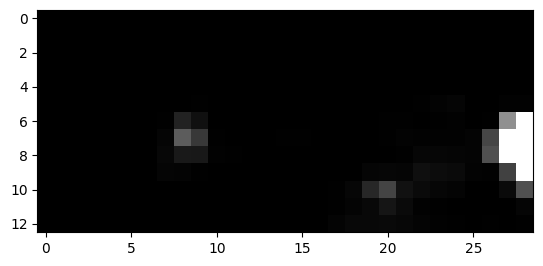

1796


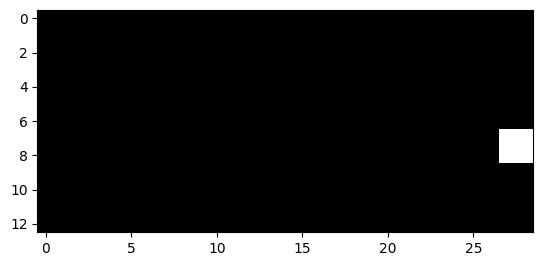

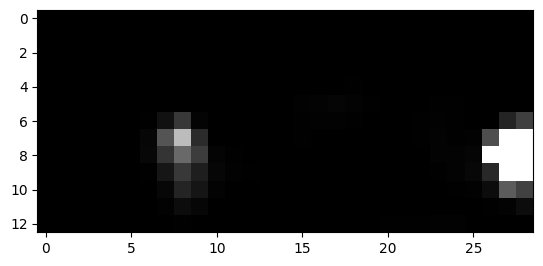

1797


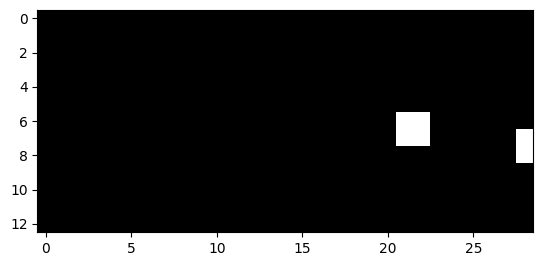

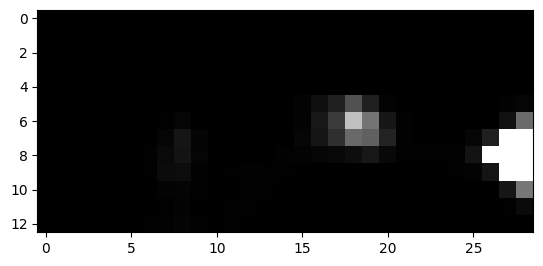

1798


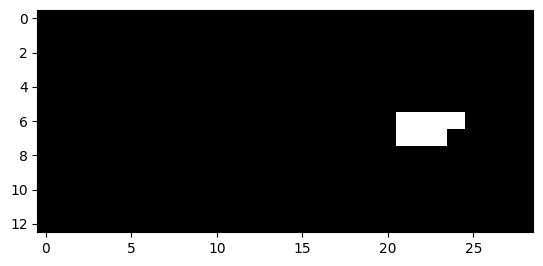

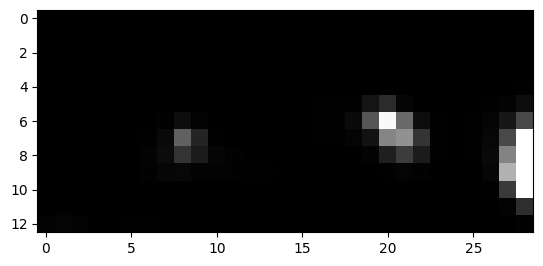

1799


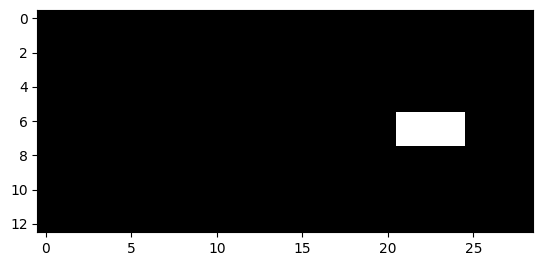

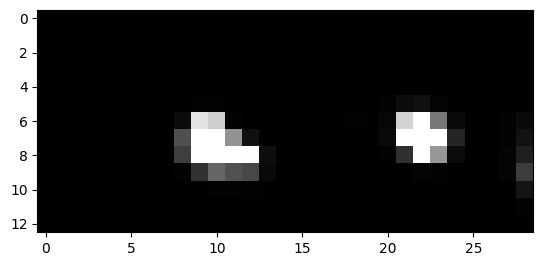

1800


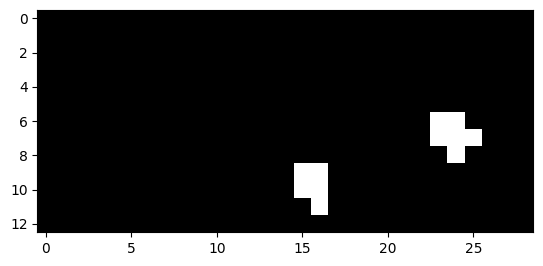

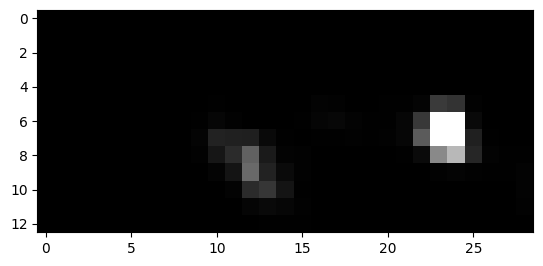

1801


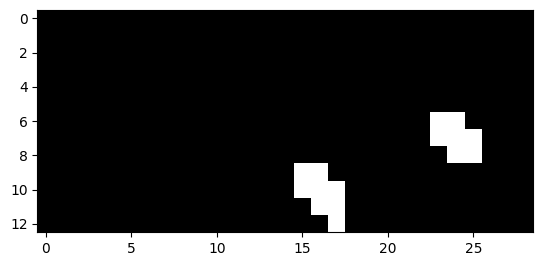

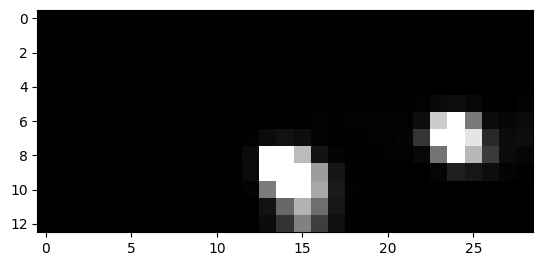

1802


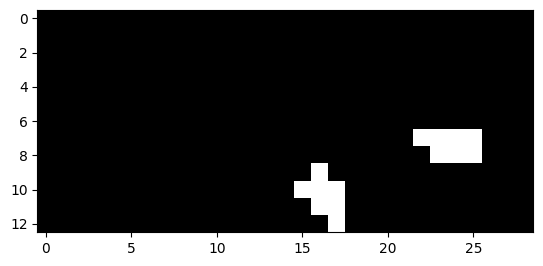

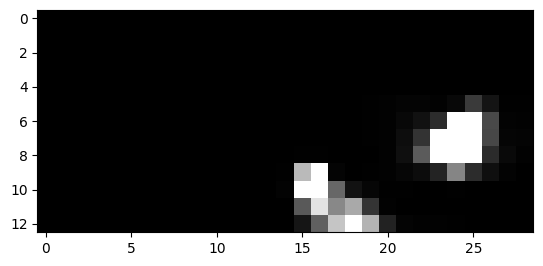

1803


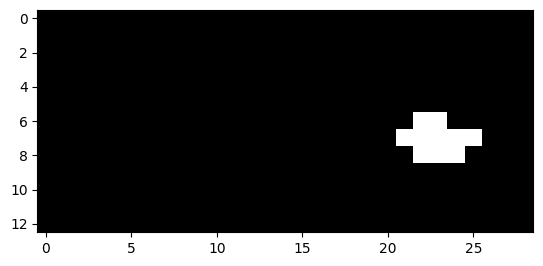

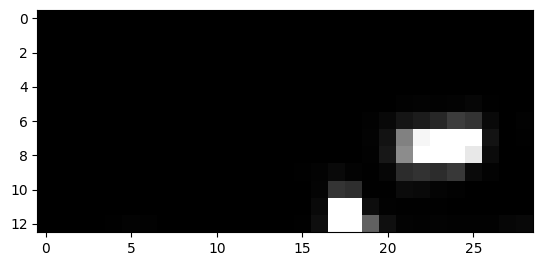

1804


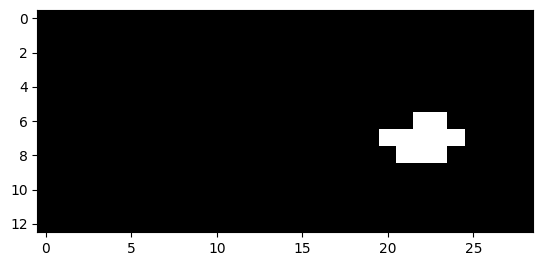

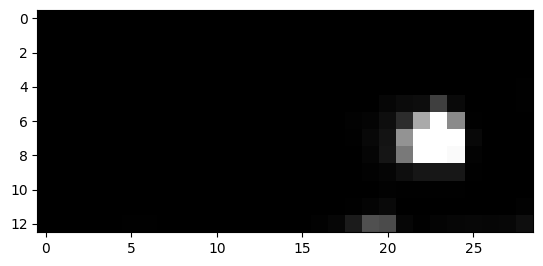

1805


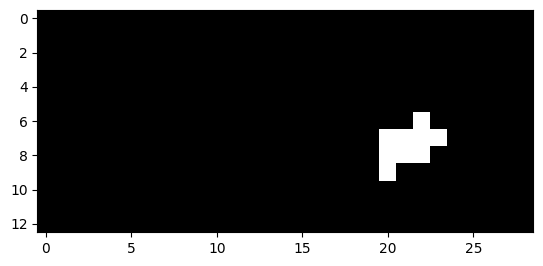

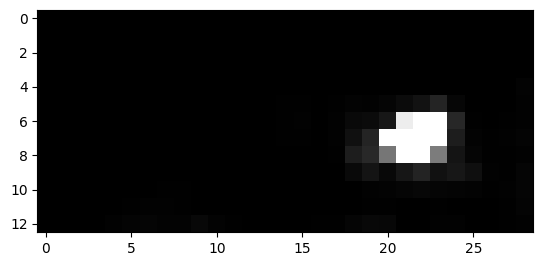

1806


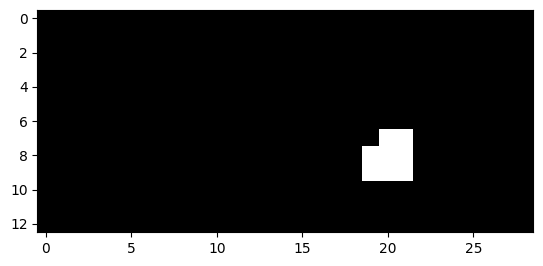

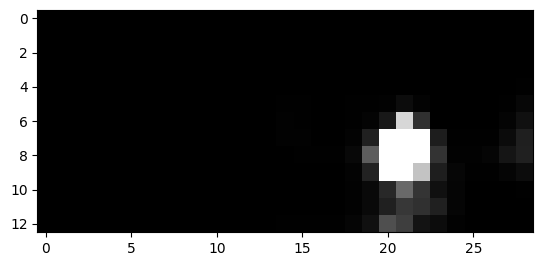

1807


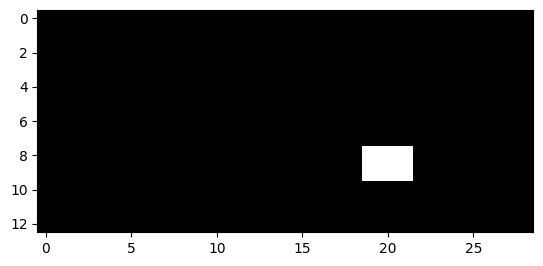

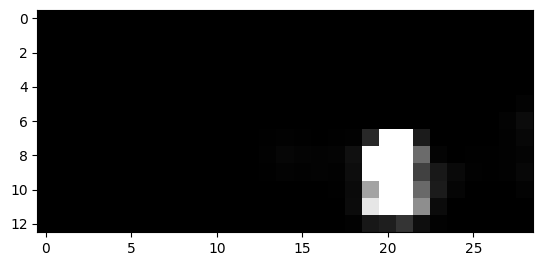

1808


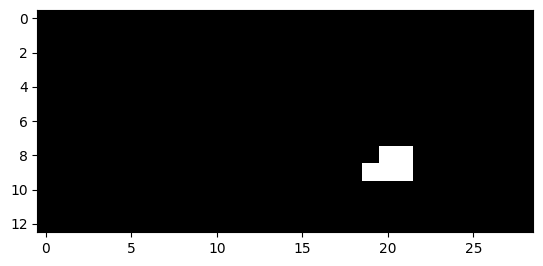

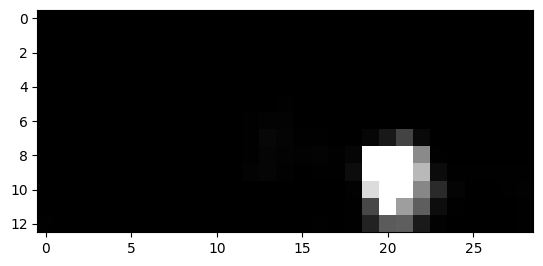

1809


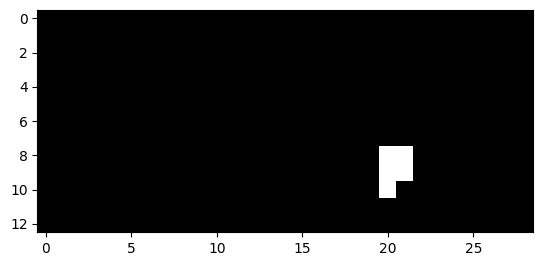

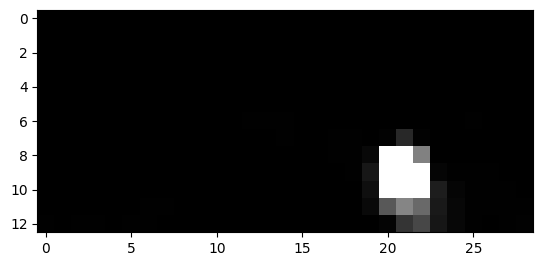

1810


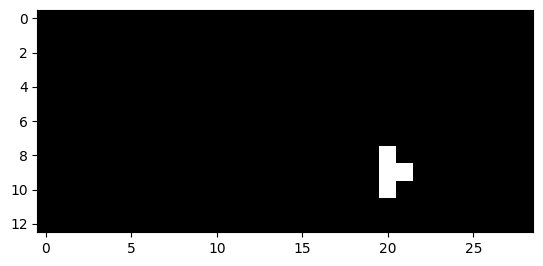

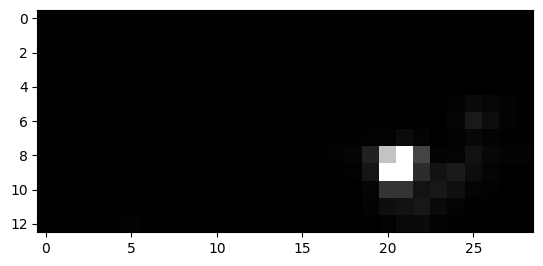

1845


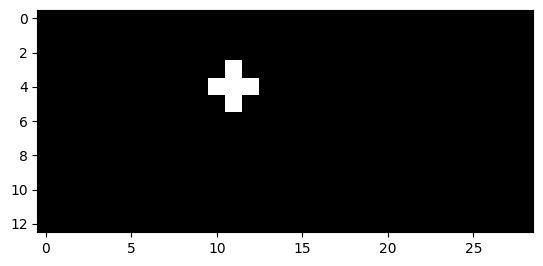

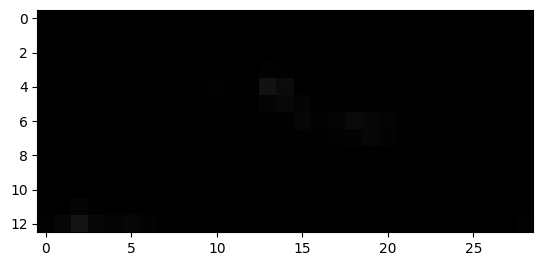

1846


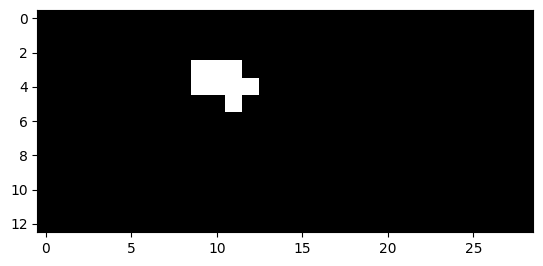

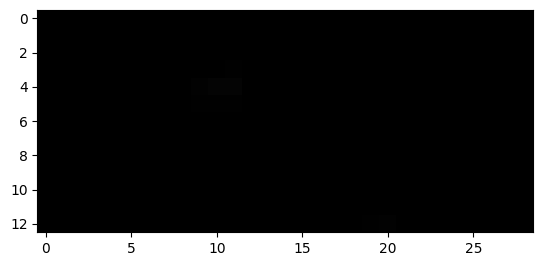

1847


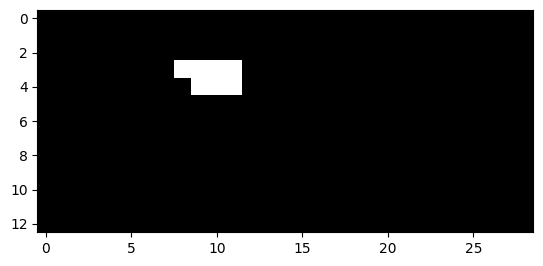

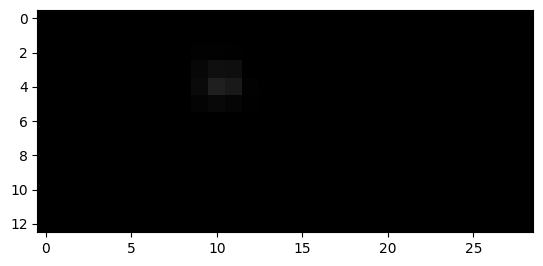

1848


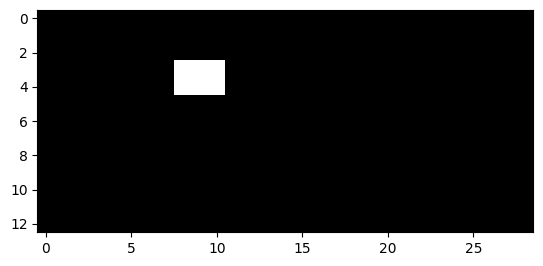

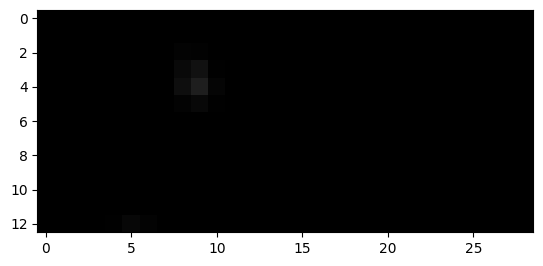

1849


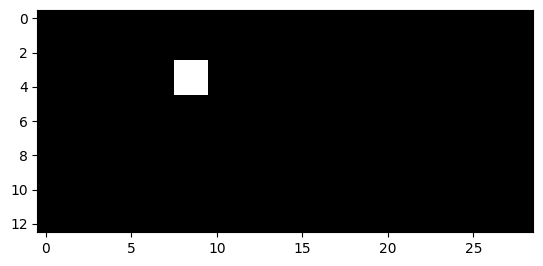

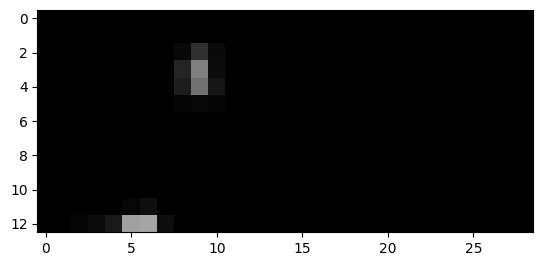

2122


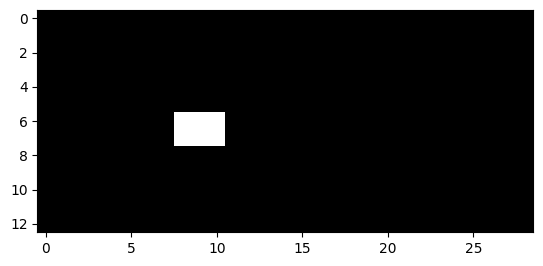

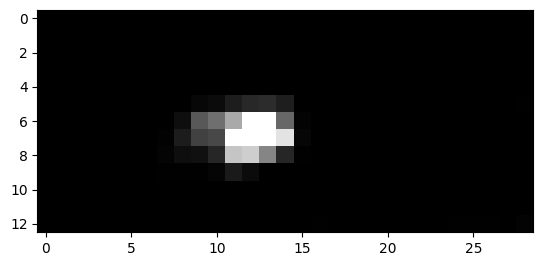

2123


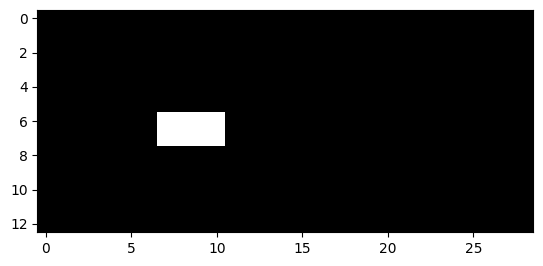

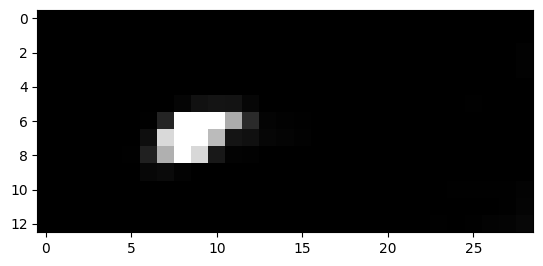

2124


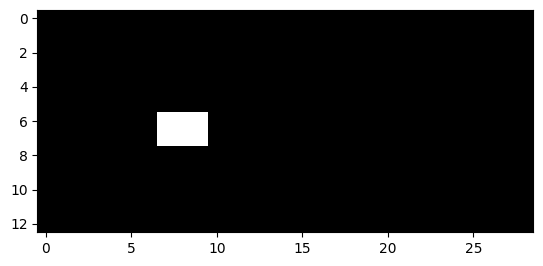

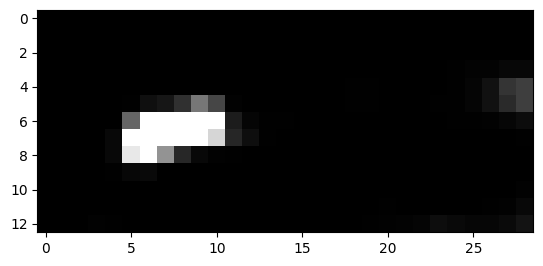

2126


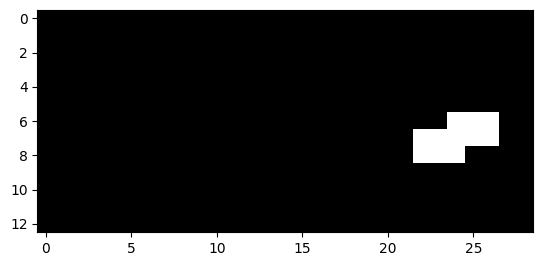

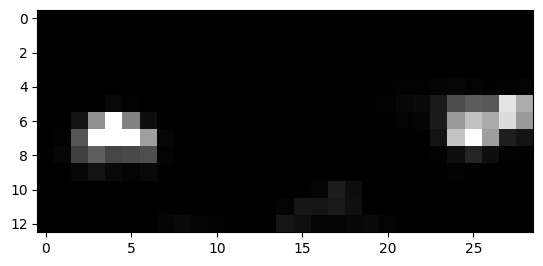

2127


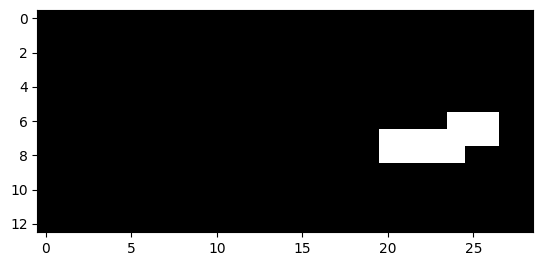

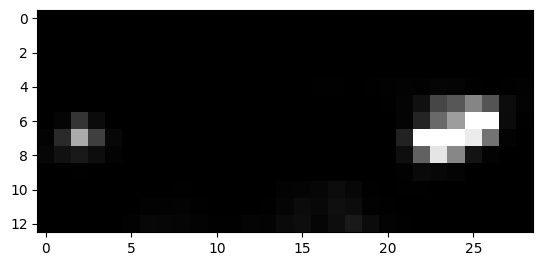

2128


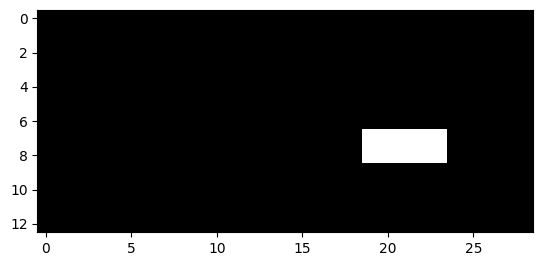

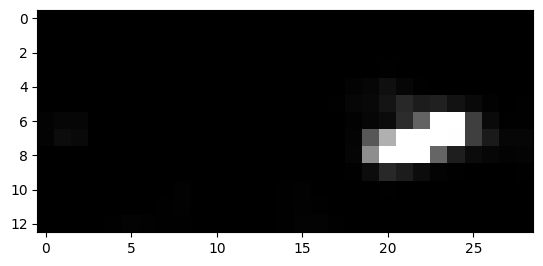

2129


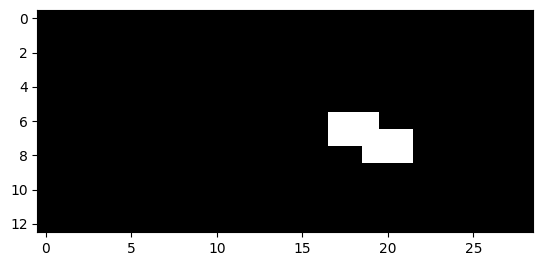

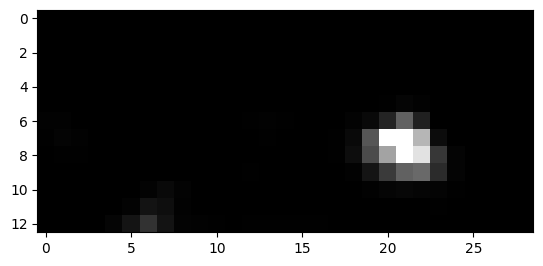

2130


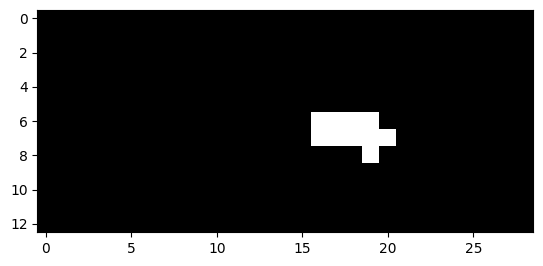

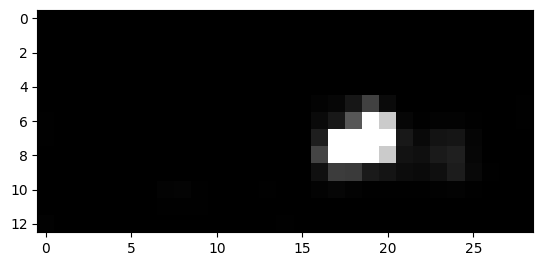

2131


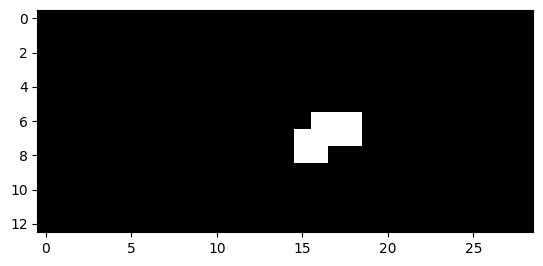

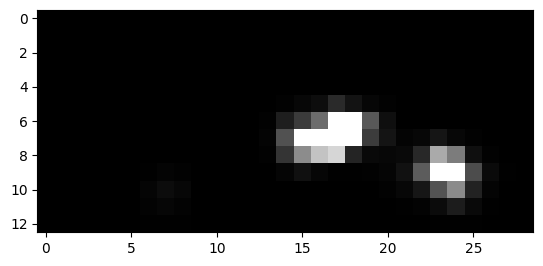

2132


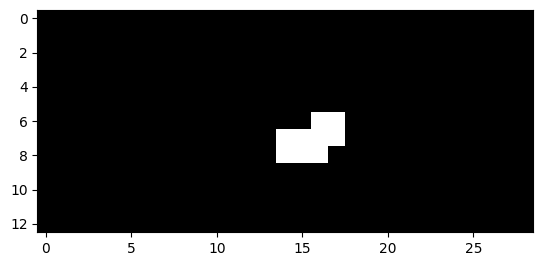

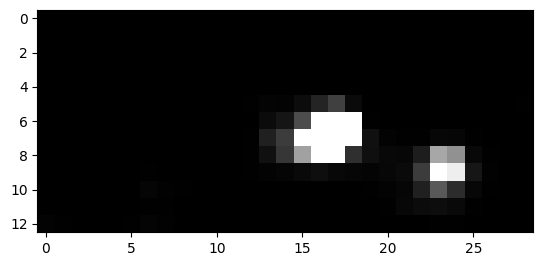

2133


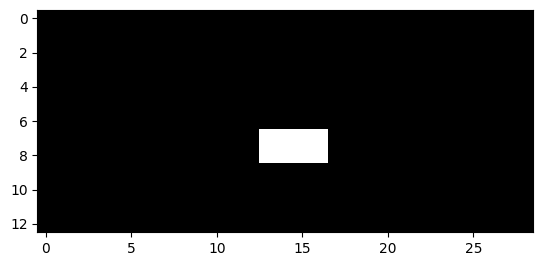

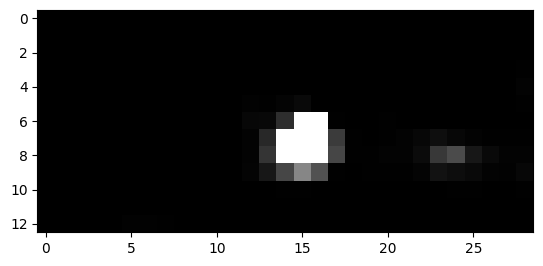

2134


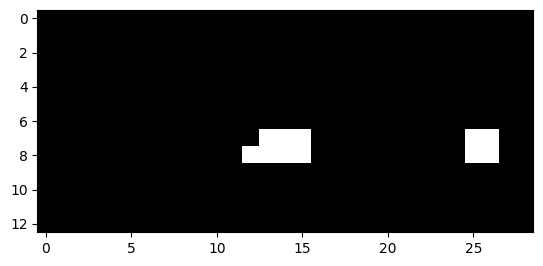

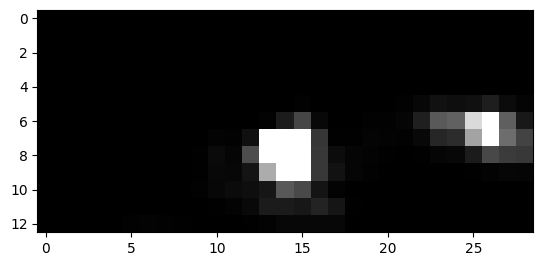

2135


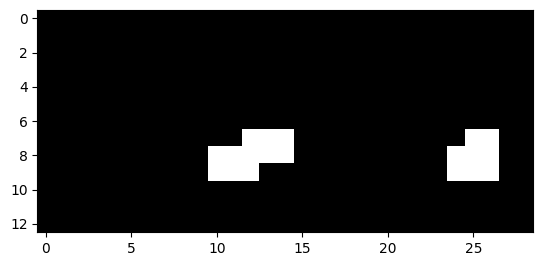

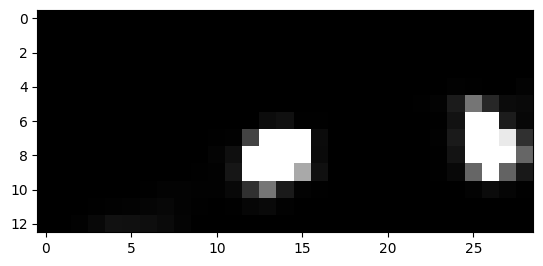

2136


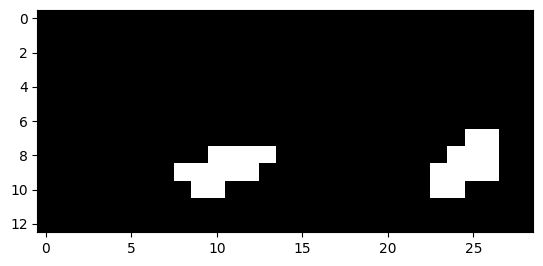

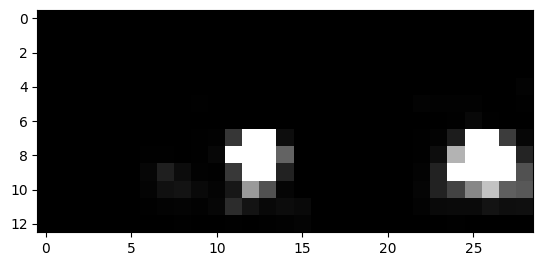

2137


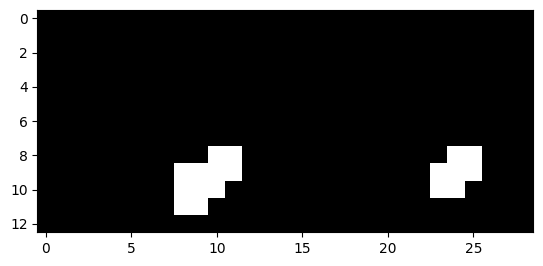

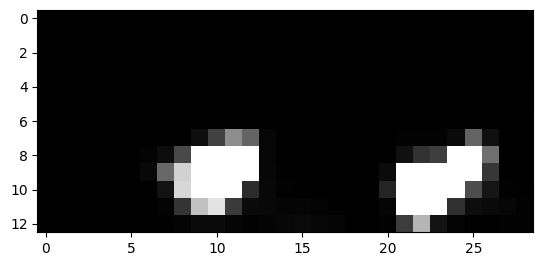

2138


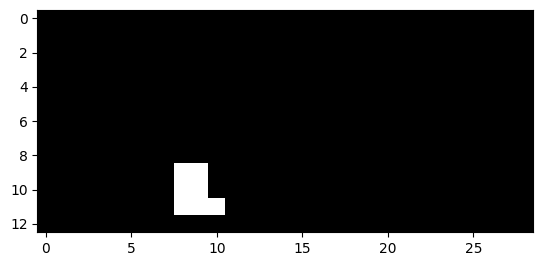

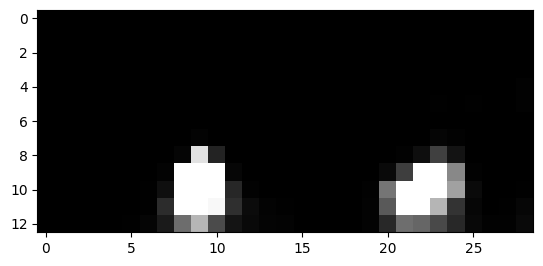

2139


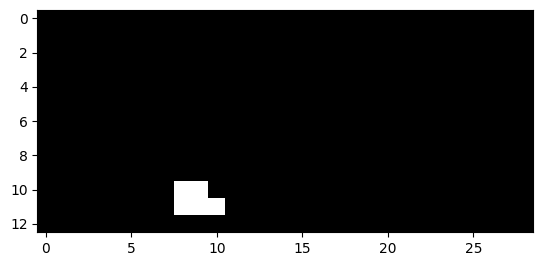

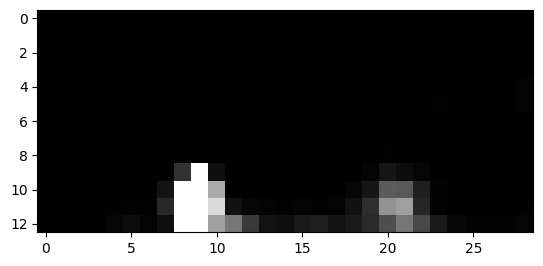

2143


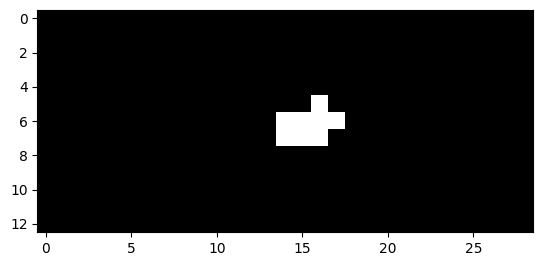

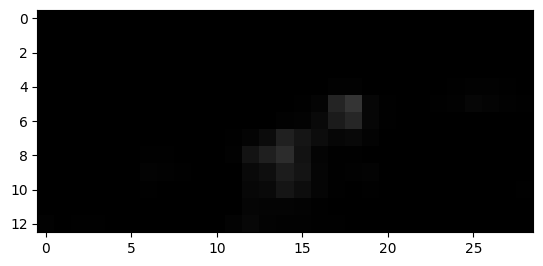

2144


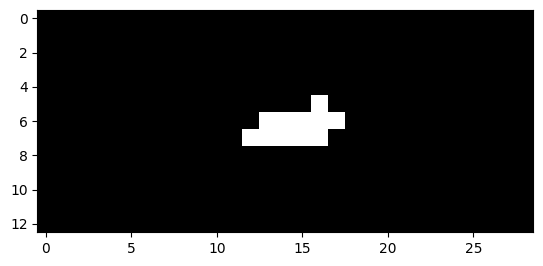

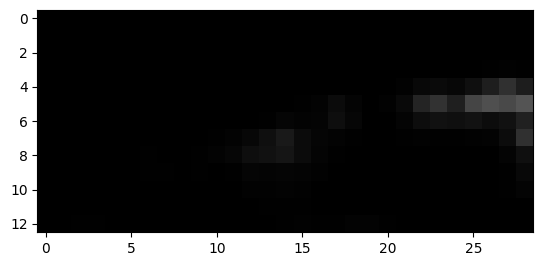

2145


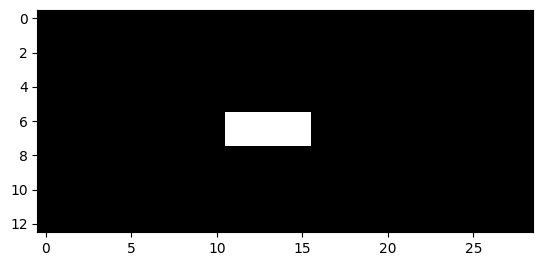

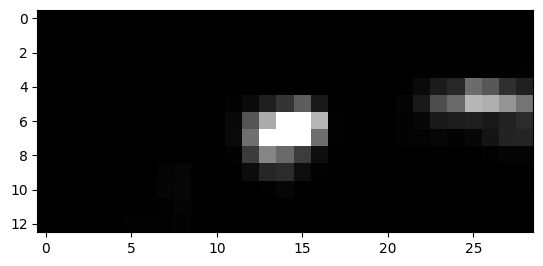

2146


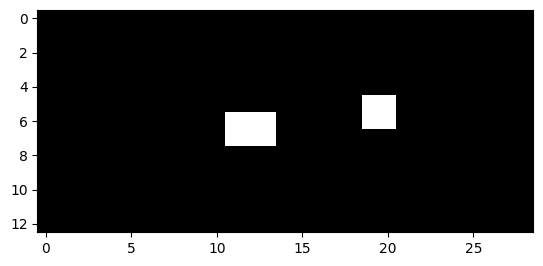

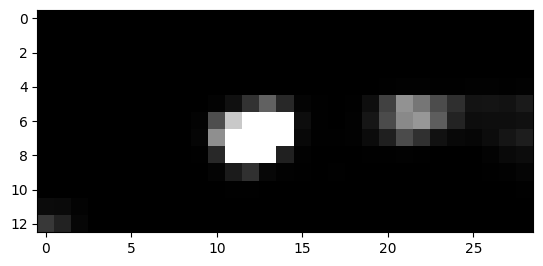

2147


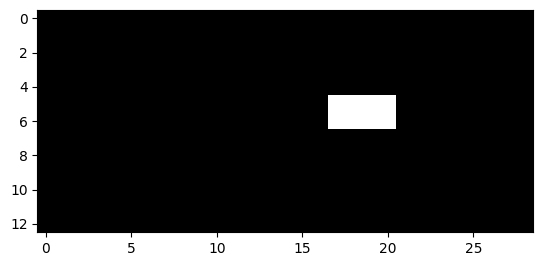

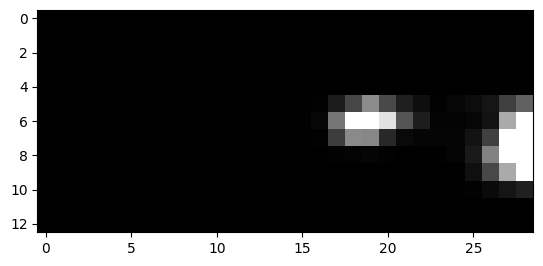

2148


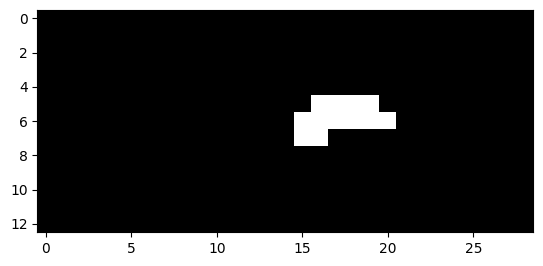

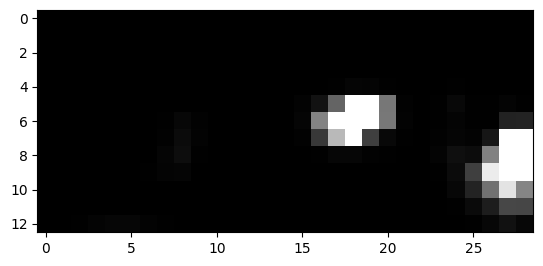

2149


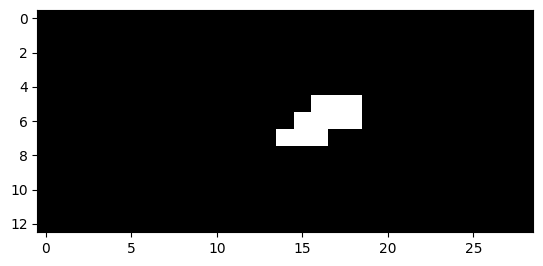

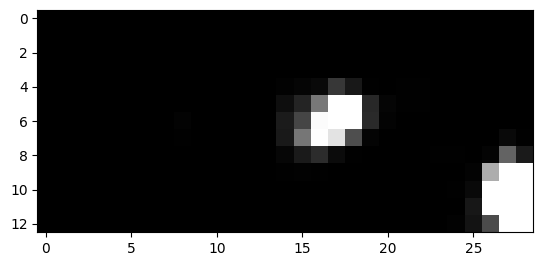

2150


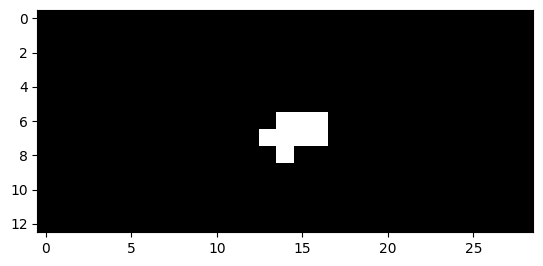

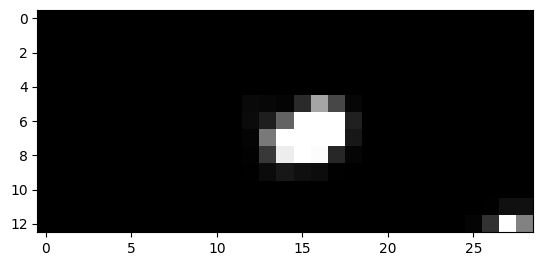

2151


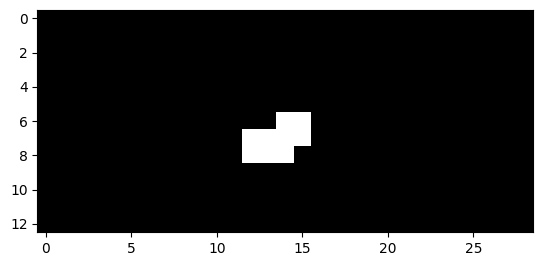

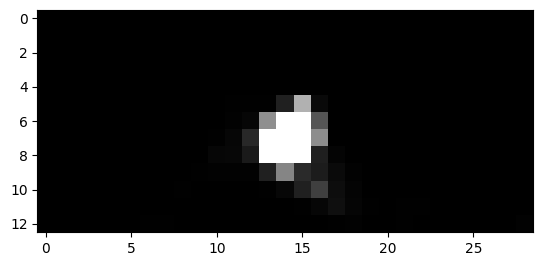

2152


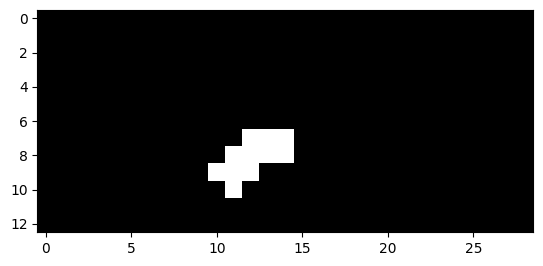

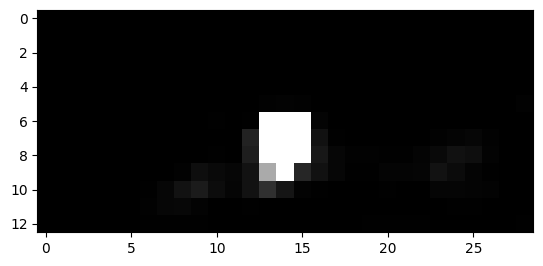

2153


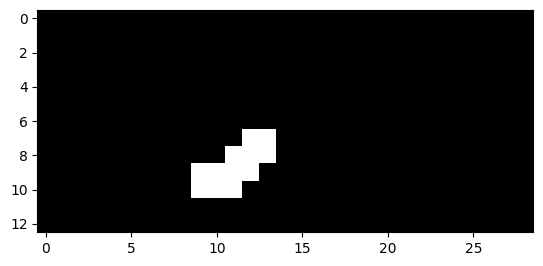

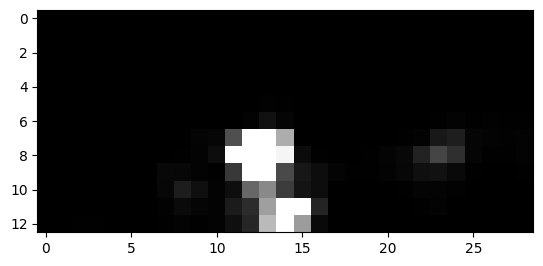

2154


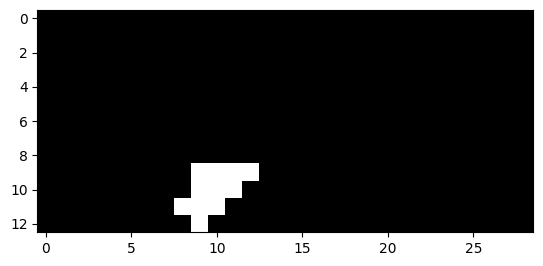

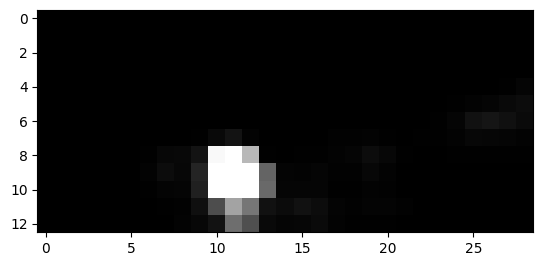

2155


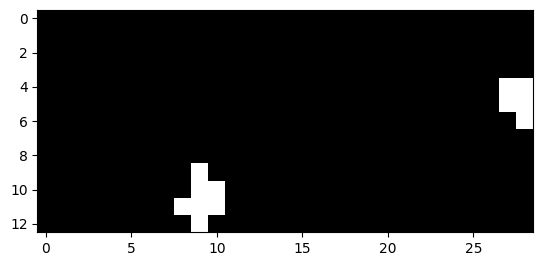

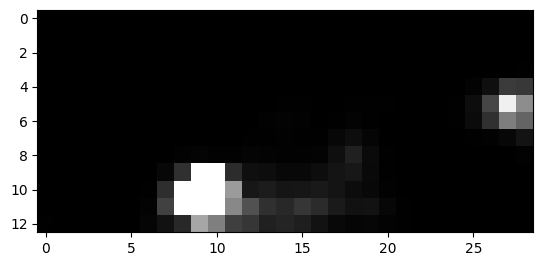

2156


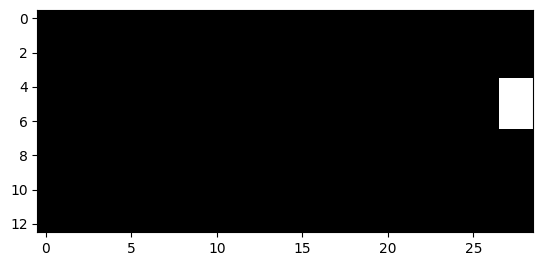

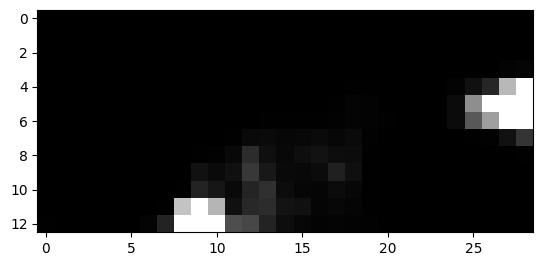

2157


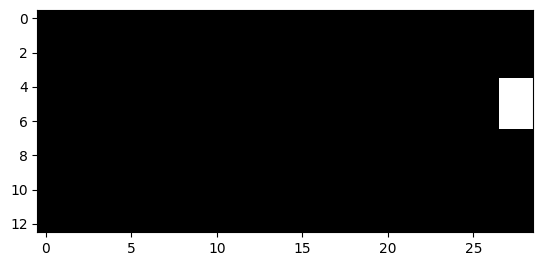

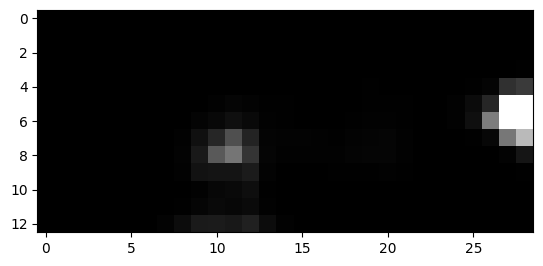

2166


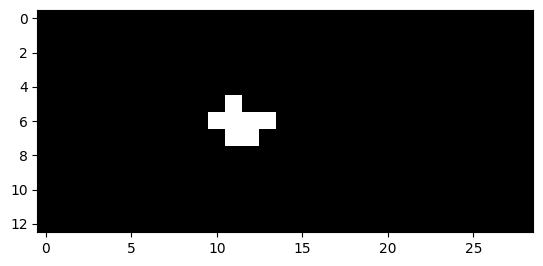

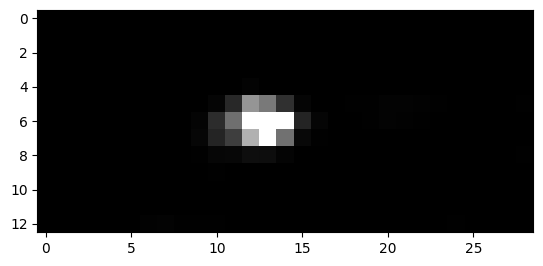

2167


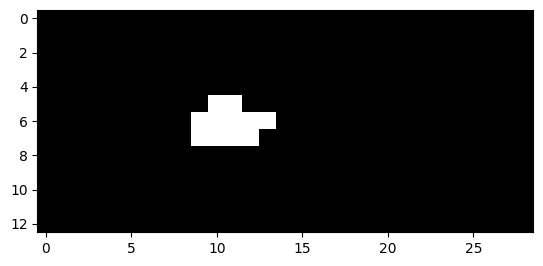

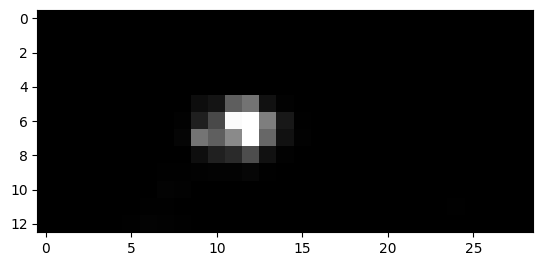

2168


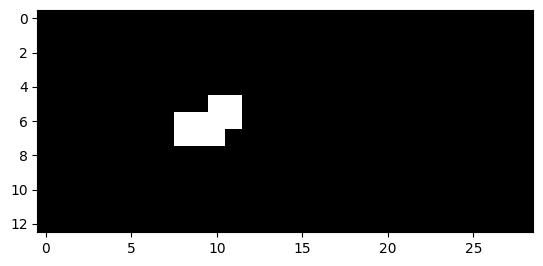

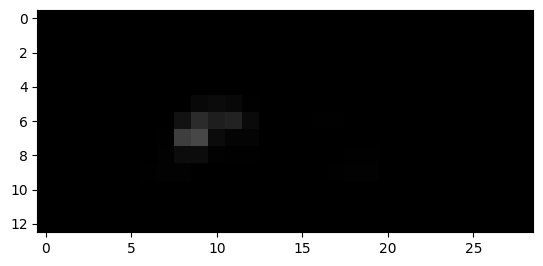

2169


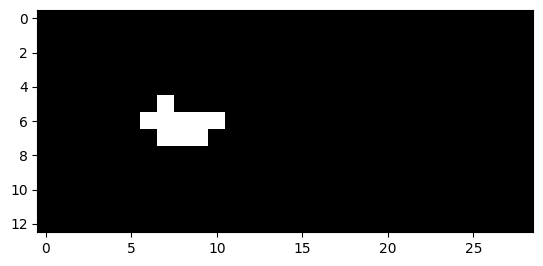

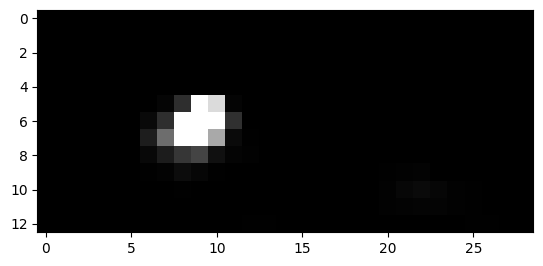

2170


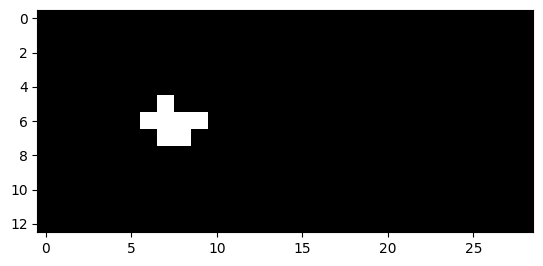

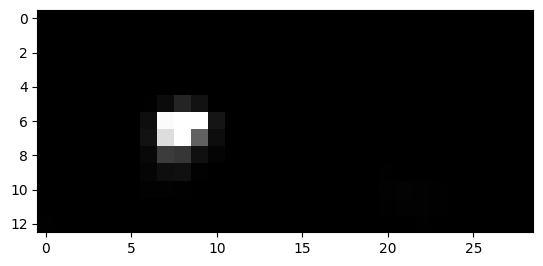

2171


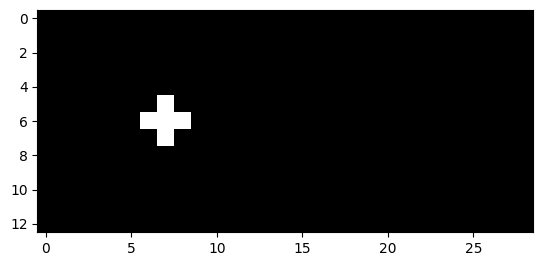

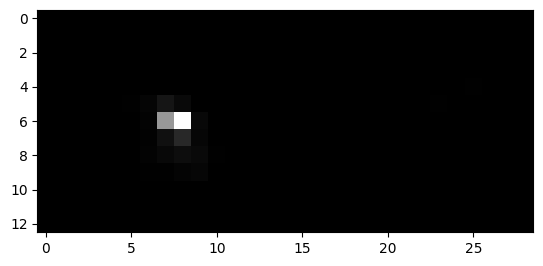

2174


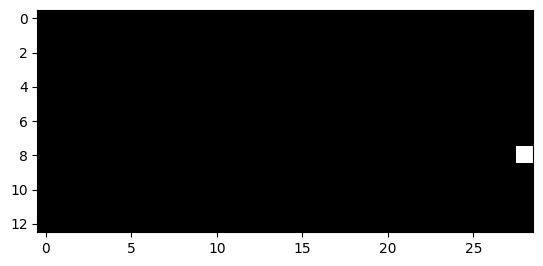

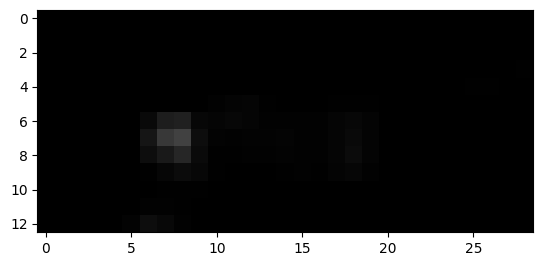

2175


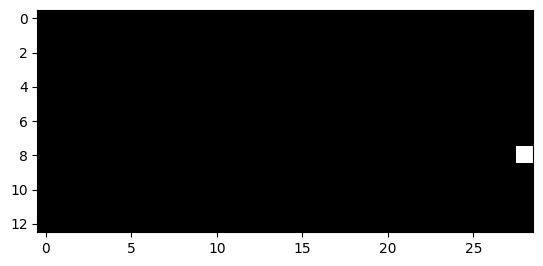

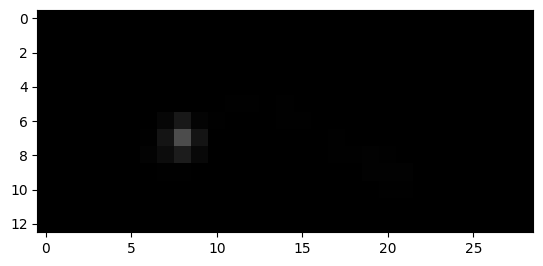

2181


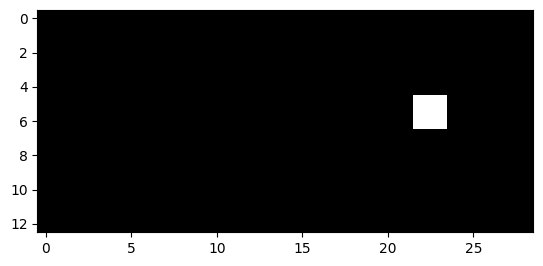

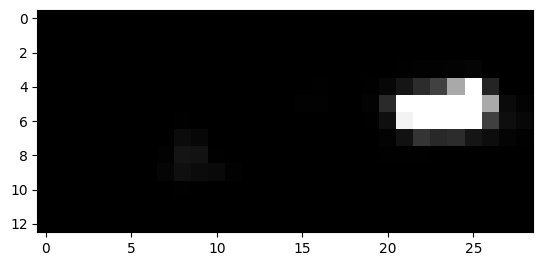

2182


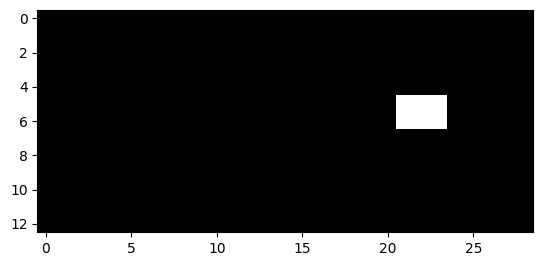

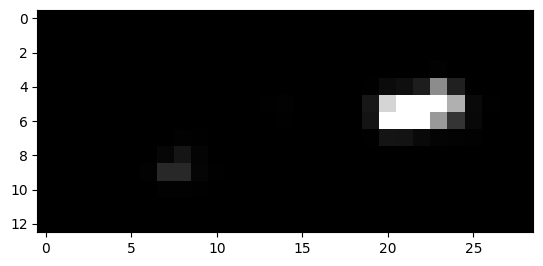

2183


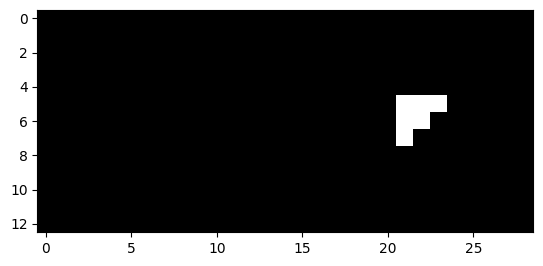

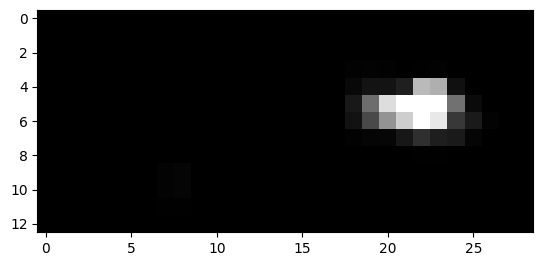

2184


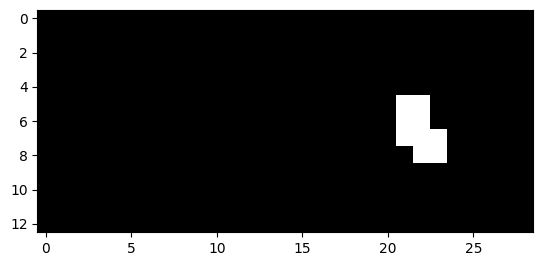

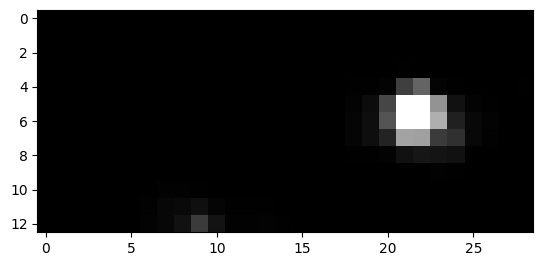

2185


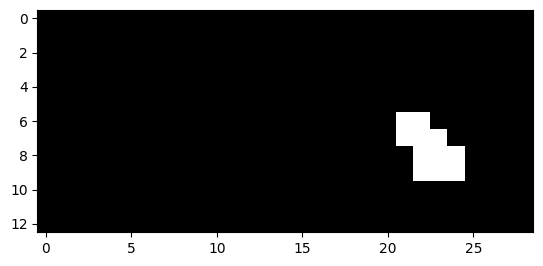

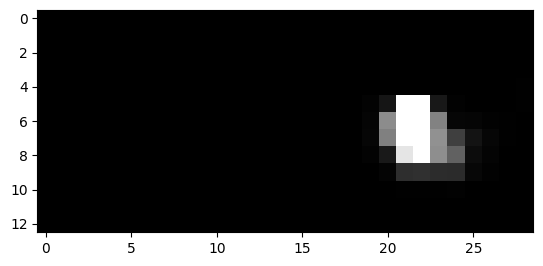

2186


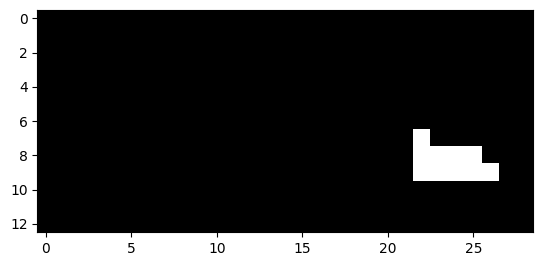

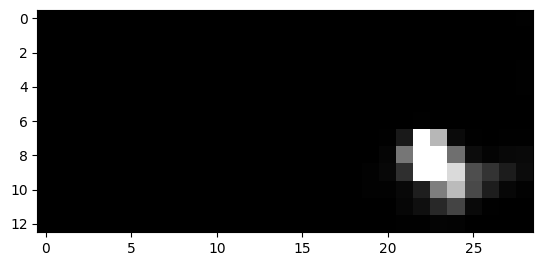

2187


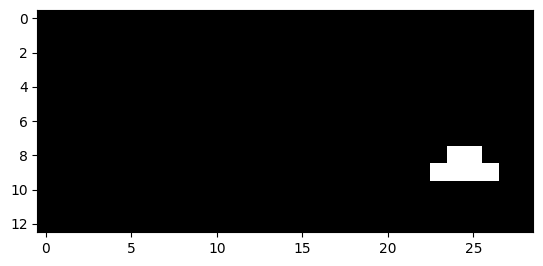

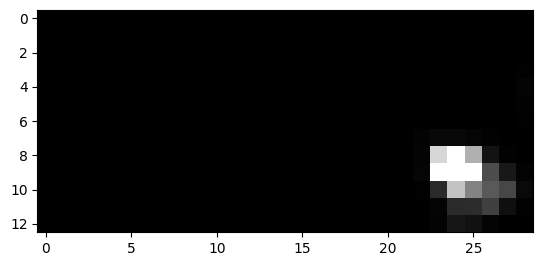

2188


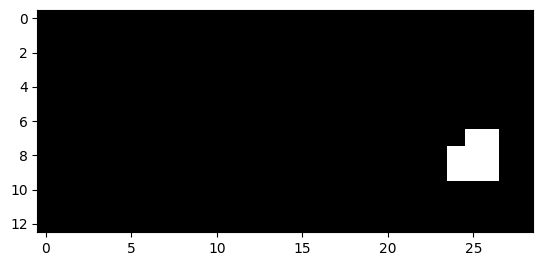

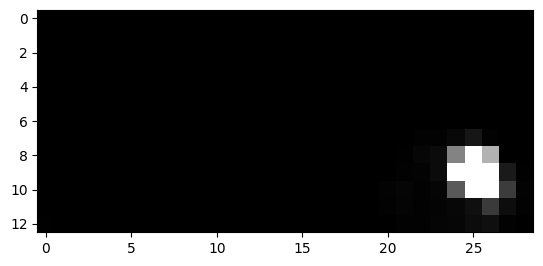

2189


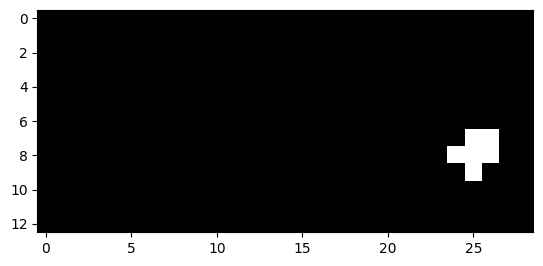

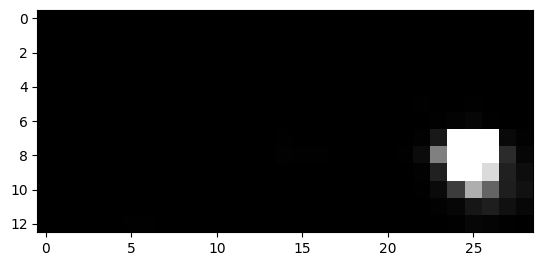

2190


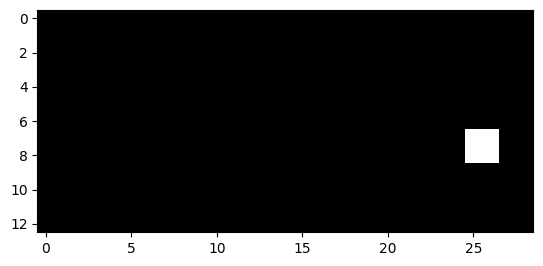

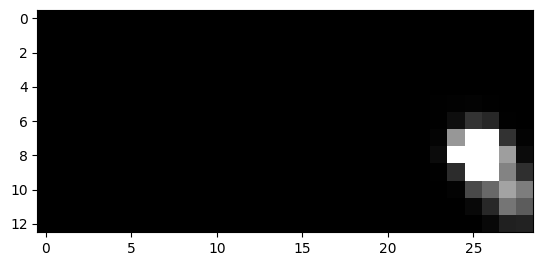

2191


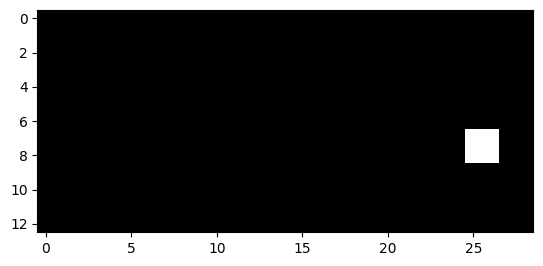

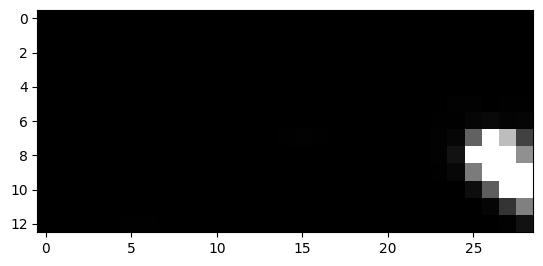

2214


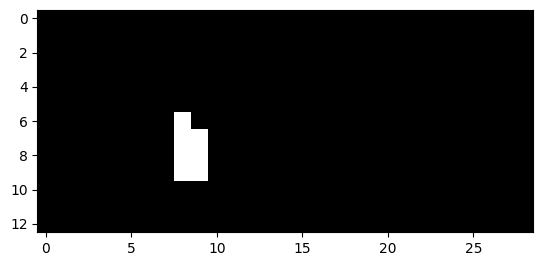

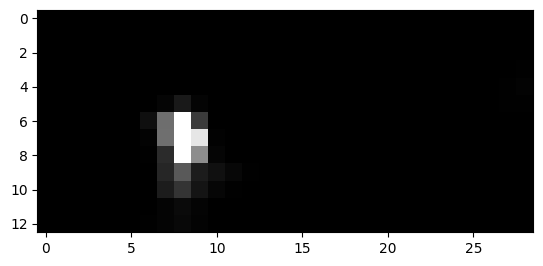

2215


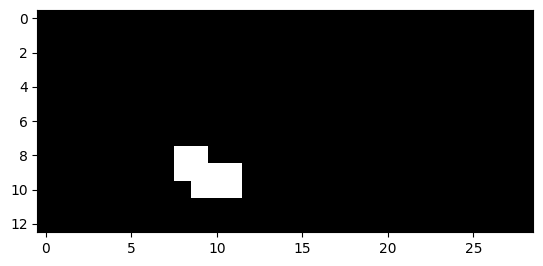

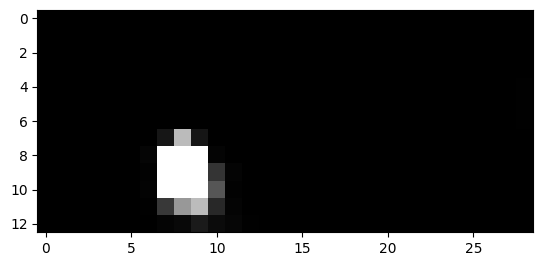

2216


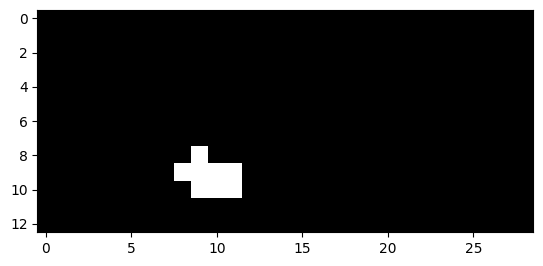

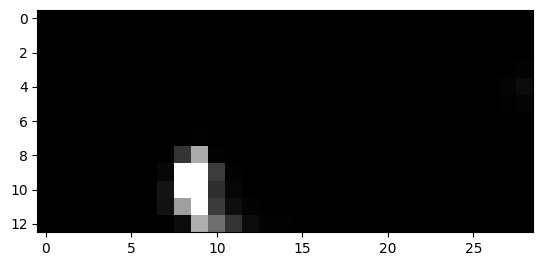

2226


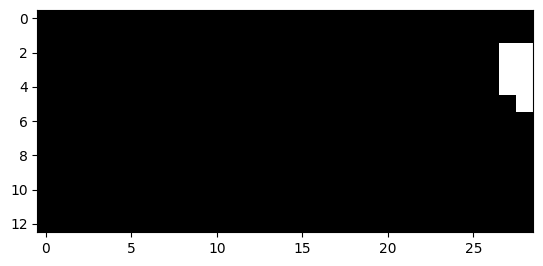

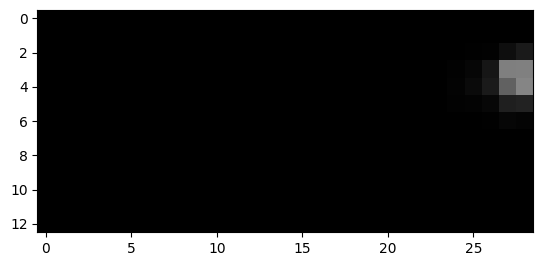

2227


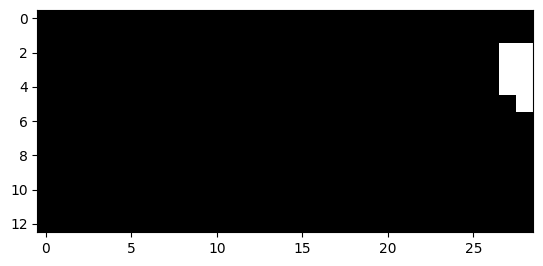

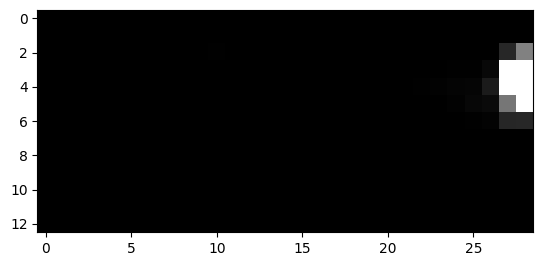

2228


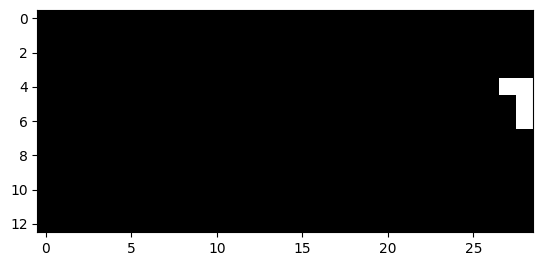

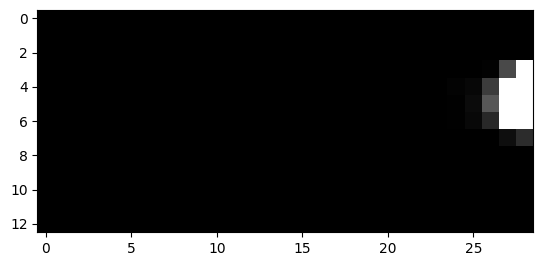

2229


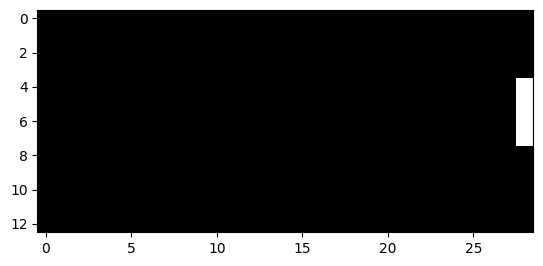

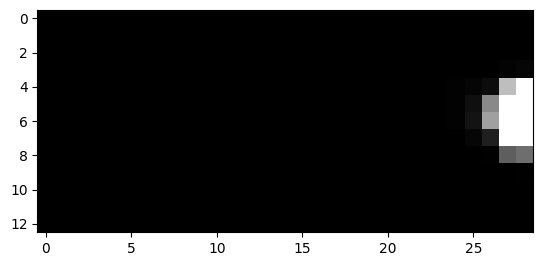

2230


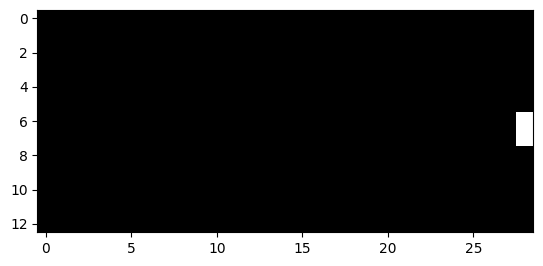

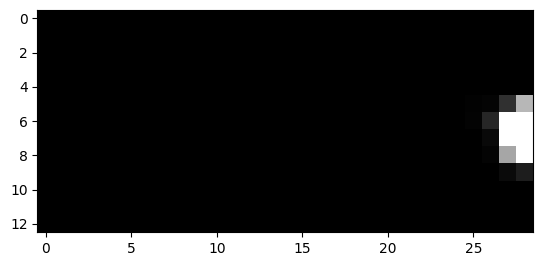

389


In [18]:
k=0
for i in range(len(y_test_img)): 
    if(np.max(y_test_img[i].reshape(-1))>0.1):
        print(i)
        plt.figure()
        plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
        plt.show()
        plt.imshow(t[i], vmin=0, vmax=0.3, cmap = "gray")
        plt.show()
        k+=1
print(k)

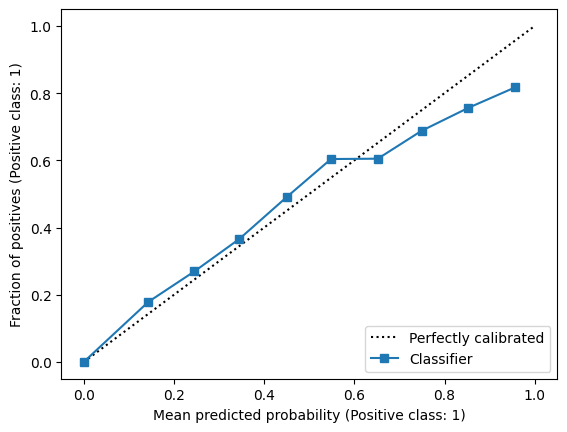

In [19]:
from sklearn.calibration import CalibrationDisplay

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)


In [20]:
from sklearn.metrics import brier_score_loss
### brier score con probabilità predette

print(f'All zeros Brier score: {brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1))))}')
print(f'Model Brier score: {brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1))}')

All zeros Brier score: 0.0035259368257102965
Model Brier score: 0.002172682068754036


In [21]:
test['predictions_lag0'] = t.reshape(-1,1)

In [22]:
test.to_csv("test_with_newTarget_predictions.csv")

## Lags

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_1 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 14, 30, 1)         73        
                                                                 
 cropping2d_1 (Cropping2D)   (None, 13, 29, 1)        

2023-03-28 10:59:39.432091: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0454

2023-03-28 10:59:42.256314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0454 - val_loss: 0.0165
Epoch 2/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0173 - val_loss: 0.0143
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0154 - val_loss: 0.0126
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0144 - val_loss: 0.0128
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0137 - val_loss: 0.0118
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0134 - val_loss: 0.0118
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0131 - val_loss: 0.0111
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0129 - val_loss: 0.0116
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0127 - val_loss: 0.0111
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0126 - val_loss: 0.0111
E

2023-03-28 11:01:46.261696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 2ms/step


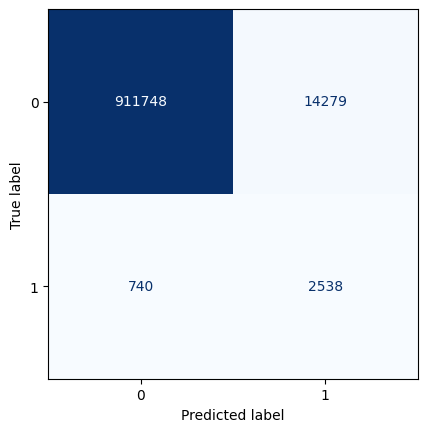

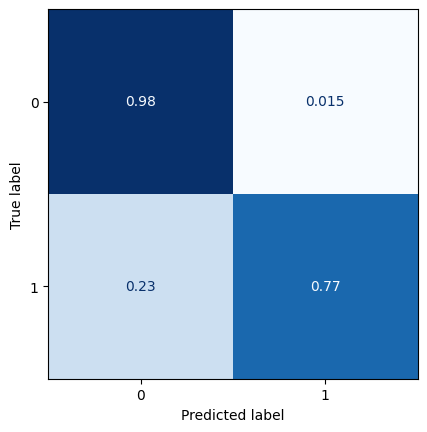

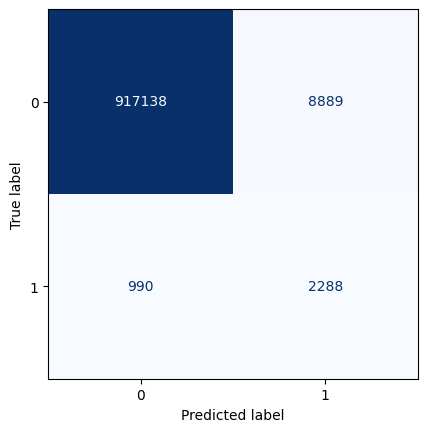

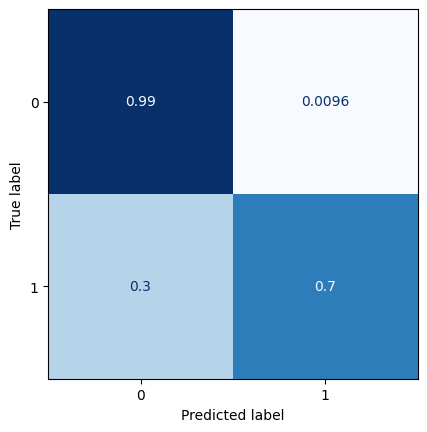

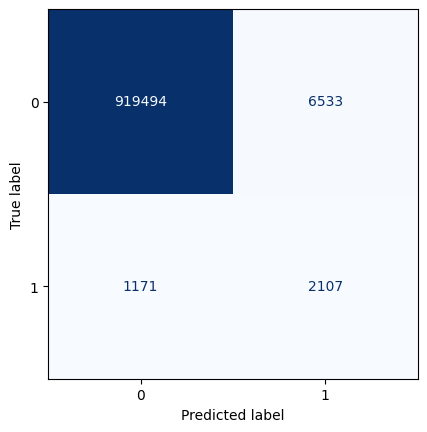

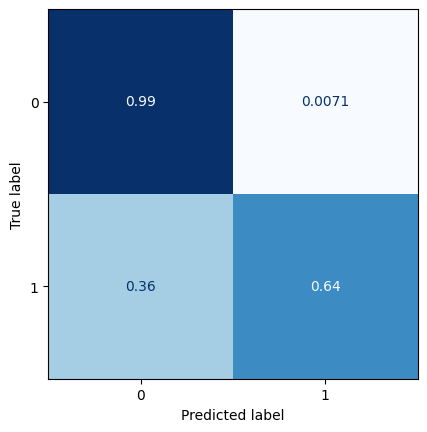

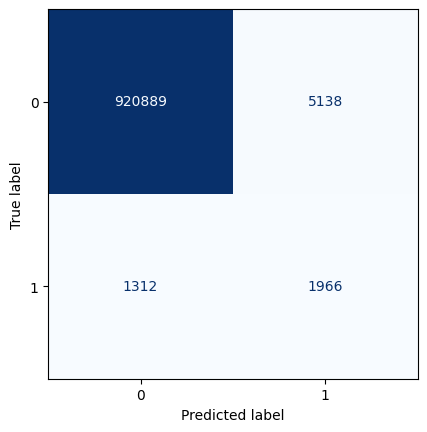

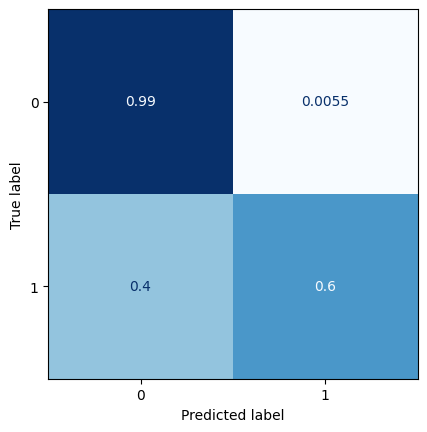

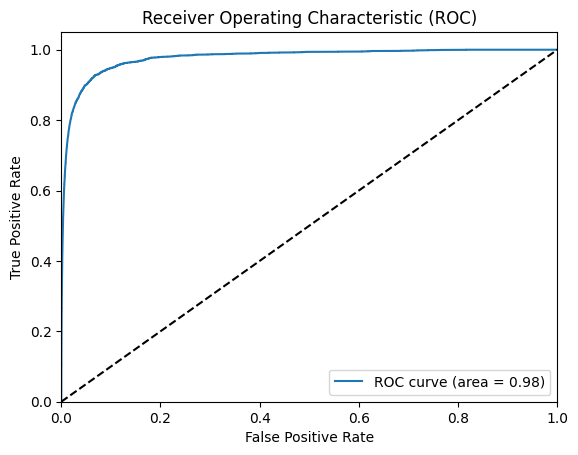

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.002736149079277809
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_2 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 14, 30, 1)         73        
                                     

2023-03-28 11:02:02.298032: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1122 - val_loss: 0.0237


2023-03-28 11:02:05.025261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0234 - val_loss: 0.0191
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0176
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0195 - val_loss: 0.0175
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0189 - val_loss: 0.0169
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0185 - val_loss: 0.0165
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0181 - val_loss: 0.0165
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0177 - val_loss: 0.0157
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0173 - val_loss: 0.0158
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0170 - val_loss: 0.0154
Epoch 11/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0167 - val_l

2023-03-28 11:05:55.954056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


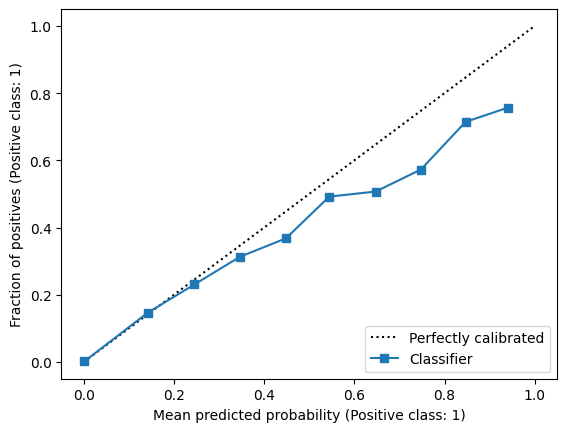

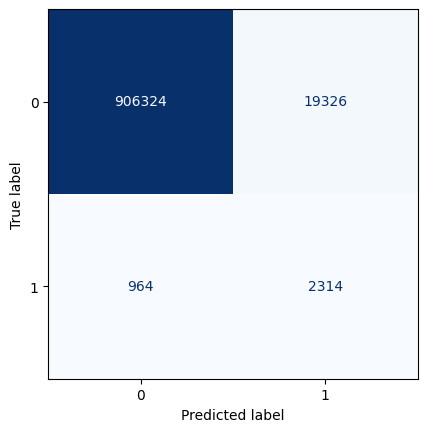

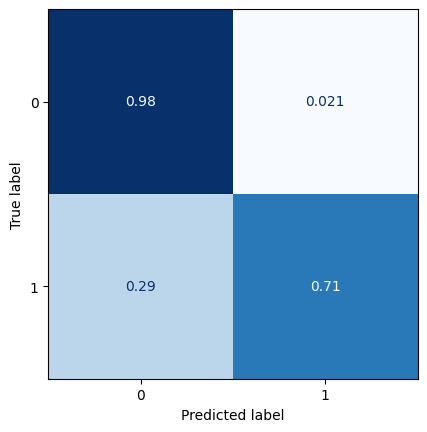

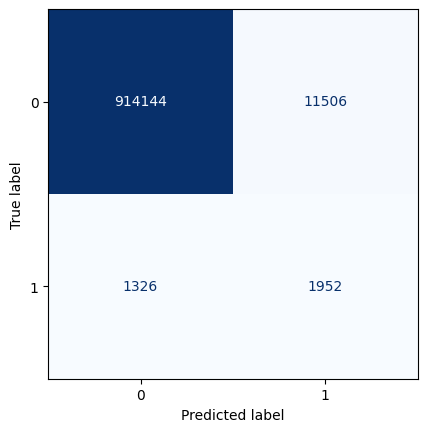

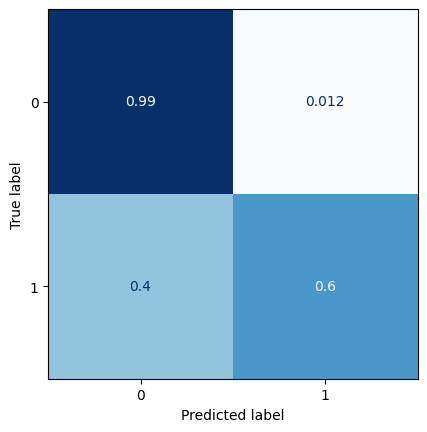

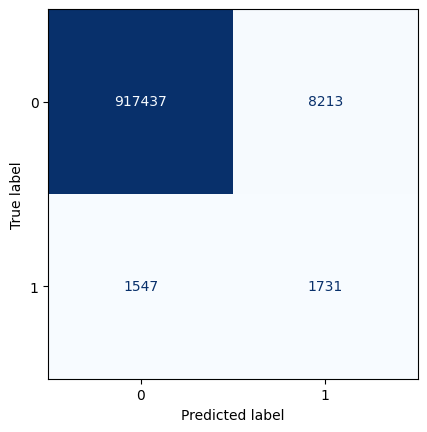

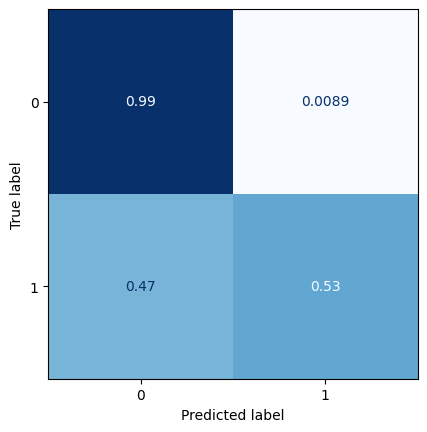

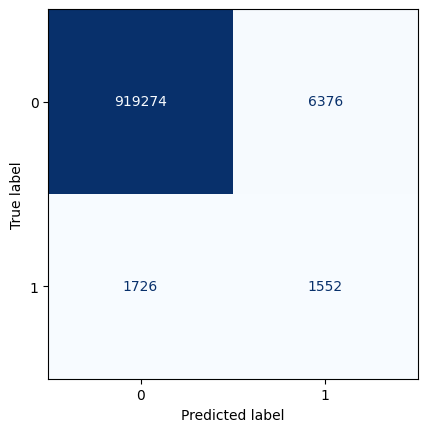

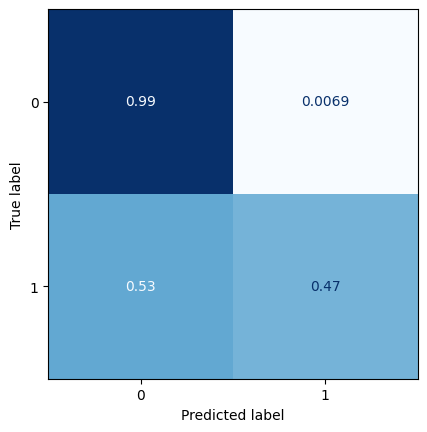

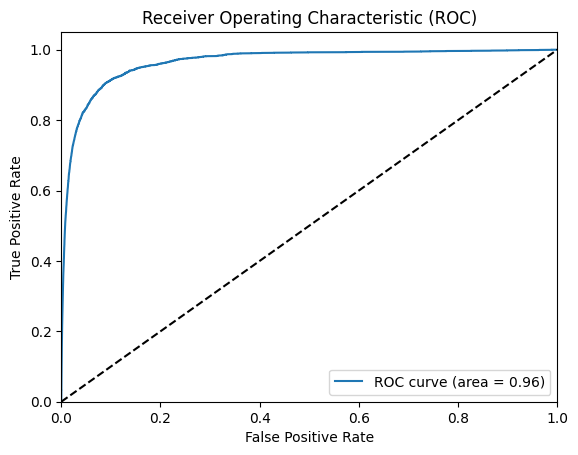

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0031380999744746304
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_3 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:06:13.081715: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0924

2023-03-28 11:06:15.862402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0924 - val_loss: 0.0228
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0242 - val_loss: 0.0203
Epoch 3/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0216 - val_loss: 0.0187
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0203 - val_loss: 0.0183
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0196 - val_loss: 0.0176
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0192 - val_loss: 0.0176
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0188 - val_loss: 0.0172
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0185 - val_loss: 0.0172
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0184 - val_loss: 0.0174
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0182 - val_loss: 0.0168
E

2023-03-28 11:07:55.162788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


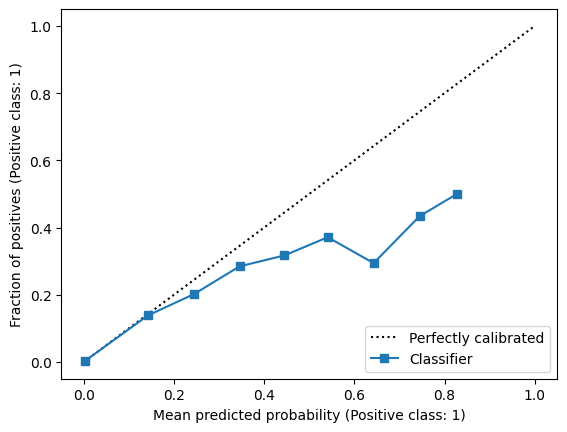

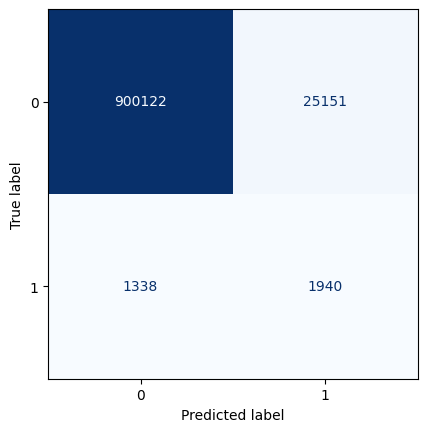

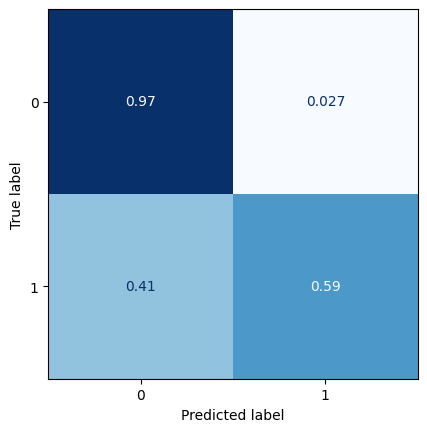

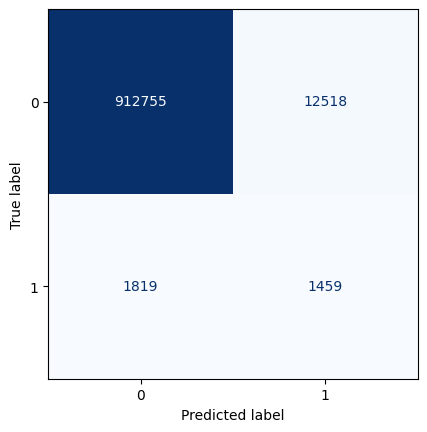

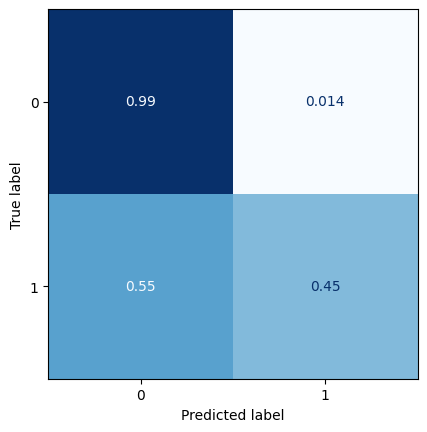

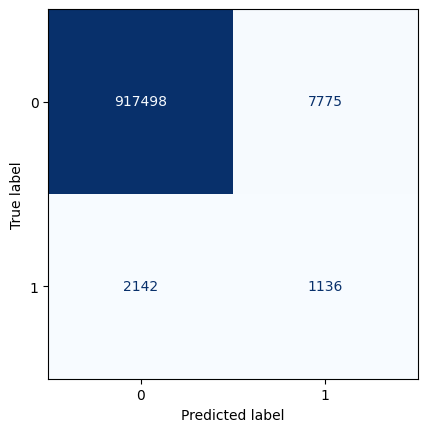

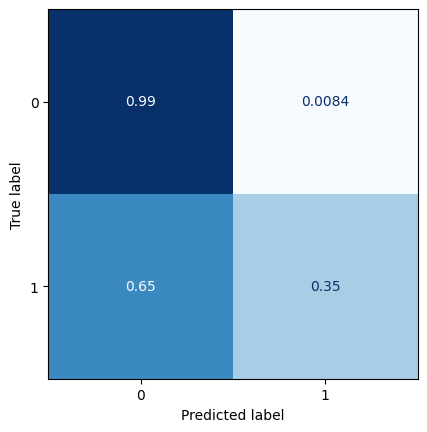

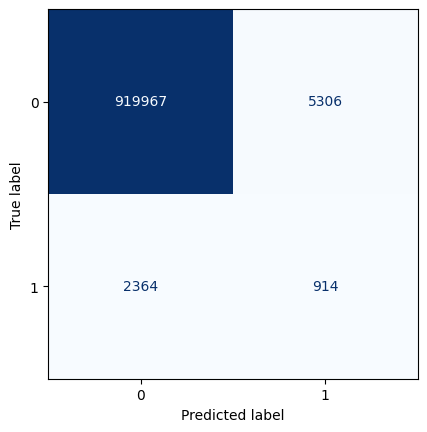

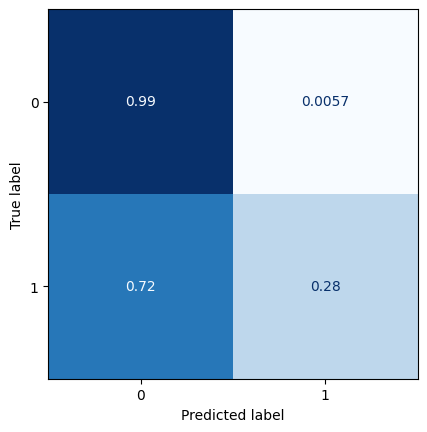

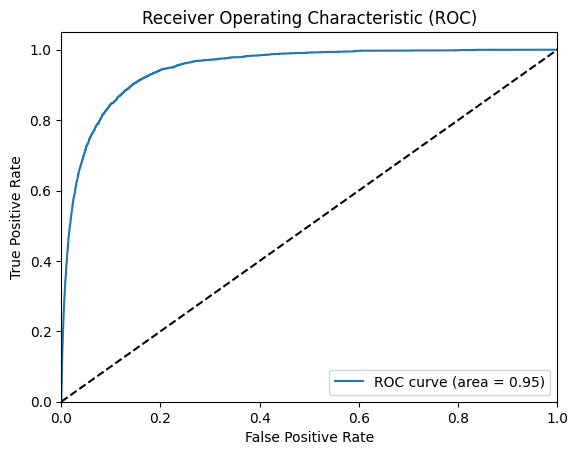

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.003340098371057907
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_13 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_4 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:08:12.666334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0430

2023-03-28 11:08:15.458858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0430 - val_loss: 0.0211
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0198
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0211 - val_loss: 0.0190
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0189
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0202 - val_loss: 0.0185
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0200 - val_loss: 0.0186
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0198 - val_loss: 0.0183
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0196 - val_loss: 0.0179
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0194 - val_loss: 0.0183
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0193 - val_loss: 0.0180
E

2023-03-28 11:10:23.722777: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


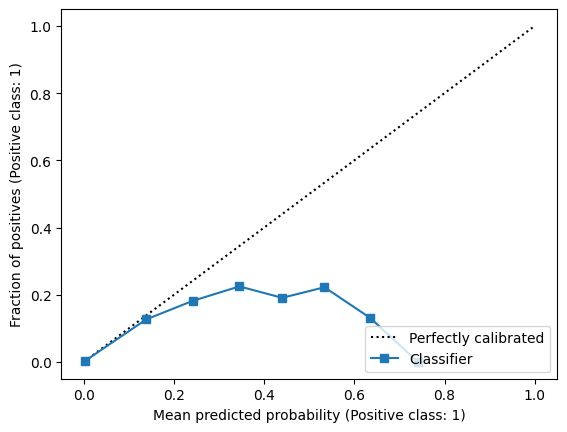

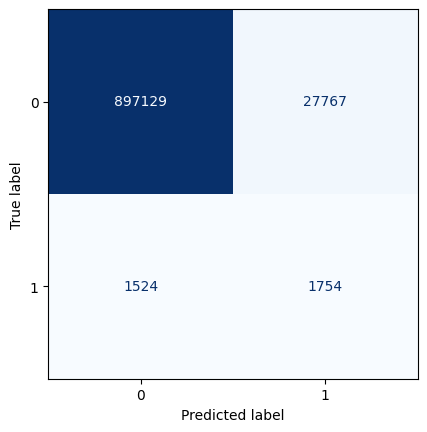

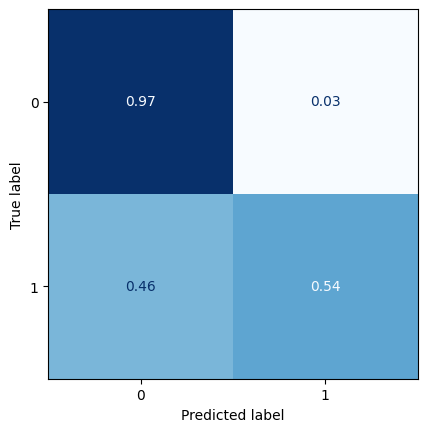

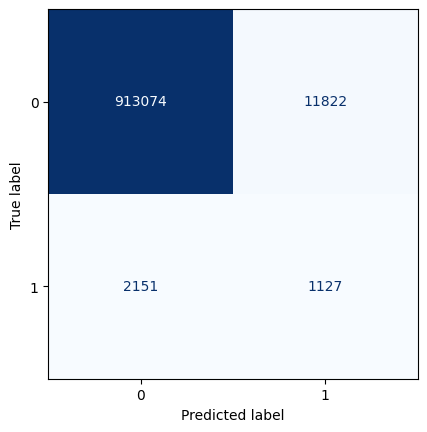

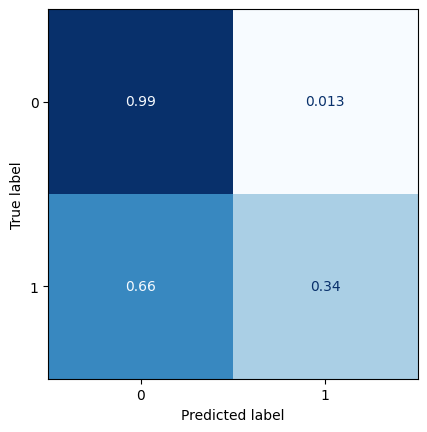

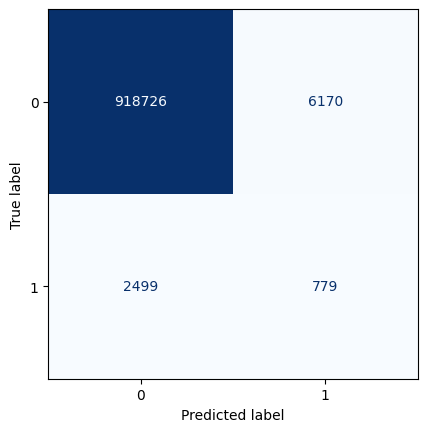

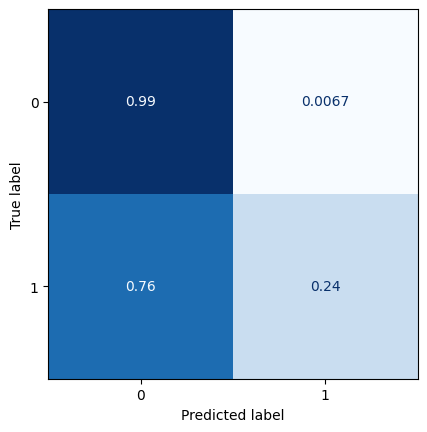

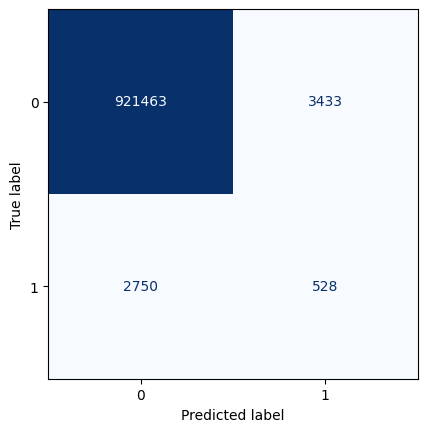

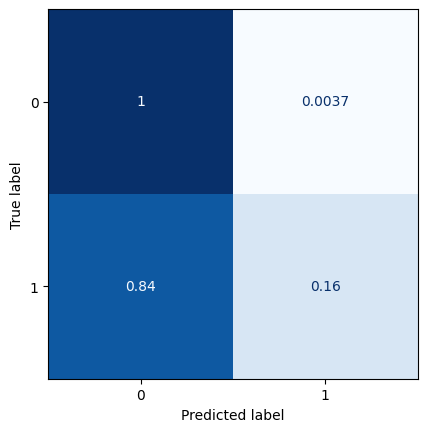

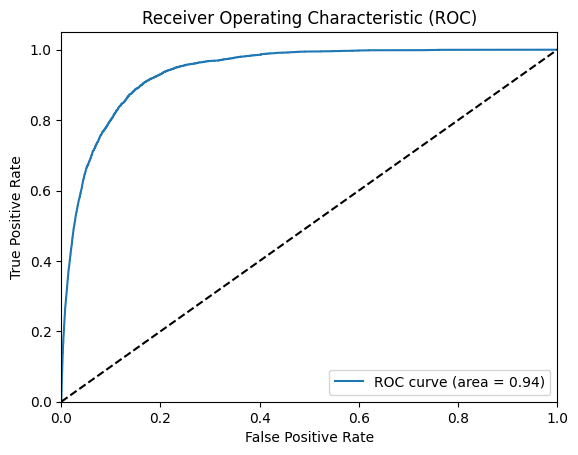

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.003369550319754776
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_16 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_5 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_17 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:10:41.885585: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0708

2023-03-28 11:10:44.657780: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0708 - val_loss: 0.0229
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0207
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0225 - val_loss: 0.0200
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0195
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0190
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0208 - val_loss: 0.0188
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0207 - val_loss: 0.0186
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0205 - val_loss: 0.0190
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0204 - val_loss: 0.0191
E

2023-03-28 11:13:03.427060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


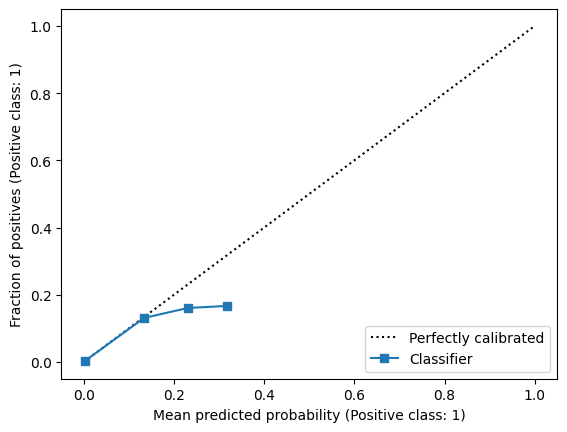

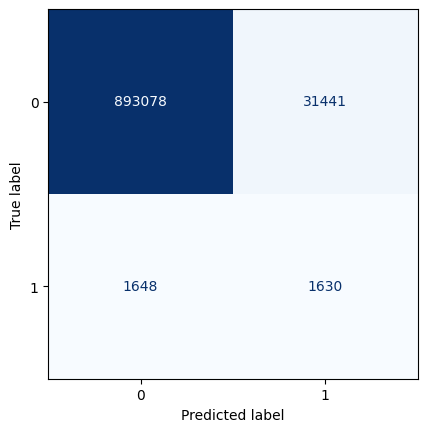

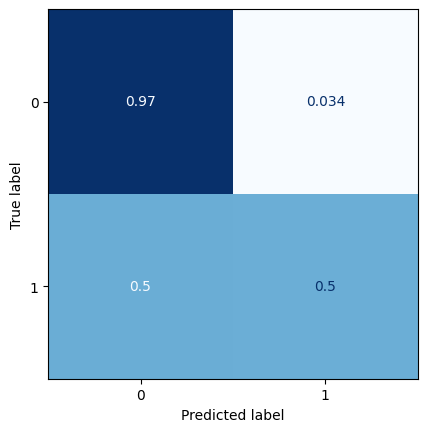

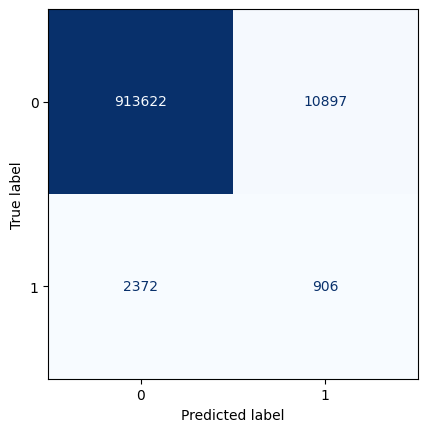

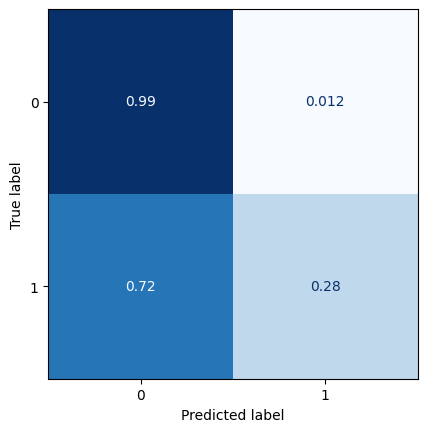

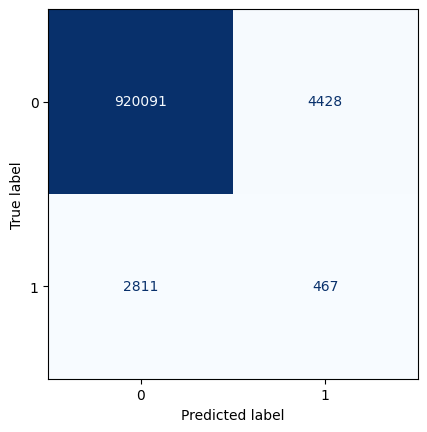

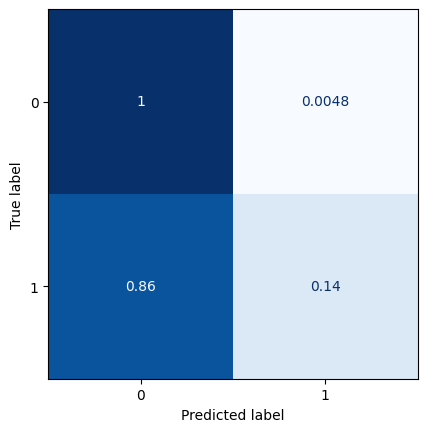

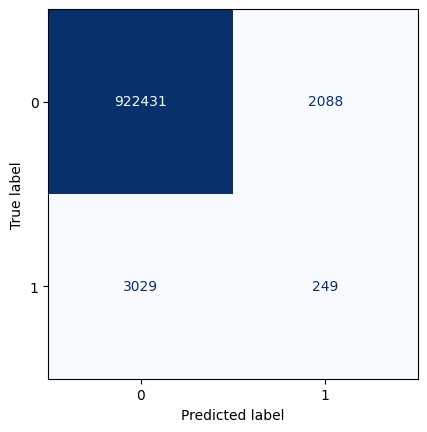

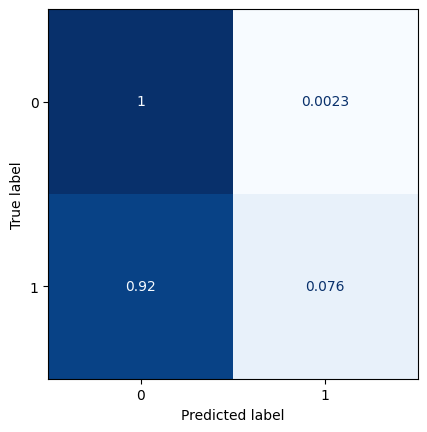

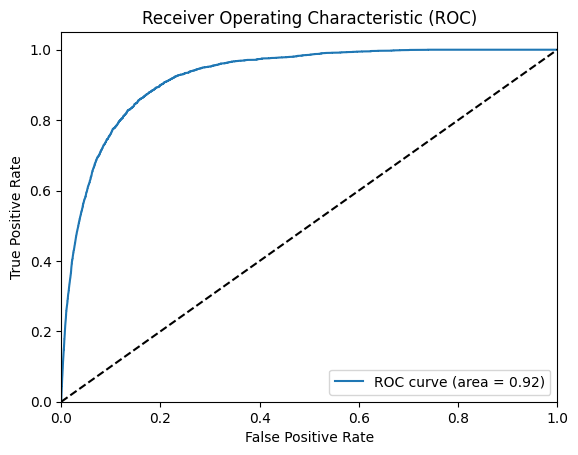

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.003414690807235763
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_6 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_20 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:13:22.381228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0669

2023-03-28 11:13:25.135576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0669 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0246 - val_loss: 0.0209
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0230 - val_loss: 0.0203
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0197
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0196
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0191
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0196
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0209 - val_loss: 0.0196
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0208 - val_loss: 0.0193
E

2023-03-28 11:15:41.788530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


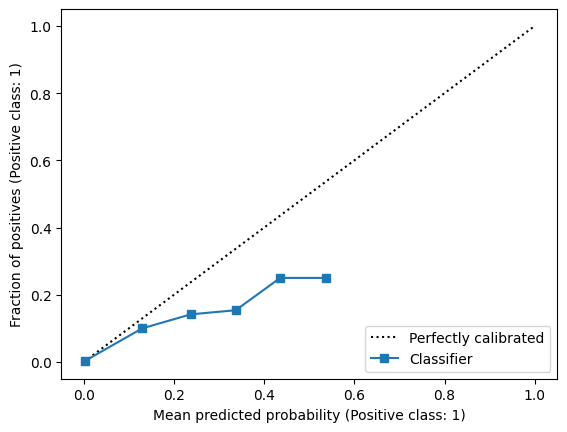

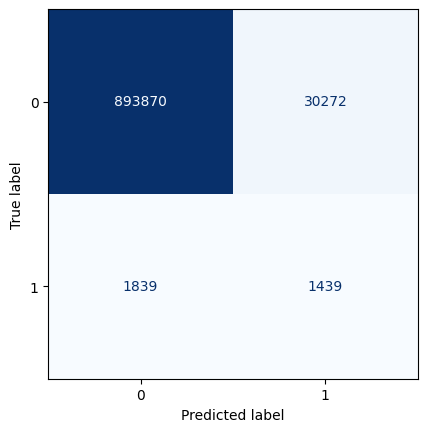

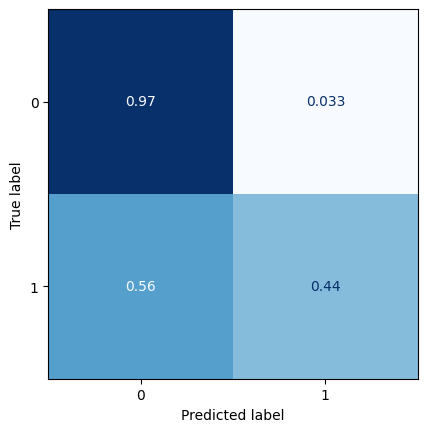

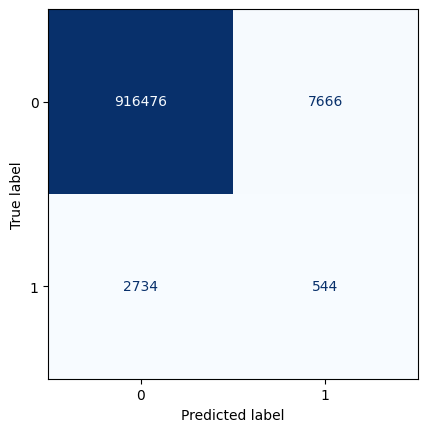

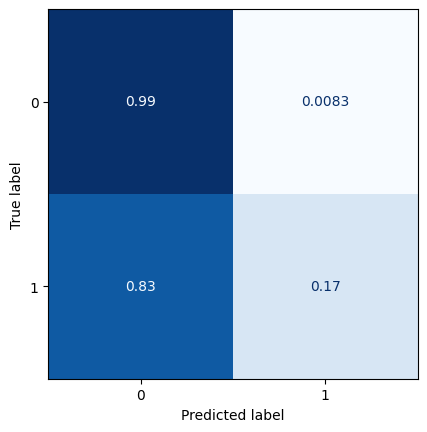

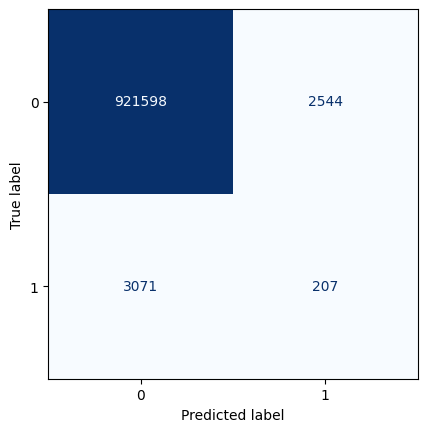

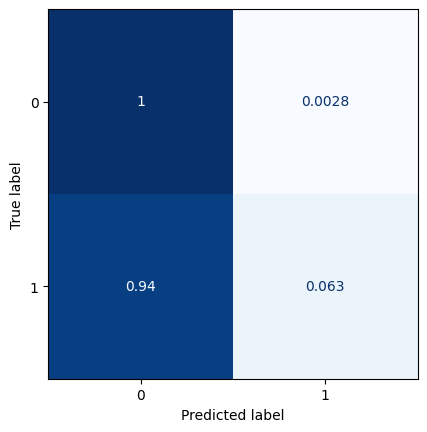

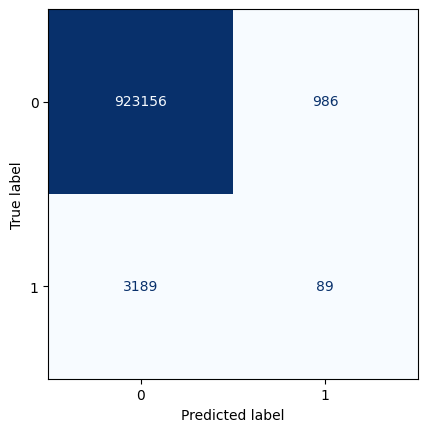

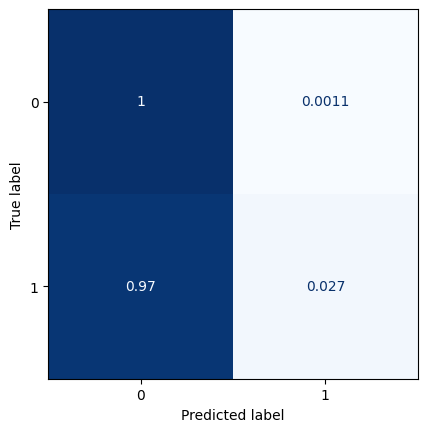

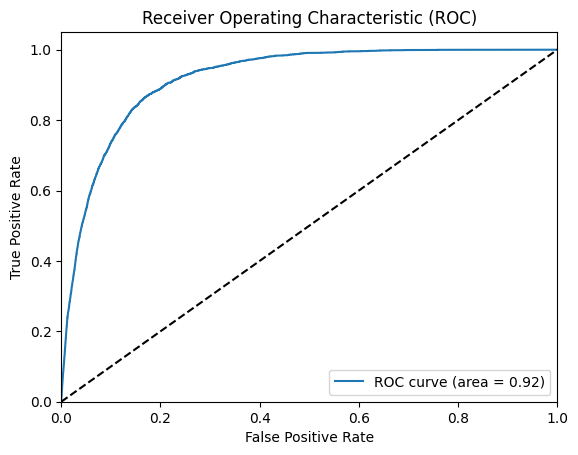

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003440155557271136
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_22 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_7 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_23 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:16:01.284930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.1477

2023-03-28 11:16:04.007383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1477 - val_loss: 0.0267
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0278 - val_loss: 0.0232
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0253 - val_loss: 0.0220
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0241 - val_loss: 0.0213
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0205
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0225 - val_loss: 0.0202
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0217 - val_loss: 0.0199
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0195
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
E

2023-03-28 11:17:52.256299: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 2ms/step


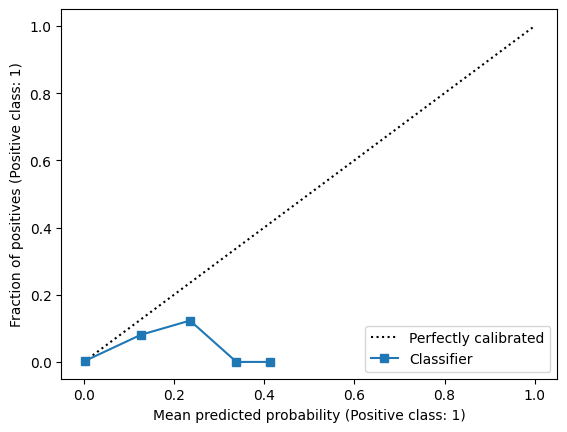

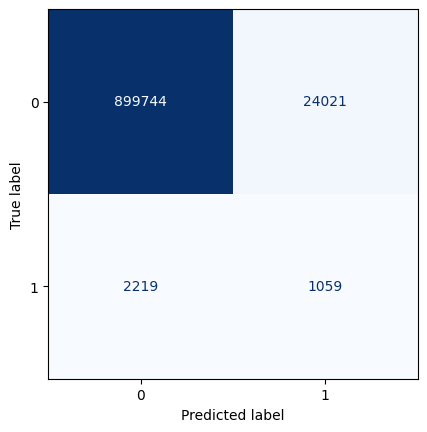

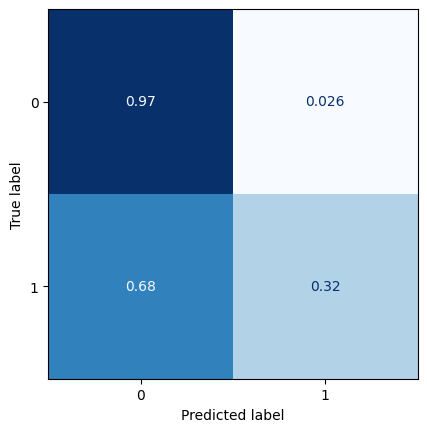

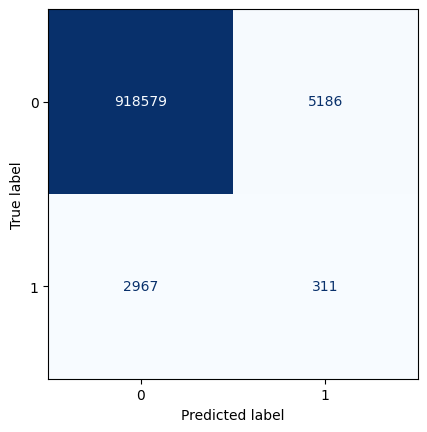

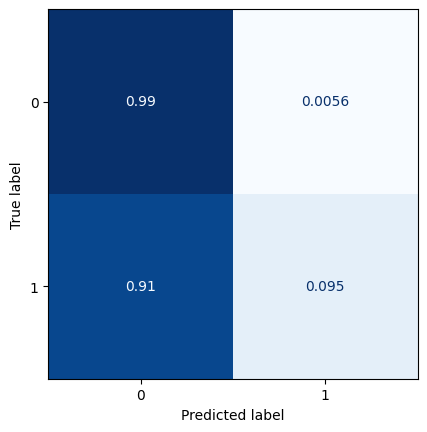

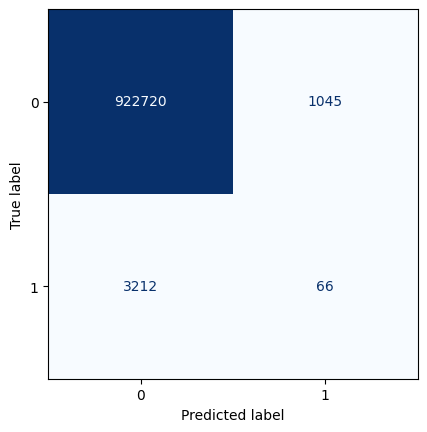

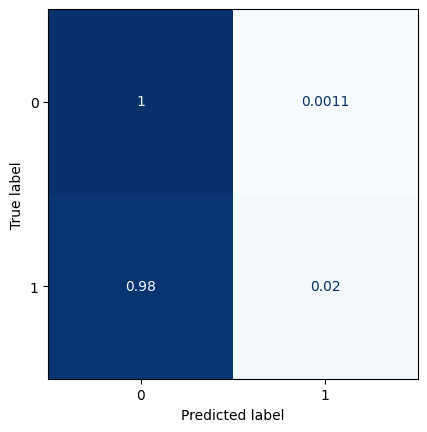

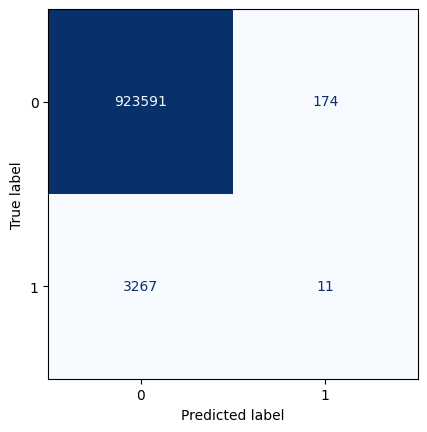

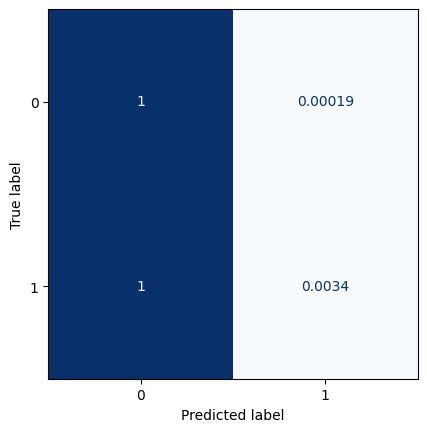

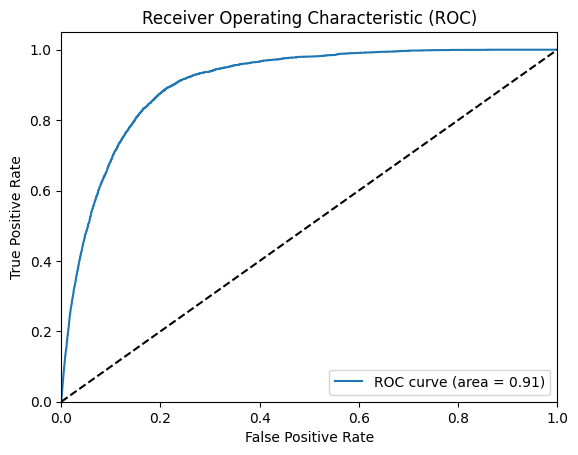

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.0034597454648158136
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_25 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_8 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_26 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:18:12.313033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0451

2023-03-28 11:18:15.130543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0451 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0213
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0228 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0199
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0199
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0194
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0193
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0194
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0210 - val_loss: 0.0191
E

2023-03-28 11:19:39.004748: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


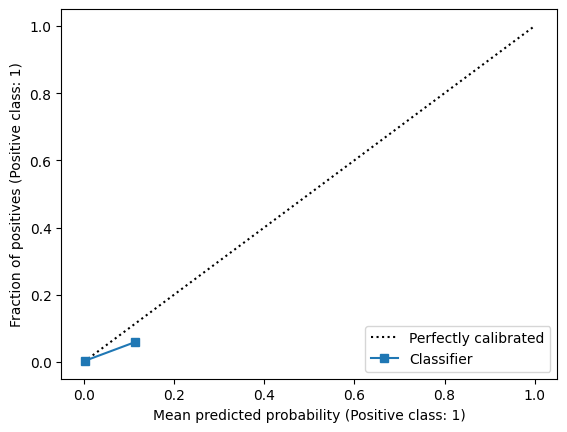

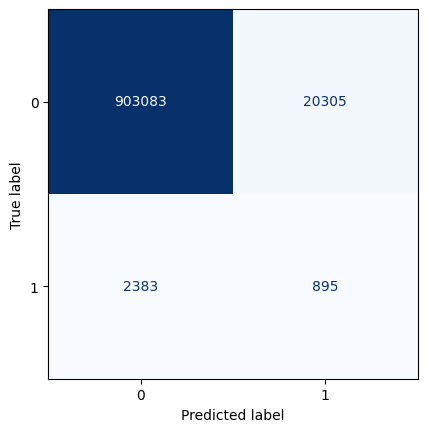

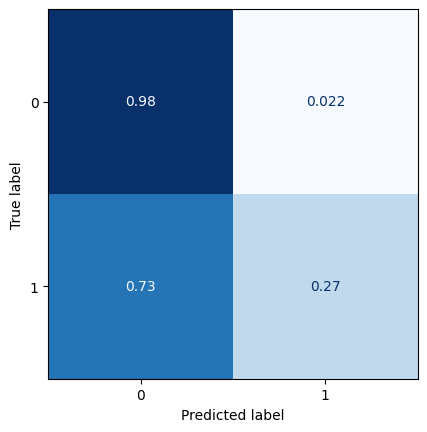

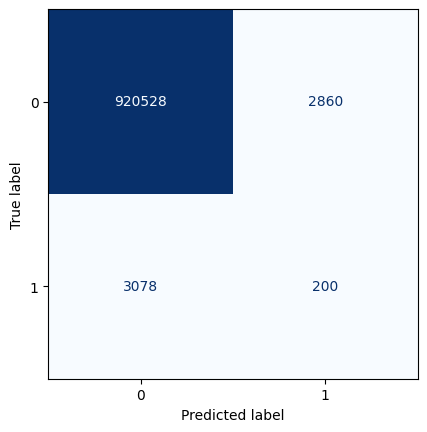

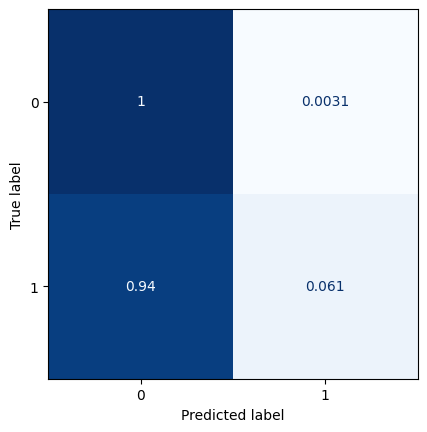

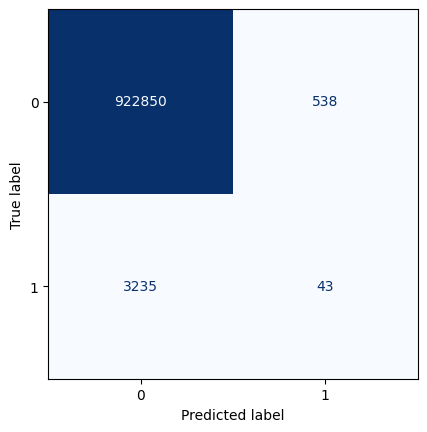

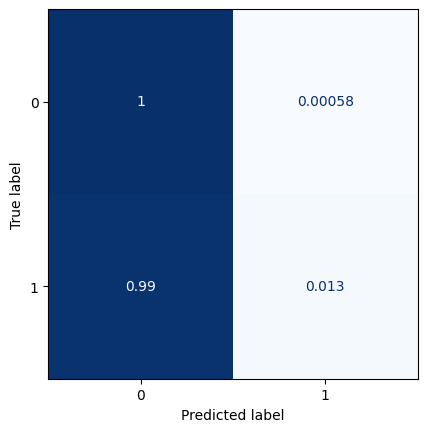

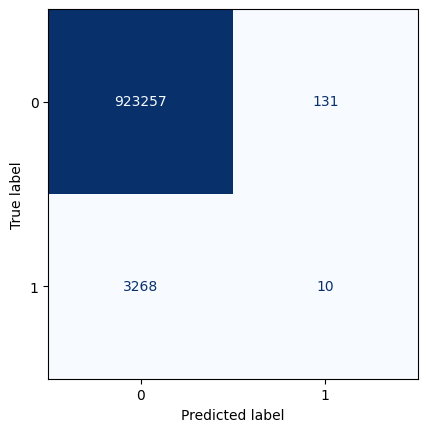

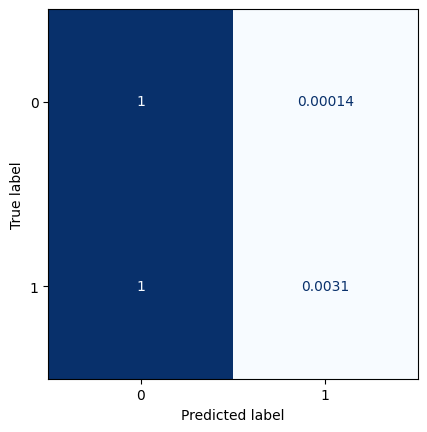

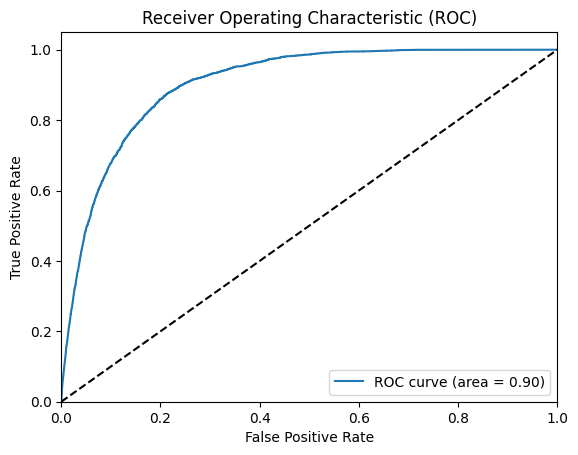

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0034618074381382396
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_27 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_28 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_9 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_29 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:20:00.797013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0448

2023-03-28 11:20:03.640464: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0448 - val_loss: 0.0227
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0238 - val_loss: 0.0211
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0221 - val_loss: 0.0203
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0202
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0214 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0197
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0212 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0201
E

2023-03-28 11:21:36.046377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


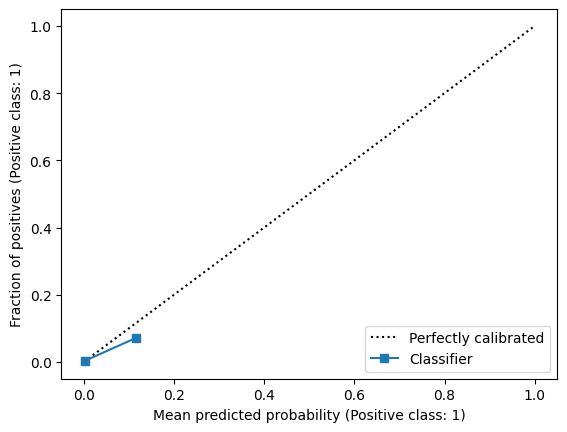

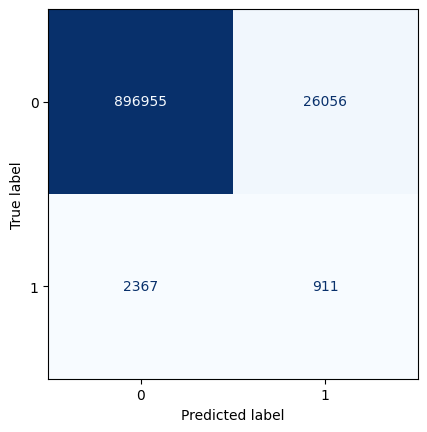

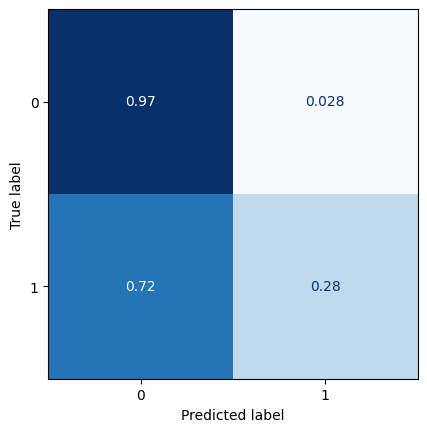

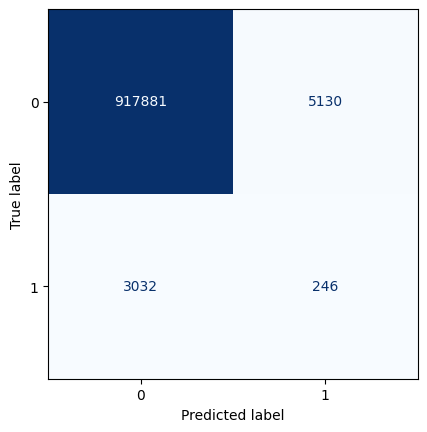

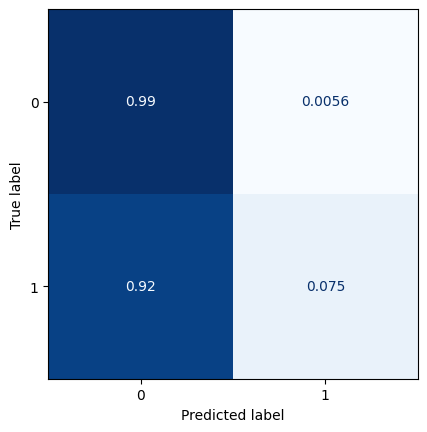

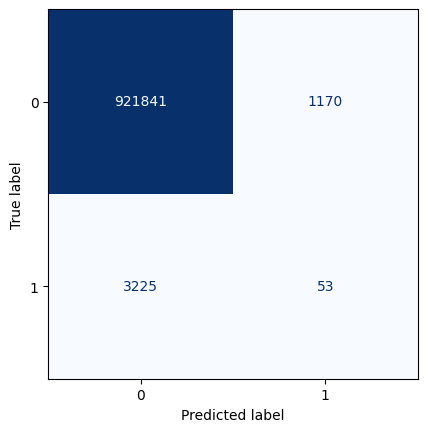

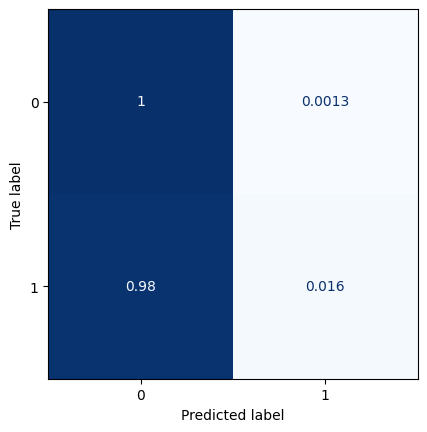

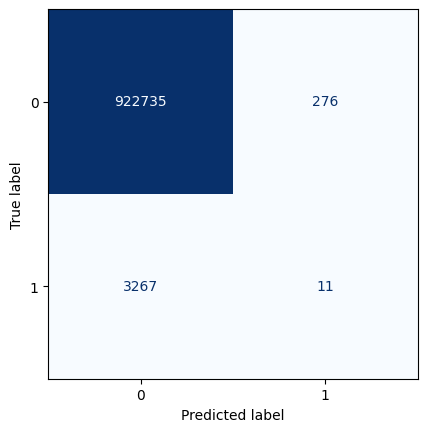

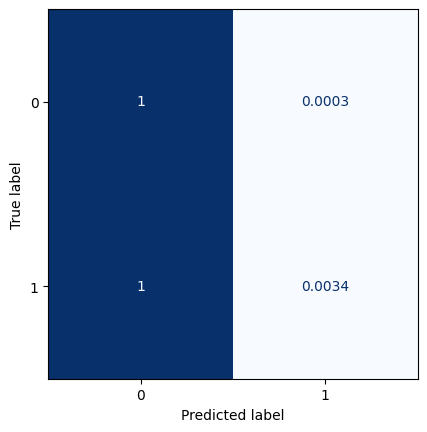

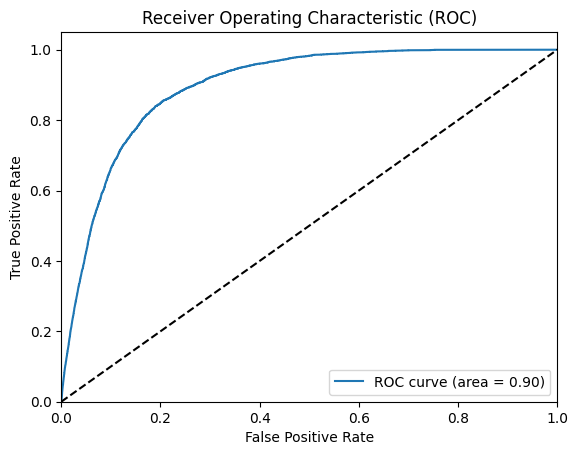

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.0034784944757933795
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_31 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_10 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_32 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:21:57.965497: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0600

2023-03-28 11:22:00.895264: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0600 - val_loss: 0.0233
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0243 - val_loss: 0.0216
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0208
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0223 - val_loss: 0.0206
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0198
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0202
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0196
E

2023-03-28 11:23:27.050857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


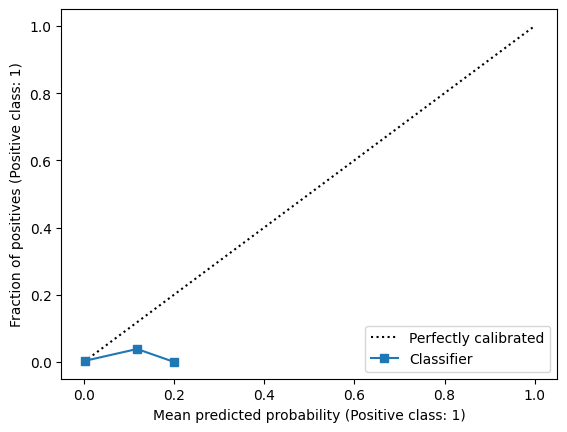

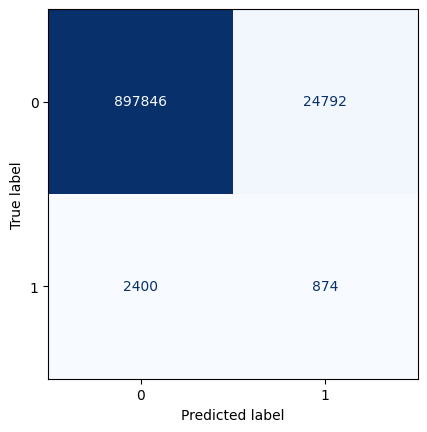

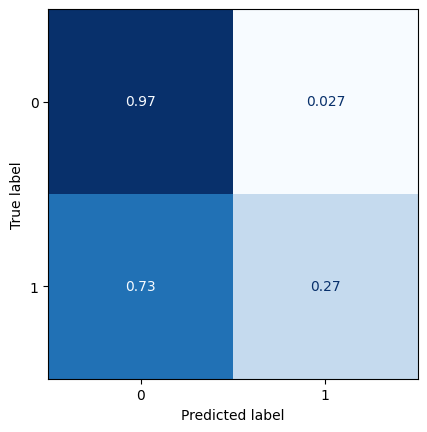

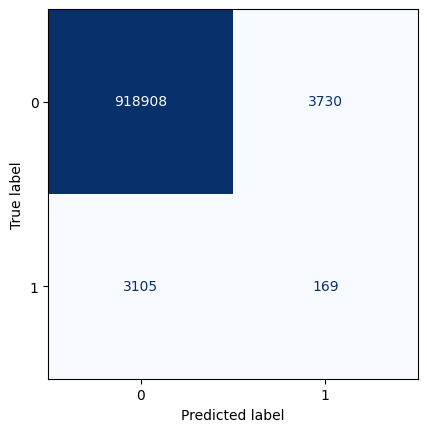

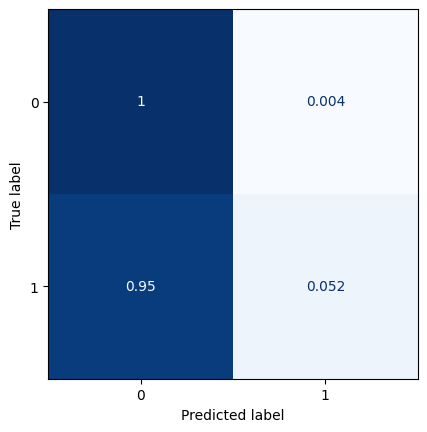

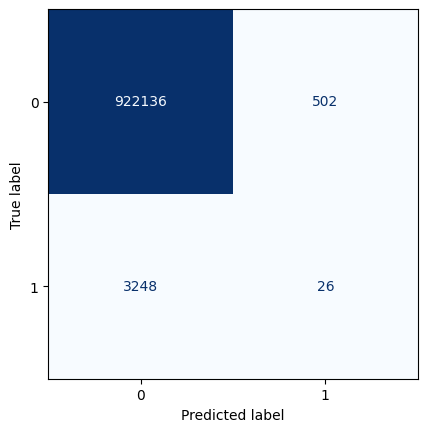

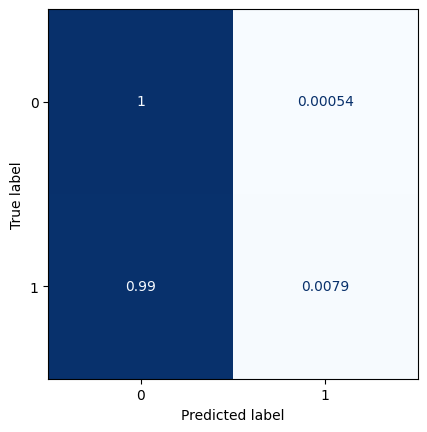

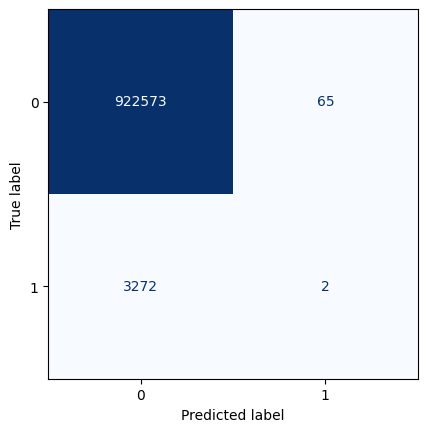

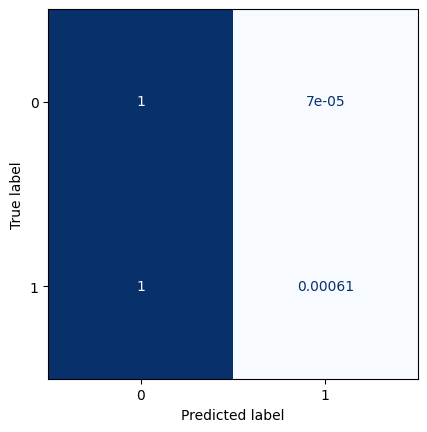

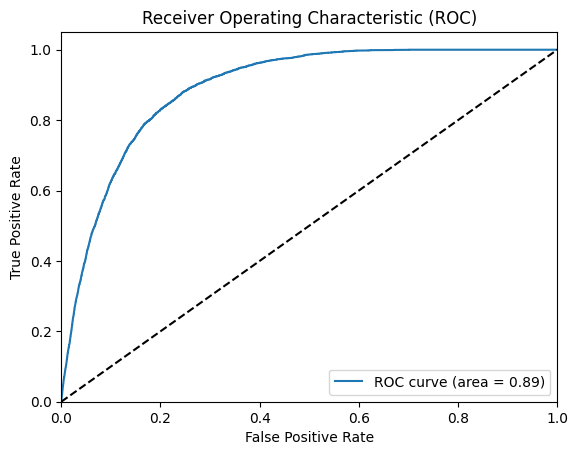

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003477522258814916
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_33 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_34 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_11 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_35 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:23:49.444177: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0537

2023-03-28 11:23:52.832610: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 4s 10ms/step - loss: 0.0537 - val_loss: 0.0241
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0240 - val_loss: 0.0222
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0230 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0203
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0203
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0205
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0199


2023-03-28 11:25:54.759172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


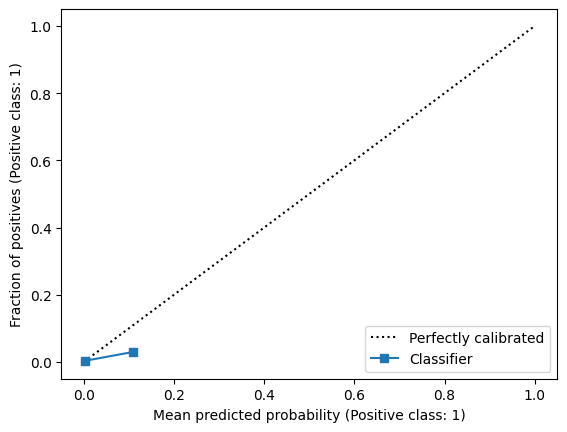

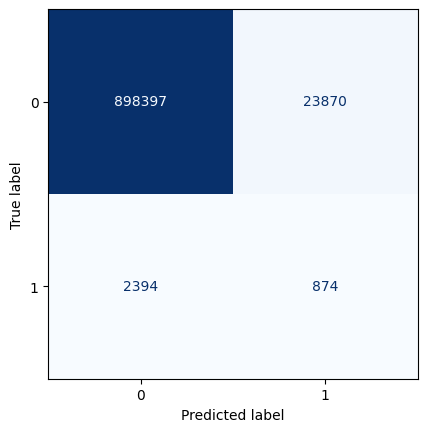

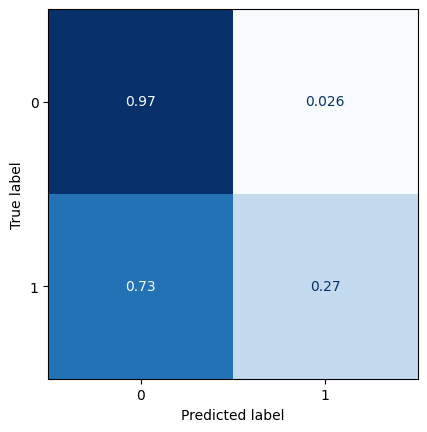

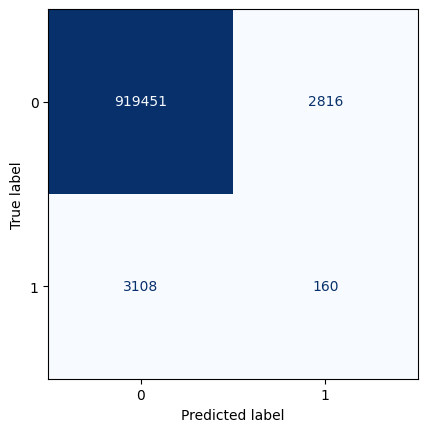

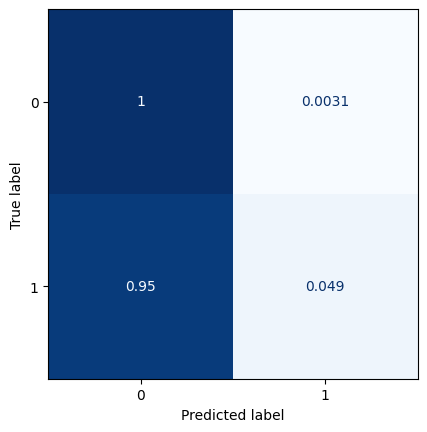

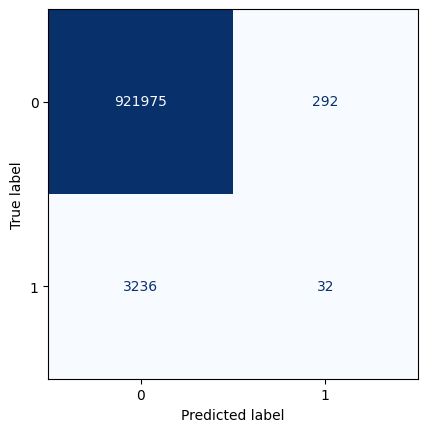

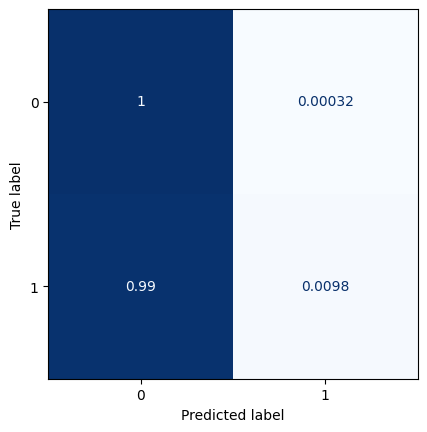

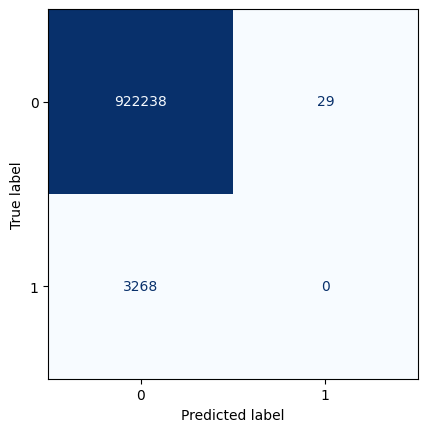

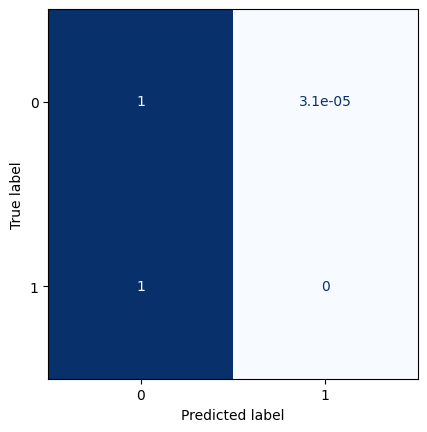

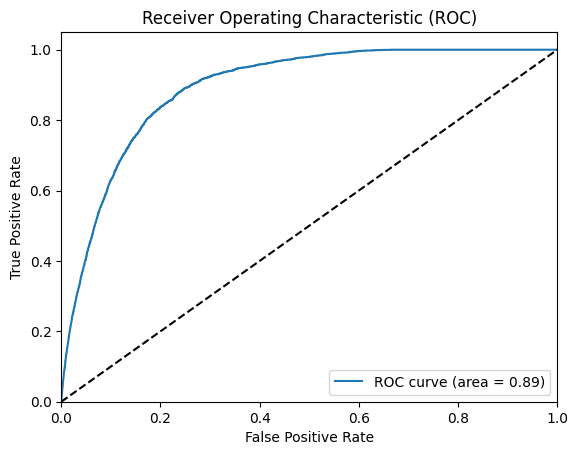

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0034669633336080717
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_37 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_12 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 14, 30, 1)         73        
                                 

2023-03-28 11:26:18.965733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0580

2023-03-28 11:26:21.812693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0580 - val_loss: 0.0234
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0245 - val_loss: 0.0219
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0226 - val_loss: 0.0209
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0222 - val_loss: 0.0207
Epoch 6/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0219 - val_loss: 0.0209
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0203
Epoch 9/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0215 - val_loss: 0.0203
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0201
E

2023-03-28 11:27:48.416958: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


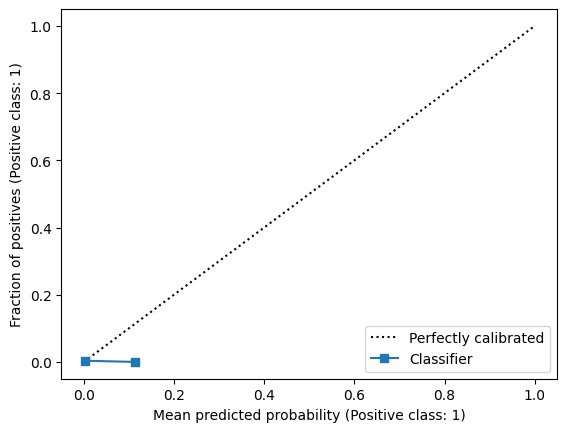

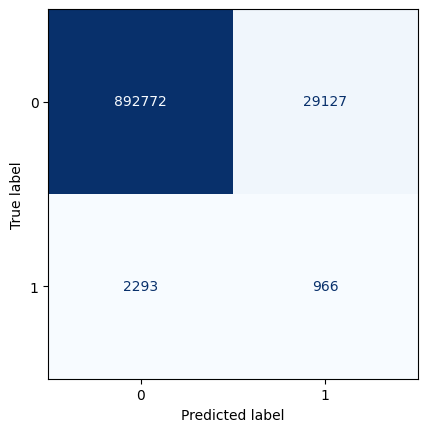

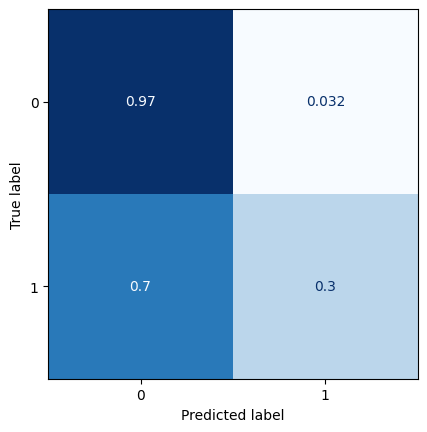

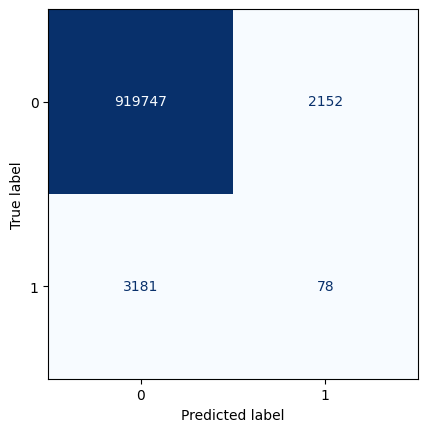

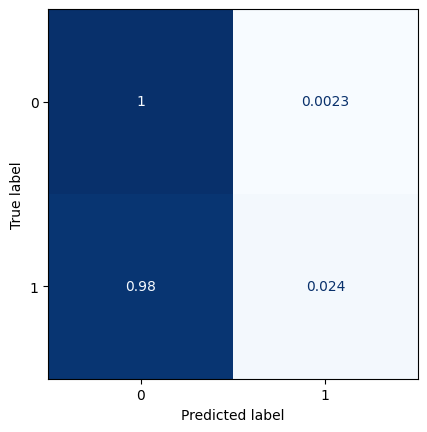

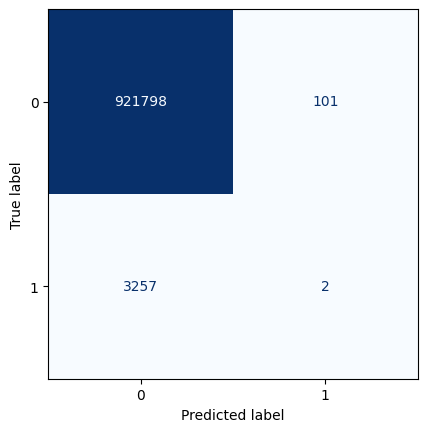

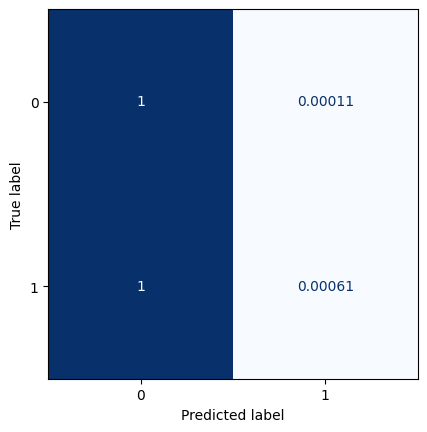

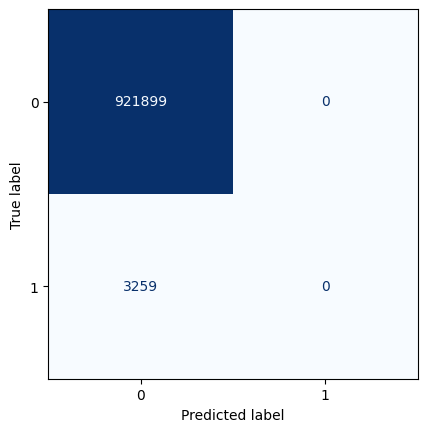

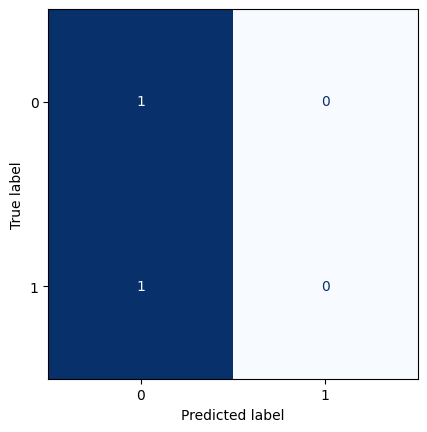

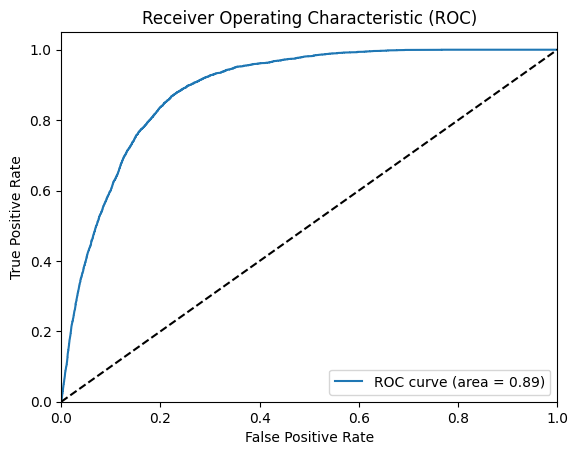

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.0034647624830147837
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_39 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_40 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_13 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_41 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:28:12.650330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0812

2023-03-28 11:28:15.620495: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0812 - val_loss: 0.0253
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0260 - val_loss: 0.0235
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0222
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0217
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0228 - val_loss: 0.0211
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0224 - val_loss: 0.0208
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0208
Epoch 8/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0221 - val_loss: 0.0208
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0219 - val_loss: 0.0207
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0206
E

2023-03-28 11:30:26.220758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


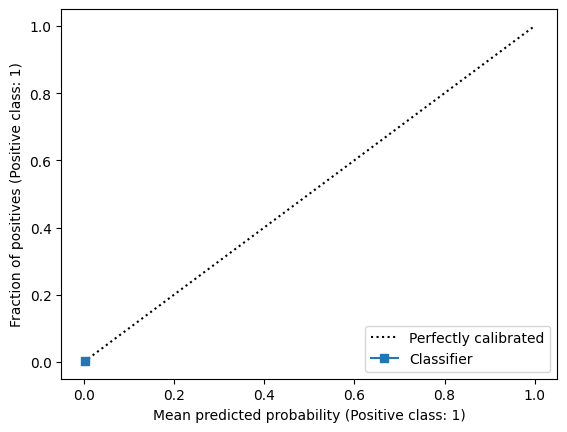

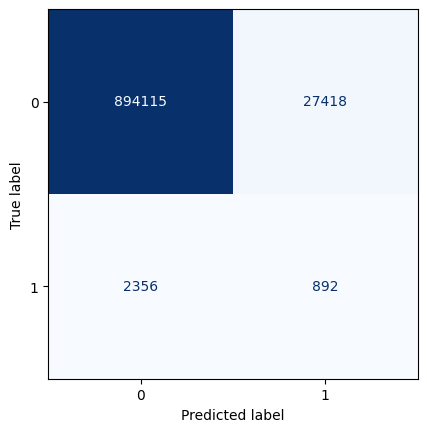

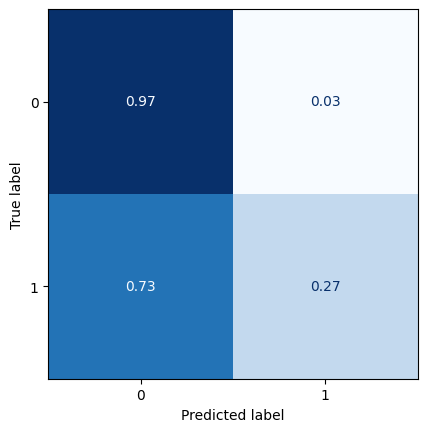

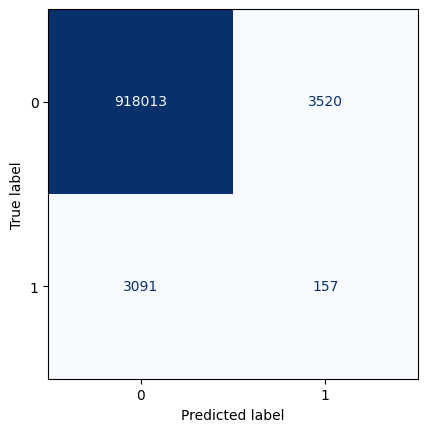

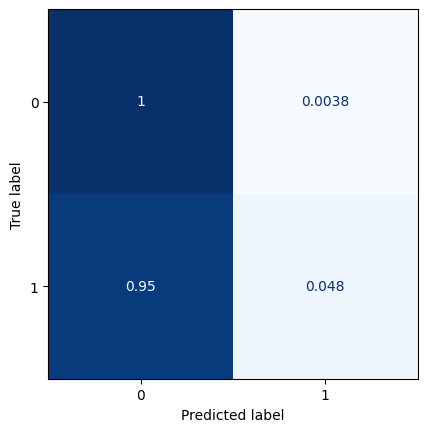

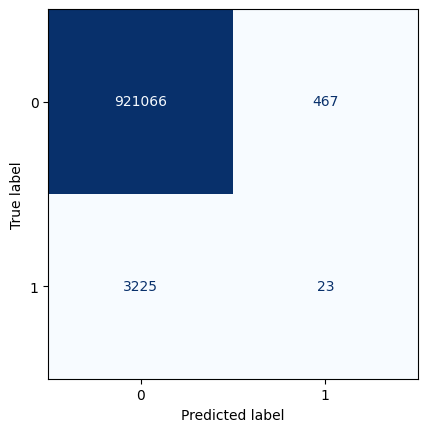

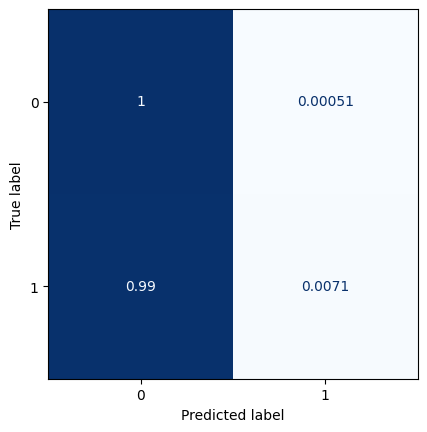

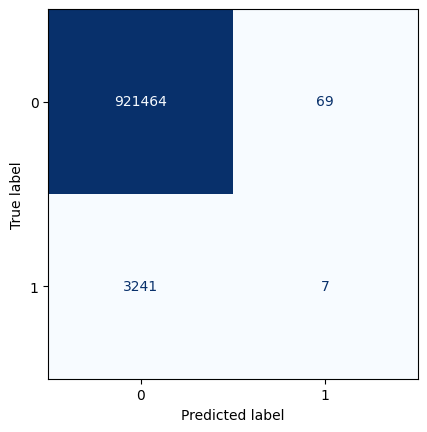

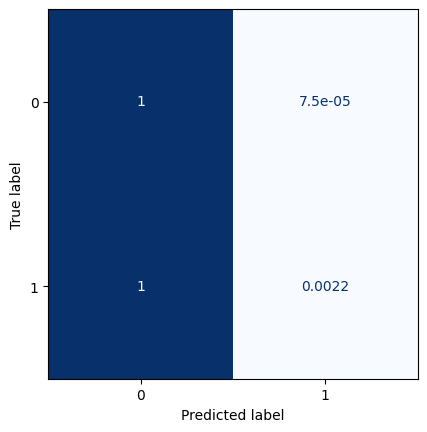

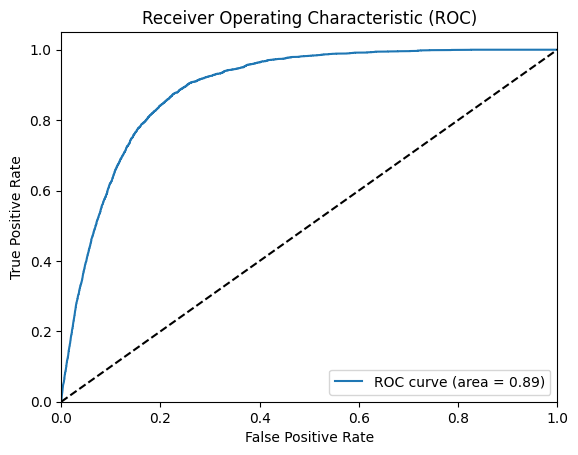

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.003456000968310353


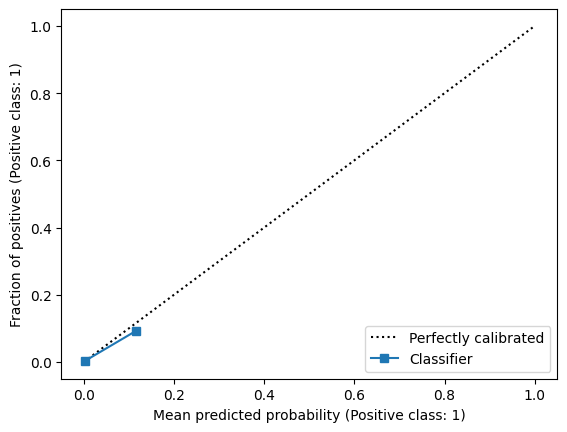

In [23]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = Sequential()
    model.add(layers.Input(shape=(13, 29, 9)))
    
    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.MaxPooling2D((2, 2), padding='same'))

    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.UpSampling2D((2,2)))
    
    model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities
    
    model.add(layers.Cropping2D(cropping=((0,1),(0,1))))
    
    model.summary()
    
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std[:-lag], y_train_img[lag:], validation_data=(val_img_std[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    

In [29]:
test

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,new_target,Real_tom_target,shear,target,predictions_lag0,predictions_lag1,predictions_lag2,predictions_lag3,predictions_lag4,predictions_lag5,predictions_lag6,predictions_lag7,predictions_lag8,predictions_lag9,predictions_lag10,predictions_lag11,predictions_lag12,predictions_lag13
34307,34307,2016-04-01,0.0,20.0,0.238973,1.386669,-0.945404,1.574206,0.511504,0.367981,2.652010,-1.588255,0.0,0.0,-0.516292,0,5.599760e-06,1.116584e-05,0.000032,0.000440,1.698381e-04,4.817998e-06,3.752636e-05,0.000202,2.247904e-05,0.000111,0.000871,3.269772e-06,0.000328,0.000142
34308,34308,2016-04-01,0.0,22.5,-0.172396,1.196522,-0.819827,1.371793,0.717349,0.332262,3.396515,-1.588255,0.0,0.0,-0.755886,0,8.091185e-07,3.770019e-07,0.000002,0.000008,1.457031e-06,6.148791e-08,6.037646e-07,0.000003,5.734404e-07,0.000007,0.000024,5.036778e-08,0.000031,0.000008
34309,34309,2016-04-01,0.0,25.0,1.188889,1.166772,-0.571398,1.173488,0.662464,0.144802,4.092788,-1.588255,0.0,0.0,-1.161314,0,5.273907e-07,1.280818e-07,0.000003,0.000005,5.989831e-07,3.379468e-08,3.775615e-07,0.000001,2.429358e-07,0.000003,0.000012,3.192573e-08,0.000018,0.000004
34310,34310,2016-04-01,0.0,27.5,-0.649707,1.063899,-0.385753,0.812011,0.713230,0.584284,4.044557,-1.588255,0.0,0.0,-1.507685,0,4.937469e-07,6.390888e-08,0.000009,0.000003,9.002248e-07,3.109205e-08,8.725253e-08,0.000001,1.392415e-08,0.000001,0.000008,2.136173e-08,0.000014,0.000001
34311,34311,2016-04-01,0.0,30.0,-0.629183,1.432846,-0.362931,0.809212,0.888739,-0.207576,3.438931,-1.588255,0.0,0.0,-1.154385,0,9.038527e-07,1.089020e-07,0.000020,0.000004,1.546370e-06,4.021748e-08,5.431863e-08,0.000002,2.086840e-08,0.000002,0.000012,2.222927e-08,0.000014,0.000002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
963984,137600,2022-12-31,-30.0,80.0,0.677806,-1.271307,0.290892,-0.727302,0.813190,-0.684904,-0.431475,0.601392,0.0,0.0,0.050674,0,5.519601e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963985,137601,2022-12-31,-30.0,82.5,0.898493,-1.325164,0.224460,-0.764678,1.178495,-0.105389,-0.107881,0.599524,0.0,0.0,0.004080,0,3.107689e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963986,137602,2022-12-31,-30.0,85.0,1.629797,-1.468220,0.376651,-0.566606,1.728863,0.450626,-0.082227,0.597113,0.0,0.0,0.220205,0,1.299448e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963987,137603,2022-12-31,-30.0,87.5,0.280770,-1.453315,0.621629,-0.446284,2.368318,0.792994,-0.000815,0.594579,0.0,0.0,0.648118,0,6.500229e-04,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000


# Save results and new metric

In [24]:
a1 = test.target.values.reshape(1,-1)
a1

array([[0, 0, 0, ..., 0, 0, 0]])

In [25]:
a2 = y_test_img.reshape(1,-1)
a2

array([[0., 0., 0., ..., 0., 0., 0.]])

In [26]:
a_diff = a1-a2

In [27]:
a_diff[a_diff>0]

array([], dtype=float64)

In [28]:
test['predictions'] = t.reshape(-1,1)
test['predictions_onlySea'] = t_onlySea.reshape(-1,1)

ValueError: Length of values (924781) does not match length of index (929682)

In [ ]:
test

In [ ]:
test.to_csv("test_with_newTarget_predictions.csv")

In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target_sea==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions_onlySea>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.1) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



# Higher threshold for class 1

In [ ]:
train['target'] = train.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
test['target'] = test.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
val['target'] = val.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)

y_train = train.loc[:,['target','latitude','longitude','time']]
y_val = val.loc[:,['target','latitude','longitude','time']]
y_test = test.loc[:,['target','latitude','longitude','time']]

In [ ]:
y_train_img = extract_images(y_train, variables, verbose=True)
y_val_img = extract_images(y_val, variables, verbose=True)
y_test_img = extract_images(y_test, variables, verbose=True)


In [ ]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 9)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


In [ ]:
model.fit(train_img_std, y_train_img, validation_data=(val_img_std,y_val_img),
        callbacks=[monitor],epochs=100)

In [ ]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

In [ ]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)

print(brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1)))
print(brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1)))))